# HTF

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mplfinance as mpf
import ta.momentum
from dataclasses import dataclass
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ============================================================
# CONFIG
# ============================================================
DUKASCOPY_INSTRUMENT = 'GBPUSD'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "1d"  # Daily data

# ============================================================
# DATA CLASSES
# ============================================================
@dataclass
class LocalExtreme:
    """Represents a swing high or low point with confirmation data"""
    ext_type: int  # 1 for high, -1 for low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    """Represents a structural price level for BOS detection"""
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ============================================================
# DIRECTIONAL CHANGE DETECTOR
# ============================================================
class FibRetracementDC:
    """
    Fibonacci Retracement-based Directional Change detector.
    Identifies swing highs and lows based on a retracement percentage.
    """
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        ext = LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        )
        self.extremes.append(ext)

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """
    Converts minor (25%) extremes to intermediate major (50%) extremes.
    """
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        if self.base_extremes[0].ext_type == 1:
            last_confirmed_high = self.base_extremes[0]
            last_confirmed_low = None
        else:
            last_confirmed_low = self.base_extremes[0]
            last_confirmed_high = None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == 1:
                            if self.base_extremes[j].price > highest.price:
                                highest = self.base_extremes[j]
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_threshold = highest.price - (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price <= retrace_threshold:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == -1:
                            if self.base_extremes[j].price < lowest.price:
                                lowest = self.base_extremes[j]
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_threshold = lowest.price + (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price >= retrace_threshold:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ============================================================
# PATTERN LIBRARY (18)
# ============================================================
PATTERN_LIBRARY = [
    # CONTINUATIONS
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # SIMPLE REVERSALS
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # FAILED REVERSALS
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # TRAPS
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # STRUCTURE BREAKS
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # COMPLEX REVERSALS
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # FAILED REVERSAL EXTENSIONS
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # LIQUIDITY SWEEPS
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============================================================
# BIASED PLOTTING COLUMNS (for charts only)
# ============================================================
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    """
    BIASED COLUMNS - FOR PLOTTING/REFERENCE ONLY
    These are marked at EXTREME time and contain lookahead bias
    DO NOT USE FOR ML OR BACKTESTING
    """
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for ext in extremes_dict['minor']:
        df.loc[ext.timestamp, 'MinorSwingHigh' if ext.ext_type == 1 else 'MinorSwingLow'] = 1
    for ext in extremes_dict['minmaj']:
        df.loc[ext.timestamp, 'MinMajSwingHigh' if ext.ext_type == 1 else 'MinMajSwingLow'] = 1
    for ext in extremes_dict['major']:
        df.loc[ext.timestamp, 'MajorSwingHigh' if ext.ext_type == 1 else 'MajorSwingLow'] = 1
    
    # Labels (BIASED) – Minor
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_highs):
        label = 'H' if i == 0 else ('HH' if cur.price > minor_highs[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minor_lows):
        label = 'L' if i == 0 else ('HL' if cur.price > minor_lows[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – MinMaj
    minmaj_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    minmaj_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(minmaj_highs):
        if i == 0:
            label = 'H'
        else:
            prev = minmaj_highs[i-1]
            interm = [h for h in minor_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minmaj_lows):
        if i == 0:
            label = 'L'
        else:
            prev = minmaj_lows[i-1]
            interm = [l for l in minor_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – Major
    major_highs = [e for e in extremes_dict['major'] if e.ext_type == 1]
    major_lows = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(major_highs):
        if i == 0:
            label = 'H'
        else:
            prev = major_highs[i-1]
            interm = [h for h in minmaj_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(major_lows):
        if i == 0:
            label = 'L'
        else:
            prev = major_lows[i-1]
            interm = [l for l in minmaj_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    return df

# ============================================================
# ML-READY LABELS (NO LOOKAHEAD) - WITH VERBOSE DIAGNOSTICS
# ============================================================
def add_ml_ready_swing_labels(df, extremes_dict):
    """
    ML-READY SWING LABELS - NO LOOKAHEAD BIAS
    All labels marked at CONFIRMATION time with full metadata
    NOW WITH VERBOSE VOLUME DIAGNOSTICS
    """
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    timeframe_map = {
        'Minor': extremes_dict['minor'],
        'MinMaj': extremes_dict['minmaj'],
        'Major': extremes_dict['major']
    }
    
    # Volume diagnostic counters
    volume_success_count = 0
    volume_fail_count = 0
    
    for level_name, extremes_list in timeframe_map.items():
        highs = [e for e in extremes_list if e.ext_type == 1]
        lows = [e for e in extremes_list if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_highs, lower_lows = [], []
        
        # HIGHS
        for i, current in enumerate(highs):
            if i == 0:
                label = 'H'
            else:
                prev = highs[i-1]
                if lower_highs:
                    inter = [h for h in lower_highs if prev.timestamp < h.timestamp < current.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        label = 'HH' if current.price > ref else 'LH'
                    else:
                        label = 'HH' if current.price > prev.price else 'LH'
                else:
                    label = 'HH' if current.price > prev.price else 'LH'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_HighConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingHighPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceHigh'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_High'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceHigh'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceHigh'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromHigh'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    # Volume at extreme
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_High'] = vol_at_ext
                    
                    # Volume at confirmation
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_High'] = vol_at_conf
                    
                    # Total volume during swing
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    # Check if all NaN
                    if vol_slice.isna().all():
                        print(f"⚠️  {level_name} High: All volume NaN at {conf_ts}")
                        print(f"   Slice: iloc[{current.index}:{current.conf_index + 1}]")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        # Check if result is valid
                        if pd.isna(tot_vol) or tot_vol == 0:
                            print(f"⚠️  {level_name} High: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            print(f"   Volume slice: {vol_slice.values}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            # Only print first success for each level as confirmation
                            if volume_success_count == 1:
                                print(f"✅ {level_name} High: Volume calculated successfully at {conf_ts}")
                                print(f"   Total: {tot_vol:.2f}, Avg: {avg_vol:.2f}")
                        
                except Exception as e:
                    print(f"❌ {level_name} High: ERROR at {conf_ts}: {e}")
                    print(f"   Extreme index: {current.index}, Conf index: {current.conf_index}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            else:
                tot_vol = np.nan
            
            # Speed calculations
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            # Momentum calculations (only if volume exists)
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_High'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            # Previous swing comparisons
            if i > 0:
                prev = highs[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_High'] = df.loc[prev_conf, f'{level_name}_DistanceFromHigh']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_High'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_High']
                df.loc[conf_ts, f'{level_name}_Overshoot_High'] = int(current.price > prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS (same logic with diagnostics)
        for i, current in enumerate(lows):
            if i == 0:
                label = 'L'
            else:
                prev = lows[i-1]
                if lower_lows:
                    inter = [l for l in lower_lows if prev.timestamp < l.timestamp < current.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        label = 'LL' if current.price < ref else 'HL'
                    else:
                        label = 'HL' if current.price > prev.price else 'LL'
                else:
                    label = 'HL' if current.price > prev.price else 'LL'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_LowConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingLowPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceLow'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_Low'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceLow'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceLow'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromLow'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_Low'] = vol_at_ext
                    
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_Low'] = vol_at_conf
                    
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    if vol_slice.isna().all():
                        print(f"⚠️  {level_name} Low: All volume NaN at {conf_ts}")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        if pd.isna(tot_vol) or tot_vol == 0:
                            print(f"⚠️  {level_name} Low: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            
                except Exception as e:
                    print(f"❌ {level_name} Low: ERROR at {conf_ts}: {e}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            else:
                tot_vol = np.nan
            
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_Low'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_Low'] = df.loc[prev_conf, f'{level_name}_DistanceFromLow']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[conf_ts, f'{level_name}_Overshoot_Low'] = int(current.price < prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    # Print volume diagnostic summary
    print(f"\n{'='*60}")
    print(f"VOLUME CALCULATION SUMMARY")
    print(f"{'='*60}")
    print(f"✅ Successful volume calculations: {volume_success_count}")
    print(f"❌ Failed volume calculations: {volume_fail_count}")
    if volume_fail_count > 0:
        print(f"⚠️  Some swings missing volume data - check diagnostics above")
    print(f"{'='*60}\n")
    
    return df

# ============================================================
# NEW: Impulse vs Retracement speed flags (confirmation-time)
# ============================================================
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    """
    Compute 'ImpulseFaster' flags for highs and lows (no lookahead).
    Impulse: previous swing → current swing
    Retracement: current swing → confirmation
    """
    extremes = extremes_dict[level_name.lower()]
    highs = [e for e in extremes if e.ext_type == 1]
    lows = [e for e in extremes if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            conf_ts = cur.conf_timestamp
            if conf_ts not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[conf_ts, col] = faster
    
    _flag(highs, is_high=True)
    _flag(lows, is_high=False)

# ============================================================
# NEW: MinMaj checks BOTH Minor (lower) and Major (upper) context
# ============================================================
def add_bidirectional_cross_tf_context(df):
    """
    Makes MinMaj aware of BOTH Minor (lower) and Major (upper) structure.
    Adds:
    - MinMaj_LowerLabel: latest Minor_ConfirmedLabel active at that bar
    - MinMaj_UpperLabel: latest Major_ConfirmedLabel active at that bar
    - MinMaj_StructureBias: 'bullish'/'bearish'/'neutral' combining both
    """
    # Lower (Minor → MinMaj)
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    # Upper (Major → MinMaj)
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    # Combined bias
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        low_lbl = df.at[t, 'MinMaj_LowerLabel']
        up_lbl = df.at[t, 'MinMaj_UpperLabel']
        if low_lbl in bull and up_lbl in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif low_lbl in bear and up_lbl in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    
    return df

# ============================================================
# PATTERN DETECTION (multi-TF)
# ============================================================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError(f"Level must be 'Minor', 'MinMaj', or 'Major', got: {level}")
    extremes = extremes_dict[level_map[level]]
    
    for pattern in pattern_library:
        p = pattern['name']
        col = f"{level}_{p}"
        df[f'{col}_Active'] = 0
        df[f'{col}_Swings'] = ''
        df[f'{col}_BOS_Target'] = np.nan
        df[f'{col}_Awaiting_BOS'] = 0
        df[f'{col}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        px = df.iloc[i]['close']
        confirmed = [e for e in extremes if e.conf_timestamp <= t]
        if len(confirmed) < 2:
            continue
        
        new_conf = [e for e in confirmed if e.conf_timestamp == t]
        for _ in new_conf:
            for pattern in pattern_library:
                seq = pattern['sequence']
                N = len(seq)
                if len(confirmed) >= N:
                    recent = confirmed[-N:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({
                            'config': pattern,
                            'swings': recent,
                            'bos_target_price': recent[pattern['bos_target_index']].price,
                            'confirmed_at': t,
                            'bos_occurred': False
                        })
        
        rm = []
        for idx, pat in enumerate(active):
            name = pat['config']['name']
            col = f"{level}_{name}"
            bos_dir = pat['config']['bos_direction']
            target = pat['bos_target_price']
            struct = pat['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{col}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_BOS_Target')] = target
            df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in pat['swings']])
            
            bos = (px > target) if bos_dir == 'above' else (px < target)
            if bos and not pat['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{col}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                pat['bos_occurred'] = True
                rm.append(idx)
            
            if struct == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(rm, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ============================================================
# SUMMARIES
# ============================================================
def print_ml_ready_summary_multi_tf(df, pattern_library):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - ALL TIMEFRAMES")
    print("="*60)
    print("\n--- Confirmed Swing Counts (No Lookahead) ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"{lvl}: {int(df[f'{lvl}_HighConfirmed'].sum())} highs, {int(df[f'{lvl}_LowConfirmed'].sum())} lows confirmed")
    
    print("\n--- Pattern Detection Summary by Timeframe ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"\n{lvl} Timeframe:")
        total_bos = int(df[f'{lvl}_Total_BOS_Events'].sum())
        if total_bos > 0:
            for p in pattern_library:
                name = p['name']
                col = f"{lvl}_{name}_BOS_Confirmed"
                cnt = int(df[col].sum())
                if cnt > 0:
                    print(f"  {name}: {cnt} BOS events")
            print(f"  Total BOS: {total_bos}")
        else:
            print("  No BOS events detected")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}")
    print(f"MOMENTUM & GAP ANALYSIS: {level} Level")
    print(f"{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gap_swings = swings[swings['HasGap']]
    normal_swings = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal swings (no gap): {len(normal_swings)}")
    print(f"Gap swings (weekend/low liquidity): {len(gap_swings)}")
    
    if len(normal_swings) > 0:
        print(f"\nNormal swings:")
        print(f"  Avg bars/hour: {normal_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {normal_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {normal_swings['Momentum'].mean():.2f}")
    
    if len(gap_swings) > 0:
        print(f"\nGap swings:")
        print(f"  Avg bars/hour: {gap_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {gap_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {gap_swings['Momentum'].mean():.2f}")

# ============================================================
# DATA LOADING
# ============================================================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported. Available: {list(instrument_map.keys())}")
    
    print(f"\nFetching data from Dukascopy...")
    print(f"Instrument: {instrument}")
    print(f"Period: {start_date} to {end_date}")
    print(f"Interval: {interval}")
    
    try:
        start = datetime.strptime(start_date, '%Y-%m-%d')
        end = datetime.strptime(end_date, '%Y-%m-%d')
        
        interval_map = {
            '1d': dukascopy_python.INTERVAL_DAY_1,
            '1h': dukascopy_python.INTERVAL_HOUR_1,
            '4h': dukascopy_python.INTERVAL_HOUR_4,
            '30m': dukascopy_python.INTERVAL_MIN_30,
            '15m': dukascopy_python.INTERVAL_MIN_15,
            '5m': dukascopy_python.INTERVAL_MIN_5,
        }
        
        if interval not in interval_map:
            raise ValueError(f"Interval {interval} not supported. Use: {list(interval_map.keys())}")
        
        df = dukascopy_python.fetch(
            instrument=instrument_map[instrument],
            interval=interval_map[interval],
            offer_side=dukascopy_python.OFFER_SIDE_BID,
            start=start,
            end=end,
        )
        
        if df.empty:
            raise ValueError(f"No data returned for {instrument}. Check date range.")
        
        df = df.reset_index()
        df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
        df = df.set_index('time')
        df.columns = df.columns.str.lower()
        df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
        
        print(f"✅ Successfully loaded {len(df)} bars")
        print(f"Date range: {df.index.min()} to {df.index.max()}")
        
        return df
    except Exception as e:
        print(f"❌ Error loading data: {e}")
        print("\n💡 Troubleshooting tips:")
        print("  1. pip install dukascopy-python")
        print("  2. Check the dates and interval")
        print("  3. Try a different range or pair")
        raise

def load_data(paths=None):
    if paths:
        dfs = []
        for path in paths:
            df = pd.read_csv(path)
            df.columns = df.columns.str.strip().str.lower()
            df.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(df)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        df = df.set_index("time")
        return df
    else:
        return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)

# ============================================================
# DIAGNOSTICS FUNCTION
# ============================================================
def run_volume_diagnostics(data, extremes_dict):
    """Comprehensive volume diagnostics"""
    print("\n" + "="*60)
    print("COMPREHENSIVE VOLUME DIAGNOSTICS")
    print("="*60)
    
    # Initial volume check
    print("\n=== INITIAL VOLUME CHECK ===")
    print(f"Volume column exists: {'volume' in data.columns}")
    print(f"Total rows: {len(data)}")
    print(f"Rows with volume: {data['volume'].notna().sum()}")
    print(f"Rows with non-zero volume: {(data['volume'] > 0).sum()}")
    print(f"Volume range: {data['volume'].min()} to {data['volume'].max()}")
    print(f"First 10 volumes:\n{data['volume'].head(10)}")
    
    # Index continuity check
    print("\n=== INDEX CONTINUITY CHECK ===")
    print(f"DataFrame length: {len(data)}")
    print(f"First 5 indices: {list(data.index[:5])}")
    print(f"Are indices continuous? {data.index.is_monotonic_increasing}")
    print(f"Any duplicates? {data.index.duplicated().any()}")
    
    # Check Minor extremes in detail
    print("\n=== MINOR EXTREMES DETAIL ===")
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    print(f"\nMinor High Swings: {len(minor_highs)}")
    if len(minor_highs) > 0:
        first_high = minor_highs[0]
        print(f"\n🔍 First Minor High Example:")
        print(f"  Extreme index: {first_high.index}")
        print(f"  Extreme timestamp: {first_high.timestamp}")
        print(f"  Extreme price: {first_high.price}")
        print(f"  Conf index: {first_high.conf_index}")
        print(f"  Conf timestamp: {first_high.conf_timestamp}")
        print(f"  Conf price: {first_high.conf_price}")
        
        # Check if conf_timestamp exists in DataFrame
        if first_high.conf_timestamp in data.index:
            print(f"  ✅ Conf timestamp exists in DataFrame")
        else:
            print(f"  ❌ Conf timestamp NOT in DataFrame index!")
            print(f"     Closest timestamp: {data.index[data.index.get_indexer([first_high.conf_timestamp], method='nearest')[0]]}")
        
        # Manual volume calculation test
        try:
            print(f"\n  Manual volume calculation test:")
            print(f"    Slice range: iloc[{first_high.index}:{first_high.conf_index+1}]")
            vol_slice = data.iloc[first_high.index:first_high.conf_index+1]['volume']
            print(f"    Number of bars: {len(vol_slice)}")
            print(f"    Volume values: {vol_slice.values}")
            print(f"    Sum: {vol_slice.sum()}")
            print(f"    Mean: {vol_slice.mean()}")
            print(f"    Any NaN? {vol_slice.isna().any()}")
        except Exception as e:
            print(f"  ❌ Manual calculation failed: {e}")

# ============================================================
# MAIN
# ============================================================
if __name__ == '__main__':
    print("=" * 60)
    print("FULLY ML-READY PATTERN DETECTION")
    print("ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING")
    print("DATA SOURCE: Dukascopy")
    print("WITH COMPREHENSIVE VOLUME DIAGNOSTICS")
    print("=" * 60)
    
    print("\nLoading dataset from Dukascopy...")
    data = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    data = data.sort_index()
    data = data[~data.index.duplicated(keep='first')]
    
    print(f"Total rows: {len(data)}")
    print(f"Date range: {data.index.min()} to {data.index.max()}")
    
    h = data['high'].to_numpy()
    l = data['low'].to_numpy()
    c = data['close'].to_numpy()
    
    print("\nCalculating RSI...")
    data['RSI'] = ta.momentum.rsi(data['close'], window=14)
    
    print("\n" + "=" * 60)
    print("SWING DETECTION")
    print("=" * 60)
    
    print("\nDetecting Minor swings (25%)...")
    fib_25 = FibRetracementDC(retrace_pct=0.25)
    for i in range(len(h)):
        fib_25.update(i, data.index, h, l, c)
    print(f"Minor: {len(fib_25.extremes)} extremes")
    
    print("Processing MinMaj swings...")
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj: {len(minmaj.extremes)} extremes")
    
    print("Detecting Major swings (50%)...")
    fib_50 = FibRetracementDC(retrace_pct=0.50)
    for i in range(len(h)):
        fib_50.update(i, data.index, h, l, c)
    print(f"Major: {len(fib_50.extremes)} extremes")
    
    extremes_dict = {
        'minor': fib_25.extremes,
        'minmaj': minmaj.extremes,
        'major': fib_50.extremes
    }
    
    # Run comprehensive diagnostics BEFORE adding labels
    run_volume_diagnostics(data, extremes_dict)
    
    print("\n" + "=" * 60)
    print("ADDING ML-READY FEATURES")
    print("=" * 60)
    
    print("\nAdding BIASED columns for plotting/reference...")
    data = add_biased_swing_columns_for_plotting(data, extremes_dict)
    
    print("Adding ML-ready swing labels (all at confirmation time)...")
    print("⚠️  Watch for volume calculation diagnostics below:")
    data = add_ml_ready_swing_labels(data, extremes_dict)
    
    # NEW: Impulse vs Retracement speed rule (confirmation-time flags)
    for lvl in ['Minor', 'MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(data, extremes_dict, lvl, margin=1.05)
    
    # NEW: MinMaj checks BOTH Minor and Major (cross-TF context)
    data = add_bidirectional_cross_tf_context(data)
    
    print("\n" + "=" * 60)
    print("MULTI-TIMEFRAME PATTERN DETECTION")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        print(f"\nDetecting patterns at {level} level...")
        data = detect_flexible_patterns_multi_tf(data, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(data, PATTERN_LIBRARY)
    
    print("\n" + "=" * 60)
    print("MOMENTUM & GAP ANALYSIS")
    print("=" * 60)
    
    for lvl in ['Major', 'MinMaj', 'Minor']:
        analyze_duration_differences(data, level=lvl)
    
    # POST-PROCESSING DIAGNOSTICS
    print("\n" + "=" * 60)
    print("POST-PROCESSING VOLUME CHECK")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        high_swings = data[data[f'{level}_HighConfirmed'] == 1]
        low_swings = data[data[f'{level}_LowConfirmed'] == 1]
        
        print(f"\n{level} Level:")
        print(f"  High swings: {len(high_swings)}")
        if len(high_swings) > 0:
            vol_high = high_swings[f'{level}_TotalVolumeDuringSwing_High'].notna().sum()
            print(f"    With volume data: {vol_high}/{len(high_swings)}")
            if vol_high > 0:
                sample_vol = high_swings[f'{level}_TotalVolumeDuringSwing_High'].dropna()
                print(f"    Sample volumes: {sample_vol.head(3).values}")
            else:
                print(f"    ⚠️  NO VOLUME DATA POPULATED!")
        
        print(f"  Low swings: {len(low_swings)}")
        if len(low_swings) > 0:
            vol_low = low_swings[f'{level}_TotalVolumeDuringSwing_Low'].notna().sum()
            print(f"    With volume data: {vol_low}/{len(low_swings)}")
            if vol_low > 0:
                sample_vol = low_swings[f'{level}_TotalVolumeDuringSwing_Low'].dropna()
                print(f"    Sample volumes: {sample_vol.head(3).values}")
            else:
                print(f"    ⚠️  NO VOLUME DATA POPULATED!")
    
    print("\n" + "=" * 60)
    print("EXPORTING ML-READY DATA")
    print("=" * 60)
    
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    data.to_csv(output_file)
    print(f"\nFull ML-ready dataset saved to {output_file}")
    print(f"Total columns: {len(data.columns)}")
    
    swing_cols = [c for c in data.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed_swings = data[data[swing_cols].any(axis=1)].copy()
    swings_file = None
    if len(confirmed_swings) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed_swings.to_csv(swings_file)
        print(f"Confirmed swings saved to {swings_file} ({len(confirmed_swings)} rows)")
    
    pattern_cols = [c for c in data.columns if '_BOS_Confirmed' in c]
    pattern_events = data[data[pattern_cols].any(axis=1)].copy()
    events_file = None
    if len(pattern_events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        pattern_events.to_csv(events_file)
        print(f"Pattern BOS events saved to {events_file} ({len(pattern_events)} rows)")
    
    print("\n" + "=" * 60)
    print("ML-READY COLUMN REFERENCE (Key)")
    print("=" * 60)
    print("❌ Biased (plotting-only): *_SwingLabel_BIASED, *_SwingPrice_BIASED, *_IsSwingPoint_BIASED")
    print("✅ ML-ready (no lookahead):")
    print("  • {Level}_HighConfirmed / {Level}_LowConfirmed")
    print("  • {Level}_ConfirmedLabel ∈ {HH,HL,LH,LL} (at confirmation)")
    print("  • {Level}_Bars/Hours/MinutesSinceHigh/Low, {Level}_DistanceFromHigh/Low")
    print("  • {Level}_Momentum_* & {Level}_Momentum_Adjusted_*, {Level}_HasWeekendGap_*")
    print("  • {Level}_Overshoot_*, {Level}_PrevSwing*")
    print("  • NEW: {Level}_ImpulseFaster_High/Low (impulse faster than retrace)")
    print("  • NEW (MinMaj): MinMaj_LowerLabel (Minor), MinMaj_UpperLabel (Major), MinMaj_StructureBias")
    
    print("\n" + "=" * 60)
    print("VALIDATION")
    print("=" * 60)
    
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(data['Minor_HighConfirmed'].sum() + data['Minor_LowConfirmed'].sum())
    print(f"Minor swings detected: {total_minor}")
    print(f"Minor swings confirmed in data: {total_confirmed_minor}")
    if total_minor == total_confirmed_minor:
        print("✅ PASS: All swings confirmed, no lookahead")
    else:
        print("⚠️ WARNING: Mismatch in counts")
    
    for lvl in ['Minor', 'MinMaj', 'Major']:
        active_bars = int(data[f'{lvl}_Any_Bullish_Pattern'].sum() + data[f'{lvl}_Any_Bearish_Pattern'].sum())
        print(f"{lvl}: {active_bars} bars with active patterns")
    
    print("\n" + "=" * 60)
    print("✅ ML-READY DATASET COMPLETE!")
    print("=" * 60)

FULLY ML-READY PATTERN DETECTION
ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING
DATA SOURCE: Dukascopy
WITH COMPREHENSIVE VOLUME DIAGNOSTICS

Loading dataset from Dukascopy...

Fetching data from Dukascopy...
Instrument: GBPUSD
Period: 2025-01-01 to 2025-10-12
Interval: 1d
✅ Successfully loaded 243 bars
Date range: 2025-01-01 00:00:00+00:00 to 2025-10-10 00:00:00+00:00
Total rows: 243
Date range: 2025-01-01 00:00:00+00:00 to 2025-10-10 00:00:00+00:00

Calculating RSI...

SWING DETECTION

Detecting Minor swings (25%)...
Minor: 91 extremes
Processing MinMaj swings...
MinMaj: 50 extremes
Detecting Major swings (50%)...
Major: 21 extremes

COMPREHENSIVE VOLUME DIAGNOSTICS

=== INITIAL VOLUME CHECK ===
Volume column exists: True
Total rows: 243
Rows with volume: 243
Rows with non-zero volume: 243
Volume range: 1412.76 to 526018.68
First 10 volumes:
time
2025-01-01 00:00:00+00:00      9414.28
2025-01-02 00:00:00+00:00    145120.55
2025-01-03 00:00:00+00:00     96631.49
2025-01-05 00:00

## HTF PLOT

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
import matplotlib.ticker as mticker
import mplfinance as mpf

def _symbol_from_title_or_index(df, fallback='FX'):
    # Try to sniff a symbol from any filename-ish column hint or index tz
    # Fallback to 'FX' if nothing obvious
    if 'symbol' in df.columns:
        return str(df['symbol'].iloc[-1])
    return fallback

def _level_cols_exist(df, level, use_biased):
    if use_biased:
        return (f'{level}SwingHigh' in df.columns and
                f'{level}SwingLow' in df.columns and
                f'{level}_SwingLabel_BIASED' in df.columns and
                f'{level}_SwingPrice_BIASED' in df.columns)
    else:
        return (f'{level}_HighConfirmed' in df.columns and
                f'{level}_LowConfirmed' in df.columns and
                f'{level}_ConfirmedLabel' in df.columns and
                f'{level}_SwingHighPrice' in df.columns and
                f'{level}_SwingLowPrice' in df.columns)

def _bos_cols_for_level(df, level):
    """Return list of BOS columns that match this timeframe (prefixed with level)."""
    return [c for c in df.columns if c.startswith(f"{level}_") and c.endswith("_BOS_Confirmed")]

def plot_swings_connected(
    data,
    level='Major',
    last_n=700,
    start_date=None,
    end_date=None,
    title=None,
    up_color='white',
    down_color='#D3D3D3',
    show_labels=True,
    connect_swings=False,
    use_biased=True,
    highlight_impulse=True,        # NEW: color connections by ImpulseFaster (ML-ready only)
    show_bos=True,                 # NEW: mark BOS confirmations for this level
    save_path=None                 # NEW: optional save to file
):
    """
    Plot candlesticks with connected swing points and HH/HL/LH/LL labels.
    Can optionally color swing connections by ImpulseFaster flags (ML-ready mode).
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = data.copy()

        # Handle timezone awareness
        tz = df.index.tz if hasattr(df.index, 'tz') else None
        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        df = data.tail(last_n).copy()

    # Title
    if title is None:
        sym = _symbol_from_title_or_index(df, fallback='FX')
        title = f'{sym} — Connected Swing Structure ({level}, {"BIASED" if use_biased else "ML-READY"})'

    # Required columns
    if not _level_cols_exist(df, level, use_biased):
        mode_txt = "BIASED" if use_biased else "ML-READY"
        print(f"❌ Error: required {level} columns for {mode_txt} mode not found in data")
        return None, None

    # Column names based on mode
    if use_biased:
        high_col = f'{level}SwingHigh'
        low_col  = f'{level}SwingLow'
        label_col = f'{level}_SwingLabel_BIASED'
        price_col = f'{level}_SwingPrice_BIASED'
    else:
        high_col = f'{level}_HighConfirmed'
        low_col  = f'{level}_LowConfirmed'
        label_col = f'{level}_ConfirmedLabel'
        price_high_col = f'{level}_SwingHighPrice'
        price_low_col  = f'{level}_SwingLowPrice'

    # Check swings presence
    if (df[high_col].sum() == 0) and (df[low_col].sum() == 0):
        print(f"⚠️  Warning: No {level} swings found in the selected range")
        return None, None

    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015

    # Label colors
    label_colors = {
        'HH': '#00e676', 'HL': '#69f0ae',
        'LH': '#ff6e40', 'LL': '#ff1744',
        'H':  '#00b7ff', 'L':  '#00b7ff'
    }

    # Candlestick style
    mc = mpf.make_marketcolors(up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in')
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid',
        marketcolors=mc,
        gridcolor='#22272e',
        facecolor='#0d1117',
        edgecolor='#0d1117',
        figcolor='#0d1117',
        rc={'axes.labelcolor': '#c9d1d9', 'xtick.color': '#c9d1d9',
            'ytick.color': '#c9d1d9', 'font.size': 10}
    )

    # Build scatter overlays
    apds = []
    if use_biased:
        mask_high = df[high_col] == 1
        if mask_high.any():
            high_series = df['high'].where(mask_high) + offset
            # Color by label
            for lab, color in label_colors.items():
                m = mask_high & (df[label_col] == lab)
                if m.any():
                    apds.append(mpf.make_addplot(df['high'].where(m) + offset,
                                                 type='scatter', marker='^', markersize=50,
                                                 color=color, alpha=0.9))
        mask_low = df[low_col] == 1
        if mask_low.any():
            for lab, color in label_colors.items():
                m = mask_low & (df[label_col] == lab)
                if m.any():
                    apds.append(mpf.make_addplot(df['low'].where(m) - offset,
                                                 type='scatter', marker='v', markersize=50,
                                                 color=color, alpha=0.9))
    else:
        # ML-READY: plot at confirmation prices
        mask_high = df[high_col] == 1
        if mask_high.any():
            for lab, color in label_colors.items():
                m = mask_high & (df[label_col] == lab)
                if m.any():
                    apds.append(mpf.make_addplot(df[f'{level}_SwingHighPrice'].where(m) + offset,
                                                 type='scatter', marker='^', markersize=50,
                                                 color=color, alpha=0.9))
        mask_low = df[low_col] == 1
        if mask_low.any():
            for lab, color in label_colors.items():
                m = mask_low & (df[label_col] == lab)
                if m.any():
                    apds.append(mpf.make_addplot(df[f'{level}_SwingLowPrice'].where(m) - offset,
                                                 type='scatter', marker='v', markersize=50,
                                                 color=color, alpha=0.9))

    # Plot
    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None,
        volume=False, style=style, figratio=(20, 10), figscale=1.3,
        title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]

    # Thinner wicks/borders
    for line in ax.lines:
        line.set_linewidth(0.8)
    for coll in ax.collections:
        try:
            coll.set_linewidth(0.8)
        except Exception:
            pass

    # Precompute index→x map for speed
    x_index = {ts: i for i, ts in enumerate(df.index)}

    # Optional: connect swing points (ImpulseFaster-aware in ML-READY)
    if connect_swings:
        swing_points = df[df[label_col] != ''].copy()
        if len(swing_points) > 1:
            # Build x/y in order
            xs, ys = [], []
            for ts, row in swing_points.iterrows():
                if ts not in x_index:
                    continue
                xs.append(x_index[ts])
                if use_biased:
                    ys.append(row[price_col])
                else:
                    # choose the confirmed price from high/low
                    if row[high_col] == 1:
                        ys.append(row[f'{level}_SwingHighPrice'])
                    else:
                        ys.append(row[f'{level}_SwingLowPrice'])

            if len(xs) > 1:
                if use_biased or not highlight_impulse:
                    # Single neutral line
                    ax.plot(xs, ys, color='#c9d1d9', linewidth=2, linestyle='-', alpha=0.6, zorder=2)
                else:
                    # ML-READY + highlight_impulse:
                    # color each segment using ImpulseFaster flags.
                    # We color by the *current* swing’s flag (the segment ending at that swing).
                    hi_flag_col = f'{level}_ImpulseFaster_High'
                    lo_flag_col = f'{level}_ImpulseFaster_Low'
                    # graceful fallback if columns are missing
                    has_impulse = (hi_flag_col in df.columns) and (lo_flag_col in df.columns)

                    for i in range(1, len(xs)):
                        ts = swing_points.index[i]
                        prev_xy = (xs[i-1], ys[i-1])
                        curr_xy = (xs[i], ys[i])

                        if has_impulse:
                            # Figure out if the just-confirmed swing is a high or a low
                            is_high = (df.loc[ts, high_col] == 1)
                            flag = df.loc[ts, hi_flag_col] if is_high else df.loc[ts, lo_flag_col]
                            # green when impulse faster, red when not
                            color = '#00e676' if int(flag) == 1 else '#ff6e40'
                            alpha = 0.85
                            lw = 2.4
                        else:
                            color = '#c9d1d9'
                            alpha = 0.6
                            lw = 2.0

                        ax.plot([prev_xy[0], curr_xy[0]], [prev_xy[1], curr_xy[1]],
                                color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)

    # Text labels
    if show_labels:
        swing_points = df[df[label_col] != ''].copy()
        for ts, row in swing_points.iterrows():
            if ts not in x_index:
                continue
            x_pos = x_index[ts]
            lab = row[label_col]

            if use_biased:
                is_high = (row[high_col] == 1)
                price = row[price_col]
            else:
                is_high = (row[high_col] == 1)
                price = row[f'{level}_SwingHighPrice'] if is_high else row[f'{level}_SwingLowPrice']

            y_pos = price + (offset * 2.5 if is_high else -offset * 2.5)
            va = 'bottom' if is_high else 'top'
            text_color = label_colors.get(lab, '#c9d1d9')

            ax.text(x_pos, y_pos, lab, ha='center', va=va,
                    color='white', fontsize=9, fontweight='bold',
                    bbox=dict(boxstyle='round,pad=0.3', facecolor=text_color,
                              edgecolor='white', linewidth=1.5, alpha=0.9),
                    zorder=10)

    # Optional: BOS event markers for this level
    if show_bos:
        bos_cols = _bos_cols_for_level(df, level)
        # Draw a faint vertical line where any BOS_Confirmed == 1
        if bos_cols:
            bos_mask = np.zeros(len(df), dtype=bool)
            for col in bos_cols:
                bos_mask |= (df[col].fillna(0).astype(int) == 1).to_numpy()
            bos_idx = np.where(bos_mask)[0]
            for xi in bos_idx:
                ax.axvline(x=xi, color='#7e57c2', linestyle='--', linewidth=1.2, alpha=0.6)
            if bos_idx.size > 0:
                ax.text(bos_idx[-1], ax.get_ylim()[1], 'BOS',
                        ha='left', va='top', color='#cbb5ff', fontsize=8,
                        bbox=dict(boxstyle='round,pad=0.2', facecolor='#7e57c2',
                                  edgecolor='none', alpha=0.6))

    # Formatting
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)

    # Legend
    mode_text = "BIASED (Extreme-Time)" if use_biased else "ML-READY (Confirmation-Time)"
    extra = []
    if connect_swings and (not use_biased) and highlight_impulse:
        extra = [
            mlines.Line2D([], [], color='#00e676', linestyle='-', linewidth=2.4, label='Impulse Faster'),
            mlines.Line2D([], [], color='#ff6e40', linestyle='-', linewidth=2.4, label='Impulse Slower'),
        ]
    legend_handles = [
        mpatches.Patch(color='#00e676', label='HH'),
        mpatches.Patch(color='#69f0ae', label='HL'),
        mpatches.Patch(color='#ff6e40', label='LH'),
        mpatches.Patch(color='#ff1744', label='LL'),
        *extra,
        mpatches.Patch(color='none', label=f'[{mode_text}]'),
    ]
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left',
                    ncols=3, handletextpad=0.4, columnspacing=1.2, fontsize=9)
    for text in leg.get_texts():
        text.set_color('#c9d1d9')

    # Y-limits with padding
    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)

    fig.tight_layout()

    if save_path:
        fig.savefig(save_path, dpi=160, bbox_inches='tight')

    plt.show()
    return fig, ax


def plot_multi_level_connected(
    data,
    last_n=700,
    start_date=None,
    end_date=None,
    title=None,
    up_color='white',
    down_color='#D3D3D3',
    use_biased=True,
    connect_swings=False,
    show_bos=True,         # NEW: show BOS markers for each level
    save_path=None         # NEW: optional save
):
    """
    Plot Minor, MinMaj, and Major swings together with optional connections and BOS markers.
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = data.copy()
        tz = df.index.tz if hasattr(df.index, 'tz') else None
        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        df = data.tail(last_n).copy()

    # Title
    if title is None:
        sym = _symbol_from_title_or_index(df, fallback='FX')
        title = f'{sym} — Multi-Level Swing Structure ({ "BIASED" if use_biased else "ML-READY" })'

    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015

    mc = mpf.make_marketcolors(up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in')
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid',
        marketcolors=mc,
        gridcolor='#22272e',
        facecolor='#0d1117',
        edgecolor='#0d1117',
        figcolor='#0d1117',
        rc={'axes.labelcolor': '#c9d1d9', 'xtick.color': '#c9d1d9',
            'ytick.color': '#c9d1d9', 'font.size': 10}
    )

    apds = []

    if use_biased:
        # Simple markers at OHLC with offsets
        if 'MinorSwingHigh' in df.columns:
            apds.append(mpf.make_addplot(df['high'].where(df['MinorSwingHigh'] == 1) + offset*0.8,
                                         type='scatter', marker='^', markersize=25, color='#78909c', alpha=0.6))
        if 'MinorSwingLow' in df.columns:
            apds.append(mpf.make_addplot(df['low'].where(df['MinorSwingLow'] == 1) - offset*0.8,
                                         type='scatter', marker='v', markersize=25, color='#78909c', alpha=0.6))
        if 'MinMajSwingHigh' in df.columns:
            apds.append(mpf.make_addplot(df['high'].where(df['MinMajSwingHigh'] == 1) + offset*1.5,
                                         type='scatter', marker='^', markersize=42, color='#f4a300', alpha=0.8))
        if 'MinMajSwingLow' in df.columns:
            apds.append(mpf.make_addplot(df['low'].where(df['MinMajSwingLow'] == 1) - offset*1.5,
                                         type='scatter', marker='v', markersize=42, color='#f4a300', alpha=0.8))
        if 'MajorSwingHigh' in df.columns:
            apds.append(mpf.make_addplot(df['high'].where(df['MajorSwingHigh'] == 1) + offset*2.5,
                                         type='scatter', marker='^', markersize=70, color='#00b7ff', alpha=0.9))
        if 'MajorSwingLow' in df.columns:
            apds.append(mpf.make_addplot(df['low'].where(df['MajorSwingLow'] == 1) - offset*2.5,
                                         type='scatter', marker='v', markersize=70, color='#00b7ff', alpha=0.9))
    else:
        # ML-READY markers at confirmation prices
        if 'Minor_SwingHighPrice' in df.columns and 'Minor_HighConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['Minor_SwingHighPrice'].where(df['Minor_HighConfirmed'] == 1) + offset*0.8,
                                         type='scatter', marker='^', markersize=25, color='#78909c', alpha=0.6))
        if 'Minor_SwingLowPrice' in df.columns and 'Minor_LowConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['Minor_SwingLowPrice'].where(df['Minor_LowConfirmed'] == 1) - offset*0.8,
                                         type='scatter', marker='v', markersize=25, color='#78909c', alpha=0.6))
        if 'MinMaj_SwingHighPrice' in df.columns and 'MinMaj_HighConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['MinMaj_SwingHighPrice'].where(df['MinMaj_HighConfirmed'] == 1) + offset*1.5,
                                         type='scatter', marker='^', markersize=42, color='#f4a300', alpha=0.8))
        if 'MinMaj_SwingLowPrice' in df.columns and 'MinMaj_LowConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['MinMaj_SwingLowPrice'].where(df['MinMaj_LowConfirmed'] == 1) - offset*1.5,
                                         type='scatter', marker='v', markersize=42, color='#f4a300', alpha=0.8))
        if 'Major_SwingHighPrice' in df.columns and 'Major_HighConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['Major_SwingHighPrice'].where(df['Major_HighConfirmed'] == 1) + offset*2.5,
                                         type='scatter', marker='^', markersize=70, color='#00b7ff', alpha=0.9))
        if 'Major_SwingLowPrice' in df.columns and 'Major_LowConfirmed' in df.columns:
            apds.append(mpf.make_addplot(df['Major_SwingLowPrice'].where(df['Major_LowConfirmed'] == 1) - offset*2.5,
                                         type='scatter', marker='v', markersize=70, color='#00b7ff', alpha=0.9))

    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None,
        volume=False, style=style, figratio=(20, 10), figscale=1.3,
        title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]

    for line in ax.lines:
        line.set_linewidth(0.8)
    for coll in ax.collections:
        try:
            coll.set_linewidth(0.8)
        except Exception:
            pass

    # Connect swings per level
    if connect_swings:
        x_index = {ts: i for i, ts in enumerate(df.index)}
        if use_biased:
            levels = [
                ('Minor', 'Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', '#78909c', 1.0, 0.4),
                ('MinMaj', 'MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', '#f4a300', 1.5, 0.6),
                ('Major', 'Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', '#00b7ff', 2.0, 0.8),
            ]
            for lvl, label_col, price_col, color, lw, alpha in levels:
                if label_col in df.columns and price_col in df.columns:
                    sp = df[df[label_col] != ''].copy()
                    if len(sp) > 1:
                        xs = [x_index[ts] for ts in sp.index if ts in x_index]
                        ys = [sp.loc[ts, price_col] for ts in sp.index if ts in x_index]
                        if len(xs) > 1:
                            ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)
        else:
            levels = [
                ('Minor', 'Minor_ConfirmedLabel', 'Minor_SwingHighPrice', 'Minor_SwingLowPrice',
                 'Minor_HighConfirmed', 'Minor_LowConfirmed', '#78909c', 1.0, 0.4),
                ('MinMaj', 'MinMaj_ConfirmedLabel', 'MinMaj_SwingHighPrice', 'MinMaj_SwingLowPrice',
                 'MinMaj_HighConfirmed', 'MinMaj_LowConfirmed', '#f4a300', 1.5, 0.6),
                ('Major', 'Major_ConfirmedLabel', 'Major_SwingHighPrice', 'Major_SwingLowPrice',
                 'Major_HighConfirmed', 'Major_LowConfirmed', '#00b7ff', 2.0, 0.8),
            ]
            for (lvl, label_col, high_price_col, low_price_col,
                 high_conf_col, low_conf_col, color, lw, alpha) in levels:
                if label_col in df.columns:
                    sp = df[df[label_col] != ''].copy()
                    if len(sp) > 1:
                        xs, ys = [], []
                        for ts, row in sp.iterrows():
                            if ts in df.index:
                                xs.append(df.index.get_loc(ts))
                                ys.append(row[high_price_col] if row[high_conf_col] == 1 else row[low_price_col])
                        if len(xs) > 1:
                            ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)

    # BOS markers for each level (vertical lines)
    if show_bos:
        x_index = {ts: i for i, ts in enumerate(df.index)}
        for lvl in ['Minor', 'MinMaj', 'Major']:
            bos_cols = _bos_cols_for_level(df, lvl)
            if not bos_cols:
                continue
            bos_mask = np.zeros(len(df), dtype=bool)
            for col in bos_cols:
                bos_mask |= (df[col].fillna(0).astype(int) == 1).to_numpy()
            bos_idx = np.where(bos_mask)[0]
            colr = {'Minor': '#546e7a', 'MinMaj': '#f4a300', 'Major': '#00b7ff'}.get(lvl, '#7e57c2')
            for xi in bos_idx:
                ax.axvline(x=xi, color=colr, linestyle='--', linewidth=1.0, alpha=0.35)

    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)

    mode_text = "BIASED" if use_biased else "ML-READY"
    legend_handles = [
        mlines.Line2D([], [], color='#78909c', marker='^', linestyle='-',
                      markersize=6, linewidth=1, label='Minor', alpha=0.6),
        mlines.Line2D([], [], color='#f4a300', marker='^', linestyle='-',
                      markersize=8, linewidth=1.5, label='MinMaj', alpha=0.8),
        mlines.Line2D([], [], color='#00b7ff', marker='^', linestyle='-',
                      markersize=10, linewidth=2, label='Major', alpha=0.9),
        mlines.Line2D([], [], color='none', linestyle='', label=f'[{mode_text}]'),
    ]
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left',
                    ncols=4, handletextpad=0.4, columnspacing=1.2)
    for text in leg.get_texts():
        text.set_color('#c9d1d9')

    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)

    fig.tight_layout()
    if save_path:
        fig.savefig(save_path, dpi=160, bbox_inches='tight')

    plt.show()
    return fig, ax

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/2565684872.py:313: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


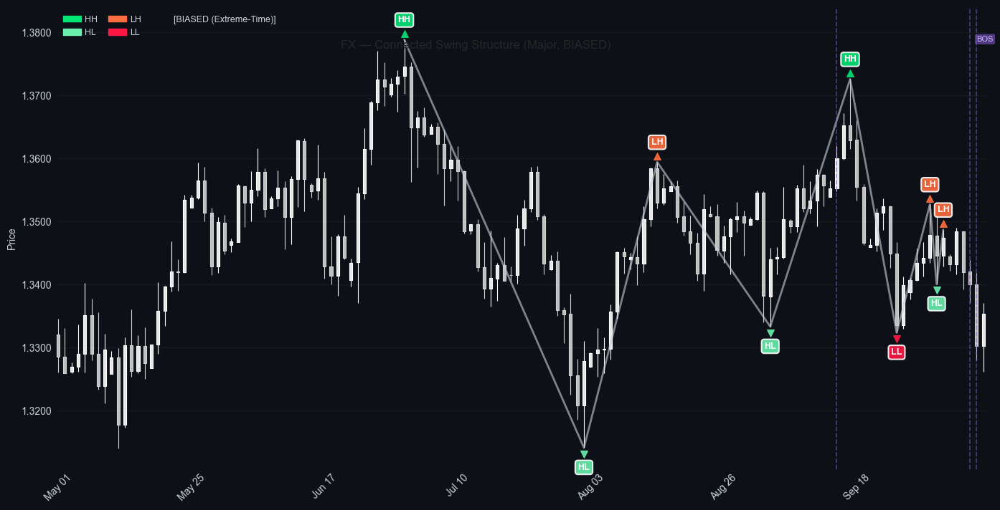

(<Figure size 1495x747.5 with 2 Axes>, <Axes: ylabel='Price'>)

In [3]:
plot_swings_connected(
    data,
    level='Major',
    start_date='2025-05-01',
    end_date='2025-10-10',
    connect_swings=True,
    use_biased=True,           # ML-READY
    highlight_impulse=True,     # color segments: green (faster) / orange-red (slower)
    show_bos=True
)

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/2565684872.py:512: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


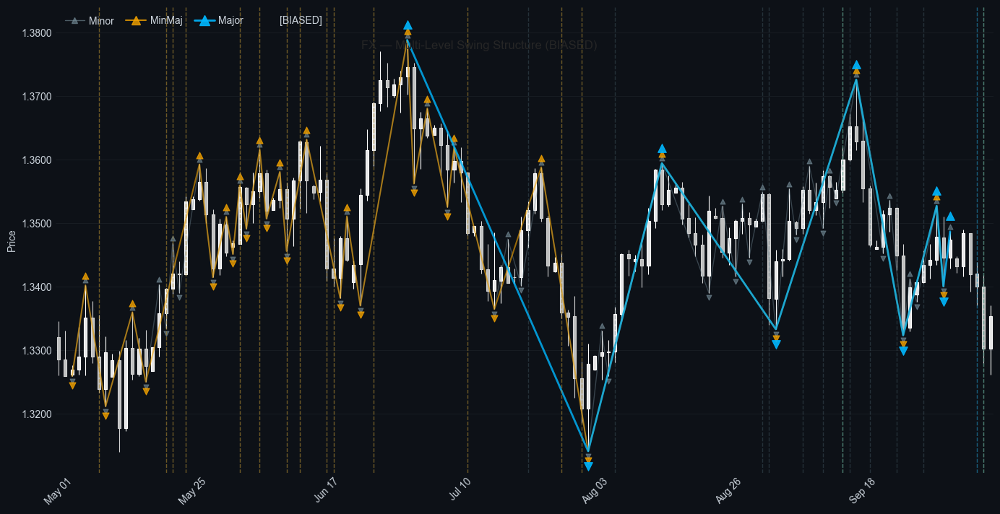

(<Figure size 1495x747.5 with 2 Axes>, <Axes: ylabel='Price'>)

In [4]:
plot_multi_level_connected(
    data,
    start_date='2025-05-01',
    end_date='2025-10-10',
    connect_swings=True,
    use_biased=True,
    show_bos=True
)

# MTF

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mplfinance as mpf
import ta.momentum
from dataclasses import dataclass
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ============================================================
# CONFIG
# ============================================================
DUKASCOPY_INSTRUMENT = 'GBPUSD'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "1h"  # Hourly data

# ============================================================
# DATA CLASSES
# ============================================================
@dataclass
class LocalExtreme:
    """Represents a swing high or low point with confirmation data"""
    ext_type: int  # 1 for high, -1 for low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    """Represents a structural price level for BOS detection"""
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ============================================================
# DIRECTIONAL CHANGE DETECTOR
# ============================================================
class FibRetracementDC:
    """
    Fibonacci Retracement-based Directional Change detector.
    Identifies swing highs and lows based on a retracement percentage.
    """
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        ext = LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        )
        self.extremes.append(ext)

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """
    Converts minor (25%) extremes to intermediate major (50%) extremes.
    """
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        if self.base_extremes[0].ext_type == 1:
            last_confirmed_high = self.base_extremes[0]
            last_confirmed_low = None
        else:
            last_confirmed_low = self.base_extremes[0]
            last_confirmed_high = None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == 1:
                            if self.base_extremes[j].price > highest.price:
                                highest = self.base_extremes[j]
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_threshold = highest.price - (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price <= retrace_threshold:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == -1:
                            if self.base_extremes[j].price < lowest.price:
                                lowest = self.base_extremes[j]
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_threshold = lowest.price + (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price >= retrace_threshold:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ============================================================
# PATTERN LIBRARY (18)
# ============================================================
PATTERN_LIBRARY = [
    # CONTINUATIONS
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # SIMPLE REVERSALS
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # FAILED REVERSALS
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # TRAPS
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # STRUCTURE BREAKS
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # COMPLEX REVERSALS
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # FAILED REVERSAL EXTENSIONS
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # LIQUIDITY SWEEPS
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============================================================
# BIASED PLOTTING COLUMNS (for charts only)
# ============================================================
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    """
    BIASED COLUMNS - FOR PLOTTING/REFERENCE ONLY
    These are marked at EXTREME time and contain lookahead bias
    DO NOT USE FOR ML OR BACKTESTING
    """
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for ext in extremes_dict['minor']:
        df.loc[ext.timestamp, 'MinorSwingHigh' if ext.ext_type == 1 else 'MinorSwingLow'] = 1
    for ext in extremes_dict['minmaj']:
        df.loc[ext.timestamp, 'MinMajSwingHigh' if ext.ext_type == 1 else 'MinMajSwingLow'] = 1
    for ext in extremes_dict['major']:
        df.loc[ext.timestamp, 'MajorSwingHigh' if ext.ext_type == 1 else 'MajorSwingLow'] = 1
    
    # Labels (BIASED) – Minor
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_highs):
        label = 'H' if i == 0 else ('HH' if cur.price > minor_highs[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minor_lows):
        label = 'L' if i == 0 else ('HL' if cur.price > minor_lows[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – MinMaj
    minmaj_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    minmaj_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(minmaj_highs):
        if i == 0:
            label = 'H'
        else:
            prev = minmaj_highs[i-1]
            interm = [h for h in minor_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minmaj_lows):
        if i == 0:
            label = 'L'
        else:
            prev = minmaj_lows[i-1]
            interm = [l for l in minor_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – Major
    major_highs = [e for e in extremes_dict['major'] if e.ext_type == 1]
    major_lows = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(major_highs):
        if i == 0:
            label = 'H'
        else:
            prev = major_highs[i-1]
            interm = [h for h in minmaj_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(major_lows):
        if i == 0:
            label = 'L'
        else:
            prev = major_lows[i-1]
            interm = [l for l in minmaj_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    return df

# ============================================================
# ML-READY LABELS (NO LOOKAHEAD) - WITH VERBOSE DIAGNOSTICS
# ============================================================
def add_ml_ready_swing_labels(df, extremes_dict):
    """
    ML-READY SWING LABELS - NO LOOKAHEAD BIAS
    All labels marked at CONFIRMATION time with full metadata
    NOW WITH VERBOSE VOLUME DIAGNOSTICS
    """
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    timeframe_map = {
        'Minor': extremes_dict['minor'],
        'MinMaj': extremes_dict['minmaj'],
        'Major': extremes_dict['major']
    }
    
    # Volume diagnostic counters
    volume_success_count = 0
    volume_fail_count = 0
    
    for level_name, extremes_list in timeframe_map.items():
        highs = [e for e in extremes_list if e.ext_type == 1]
        lows = [e for e in extremes_list if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_highs, lower_lows = [], []
        
        # HIGHS
        for i, current in enumerate(highs):
            if i == 0:
                label = 'H'
            else:
                prev = highs[i-1]
                if lower_highs:
                    inter = [h for h in lower_highs if prev.timestamp < h.timestamp < current.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        label = 'HH' if current.price > ref else 'LH'
                    else:
                        label = 'HH' if current.price > prev.price else 'LH'
                else:
                    label = 'HH' if current.price > prev.price else 'LH'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_HighConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingHighPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceHigh'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_High'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceHigh'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceHigh'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromHigh'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    # Volume at extreme
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_High'] = vol_at_ext
                    
                    # Volume at confirmation
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_High'] = vol_at_conf
                    
                    # Total volume during swing
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    # Check if all NaN
                    if vol_slice.isna().all():
                        if volume_fail_count < 3:  # Only print first 3 failures
                            print(f"⚠️  {level_name} High: All volume NaN at {conf_ts}")
                            print(f"   Slice: iloc[{current.index}:{current.conf_index + 1}]")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        # Check if result is valid
                        if pd.isna(tot_vol) or tot_vol == 0:
                            if volume_fail_count < 3:
                                print(f"⚠️  {level_name} High: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                                print(f"   Volume slice: {vol_slice.values}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            # Only print first success for each level as confirmation
                            if volume_success_count == 1:
                                print(f"✅ {level_name} High: Volume calculated successfully at {conf_ts}")
                                print(f"   Total: {tot_vol:.2f}, Avg: {avg_vol:.2f}")
                        
                except Exception as e:
                    if volume_fail_count < 3:
                        print(f"❌ {level_name} High: ERROR at {conf_ts}: {e}")
                        print(f"   Extreme index: {current.index}, Conf index: {current.conf_index}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            else:
                tot_vol = np.nan
            
            # Speed calculations
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            # Momentum calculations (only if volume exists)
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_High'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            # Previous swing comparisons
            if i > 0:
                prev = highs[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_High'] = df.loc[prev_conf, f'{level_name}_DistanceFromHigh']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_High'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_High']
                df.loc[conf_ts, f'{level_name}_Overshoot_High'] = int(current.price > prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS (same logic with diagnostics)
        for i, current in enumerate(lows):
            if i == 0:
                label = 'L'
            else:
                prev = lows[i-1]
                if lower_lows:
                    inter = [l for l in lower_lows if prev.timestamp < l.timestamp < current.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        label = 'LL' if current.price < ref else 'HL'
                    else:
                        label = 'HL' if current.price > prev.price else 'LL'
                else:
                    label = 'HL' if current.price > prev.price else 'LL'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_LowConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingLowPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceLow'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_Low'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceLow'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceLow'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromLow'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_Low'] = vol_at_ext
                    
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_Low'] = vol_at_conf
                    
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    if vol_slice.isna().all():
                        if volume_fail_count < 3:
                            print(f"⚠️  {level_name} Low: All volume NaN at {conf_ts}")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        if pd.isna(tot_vol) or tot_vol == 0:
                            if volume_fail_count < 3:
                                print(f"⚠️  {level_name} Low: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            
                except Exception as e:
                    if volume_fail_count < 3:
                        print(f"❌ {level_name} Low: ERROR at {conf_ts}: {e}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            else:
                tot_vol = np.nan
            
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_Low'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_Low'] = df.loc[prev_conf, f'{level_name}_DistanceFromLow']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[conf_ts, f'{level_name}_Overshoot_Low'] = int(current.price < prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    # Print volume diagnostic summary
    print(f"\n{'='*60}")
    print(f"VOLUME CALCULATION SUMMARY")
    print(f"{'='*60}")
    print(f"✅ Successful volume calculations: {volume_success_count}")
    print(f"❌ Failed volume calculations: {volume_fail_count}")
    if volume_fail_count > 0:
        print(f"⚠️  Some swings missing volume data - check diagnostics above")
    print(f"{'='*60}\n")
    
    return df

# ============================================================
# NEW: Impulse vs Retracement speed flags (confirmation-time)
# ============================================================
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    """
    Compute 'ImpulseFaster' flags for highs and lows (no lookahead).
    Impulse: previous swing → current swing
    Retracement: current swing → confirmation
    """
    extremes = extremes_dict[level_name.lower()]
    highs = [e for e in extremes if e.ext_type == 1]
    lows = [e for e in extremes if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            conf_ts = cur.conf_timestamp
            if conf_ts not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[conf_ts, col] = faster
    
    _flag(highs, is_high=True)
    _flag(lows, is_high=False)

# ============================================================
# NEW: MinMaj checks BOTH Minor (lower) and Major (upper) context
# ============================================================
def add_bidirectional_cross_tf_context(df):
    """
    Makes MinMaj aware of BOTH Minor (lower) and Major (upper) structure.
    Adds:
    - MinMaj_LowerLabel: latest Minor_ConfirmedLabel active at that bar
    - MinMaj_UpperLabel: latest Major_ConfirmedLabel active at that bar
    - MinMaj_StructureBias: 'bullish'/'bearish'/'neutral' combining both
    """
    # Lower (Minor → MinMaj)
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    # Upper (Major → MinMaj)
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    # Combined bias
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        low_lbl = df.at[t, 'MinMaj_LowerLabel']
        up_lbl = df.at[t, 'MinMaj_UpperLabel']
        if low_lbl in bull and up_lbl in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif low_lbl in bear and up_lbl in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    
    return df

# ============================================================
# PATTERN DETECTION (multi-TF)
# ============================================================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError(f"Level must be 'Minor', 'MinMaj', or 'Major', got: {level}")
    extremes = extremes_dict[level_map[level]]
    
    for pattern in pattern_library:
        p = pattern['name']
        col = f"{level}_{p}"
        df[f'{col}_Active'] = 0
        df[f'{col}_Swings'] = ''
        df[f'{col}_BOS_Target'] = np.nan
        df[f'{col}_Awaiting_BOS'] = 0
        df[f'{col}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        px = df.iloc[i]['close']
        confirmed = [e for e in extremes if e.conf_timestamp <= t]
        if len(confirmed) < 2:
            continue
        
        new_conf = [e for e in confirmed if e.conf_timestamp == t]
        for _ in new_conf:
            for pattern in pattern_library:
                seq = pattern['sequence']
                N = len(seq)
                if len(confirmed) >= N:
                    recent = confirmed[-N:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({
                            'config': pattern,
                            'swings': recent,
                            'bos_target_price': recent[pattern['bos_target_index']].price,
                            'confirmed_at': t,
                            'bos_occurred': False
                        })
        
        rm = []
        for idx, pat in enumerate(active):
            name = pat['config']['name']
            col = f"{level}_{name}"
            bos_dir = pat['config']['bos_direction']
            target = pat['bos_target_price']
            struct = pat['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{col}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_BOS_Target')] = target
            df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in pat['swings']])
            
            bos = (px > target) if bos_dir == 'above' else (px < target)
            if bos and not pat['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{col}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                pat['bos_occurred'] = True
                rm.append(idx)
            
            if struct == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(rm, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ============================================================
# SUMMARIES
# ============================================================
def print_ml_ready_summary_multi_tf(df, pattern_library):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - ALL TIMEFRAMES")
    print("="*60)
    print("\n--- Confirmed Swing Counts (No Lookahead) ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"{lvl}: {int(df[f'{lvl}_HighConfirmed'].sum())} highs, {int(df[f'{lvl}_LowConfirmed'].sum())} lows confirmed")
    
    print("\n--- Pattern Detection Summary by Timeframe ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"\n{lvl} Timeframe:")
        total_bos = int(df[f'{lvl}_Total_BOS_Events'].sum())
        if total_bos > 0:
            for p in pattern_library:
                name = p['name']
                col = f"{lvl}_{name}_BOS_Confirmed"
                cnt = int(df[col].sum())
                if cnt > 0:
                    print(f"  {name}: {cnt} BOS events")
            print(f"  Total BOS: {total_bos}")
        else:
            print("  No BOS events detected")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}")
    print(f"MOMENTUM & GAP ANALYSIS: {level} Level")
    print(f"{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gap_swings = swings[swings['HasGap']]
    normal_swings = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal swings (no gap): {len(normal_swings)}")
    print(f"Gap swings (weekend/low liquidity): {len(gap_swings)}")
    
    if len(normal_swings) > 0:
        print(f"\nNormal swings:")
        print(f"  Avg bars/hour: {normal_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {normal_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {normal_swings['Momentum'].mean():.2f}")
    
    if len(gap_swings) > 0:
        print(f"\nGap swings:")
        print(f"  Avg bars/hour: {gap_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {gap_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {gap_swings['Momentum'].mean():.2f}")

# ============================================================
# DATA LOADING
# ============================================================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported. Available: {list(instrument_map.keys())}")
    
    print(f"\nFetching data from Dukascopy...")
    print(f"Instrument: {instrument}")
    print(f"Period: {start_date} to {end_date}")
    print(f"Interval: {interval}")
    
    try:
        start = datetime.strptime(start_date, '%Y-%m-%d')
        end = datetime.strptime(end_date, '%Y-%m-%d')
        
        interval_map = {
            '1d': dukascopy_python.INTERVAL_DAY_1,
            '1h': dukascopy_python.INTERVAL_HOUR_1,
            '4h': dukascopy_python.INTERVAL_HOUR_4,
            '30m': dukascopy_python.INTERVAL_MIN_30,
            '15m': dukascopy_python.INTERVAL_MIN_15,
            '5m': dukascopy_python.INTERVAL_MIN_5,
        }
        
        if interval not in interval_map:
            raise ValueError(f"Interval {interval} not supported. Use: {list(interval_map.keys())}")
        
        df = dukascopy_python.fetch(
            instrument=instrument_map[instrument],
            interval=interval_map[interval],
            offer_side=dukascopy_python.OFFER_SIDE_BID,
            start=start,
            end=end,
        )
        
        if df.empty:
            raise ValueError(f"No data returned for {instrument}. Check date range.")
        
        df = df.reset_index()
        df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
        df = df.set_index('time')
        df.columns = df.columns.str.lower()
        df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
        
        print(f"✅ Successfully loaded {len(df)} bars")
        print(f"Date range: {df.index.min()} to {df.index.max()}")
        
        return df
    except Exception as e:
        print(f"❌ Error loading data: {e}")
        print("\n💡 Troubleshooting tips:")
        print("  1. pip install dukascopy-python")
        print("  2. Check the dates and interval")
        print("  3. Try a different range or pair")
        raise

def load_data(paths=None):
    if paths:
        dfs = []
        for path in paths:
            df = pd.read_csv(path)
            df.columns = df.columns.str.strip().str.lower()
            df.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(df)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        df = df.set_index("time")
        return df
    else:
        return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)

# ============================================================
# MAIN
# ============================================================
if __name__ == '__main__':
    print("=" * 60)
    print("FULLY ML-READY PATTERN DETECTION")
    print("ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING")
    print("DATA SOURCE: Dukascopy")
    print("=" * 60)
    
    print("\nLoading dataset from Dukascopy...")
    data15 = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    data15 = data15.sort_index()
    data15 = data15[~data15.index.duplicated(keep='first')]
    
    print(f"Total rows: {len(data15)}")
    print(f"Date range: {data15.index.min()} to {data15.index.max()}")
    
    h = data15['high'].to_numpy()
    l = data15['low'].to_numpy()
    c = data15['close'].to_numpy()
    
    print("\nCalculating RSI...")
    data15['RSI'] = ta.momentum.rsi(data15['close'], window=14)
    
    print("\n" + "=" * 60)
    print("SWING DETECTION")
    print("=" * 60)
    
    print("\nDetecting Minor swings (25%)...")
    fib_25 = FibRetracementDC(retrace_pct=0.25)
    for i in range(len(h)):
        fib_25.update(i, data15.index, h, l, c)
    print(f"Minor: {len(fib_25.extremes)} extremes")
    
    print("Processing MinMaj swings...")
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj: {len(minmaj.extremes)} extremes")
    
    print("Detecting Major swings (50%)...")
    fib_50 = FibRetracementDC(retrace_pct=0.50)
    for i in range(len(h)):
        fib_50.update(i, data15.index, h, l, c)
    print(f"Major: {len(fib_50.extremes)} extremes")
    
    extremes_dict = {
        'minor': fib_25.extremes,
        'minmaj': minmaj.extremes,
        'major': fib_50.extremes
    }
    
    print("\n" + "=" * 60)
    print("ADDING ML-READY FEATURES")
    print("=" * 60)
    
    print("\nAdding BIASED columns for plotting/reference...")
    data15 = add_biased_swing_columns_for_plotting(data15, extremes_dict)
    
    print("Adding ML-ready swing labels (all at confirmation time)...")
    print("⚠️  Watch for volume calculation diagnostics below:")
    data15 = add_ml_ready_swing_labels(data15, extremes_dict)
    
    # NEW: Impulse vs Retracement speed rule (confirmation-time flags)
    for lvl in ['Minor', 'MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(data15, extremes_dict, lvl, margin=1.05)
    
    # NEW: MinMaj checks BOTH Minor and Major (cross-TF context)
    data15 = add_bidirectional_cross_tf_context(data15)
    
    print("\n" + "=" * 60)
    print("MULTI-TIMEFRAME PATTERN DETECTION")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        print(f"\nDetecting patterns at {level} level...")
        data15 = detect_flexible_patterns_multi_tf(data15, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(data15, PATTERN_LIBRARY)
    
    print("\n" + "=" * 60)
    print("MOMENTUM & GAP ANALYSIS")
    print("=" * 60)
    
    for lvl in ['Major', 'MinMaj', 'Minor']:
        analyze_duration_differences(data15, level=lvl)
    
    print("\n" + "=" * 60)
    print("EXPORTING ML-READY DATA")
    print("=" * 60)
    
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    data15.to_csv(output_file)
    print(f"\nFull ML-ready dataset saved to {output_file}")
    print(f"Total columns: {len(data15.columns)}")
    
    swing_cols = [c for c in data15.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed_swings = data15[data15[swing_cols].any(axis=1)].copy()
    swings_file = None
    if len(confirmed_swings) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed_swings.to_csv(swings_file)
        print(f"Confirmed swings saved to {swings_file} ({len(confirmed_swings)} rows)")
    
    pattern_cols = [c for c in data15.columns if '_BOS_Confirmed' in c]
    pattern_events = data15[data15[pattern_cols].any(axis=1)].copy()
    events_file = None
    if len(pattern_events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        pattern_events.to_csv(events_file)
        print(f"Pattern BOS events saved to {events_file} ({len(pattern_events)} rows)")
    
    print("\n" + "=" * 60)
    print("ML-READY COLUMN REFERENCE (Key)")
    print("=" * 60)
    print("❌ Biased (plotting-only): *_SwingLabel_BIASED, *_SwingPrice_BIASED, *_IsSwingPoint_BIASED")
    print("✅ ML-ready (no lookahead):")
    print("  • {Level}_HighConfirmed / {Level}_LowConfirmed")
    print("  • {Level}_ConfirmedLabel ∈ {HH,HL,LH,LL} (at confirmation)")
    print("  • {Level}_Bars/Hours/MinutesSinceHigh/Low, {Level}_DistanceFromHigh/Low")
    print("  • {Level}_Momentum_* & {Level}_Momentum_Adjusted_*, {Level}_HasWeekendGap_*")
    print("  • {Level}_Overshoot_*, {Level}_PrevSwing*")
    print("  • NEW: {Level}_ImpulseFaster_High/Low (impulse faster than retrace)")
    print("  • NEW (MinMaj): MinMaj_LowerLabel (Minor), MinMaj_UpperLabel (Major), MinMaj_StructureBias")
    
    print("\n" + "=" * 60)
    print("VALIDATION")
    print("=" * 60)
    
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(data15['Minor_HighConfirmed'].sum() + data15['Minor_LowConfirmed'].sum())
    print(f"Minor swings detected: {total_minor}")
    print(f"Minor swings confirmed in data: {total_confirmed_minor}")
    if total_minor == total_confirmed_minor:
        print("✅ PASS: All swings confirmed, no lookahead")
    else:
        print("⚠️ WARNING: Mismatch in counts")
    
    for lvl in ['Minor', 'MinMaj', 'Major']:
        active_bars = int(data15[f'{lvl}_Any_Bullish_Pattern'].sum() + data15[f'{lvl}_Any_Bearish_Pattern'].sum())
        print(f"{lvl}: {active_bars} bars with active patterns")
    
    print("\n" + "=" * 60)
    print("✅ ML-READY DATASET COMPLETE!")
    print("=" * 60)

FULLY ML-READY PATTERN DETECTION
ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING
DATA SOURCE: Dukascopy

Loading dataset from Dukascopy...

Fetching data from Dukascopy...
Instrument: GBPUSD
Period: 2025-01-01 to 2025-10-12
Interval: 1h
✅ Successfully loaded 4848 bars
Date range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:00:00+00:00
Total rows: 4848
Date range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:00:00+00:00

Calculating RSI...

SWING DETECTION

Detecting Minor swings (25%)...
Minor: 1962 extremes
Processing MinMaj swings...
MinMaj: 1120 extremes
Detecting Major swings (50%)...
Major: 56 extremes

ADDING ML-READY FEATURES

Adding BIASED columns for plotting/reference...
Adding ML-ready swing labels (all at confirmation time)...
⚠️  Watch for volume calculation diagnostics below:
✅ Minor High: Volume calculated successfully at 2025-01-02 05:00:00+00:00
   Total: 3535.50, Avg: 1767.75

VOLUME CALCULATION SUMMARY
✅ Successful volume calculations: 3138
❌ Failed volume calculat

In [6]:
data15.shape

(4848, 441)

In [7]:
data15.head(50)

,open,high,low,close,volume,RSI,MinorSwingHigh,MinorSwingLow,MinMajSwingHigh,MinMajSwingLow,...,Major_Bullish_Liquidity_Sweep_BOS_Confirmed,Major_Bearish_Liquidity_Sweep_Active,Major_Bearish_Liquidity_Sweep_Swings,Major_Bearish_Liquidity_Sweep_BOS_Target,Major_Bearish_Liquidity_Sweep_Awaiting_BOS,Major_Bearish_Liquidity_Sweep_BOS_Confirmed,Major_Any_Bullish_Pattern,Major_Any_Bearish_Pattern,Major_Active_Pattern_Names,Major_Total_BOS_Events
time,,,,,,,,,,,,,,,,,,,,,
2025-01-01 22:00:00+00:00,1.25134,1.25150,1.25097,1.25125,1444.00,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-01 23:00:00+00:00,1.25125,1.25194,1.25059,1.25193,7970.28,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 00:00:00+00:00,1.25190,1.25203,1.25089,1.25161,4802.20,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 01:00:00+00:00,1.25162,1.25220,1.25114,1.25196,12426.18,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 02:00:00+00:00,1.25198,1.25331,1.25196,1.25331,2659.11,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 03:00:00+00:00,1.25332,1.25364,1.25299,1.25362,2340.66,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 04:00:00+00:00,1.25363,1.25402,1.25312,1.25342,2260.26,NaN,1,0,1,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 05:00:00+00:00,1.25341,1.25355,1.25290,1.25320,1275.24,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0
2025-01-02 06:00:00+00:00,1.25320,1.25330,1.25277,1.25290,1699.14,NaN,0,0,0,0,...,0,0,,NaN,0,0,0,0,,0


## MTF Visual

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
import matplotlib.ticker as mticker
import mplfinance as mpf

def plot_swings_connected(
    data15,
    level='Major',
    last_n=700,
    start_date=None,
    end_date=None,
    title='GBPUSD — Connected Swing Structure',
    up_color='white',
    down_color='#D3D3D3',
    show_labels=True,
    connect_swings=False,
    use_biased=True
):
    """
    Plot candlesticks with connected swing points and HH/HL/LH/LL labels.

    Args:
        data15: DataFrame with swing analysis
        level: 'Minor', 'MinMaj', or 'Major'
        last_n: Bars to show if no date range passed
        start_date, end_date: optional date filters
        show_labels: draw HH/HL/LH/LL badges
        connect_swings: join swing points with a line
        use_biased: True -> *_BIASED columns (extreme time); False -> ML-ready (confirmation time)
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = data15.copy()
        tz = getattr(df.index, 'tz', None)

        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        df = data15.tail(last_n).copy()
    
    # Columns for the selected mode
    if use_biased:
        high_col = f'{level}SwingHigh'
        low_col  = f'{level}SwingLow'
        if high_col not in df.columns or low_col not in df.columns:
            print(f"❌ Error: {level} swing columns not found in data")
            return None, None
        label_col = f'{level}_SwingLabel_BIASED'
        price_col = f'{level}_SwingPrice_BIASED'
    else:
        high_col = f'{level}_HighConfirmed'
        low_col  = f'{level}_LowConfirmed'
        if high_col not in df.columns or low_col not in df.columns:
            print(f"❌ Error: {level} confirmed columns not found in data")
            return None, None
        label_col = f'{level}_ConfirmedLabel'
        price_high_col = f'{level}_SwingHighPrice'
        price_low_col  = f'{level}_SwingLowPrice'
        for col in [label_col, price_high_col, price_low_col]:
            if col not in df.columns:
                print(f"❌ Error: required column '{col}' not found")
                return None, None

    # Any swings?
    if (df[high_col].sum() == 0) and (df[low_col].sum() == 0):
        print(f"⚠️  Warning: No {level} swings found in the selected range")
        return None, None
    
    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015
    
    # Colors by label
    label_colors = {
        'HH': '#00e676', 'HL': '#69f0ae',
        'LH': '#ff6e40', 'LL': '#ff1744',
        'H':  '#00b7ff', 'L':  '#00b7ff'
    }
    
    # mpf style
    mc = mpf.make_marketcolors(up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in')
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid',
        marketcolors=mc,
        gridcolor='#22272e',
        facecolor='#0d1117',
        edgecolor='#0d1117',
        figcolor='#0d1117',
        rc={'axes.labelcolor': '#c9d1d9','xtick.color': '#c9d1d9','ytick.color': '#c9d1d9','font.size': 10}
    )
    
    # Create scatter series per label
    apds = []
    for lbl, color in label_colors.items():
        if use_biased:
            mask_high = (df[high_col] == 1) & (df[label_col] == lbl)
            if mask_high.any():
                apds.append(mpf.make_addplot(df['high'].where(mask_high) + offset, type='scatter',
                                             marker='^', markersize=50, color=color, alpha=0.9))
            mask_low = (df[low_col] == 1) & (df[label_col] == lbl)
            if mask_low.any():
                apds.append(mpf.make_addplot(df['low'].where(mask_low) - offset, type='scatter',
                                             marker='v', markersize=50, color=color, alpha=0.9))
        else:
            mask_high = (df[high_col] == 1) & (df[label_col] == lbl)
            if mask_high.any():
                apds.append(mpf.make_addplot(df[price_high_col].where(mask_high) + offset, type='scatter',
                                             marker='^', markersize=50, color=color, alpha=0.9))
            mask_low = (df[low_col] == 1) & (df[label_col] == lbl)
            if mask_low.any():
                apds.append(mpf.make_addplot(df[price_low_col].where(mask_low) - offset, type='scatter',
                                             marker='v', markersize=50, color=color, alpha=0.9))
    
    # Plot
    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None, volume=False, style=style,
        figratio=(20, 10), figscale=1.3, title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]
    
    # Thin wicks
    for line in ax.lines:
        line.set_linewidth(0.8)
    for coll in ax.collections:
        try: coll.set_linewidth(0.8)
        except: pass
    
    # Connect swing points
    if connect_swings:
        swing_points = df[df[label_col] != ''].copy()
        if len(swing_points) > 1:
            x_positions = []
            y_positions = []
            for idx in swing_points.index:
                if idx in df.index:
                    x_positions.append(df.index.get_loc(idx))
                    if use_biased:
                        y_positions.append(swing_points.loc[idx, price_col])
                    else:
                        if swing_points.loc[idx, high_col] == 1:
                            y_positions.append(swing_points.loc[idx, price_high_col])
                        else:
                            y_positions.append(swing_points.loc[idx, price_low_col])
            if len(x_positions) > 1:
                ax.plot(x_positions, y_positions, color='#c9d1d9', linewidth=2, linestyle='-', alpha=0.6, zorder=2)
    
    # Text labels
    if show_labels:
        swing_points = df[df[label_col] != ''].copy()
        for idx, row in swing_points.iterrows():
            if idx not in df.index: 
                continue
            x_pos = df.index.get_loc(idx)
            lbl = row[label_col]
            if use_biased:
                price = row[price_col]
            else:
                price = row[f'{level}_SwingHighPrice'] if row[high_col] == 1 else row[f'{level}_SwingLowPrice']
            is_high = (row[high_col] == 1)
            y_pos = price + (offset * 2.5 if is_high else -offset * 2.5)
            va = 'bottom' if is_high else 'top'
            text_color = label_colors.get(lbl, '#c9d1d9')
            ax.text(
                x_pos, y_pos, lbl, ha='center', va=va, color='white', fontsize=9, fontweight='bold',
                bbox=dict(boxstyle='round,pad=0.3', facecolor=text_color, edgecolor='white', linewidth=1.5, alpha=0.9),
                zorder=10
            )
    
    # Formatting
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)
    
    # Legend
    mode_text = "BIASED (Extreme Time)" if use_biased else "ML-READY (Confirmation Time)"
    legend_handles = [
        mpatches.Patch(color='#00e676', label='HH'),
        mpatches.Patch(color='#69f0ae', label='HL'),
        mpatches.Patch(color='#ff6e40', label='LH'),
        mpatches.Patch(color='#ff1744', label='LL'),
        mpatches.Patch(color='none', label=f'[{mode_text}]'),
    ]
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left', ncols=3,
                    handletextpad=0.4, columnspacing=1.2, fontsize=9)
    for text in leg.get_texts(): text.set_color('#c9d1d9')
    
    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)
    fig.tight_layout()
    plt.show()
    return fig, ax


def plot_multi_level_connected(
    data15,
    last_n=700,
    start_date=None,
    end_date=None,
    title='GBPUSD — Multi-Level Swing Structure',
    up_color='white',
    down_color='#D3D3D3',
    use_biased=True,
    connect_swings=False
):
    """
    Plot Minor, MinMaj, and Major swings together with connections.
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = data15.copy()
        tz = getattr(df.index, 'tz', None)
        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        # ✅ fixed typo: use data15 here
        df = data15.tail(last_n).copy()
    
    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015
    
    mc = mpf.make_marketcolors(up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in')
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid', marketcolors=mc,
        gridcolor='#22272e', facecolor='#0d1117', edgecolor='#0d1117', figcolor='#0d1117',
        rc={'axes.labelcolor':'#c9d1d9','xtick.color':'#c9d1d9','ytick.color':'#c9d1d9','font.size':10}
    )
    
    apds = []
    if use_biased:
        minor_high = df['high'].where(df['MinorSwingHigh'] == 1) + offset * 0.8
        minor_low  = df['low'].where(df['MinorSwingLow']  == 1) - offset * 0.8
        minmaj_high = df['high'].where(df['MinMajSwingHigh'] == 1) + offset * 1.5
        minmaj_low  = df['low'].where(df['MinMajSwingLow']  == 1) - offset * 1.5
        major_high = df['high'].where(df['MajorSwingHigh'] == 1) + offset * 2.5
        major_low  = df['low'].where(df['MajorSwingLow']  == 1) - offset * 2.5
        
        if minor_high.notna().any(): apds.append(mpf.make_addplot(minor_high, type='scatter', marker='^', markersize=25, color='#78909c', alpha=0.6))
        if minor_low.notna().any():  apds.append(mpf.make_addplot(minor_low,  type='scatter', marker='v', markersize=25, color='#78909c', alpha=0.6))
        if minmaj_high.notna().any(): apds.append(mpf.make_addplot(minmaj_high, type='scatter', marker='^', markersize=42, color='#f4a300', alpha=0.8))
        if minmaj_low.notna().any():  apds.append(mpf.make_addplot(minmaj_low,  type='scatter', marker='v', markersize=42, color='#f4a300', alpha=0.8))
        if major_high.notna().any(): apds.append(mpf.make_addplot(major_high, type='scatter', marker='^', markersize=70, color='#00b7ff', alpha=0.9))
        if major_low.notna().any():  apds.append(mpf.make_addplot(major_low,  type='scatter', marker='v', markersize=70, color='#00b7ff', alpha=0.9))
    else:
        # ML-ready (confirmation)
        def add_if(cols_ok, series, **kwargs):
            if cols_ok and series.notna().any():
                apds.append(mpf.make_addplot(series, **kwargs))
        add_if({'Minor_SwingHighPrice','Minor_HighConfirmed'}.issubset(df.columns),
               df['Minor_SwingHighPrice'].where(df['Minor_HighConfirmed']==1)+offset*0.8,
               type='scatter', marker='^', markersize=25, color='#78909c', alpha=0.6)
        add_if({'Minor_SwingLowPrice','Minor_LowConfirmed'}.issubset(df.columns),
               df['Minor_SwingLowPrice'].where(df['Minor_LowConfirmed']==1)-offset*0.8,
               type='scatter', marker='v', markersize=25, color='#78909c', alpha=0.6)
        add_if({'MinMaj_SwingHighPrice','MinMaj_HighConfirmed'}.issubset(df.columns),
               df['MinMaj_SwingHighPrice'].where(df['MinMaj_HighConfirmed']==1)+offset*1.5,
               type='scatter', marker='^', markersize=42, color='#f4a300', alpha=0.8)
        add_if({'MinMaj_SwingLowPrice','MinMaj_LowConfirmed'}.issubset(df.columns),
               df['MinMaj_SwingLowPrice'].where(df['MinMaj_LowConfirmed']==1)-offset*1.5,
               type='scatter', marker='v', markersize=42, color='#f4a300', alpha=0.8)
        add_if({'Major_SwingHighPrice','Major_HighConfirmed'}.issubset(df.columns),
               df['Major_SwingHighPrice'].where(df['Major_HighConfirmed']==1)+offset*2.5,
               type='scatter', marker='^', markersize=70, color='#00b7ff', alpha=0.9)
        add_if({'Major_SwingLowPrice','Major_LowConfirmed'}.issubset(df.columns),
               df['Major_SwingLowPrice'].where(df['Major_LowConfirmed']==1)-offset*2.5,
               type='scatter', marker='v', markersize=70, color='#00b7ff', alpha=0.9)
    
    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None,
        volume=False, style=style, figratio=(20, 10), figscale=1.3,
        title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]
    for line in ax.lines: line.set_linewidth(0.8)
    for coll in ax.collections:
        try: coll.set_linewidth(0.8)
        except: pass
    
    # Connect swings per level
    if connect_swings:
        if use_biased:
            levels = [
                ('Minor','Minor_SwingPrice_BIASED','#78909c',1,0.4),
                ('MinMaj','MinMaj_SwingPrice_BIASED','#f4a300',1.5,0.6),
                ('Major','Major_SwingPrice_BIASED','#00b7ff',2,0.8)
            ]
            for lvl, price_col, color, lw, alpha in levels:
                label_col = f'{lvl}_SwingLabel_BIASED'
                if label_col in df.columns and price_col in df.columns:
                    sp = df[df[label_col] != ''].copy()
                    if len(sp) > 1:
                        xs = [df.index.get_loc(i) for i in sp.index if i in df.index]
                        ys = [sp.loc[i, price_col] for i in sp.index if i in df.index]
                        ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)
        else:
            levels = [
                ('Minor','Minor_ConfirmedLabel','Minor_SwingHighPrice','Minor_SwingLowPrice','Minor_HighConfirmed','Minor_LowConfirmed','#78909c',1,0.4),
                ('MinMaj','MinMaj_ConfirmedLabel','MinMaj_SwingHighPrice','MinMaj_SwingLowPrice','MinMaj_HighConfirmed','MinMaj_LowConfirmed','#f4a300',1.5,0.6),
                ('Major','Major_ConfirmedLabel','Major_SwingHighPrice','Major_SwingLowPrice','Major_HighConfirmed','Major_LowConfirmed','#00b7ff',2,0.8)
            ]
            for lvl, lbl_col, hi_col, lo_col, hi_flag, lo_flag, color, lw, alpha in levels:
                if lbl_col in df.columns:
                    sp = df[df[lbl_col] != ''].copy()
                    if len(sp) > 1:
                        xs, ys = [], []
                        for i in sp.index:
                            if i in df.index:
                                xs.append(df.index.get_loc(i))
                                ys.append(sp.loc[i, hi_col] if sp.loc[i, hi_flag]==1 else sp.loc[i, lo_col])
                        if len(xs) > 1:
                            ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)
    
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)
    
    mode_text = "BIASED" if use_biased else "ML-READY"
    legend_handles = [
        mlines.Line2D([], [], color='#78909c', marker='^', linestyle='-', markersize=6,  linewidth=1,   label='Minor', alpha=0.6),
        mlines.Line2D([], [], color='#f4a300', marker='^', linestyle='-', markersize=8,  linewidth=1.5, label='MinMaj', alpha=0.8),
        mlines.Line2D([], [], color='#00b7ff', marker='^', linestyle='-', markersize=10, linewidth=2,   label='Major', alpha=0.9),
        mlines.Line2D([], [], color='none', linestyle='', label=f'[{mode_text}]'),
    ]
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left', ncols=4, handletextpad=0.4, columnspacing=1.2)
    for text in leg.get_texts(): text.set_color('#c9d1d9')
    
    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)
    fig.tight_layout()
    plt.show()
    return fig, ax

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/3705384161.py:202: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


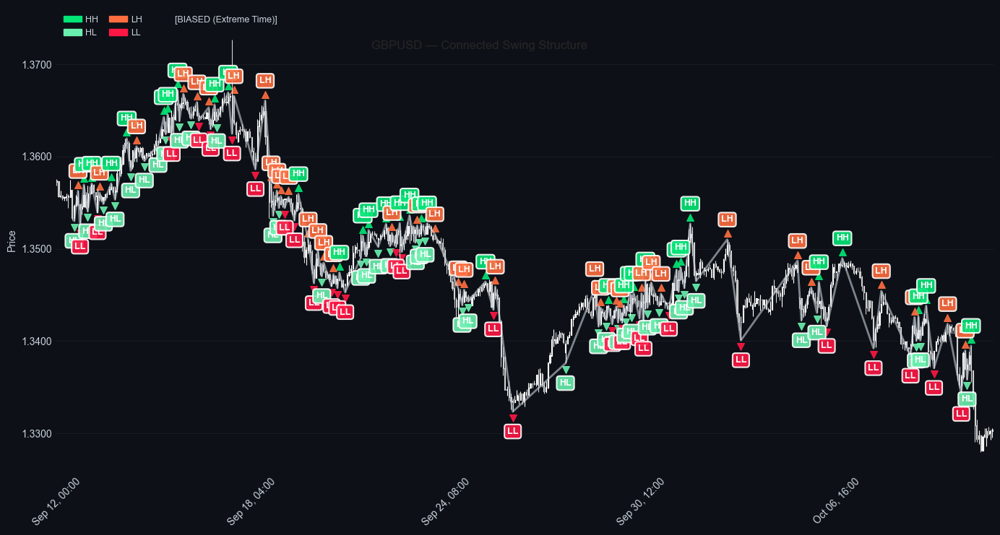

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/3705384161.py:352: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


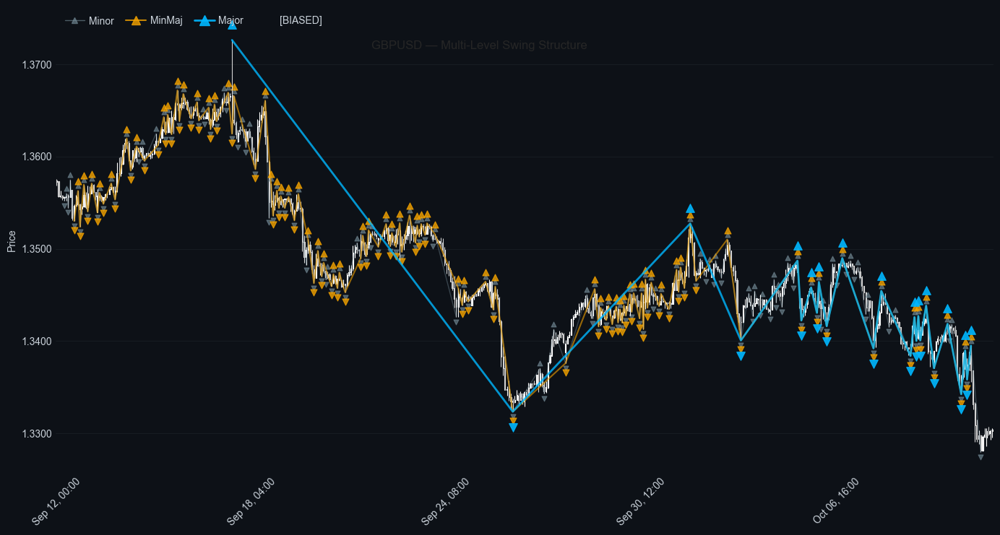

(<Figure size 1495x747.5 with 2 Axes>, <Axes: ylabel='Price'>)

In [9]:
# example
plot_swings_connected(data15, level='MinMaj', start_date='2025-09-12', end_date='2025-10-10', connect_swings=True, use_biased=True)

# multi-level
plot_multi_level_connected(data15, start_date='2025-09-12', end_date='2025-10-10', connect_swings=True, use_biased=True)

# LTF

In [10]:
import pandas as pd
import numpy as np
import ta.momentum
from dataclasses import dataclass
from datetime import datetime
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ======================= CONFIG =======================
DUKASCOPY_INSTRUMENT = 'GBPUSD'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "15m"  # Supported: 1d, 4h, 1h, 30m, 15m, 5m

# ==================== DATA CLASSES ====================
@dataclass
class LocalExtreme:
    ext_type: int  # 1 high, -1 low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ========== Directional Change (Fibo Retrace) ==========
class FibRetracementDC:
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        self.extremes.append(LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        ))

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """Promote Minor(25%) extremes into MinMaj(≈50%) using confirmation logic."""
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        last_confirmed_high = self.base_extremes[0] if self.base_extremes[0].ext_type == 1 else None
        last_confirmed_low = self.base_extremes[0] if self.base_extremes[0].ext_type == -1 else None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        e = self.base_extremes[j]
                        if e.ext_type == 1:
                            if e.price > highest.price:
                                highest = e
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_th = highest.price - (swing_range * self.retrace_pct)
                            if e.price <= retrace_th:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        e = self.base_extremes[j]
                        if e.ext_type == -1:
                            if e.price < lowest.price:
                                lowest = e
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_th = lowest.price + (swing_range * self.retrace_pct)
                            if e.price >= retrace_th:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ==================== Pattern Library ====================
PATTERN_LIBRARY = [
    # Continuations
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # Simple reversals
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # Failed reversals
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # Traps
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # Structure breaks
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # Complex reversals
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # Failed reversal extensions
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # Liquidity sweeps
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============ Biased columns (for plotting only) ============
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for e in extremes_dict['minor']:
        df.loc[e.timestamp, 'MinorSwingHigh' if e.ext_type == 1 else 'MinorSwingLow'] = 1
    for e in extremes_dict['minmaj']:
        df.loc[e.timestamp, 'MinMajSwingHigh' if e.ext_type == 1 else 'MinMajSwingLow'] = 1
    for e in extremes_dict['major']:
        df.loc[e.timestamp, 'MajorSwingHigh' if e.ext_type == 1 else 'MajorSwingLow'] = 1
    
    minor_h = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_l = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_h):
        lab = 'H' if i == 0 else ('HH' if cur.price > minor_h[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(minor_l):
        lab = 'L' if i == 0 else ('HL' if cur.price > minor_l[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    mm_h = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    mm_l = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(mm_h):
        if i == 0:
            lab = 'H'
        else:
            prev = mm_h[i-1]
            inter = [h for h in minor_h if prev.timestamp < h.timestamp < cur.timestamp]
            if inter:
                ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                lab = 'HH' if cur.price > ref else 'LH'
            else:
                lab = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(mm_l):
        if i == 0:
            lab = 'L'
        else:
            prev = mm_l[i-1]
            inter = [l for l in minor_l if prev.timestamp < l.timestamp < cur.timestamp]
            if inter:
                ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                lab = 'LL' if cur.price < ref else 'HL'
            else:
                lab = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    maj_h = [e for e in extremes_dict['major'] if e.ext_type == 1]
    maj_l = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(maj_h):
        if i == 0:
            lab = 'H'
        else:
            prev = maj_h[i-1]
            inter = [h for h in mm_h if prev.timestamp < h.timestamp < cur.timestamp]
            if inter:
                ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                lab = 'HH' if cur.price > ref else 'LH'
            else:
                lab = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(maj_l):
        if i == 0:
            lab = 'L'
        else:
            prev = maj_l[i-1]
            inter = [l for l in mm_l if prev.timestamp < l.timestamp < cur.timestamp]
            if inter:
                ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                lab = 'LL' if cur.price < ref else 'HL'
            else:
                lab = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    return df

# ================= ML-ready (no lookahead) - FIXED =================
def add_ml_ready_swing_labels(df, extremes_dict):
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    tf_map = {'Minor': extremes_dict['minor'], 'MinMaj': extremes_dict['minmaj'], 'Major': extremes_dict['major']}
    
    for level_name, exts in tf_map.items():
        highs = [e for e in exts if e.ext_type == 1]
        lows = [e for e in exts if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_h = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_l = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_h = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_l = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_h, lower_l = [], []
        
        # HIGHS
        for i, cur in enumerate(highs):
            if i == 0:
                lab = 'H'
            else:
                prev = highs[i-1]
                if lower_h:
                    inter = [h for h in lower_h if prev.timestamp < h.timestamp < cur.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        lab = 'HH' if cur.price > ref else 'LH'
                    else:
                        lab = 'HH' if cur.price > prev.price else 'LH'
                else:
                    lab = 'HH' if cur.price > prev.price else 'LH'
            
            ct = cur.conf_timestamp
            df.loc[ct, f'{level_name}_HighConfirmed'] = 1
            df.loc[ct, f'{level_name}_ConfirmedLabel'] = lab
            df.loc[ct, f'{level_name}_SwingHighPrice'] = cur.price
            
            bars = cur.conf_index - cur.index
            df.loc[ct, f'{level_name}_BarsSinceHigh'] = bars
            df.loc[ct, f'{level_name}_IsFlashEvent_High'] = int(bars == 0)
            
            secs = (cur.conf_timestamp - cur.timestamp).total_seconds()
            df.loc[ct, f'{level_name}_MinutesSinceHigh'] = secs / 60
            df.loc[ct, f'{level_name}_HoursSinceHigh'] = secs / 3600
            
            dist = cur.conf_price - cur.price
            df.loc[ct, f'{level_name}_DistanceFromHigh'] = dist
            
            # ⭐ FIXED VOLUME CALCULATION ⭐
            tot_vol = np.nan
            avg_vol = np.nan
            
            if 'volume' in df.columns:
                df.loc[ct, f'{level_name}_VolumeAtExtreme_High'] = df.iloc[cur.index].get('volume', np.nan)
                df.loc[ct, f'{level_name}_VolumeAtConfirmation_High'] = df.iloc[cur.conf_index].get('volume', np.nan)
                
                try:
                    vol_slice = df.iloc[cur.index:cur.conf_index + 1]['volume']
                    tot_vol = vol_slice.sum()
                    avg_vol = vol_slice.mean()
                except:
                    tot_vol = np.nan
                    avg_vol = np.nan
                
                # ⭐ CRITICAL FIX: Actually store the values! ⭐
                df.loc[ct, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[ct, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            
            spb = dist / bars if bars > 0 else 0
            if secs > 0:
                hrs = secs / 3600
                sph = (dist / secs) * 3600
                spm = (dist / secs) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[ct, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars / hrs) if hrs > 0 else 0
                df.loc[ct, f'{level_name}_BarsPerHour_High'] = bph
                gap = bph < 0.5
                df.loc[ct, f'{level_name}_HasWeekendGap_High'] = int(gap)
                df.loc[ct, f'{level_name}_Momentum_Adjusted_High'] = (spb if gap else sph) * tot_vol
            else:
                df.loc[ct, f'{level_name}_BarsPerHour_High'] = (bars / (secs / 3600)) if secs > 0 else 0
                df.loc[ct, f'{level_name}_HasWeekendGap_High'] = int(df.loc[ct, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            if i > 0:
                prev = highs[i-1]
                pct = prev.conf_timestamp
                df.loc[ct, f'{level_name}_PrevSwingDistance_High'] = df.loc[pct, f'{level_name}_DistanceFromHigh']
                df.loc[ct, f'{level_name}_PrevSwingMomentum_High'] = df.loc[pct, f'{level_name}_Momentum_Adjusted_High']
                df.loc[ct, f'{level_name}_Overshoot_High'] = int(cur.price > prev.price)
                df.loc[ct, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS
        for i, cur in enumerate(lows):
            if i == 0:
                lab = 'L'
            else:
                prev = lows[i-1]
                if lower_l:
                    inter = [l for l in lower_l if prev.timestamp < l.timestamp < cur.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        lab = 'LL' if cur.price < ref else 'HL'
                    else:
                        lab = 'HL' if cur.price > prev.price else 'LL'
                else:
                    lab = 'HL' if cur.price > prev.price else 'LL'
            
            ct = cur.conf_timestamp
            df.loc[ct, f'{level_name}_LowConfirmed'] = 1
            df.loc[ct, f'{level_name}_ConfirmedLabel'] = lab
            df.loc[ct, f'{level_name}_SwingLowPrice'] = cur.price
            
            bars = cur.conf_index - cur.index
            df.loc[ct, f'{level_name}_BarsSinceLow'] = bars
            df.loc[ct, f'{level_name}_IsFlashEvent_Low'] = int(bars == 0)
            
            secs = (cur.conf_timestamp - cur.timestamp).total_seconds()
            df.loc[ct, f'{level_name}_MinutesSinceLow'] = secs / 60
            df.loc[ct, f'{level_name}_HoursSinceLow'] = secs / 3600
            
            dist = cur.conf_price - cur.price
            df.loc[ct, f'{level_name}_DistanceFromLow'] = dist
            
            # ⭐ FIXED VOLUME CALCULATION ⭐
            tot_vol = np.nan
            avg_vol = np.nan
            
            if 'volume' in df.columns:
                df.loc[ct, f'{level_name}_VolumeAtExtreme_Low'] = df.iloc[cur.index].get('volume', np.nan)
                df.loc[ct, f'{level_name}_VolumeAtConfirmation_Low'] = df.iloc[cur.conf_index].get('volume', np.nan)
                
                try:
                    vol_slice = df.iloc[cur.index:cur.conf_index + 1]['volume']
                    tot_vol = vol_slice.sum()
                    avg_vol = vol_slice.mean()
                except:
                    tot_vol = np.nan
                    avg_vol = np.nan
                
                # ⭐ CRITICAL FIX: Actually store the values! ⭐
                df.loc[ct, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[ct, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            
            spb = dist / bars if bars > 0 else 0
            if secs > 0:
                hrs = secs / 3600
                sph = (dist / secs) * 3600
                spm = (dist / secs) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[ct, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars / hrs) if hrs > 0 else 0
                df.loc[ct, f'{level_name}_BarsPerHour_Low'] = bph
                gap = bph < 0.5
                df.loc[ct, f'{level_name}_HasWeekendGap_Low'] = int(gap)
                df.loc[ct, f'{level_name}_Momentum_Adjusted_Low'] = (spb if gap else sph) * tot_vol
            else:
                df.loc[ct, f'{level_name}_BarsPerHour_Low'] = (bars / (secs / 3600)) if secs > 0 else 0
                df.loc[ct, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[ct, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                pct = prev.conf_timestamp
                df.loc[ct, f'{level_name}_PrevSwingDistance_Low'] = df.loc[pct, f'{level_name}_DistanceFromLow']
                df.loc[ct, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[pct, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[ct, f'{level_name}_Overshoot_Low'] = int(cur.price < prev.price)
                df.loc[ct, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    return df

# ===== Impulse vs Retracement flags (confirmation-time) =====
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    exts = extremes_dict[level_name.lower()]
    highs = [e for e in exts if e.ext_type == 1]
    lows = [e for e in exts if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            ct = cur.conf_timestamp
            if ct not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[ct, col] = faster
    
    _flag(highs, True)
    _flag(lows, False)

# ===== MinMaj uses BOTH Minor (lower) and Major (upper) =====
def add_bidirectional_cross_tf_context(df):
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        lo = df.at[t, 'MinMaj_LowerLabel']
        up = df.at[t, 'MinMaj_UpperLabel']
        if lo in bull and up in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif lo in bear and up in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    return df

# ================== Pattern Detection (TF) =================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError("level must be 'Minor','MinMaj','Major'")
    extremes = extremes_dict[level_map[level]]
    
    for p in pattern_library:
        name = p['name']
        pref = f"{level}_{name}"
        df[f'{pref}_Active'] = 0
        df[f'{pref}_Swings'] = ''
        df[f'{pref}_BOS_Target'] = np.nan
        df[f'{pref}_Awaiting_BOS'] = 0
        df[f'{pref}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        close = df.iloc[i]['close']
        conf = [e for e in extremes if e.conf_timestamp <= t]
        if len(conf) < 2:
            continue
        
        new = [e for e in conf if e.conf_timestamp == t]
        for _ in new:
            for cfg in pattern_library:
                seq = cfg['sequence']
                n = len(seq)
                if len(conf) >= n:
                    recent = conf[-n:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({'config': cfg, 'swings': recent, 'bos_target_price': recent[cfg['bos_target_index']].price, 'confirmed_at': t, 'bos_occurred': False})
        
        remove = []
        for idx, inst in enumerate(active):
            name = inst['config']['name']
            pref = f"{level}_{name}"
            bos_dir = inst['config']['bos_direction']
            bos_target = inst['bos_target_price']
            stype = inst['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{pref}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{pref}_BOS_Target')] = bos_target
            df.iloc[i, df.columns.get_loc(f'{pref}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{pref}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in inst['swings']])
            
            bos = close > bos_target if bos_dir == 'above' else close < bos_target
            if bos and not inst['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{pref}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{pref}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                inst['bos_occurred'] = True
                remove.append(idx)
            
            if stype == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(remove, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ====================== Summaries ======================
def print_ml_ready_summary_multi_tf(df, pattern_library, levels=['MinMaj', 'Major']):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - SELECTED TFs")
    print("="*60)
    print("\n--- Confirmed Swing Counts ---")
    for level in ['Minor', 'MinMaj', 'Major']:
        highs = int(df[f'{level}_HighConfirmed'].sum())
        lows = int(df[f'{level}_LowConfirmed'].sum())
        print(f"{level}: {highs} highs, {lows} lows")
    
    print("\n--- Pattern Detection Summary ---")
    for level in levels:
        print(f"\n{level} timeframe:")
        total = int(df[f'{level}_Total_BOS_Events'].sum())
        if total > 0:
            for p in pattern_library:
                name = p['name']
                pref = f"{level}_{name}"
                bos = int(df[f'{pref}_BOS_Confirmed'].sum())
                if bos > 0:
                    print(f"  {name}: {bos} BOS")
            print(f"  Total BOS: {total}")
        else:
            print("  No BOS events detected")
    
    print("\n--- Pattern Activity (share of bars) ---")
    for level in levels:
        bull = int(df[f'{level}_Any_Bullish_Pattern'].sum())
        bear = int(df[f'{level}_Any_Bearish_Pattern'].sum())
        total = len(df)
        if bull or bear:
            print(f"{level}: Bullish {bull/total*100:.1f}% | Bearish {bear/total*100:.1f}%")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}\nMOMENTUM & GAP ANALYSIS: {level}\n{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gaps = swings[swings['HasGap']]
    normal = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal: {len(normal)} | Gap: {len(gaps)}")
    if len(normal) > 0:
        print(f"Normal avg Bars/hour: {normal['BarsPerHour'].mean():.2f} | Volume: {normal['Volume'].mean():.0f} | Momentum: {normal['Momentum'].mean():.2f}")
    if len(gaps) > 0:
        print(f"Gap avg Bars/hour: {gaps['BarsPerHour'].mean():.2f} | Volume: {gaps['Volume'].mean():.0f} | Momentum: {gaps['Momentum'].mean():.2f}")

# ===================== Data Loading =====================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported.")
    
    print(f"\nFetching data: {instrument} {interval} {start_date} → {end_date}")
    start = datetime.strptime(start_date, '%Y-%m-%d')
    end = datetime.strptime(end_date, '%Y-%m-%d')
    
    interval_map = {
        '1d': dukascopy_python.INTERVAL_DAY_1,
        '4h': dukascopy_python.INTERVAL_HOUR_4,
        '1h': dukascopy_python.INTERVAL_HOUR_1,
        '30m': dukascopy_python.INTERVAL_MIN_30,
        '15m': dukascopy_python.INTERVAL_MIN_15,
        '5m': dukascopy_python.INTERVAL_MIN_5,
    }
    
    if interval not in interval_map:
        raise ValueError(f"Interval {interval} not supported.")
    
    df = dukascopy_python.fetch(
        instrument=instrument_map[instrument],
        interval=interval_map[interval],
        offer_side=dukascopy_python.OFFER_SIDE_BID,
        start=start,
        end=end,
    )
    
    if df.empty:
        raise ValueError("No data returned.")
    
    df = df.reset_index()
    df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
    df = df.set_index('time')
    df.columns = df.columns.str.lower()
    df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
    
    print(f"✅ Loaded {len(df)} bars ({df.index.min()} → {df.index.max()})")
    return df

def load_data(paths=None):
    if paths:
        dfs = []
        for p in paths:
            d = pd.read_csv(p)
            d.columns = d.columns.str.strip().str.lower()
            d.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(d)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        return df.set_index("time")
    return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)

# ========================= MAIN =========================
if __name__ == '__main__':
    print("="*60)
    print("ML-READY PATTERN DETECTION (MinMaj & Major only)")
    print("Zero lookahead bias | Source: Dukascopy")
    print("="*60)
    
    df = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    df = df.sort_index()
    df = df[~df.index.duplicated(keep='first')]
    
    h = df['high'].to_numpy()
    l = df['low'].to_numpy()
    c = df['close'].to_numpy()
    
    print("\nRSI(14)...")
    df['RSI'] = ta.momentum.rsi(df['close'], window=14)
    
    print("\nDetecting swings...")
    # Minor (25%) — needed for MinMaj labeling context
    fib_25 = FibRetracementDC(0.25)
    for i in range(len(h)):
        fib_25.update(i, df.index, h, l, c)
    print(f"Minor swings: {len(fib_25.extremes)}")
    
    # MinMaj from Minor
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj swings: {len(minmaj.extremes)}")
    
    # Major (50%)
    fib_50 = FibRetracementDC(0.50)
    for i in range(len(h)):
        fib_50.update(i, df.index, h, l, c)
    print(f"Major swings: {len(fib_50.extremes)}")
    
    extremes_dict = {'minor': fib_25.extremes, 'minmaj': minmaj.extremes, 'major': fib_50.extremes}
    
    print("\nAdd plotting-only (biased) markers...")
    df = add_biased_swing_columns_for_plotting(df, extremes_dict)
    
    print("Build ML-ready labels (confirmation-time only)...")
    df = add_ml_ready_swing_labels(df, extremes_dict)
    
    # Impulse vs Retracement flags ONLY for MinMaj & Major
    for lvl in ['MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(df, extremes_dict, lvl, margin=1.05)
    
    # MinMaj uses both Minor (lower) and Major (upper) context
    df = add_bidirectional_cross_tf_context(df)
    
    print("\nDetect patterns (MinMaj & Major)...")
    for level in ['MinMaj', 'Major']:
        df = detect_flexible_patterns_multi_tf(df, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(df, PATTERN_LIBRARY, levels=['MinMaj', 'Major'])
    
    print("\nMomentum & Gap analysis...")
    analyze_duration_differences(df, level='Major')
    analyze_duration_differences(df, level='MinMaj')
    
    # ⭐ VERIFICATION: Check if volume columns are populated ⭐
    print("\n" + "="*60)
    print("VOLUME VERIFICATION")
    print("="*60)
    for level in ['Minor', 'MinMaj', 'Major']:
        high_vol = df[f'{level}_TotalVolumeDuringSwing_High'].notna().sum()
        low_vol = df[f'{level}_TotalVolumeDuringSwing_Low'].notna().sum()
        print(f"{level}: {high_vol} highs with volume, {low_vol} lows with volume")
        if high_vol > 0:
            sample = df[df[f'{level}_TotalVolumeDuringSwing_High'].notna()][f'{level}_TotalVolumeDuringSwing_High'].head(3)
            print(f"  Sample values: {sample.values}")
    
    print("\nExporting...")
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    df.to_csv(output_file)
    print(f"Saved: {output_file} | Columns: {len(df.columns)}")
    
    swing_cols = [c for c in df.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed = df[df[swing_cols].any(axis=1)].copy()
    if len(confirmed) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed.to_csv(swings_file)
        print(f"Saved swings: {swings_file} ({len(confirmed)} rows)")
    
    pattern_cols = [c for c in df.columns if '_BOS_Confirmed' in c]
    events = df[df[pattern_cols].any(axis=1)].copy()
    if len(events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        events.to_csv(events_file)
        print(f"Saved BOS events: {events_file} ({len(events)} rows)")
    
    print("\nValidation:")
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(df['Minor_HighConfirmed'].sum() + df['Minor_LowConfirmed'].sum())
    print(f"Minor swings: detected={total_minor}, confirmed rows={total_confirmed_minor} {'✅' if total_minor == total_confirmed_minor else '⚠️'}")
    
    avg_minor_lag = (df['Minor_BarsSinceHigh'].mean() + df['Minor_BarsSinceLow'].mean()) / 2
    avg_major_lag = (df['Major_BarsSinceHigh'].mean() + df['Major_BarsSinceLow'].mean()) / 2
    print(f"Avg confirmation lag — Minor: {avg_minor_lag:.1f} bars | Major: {avg_major_lag:.1f} bars")
    
    print("\n✅ Done! Volume columns should now be populated.")

ML-READY PATTERN DETECTION (MinMaj & Major only)
Zero lookahead bias | Source: Dukascopy

Fetching data: GBPUSD 15m 2025-01-01 → 2025-10-12


INFO:DUKASCRIPT:current timestamp :2025-01-30T19:15:00
INFO:DUKASCRIPT:current timestamp :2025-02-28T16:45:00
INFO:DUKASCRIPT:current timestamp :2025-03-31T14:45:00
INFO:DUKASCRIPT:current timestamp :2025-04-29T13:30:00
INFO:DUKASCRIPT:current timestamp :2025-05-28T12:00:00
INFO:DUKASCRIPT:current timestamp :2025-06-26T11:00:00
INFO:DUKASCRIPT:current timestamp :2025-07-25T08:30:00
INFO:DUKASCRIPT:current timestamp :2025-08-25T07:30:00
INFO:DUKASCRIPT:current timestamp :2025-09-23T06:45:00


✅ Loaded 19392 bars (2025-01-01 22:00:00+00:00 → 2025-10-10 20:45:00+00:00)

RSI(14)...

Detecting swings...
Minor swings: 8129
MinMaj swings: 4601
Major swings: 86

Add plotting-only (biased) markers...
Build ML-ready labels (confirmation-time only)...

Detect patterns (MinMaj & Major)...

ML-READY FEATURES SUMMARY - SELECTED TFs

--- Confirmed Swing Counts ---
Minor: 4065 highs, 4064 lows
MinMaj: 2285 highs, 2316 lows
Major: 43 highs, 43 lows

--- Pattern Detection Summary ---

MinMaj timeframe:
  Bullish_Continuation: 476 BOS
  Bearish_Continuation: 454 BOS
  Bearish_Reversal: 521 BOS
  Bullish_Reversal: 565 BOS
  Bearish_Failed_Reversal: 245 BOS
  Bullish_Failed_Reversal: 271 BOS
  Bull_Trap: 123 BOS
  Bear_Trap: 130 BOS
  Bearish_Structure_Break: 275 BOS
  Bullish_Structure_Break: 284 BOS
  Bullish_Complex_Reversal: 171 BOS
  Bearish_Complex_Reversal: 186 BOS
  Bearish_CHoCH_Continuation: 175 BOS
  Bullish_CHoCH_Continuation: 166 BOS
  Bearish_Failed_Reversal_Extension: 29 BOS
  B

## LTF Visual

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/mplfinance/_arg_validators.py:84: UserWarning: 


            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.

  warnings.warn('\n\n ================================================================= '+
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/3241066110.py:212: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


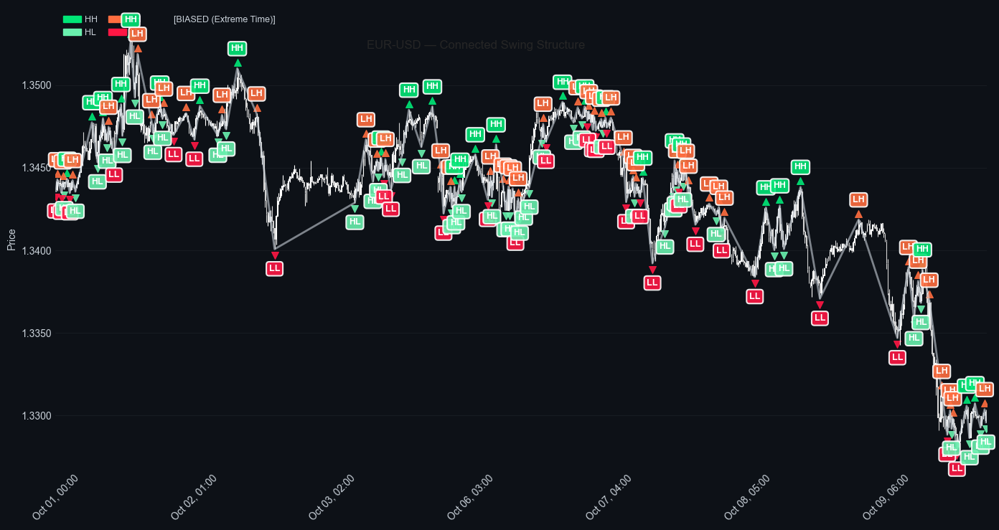

(<Figure size 1495x747.5 with 2 Axes>, <Axes: ylabel='Price'>)

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib.patches as mpatches
import matplotlib.ticker as mticker
import mplfinance as mpf

def plot_swings_connected(
    df,
    level='Major',                 # 'MinMaj' or 'Major'
    last_n=700,
    start_date=None,
    end_date=None,
    title='EUR-USD — Connected Swing Structure',
    up_color='white',
    down_color='#D3D3D3',
    show_labels=True,
    connect_swings=False,
    use_biased=True
):
    """
    Plot candlesticks with connected swing points and HH/HL/LH/LL labels
    
    Args:
        df: DataFrame with swing analysis
        level: 'MinMaj' or 'Major' (Minor supported but not the default)
        last_n: Number of bars to display (used if start_date/end_date not provided)
        start_date / end_date: Date filters
        show_labels: Show HH/HL/LH/LL labels
        connect_swings: Draw lines connecting swings
        use_biased: If True, use *_BIASED plotting cols (cleaner dots);
                    else uses ML-READY confirmation-time columns (no lookahead).
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = df.copy()
        tz = getattr(df.index, 'tz', None)
        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        df = df.tail(last_n).copy()
    
    # Required columns
    if use_biased:
        high_col = f'{level}SwingHigh'
        low_col  = f'{level}SwingLow'
        label_col = f'{level}_SwingLabel_BIASED'
        price_col = f'{level}_SwingPrice_BIASED'
        need = [high_col, low_col, label_col, price_col, 'high', 'low', 'open', 'close']
    else:
        high_col = f'{level}_HighConfirmed'
        low_col  = f'{level}_LowConfirmed'
        label_col = f'{level}_ConfirmedLabel'
        price_high_col = f'{level}_SwingHighPrice'
        price_low_col  = f'{level}_SwingLowPrice'
        need = [high_col, low_col, label_col, price_high_col, price_low_col, 'high', 'low', 'open', 'close']
    missing = [c for c in need if c not in df.columns]
    if missing:
        print(f"❌ Error: Missing columns for {level}: {missing}")
        return None, None

    # Check if there are any swings
    has_swings = (df[high_col].sum() > 0) or (df[low_col].sum() > 0)
    if not has_swings:
        print(f"⚠️  Warning: No {level} swings found in the selected range")
        return None, None
    
    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015
    
    # Color-code by label type
    label_colors = {
        'HH': '#00e676', 'HL': '#69f0ae',
        'LH': '#ff6e40', 'LL': '#ff1744',
        'H': '#00b7ff', 'L': '#00b7ff'
    }
    
    # Candlestick style
    mc = mpf.make_marketcolors(
        up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in'
    )
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid',
        marketcolors=mc,
        gridcolor='#22272e',
        facecolor='#0d1117',
        edgecolor='#0d1117',
        figcolor='#0d1117',
        rc={'axes.labelcolor': '#c9d1d9', 'xtick.color': '#c9d1d9',
            'ytick.color': '#c9d1d9', 'font.size': 10}
    )
    
    # Build addplots per label
    apds = []
    for label, color in label_colors.items():
        if use_biased:
            mask_high = (df[high_col] == 1) & (df[label_col] == label)
            if mask_high.any():
                apds.append(mpf.make_addplot(df['high'].where(mask_high) + offset,
                                             type='scatter', marker='^', markersize=50,
                                             color=color, alpha=0.9))
            mask_low = (df[low_col] == 1) & (df[label_col] == label)
            if mask_low.any():
                apds.append(mpf.make_addplot(df['low'].where(mask_low) - offset,
                                             type='scatter', marker='v', markersize=50,
                                             color=color, alpha=0.9))
        else:
            mask_high = (df[high_col] == 1) & (df[label_col] == label)
            if mask_high.any():
                apds.append(mpf.make_addplot(df[price_high_col].where(mask_high) + offset,
                                             type='scatter', marker='^', markersize=50,
                                             color=color, alpha=0.9))
            mask_low = (df[low_col] == 1) & (df[label_col] == label)
            if mask_low.any():
                apds.append(mpf.make_addplot(df[price_low_col].where(mask_low) - offset,
                                             type='scatter', marker='v', markersize=50,
                                             color=color, alpha=0.9))
    
    # Plot
    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None,
        volume=False, style=style, figratio=(20, 10), figscale=1.3,
        title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]
    
    # Thin wicks
    for line in ax.lines: line.set_linewidth(0.8)
    for coll in ax.collections:
        try: coll.set_linewidth(0.8)
        except: pass
    
    # Connect swing points
    if connect_swings:
        swing_points = df[df[label_col] != ''].copy()
        if len(swing_points) > 1:
            x_positions = []
            y_positions = []
            for idx in swing_points.index:
                if idx not in df.index: continue
                x_positions.append(df.index.get_loc(idx))
                if use_biased:
                    y_positions.append(swing_points.loc[idx, price_col])
                else:
                    if swing_points.loc[idx, high_col] == 1:
                        y_positions.append(swing_points.loc[idx, price_high_col])
                    elif swing_points.loc[idx, low_col] == 1:
                        y_positions.append(swing_points.loc[idx, price_low_col])
                    else:
                        # if both 0 (rare), skip
                        x_positions.pop()
                        continue
            if len(x_positions) > 1:
                ax.plot(x_positions, y_positions, color='#c9d1d9',
                        linewidth=2, linestyle='-', alpha=0.6, zorder=2)
    
    # Add text labels
    if show_labels:
        swing_points = df[df[label_col] != ''].copy()
        for idx, row in swing_points.iterrows():
            if idx not in df.index: continue
            x_pos = df.index.get_loc(idx)
            label = row[label_col]
            if use_biased:
                price = row[price_col]
                is_high = (row[high_col] == 1)
            else:
                is_high = (row[high_col] == 1)
                price = row[price_high_col] if is_high else row[price_low_col]
            y_pos = price + (offset * 2.5 if is_high else -offset * 2.5)
            va = 'bottom' if is_high else 'top'
            text_color = label_colors.get(label, '#c9d1d9')
            ax.text(x_pos, y_pos, label, ha='center', va=va,
                    color='white', fontsize=9, fontweight='bold',
                    bbox=dict(boxstyle='round,pad=0.3', facecolor=text_color,
                              edgecolor='white', linewidth=1.5, alpha=0.9),
                    zorder=10)
    
    # Formatting
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)
    
    # Legend
    mode_text = "BIASED (Extreme Time)" if use_biased else "ML-READY (Confirmation Time)"
    legend_handles = [
        mpatches.Patch(color='#00e676', label='HH'),
        mpatches.Patch(color='#69f0ae', label='HL'),
        mpatches.Patch(color='#ff6e40', label='LH'),
        mpatches.Patch(color='#ff1744', label='LL'),
        mpatches.Patch(color='none', label=f'[{mode_text}]'),
    ]
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left',
                    ncols=3, handletextpad=0.4, columnspacing=1.2, fontsize=9)
    for text in leg.get_texts(): text.set_color('#c9d1d9')
    
    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)
    
    fig.tight_layout()
    plt.show()
    return fig, ax


def plot_multi_level_connected(
    df,
    last_n=700,
    start_date=None,
    end_date=None,
    title='EUR-USD — Multi-Level Swing Structure',
    up_color='white',
    down_color='#D3D3D3',
    use_biased=True,
    connect_swings=False,
    levels=('MinMaj','Major'),     # << default to MinMaj + Major only
):
    """
    Plot multiple swing levels together with connections.
    
    Args:
        df: DataFrame with swing analysis
        levels: iterable from {'Minor','MinMaj','Major'} controlling what to show
        use_biased: Use *_BIASED (plotting) or ML-READY confirmation columns
    """
    # Filter by date range if provided
    if start_date is not None or end_date is not None:
        df = df.copy()
        tz = getattr(df.index, 'tz', None)
        if start_date is not None:
            start_dt = pd.to_datetime(start_date)
            if tz is not None and start_dt.tz is None:
                start_dt = start_dt.tz_localize(tz)
            df = df[df.index >= start_dt]
        if end_date is not None:
            end_dt = pd.to_datetime(end_date)
            if tz is not None and end_dt.tz is None:
                end_dt = end_dt.tz_localize(tz)
            df = df[df.index <= end_dt]
        if len(df) == 0:
            print(f"❌ Error: No data in range {start_date} to {end_date}")
            return None, None
    else:
        df = df.tail(last_n).copy()
    
    price_range = df['high'].max() - df['low'].min()
    offset = price_range * 0.015
    
    mc = mpf.make_marketcolors(
        up=up_color, down=down_color, edge='inherit', wick='inherit', volume='in'
    )
    style = mpf.make_mpf_style(
        base_mpl_style='seaborn-v0_8-darkgrid',
        marketcolors=mc,
        gridcolor='#22272e',
        facecolor='#0d1117',
        edgecolor='#0d1117',
        figcolor='#0d1117',
        rc={'axes.labelcolor': '#c9d1d9', 'xtick.color': '#c9d1d9',
            'ytick.color': '#c9d1d9', 'font.size': 10}
    )
    
    apds = []

    def _add_level(level_name, color, ms):
        if use_biased:
            hi_col = f'{level_name}SwingHigh'
            lo_col = f'{level_name}SwingLow'
            need = [hi_col, lo_col]
            if any(col not in df.columns for col in need): return
            hi = df['high'].where(df[hi_col] == 1) + offset * ms
            lo = df['low'].where(df[lo_col] == 1) - offset * ms
            if hi.notna().any():
                apds.append(mpf.make_addplot(hi, type='scatter', marker='^',
                                             markersize=20+ms*15, color=color, alpha=0.75))
            if lo.notna().any():
                apds.append(mpf.make_addplot(lo, type='scatter', marker='v',
                                             markersize=20+ms*15, color=color, alpha=0.75))
        else:
            hi_flag = f'{level_name}_HighConfirmed'
            lo_flag = f'{level_name}_LowConfirmed'
            hi_price = f'{level_name}_SwingHighPrice'
            lo_price = f'{level_name}_SwingLowPrice'
            need = [hi_flag, lo_flag, hi_price, lo_price]
            if any(col not in df.columns for col in need): return
            hi = df[hi_price].where(df[hi_flag] == 1) + offset * ms
            lo = df[lo_price].where(df[lo_flag] == 1) - offset * ms
            if hi.notna().any():
                apds.append(mpf.make_addplot(hi, type='scatter', marker='^',
                                             markersize=20+ms*15, color=color, alpha=0.85))
            if lo.notna().any():
                apds.append(mpf.make_addplot(lo, type='scatter', marker='v',
                                             markersize=20+ms*15, color=color, alpha=0.85))

    # Choose palette / marker scale per level
    palette = {
        'Minor':  ('#78909c', 0.8),
        'MinMaj': ('#f4a300', 1.5),
        'Major':  ('#00b7ff', 2.5),
    }
    for lvl in levels:
        if lvl not in palette: continue
        color, ms = palette[lvl]
        _add_level(lvl, color, ms)

    fig, axlist = mpf.plot(
        df, type='candle', addplot=apds if apds else None,
        volume=False, style=style, figratio=(20, 10), figscale=1.3,
        title=title, tight_layout=True, returnfig=True
    )
    ax = axlist[0]
    for line in ax.lines: line.set_linewidth(0.8)
    for coll in ax.collections:
        try: coll.set_linewidth(0.8)
        except: pass
    
    # Connect swings for each requested level
    if connect_swings:
        if use_biased:
            for lvl in levels:
                lbl_col = f'{lvl}_SwingLabel_BIASED'
                price_col = f'{lvl}_SwingPrice_BIASED'
                if lbl_col not in df.columns or price_col not in df.columns: continue
                color = palette[lvl][0]; lw = 1.2 + 0.4 * palette[lvl][1]; alpha = 0.5 + 0.2 * (palette[lvl][1] > 1)
                swings = df[df[lbl_col] != '']
                if len(swings) > 1:
                    xs = [df.index.get_loc(ix) for ix in swings.index if ix in df.index]
                    ys = [swings.loc[ix, price_col] for ix in swings.index if ix in df.index]
                    if len(xs) > 1:
                        ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)
        else:
            for lvl in levels:
                lbl_col = f'{lvl}_ConfirmedLabel'
                hi_flag = f'{lvl}_HighConfirmed'
                lo_flag = f'{lvl}_LowConfirmed'
                hi_price = f'{lvl}_SwingHighPrice'
                lo_price = f'{lvl}_SwingLowPrice'
                need = [lbl_col, hi_flag, lo_flag, hi_price, lo_price]
                if any(col not in df.columns for col in need): continue
                color = palette[lvl][0]; lw = 1.2 + 0.4 * palette[lvl][1]; alpha = 0.5 + 0.2 * (palette[lvl][1] > 1)
                swings = df[df[lbl_col] != '']
                xs, ys = [], []
                for ix, row in swings.iterrows():
                    if ix not in df.index: continue
                    xs.append(df.index.get_loc(ix))
                    if row[hi_flag] == 1: ys.append(row[hi_price])
                    elif row[lo_flag] == 1: ys.append(row[lo_price])
                    else: xs.pop()  # skip if neither flag set
                if len(xs) > 1:
                    ax.plot(xs, ys, color=color, linewidth=lw, linestyle='-', alpha=alpha, zorder=2)
    
    ax.yaxis.set_major_formatter(mticker.FuncFormatter(lambda x, p: f'{x:,.4f}'))
    ax.grid(axis='y', linestyle='-', linewidth=0.6, alpha=0.6)
    ax.grid(axis='x', visible=False)
    
    mode_text = "BIASED" if use_biased else "ML-READY"
    legend_handles = []
    if 'Minor' in levels:
        legend_handles.append(mlines.Line2D([], [], color='#78909c', marker='^', linestyle='-',
                                            markersize=6, linewidth=1, label='Minor', alpha=0.6))
    if 'MinMaj' in levels:
        legend_handles.append(mlines.Line2D([], [], color='#f4a300', marker='^', linestyle='-',
                                            markersize=8, linewidth=1.5, label='MinMaj', alpha=0.8))
    if 'Major' in levels:
        legend_handles.append(mlines.Line2D([], [], color='#00b7ff', marker='^', linestyle='-',
                                            markersize=10, linewidth=2, label='Major', alpha=0.9))
    legend_handles.append(mlines.Line2D([], [], color='none', linestyle='', label=f'[{mode_text}]'))
    
    leg = ax.legend(handles=legend_handles, frameon=False, loc='upper left',
                    ncols=min(4, len(legend_handles)), handletextpad=0.4, columnspacing=1.2)
    for text in leg.get_texts(): text.set_color('#c9d1d9')
    
    ymin, ymax = df['low'].min(), df['high'].max()
    ax.set_ylim(ymin - (ymax - ymin) * 0.05, ymax + (ymax - ymin) * 0.08)
    
    fig.tight_layout()
    plt.show()
    return fig, ax


# ========================== EXAMPLES ==========================
# 1) MinMaj only (biased dots)
plot_swings_connected(df, level='MinMaj', start_date='2025-10-01', end_date='2025-10-10', use_biased=True, connect_swings=True)

# 2) Major ML-ready with connectors
# plot_swings_connected(df, level='Major', last_n=1200, connect_swings=True, use_biased=False)

# 3) Multi-level — only MinMaj & Major (default), connectors ON
# plot_multi_level_connected(df, start_date='2025-09-01', end_date='2025-10-10',
#                            use_biased=True, connect_swings=True)

# 4) If you ever want to include Minor too:
# plot_multi_level_connected(df, levels=('Minor','MinMaj','Major'), last_n=1500, use_biased=True, connect_swings=True)

# Point-mask cascade

In [12]:
import numpy as np
import pandas as pd

# ============================================================
# Point-mask cascade utilities (no forward-fill, no lookahead)
# ============================================================

# ---------- TZ alignment ----------
def _align_timezones(lt_index, ht_index):
    if lt_index.tz is None and ht_index.tz is not None:
        return ht_index.tz_localize(None)
    if lt_index.tz is not None and ht_index.tz is None:
        return ht_index.tz_localize(lt_index.tz)
    if lt_index.tz is not None and ht_index.tz is not None and lt_index.tz != ht_index.tz:
        return ht_index.tz_convert(lt_index.tz)
    return ht_index


# ---------- Point-mask: swings, prices, pattern CONTEXT (no spread of events) ----------
def mask_higher_timeframe_swings_point(lower_tf_data, higher_tf_data, tf_prefix='Daily'):
    """
    Copy HTF context to exactly ONE LTF bar per HTF bar:
      - the first LTF bar in [HTF_close, next_HTF_close)
    Events remain point-in-time only (no spread).
    """
    ltf = lower_tf_data.copy()
    htf = higher_tf_data.copy()

    # No-lookahead: HTF values appear only AFTER the HTF bar closes
    htf.index = _align_timezones(ltf.index, htf.index)
    htf_shift = htf.shift(1)

    # CONTEXT columns we allow to map (states/bias/levels/pattern context)
    context_keep = []
    for lvl in ['Minor', 'MinMaj', 'Major']:
        context_keep += [
            f'{lvl}_ConfirmedLabel',
            f'{lvl}_SwingHighPrice',
            f'{lvl}_SwingLowPrice',
            f'{lvl}_SwingLabel_BIASED',
            f'{lvl}_SwingPrice_BIASED',
        ]
    # pattern & cross-TF context + summaries
    context_suffixes = [
        '_Active', '_Awaiting_BOS', '_BOS_Target', '_Swings',
        'Any_Bullish_Pattern', 'Any_Bearish_Pattern', 'Active_Pattern_Names',
        'MinMaj_LowerLabel', 'MinMaj_UpperLabel', 'MinMaj_StructureBias',
        'Total_BOS_Events'
    ]
    for col in htf_shift.columns:
        if any(s in col for s in context_suffixes):
            context_keep.append(col)

    # EVENT columns: never spread (exact-time only)
    event_exact = []
    for lvl in ['Minor', 'MinMaj', 'Major']:
        event_exact += [f'{lvl}_HighConfirmed', f'{lvl}_LowConfirmed']
    event_exact += [c for c in htf_shift.columns if c.endswith('_BOS_Confirmed')]

    # keep only existing
    context_keep = [c for c in sorted(set(context_keep)) if c in htf_shift.columns]
    event_exact  = [c for c in sorted(set(event_exact))  if c in htf_shift.columns]

    # init output columns
    for col in context_keep:
        out = f'{tf_prefix}_{col}'
        ltf[out] = np.nan if pd.api.types.is_numeric_dtype(htf_shift[col]) else ''

    # build HTF windows and write ONLY the first LTF row in each window
    ht_idx = htf_shift.index
    for i, t0 in enumerate(ht_idx):
        t1 = ht_idx[i+1] if i+1 < len(ht_idx) else (
            pd.Timestamp.max.tz_localize(t0.tz) if t0.tz is not None else pd.Timestamp.max
        )
        mask = (ltf.index >= t0) & (ltf.index < t1)
        if not mask.any():
            continue
        tgt = ltf.index[mask][0]
        hrow = htf_shift.loc[t0, context_keep]
        for col, val in hrow.items():
            out = f'{tf_prefix}_{col}'
            if pd.api.types.is_numeric_dtype(htf_shift[col]):
                ltf.at[tgt, out] = val
            else:
                ltf.at[tgt, out] = '' if pd.isna(val) else val

    # events: exact-time mapping only (no carry)
    for col in event_exact:
        out = f'{tf_prefix}_{col}'
        ser = htf_shift[col].reindex(ltf.index)
        if pd.api.types.is_numeric_dtype(ser):
            ltf[out] = ser.fillna(0).astype(int)
        else:
            ltf[out] = ser

    return ltf


# ---------- Point-mask: RSI ----------
def mask_htf_rsi_point(lower_tf_data, higher_tf_data, tf_prefix='Daily'):
    """
    Copy HTF RSI to exactly ONE LTF bar per HTF window (first bar after HTF close).
    """
    ltf = lower_tf_data.copy()
    htf = higher_tf_data.copy()

    htf.index = _align_timezones(ltf.index, htf.index)
    htf_shift = htf.shift(1)

    out_col = f'{tf_prefix}_RSI'
    ltf[out_col] = np.nan
    if 'RSI' not in htf_shift.columns:
        return ltf

    ht_idx = htf_shift.index
    for i, t0 in enumerate(ht_idx):
        t1 = ht_idx[i+1] if i+1 < len(ht_idx) else (
            pd.Timestamp.max.tz_localize(t0.tz) if t0.tz is not None else pd.Timestamp.max
        )
        mask = (ltf.index >= t0) & (ltf.index < t1)
        if not mask.any():
            continue
        tgt = ltf.index[mask][0]
        ltf.at[tgt, out_col] = htf_shift.at[t0, 'RSI']

    return ltf


# ---------- Build real-time HTF candle (same as your version; no Body/Bullish/Gap) ----------
def add_htf_current_candle(lower_tf_data, tf_period='1D', tf_prefix='Daily'):
    """
    Build the CURRENT higher timeframe candle from lower timeframe bars, plus range metrics.

    Creates:
      {tf_prefix}_Open/High/Low/Close
      {tf_prefix}_Prev_Open/High/Low/Close
      {tf_prefix}_Range, {tf_prefix}_Range_Pct, {tf_prefix}_Position_In_Range
    """
    result_df = lower_tf_data.copy()

    # Group by target period
    result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)

    # Current period OHLC
    result_df[f'{tf_prefix}_Open']  = result_df.groupby(f'{tf_prefix}_Period')['open'].transform('first')
    result_df[f'{tf_prefix}_High']  = result_df.groupby(f'{tf_prefix}_Period')['high'].transform('max')
    result_df[f'{tf_prefix}_Low']   = result_df.groupby(f'{tf_prefix}_Period')['low'].transform('min')   # ✅ fixed line
    result_df[f'{tf_prefix}_Close'] = result_df.groupby(f'{tf_prefix}_Period')['close'].transform('last')

    # Previous completed period OHLC
    grouped = result_df.groupby(f'{tf_prefix}_Period')
    result_df[f'{tf_prefix}_Prev_Open']  = grouped['open'].transform('first').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_High']  = grouped['high'].transform('max').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_Low']   = grouped['low'].transform('min').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_Close'] = grouped['close'].transform('last').shift(1).ffill()

    # Derived range metrics
    result_df[f'{tf_prefix}_Range'] = result_df[f'{tf_prefix}_High'] - result_df[f'{tf_prefix}_Low']
    result_df[f'{tf_prefix}_Range_Pct'] = np.where(
        result_df[f'{tf_prefix}_Open'] > 0,
        (result_df[f'{tf_prefix}_Range'] / result_df[f'{tf_prefix}_Open']) * 100.0,
        0.0
    )
    result_df[f'{tf_prefix}_Position_In_Range'] = np.where(
        result_df[f'{tf_prefix}_Range'] > 0,
        (result_df['close'] - result_df[f'{tf_prefix}_Low']) / result_df[f'{tf_prefix}_Range'],
        0.5
    )

    # Cleanup temp column
    result_df.drop(columns=[f'{tf_prefix}_Period'], inplace=True)

    return result_df


# ---------- Mask real-time HTF candles to the LAST LTF bar in each HTF period ----------
def mask_current_candle_point(lower_tf_data, tf_period='1D', tf_prefix='Daily'):
    """
    Keep HTF real-time OHLC/Range columns ONLY on the final LTF bar of each HTF period.
    """
    df = lower_tf_data.copy()
    cols = [
        f'{tf_prefix}_Open', f'{tf_prefix}_High', f'{tf_prefix}_Low', f'{tf_prefix}_Close',
        f'{tf_prefix}_Prev_Open', f'{tf_prefix}_Prev_High', f'{tf_prefix}_Prev_Low', f'{tf_prefix}_Prev_Close',
        f'{tf_prefix}_Range', f'{tf_prefix}_Range_Pct', f'{tf_prefix}_Position_In_Range'
    ]
    existing = [c for c in cols if c in df.columns]
    if not existing:
        return df

    periods = df.index.to_period(tf_period)
    last_mask = periods != periods.shift(-1)  # only last bar in each period is True
    for c in existing:
        df.loc[~last_mask, c] = np.nan
    return df


# ============================================================
# Point-mask cascade (Daily → Hourly → 30-min)
# ============================================================
def cascade_multi_timeframe_swings_point(daily_data, hourly_data, min30_data):
    """
    Replace forward-fill cascade with point-mask behavior.
    - Daily → Hourly: map context/RSI to first Hourly bar after each Daily close
    - Daily → 30m   : map context/RSI to first 30m bar after each Daily close
                      then build/mask Daily real-time candle to last 30m of day
    - Hourly → 30m  : map context/RSI to first 30m bar after each Hourly close
                      then build/mask Hourly real-time candle to last 30m of hour
    """
    # DAILY → HOURLY (point)
    hourly_enriched = mask_higher_timeframe_swings_point(hourly_data, daily_data, tf_prefix='Daily')
    hourly_enriched = mask_htf_rsi_point(hourly_enriched, daily_data, tf_prefix='Daily')

    # DAILY → 30-MIN (point)
    min30_enriched = mask_higher_timeframe_swings_point(min30_data, daily_data, tf_prefix='Daily')
    min30_enriched = mask_htf_rsi_point(min30_enriched, daily_data, tf_prefix='Daily')

    # Build real-time DAILY candle, then mask to last 30-min bar of the day
    min30_enriched = add_htf_current_candle(min30_enriched, tf_period='1D', tf_prefix='Daily')
    min30_enriched = mask_current_candle_point(min30_enriched, tf_period='1D', tf_prefix='Daily')

    # HOURLY → 30-MIN (point)
    min30_enriched = mask_higher_timeframe_swings_point(min30_enriched, hourly_enriched, tf_prefix='Hourly')
    min30_enriched = mask_htf_rsi_point(min30_enriched, hourly_enriched, tf_prefix='Hourly')

    # Build real-time HOURLY candle, then mask to last 30-min bar of the hour
    min30_enriched = add_htf_current_candle(min30_enriched, tf_period='1H', tf_prefix='Hourly')
    min30_enriched = mask_current_candle_point(min30_enriched, tf_period='1H', tf_prefix='Hourly')

    return hourly_enriched, min30_enriched


# ============================================================
# Validators (timestamp-based; safe with repeating labels)
# ============================================================
def validate_no_lookahead_v2(lower_tf_data, higher_tf_data, tf_period='1D', tf_prefix='Daily', verbose=True):
    """
    Timestamp alignment validator:
    Checks that LTF columns that carry unique numeric context (prices/RSI/real-time OHLC)
    only appear AFTER the HTF has a value (via shift(1)).
    """
    print(f"\n{'='*60}")
    print(f"LOOK-AHEAD VALIDATION V2: {tf_prefix} → Lower TF")
    print(f"{'='*60}")

    violations = []

    # Align timezones
    ltf_data = lower_tf_data.copy()
    htf_data = higher_tf_data.copy()

    if ltf_data.index.tz is None and htf_data.index.tz is not None:
        htf_data.index = htf_data.index.tz_localize(None)
    elif ltf_data.index.tz is not None and htf_data.index.tz is None:
        htf_data.index = htf_data.index.tz_localize(ltf_data.index.tz)
    elif ltf_data.index.tz is not None and htf_data.index.tz is not None:
        if ltf_data.index.tz != htf_data.index.tz:
            htf_data.index = htf_data.index.tz_convert(ltf_data.index.tz)

    htf_data_shifted = htf_data.shift(1)

    # Columns to check (unique-ish numeric signals)
    sample_cols = [col for col in ltf_data.columns if col.startswith(f'{tf_prefix}_')]
    sample_cols = [col for col in sample_cols if any(x in col for x in
                  ['SwingHighPrice', 'SwingLowPrice', 'RSI', '_Open', '_High', '_Low', '_Close', '_Range'])]
    sample_cols = sample_cols[:10]

    if verbose:
        print(f"\nChecking {len(sample_cols)} columns with unique values...")
        print("(Skipping label columns like ConfirmedLabel which can repeat)")

    all_good = True
    for col in sample_cols:
        orig_col = col.replace(f'{tf_prefix}_', '')
        if orig_col not in htf_data_shifted.columns:
            continue

        ltf_col = ltf_data[col].dropna()
        if len(ltf_col) == 0:
            continue

        first_ltf_timestamp = ltf_col.index[0]
        valid_htf_data = htf_data_shifted[htf_data_shifted.index <= first_ltf_timestamp][orig_col].dropna()

        if len(valid_htf_data) == 0:
            if verbose:
                print(f"   ⚠️  {col}: Data at {first_ltf_timestamp} before any HTF data available")
            all_good = False
            violations.append({
                'column': col,
                'issue': 'Data before HTF availability',
                'first_ltf_timestamp': first_ltf_timestamp
            })
        else:
            htf_first = valid_htf_data.index[0]
            if verbose:
                print(f"   ✅ {col}: OK (LTF starts {first_ltf_timestamp}, HTF from {htf_first})")

    print(f"\n{'='*60}")
    if all_good:
        print(f"✅ VALIDATION PASSED: No look-ahead bias detected")
        print(f"   Checked {len(sample_cols)} columns")
    else:
        print(f"⚠️  VALIDATION WARNINGS: {len(violations)} issues found")
        print(f"   These may be edge cases at dataset start/end")
    print(f"{'='*60}")

    return {
        'passed': all_good,
        'violations': violations,
        'checks_performed': len(sample_cols)
    }


def validate_cascade_v2(daily_data, hourly_enriched, min30_enriched):
    """
    Run improved look-ahead validation on the point-mask cascade.
    """
    print("\n" + "="*60)
    print("IMPROVED CASCADE VALIDATION (Point-mask)")
    print("="*60)

    results = {}

    print("\n[1/3] Validating Daily → Hourly...")
    results['daily_to_hourly'] = validate_no_lookahead_v2(
        lower_tf_data=hourly_enriched,
        higher_tf_data=daily_data,
        tf_period='1D',
        tf_prefix='Daily',
        verbose=True
    )

    print("\n[2/3] Validating Daily → 30-min...")
    results['daily_to_min30'] = validate_no_lookahead_v2(
        lower_tf_data=min30_enriched,
        higher_tf_data=daily_data,
        tf_period='1D',
        tf_prefix='Daily',
        verbose=False
    )

    print("\n[3/3] Validating Hourly → 30-min...")
    results['hourly_to_min30'] = validate_no_lookahead_v2(
        lower_tf_data=min30_enriched,
        higher_tf_data=hourly_enriched,
        tf_period='1H',
        tf_prefix='Hourly',
        verbose=False
    )

    print("\n" + "="*60)
    print("OVERALL VALIDATION SUMMARY")
    print("="*60)
    all_passed = all(r['passed'] for r in results.values())

    if all_passed:
        print("\n✅ ALL VALIDATIONS PASSED - No look-ahead bias detected!")
    else:
        print("\n⚠️  SOME WARNINGS DETECTED")
        for check_name, result in results.items():
            if not result['passed']:
                print(f"   ⚠️  {check_name}: {len(result['violations'])} warnings")
        print("\n   Note: Often edge cases at data boundaries.")
    print("="*60)

    return results


def diagnose_violations(validation_results, max_examples=5):
    """Simple printer for validator warnings."""
    print("\n" + "="*60)
    print("VIOLATION DIAGNOSIS")
    print("="*60)

    for check_name, result in validation_results.items():
        if not result['passed']:
            violations = result['violations']
            print(f"\n{check_name.upper()}: {len(violations)} warnings")
            print(f"\nFirst {min(max_examples, len(violations))} examples:")
            for v in violations[:max_examples]:
                print(f"  - Column: {v['column']}")
                print(f"    Issue : {v['issue']}")
                print(f"    First LTF timestamp: {v['first_ltf_timestamp']}")
    print("\n" + "="*60)


# ============================================================
# Summaries (unchanged)
# ============================================================
def print_enrichment_summary(hourly_enriched, min30_enriched):
    """Print a summary of the enriched datasets."""
    print("\n" + "="*60)
    print("ENRICHMENT SUMMARY (Point-mask)")
    print("="*60)

    print("\n📊 HOURLY DATA (with Daily point context):")
    print(f"   Total rows: {len(hourly_enriched)}")
    print(f"   Date range: {hourly_enriched.index.min()} to {hourly_enriched.index.max()}")
    print(f"   Total columns: {len(hourly_enriched.columns)}")

    daily_cols = [c for c in hourly_enriched.columns if c.startswith('Daily_')]
    print(f"\n   Daily context columns added: {len(daily_cols)}")
    if 'Daily_RSI' in hourly_enriched.columns:
        r = hourly_enriched['Daily_RSI'].dropna()
        if len(r) > 0:
            print(f"      ✅ Daily_RSI: {r.min():.1f}–{r.max():.1f} (mean {r.mean():.1f})")

    for level in ['Minor', 'MinMaj', 'Major']:
        col = f'Daily_{level}_ConfirmedLabel'
        if col in hourly_enriched.columns:
            labels = hourly_enriched[col].replace('', np.nan).dropna().unique()
            if len(labels) > 0:
                print(f"      ✅ Daily_{level} labels present: {', '.join(labels)}")

    print("\n📊 30-MIN DATA (with Daily + Hourly point context):")
    print(f"   Total rows: {len(min30_enriched)}")
    print(f"   Date range: {min30_enriched.index.min()} to {min30_enriched.index.max()}")
    print(f"   Total columns: {len(min30_enriched.columns)}")

    daily_cols_30  = [c for c in min30_enriched.columns if c.startswith('Daily_')]
    hourly_cols_30 = [c for c in min30_enriched.columns if c.startswith('Hourly_')]
    print(f"\n   Daily context columns: {len(daily_cols_30)}")
    print(f"   Hourly context columns: {len(hourly_cols_30)}")

    for tf in ['Daily', 'Hourly']:
        rsi_col = f'{tf}_RSI'
        if rsi_col in min30_enriched.columns:
            rsi_data = min30_enriched[rsi_col].dropna()
            if len(rsi_data) > 0:
                print(f"      ✅ {rsi_col}: {rsi_data.min():.1f}–{rsi_data.max():.1f} (mean {rsi_data.mean():.1f})")

    for tf in ['Daily', 'Hourly']:
        if f'{tf}_Range' in min30_enriched.columns:
            print(f"      ✅ {tf}_Open/High/Low/Close (masked to last {tf.lower()} bar)")
            print(f"      ✅ {tf}_Range, {tf}_Range_Pct, {tf}_Position_In_Range")


# ============================================================
# Example (plug your already-built dataframes)
# ============================================================
if __name__ == '__main__':
    """
    Drop-in usage:

    You already have:
      - data   : Daily DataFrame with swings/patterns/RSI
      - data15 : Hourly DataFrame with swings/patterns/RSI
      - df     : 30-min (or 15-min) DataFrame with swings/patterns/RSI

    Replace your previous cascade call with:

        hourly_enriched, min30_enriched = cascade_multi_timeframe_swings_point(
            daily_data=data,
            hourly_data=data15,
            min30_data=df
        )

        print_enrichment_summary(hourly_enriched, min30_enriched)
        validation_results = validate_cascade_v2(data, hourly_enriched, min30_enriched)
        # diagnose_violations(validation_results)

        # Save if you want:
        # min30_enriched.to_csv('min30_FULL_CONTEXT_POINT_MASK.csv')
        # hourly_enriched.to_csv('hourly_enriched_with_daily_POINT_MASK.csv')

    Note: This file intentionally does not load or build the Daily/Hourly/30m
    swing/pattern datasets—you already produce them in your pipeline.
    """
    pass

In [13]:
hourly_enriched, min30_enriched = cascade_multi_timeframe_swings_point(
            daily_data=data,
            hourly_data=data15,
            min30_data=df
        )

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/615395219.py:142: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/615395219.py:191: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  periods = df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/615395219.py:142: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_21951/615395219.py:142: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c6

In [14]:
# Save if you want
min30_enriched.to_csv('min30_FULL_CONTEXT_POINT_MASK.csv')
        # hourly_enriched.to_csv('hourly_enriched_with_daily_POINT_MASK.csv')

In [15]:
# Detailed RSI Merge Diagnostic
print("\n" + "="*60)
print("DETAILED RSI MERGE DIAGNOSTIC")
print("="*60)

# Step 1: Check Daily RSI before and after shift
print("\n1️⃣ DAILY RSI - Before and After Shift:")
print("\nOriginal Daily RSI (first 5 valid values):")
daily_rsi_valid = data[data['RSI'].notna()][['close', 'RSI']].head(5)
print(daily_rsi_valid)

print("\nDaily RSI after .shift(1):")
daily_shifted = data['RSI'].shift(1)
print(daily_shifted[daily_shifted.notna()].head(5))

# Step 2: Manually test the merge logic
print("\n2️⃣ TESTING MERGE LOGIC:")

# Simulate what happens in add_htf_rsi function
test_daily = data.copy()
test_hourly = data15.copy()

# Apply shift
test_daily_shifted = test_daily.shift(1)

# Reset index
test_daily_reset = test_daily_shifted.reset_index()
test_hourly_reset = test_hourly.reset_index()

# Rename to timestamp
ltf_time_col = test_hourly_reset.columns[0]
htf_time_col = test_daily_reset.columns[0]
test_daily_reset = test_daily_reset.rename(columns={htf_time_col: 'timestamp'})
test_hourly_reset = test_hourly_reset.rename(columns={ltf_time_col: 'timestamp'})

# Check if RSI exists
print(f"\nRSI in shifted daily data: {'RSI' in test_daily_reset.columns}")
if 'RSI' in test_daily_reset.columns:
    rsi_notna = test_daily_reset['RSI'].notna().sum()
    print(f"Non-null RSI values: {rsi_notna} / {len(test_daily_reset)}")
    print(f"\nFirst few non-null RSI in shifted daily:")
    print(test_daily_reset[test_daily_reset['RSI'].notna()][['timestamp', 'RSI']].head(5))

# Perform the actual merge
print("\n3️⃣ PERFORMING MERGE_ASOF:")
temp_merge = pd.merge_asof(
    test_hourly_reset[['timestamp']].head(100),  # First 100 hourly bars
    test_daily_reset[['timestamp', 'RSI']],
    on='timestamp',
    direction='backward'
)

print(f"\nMerge result - Non-null RSI: {temp_merge['RSI'].notna().sum()} / {len(temp_merge)}")
print("\nFirst rows of merge result:")
print(temp_merge.head(20))

print("\nLast rows of merge result (around first valid RSI):")
# Find where RSI first becomes non-null
first_valid_in_merge = temp_merge[temp_merge['RSI'].notna()]
if len(first_valid_in_merge) > 0:
    first_idx = first_valid_in_merge.index[0]
    print(temp_merge.iloc[max(0, first_idx-5):first_idx+5])
else:
    print("❌ NO NON-NULL RSI VALUES IN MERGE!")

# Step 3: Check actual enriched data
print("\n4️⃣ CHECKING ACTUAL ENRICHED DATA:")
if 'Daily_RSI' in hourly_enriched.columns:
    daily_rsi_notna = hourly_enriched['Daily_RSI'].notna().sum()
    print(f"\nDaily_RSI in hourly_enriched:")
    print(f"  Non-null: {daily_rsi_notna} / {len(hourly_enriched)}")
    
    if daily_rsi_notna > 0:
        print(f"\n  First non-null Daily_RSI:")
        first_valid = hourly_enriched[hourly_enriched['Daily_RSI'].notna()].iloc[0]
        print(f"    Timestamp: {first_valid.name}")
        print(f"    Value: {first_valid['Daily_RSI']:.2f}")
        
        # Show context around first valid
        first_valid_idx = hourly_enriched[hourly_enriched['Daily_RSI'].notna()].index[0]
        idx_loc = hourly_enriched.index.get_loc(first_valid_idx)
        print(f"\n  Context (5 bars before and after first valid):")
        print(hourly_enriched.iloc[max(0, idx_loc-5):idx_loc+6][['close', 'Daily_RSI']])
    else:
        print("  ❌ ALL VALUES ARE NaN!")
        
        # Debug: Check if merge happened at all
        print("\n  Checking merge alignment...")
        print(f"  First hourly timestamp: {hourly_enriched.index.min()}")
        print(f"  First daily timestamp with RSI: {data[data['RSI'].notna()].index.min()}")
        print(f"  Last hourly timestamp: {hourly_enriched.index.max()}")

print("="*60)


DETAILED RSI MERGE DIAGNOSTIC

1️⃣ DAILY RSI - Before and After Shift:

Original Daily RSI (first 5 valid values):
                             close        RSI
time                                         
2025-01-16 00:00:00+00:00  1.22337  29.492987
2025-01-17 00:00:00+00:00  1.21583  24.433634
2025-01-19 00:00:00+00:00  1.21747  27.352758
2025-01-20 00:00:00+00:00  1.23312  47.997294
2025-01-21 00:00:00+00:00  1.23377  48.649989

Daily RSI after .shift(1):
time
2025-01-17 00:00:00+00:00    29.492987
2025-01-19 00:00:00+00:00    24.433634
2025-01-20 00:00:00+00:00    27.352758
2025-01-21 00:00:00+00:00    47.997294
2025-01-22 00:00:00+00:00    48.649989
Name: RSI, dtype: float64

2️⃣ TESTING MERGE LOGIC:

RSI in shifted daily data: True
Non-null RSI values: 229 / 243

First few non-null RSI in shifted daily:
                   timestamp        RSI
14 2025-01-17 00:00:00+00:00  29.492987
15 2025-01-19 00:00:00+00:00  24.433634
16 2025-01-20 00:00:00+00:00  27.352758
17 2025-01-21 00

In [16]:
res = validate_cascade_v2(daily_data, hourly_enriched, min30_enriched)
# diagnose_violations(res)  # optional printout

NameError: name 'daily_data' is not defined

In [17]:
import pandas as pd
import numpy as np

def compare_cascade_columns(daily_data, hourly_data, min30_enriched):
    """
    Compare columns across all timeframes to identify what's missing or empty in min30_enriched
    """
    print("\n" + "="*80)
    print("COMPREHENSIVE CASCADE COLUMN COMPARISON")
    print("="*80)
    
    # ============================================================
    # 1) COLUMN INVENTORY
    # ============================================================
    print("\n📊 COLUMN INVENTORY:")
    print(f"   Daily columns: {len(daily_data.columns)}")
    print(f"   Hourly columns: {len(hourly_data.columns)}")
    print(f"   30-min enriched columns: {len(min30_enriched.columns)}")
    
    # ============================================================
    # 2) EXPECTED DAILY COLUMNS IN MIN30
    # ============================================================
    print("\n" + "="*80)
    print("DAILY → 30-MIN CASCADE CHECK")
    print("="*80)
    
    # Get all non-OHLCV columns from daily (these should be cascaded)
    daily_feature_cols = [col for col in daily_data.columns 
                          if col not in ['open', 'high', 'low', 'close', 'volume']]
    
    expected_daily_in_min30 = [f'Daily_{col}' for col in daily_feature_cols]
    
    print(f"\n📋 Expected Daily columns in min30: {len(expected_daily_in_min30)}")
    
    # Check which ones exist
    missing_daily_cols = []
    empty_daily_cols = []
    partial_daily_cols = []
    good_daily_cols = []
    
    for expected_col in expected_daily_in_min30:
        if expected_col not in min30_enriched.columns:
            missing_daily_cols.append(expected_col)
        else:
            non_null_count = min30_enriched[expected_col].notna().sum()
            total_count = len(min30_enriched)
            
            if non_null_count == 0:
                empty_daily_cols.append(expected_col)
            elif non_null_count < total_count * 0.5:  # Less than 50% populated
                partial_daily_cols.append((expected_col, non_null_count, total_count))
            else:
                good_daily_cols.append((expected_col, non_null_count, total_count))
    
    # Report results
    print(f"\n✅ GOOD (>50% populated): {len(good_daily_cols)} columns")
    if len(good_daily_cols) <= 20:  # Show all if not too many
        for col, non_null, total in good_daily_cols:
            pct = (non_null / total * 100) if total > 0 else 0
            print(f"   ✓ {col}: {non_null}/{total} ({pct:.1f}%)")
    else:
        print(f"   (Showing first 10)")
        for col, non_null, total in good_daily_cols[:10]:
            pct = (non_null / total * 100) if total > 0 else 0
            print(f"   ✓ {col}: {non_null}/{total} ({pct:.1f}%)")
    
    print(f"\n⚠️  PARTIAL (<50% populated): {len(partial_daily_cols)} columns")
    for col, non_null, total in partial_daily_cols:
        pct = (non_null / total * 100) if total > 0 else 0
        print(f"   ⚠️  {col}: {non_null}/{total} ({pct:.1f}%)")
    
    print(f"\n❌ EMPTY (0% populated): {len(empty_daily_cols)} columns")
    for col in empty_daily_cols[:20]:  # Show first 20
        print(f"   ✗ {col}")
    if len(empty_daily_cols) > 20:
        print(f"   ... and {len(empty_daily_cols) - 20} more")
    
    print(f"\n❌ MISSING (not created): {len(missing_daily_cols)} columns")
    for col in missing_daily_cols[:20]:
        print(f"   ✗ {col}")
    if len(missing_daily_cols) > 20:
        print(f"   ... and {len(missing_daily_cols) - 20} more")
    
    # ============================================================
    # 3) EXPECTED HOURLY COLUMNS IN MIN30
    # ============================================================
    print("\n" + "="*80)
    print("HOURLY → 30-MIN CASCADE CHECK")
    print("="*80)
    
    # Get all non-OHLCV columns from hourly (these should be cascaded)
    hourly_feature_cols = [col for col in hourly_data.columns 
                           if col not in ['open', 'high', 'low', 'close', 'volume']
                           and not col.startswith('Daily_')]  # Exclude Daily_ columns
    
    expected_hourly_in_min30 = [f'Hourly_{col}' for col in hourly_feature_cols]
    
    print(f"\n📋 Expected Hourly columns in min30: {len(expected_hourly_in_min30)}")
    
    # Check which ones exist
    missing_hourly_cols = []
    empty_hourly_cols = []
    partial_hourly_cols = []
    good_hourly_cols = []
    
    for expected_col in expected_hourly_in_min30:
        if expected_col not in min30_enriched.columns:
            missing_hourly_cols.append(expected_col)
        else:
            non_null_count = min30_enriched[expected_col].notna().sum()
            
            # For string columns, also check for empty strings
            if min30_enriched[expected_col].dtype == 'object':
                non_empty_count = (min30_enriched[expected_col] != '').sum()
                non_null_count = min(non_null_count, non_empty_count)
            
            total_count = len(min30_enriched)
            
            if non_null_count == 0:
                empty_hourly_cols.append(expected_col)
            elif non_null_count < total_count * 0.5:
                partial_hourly_cols.append((expected_col, non_null_count, total_count))
            else:
                good_hourly_cols.append((expected_col, non_null_count, total_count))
    
    # Report results
    print(f"\n✅ GOOD (>50% populated): {len(good_hourly_cols)} columns")
    if len(good_hourly_cols) <= 20:
        for col, non_null, total in good_hourly_cols:
            pct = (non_null / total * 100) if total > 0 else 0
            print(f"   ✓ {col}: {non_null}/{total} ({pct:.1f}%)")
    else:
        print(f"   (Showing first 10)")
        for col, non_null, total in good_hourly_cols[:10]:
            pct = (non_null / total * 100) if total > 0 else 0
            print(f"   ✓ {col}: {non_null}/{total} ({pct:.1f}%)")
    
    print(f"\n⚠️  PARTIAL (<50% populated): {len(partial_hourly_cols)} columns")
    for col, non_null, total in partial_hourly_cols:
        pct = (non_null / total * 100) if total > 0 else 0
        print(f"   ⚠️  {col}: {non_null}/{total} ({pct:.1f}%)")
    
    print(f"\n❌ EMPTY (0% populated): {len(empty_hourly_cols)} columns")
    for col in empty_hourly_cols[:20]:
        print(f"   ✗ {col}")
    if len(empty_hourly_cols) > 20:
        print(f"   ... and {len(empty_hourly_cols) - 20} more")
    
    print(f"\n❌ MISSING (not created): {len(missing_hourly_cols)} columns")
    for col in missing_hourly_cols[:20]:
        print(f"   ✗ {col}")
    if len(missing_hourly_cols) > 20:
        print(f"   ... and {len(missing_hourly_cols) - 20} more")
    
    # ============================================================
    # 4) PATTERN ANALYSIS
    # ============================================================
    print("\n" + "="*80)
    print("PATTERN COLUMN ANALYSIS")
    print("="*80)
    
    # Daily patterns
    daily_pattern_cols = [col for col in daily_data.columns if 'Pattern' in col or 'Trap' in col]
    print(f"\n📊 Daily pattern columns: {len(daily_pattern_cols)}")
    for col in daily_pattern_cols[:10]:
        non_null = daily_data[col].notna().sum()
        if daily_data[col].dtype == 'object':
            non_empty = (daily_data[col] != '').sum()
            print(f"   {col}: {non_empty} non-empty / {len(daily_data)} total")
        else:
            print(f"   {col}: {non_null} non-null / {len(daily_data)} total")
    
    # Hourly patterns
    hourly_pattern_cols = [col for col in hourly_data.columns if 'Pattern' in col or 'Trap' in col]
    print(f"\n📊 Hourly pattern columns: {len(hourly_pattern_cols)}")
    for col in hourly_pattern_cols[:10]:
        non_null = hourly_data[col].notna().sum()
        if hourly_data[col].dtype == 'object':
            non_empty = (hourly_data[col] != '').sum()
            print(f"   {col}: {non_empty} non-empty / {len(hourly_data)} total")
        else:
            print(f"   {col}: {non_null} non-null / {len(hourly_data)} total")
    
    # Min30 patterns (both native and cascaded)
    min30_daily_pattern_cols = [col for col in min30_enriched.columns 
                                if col.startswith('Daily_') and ('Pattern' in col or 'Trap' in col)]
    min30_hourly_pattern_cols = [col for col in min30_enriched.columns 
                                 if col.startswith('Hourly_') and ('Pattern' in col or 'Trap' in col)]
    
    print(f"\n📊 30-min Daily pattern columns: {len(min30_daily_pattern_cols)}")
    for col in min30_daily_pattern_cols[:10]:
        non_null = min30_enriched[col].notna().sum()
        if min30_enriched[col].dtype == 'object':
            non_empty = (min30_enriched[col] != '').sum()
            print(f"   {col}: {non_empty} non-empty / {len(min30_enriched)} total")
        else:
            print(f"   {col}: {non_null} non-null / {len(min30_enriched)} total")
    
    print(f"\n📊 30-min Hourly pattern columns: {len(min30_hourly_pattern_cols)}")
    for col in min30_hourly_pattern_cols[:10]:
        non_null = min30_enriched[col].notna().sum()
        if min30_enriched[col].dtype == 'object':
            non_empty = (min30_enriched[col] != '').sum()
            print(f"   {col}: {non_empty} non-empty / {len(min30_enriched)} total")
        else:
            print(f"   {col}: {non_null} non-null / {len(min30_enriched)} total")
    
    # ============================================================
    # 5) SPECIFIC PROBLEMATIC COLUMNS
    # ============================================================
    print("\n" + "="*80)
    print("SPECIFIC COLUMN DEEP DIVE")
    print("="*80)
    
    # Check the specific column from your screenshot
    test_cols = [
        ('Major_Bear_Trap_Active', 'Hourly_Major_Bear_Trap_Active'),
        ('RSI', 'Daily_RSI'),
        ('RSI', 'Hourly_RSI'),
        ('Minor_ConfirmedLabel', 'Daily_Minor_ConfirmedLabel'),
        ('Minor_ConfirmedLabel', 'Hourly_Minor_ConfirmedLabel'),
    ]
    
    for source_col, target_col in test_cols:
        print(f"\n🔍 Checking: {source_col} → {target_col}")
        
        # Check in appropriate source
        if target_col.startswith('Daily_'):
            source_df = daily_data
            source_name = "Daily"
        else:
            source_df = hourly_data
            source_name = "Hourly"
        
        if source_col in source_df.columns:
            source_non_null = source_df[source_col].notna().sum()
            if source_df[source_col].dtype == 'object':
                source_non_empty = (source_df[source_col] != '').sum()
                print(f"   Source ({source_name}): {source_non_empty} non-empty / {len(source_df)} total")
            else:
                print(f"   Source ({source_name}): {source_non_null} non-null / {len(source_df)} total")
        else:
            print(f"   ❌ Source column '{source_col}' NOT FOUND in {source_name} data")
        
        if target_col in min30_enriched.columns:
            target_non_null = min30_enriched[target_col].notna().sum()
            if min30_enriched[target_col].dtype == 'object':
                target_non_empty = (min30_enriched[target_col] != '').sum()
                print(f"   Target (30-min): {target_non_empty} non-empty / {len(min30_enriched)} total")
            else:
                print(f"   Target (30-min): {target_non_null} non-null / {len(min30_enriched)} total")
        else:
            print(f"   ❌ Target column '{target_col}' NOT FOUND in 30-min data")
    
    # ============================================================
    # 6) SUMMARY STATISTICS
    # ============================================================
    print("\n" + "="*80)
    print("SUMMARY STATISTICS")
    print("="*80)
    
    total_expected_daily = len(expected_daily_in_min30)
    total_expected_hourly = len(expected_hourly_in_min30)
    
    daily_success_rate = (len(good_daily_cols) / total_expected_daily * 100) if total_expected_daily > 0 else 0
    hourly_success_rate = (len(good_hourly_cols) / total_expected_hourly * 100) if total_expected_hourly > 0 else 0
    
    print(f"\n📈 DAILY CASCADE SUCCESS RATE: {daily_success_rate:.1f}%")
    print(f"   Good: {len(good_daily_cols)} / {total_expected_daily}")
    print(f"   Partial: {len(partial_daily_cols)}")
    print(f"   Empty: {len(empty_daily_cols)}")
    print(f"   Missing: {len(missing_daily_cols)}")
    
    print(f"\n📈 HOURLY CASCADE SUCCESS RATE: {hourly_success_rate:.1f}%")
    print(f"   Good: {len(good_hourly_cols)} / {total_expected_hourly}")
    print(f"   Partial: {len(partial_hourly_cols)}")
    print(f"   Empty: {len(empty_hourly_cols)}")
    print(f"   Missing: {len(missing_hourly_cols)}")
    
    print("\n" + "="*80)
    
    # Return detailed results for further analysis
    return {
        'daily': {
            'good': good_daily_cols,
            'partial': partial_daily_cols,
            'empty': empty_daily_cols,
            'missing': missing_daily_cols
        },
        'hourly': {
            'good': good_hourly_cols,
            'partial': partial_hourly_cols,
            'empty': empty_hourly_cols,
            'missing': missing_hourly_cols
        }
    }


# Run the comparison
comparison_results = compare_cascade_columns(data, data15, min30_enriched)

# Optional: Save detailed report to file
print("\n💾 Saving detailed report to file...")
with open('cascade_comparison_report.txt', 'w') as f:
    f.write("="*80 + "\n")
    f.write("DETAILED CASCADE COMPARISON REPORT\n")
    f.write("="*80 + "\n\n")
    
    f.write("EMPTY DAILY COLUMNS:\n")
    for col in comparison_results['daily']['empty']:
        f.write(f"  - {col}\n")
    
    f.write("\n\nEMPTY HOURLY COLUMNS:\n")
    for col in comparison_results['hourly']['empty']:
        f.write(f"  - {col}\n")
    
    f.write("\n\nMISSING DAILY COLUMNS:\n")
    for col in comparison_results['daily']['missing']:
        f.write(f"  - {col}\n")
    
    f.write("\n\nMISSING HOURLY COLUMNS:\n")
    for col in comparison_results['hourly']['missing']:
        f.write(f"  - {col}\n")

print("✅ Report saved to 'cascade_comparison_report.txt'")


COMPREHENSIVE CASCADE COLUMN COMPARISON

📊 COLUMN INVENTORY:
   Daily columns: 441
   Hourly columns: 441
   30-min enriched columns: 1266

DAILY → 30-MIN CASCADE CHECK

📋 Expected Daily columns in min30: 436

✅ GOOD (>50% populated): 126 columns
   (Showing first 10)
   ✓ Daily_Minor_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_Major_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_Minor_HighConfirmed: 19392/19392 (100.0%)
   ✓ Daily_Minor_LowConfirmed: 19392/19392 (100.0%)
   ✓ Daily_Minor_ConfirmedLabel: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_HighConfirmed: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_LowConfirmed: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_ConfirmedLabel: 19392/19392 (100.0%)
   ✓ Daily_Major_HighConfirmed: 19392/19392 (100.0%)

⚠️  PARTIAL (<50% populated): 177 columns
   ⚠️  Daily_RSI: 229/19392 (1.2%)
   ⚠️  Daily_Minor_SwingPrice_BIASED: 91/19392 (0.5%)
   ⚠️  Daily_MinMaj_SwingPrice_BIASED: 50/19392 (0.3

In [18]:
# Run final comparison to see the improvement
comparison_results = compare_cascade_columns(data, data15, min30_enriched)


COMPREHENSIVE CASCADE COLUMN COMPARISON

📊 COLUMN INVENTORY:
   Daily columns: 441
   Hourly columns: 441
   30-min enriched columns: 1266

DAILY → 30-MIN CASCADE CHECK

📋 Expected Daily columns in min30: 436

✅ GOOD (>50% populated): 126 columns
   (Showing first 10)
   ✓ Daily_Minor_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_Major_SwingLabel_BIASED: 19392/19392 (100.0%)
   ✓ Daily_Minor_HighConfirmed: 19392/19392 (100.0%)
   ✓ Daily_Minor_LowConfirmed: 19392/19392 (100.0%)
   ✓ Daily_Minor_ConfirmedLabel: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_HighConfirmed: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_LowConfirmed: 19392/19392 (100.0%)
   ✓ Daily_MinMaj_ConfirmedLabel: 19392/19392 (100.0%)
   ✓ Daily_Major_HighConfirmed: 19392/19392 (100.0%)

⚠️  PARTIAL (<50% populated): 177 columns
   ⚠️  Daily_RSI: 229/19392 (1.2%)
   ⚠️  Daily_Minor_SwingPrice_BIASED: 91/19392 (0.5%)
   ⚠️  Daily_MinMaj_SwingPrice_BIASED: 50/19392 (0.3

## Sessions

In [19]:
import pandas as pd
import numpy as np

def add_session_ranges_only(
    df: pd.DataFrame,
    session_threshold: float = 0.0015,
    overwrite: bool = True,
    bar_timestamp_convention: str = 'close',
    require_utc: bool = True,          # NEW: enforce tz-aware UTC
):
    """
    Forex intraday session ranges ONLY - Progressive & Finalized (NO LOOKAHEAD).

    Assumes timestamps are BAR CLOSE times by default (set bar_timestamp_convention='open' if they are bar opens).
    Sessions (UTC, end-exclusive):
      Asian  22:00 ≤ t < 05:00   (FX_Hour  0..6)
      London 08:00 ≤ t < 11:00   (FX_Hour 10..12)
      NY     13:00 ≤ t < 16:00   (FX_Hour 15..17)
    """

    out = df.copy()

    # ---------- Safety & sanity checks ----------
    if bar_timestamp_convention not in ('close', 'open'):
        raise ValueError("bar_timestamp_convention must be 'close' or 'open'")

    if not out.index.is_monotonic_increasing:
        out = out.sort_index()

    if require_utc:
        if out.index.tz is None:
            raise ValueError("DatetimeIndex must be timezone-aware. Convert to UTC (e.g., df.tz_localize('UTC') or tz_convert('UTC')).")
        # normalize everything to UTC
        out = out.tz_convert('UTC')

    # Required OHLC
    for col in ("open", "high", "low", "close"):
        if col not in out.columns:
            raise ValueError(f"Missing required column '{col}'")

    # ---------- Clean old columns if asked (safe prefixes only) ----------
    if overwrite:
        cols_to_remove = []
        session_prefixes   = ('Asian_', 'London_', 'NY_')
        presession_prefix  = ('Pre_London_', 'Pre_NY_')
        if "FX_Day" in out.columns:  cols_to_remove.append("FX_Day")
        if "FX_Hour" in out.columns: cols_to_remove.append("FX_Hour")
        if "Current_Session" in out.columns: cols_to_remove.append("Current_Session")

        for c in out.columns:
            if c.startswith(session_prefixes) or c.startswith(presession_prefix):
                cols_to_remove.append(c)
            elif c.startswith('Near_') and any(k in c for k in ('Asian','London','NY')):
                cols_to_remove.append(c)
            elif c.startswith('Position_In_') and any(k in c for k in ('Asian','London','NY')):
                cols_to_remove.append(c)

        cols_to_remove = sorted(set(cols_to_remove))
        if cols_to_remove:
            print(f"\n🔄 Removing {len(cols_to_remove)} existing session columns...")
            out = out.drop(columns=cols_to_remove)

    # ---------- FX day keyed from 22:00 UTC ----------
    dates = out.index.tz_localize(None).normalize().tz_localize('UTC') if out.index.tz is None else out.index.normalize()
    hours = out.index.tz_convert('UTC').hour if out.index.tz is not None else out.index.hour

    fx_day = pd.Series(dates, index=out.index)
    fx_day[hours < 22] = fx_day[hours < 22] - pd.Timedelta(days=1)
    out["FX_Day"] = fx_day

    # ---------- Relative FX hour ----------
    fx_day_2200 = out["FX_Day"] + pd.Timedelta(hours=22)

    if bar_timestamp_convention == 'close':
        rel_hours = (out.index - fx_day_2200) / pd.Timedelta(hours=1)
    else:
        # Robust bar width detection (handles small irregularities)
        if len(out) > 2:
            diffs = (out.index[1:] - out.index[:-1])
            bar_width = pd.Series(diffs).median()
        else:
            bar_width = pd.to_timedelta('15min')
        print(f"⏱️  Detected bar width: {bar_width}")
        rel_hours = (out.index + bar_width - fx_day_2200) / pd.Timedelta(hours=1)

    out["FX_Hour"] = rel_hours.astype(int)

    # ---------- Session masks (end-exclusive) ----------
    asian_mask  = (out["FX_Hour"] >= 0)  & (out["FX_Hour"] < 7)
    london_mask = (out["FX_Hour"] >= 10) & (out["FX_Hour"] < 13)
    ny_mask     = (out["FX_Hour"] >= 15) & (out["FX_Hour"] < 18)

    out["Asian_Session"]  = asian_mask.astype(int)
    out["London_Session"] = london_mask.astype(int)
    out["NY_Session"]     = ny_mask.astype(int)

    out["Current_Session"] = "None"
    out.loc[asian_mask,  "Current_Session"] = "Asian"
    out.loc[london_mask, "Current_Session"] = "London"
    out.loc[ny_mask,     "Current_Session"] = "NY"

    # ---------- Progressive extrema (per FX_Day and inside session) ----------
    print("\n--- Building Progressive Session Highs/Lows (SO FAR) ---")
    gb = out.groupby("FX_Day", group_keys=False)

    def _progressive(g, session_col, prefix):
        m = g[session_col].eq(1)
        res = pd.DataFrame(index=g.index, data={f"{prefix}_High_SoFar": np.nan, f"{prefix}_Low_SoFar": np.nan})
        if m.any():
            seg = g.loc[m, ["high", "low"]].copy()
            res.loc[m, f"{prefix}_High_SoFar"] = seg["high"].cummax().values
            res.loc[m, f"{prefix}_Low_SoFar"]  = seg["low"].cummin().values
        return res

    try:
        asian_prog  = gb.apply(_progressive, "Asian_Session",  "Asian",  include_groups=False)
        london_prog = gb.apply(_progressive, "London_Session", "London", include_groups=False)
        ny_prog     = gb.apply(_progressive, "NY_Session",     "NY",     include_groups=False)
    except TypeError:
        # pandas < 2.1
        asian_prog  = gb.apply(_progressive, "Asian_Session",  "Asian")
        london_prog = gb.apply(_progressive, "London_Session", "London")
        ny_prog     = gb.apply(_progressive, "NY_Session",     "NY")

    out = out.join(asian_prog).join(london_prog).join(ny_prog)

    # ---------- Finalized extrema (only visible AFTER session ends) ----------
    print("\n--- Creating Finalized Session Columns (after completion) ---")
    def _finalize(g, session_col, prefix):
        res = pd.DataFrame(index=g.index, data={f"{prefix}_High": np.nan, f"{prefix}_Low": np.nan})
        m = g[session_col].eq(1)
        if not m.any(): return res
        sb = g.loc[m]
        fin_hi, fin_lo = sb["high"].max(), sb["low"].min()
        last_idx = sb.index[-1]
        res.loc[g.index > last_idx, f"{prefix}_High"] = fin_hi
        res.loc[g.index > last_idx, f"{prefix}_Low"]  = fin_lo
        return res

    try:
        asian_fin  = gb.apply(_finalize, "Asian_Session",  "Asian",  include_groups=False)
        london_fin = gb.apply(_finalize, "London_Session", "London", include_groups=False)
        ny_fin     = gb.apply(_finalize, "NY_Session",     "NY",     include_groups=False)
    except TypeError:
        asian_fin  = gb.apply(_finalize, "Asian_Session",  "Asian")
        london_fin = gb.apply(_finalize, "London_Session", "London")
        ny_fin     = gb.apply(_finalize, "NY_Session",     "NY")

    out = out.join(asian_fin).join(london_fin).join(ny_fin)

    # ---------- Ranges & positions (safe denominators + clamped) ----------
    out["Asian_Range"]  = out["Asian_High_SoFar"]  - out["Asian_Low_SoFar"]
    out["London_Range"] = out["London_High_SoFar"] - out["London_Low_SoFar"]
    out["NY_Range"]     = out["NY_High_SoFar"]     - out["NY_Low_SoFar"]

    eps = 1e-12
    def _pct(r, base): return np.where(base > 0, (r / base) * 100.0, 0.0)

    out["Asian_Range_Pct"]  = _pct(out["Asian_Range"],  np.maximum(out["Asian_Low_SoFar"].abs(), eps))
    out["London_Range_Pct"] = _pct(out["London_Range"], np.maximum(out["London_Low_SoFar"].abs(), eps))
    out["NY_Range_Pct"]     = _pct(out["NY_Range"],     np.maximum(out["NY_Low_SoFar"].abs(),  eps))

    def _pos(close, low, rng):
        raw = np.where(rng > 0, (close - low) / rng, 0.5)
        return np.clip(raw, 0.0, 1.0)

    out["Position_In_Asian_Range"]  = _pos(out["close"], out["Asian_Low_SoFar"],  out["Asian_Range"])
    out["Position_In_London_Range"] = _pos(out["close"], out["London_Low_SoFar"], out["London_Range"])
    out["Position_In_NY_Range"]     = _pos(out["close"], out["NY_Low_SoFar"],     out["NY_Range"])

    # ---------- Pre-session: Pre-London (Asian), Pre-NY (progressive + finalized) ----------
    out["Pre_London_High_SoFar"] = out["Asian_High_SoFar"]
    out["Pre_London_Low_SoFar"]  = out["Asian_Low_SoFar"]
    out["Pre_London_High"]       = out["Asian_High"]
    out["Pre_London_Low"]        = out["Asian_Low"]

    def _pre_ny_prog(g):
        res = pd.DataFrame(index=g.index, data={"Pre_NY_High_SoFar": np.nan, "Pre_NY_Low_SoFar": np.nan})
        m = g["FX_Hour"] < 15
        if m.any():
            seg = g.loc[m, ["high","low"]].copy()
            res.loc[m, "Pre_NY_High_SoFar"] = seg["high"].cummax().values
            res.loc[m, "Pre_NY_Low_SoFar"]  = seg["low"].cummin().values
            res["Pre_NY_High_SoFar"] = res["Pre_NY_High_SoFar"].ffill()
            res["Pre_NY_Low_SoFar"]  = res["Pre_NY_Low_SoFar"].ffill()
        return res

    def _pre_ny_fin(g):
        res = pd.DataFrame(index=g.index, data={"Pre_NY_High": np.nan, "Pre_NY_Low": np.nan})
        pre_mask = g["FX_Hour"] < 15
        if not pre_mask.any(): return res
        seg = g.loc[pre_mask, ["high","low"]].copy()
        seg["H"] = seg["high"].cummax()
        seg["L"] = seg["low"].cummin()
        final_H = seg["H"].iloc[-1]; final_L = seg["L"].iloc[-1]
        # progressive in 11:00–14:59 (FX_Hour >= 13) using cummax/cummin
        active = (g["FX_Hour"] >= 13) & pre_mask
        if active.any():
            res.loc[active, "Pre_NY_High"] = seg.loc[active, "H"]
            res.loc[active, "Pre_NY_Low"]  = seg.loc[active, "L"]
        # finalized from 15:00 onward
        after = g["FX_Hour"] >= 15
        if after.any():
            res.loc[after, "Pre_NY_High"] = final_H
            res.loc[after, "Pre_NY_Low"]  = final_L
        return res

    try:
        pre_ny_prog  = gb.apply(_pre_ny_prog, include_groups=False)
        pre_ny_fin   = gb.apply(_pre_ny_fin,  include_groups=False)
    except TypeError:
        pre_ny_prog  = gb.apply(_pre_ny_prog)
        pre_ny_fin   = gb.apply(_pre_ny_fin)

    out = out.join(pre_ny_prog).join(pre_ny_fin)

    # ---------- Breakout flags (only vs finalized levels) ----------
    out["London_Broke_Asian_High"] = ((out["London_Session"] == 1) & (out["close"] > out["Asian_High"]) & out["Asian_High"].notna()).astype(int)
    out["London_Broke_Asian_Low"]  = ((out["London_Session"] == 1) & (out["close"] < out["Asian_Low"])  & out["Asian_Low"].notna()).astype(int)
    out["NY_Broke_PreNY_High"]     = ((out["NY_Session"] == 1)     & (out["close"] > out["Pre_NY_High"]) & out["Pre_NY_High"].notna()).astype(int)
    out["NY_Broke_PreNY_Low"]      = ((out["NY_Session"] == 1)     & (out["close"] < out["Pre_NY_Low"])  & out["Pre_NY_Low"].notna()).astype(int)

    # ---------- Cleanup ----------
    out.drop(columns=["FX_Hour"], inplace=True)

    # ---------- Summary ----------
    print("\n======================================================================")
    print("✅ SESSION RANGES COMPLETE (NO LOOKAHEAD, HARDENED)")
    print("======================================================================")
    return out


# ========================================================================
# VALIDATION FUNCTION
# ========================================================================

def validate_pre_ny_no_lookahead(df_sessions):
    """
    Validate that Pre_NY_High/Low values during 11:00-14:59 only depend
    on bars up to that point (not future bars).
    
    Returns True if validation passes, False otherwise.
    """
    print("\n" + "="*70)
    print("VALIDATING Pre-NY LEVELS FOR LOOKAHEAD")
    print("="*70)
    
    issues_found = 0
    
    # Get bars in the gap period (11:00-14:59)
    gap_bars = df_sessions[
        (df_sessions.index.hour >= 11) &
        (df_sessions.index.hour < 15)
    ].copy()
    
    if len(gap_bars) == 0:
        print("⚠️  No bars found in 11:00-14:59 window")
        return True
    
    # Group by FX_Day
    for fx_day, day_group in gap_bars.groupby('FX_Day'):
        # Get all bars before NY for this day
        all_pre_ny = df_sessions[
            (df_sessions['FX_Day'] == fx_day) &
            (df_sessions.index.hour < 15)
        ]
        
        # Check each bar in gap period
        for idx, row in day_group.iterrows():
            pre_ny_high = row['Pre_NY_High']
            pre_ny_low = row['Pre_NY_Low']
            
            if pd.isna(pre_ny_high) or pd.isna(pre_ny_low):
                continue
            
            # Get bars up to (and including) current bar
            bars_so_far = all_pre_ny[all_pre_ny.index <= idx]
            
            # Calculate what the values SHOULD be (cumulative)
            expected_high = bars_so_far['high'].max()
            expected_low = bars_so_far['low'].min()
            
            # Check for discrepancy (with small tolerance for floating point)
            tolerance = 1e-8
            
            if abs(pre_ny_high - expected_high) > tolerance:
                print(f"\n❌ LOOKAHEAD DETECTED at {idx}")
                print(f"   Pre_NY_High: {pre_ny_high}")
                print(f"   Expected (cummax so far): {expected_high}")
                print(f"   Difference: {pre_ny_high - expected_high}")
                issues_found += 1
                
            if abs(pre_ny_low - expected_low) > tolerance:
                print(f"\n❌ LOOKAHEAD DETECTED at {idx}")
                print(f"   Pre_NY_Low: {pre_ny_low}")
                print(f"   Expected (cummin so far): {expected_low}")
                print(f"   Difference: {pre_ny_low - expected_low}")
                issues_found += 1
    
    print("\n" + "="*70)
    if issues_found == 0:
        print("✅ VALIDATION PASSED: No lookahead in Pre-NY levels")
        print("   Pre_NY values during 11:00-14:59 are truly progressive")
    else:
        print(f"❌ VALIDATION FAILED: {issues_found} lookahead issues found")
    print("="*70)
    
    return issues_found == 0


# ========================================================================
# SESSION STATISTICS FUNCTION
# ========================================================================

def print_session_statistics(df_sessions):
    """
    Comprehensive statistics for all three sessions:
    - High/Low ranges and distributions
    - Session activity patterns
    - Breakout frequencies
    - Range characteristics
    """
    print(f"\n{'='*70}")
    print("SESSION STATISTICS & ANALYSIS")
    print(f"{'='*70}")
    
    print(f"\nDataset Overview:")
    print(f"  Total bars: {len(df_sessions):,}")
    print(f"  Date range: {df_sessions.index.min()} to {df_sessions.index.max()}")
    print(f"  Total FX days: {df_sessions['FX_Day'].nunique():,}")
    
    # ========================================================================
    # ASIAN SESSION STATISTICS
    # ========================================================================
    print(f"\n{'='*70}")
    print("ASIAN SESSION (22:00-05:00 UTC, 7 hours)")
    print(f"{'='*70}")
    
    asian_bars = df_sessions[df_sessions['Asian_Session'] == 1]
    asian_finalized = df_sessions[df_sessions['Asian_High'].notna()]
    
    print(f"\n📊 Basic Statistics:")
    print(f"  Total bars in Asian session: {len(asian_bars):,}")
    print(f"  Days with completed Asian session: {asian_finalized['FX_Day'].nunique():,}")
    if asian_bars['FX_Day'].nunique() > 0:
        print(f"  Average bars per session: {len(asian_bars) / asian_bars['FX_Day'].nunique():.1f}")
    
    if len(asian_finalized) > 0:
        asian_highs = asian_finalized.groupby('FX_Day')['Asian_High'].first().dropna()
        asian_lows = asian_finalized.groupby('FX_Day')['Asian_Low'].first().dropna()
        asian_ranges = (asian_highs - asian_lows).dropna()
        asian_ranges_pct = ((asian_ranges / asian_lows) * 100).dropna()
        
        print(f"\n📈 Asian High Levels:")
        print(f"  Mean: {asian_highs.mean():.5f}")
        print(f"  Median: {asian_highs.median():.5f}")
        print(f"  Min: {asian_highs.min():.5f}")
        print(f"  Max: {asian_highs.max():.5f}")
        print(f"  Std Dev: {asian_highs.std():.5f}")
        
        print(f"\n📉 Asian Low Levels:")
        print(f"  Mean: {asian_lows.mean():.5f}")
        print(f"  Median: {asian_lows.median():.5f}")
        print(f"  Min: {asian_lows.min():.5f}")
        print(f"  Max: {asian_lows.max():.5f}")
        print(f"  Std Dev: {asian_lows.std():.5f}")
        
        print(f"\n📏 Asian Range (High - Low):")
        print(f"  Mean range: {asian_ranges.mean():.5f}")
        print(f"  Median range: {asian_ranges.median():.5f}")
        print(f"  Min range: {asian_ranges.min():.5f}")
        print(f"  Max range: {asian_ranges.max():.5f}")
        print(f"  Std Dev: {asian_ranges.std():.5f}")
        
        print(f"\n📊 Asian Range (Percentage):")
        print(f"  Mean: {asian_ranges_pct.mean():.3f}%")
        print(f"  Median: {asian_ranges_pct.median():.3f}%")
        print(f"  Min: {asian_ranges_pct.min():.3f}%")
        print(f"  Max: {asian_ranges_pct.max():.3f}%")
        print(f"  25th percentile: {asian_ranges_pct.quantile(0.25):.3f}%")
        print(f"  75th percentile: {asian_ranges_pct.quantile(0.75):.3f}%")
    
    # ========================================================================
    # LONDON SESSION STATISTICS
    # ========================================================================
    print(f"\n{'='*70}")
    print("LONDON SESSION (08:00-11:00 UTC, 3 hours)")
    print(f"{'='*70}")
    
    london_bars = df_sessions[df_sessions['London_Session'] == 1]
    london_finalized = df_sessions[df_sessions['London_High'].notna()]
    
    print(f"\n📊 Basic Statistics:")
    print(f"  Total bars in London session: {len(london_bars):,}")
    print(f"  Days with completed London session: {london_finalized['FX_Day'].nunique():,}")
    if london_bars['FX_Day'].nunique() > 0:
        print(f"  Average bars per session: {len(london_bars) / london_bars['FX_Day'].nunique():.1f}")
    
    if len(london_finalized) > 0:
        london_highs = london_finalized.groupby('FX_Day')['London_High'].first().dropna()
        london_lows = london_finalized.groupby('FX_Day')['London_Low'].first().dropna()
        london_ranges = (london_highs - london_lows).dropna()
        london_ranges_pct = ((london_ranges / london_lows) * 100).dropna()
        
        print(f"\n📈 London High Levels:")
        print(f"  Mean: {london_highs.mean():.5f}")
        print(f"  Median: {london_highs.median():.5f}")
        print(f"  Min: {london_highs.min():.5f}")
        print(f"  Max: {london_highs.max():.5f}")
        print(f"  Std Dev: {london_highs.std():.5f}")
        
        print(f"\n📉 London Low Levels:")
        print(f"  Mean: {london_lows.mean():.5f}")
        print(f"  Median: {london_lows.median():.5f}")
        print(f"  Min: {london_lows.min():.5f}")
        print(f"  Max: {london_lows.max():.5f}")
        print(f"  Std Dev: {london_lows.std():.5f}")
        
        print(f"\n📏 London Range (High - Low):")
        print(f"  Mean range: {london_ranges.mean():.5f}")
        print(f"  Median range: {london_ranges.median():.5f}")
        print(f"  Min range: {london_ranges.min():.5f}")
        print(f"  Max range: {london_ranges.max():.5f}")
        print(f"  Std Dev: {london_ranges.std():.5f}")
        
        print(f"\n📊 London Range (Percentage):")
        print(f"  Mean: {london_ranges_pct.mean():.3f}%")
        print(f"  Median: {london_ranges_pct.median():.3f}%")
        print(f"  Min: {london_ranges_pct.min():.3f}%")
        print(f"  Max: {london_ranges_pct.max():.3f}%")
        print(f"  25th percentile: {london_ranges_pct.quantile(0.25):.3f}%")
        print(f"  75th percentile: {london_ranges_pct.quantile(0.75):.3f}%")
    
    # ========================================================================
    # NEW YORK SESSION STATISTICS
    # ========================================================================
    print(f"\n{'='*70}")
    print("NEW YORK SESSION (13:00-16:00 UTC, 3 hours)")
    print(f"{'='*70}")
    
    ny_bars = df_sessions[df_sessions['NY_Session'] == 1]
    ny_finalized = df_sessions[df_sessions['NY_High'].notna()]
    
    print(f"\n📊 Basic Statistics:")
    print(f"  Total bars in NY session: {len(ny_bars):,}")
    print(f"  Days with completed NY session: {ny_finalized['FX_Day'].nunique():,}")
    if ny_bars['FX_Day'].nunique() > 0:
        print(f"  Average bars per session: {len(ny_bars) / ny_bars['FX_Day'].nunique():.1f}")
    
    if len(ny_finalized) > 0:
        ny_highs = ny_finalized.groupby('FX_Day')['NY_High'].first().dropna()
        ny_lows = ny_finalized.groupby('FX_Day')['NY_Low'].first().dropna()
        ny_ranges = (ny_highs - ny_lows).dropna()
        ny_ranges_pct = ((ny_ranges / ny_lows) * 100).dropna()
        
        print(f"\n📈 NY High Levels:")
        print(f"  Mean: {ny_highs.mean():.5f}")
        print(f"  Median: {ny_highs.median():.5f}")
        print(f"  Min: {ny_highs.min():.5f}")
        print(f"  Max: {ny_highs.max():.5f}")
        print(f"  Std Dev: {ny_highs.std():.5f}")
        
        print(f"\n📉 NY Low Levels:")
        print(f"  Mean: {ny_lows.mean():.5f}")
        print(f"  Median: {ny_lows.median():.5f}")
        print(f"  Min: {ny_lows.min():.5f}")
        print(f"  Max: {ny_lows.max():.5f}")
        print(f"  Std Dev: {ny_lows.std():.5f}")
        
        print(f"\n📏 NY Range (High - Low):")
        print(f"  Mean range: {ny_ranges.mean():.5f}")
        print(f"  Median range: {ny_ranges.median():.5f}")
        print(f"  Min range: {ny_ranges.min():.5f}")
        print(f"  Max range: {ny_ranges.max():.5f}")
        print(f"  Std Dev: {ny_ranges.std():.5f}")
        
        print(f"\n📊 NY Range (Percentage):")
        print(f"  Mean: {ny_ranges_pct.mean():.3f}%")
        print(f"  Median: {ny_ranges_pct.median():.3f}%")
        print(f"  Min: {ny_ranges_pct.min():.3f}%")
        print(f"  Max: {ny_ranges_pct.max():.3f}%")
        print(f"  25th percentile: {ny_ranges_pct.quantile(0.25):.3f}%")
        print(f"  75th percentile: {ny_ranges_pct.quantile(0.75):.3f}%")
    
    # ========================================================================
    # COMPARATIVE ANALYSIS
    # ========================================================================
    print(f"\n{'='*70}")
    print("COMPARATIVE SESSION ANALYSIS")
    print(f"{'='*70}")
    
    if len(asian_finalized) > 0 and len(london_finalized) > 0 and len(ny_finalized) > 0:
        print(f"\n📊 Average Range Comparison (Absolute):")
        print(f"  Asian:  {asian_ranges.mean():.5f}")
        print(f"  London: {london_ranges.mean():.5f}")
        print(f"  NY:     {ny_ranges.mean():.5f}")
        
        print(f"\n📊 Average Range Comparison (Percentage):")
        print(f"  Asian:  {asian_ranges_pct.mean():.3f}%")
        print(f"  London: {london_ranges_pct.mean():.3f}%")
        print(f"  NY:     {ny_ranges_pct.mean():.3f}%")
        
        print(f"\n🎯 Most Volatile Session:")
        ranges_dict = {
            'Asian': asian_ranges_pct.mean(),
            'London': london_ranges_pct.mean(),
            'NY': ny_ranges_pct.mean()
        }
        most_volatile = max(ranges_dict, key=ranges_dict.get)
        print(f"  {most_volatile} ({ranges_dict[most_volatile]:.3f}% avg range)")
        
        print(f"\n⏱️  Session Duration vs Range Efficiency:")
        print(f"  Asian:  {asian_ranges_pct.mean() / 7:.4f}% per hour (7h session)")
        print(f"  London: {london_ranges_pct.mean() / 3:.4f}% per hour (3h session)")
        print(f"  NY:     {ny_ranges_pct.mean() / 3:.4f}% per hour (3h session)")
    
    # ========================================================================
    # BREAKOUT STATISTICS
    # ========================================================================
    print(f"\n{'='*70}")
    print("SESSION BREAKOUT ANALYSIS")
    print(f"{'='*70}")
    
    london_broke_high = df_sessions['London_Broke_Asian_High'].sum()
    london_broke_low = df_sessions['London_Broke_Asian_Low'].sum()
    ny_broke_high = df_sessions['NY_Broke_PreNY_High'].sum()
    ny_broke_low = df_sessions['NY_Broke_PreNY_Low'].sum()
    
    london_days = df_sessions[df_sessions['London_Session'] == 1]['FX_Day'].nunique()
    ny_days = df_sessions[df_sessions['NY_Session'] == 1]['FX_Day'].nunique()
    
    print(f"\n🔥 London Breaking Asian Levels:")
    print(f"  Broke Asian High: {london_broke_high:,} times")
    print(f"  Broke Asian Low:  {london_broke_low:,} times")
    if london_days > 0:
        print(f"  High breakout rate: {(london_broke_high / london_days * 100):.1f}%")
        print(f"  Low breakout rate:  {(london_broke_low / london_days * 100):.1f}%")
        total_london_breaks = london_broke_high + london_broke_low
        print(f"  Any breakout rate:  {(total_london_breaks / london_days * 100):.1f}%")
    
    print(f"\n🔥 NY Breaking Pre-NY Levels:")
    print(f"  Broke Pre-NY High: {ny_broke_high:,} times")
    print(f"  Broke Pre-NY Low:  {ny_broke_low:,} times")
    if ny_days > 0:
        print(f"  High breakout rate: {(ny_broke_high / ny_days * 100):.1f}%")
        print(f"  Low breakout rate:  {(ny_broke_low / ny_days * 100):.1f}%")
        total_ny_breaks = ny_broke_high + ny_broke_low
        print(f"  Any breakout rate:  {(total_ny_breaks / ny_days * 100):.1f}%")
    
    # ========================================================================
    # RANGE POSITION ANALYSIS
    # ========================================================================
    print(f"\n{'='*70}")
    print("PRICE POSITION WITHIN SESSION RANGES")
    print(f"{'='*70}")
    
    # Analyze where price tends to be within each session's range
    for session_name, session_col, position_col in [
        ('Asian', 'Asian_Session', 'Position_In_Asian_Range'),
        ('London', 'London_Session', 'Position_In_London_Range'),
        ('NY', 'NY_Session', 'Position_In_NY_Range')
    ]:
        session_data = df_sessions[df_sessions[session_col] == 1][position_col].dropna()
        
        if len(session_data) > 0:
            print(f"\n{session_name} Session:")
            print(f"  Mean position: {session_data.mean():.3f} (0=low, 0.5=mid, 1=high)")
            print(f"  Median position: {session_data.median():.3f}")
            
            # Distribution buckets
            bottom_third = (session_data <= 0.33).sum()
            middle_third = ((session_data > 0.33) & (session_data <= 0.67)).sum()
            top_third = (session_data > 0.67).sum()
            total = len(session_data)
            
            print(f"  Bottom third (0.00-0.33): {bottom_third:,} bars ({bottom_third/total*100:.1f}%)")
            print(f"  Middle third (0.33-0.67): {middle_third:,} bars ({middle_third/total*100:.1f}%)")
            print(f"  Top third    (0.67-1.00): {top_third:,} bars ({top_third/total*100:.1f}%)")
    
    # ========================================================================
    # NEAR LEVEL ANALYSIS
    # ========================================================================
    print(f"\n{'='*70}")
    print("PROXIMITY TO SESSION LEVELS (\"NEAR\" FLAGS)")
    print(f"{'='*70}")
    
    near_cols = [col for col in df_sessions.columns if col.startswith('Near_')]
    
    print(f"\n🎯 Frequency of being near session highs/lows:")
    for col in near_cols:
        if '_SoFar' in col:
            near_count = df_sessions[col].sum()
            total_bars = len(df_sessions[df_sessions[col].notna()])
            if total_bars > 0:
                pct = (near_count / total_bars) * 100
                print(f"  {col}: {near_count:,} times ({pct:.2f}%)")
    
    print(f"\n{'='*70}")
    print("✅ SESSION STATISTICS COMPLETE")
    print(f"{'='*70}\n")


# ========================================================================
# USAGE EXAMPLES
# ========================================================================

if __name__ == '__main__':
    """
    Example usage:
    
    # Standard usage (bar timestamps = close times)
    df_sessions = add_session_ranges_only(
        df=your_15min_data,
        session_threshold=0.0015,
        bar_timestamp_convention='close'  # Default
    )
    
    # Alternative (bar timestamps = open times)
    df_sessions = add_session_ranges_only(
        df=your_15min_data,
        session_threshold=0.0015,
        bar_timestamp_convention='open'
    )
    
    # Print comprehensive statistics
    print_session_statistics(df_sessions)
    
    # Validate no lookahead (optional but recommended)
    is_valid = validate_pre_ny_no_lookahead(df_sessions)
    
    # Save if valid
    if is_valid:
        df_sessions.to_csv('forex_sessions_only.csv')
        print("\n✅ File saved successfully!")
    else:
        print("\n❌ Fix validation issues before using for ML")
    """
    pass

In [20]:
# Assuming you've run your cascade and have min30_enriched:
# hourly_enriched, min30_enriched = cascade_multi_timeframe_swings(...)

# Check timezone first
if min30_enriched.index.tz is None:
    min30_enriched.index = min30_enriched.index.tz_localize('UTC')
else:
    min30_enriched.index = min30_enriched.index.tz_convert('UTC')

In [21]:
df_sessions = add_session_ranges_only(min30_enriched)
print_session_statistics(df_sessions)


--- Building Progressive Session Highs/Lows (SO FAR) ---

--- Creating Finalized Session Columns (after completion) ---

✅ SESSION RANGES COMPLETE (NO LOOKAHEAD, HARDENED)

SESSION STATISTICS & ANALYSIS

Dataset Overview:
  Total bars: 19,392
  Date range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:45:00+00:00
  Total FX days: 233

ASIAN SESSION (22:00-05:00 UTC, 7 hours)

📊 Basic Statistics:
  Total bars in Asian session: 5,656
  Days with completed Asian session: 202
  Average bars per session: 28.0

📈 Asian High Levels:
  Mean: 1.31773
  Median: 1.33649
  Min: 1.22070
  Max: 1.37523
  Std Dev: 0.04347

📉 Asian Low Levels:
  Mean: 1.31423
  Median: 1.33311
  Min: 1.21256
  Max: 1.37317
  Std Dev: 0.04368

📏 Asian Range (High - Low):
  Mean range: 0.00350
  Median range: 0.00304
  Min range: 0.00122
  Max range: 0.01108
  Std Dev: 0.00184

📊 Asian Range (Percentage):
  Mean: 0.267%
  Median: 0.230%
  Min: 0.094%
  Max: 0.835%
  25th percentile: 0.171%
  75th percentile: 0.304%

LONDO

In [22]:
df_sessions.shape

(19392, 1304)

In [23]:
df_sessions['London_High'].isna().sum().sum()

10628

In [24]:
# Save outputs
df_sessions.to_csv('min30_FULL_CONTEXT_WITH_RANGE.csv')

In [25]:
df_sessions.shape

(19392, 1304)

In [26]:
min30_enriched.shape

(19392, 1266)

# Exploration

### Initial Data Overview

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the data
df_exp = pd.read_csv('min30_FULL_CONTEXT_WITH_RANGE.csv', index_col=0, parse_dates=True)

print("="*70)
print("DATASET OVERVIEW")
print("="*70)
print(f"\n📅 Date Range: {df_exp.index.min()} to {df_exp.index.max()}")
print(f"📏 Total Rows: {len(df_exp):,}")
print(f"📊 Total Columns: {len(df_exp.columns)}")
print(f"⏱️  Time Span: {(df_exp.index.max() - df_exp.index.min()).days} days")
print(f"💾 Memory Usage: {df_exp.memory_usage(deep=True).sum() / 1024**2:.2f} MB")

# Check for missing values
print(f"\n🔍 Missing Values:")
missing = df_exp.isnull().sum()
missing_pct = (missing / len(df_exp) * 100).round(2)
missing_df_exp = pd.DataFrame({
    'Missing': missing[missing > 0],
    'Percentage': missing_pct[missing > 0]
}).sort_values('Missing', ascending=False)
print(missing_df_exp.head(20))

# Data types
print(f"\n📋 Column Types:")
print(df_exp.dtypes.value_counts())

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_49534/65097345.py:7: DtypeWarning: Columns (19,110,229,234,253,258,263,268,273,278,283,288,293,298,303,308,313,318,328,333,338,344,346,352,356,360,364,372,376,380,384,388,392,400,407,408,412,416,420,421,423,427,433,437,441,445,452,457,461,465,469,473,477,481,488,489,493,497,501,502,506,511,517,521,525,529,536,541,545,549,553,557,561,565,572,573,577,581,585,586,588,664,670,674,678,682,690,694,698,702,706,710,718,725,726,730,734,738,740,746,750,754,758,765,770,774,778,782,786,790,794,801,802,806,810,814,819,825,829,833,837,844,849,853,857,861,865,869,873,880,881,885,889,893,895,901,905,909,913,921,925,929,933,937,941,945,949,956,957,961,965,969,970,972,982,986,1001,1018,1022,1026,1030,1037,1038,1042,1050,1051,1055,1066,1085,1086,1106,1110,1121,1122,1135,1137) have mixed types. Specify dtype option on import or set low_memory=False.
  df_exp = pd.read_csv('min30_FULL_CONTEXT_WITH_RANGE.csv', index_col=0, parse_dates=True)


DATASET OVERVIEW

📅 Date Range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:45:00+00:00
📏 Total Rows: 19,392
📊 Total Columns: 1304
⏱️  Time Span: 281 days
💾 Memory Usage: 369.98 MB

🔍 Missing Values:
                                                    Missing  Percentage
Hourly_Daily_MinMaj_Bearish_Failed_Reversal_Swings    19392       100.0
Daily_Minor_Bearish_Failed_Reversal_Swings            19392       100.0
Hourly_Daily_MinMaj_Bearish_Failed_Reversal_BOS...    19392       100.0
Hourly_Major_Bearish_Failed_Reversal_Extension_...    19392       100.0
Hourly_Major_Bearish_Failed_Reversal_Extension_...    19392       100.0
Hourly_Daily_Major_Bullish_Complex_Reversal_Swings    19392       100.0
Hourly_Daily_Minor_Bearish_Failed_Reversal_Swings     19392       100.0
Daily_Major_Bearish_Failed_Reversal_Extension_S...    19392       100.0
Daily_Major_Bearish_Failed_Reversal_Extension_B...    19392       100.0
Hourly_Daily_Major_Bearish_Failed_Reversal_Exte...    19392       100.0
Daily_Min

In [2]:
'''# Column overview
for i, c in enumerate(sorted(df_exp.columns), 1):
    print(f"{i:3d}. {c}")'''

'# Column overview\nfor i, c in enumerate(sorted(df_exp.columns), 1):\n    print(f"{i:3d}. {c}")'

### Column Category Analysis

In [3]:
'''def categorize_columns(df):
    """Organize columns into logical categories"""
    
    categories = {
        'Native_30min': [],
        'Daily_Context': [],
        'Hourly_Context': [],
        'FX_Sessions': [],
        'Swing_Structure': [],
        'Patterns': [],
        'RSI': [],
        'Range_Metrics': [],
        'Historical_Levels': [],
        'Breakout_Flags': [],
        'Proximity_Flags': [],
        'Other': []
    }
    
    for col in df.columns:
        # Native 30-min data
        if col in ['open', 'high', 'low', 'close', 'volume']:
            categories['Native_30min'].append(col)
        
        # Daily context
        elif col.startswith('Daily_') and not any(x in col for x in ['Session', 'High_', 'Low_', 'Open_', 'Close_']):
            categories['Daily_Context'].append(col)
        
        # Hourly context
        elif col.startswith('Hourly_') and not any(x in col for x in ['High_', 'Low_']):
            categories['Hourly_Context'].append(col)
        
        # FX Sessions
        elif any(x in col for x in ['Asian', 'London', 'NY', 'Session', 'FX_Day', 'Opening_Range']):
            categories['FX_Sessions'].append(col)
        
        # Swing structure
        elif any(x in col for x in ['Swing', 'Confirmed', 'HighConfirmed', 'LowConfirmed']):
            categories['Swing_Structure'].append(col)
        
        # Patterns
        elif any(x in col for x in ['Pattern', 'BOS', 'Continuation', 'Reversal', 'Trap', 'Break', 'CHoCH']):
            categories['Patterns'].append(col)
        
        # RSI
        elif 'RSI' in col:
            categories['RSI'].append(col)
        
        # Range metrics
        elif any(x in col for x in ['Range', 'Position_In_Range']):
            categories['Range_Metrics'].append(col)
        
        # Historical levels
        elif any(x in col for x in ['_High_', '_Low_', '_Open_', '_Close_']) and any(x in col for x in ['1D', '2D', '3D', '1H', '2H', '3H']):
            categories['Historical_Levels'].append(col)
        
        # Breakout flags
        elif 'Broke' in col or ('Above' in col or 'Below' in col):
            categories['Breakout_Flags'].append(col)
        
        # Proximity flags
        elif 'Near' in col:
            categories['Proximity_Flags'].append(col)
        
        else:
            categories['Other'].append(col)
    
    return categories

# Categorize
cats = categorize_columns(df_exp)

print("\n" + "="*70)
print("COLUMN CATEGORIES")
print("="*70)
for cat, cols in cats.items():
    if cols:
        print(f"\n{cat} ({len(cols)} columns):")
        for col in cols[:10]:  # Show first 10
            print(f"  • {col}")
        if len(cols) > 10:
            print(f"  ... and {len(cols) - 10} more")'''

'def categorize_columns(df):\n    """Organize columns into logical categories"""\n    \n    categories = {\n        \'Native_30min\': [],\n        \'Daily_Context\': [],\n        \'Hourly_Context\': [],\n        \'FX_Sessions\': [],\n        \'Swing_Structure\': [],\n        \'Patterns\': [],\n        \'RSI\': [],\n        \'Range_Metrics\': [],\n        \'Historical_Levels\': [],\n        \'Breakout_Flags\': [],\n        \'Proximity_Flags\': [],\n        \'Other\': []\n    }\n    \n    for col in df.columns:\n        # Native 30-min data\n        if col in [\'open\', \'high\', \'low\', \'close\', \'volume\']:\n            categories[\'Native_30min\'].append(col)\n        \n        # Daily context\n        elif col.startswith(\'Daily_\') and not any(x in col for x in [\'Session\', \'High_\', \'Low_\', \'Open_\', \'Close_\']):\n            categories[\'Daily_Context\'].append(col)\n        \n        # Hourly context\n        elif col.startswith(\'Hourly_\') and not any(x in col for x in

In [4]:
'''# Missing values summary

# Count missing values per column (descending)
nan_counts = df_exp.isna().sum().sort_values(ascending=False)

# Display top 20
print(nan_counts.head(20))

# % of missing values overall
missing_pct = (df_exp.isna().sum().sum() / (df_exp.shape[0] * df_exp.shape[1])) * 100
print(f"Overall missing percentage: {missing_pct:.2f}%")'''

'# Missing values summary\n\n# Count missing values per column (descending)\nnan_counts = df_exp.isna().sum().sort_values(ascending=False)\n\n# Display top 20\nprint(nan_counts.head(20))\n\n# % of missing values overall\nmissing_pct = (df_exp.isna().sum().sum() / (df_exp.shape[0] * df_exp.shape[1])) * 100\nprint(f"Overall missing percentage: {missing_pct:.2f}%")'

In [5]:
'''# Add after loading df_exp, before swing detection
print("\n=== INITIAL VOLUME CHECK ===")
print(f"Volume column exists: {'volume' in df_exp.columns}")
print(f"Total rows: {len(df_exp)}")
print(f"Rows with volume: {df_exp['volume'].notna().sum()}")
print(f"Rows with non-zero volume: {(df_exp['volume'] > 0).sum()}")
print(f"Volume range: {df_exp['volume'].min()} to {df_exp['volume'].max()}")
print(f"First 10 volumes:\n{df_exp['volume'].head(10)}")'''

'# Add after loading df_exp, before swing detection\nprint("\n=== INITIAL VOLUME CHECK ===")\nprint(f"Volume column exists: {\'volume\' in df_exp.columns}")\nprint(f"Total rows: {len(df_exp)}")\nprint(f"Rows with volume: {df_exp[\'volume\'].notna().sum()}")\nprint(f"Rows with non-zero volume: {(df_exp[\'volume\'] > 0).sum()}")\nprint(f"Volume range: {df_exp[\'volume\'].min()} to {df_exp[\'volume\'].max()}")\nprint(f"First 10 volumes:\n{df_exp[\'volume\'].head(10)}")'

In [6]:
'''# Missing values summary

# Count how many columns start with each prefix (before first underscore)
prefix_counts = df_exp.columns.to_series().apply(lambda x: x.split('_')[0]).value_counts()
print(prefix_counts.head(20))

# List all unique prefixes
unique_prefixes = df_exp.columns.to_series().apply(lambda x: x.split('_')[0]).unique()
print(unique_prefixes)'''

"# Missing values summary\n\n# Count how many columns start with each prefix (before first underscore)\nprefix_counts = df_exp.columns.to_series().apply(lambda x: x.split('_')[0]).value_counts()\nprint(prefix_counts.head(20))\n\n# List all unique prefixes\nunique_prefixes = df_exp.columns.to_series().apply(lambda x: x.split('_')[0]).unique()\nprint(unique_prefixes)"

In [7]:
'''# Find specific feature types

# Example 1: All range features
range_cols = [c for c in df_exp.columns if 'Range' in c]
print(f"Range features ({len(range_cols)}):")
print(range_cols[:15])

# Example 2: All swing confirmation events
swing_cols = [c for c in df_exp.columns if 'Confirmed' in c]
print(f"Swing event features ({len(swing_cols)}):")
print(swing_cols[:15])

# Example 3: All momentum-related features
momentum_cols = [c for c in df_exp.columns if 'Momentum' in c]
print(f"Momentum features ({len(momentum_cols)}):")
print(momentum_cols[:15])'''

'# Find specific feature types\n\n# Example 1: All range features\nrange_cols = [c for c in df_exp.columns if \'Range\' in c]\nprint(f"Range features ({len(range_cols)}):")\nprint(range_cols[:15])\n\n# Example 2: All swing confirmation events\nswing_cols = [c for c in df_exp.columns if \'Confirmed\' in c]\nprint(f"Swing event features ({len(swing_cols)}):")\nprint(swing_cols[:15])\n\n# Example 3: All momentum-related features\nmomentum_cols = [c for c in df_exp.columns if \'Momentum\' in c]\nprint(f"Momentum features ({len(momentum_cols)}):")\nprint(momentum_cols[:15])'

In [8]:
'''# Inspect numeric stats

# Basic statistics for numeric columns
df_exp.describe().T.head(15)

# Correlation between range and close
df_exp[['close', 'Daily_Range', 'Hourly_Range']].corr()'''

"# Inspect numeric stats\n\n# Basic statistics for numeric columns\ndf_exp.describe().T.head(15)\n\n# Correlation between range and close\ndf_exp[['close', 'Daily_Range', 'Hourly_Range']].corr()"

In [9]:
'''# Optional sanity checks (columns present?)

needed = ['open','high','low','close','Current_Session']
missing = [c for c in needed if c not in df_exp.columns]
print("Missing:", missing)
print("Session counts:", df_exp['Current_Session'].value_counts(dropna=False))'''

'# Optional sanity checks (columns present?)\n\nneeded = [\'open\',\'high\',\'low\',\'close\',\'Current_Session\']\nmissing = [c for c in needed if c not in df_exp.columns]\nprint("Missing:", missing)\nprint("Session counts:", df_exp[\'Current_Session\'].value_counts(dropna=False))'

In [10]:
'''# Identify all-NaN or useless columns

# Find columns with 100% NaN
all_nan_cols = df_exp.columns[df_exp.isna().all()]
print(f"Columns completely empty: {len(all_nan_cols)}")
print(all_nan_cols[:15])

# Drop them if you want a lean version
df_exp = df_exp.drop(columns=all_nan_cols)
print("After dropping all-NaN columns:", df_exp.shape)'''

'# Identify all-NaN or useless columns\n\n# Find columns with 100% NaN\nall_nan_cols = df_exp.columns[df_exp.isna().all()]\nprint(f"Columns completely empty: {len(all_nan_cols)}")\nprint(all_nan_cols[:15])\n\n# Drop them if you want a lean version\ndf_exp = df_exp.drop(columns=all_nan_cols)\nprint("After dropping all-NaN columns:", df_exp.shape)'

In [11]:
'''def diagnose_volume_issue(df, extremes_dict, level='Minor', num_swings_to_test=5):
    """
    Standalone diagnostic for volume slice calculation issues.
    Tests on already-loaded data without rebuilding the entire dataset.
    
    Args:
        df: Your existing DataFrame with volume data
        extremes_dict: Your extremes dictionary with minor/minmaj/major
        level: Which level to test ('Minor', 'MinMaj', or 'Major')
        num_swings_to_test: How many swings to examine in detail
    """
    print(f"\n{'='*70}")
    print(f"VOLUME SLICE DIAGNOSTIC - {level} Level")
    print(f"{'='*70}")
    
    # Basic DataFrame info
    print(f"\n📊 DataFrame Info:")
    print(f"   Total rows: {len(df)}")
    print(f"   Index type: {type(df.index)}")
    print(f"   Index dtype: {df.index.dtype if hasattr(df.index, 'dtype') else 'N/A'}")
    print(f"   Volume column exists: {'volume' in df.columns}")
    
    if 'volume' not in df.columns:
        print("❌ No volume column found!")
        return
    
    print(f"   Volume dtype: {df['volume'].dtype}")
    print(f"   Non-null volumes: {df['volume'].notna().sum()}/{len(df)}")
    print(f"   Volume range: {df['volume'].min():.2f} to {df['volume'].max():.2f}")
    print(f"   First 5 volumes: {df['volume'].head().values}")
    
    # Get extremes for the specified level
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    exts = extremes_dict[level_map[level]]
    highs = [e for e in exts if e.ext_type == 1]
    
    print(f"\n📈 Testing {num_swings_to_test} {level} High swings:")
    
    success_count = 0
    fail_count = 0
    
    for i, cur in enumerate(highs[:num_swings_to_test]):
        print(f"\n{'─'*70}")
        print(f"Swing #{i}: {level} High")
        print(f"{'─'*70}")
        
        # Basic swing info
        print(f"Extreme timestamp: {cur.timestamp}")
        print(f"Extreme index: {cur.index}")
        print(f"Conf timestamp: {cur.conf_timestamp}")
        print(f"Conf index: {cur.conf_index}")
        print(f"Bars between: {cur.conf_index - cur.index}")
        
        # Test 1: Single-point volume lookups
        print(f"\n🔍 Test 1: Single-point volume lookups")
        try:
            vol_at_ext = df.iloc[cur.index]['volume']
            vol_at_conf = df.iloc[cur.conf_index]['volume']
            print(f"   ✅ Volume at extreme (iloc[{cur.index}]): {vol_at_ext:.2f}")
            print(f"   ✅ Volume at conf (iloc[{cur.conf_index}]): {vol_at_conf:.2f}")
        except Exception as e:
            print(f"   ❌ Single-point lookup failed: {e}")
            continue
        
        # Test 2: Slice using iloc
        print(f"\n🔍 Test 2: Slice calculation using iloc")
        try:
            slice_start = cur.index
            slice_end = cur.conf_index + 1
            print(f"   Attempting: df.iloc[{slice_start}:{slice_end}]['volume']")
            
            vol_slice = df.iloc[slice_start:slice_end]['volume']
            
            print(f"   Slice length: {len(vol_slice)}")
            print(f"   Slice dtype: {vol_slice.dtype}")
            print(f"   Expected length: {cur.conf_index - cur.index + 1}")
            print(f"   Values: {vol_slice.values}")
            print(f"   Any NaN?: {vol_slice.isna().any()}")
            print(f"   All NaN?: {vol_slice.isna().all()}")
            
            if not vol_slice.isna().all():
                total = vol_slice.sum()
                avg = vol_slice.mean()
                print(f"   ✅ Sum: {total:.2f}")
                print(f"   ✅ Mean: {avg:.2f}")
                success_count += 1
            else:
                print(f"   ❌ All values are NaN!")
                fail_count += 1
                
        except Exception as e:
            print(f"   ❌ Slice calculation failed: {e}")
            print(f"   Exception type: {type(e).__name__}")
            fail_count += 1
        
        # Test 3: Alternative slicing method using loc
        print(f"\n🔍 Test 3: Alternative slicing using timestamp-based loc")
        try:
            # Get the timestamp range
            start_ts = cur.timestamp
            end_ts = cur.conf_timestamp
            
            # Try slicing by timestamp
            ts_slice = df.loc[start_ts:end_ts, 'volume']
            
            print(f"   Slice using timestamps: df.loc['{start_ts}':'{end_ts}', 'volume']")
            print(f"   Slice length: {len(ts_slice)}")
            print(f"   Values: {ts_slice.values}")
            
            if not ts_slice.isna().all():
                total = ts_slice.sum()
                print(f"   ✅ Timestamp-based sum: {total:.2f}")
            else:
                print(f"   ❌ Timestamp-based slice also all NaN")
                
        except Exception as e:
            print(f"   ❌ Timestamp-based slicing failed: {e}")
        
        # Test 4: Check if indices are actually valid
        print(f"\n🔍 Test 4: Index validation")
        try:
            print(f"   DataFrame has {len(df)} rows (indices 0 to {len(df)-1})")
            print(f"   Requested slice: {cur.index} to {cur.conf_index}")
            
            if cur.index < 0 or cur.index >= len(df):
                print(f"   ❌ Start index {cur.index} is out of bounds!")
            elif cur.conf_index < 0 or cur.conf_index >= len(df):
                print(f"   ❌ End index {cur.conf_index} is out of bounds!")
            else:
                print(f"   ✅ Indices are within valid range")
                
        except Exception as e:
            print(f"   ❌ Index validation failed: {e}")
    
    # Summary
    print(f"\n{'='*70}")
    print(f"SUMMARY")
    print(f"{'='*70}")
    print(f"✅ Successful slice calculations: {success_count}/{num_swings_to_test}")
    print(f"❌ Failed slice calculations: {fail_count}/{num_swings_to_test}")
    
    if fail_count > 0:
        print(f"\n⚠️  ISSUE DETECTED: Slice calculations are failing")
        print(f"   Review the detailed output above to identify the root cause")
    else:
        print(f"\n✅ All slice calculations successful!")
    
    print(f"{'='*70}\n")

# Usage with your existing data:
# diagnose_volume_issue(data15, extremes_dict, level='Minor', num_swings_to_test=5)'''

'def diagnose_volume_issue(df, extremes_dict, level=\'Minor\', num_swings_to_test=5):\n    """\n    Standalone diagnostic for volume slice calculation issues.\n    Tests on already-loaded data without rebuilding the entire dataset.\n    \n    Args:\n        df: Your existing DataFrame with volume data\n        extremes_dict: Your extremes dictionary with minor/minmaj/major\n        level: Which level to test (\'Minor\', \'MinMaj\', or \'Major\')\n        num_swings_to_test: How many swings to examine in detail\n    """\n    print(f"\n{\'=\'*70}")\n    print(f"VOLUME SLICE DIAGNOSTIC - {level} Level")\n    print(f"{\'=\'*70}")\n    \n    # Basic DataFrame info\n    print(f"\n📊 DataFrame Info:")\n    print(f"   Total rows: {len(df)}")\n    print(f"   Index type: {type(df.index)}")\n    print(f"   Index dtype: {df.index.dtype if hasattr(df.index, \'dtype\') else \'N/A\'}")\n    print(f"   Volume column exists: {\'volume\' in df.columns}")\n    \n    if \'volume\' not in df.columns:\n     

In [12]:
'''df_exp['Minor_TotalVolumeDuringSwing_High']'''

"df_exp['Minor_TotalVolumeDuringSwing_High']"

In [13]:
'''# Column overview
for i, c in enumerate(sorted(df_exp.columns), 1):
    print(f"{i:3d}. {c}")'''

'# Column overview\nfor i, c in enumerate(sorted(df_exp.columns), 1):\n    print(f"{i:3d}. {c}")'

In [14]:
'''# Group columns by type for manual review

groups = {
    "structure": [c for c in df_exp.columns if any(x in c for x in ["MinMaj_", "Major_", "ConfirmedLabel"])],
    "range": [c for c in df_exp.columns if "Range" in c or "Position_In_Range" in c],
    "session": [c for c in df_exp.columns if any(x in c for x in ["Asian_", "London_", "NY_", "Pre_", "Opening_", "Session"])],
    "momentum": [c for c in df_exp.columns if "Momentum" in c],
    "distance": [c for c in df_exp.columns if "Distance" in c],
    "near_levels": [c for c in df_exp.columns if "Near_" in c],
}

for name, cols in groups.items():
    print(f"\n{name.upper()} features ({len(cols)}):")
    print(cols[:10])'''

'# Group columns by type for manual review\n\ngroups = {\n    "structure": [c for c in df_exp.columns if any(x in c for x in ["MinMaj_", "Major_", "ConfirmedLabel"])],\n    "range": [c for c in df_exp.columns if "Range" in c or "Position_In_Range" in c],\n    "session": [c for c in df_exp.columns if any(x in c for x in ["Asian_", "London_", "NY_", "Pre_", "Opening_", "Session"])],\n    "momentum": [c for c in df_exp.columns if "Momentum" in c],\n    "distance": [c for c in df_exp.columns if "Distance" in c],\n    "near_levels": [c for c in df_exp.columns if "Near_" in c],\n}\n\nfor name, cols in groups.items():\n    print(f"\n{name.upper()} features ({len(cols)}):")\n    print(cols[:10])'

In [15]:
# Check new missing percentage
missing_pct = (df_exp.isna().sum().sum() / (df_exp.shape[0] * df_exp.shape[1])) * 100
print(f"Missing percentage after cleanup: {missing_pct:.2f}%")

Missing percentage after cleanup: 62.13%


In [16]:
# Check where NaNs live (by prefix)
nan_by_prefix = (
    df_exp.isna().sum()
      .groupby(df_exp.columns.to_series().str.split('_').str[0])
      .mean()
      .sort_values(ascending=False)
)
print(nan_by_prefix.head(15))

Daily              14938.411950
Hourly             13775.111111
Minor              11397.239130
NY                  8915.555556
Current             8888.000000
London              8017.777778
Major               7847.915493
Pre                 7567.000000
Asian               7538.285714
MinMaj              5108.289655
RSI                   13.000000
MinMajSwingHigh        0.000000
MinMajSwingLow         0.000000
MajorSwingLow          0.000000
MinorSwingHigh         0.000000
dtype: float64


In [17]:
# Count how many columns belong to each timeframe
timeframe_counts = {
    'Daily': sum(df_exp.columns.str.startswith('Daily_')),
    'Hourly': sum(df_exp.columns.str.startswith('Hourly_')),
    'Major': sum(df_exp.columns.str.startswith('Major_')),
    'MinMaj': sum(df_exp.columns.str.startswith('MinMaj_')),
    'Minor': sum(df_exp.columns.str.startswith('Minor_')),
}

print(pd.Series(timeframe_counts).sort_values(ascending=False))

Hourly    603
Daily     318
MinMaj    145
Major     142
Minor      46
dtype: int64


In [18]:
# Column overview
for i, c in enumerate(sorted(df_exp.columns), 1):
    print(f"{i:3d}. {c}")

  1. Asian_High
  2. Asian_High_SoFar
  3. Asian_Low
  4. Asian_Low_SoFar
  5. Asian_Range
  6. Asian_Range_Pct
  7. Asian_Session
  8. Current_Session
  9. Daily_Close
 10. Daily_High
 11. Daily_Low
 12. Daily_Major_Active_Pattern_Names
 13. Daily_Major_Any_Bearish_Pattern
 14. Daily_Major_Any_Bullish_Pattern
 15. Daily_Major_Bear_Trap_Active
 16. Daily_Major_Bear_Trap_Awaiting_BOS
 17. Daily_Major_Bear_Trap_BOS_Confirmed
 18. Daily_Major_Bear_Trap_BOS_Target
 19. Daily_Major_Bear_Trap_Swings
 20. Daily_Major_Bearish_CHoCH_Continuation_Active
 21. Daily_Major_Bearish_CHoCH_Continuation_Awaiting_BOS
 22. Daily_Major_Bearish_CHoCH_Continuation_BOS_Confirmed
 23. Daily_Major_Bearish_CHoCH_Continuation_BOS_Target
 24. Daily_Major_Bearish_CHoCH_Continuation_Swings
 25. Daily_Major_Bearish_Complex_Reversal_Active
 26. Daily_Major_Bearish_Complex_Reversal_Awaiting_BOS
 27. Daily_Major_Bearish_Complex_Reversal_BOS_Confirmed
 28. Daily_Major_Bearish_Complex_Reversal_BOS_Target
 29. Daily_Major

In [29]:
df_exp['Daily_Major_ConfirmedLabel'].isna().sum()

19371

In [19]:
'''df_exp['MinMaj_UpperLabel']'''

"df_exp['MinMaj_UpperLabel']"

# Data Preprocessing

In [20]:
def profile_nans(df):
    """
    Comprehensive NaN analysis before any masking
    """
    print("="*70)
    print("NaN PROFILING REPORT")
    print("="*70)
    
    # Overall statistics
    total_cells = df.shape[0] * df.shape[1]
    total_nans = df.isna().sum().sum()
    nan_percentage = (total_nans / total_cells) * 100
    
    print(f"\n📊 OVERALL:")
    print(f"   Total cells: {total_cells:,}")
    print(f"   Total NaNs: {total_nans:,}")
    print(f"   NaN percentage: {nan_percentage:.2f}%")
    
    # Per-column analysis
    print(f"\n📋 PER-COLUMN BREAKDOWN:")
    print(f"{'Column':<50} {'NaN Count':<12} {'NaN %':<10} {'Data Type'}")
    print("-"*90)
    
    nan_summary = []
    for col in df.columns:
        nan_count = df[col].isna().sum()
        nan_pct = (nan_count / len(df)) * 100
        dtype = df[col].dtype
        
        nan_summary.append({
            'column': col,
            'nan_count': nan_count,
            'nan_pct': nan_pct,
            'dtype': dtype
        })
        
        if nan_count > 0:
            print(f"{col:<50} {nan_count:<12,} {nan_pct:<10.2f} {dtype}")
    
    # Categorize columns
    print(f"\n📁 COLUMN CATEGORIES:")
    
    no_nans = [s['column'] for s in nan_summary if s['nan_count'] == 0]
    some_nans = [s['column'] for s in nan_summary if 0 < s['nan_count'] < len(df)]
    all_nans = [s['column'] for s in nan_summary if s['nan_count'] == len(df)]
    
    print(f"\n   ✅ No NaNs ({len(no_nans)} columns):")
    for col in no_nans[:10]:  # Show first 10
        print(f"      - {col}")
    if len(no_nans) > 10:
        print(f"      ... and {len(no_nans)-10} more")
    
    print(f"\n   ⚠️  Partial NaNs ({len(some_nans)} columns):")
    for col in sorted(some_nans, key=lambda c: df[c].isna().sum(), reverse=True)[:20]:
        nan_pct = (df[col].isna().sum() / len(df)) * 100
        print(f"      - {col:<45} {nan_pct:>6.2f}%")
    
    if all_nans:
        print(f"\n   ❌ All NaNs ({len(all_nans)} columns) - REMOVE THESE:")
        for col in all_nans:
            print(f"      - {col}")
    
    # Temporal pattern analysis
    print(f"\n📅 TEMPORAL NaN PATTERNS:")
    
    # Check if NaNs are at start (warmup period)
    first_100_nans = df.head(100).isna().sum().sum()
    last_100_nans = df.tail(100).isna().sum().sum()
    middle_nans = df.iloc[len(df)//2-50:len(df)//2+50].isna().sum().sum()
    
    print(f"   First 100 rows: {first_100_nans:,} NaNs")
    print(f"   Middle 100 rows: {middle_nans:,} NaNs")
    print(f"   Last 100 rows: {last_100_nans:,} NaNs")
    
    if first_100_nans > middle_nans * 2:
        print("   ℹ️  Pattern: NaNs concentrated at START (warmup period)")
    elif last_100_nans > middle_nans * 2:
        print("   ⚠️  Pattern: NaNs concentrated at END (data quality issue?)")
    else:
        print("   ℹ️  Pattern: NaNs distributed throughout (expected for cascade)")
    
    return nan_summary


# Run this FIRST
nan_summary = profile_nans(df_exp)

NaN PROFILING REPORT

📊 OVERALL:
   Total cells: 25,287,168
   Total NaNs: 15,710,791
   NaN percentage: 62.13%

📋 PER-COLUMN BREAKDOWN:
Column                                             NaN Count    NaN %      Data Type
------------------------------------------------------------------------------------------
RSI                                                13           0.07       float64
Minor_SwingLabel_BIASED                            11,263       58.08      object
Minor_SwingPrice_BIASED                            11,263       58.08      float64
MinMaj_SwingLabel_BIASED                           14,791       76.27      object
MinMaj_SwingPrice_BIASED                           14,791       76.27      float64
Major_SwingLabel_BIASED                            19,306       99.56      object
Major_SwingPrice_BIASED                            19,306       99.56      float64
Minor_ConfirmedLabel                               11,263       58.08      object
Minor_SwingHighPrice       

# Masking

In [21]:
import numpy as np
import pandas as pd
from pandas.api import types as pdt

def create_comprehensive_masks(
    df: pd.DataFrame,
    nan_threshold: float = 1.0,
    per_prefix_thresholds: dict = None,   # e.g., {'Daily_': 0.5, 'Hourly_': 0.5, 'Major_': 5.0}
    mask_dtype: str = 'UInt8',            # compact mask dtype
    mask_suffix: str = '_Mask',
    treat_empty_string_as_nan: bool = True,
):
    """
    Keep all features. Add mask columns for features whose NaN%% exceeds thresholds,
    then fill NaNs (numeric→0, object→''). Returns dict with dataframe + lists.
    """

    df_masked = df.copy()

    # --- Pre-clean infinities so they get masked/filled coherently ---
    num_cols = df_masked.select_dtypes(include=[np.number]).columns
    for col in num_cols:
        # convert inf -> NaN
        if np.isinf(df_masked[col].to_numpy(dtype=float, copy=False)).any():
            df_masked[col].replace([np.inf, -np.inf], np.nan, inplace=True)

    # --- Analysis pass ---
    features_analysis = {}
    n = len(df_masked)
    for col in df_masked.columns:
        ser = df_masked[col]
        # Treat empty string as NaN for object columns if requested (for reporting + masks)
        if treat_empty_string_as_nan and pdt.is_object_dtype(ser):
            nan_like = ser.isna() | (ser == '')
        else:
            nan_like = ser.isna()
        nan_count = int(nan_like.sum())
        nan_pct = (nan_count / n * 100.0) if n else 0.0

        # pick threshold (per-prefix override if any)
        thr = nan_threshold
        if per_prefix_thresholds:
            for pref, v in per_prefix_thresholds.items():
                if col.startswith(pref):
                    thr = v
                    break

        features_analysis[col] = {
            'nan_count': nan_count,
            'nan_pct': nan_pct,
            'dtype': ser.dtype,
            'needs_mask': nan_pct > thr,
            'threshold_used': thr,
        }

    no_nan = [c for c, info in features_analysis.items() if info['nan_pct'] == 0]
    low_nan = [c for c, info in features_analysis.items() if 0 < info['nan_pct'] <= info['threshold_used']]
    needs_mask = [c for c, info in features_analysis.items() if info['needs_mask']]

    # --- Create masks (vectorized where possible) ---
    masks_created = []
    for col in needs_mask:
        ser = df_masked[col]
        # build mask series (1=has value, 0=missing)
        if pdt.is_object_dtype(ser) and treat_empty_string_as_nan:
            mask_ser = (ser.notna() & (ser != '')).astype(mask_dtype)
        else:
            mask_ser = ser.notna().astype(mask_dtype)

        # safe mask name
        mask_col = f'{col}{mask_suffix}'
        if mask_col in df_masked.columns:
            k = 1
            while f'{mask_col}_{k}' in df_masked.columns:
                k += 1
            mask_col = f'{mask_col}_{k}'

        df_masked[mask_col] = mask_ser
        masks_created.append(mask_col)

    # --- Fill NaNs AFTER mask creation ---
    # numeric → 0; object → ''
    for col in needs_mask + low_nan:
        ser = df_masked[col]
        if pdt.is_numeric_dtype(ser):
            df_masked[col] = ser.fillna(0)
        elif pdt.is_bool_dtype(ser):
            # choose False as neutral fill for bools
            df_masked[col] = ser.fillna(False)
        elif pdt.is_datetime64_any_dtype(ser):
            # choose minimal safe fill: keep NaT (many models can’t take datetimes anyway)
            # If you feed date parts, do that earlier and mask/fill those instead.
            df_masked[col] = ser  # no-op; retain NaT
        else:
            df_masked[col] = ser.fillna('')

    # --- Lists for model assembly ---
    value_features = list(df.columns)                  # original order, no masks
    mask_features = masks_created
    all_lstm_features = value_features + mask_features

    # --- Post-check ---
    remaining_nans = df_masked[all_lstm_features].isna().sum().sum()

    # --- Categorization (unchanged logic, just a bit tighter) ---
    def _bucket(col: str) -> str:
        info = features_analysis[col]
        if not info['needs_mask']:
            return 'native_no_mask' if info['nan_pct'] == 0 else 'native_low_nan'
        if col.startswith('Daily_'):
            return 'daily_cascade_masked'
        if col.startswith('Hourly_'):
            return 'hourly_cascade_masked'
        if col.startswith('Minor_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'minor_masked'
        if col.startswith('MinMaj_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'minmaj_masked'
        if col.startswith('Major_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'major_masked'
        if any(s in col for s in ['Asian_', 'London_', 'NY_', 'Pre_']):
            return 'session_masked'
        return 'native_low_nan' if info['nan_pct'] > 0 else 'native_no_mask'

    feature_categories = {
        'native_no_mask': [],
        'native_low_nan': [],
        'minor_masked': [],
        'minmaj_masked': [],
        'major_masked': [],
        'daily_cascade_masked': [],
        'hourly_cascade_masked': [],
        'session_masked': [],
        'mask_features': mask_features,
    }
    for col in value_features:
        if col in features_analysis:
            feature_categories[_bucket(col)].append(col)

    # Extra diagnostics
    all_nan_features = [c for c, info in features_analysis.items() if info['nan_count'] == n and n > 0]
    constant_features = []
    for c in df_masked.columns.intersection(value_features):
        try:
            if df_masked[c].nunique(dropna=True) <= 1:
                constant_features.append(c)
        except Exception:
            pass

    results = {
        'dataframe': df_masked,
        'value_features': value_features,
        'mask_features': mask_features,
        'all_lstm_features': all_lstm_features,
        'feature_categories': feature_categories,
        'features_analysis': features_analysis,
        'remaining_nans': int(remaining_nans),
        'all_nan_features': all_nan_features,
        'constant_features': constant_features,
    }
    return results

In [22]:
results = create_comprehensive_masks(df_exp)

df_masked = results['dataframe']

In [23]:
df_maskeds = df_masked.iloc[14:].copy()

In [25]:
# Column overview
for i, c in enumerate(sorted(df_maskeds.columns), 1):
    print(f"{i:3d}. {c}")

  1. Asian_High
  2. Asian_High_Mask
  3. Asian_High_SoFar
  4. Asian_High_SoFar_Mask
  5. Asian_Low
  6. Asian_Low_Mask
  7. Asian_Low_SoFar
  8. Asian_Low_SoFar_Mask
  9. Asian_Range
 10. Asian_Range_Mask
 11. Asian_Range_Pct
 12. Asian_Session
 13. Current_Session
 14. Current_Session_Mask
 15. Daily_Close
 16. Daily_High
 17. Daily_Low
 18. Daily_Major_Active_Pattern_Names
 19. Daily_Major_Active_Pattern_Names_Mask
 20. Daily_Major_Any_Bearish_Pattern
 21. Daily_Major_Any_Bearish_Pattern_Mask
 22. Daily_Major_Any_Bullish_Pattern
 23. Daily_Major_Any_Bullish_Pattern_Mask
 24. Daily_Major_Bear_Trap_Active
 25. Daily_Major_Bear_Trap_Active_Mask
 26. Daily_Major_Bear_Trap_Awaiting_BOS
 27. Daily_Major_Bear_Trap_Awaiting_BOS_Mask
 28. Daily_Major_Bear_Trap_BOS_Confirmed
 29. Daily_Major_Bear_Trap_BOS_Target
 30. Daily_Major_Bear_Trap_BOS_Target_Mask
 31. Daily_Major_Bear_Trap_Swings
 32. Daily_Major_Bear_Trap_Swings_Mask
 33. Daily_Major_Bearish_CHoCH_Continuation_Active
 34. Daily_Majo

In [26]:
df_maskeds.shape

(19378, 2227)

Target like daily target for the intraday

# Including HTF Context (Retracement Target)

In [26]:
# -*- coding: utf-8 -*-
"""
MULTI-HORIZON MULTI-STREAM LSTM — FILTERED FEATURES VERSION (WITH MINOR)
- Feature reduction: 1,304 → ~350 features
- MinMaj + Major + Minor structure (all three levels)
- Minutes-based timing (bars/hours removed)
- Overshoot kept, Adjusted/Biased removed
- FlashEvent restored (DC theory compliance)
- Daily/Hourly nested features for all three levels
- Fold progression analysis & overfitting detection
"""

import os, re, random, pickle, warnings
warnings.filterwarnings("ignore")

from typing import Dict, List, Tuple, Optional
import numpy as np
import pandas as pd
from math import floor
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, confusion_matrix, classification_report

import matplotlib.pyplot as plt
import seaborn as sns

# =========================================================
# FEATURE FILTERING CONFIGURATION (WITH MINOR) - VERIFIED
# =========================================================

# ✅ CORE FEATURES TO KEEP (~350 features with Minor included)
KEEP_FEATURES = {
    # Price Stream (7 features)
    "price": [
        "open", "high", "low", "close", "volume", "RSI", "FX_Day"
    ],
    
    # Session Stream (~25 features)
    "session": [
        "Current_Session",
        "Asian_High", "Asian_Low", "Asian_Range", "Asian_Range_Pct",
        "London_High", "London_Low", "London_Range", "London_Range_Pct",
        "NY_High", "NY_Low", "NY_Range", "NY_Range_Pct",
        "Position_In_Asian_Range", "Position_In_London_Range", "Position_In_NY_Range",
        "London_Broke_Asian_High", "London_Broke_Asian_Low",
        "NY_Broke_PreNY_High", "NY_Broke_PreNY_Low",
        "Pre_London_High", "Pre_London_Low", "Pre_NY_High", "Pre_NY_Low",
        "Asian_Session", "London_Session", "NY_Session"
    ],
    
    # Minor Structure (~55 features) - ✅ INCLUDES SWING LABELS AND PRICES
    "minor_core": [
        "MinorSwingHigh", "MinorSwingLow",
        "Minor_SwingHighPrice", "Minor_SwingLowPrice",  # ✅ CRITICAL FOR TARGETS
        "Minor_ConfirmedLabel",                          # ✅ CRITICAL FOR TARGETS
        "Minor_HighConfirmed", "Minor_LowConfirmed",
        "Minor_StructureBias",
        "Minor_UpperLabel", "Minor_LowerLabel",
    ],
    "minor_timing": [
        "Minor_MinutesSinceHigh", "Minor_MinutesSinceLow"
    ],
    "minor_distance": [
        "Minor_DistanceFromHigh", "Minor_DistanceFromLow"
    ],
    "minor_momentum": [
        "Minor_Momentum_PerMinute_High", "Minor_Momentum_PerMinute_Low"
    ],
    "minor_overshoot": [
        "Minor_Overshoot_High", "Minor_Overshoot_Low"
    ],
    "minor_flash": [
        "Minor_IsFlashEvent_High", "Minor_IsFlashEvent_Low"
    ],
    "minor_bos": [
        "Minor_Total_BOS_Events"
    ],
    "minor_patterns": [
        "Minor_Any_Bullish_Pattern", "Minor_Any_Bearish_Pattern",
        "Minor_Active_Pattern_Names",
        "Minor_Bullish_Reversal_Active", "Minor_Bearish_Reversal_Active",
        "Minor_Bullish_Continuation_Active", "Minor_Bearish_Continuation_Active",
        "Minor_Bull_Trap_Active", "Minor_Bear_Trap_Active"
    ],
    
    # MinMaj Structure (~55 features) - ✅ INCLUDES SWING LABELS AND PRICES
    "minmaj_core": [
        "MinMajSwingHigh", "MinMajSwingLow",
        "MinMaj_SwingHighPrice", "MinMaj_SwingLowPrice",  # ✅ CRITICAL FOR TARGETS
        "MinMaj_ConfirmedLabel",                          # ✅ CRITICAL FOR TARGETS
        "MinMaj_HighConfirmed", "MinMaj_LowConfirmed",
        "MinMaj_StructureBias",
        "MinMaj_UpperLabel", "MinMaj_LowerLabel",
    ],
    "minmaj_timing": [
        "MinMaj_MinutesSinceHigh", "MinMaj_MinutesSinceLow"
    ],
    "minmaj_distance": [
        "MinMaj_DistanceFromHigh", "MinMaj_DistanceFromLow"
    ],
    "minmaj_momentum": [
        "MinMaj_Momentum_PerMinute_High", "MinMaj_Momentum_PerMinute_Low"
    ],
    "minmaj_overshoot": [
        "MinMaj_Overshoot_High", "MinMaj_Overshoot_Low"
    ],
    "minmaj_flash": [
        "MinMaj_IsFlashEvent_High", "MinMaj_IsFlashEvent_Low"
    ],
    "minmaj_bos": [
        "MinMaj_Total_BOS_Events"
    ],
    "minmaj_patterns": [
        "MinMaj_Any_Bullish_Pattern", "MinMaj_Any_Bearish_Pattern",
        "MinMaj_Active_Pattern_Names",
        "MinMaj_Bullish_Reversal_Active", "MinMaj_Bearish_Reversal_Active",
        "MinMaj_Bullish_Continuation_Active", "MinMaj_Bearish_Continuation_Active",
        "MinMaj_Bull_Trap_Active", "MinMaj_Bear_Trap_Active"
    ],
    
    # Major Structure (~55 features) - ✅ INCLUDES SWING LABELS AND PRICES
    "major_core": [
        "MajorSwingHigh", "MajorSwingLow",
        "Major_SwingHighPrice", "Major_SwingLowPrice",  # ✅ CRITICAL FOR TARGETS
        "Major_ConfirmedLabel",                         # ✅ CRITICAL FOR TARGETS
        "Major_HighConfirmed", "Major_LowConfirmed"
    ],
    "major_timing": [
        "Major_MinutesSinceHigh", "Major_MinutesSinceLow"
    ],
    "major_distance": [
        "Major_DistanceFromHigh", "Major_DistanceFromLow"
    ],
    "major_momentum": [
        "Major_Momentum_PerMinute_High", "Major_Momentum_PerMinute_Low"
    ],
    "major_overshoot": [
        "Major_Overshoot_High", "Major_Overshoot_Low"
    ],
    "major_flash": [
        "Major_IsFlashEvent_High", "Major_IsFlashEvent_Low"
    ],
    "major_bos": [
        "Major_Total_BOS_Events"
    ],
    "major_patterns": [
        "Major_Any_Bullish_Pattern", "Major_Any_Bearish_Pattern",
        "Major_Active_Pattern_Names",
        "Major_Bullish_Reversal_Active", "Major_Bearish_Reversal_Active",
        "Major_Bullish_Continuation_Active", "Major_Bearish_Continuation_Active",
        "Major_Bull_Trap_Active", "Major_Bear_Trap_Active"
    ],
    
    # Daily Context (~50 features - base + all structure levels)
    "daily_base": [
        "Daily_High", "Daily_Low", "Daily_Close", "Daily_Open",
        "Daily_Range", "Daily_Range_Pct", "Daily_Position_In_Range",
        "Daily_RSI",
        "Daily_Prev_High", "Daily_Prev_Low", "Daily_Prev_Close", "Daily_Prev_Open"
    ],
    "daily_minor": [
        "Daily_Minor_StructureBias", "Daily_Minor_Total_BOS_Events"
    ],
    "daily_minmaj": [
        "Daily_MinMaj_StructureBias", "Daily_MinMaj_Total_BOS_Events"
    ],
    "daily_major": [
        "Daily_Major_StructureBias", "Daily_Major_Total_BOS_Events"
    ],
    
    # Hourly Context (~50 features - base + all structure levels)
    "hourly_base": [
        "Hourly_High", "Hourly_Low", "Hourly_Close", "Hourly_Open",
        "Hourly_Range", "Hourly_Range_Pct", "Hourly_Position_In_Range",
        "Hourly_RSI",
        "Hourly_Prev_High", "Hourly_Prev_Low", "Hourly_Prev_Close"
    ],
    "hourly_minor": [
        "Hourly_Minor_StructureBias", "Hourly_Minor_Total_BOS_Events"
    ],
    "hourly_minmaj": [
        "Hourly_MinMaj_StructureBias", "Hourly_MinMaj_Total_BOS_Events"
    ],
    "hourly_major": [
        "Hourly_Major_StructureBias", "Hourly_Major_Total_BOS_Events"
    ],
}

# ❌ PATTERN TO REMOVE (regex-based for comprehensive removal)
REMOVE_PATTERNS = [
    # Bars/Hours timing
    r".*_BarsSince.*",
    r".*_HoursSince.*",
    r".*_BarsPerHour.*",
    
    # Bars/Hours momentum
    r".*_Momentum_PerBar.*",
    r".*_Momentum_PerHour.*",
    
    # Adjusted features
    r".*_Momentum_Adjusted.*",
    
    # BIASED features
    r".*_BIASED$",
    r".*_SwingLabel_BIASED$",
    r".*_SwingPrice_BIASED$",
    r".*_IsSwingPoint_BIASED$",
    
    # Detailed pattern states (keep only *_Active flags)
    r".*_Awaiting_BOS$",
    r".*_BOS_Confirmed$",
    r".*_BOS_Target$",
    r".*_Swings$",
    r".*_CHoCH_Continuation.*",
    r".*_Complex_Reversal.*",
    r".*_Failed_Reversal.*",
    r".*_Liquidity_Sweep.*",
    r".*_Structure_Break.*",
    
    # Microstructure/volume (except overshoot and flash)
    r".*_VolumeAtExtreme.*",
    r".*_VolumeAtConfirmation.*",
    r".*_TotalVolumeDuringSwing.*",
    r".*_AvgVolumePerBar.*",
    r".*_ImpulseFaster.*",
    r".*_HasWeekendGap.*",
    r".*_PrevSwingDistance.*",
    r".*_PrevSwingMomentum.*",
    r".*_PrevSwingOvershot.*",
    
    # Remove nested Daily features EXCEPT the ones we explicitly keep
    r"^Daily_Minor_(?!StructureBias$|Total_BOS_Events$).*",
    r"^Daily_MinMaj_(?!StructureBias$|Total_BOS_Events$).*",
    r"^Daily_Major_(?!StructureBias$|Total_BOS_Events$).*",
    
    # Remove nested Hourly features EXCEPT the ones we explicitly keep
    r"^Hourly_Daily_.*",
    r"^Hourly_Minor_(?!StructureBias$|Total_BOS_Events$).*",
    r"^Hourly_MinMaj_(?!StructureBias$|Total_BOS_Events$).*",
    r"^Hourly_Major_(?!StructureBias$|Total_BOS_Events$).*",
]

def verify_swing_level_features(df: pd.DataFrame, swing_level: str) -> bool:
    """
    Verify that all critical features for a swing level are present.
    
    Parameters:
    -----------
    df : pd.DataFrame
        Filtered dataframe
    swing_level : str
        "Minor", "MinMaj", or "Major"
    
    Returns:
    --------
    bool : True if all critical features present, False otherwise
    """
    critical_features = [
        f"{swing_level}_SwingHighPrice",
        f"{swing_level}_SwingLowPrice",
        f"{swing_level}_ConfirmedLabel"
    ]
    
    missing = [f for f in critical_features if f not in df.columns]
    
    if missing:
        print(f"\n❌ ERROR: Missing critical features for {swing_level}:")
        for feat in missing:
            print(f"      - {feat}")
        return False
    else:
        print(f"   ✅ {swing_level:7s}: All critical features present")
        return True


def filter_features(df: pd.DataFrame) -> Tuple[pd.DataFrame, List[str], List[str]]:
    """
    Filter features based on KEEP_FEATURES and REMOVE_PATTERNS.
    
    Returns:
        Filtered DataFrame, list of kept features, list of removed features
    """
    print("\n" + "="*70)
    print("🔍 FEATURE FILTERING (INCLUDING MINOR)")
    print("="*70)
    
    # Flatten KEEP_FEATURES into a single list
    keep_list = []
    for category, features in KEEP_FEATURES.items():
        keep_list.extend(features)
    
    # Get all columns
    all_cols = df.columns.tolist()
    
    # Start with explicitly kept features that exist in df
    kept_features = [col for col in keep_list if col in all_cols]
    
    # Check for removal patterns
    def should_remove(col: str) -> bool:
        """Check if column matches any removal pattern"""
        for pattern in REMOVE_PATTERNS:
            if re.match(pattern, col):
                return True
        return False
    
    # Filter out columns that match removal patterns
    final_kept = [col for col in kept_features if not should_remove(col)]
    
    # Identify removed features
    removed_features = [col for col in all_cols if col not in final_kept]
    
    # Create filtered dataframe
    df_filtered = df[final_kept].copy()
    
    # Report
    print(f"\n📊 Feature Reduction Summary:")
    print(f"   Original features: {len(all_cols):,}")
    print(f"   Kept features:     {len(final_kept):,}")
    print(f"   Removed features:  {len(removed_features):,}")
    print(f"   Reduction:         {len(removed_features)/len(all_cols)*100:.1f}%")
    
    print(f"\n📋 Features by Category:")
    for category, features in KEEP_FEATURES.items():
        present = [f for f in features if f in final_kept]
        print(f"   {category:20s}: {len(present):3d} features")
    
    # ✅ VERIFY CRITICAL FEATURES FOR ALL SWING LEVELS
    print(f"\n🔍 Verifying Swing Level Critical Features:")
    all_valid = True
    for swing_level in ["Minor", "MinMaj", "Major"]:
        if not verify_swing_level_features(df_filtered, swing_level):
            all_valid = False
    
    if not all_valid:
        raise ValueError("❌ Critical swing features missing! Cannot proceed.")
    
    print("="*70 + "\n")
    
    return df_filtered, final_kept, removed_features


# =========================================================
# Reproducibility
# =========================================================
def set_seed(seed: int = 42):
    os.environ["PYTHONHASHSEED"] = str(seed)
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"✅ Seed set to {seed} (deterministic mode)")

# =========================================================
# Targets: FULLY CORRECTED to respect market structure
# =========================================================
def add_retracement_target(
    df: pd.DataFrame,
    swing_col: str = "Major_ConfirmedLabel",
    lookforward: int = 50,
    start_after_bar: Optional[pd.Series] = None,
    include_breaks: bool = True
) -> pd.DataFrame:
    """SEQUENTIAL VERSION: Finds next swing AFTER a specified starting point."""
    df = df.copy()
    labels = df[swing_col] if swing_col in df.columns else pd.Series([""] * len(df), index=df.index)
    
    swing_level = swing_col.replace("_ConfirmedLabel", "")
    high_price_col = f"{swing_level}_SwingHighPrice"
    low_price_col = f"{swing_level}_SwingLowPrice"
    
    if high_price_col not in df.columns or low_price_col not in df.columns:
        raise ValueError(f"Missing swing price columns: {high_price_col} or {low_price_col}")

    targets, distances, move_types, swing_bar_indices = [], [], [], []

    for i in range(len(df)):
        lab = labels.iloc[i]
        
        if start_after_bar is not None and pd.notna(start_after_bar.iloc[i]):
            search_start_idx = int(start_after_bar.iloc[i]) + 1
        else:
            search_start_idx = i + 1
        
        search_end_idx = min(i + 1 + lookforward, len(df))
        
        if search_start_idx >= search_end_idx:
            targets.append(np.nan)
            distances.append(np.nan)
            move_types.append(None)
            swing_bar_indices.append(np.nan)
            continue
        
        future = labels.iloc[search_start_idx:search_end_idx]

        target_price = np.nan
        target_distance = np.nan
        move_type = None
        swing_bar_idx = np.nan

        if lab == "HH":
            hl = future[future == "HL"]
            ll = future[future == "LL"] if include_breaks else pd.Series([], dtype=object)

            if len(hl) > 0 and len(ll) > 0:
                hl_idx = hl.index[0]
                ll_idx = ll.index[0]
                
                if df.index.get_loc(hl_idx) < df.index.get_loc(ll_idx):
                    target_price = df.loc[hl_idx, low_price_col]
                    target_distance = df.index.get_loc(hl_idx) - i
                    move_type = "pullback"
                    swing_bar_idx = df.index.get_loc(hl_idx)
                else:
                    target_price = df.loc[ll_idx, low_price_col]
                    target_distance = df.index.get_loc(ll_idx) - i
                    move_type = "structure_break"
                    swing_bar_idx = df.index.get_loc(ll_idx)
                    
            elif len(hl) > 0:
                hl_idx = hl.index[0]
                target_price = df.loc[hl_idx, low_price_col]
                target_distance = df.index.get_loc(hl_idx) - i
                move_type = "pullback"
                swing_bar_idx = df.index.get_loc(hl_idx)
                
            elif len(ll) > 0:
                ll_idx = ll.index[0]
                target_price = df.loc[ll_idx, low_price_col]
                target_distance = df.index.get_loc(ll_idx) - i
                move_type = "structure_break"
                swing_bar_idx = df.index.get_loc(ll_idx)

        elif lab == "HL":
            hh = future[future == "HH"]
            lh = future[future == "LH"]
            
            if len(hh) > 0 and len(lh) > 0:
                hh_idx = hh.index[0]
                lh_idx = lh.index[0]
                
                if df.index.get_loc(hh_idx) < df.index.get_loc(lh_idx):
                    target_price = df.loc[hh_idx, high_price_col]
                    target_distance = df.index.get_loc(hh_idx) - i
                    move_type = "continuation"
                    swing_bar_idx = df.index.get_loc(hh_idx)
                else:
                    target_price = df.loc[lh_idx, high_price_col]
                    target_distance = df.index.get_loc(lh_idx) - i
                    move_type = "reversal"
                    swing_bar_idx = df.index.get_loc(lh_idx)
                    
            elif len(hh) > 0:
                hh_idx = hh.index[0]
                target_price = df.loc[hh_idx, high_price_col]
                target_distance = df.index.get_loc(hh_idx) - i
                move_type = "continuation"
                swing_bar_idx = df.index.get_loc(hh_idx)
                
            elif len(lh) > 0:
                lh_idx = lh.index[0]
                target_price = df.loc[lh_idx, high_price_col]
                target_distance = df.index.get_loc(lh_idx) - i
                move_type = "reversal"
                swing_bar_idx = df.index.get_loc(lh_idx)

        elif lab == "LL":
            lh = future[future == "LH"]
            hh = future[future == "HH"] if include_breaks else pd.Series([], dtype=object)

            if len(lh) > 0 and len(hh) > 0:
                lh_idx = lh.index[0]
                hh_idx = hh.index[0]
                
                if df.index.get_loc(lh_idx) < df.index.get_loc(hh_idx):
                    target_price = df.loc[lh_idx, high_price_col]
                    target_distance = df.index.get_loc(lh_idx) - i
                    move_type = "pullback"
                    swing_bar_idx = df.index.get_loc(lh_idx)
                else:
                    target_price = df.loc[hh_idx, high_price_col]
                    target_distance = df.index.get_loc(hh_idx) - i
                    move_type = "structure_break"
                    swing_bar_idx = df.index.get_loc(hh_idx)
                    
            elif len(lh) > 0:
                lh_idx = lh.index[0]
                target_price = df.loc[lh_idx, high_price_col]
                target_distance = df.index.get_loc(lh_idx) - i
                move_type = "pullback"
                swing_bar_idx = df.index.get_loc(lh_idx)
                
            elif len(hh) > 0:
                hh_idx = hh.index[0]
                target_price = df.loc[hh_idx, high_price_col]
                target_distance = df.index.get_loc(hh_idx) - i
                move_type = "structure_break"
                swing_bar_idx = df.index.get_loc(hh_idx)

        elif lab == "LH":
            ll = future[future == "LL"]
            hl = future[future == "HL"]
            
            if len(ll) > 0 and len(hl) > 0:
                ll_idx = ll.index[0]
                hl_idx = hl.index[0]
                
                if df.index.get_loc(ll_idx) < df.index.get_loc(hl_idx):
                    target_price = df.loc[ll_idx, low_price_col]
                    target_distance = df.index.get_loc(ll_idx) - i
                    move_type = "continuation"
                    swing_bar_idx = df.index.get_loc(ll_idx)
                else:
                    target_price = df.loc[hl_idx, low_price_col]
                    target_distance = df.index.get_loc(hl_idx) - i
                    move_type = "reversal"
                    swing_bar_idx = df.index.get_loc(hl_idx)
                    
            elif len(ll) > 0:
                ll_idx = ll.index[0]
                target_price = df.loc[ll_idx, low_price_col]
                target_distance = df.index.get_loc(ll_idx) - i
                move_type = "continuation"
                swing_bar_idx = df.index.get_loc(ll_idx)
                
            elif len(hl) > 0:
                hl_idx = hl.index[0]
                target_price = df.loc[hl_idx, low_price_col]
                target_distance = df.index.get_loc(hl_idx) - i
                move_type = "reversal"
                swing_bar_idx = df.index.get_loc(hl_idx)

        targets.append(target_price)
        distances.append(target_distance)
        move_types.append(move_type)
        swing_bar_indices.append(swing_bar_idx)

    df["retracement_target"] = targets
    df["retracement_distance"] = distances
    df["move_type"] = move_types
    df["swing_bar_index"] = swing_bar_indices
    
    return df

def add_multi_horizon_targets(
    df: pd.DataFrame,
    swing_col: str = "Major_ConfirmedLabel",
    horizons: List[int] = [10, 25, 50],
    include_breaks: bool = True
) -> pd.DataFrame:
    """SEQUENTIAL VERSION: Each horizon finds the next swing AFTER the previous horizon's swing."""
    print(f"\n🎯 Generating SEQUENTIAL multi-horizon targets: {horizons}")
    df = df.copy()
    
    swing_bar_trackers = {}
    
    for idx, h in enumerate(horizons):
        print(f"\n   Processing horizon {h} bars (sequential mode)...")
        
        if idx == 0:
            print(f"   → Searching from current bar + 1")
            df_tmp = add_retracement_target(
                df.copy(), 
                swing_col=swing_col, 
                lookforward=h,
                start_after_bar=None,
                include_breaks=include_breaks
            )
        else:
            prev_h = horizons[idx-1]
            prev_swing_bars = swing_bar_trackers[f"h{prev_h}"]
            
            print(f"   → Searching AFTER h{prev_h}'s swing locations")
            df_tmp = add_retracement_target(
                df.copy(), 
                swing_col=swing_col, 
                lookforward=h,
                start_after_bar=prev_swing_bars,
                include_breaks=include_breaks
            )
        
        df[f"target_h{h}"] = df_tmp["retracement_target"]
        df[f"distance_h{h}"] = df_tmp["retracement_distance"]
        df[f"movetype_h{h}"] = df_tmp["move_type"]
        
        swing_bar_trackers[f"h{h}"] = df_tmp["swing_bar_index"]
        
        valid = (~df[f"target_h{h}"].isna()).sum()
        total = len(df)
        print(f"   ✅ Horizon {h}: {valid:,} targets ({valid/total*100:.1f}% coverage)")
        
        if idx > 0:
            prev_h = horizons[idx-1]
            dependent = pd.notna(df[f"target_h{prev_h}"]) & pd.isna(df[f"target_h{h}"])
            print(f"      ℹ️  {dependent.sum():,} cases where h{prev_h} exists but h{h} doesn't")
    
    return df

# =========================================================
# Grouping / Encoding - UPDATED FOR FILTERED FEATURES WITH MINOR
# =========================================================
GROUP_SPECS: Dict[str, List[str]] = {
    "backbone_price": [r"^(open|high|low|close|volume)$", r"^RSI$", r"^FX_Day$"],
    "session": [
        r"^Current_Session$",
        r"^(Asian|London|NY|Pre_London|Pre_NY)_.*",
        r"^Position_In_(Asian|London|NY)_Range$",
        r"^(London_Broke_Asian_(High|Low)|NY_Broke_PreNY_(High|Low))$",
    ],
    "minor_structure": [
        r"^Minor(SwingHigh|SwingLow)$", 
        r"^Minor_Swing(High|Low)Price$",
        r"^Minor_.*(?<!_Pattern)(?<!Pattern_Names)$"  # Exclude patterns
    ],
    "minmaj_structure": [
        r"^MinMaj(SwingHigh|SwingLow)$", 
        r"^MinMaj_Swing(High|Low)Price$",
        r"^MinMaj_.*(?<!_Pattern)(?<!Pattern_Names)$"  # Exclude patterns
    ],
    "major_structure": [
        r"^Major(SwingHigh|SwingLow)$", 
        r"^Major_Swing(High|Low)Price$",
        r"^Major_.*(?<!_Pattern)(?<!Pattern_Names)$"  # Exclude patterns
    ],
    "minor_pattern": [
        r"^Minor_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)$",
        r"^Minor_.*(Reversal|Continuation|Trap)_Active$",
    ],
    "minmaj_pattern": [
        r"^MinMaj_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)$",
        r"^MinMaj_.*(Reversal|Continuation|Trap)_Active$",
    ],
    "major_pattern": [
        r"^Major_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)$",
        r"^Major_.*(Reversal|Continuation|Trap)_Active$",
    ],
    "daily_hourly_context": [r"^Daily_.*", r"^Hourly_.*"],
}

def build_feature_groups(columns: List[str]) -> Tuple[Dict[str, List[int]], List[str]]:
    def _match_any(patterns, col):
        return any(re.match(pat, col) for pat in patterns)
    group_index_map = {g: [] for g in GROUP_SPECS}
    assigned = [False] * len(columns)
    for j, col in enumerate(columns):
        for gname, pats in GROUP_SPECS.items():
            if _match_any(pats, col):
                group_index_map[gname].append(j)
                assigned[j] = True
                break
    unassigned = [columns[j] for j in range(len(columns)) if not assigned[j]]
    return group_index_map, unassigned

def build_object_maps_train_only(df: pd.DataFrame, train_indices: np.ndarray) -> Dict[str, dict]:
    label_map = {"": 0, "HH": 1, "HL": 2, "LH": 3, "LL": 4,
                 "Bullish": 1, "Bearish": 2, "Neutral": 0,
                 "bullish": 1, "bearish": 2, "neutral": 0}
    obj_maps: Dict[str, dict] = {}
    for c in df.columns:
        if df[c].dtype == "object":
            mapped = df[c].map(label_map)
            if mapped.iloc[train_indices].isna().all():
                freq = df.iloc[train_indices][c].value_counts(normalize=True).to_dict()
                obj_maps[c] = {"type": "freq", "map": freq}
            else:
                obj_maps[c] = {"type": "fixed", "map": label_map}
    return obj_maps

def encode_with_maps(df: pd.DataFrame, obj_maps: Dict[str, dict]) -> pd.DataFrame:
    out = df.copy()
    for c, spec in obj_maps.items():
        if c not in out.columns: 
            continue
        m = spec["map"]
        out[c] = out[c].map(m).fillna(0.0)
    for c in out.columns:
        if out[c].dtype == "object":
            out[c] = out[c].fillna("").replace("", 0).astype(float)
    return out

# =========================================================
# Windows & Splits
# =========================================================
def create_multi_horizon_sequences(
    X_2d: torch.Tensor, 
    y_dict: Dict[str, torch.Tensor], 
    seq_len: int = 48
) -> Tuple[torch.Tensor, Dict[str, torch.Tensor]]:
    N, F = X_2d.shape
    if N <= seq_len:
        raise ValueError("Not enough rows to build sequences.")
    num = N - seq_len + 1
    X_seq = torch.zeros(num, seq_len, F, dtype=X_2d.dtype)
    y_seq_dict = {h: torch.zeros(num, dtype=y.dtype) for h, y in y_dict.items()}
    for i in range(num):
        X_seq[i] = X_2d[i:i+seq_len]
        for h, y in y_dict.items():
            y_seq_dict[h][i] = y[i+seq_len-1]
    return X_seq, y_seq_dict

def stratified_split_indices(
    y_primary: torch.Tensor,
    current_prices: np.ndarray,
    test_size: float = 0.2,
    val_size: float = 0.1,
    seed: int = 42
) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    np.random.seed(seed)
    valid_mask = ~torch.isnan(y_primary)
    valid_indices = np.where(valid_mask.numpy())[0]
    y_valid = y_primary[valid_mask].numpy()
    prices_valid = current_prices[valid_mask.numpy()]

    directions = y_valid > prices_valid
    up_indices = valid_indices[directions]
    down_indices = valid_indices[~directions]

    n_total = len(valid_indices)
    n_test_per_group = int(n_total * test_size / 2)
    n_val_per_group = int(n_total * val_size / 2)

    np.random.shuffle(up_indices)
    np.random.shuffle(down_indices)

    test_up = up_indices[:n_test_per_group]
    val_up = up_indices[n_test_per_group:n_test_per_group + n_val_per_group]
    train_up = up_indices[n_test_per_group + n_val_per_group:]

    test_down = down_indices[:n_test_per_group]
    val_down = down_indices[n_test_per_group:n_test_per_group + n_val_per_group]
    train_down = down_indices[n_test_per_group + n_val_per_group:]

    train_idx = np.concatenate([train_up, train_down])
    val_idx = np.concatenate([val_up, val_down])
    test_idx = np.concatenate([test_up, test_down])

    np.random.shuffle(train_idx)
    np.random.shuffle(val_idx)
    np.random.shuffle(test_idx)
    return train_idx, val_idx, test_idx

def get_split_timestamps(full_index: pd.Index, seq_len: int, split_indices: np.ndarray) -> np.ndarray:
    bar_indices = split_indices + seq_len - 1
    bar_indices = bar_indices[bar_indices < len(full_index)]
    return full_index[bar_indices].to_numpy()

# =========================================================
# Scaling
# =========================================================
def scale_by_train_sequences(X_train_seq: torch.Tensor,
                             X_val_seq: torch.Tensor,
                             X_test_seq: torch.Tensor):
    Btr, T, F = X_train_seq.shape
    scaler = RobustScaler()
    scaler.fit(X_train_seq.reshape(Btr*T, F).cpu().numpy())
    print("✅ Scaler fit on TRAIN sequences only")
    def _tr(x):
        B, T, F = x.shape
        x2 = scaler.transform(x.reshape(B*T, F).cpu().numpy()).astype(np.float32)
        return torch.tensor(x2.reshape(B, T, F), dtype=torch.float32)
    return _tr(X_train_seq), _tr(X_val_seq), _tr(X_test_seq), scaler

# =========================================================
# Model
# =========================================================
class SubLSTM(nn.Module):
    def __init__(self, input_dim: int, hidden_dim: int, dropout: float = 0.1):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.norm = nn.LayerNorm(hidden_dim)
        self.dropout = nn.Dropout(dropout)
        self.out_dim = hidden_dim
    def forward(self, x):
        h, _ = self.lstm(x)
        h = self.norm(h)
        return self.dropout(h)

class GatedFusion(nn.Module):
    def __init__(self, parts_dims: List[int], fused_dim: int, dropout: float = 0.1):
        super().__init__()
        in_dim = sum(parts_dims)
        self.proj = nn.Linear(in_dim, fused_dim)
        self.gate = nn.Sequential(nn.Linear(in_dim, fused_dim), nn.Sigmoid())
        self.norm = nn.LayerNorm(fused_dim)
        self.dropout = nn.Dropout(dropout)
    def forward(self, parts: List[torch.Tensor]):
        x = torch.cat(parts, dim=-1)
        gate = self.gate(x)
        z = self.proj(x) * gate
        z = self.norm(z)
        return self.dropout(z)

class MultiHorizonLSTM(nn.Module):
    def __init__(self, 
                 group_index_map: Dict[str, List[int]],
                 horizons: List[int] = [10, 25, 50],
                 sub_hidden: int = 64, 
                 fused_dim: int = 128, 
                 main_hidden: int = 128,
                 dropout: float = 0.2,
                 pred_scale_init: float = 0.9):
        super().__init__()
        self.group_index_map = {g: idxs for g, idxs in group_index_map.items() if len(idxs) > 0}
        self.groups = list(self.group_index_map.keys())
        self.horizons = horizons

        self.subs = nn.ModuleDict()
        self.sub_out_dims = {}
        for g in self.groups:
            in_dim = len(self.group_index_map[g])
            hid = sub_hidden if 'structure' in g else sub_hidden // 2
            self.subs[g] = SubLSTM(in_dim, hid, dropout=dropout)
            self.sub_out_dims[g] = hid

        self.family_maps = {
            "structure": [g for g in ["minor_structure", "minmaj_structure", "major_structure"] if g in self.groups],
            "pattern":   [g for g in ["minor_pattern", "minmaj_pattern", "major_pattern"] if g in self.groups],
            "context":   [g for g in ["daily_hourly_context"] if g in self.groups],
            "others":    [g for g in ["backbone_price", "session"] if g in self.groups],
        }

        self.fusers = nn.ModuleDict()
        for fam, glist in self.family_maps.items():
            if len(glist) > 0:
                parts_dims = [self.sub_out_dims[g] for g in glist]
                self.fusers[fam] = GatedFusion(parts_dims, fused_dim, dropout=dropout)

        fused_inputs_dim = len(self.fusers) * fused_dim
        self.main = nn.LSTM(fused_inputs_dim, main_hidden, batch_first=True)
        self.main_norm = nn.LayerNorm(main_hidden)
        self.main_dropout = nn.Dropout(dropout)

        self.horizon_heads = nn.ModuleDict({f"h{h}": nn.Linear(main_hidden, 1) for h in horizons})
        self.pred_scales = nn.Parameter(torch.ones(len(horizons)) * pred_scale_init)

    def forward(self, X: torch.Tensor) -> Dict[str, torch.Tensor]:
        sub_out = {g: self.subs[g](X[:, :, idxs]) for g, idxs in self.group_index_map.items()}
        fused_parts = []
        for fam, fuser in self.fusers.items():
            glist = self.family_maps[fam]
            fused_parts.append(fuser([sub_out[g] for g in glist]))
        fused = torch.cat(fused_parts, dim=-1)
        h, _ = self.main(fused)
        h = self.main_dropout(self.main_norm(h))
        h_last = h[:, -1, :]
        outputs = {}
        for idx, (h_name, head) in enumerate(self.horizon_heads.items()):
            raw_pred = head(h_last).squeeze(-1)
            outputs[h_name] = raw_pred * self.pred_scales[idx]
        return outputs

# =========================================================
# Loss / Train / Eval
# =========================================================
def multi_horizon_directional_loss(
    preds: Dict[str, torch.Tensor], 
    targets: Dict[str, torch.Tensor],
    current_swing_prices: torch.Tensor,
    weights: List[float],
    alpha: float = 0.5
) -> torch.Tensor:
    """Multi-horizon loss with directional penalty."""
    total_loss = 0.0
    criterion = nn.MSELoss()
    
    for (h_key, pred), w in zip(preds.items(), weights):
        target = targets[h_key]
        valid_mask = ~torch.isnan(target)
        
        if valid_mask.sum() > 0:
            pred_valid = pred[valid_mask]
            target_valid = target[valid_mask]
            current_valid = current_swing_prices[valid_mask]
            
            mse_loss = criterion(pred_valid, target_valid)
            
            pred_direction = torch.sign(pred_valid - current_valid)
            target_direction = torch.sign(target_valid - current_valid)
            
            wrong_direction = (pred_direction != target_direction).float()
            directional_penalty = torch.mean(wrong_direction * (pred_valid - target_valid)**2)
            
            horizon_loss = mse_loss + alpha * directional_penalty
            total_loss += w * horizon_loss
    
    return total_loss

def train_epoch_multi_horizon(model, loader, optimizer, weights, device, 
                             l2_lambda=0.0, alpha=0.5, debug=False):
    model.train()
    total_loss = 0.0
    batch_count = 0
    
    for batch in loader:
        X = batch['X'].to(device)
        targets = {k: batch[k].to(device) for k in batch if k != 'X' and k != 'current_swing_price'}
        current_swing_prices = batch['current_swing_price'].to(device)
        
        optimizer.zero_grad(set_to_none=True)
        preds = model(X)
        
        loss = multi_horizon_directional_loss(
            preds, targets, current_swing_prices, weights, alpha
        )
        
        if debug and batch_count == 0:
            print(f"\n   📊 TRAIN DEBUG - First Batch:")
            print(f"      Batch loss (raw): {loss.item():.6f}")
            for h_key, pred in preds.items():
                target = targets[h_key]
                valid_mask = ~torch.isnan(target)
                n_valid = valid_mask.sum().item()
                if n_valid > 0:
                    pred_valid = pred[valid_mask]
                    target_valid = target[valid_mask]
                    mse = torch.mean((pred_valid - target_valid)**2).item()
                    print(f"      {h_key}: {n_valid} valid | MSE={mse:.6f} | "
                          f"pred=[{pred_valid.min():.4f},{pred_valid.max():.4f}] | "
                          f"target=[{target_valid.min():.4f},{target_valid.max():.4f}]")
        
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()
        total_loss += loss.item()
        batch_count += 1
    
    avg_loss = total_loss / max(1, len(loader))
    
    if debug:
        print(f"   📊 TRAIN SUMMARY: {batch_count} batches, avg loss={avg_loss:.6f}\n")
    
    return avg_loss

def eval_epoch_multi_horizon(model, loader, weights, device, alpha=0.5, debug=False):
    model.eval()
    total_loss = 0.0
    batch_count = 0
    
    with torch.no_grad():
        for batch in loader:
            X = batch['X'].to(device)
            targets = {k: batch[k].to(device) for k in batch if k != 'X' and k != 'current_swing_price'}
            current_swing_prices = batch['current_swing_price'].to(device)
            preds = model(X)
            
            loss = multi_horizon_directional_loss(
                preds, targets, current_swing_prices, weights, alpha
            )
            
            total_loss += loss.item()
            batch_count += 1
            
            if debug and batch_count == 1:
                print(f"\n   📊 VAL DEBUG - First Batch:")
                print(f"      Batch loss: {loss.item():.6f}")
                print(f"      X shape: {X.shape}")
                for h_key, pred in preds.items():
                    target = targets[h_key]
                    valid_mask = ~torch.isnan(target)
                    n_valid = valid_mask.sum().item()
                    if n_valid > 0:
                        pred_valid = pred[valid_mask]
                        target_valid = target[valid_mask]
                        mse = torch.mean((pred_valid - target_valid)**2).item()
                        print(f"      {h_key}: {n_valid} valid targets | MSE={mse:.6f} | "
                              f"pred=[{pred_valid.min():.4f},{pred_valid.max():.4f}] | "
                              f"target=[{target_valid.min():.4f},{target_valid.max():.4f}]")
                    else:
                        print(f"      {h_key}: NO VALID TARGETS! ❌")
    
    avg_loss = total_loss / max(1, len(loader))
    
    if debug:
        print(f"   📊 VAL SUMMARY: {batch_count} batches, avg loss={avg_loss:.6f}\n")
    
    return avg_loss

class MultiHorizonForexDataset(Dataset):
    def __init__(self, X, y_dict, current_swing_prices):
        self.X = X
        self.y_dict = y_dict
        self.current_swing_prices = current_swing_prices
        self.horizons = list(y_dict.keys())
    
    def __len__(self): 
        return len(self.X)
    
    def __getitem__(self, idx):
        batch = {'X': self.X[idx]}
        for h_key in self.horizons: 
            batch[h_key] = self.y_dict[h_key][idx]
        batch['current_swing_price'] = self.current_swing_prices[idx]
        return batch

# =========================================================
# Metrics
# =========================================================
def calculate_proper_metrics(preds, targets, current_swing_prices, horizon_name=""):
    """Calculate CLEAN metrics: RMSE, MAE, MAPE, DA only."""
    valid_mask = ~np.isnan(targets)
    preds, targets, current_swing_prices = preds[valid_mask], targets[valid_mask], current_swing_prices[valid_mask]
    if len(targets) == 0:
        return None
    
    eps = 1e-8
    
    # Core metrics
    mae = mean_absolute_error(targets, preds)
    rmse = np.sqrt(mean_squared_error(targets, preds))
    mape = np.mean(np.abs((targets - preds) / np.clip(np.abs(targets), eps, None))) * 100
    
    # Directional accuracy
    pred_direction = np.sign(preds - current_swing_prices)
    target_direction = np.sign(targets - current_swing_prices)
    directional_accuracy = (pred_direction == target_direction).mean() * 100

    if isinstance(horizon_name, str) and horizon_name.startswith('h'):
        horizon_int = int(horizon_name[1:])
    else:
        horizon_int = horizon_name

    return {
        "horizon": horizon_int,
        "n_samples": len(targets),
        "mae": mae,
        "rmse": rmse,
        "mape": mape,
        "directional_accuracy": directional_accuracy,
    }

def get_current_swing_prices(df: pd.DataFrame, seq_bar_indices: np.ndarray, swing_level: str) -> np.ndarray:
    """Get actual swing extreme prices as baseline for directional accuracy."""
    high_price_col = f"{swing_level}_SwingHighPrice"
    low_price_col = f"{swing_level}_SwingLowPrice"
    label_col = f"{swing_level}_ConfirmedLabel"
    
    current_swing_prices = []
    for idx in seq_bar_indices:
        row = df.iloc[idx]
        label = row[label_col]
        
        if label in ["HH", "LH"]:
            price = row[high_price_col]
        elif label in ["HL", "LL"]:
            price = row[low_price_col]
        else:
            price = row["close"]
        
        if pd.isna(price):
            price = row["close"]
            
        current_swing_prices.append(price)
    
    return np.array(current_swing_prices)

# =========================================================
# Confusion Matrix Analysis
# =========================================================
def plot_confusion_matrix(
    preds: np.ndarray,
    targets: np.ndarray,
    current_swing_prices: np.ndarray,
    horizon_name: str = "h10",
    split_name: str = "Test",
    save_path: str = None
):
    """
    Plot binary confusion matrix (UP/DOWN) for directional predictions.
    """
    # Remove NaN values
    valid_mask = ~np.isnan(targets)
    preds = preds[valid_mask]
    targets = targets[valid_mask]
    current_swing_prices = current_swing_prices[valid_mask]
    
    # Binary classification: UP (1) or DOWN (0)
    pred_direction = (preds > current_swing_prices).astype(int)
    target_direction = (targets > current_swing_prices).astype(int)
    
    pred_labels = np.where(pred_direction == 1, 'UP', 'DOWN')
    target_labels = np.where(target_direction == 1, 'UP', 'DOWN')
    
    # Confusion matrix
    cm = confusion_matrix(target_labels, pred_labels, labels=['DOWN', 'UP'])
    cm_pct = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100
    
    # Plot
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # Absolute counts
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Pred DOWN', 'Pred UP'],
                yticklabels=['Actual DOWN', 'Actual UP'],
                ax=axes[0], cbar_kws={'label': 'Count'}, annot_kws={'size': 16})
    axes[0].set_title(f'{split_name} - {horizon_name} - Confusion Matrix (Counts)', 
                      fontsize=14, fontweight='bold')
    axes[0].set_ylabel('Actual Direction', fontsize=12)
    axes[0].set_xlabel('Predicted Direction', fontsize=12)
    
    # Percentages
    sns.heatmap(cm_pct, annot=True, fmt='.1f', cmap='RdYlGn', 
                xticklabels=['Pred DOWN', 'Pred UP'],
                yticklabels=['Actual DOWN', 'Actual UP'],
                ax=axes[1], cbar_kws={'label': 'Percentage'}, vmin=0, vmax=100, 
                annot_kws={'size': 16})
    axes[1].set_title(f'{split_name} - {horizon_name} - Confusion Matrix (%)', 
                      fontsize=14, fontweight='bold')
    axes[1].set_ylabel('Actual Direction', fontsize=12)
    axes[1].set_xlabel('Predicted Direction', fontsize=12)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f'{save_path}_{split_name}_{horizon_name}_confusion.png', 
                    dpi=300, bbox_inches='tight')
    plt.show()
    
    # Print classification report
    print(f"\n{'='*70}")
    print(f"DIRECTIONAL CLASSIFICATION REPORT - {split_name} - {horizon_name}")
    print(f"{'='*70}\n")
    print(classification_report(target_labels, pred_labels, 
                                target_names=['DOWN', 'UP'],
                                digits=3))
    
    # Calculate DA
    da = (pred_labels == target_labels).mean() * 100
    print(f"Directional Accuracy: {da:.2f}%\n")
    
    return cm, cm_pct, da

# =========================================================
# Prediction Plotting (Train/Test)
# =========================================================
def plot_train_test_comparison(
    results: dict,
    horizons: List[int],
    n_samples: int = 100,
    save_path: str = "plots"
):
    """
    Plot train and test predictions together for comparison.
    """
    print("\n" + "="*70)
    print("PLOTTING TRAIN vs TEST PREDICTIONS")
    print("="*70 + "\n")
    
    n_horizons = len(horizons)
    fig, axes = plt.subplots(n_horizons, 1, figsize=(16, 5*n_horizons))
    
    if n_horizons == 1:
        axes = [axes]
    
    for idx, h in enumerate(horizons):
        hk = f"h{h}"
        
        # Train data
        preds_train = results['preds_dict_train'][hk][:n_samples]
        targets_train = results['targets_dict_train'][hk][:n_samples]
        
        # Test data
        preds_test = results['preds_dict'][hk][:n_samples]
        targets_test = results['targets_dict'][hk][:n_samples]
        
        # Remove NaN for train
        valid_mask_train = ~np.isnan(targets_train)
        x_train = np.arange(len(preds_train))[valid_mask_train]
        preds_train_valid = preds_train[valid_mask_train]
        targets_train_valid = targets_train[valid_mask_train]
        
        # Remove NaN for test
        valid_mask_test = ~np.isnan(targets_test)
        x_test = np.arange(len(preds_test))[valid_mask_test]
        preds_test_valid = preds_test[valid_mask_test]
        targets_test_valid = targets_test[valid_mask_test]
        
        # Plot train (lighter colors)
        axes[idx].plot(x_train, targets_train_valid, 'o-', 
                      label='Train Target', 
                      color='lightsteelblue', alpha=0.6, linewidth=1.5, markersize=3)
        axes[idx].plot(x_train, preds_train_valid, 'o-', 
                      label='Train Prediction', 
                      color='lightsalmon', alpha=0.6, linewidth=1.5, markersize=3)
        
        # Plot test (darker colors)
        axes[idx].plot(x_test, targets_test_valid, 'o-', 
                      label='Test Target', 
                      color='steelblue', alpha=0.9, linewidth=2, markersize=4)
        axes[idx].plot(x_test, preds_test_valid, 'o-', 
                      label='Test Prediction', 
                      color='darkorange', alpha=0.9, linewidth=2, markersize=4)
        
        axes[idx].set_title(f'Horizon {h} - Train vs Test (First {n_samples} Samples)', 
                           fontsize=14, fontweight='bold')
        axes[idx].set_xlabel('Sample Index', fontsize=12)
        axes[idx].set_ylabel('Price', fontsize=12)
        axes[idx].legend(loc='best', fontsize=10, ncol=2)
        axes[idx].grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f'{save_path}_train_test_comparison.png', 
                    dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"✅ Saved: {save_path}_train_test_comparison.png\n")

def plot_predictions(
    preds_dict: Dict[str, np.ndarray],
    targets_dict: Dict[str, np.ndarray],
    timestamps: np.ndarray,
    horizons: List[int],
    split_name: str = "Test",
    n_samples: int = 100,
    save_path: str = None
):
    """
    Plot predictions vs targets for multiple horizons (single split).
    """
    n_horizons = len(horizons)
    fig, axes = plt.subplots(n_horizons, 1, figsize=(15, 5*n_horizons))
    
    if n_horizons == 1:
        axes = [axes]
    
    for idx, h in enumerate(horizons):
        hk = f"h{h}"
        preds = preds_dict[hk][:n_samples]
        targets = targets_dict[hk][:n_samples]
        
        # Remove NaN
        valid_mask = ~np.isnan(targets)
        x_indices = np.arange(len(preds))[valid_mask]
        preds_valid = preds[valid_mask]
        targets_valid = targets[valid_mask]
        
        # Plot
        axes[idx].plot(x_indices, targets_valid, 'o-', label='Target', 
                      color='steelblue', alpha=0.7, linewidth=2, markersize=4)
        axes[idx].plot(x_indices, preds_valid, 'o-', label='Prediction', 
                      color='darkorange', alpha=0.7, linewidth=2, markersize=4)
        
        axes[idx].set_title(f'{split_name} - Horizon {h} - First {n_samples} Samples', 
                           fontsize=14, fontweight='bold')
        axes[idx].set_xlabel('Sample Index', fontsize=12)
        axes[idx].set_ylabel('Price', fontsize=12)
        axes[idx].legend(fontsize=11)
        axes[idx].grid(True, alpha=0.3)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f'{save_path}_{split_name}_predictions.png', 
                    dpi=300, bbox_inches='tight')
    plt.show()

def plot_train_val_test_predictions(
    results: dict,
    horizons: List[int],
    n_samples: int = 100,
    save_path: str = "plots",
    plot_combined: bool = True
):
    """
    Plot predictions for train, val, and test sets.
    """
    print("\n" + "="*70)
    print("PLOTTING PREDICTIONS (TRAIN/VAL/TEST)")
    print("="*70 + "\n")
    
    # Plot combined train+test comparison first
    if plot_combined:
        plot_train_test_comparison(results, horizons, n_samples, save_path)
    
    # Plot individual splits
    for split_name, pred_key, target_key, ts_key in [
        ("Train", "preds_dict_train", "targets_dict_train", "timestamps_train"),
        ("Val", "preds_dict_val", "targets_dict_val", "timestamps_val"),
        ("Test", "preds_dict", "targets_dict", "timestamps_test")
    ]:
        if pred_key in results:
            print(f"📊 Plotting {split_name} predictions...")
            plot_predictions(
                preds_dict=results[pred_key],
                targets_dict=results[target_key],
                timestamps=results[ts_key],
                horizons=horizons,
                split_name=split_name,
                n_samples=n_samples,
                save_path=save_path
            )

def analyze_directional_accuracy(
    results: dict,
    horizons: List[int],
    save_path: str = "plots"
):
    """
    Analyze directional accuracy with confusion matrices for train/val/test.
    """
    print("\n" + "="*70)
    print("DIRECTIONAL ACCURACY ANALYSIS (TRAIN/VAL/TEST)")
    print("="*70 + "\n")
    
    # Analyze each split
    for split_name, pred_key, target_key, swing_key in [
        ("Train", "preds_dict_train", "targets_dict_train", "current_swing_prices_train"),
        ("Val", "preds_dict_val", "targets_dict_val", "current_swing_prices_val"),
        ("Test", "preds_dict", "targets_dict", "current_swing_prices_test")
    ]:
        if pred_key in results:
            print(f"\n{'='*70}")
            print(f"{split_name.upper()} SET CONFUSION MATRICES")
            print(f"{'='*70}")
            
            for h in horizons:
                hk = f"h{h}"
                preds = results[pred_key][hk]
                targets = results[target_key][hk]
                current_swing_prices = results[swing_key]
                
                cm, cm_pct, da = plot_confusion_matrix(
                    preds=preds,
                    targets=targets,
                    current_swing_prices=current_swing_prices,
                    horizon_name=hk,
                    split_name=split_name,
                    save_path=save_path
                )

# =========================================================
# NEW: FOLD PROGRESSION ANALYSIS
# =========================================================
def plot_fold_progression(
    wf_results: dict,
    horizons: List[int] = [10, 25, 50],
    save_path: str = "walkforward_plots"
):
    """
    Plot fold-by-fold progression of metrics to visualize improvement/degradation.
    """
    print("\n" + "="*70)
    print("FOLD PROGRESSION ANALYSIS")
    print("="*70 + "\n")
    
    metrics_df = wf_results['metrics_df']
    
    # ========== PLOT 1: METRICS EVOLUTION ACROSS FOLDS ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Fold-by-Fold Metrics Evolution', fontsize=16, fontweight='bold', y=0.995)
    
    metrics_to_plot = [
        ('mae', 'MAE', 'Mean Absolute Error', axes[0, 0]),
        ('rmse', 'RMSE', 'Root Mean Squared Error', axes[0, 1]),
        ('mape', 'MAPE (%)', 'Mean Absolute Percentage Error', axes[1, 0]),
        ('directional_accuracy', 'DA (%)', 'Directional Accuracy', axes[1, 1])
    ]
    
    colors = {10: '#1f77b4', 25: '#ff7f0e', 50: '#2ca02c'}  # Blue, Orange, Green
    markers = {10: 'o', 25: 's', 50: '^'}
    
    for metric_col, ylabel, title, ax in metrics_to_plot:
        for h in horizons:
            data = metrics_df[metrics_df['horizon'] == h].sort_values('fold')
            folds = data['fold'].values
            values = data[metric_col].values
            
            # Plot line with markers
            ax.plot(folds, values, marker=markers[h], color=colors[h], 
                   label=f'h{h}', linewidth=2, markersize=8, alpha=0.8)
            
            # Add trend line
            if len(folds) > 2:
                z = np.polyfit(folds, values, 1)
                p = np.poly1d(z)
                ax.plot(folds, p(folds), "--", color=colors[h], alpha=0.3, linewidth=1.5)
                
                # Calculate trend
                slope = z[0]
                direction = "↗" if slope > 0 else "↘"
                trend_label = f"Trend: {direction} {abs(slope):.6f}/fold"
                ax.text(0.02, 0.98 - 0.08*list(horizons).index(h), trend_label,
                       transform=ax.transAxes, fontsize=9, 
                       color=colors[h], verticalalignment='top',
                       bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
        
        ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
        ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.legend(loc='best', fontsize=10)
        ax.grid(True, alpha=0.3, linestyle='--')
        ax.set_xticks(metrics_df['fold'].unique())
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_progression_metrics.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_progression_metrics.png")
    
    # ========== PLOT 2: HORIZON COMPARISON HEATMAP ==========
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Fold × Horizon Heatmap', fontsize=16, fontweight='bold', y=0.995)
    
    for (metric_col, title), ax in zip([
        ('mae', 'MAE'),
        ('rmse', 'RMSE'),
        ('mape', 'MAPE (%)'),
        ('directional_accuracy', 'DA (%)')
    ], axes.flatten()):
        
        # Pivot to fold × horizon matrix
        pivot = metrics_df.pivot(index='fold', columns='horizon', values=metric_col)
        
        # Choose colormap (lower is better for MAE/RMSE/MAPE, higher is better for DA)
        if metric_col == 'directional_accuracy':
            cmap = 'RdYlGn'  # Red = bad, Green = good
            center = None
        else:
            cmap = 'RdYlGn_r'  # Red = bad (high error), Green = good (low error)
            center = None
        
        sns.heatmap(pivot, annot=True, fmt='.4f', cmap=cmap, 
                   ax=ax, cbar_kws={'label': title}, center=center,
                   linewidths=0.5, linecolor='gray')
        
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.set_xlabel('Horizon', fontsize=11, fontweight='bold')
        ax.set_ylabel('Fold', fontsize=11, fontweight='bold')
        ax.set_xticklabels([f'h{int(x.get_text())}' for x in ax.get_xticklabels()])
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_horizon_heatmap.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_horizon_heatmap.png")
    
    # ========== PLOT 3: DISTRIBUTION & VARIANCE ACROSS FOLDS ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Metric Distribution Across Folds (Stability Analysis)', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    for (metric_col, ylabel, title), ax in zip([
        ('mae', 'MAE', 'MAE Distribution'),
        ('rmse', 'RMSE', 'RMSE Distribution'),
        ('mape', 'MAPE (%)', 'MAPE Distribution'),
        ('directional_accuracy', 'DA (%)', 'Directional Accuracy Distribution')
    ], axes.flatten()):
        
        data_by_horizon = [metrics_df[metrics_df['horizon'] == h][metric_col].values 
                          for h in horizons]
        
        # Box plot
        bp = ax.boxplot(data_by_horizon, labels=[f'h{h}' for h in horizons],
                       patch_artist=True, widths=0.6)
        
        # Color boxes
        for patch, h in zip(bp['boxes'], horizons):
            patch.set_facecolor(colors[h])
            patch.set_alpha(0.6)
        
        # Add mean line
        means = [np.mean(d) for d in data_by_horizon]
        ax.plot(range(1, len(horizons)+1), means, 'D-', 
               color='red', linewidth=2, markersize=8, label='Mean', alpha=0.7)
        
        # Add standard deviation as text
        for i, (h, data) in enumerate(zip(horizons, data_by_horizon)):
            std = np.std(data)
            cv = std / np.mean(data) * 100  # Coefficient of variation
            ax.text(i+1, ax.get_ylim()[1]*0.95, 
                   f'σ={std:.4f}\nCV={cv:.1f}%',
                   ha='center', fontsize=9, 
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
        
        ax.set_xlabel('Horizon', fontsize=12, fontweight='bold')
        ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.legend(loc='best', fontsize=10)
        ax.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_stability_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_stability_analysis.png")
    
    # ========== STATISTICAL SUMMARY TABLE ==========
    print("\n" + "="*70)
    print("FOLD PROGRESSION STATISTICS")
    print("="*70 + "\n")
    
    summary_rows = []
    for h in horizons:
        h_data = metrics_df[metrics_df['horizon'] == h].sort_values('fold')
        
        for metric_col, metric_name in [
            ('mae', 'MAE'),
            ('rmse', 'RMSE'),
            ('mape', 'MAPE'),
            ('directional_accuracy', 'DA')
        ]:
            values = h_data[metric_col].values
            folds = h_data['fold'].values
            
            # Calculate trend
            if len(folds) > 1:
                slope, intercept = np.polyfit(folds, values, 1)
                
                # Improvement direction (for DA higher is better, for others lower is better)
                if metric_col == 'directional_accuracy':
                    improving = slope > 0
                    improvement_pct = (values[-1] - values[0]) / values[0] * 100
                else:
                    improving = slope < 0
                    improvement_pct = (values[0] - values[-1]) / values[0] * 100
                
                trend_symbol = "✅ Improving" if improving else "⚠️ Degrading"
                
                summary_rows.append({
                    'Horizon': f'h{h}',
                    'Metric': metric_name,
                    'First Fold': f'{values[0]:.4f}',
                    'Last Fold': f'{values[-1]:.4f}',
                    'Mean': f'{np.mean(values):.4f}',
                    'Std': f'{np.std(values):.4f}',
                    'CV (%)': f'{np.std(values)/np.mean(values)*100:.2f}',
                    'Slope': f'{slope:.6f}',
                    'Change (%)': f'{improvement_pct:+.2f}',
                    'Trend': trend_symbol
                })
    
    summary_df = pd.DataFrame(summary_rows)
    print(summary_df.to_string(index=False))
    
    # Save summary
    summary_df.to_csv(f'{save_path}/fold_progression_summary.csv', index=False)
    print(f"\n💾 Saved: {save_path}/fold_progression_summary.csv")
    
    # ========== OVERALL ASSESSMENT ==========
    print("\n" + "="*70)
    print("OVERALL FOLD PROGRESSION ASSESSMENT")
    print("="*70 + "\n")
    
    for h in horizons:
        h_data = metrics_df[metrics_df['horizon'] == h].sort_values('fold')
        
        print(f"🎯 Horizon h{h}:")
        
        # Check each metric
        for metric_col, metric_name, better_direction in [
            ('mae', 'MAE', 'lower'),
            ('rmse', 'RMSE', 'lower'),
            ('mape', 'MAPE', 'lower'),
            ('directional_accuracy', 'DA', 'higher')
        ]:
            values = h_data[metric_col].values
            folds = h_data['fold'].values
            
            if len(folds) > 1:
                slope = np.polyfit(folds, values, 1)[0]
                
                if better_direction == 'higher':
                    status = "📈 Improving" if slope > 0 else "📉 Degrading"
                else:
                    status = "📈 Improving" if slope < 0 else "📉 Degrading"
                
                change = values[-1] - values[0]
                change_pct = change / values[0] * 100
                
                print(f"   {metric_name:5s}: {status} | "
                      f"Start={values[0]:.4f} → End={values[-1]:.4f} | "
                      f"Change={change:+.4f} ({change_pct:+.2f}%)")
        print()
    
    print("="*70 + "\n")
    
    return summary_df


def plot_fold_overfitting_analysis(
    wf_results: dict,
    horizons: List[int] = [10, 25, 50],
    save_path: str = "walkforward_plots"
):
    """
    Analyze train vs test performance gap to detect overfitting per fold.
    """
    print("\n" + "="*70)
    print("OVERFITTING ANALYSIS (TRAIN VS TEST GAP)")
    print("="*70 + "\n")
    
    per_fold = wf_results['per_fold']
    n_folds = len(per_fold)
    
    # Collect train vs test metrics
    train_test_data = []
    
    for fold_data in per_fold:
        fold_num = fold_data['fold']
        results = fold_data['results']
        
        for h in horizons:
            hk = f"h{h}"
            
            # Train metrics
            preds_train = results['preds_dict_train'][hk]
            targets_train = results['targets_dict_train'][hk]
            swing_train = results['current_swing_prices_train']
            train_metrics = calculate_proper_metrics(preds_train, targets_train, swing_train, hk)
            
            # Test metrics
            preds_test = results['preds_dict'][hk]
            targets_test = results['targets_dict'][hk]
            swing_test = results['current_swing_prices_test']
            test_metrics = calculate_proper_metrics(preds_test, targets_test, swing_test, hk)
            
            if train_metrics and test_metrics:
                train_test_data.append({
                    'fold': fold_num,
                    'horizon': h,
                    'train_mae': train_metrics['mae'],
                    'test_mae': test_metrics['mae'],
                    'train_rmse': train_metrics['rmse'],
                    'test_rmse': test_metrics['rmse'],
                    'train_da': train_metrics['directional_accuracy'],
                    'test_da': test_metrics['directional_accuracy'],
                    'mae_gap': test_metrics['mae'] - train_metrics['mae'],
                    'rmse_gap': test_metrics['rmse'] - train_metrics['rmse'],
                    'da_gap': test_metrics['directional_accuracy'] - train_metrics['directional_accuracy']
                })
    
    tt_df = pd.DataFrame(train_test_data)
    
    # ========== PLOT: TRAIN VS TEST GAP ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Overfitting Analysis: Train vs Test Performance Gap', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    colors = {10: '#1f77b4', 25: '#ff7f0e', 50: '#2ca02c'}
    
    # MAE comparison
    ax = axes[0, 0]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['train_mae'], 'o-', 
               color=colors[h], label=f'h{h} Train', linewidth=2, alpha=0.6)
        ax.plot(h_data['fold'], h_data['test_mae'], 's--', 
               color=colors[h], label=f'h{h} Test', linewidth=2, alpha=0.9)
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('MAE', fontsize=12, fontweight='bold')
    ax.set_title('MAE: Train vs Test', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=9, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # DA comparison
    ax = axes[0, 1]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['train_da'], 'o-', 
               color=colors[h], label=f'h{h} Train', linewidth=2, alpha=0.6)
        ax.plot(h_data['fold'], h_data['test_da'], 's--', 
               color=colors[h], label=f'h{h} Test', linewidth=2, alpha=0.9)
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('DA (%)', fontsize=12, fontweight='bold')
    ax.set_title('Directional Accuracy: Train vs Test', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=9, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # MAE Gap
    ax = axes[1, 0]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['mae_gap'], 'o-', 
               color=colors[h], label=f'h{h}', linewidth=2, markersize=8)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5, alpha=0.7, label='No Gap')
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('MAE Gap (Test - Train)', fontsize=12, fontweight='bold')
    ax.set_title('MAE Gap: Positive = Overfitting', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, alpha=0.3)
    
    # DA Gap
    ax = axes[1, 1]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['da_gap'], 'o-', 
               color=colors[h], label=f'h{h}', linewidth=2, markersize=8)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5, alpha=0.7, label='No Gap')
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('DA Gap (Test - Train) %', fontsize=12, fontweight='bold')
    ax.set_title('DA Gap: Negative = Overfitting', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/overfitting_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/overfitting_analysis.png")
    
    # Print overfitting summary
    print("\n" + "="*70)
    print("OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS)")
    print("="*70 + "\n")
    
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h]
        print(f"🎯 Horizon h{h}:")
        print(f"   MAE  Gap: {h_data['mae_gap'].mean():+.6f} (avg) | "
              f"σ={h_data['mae_gap'].std():.6f}")
        print(f"   RMSE Gap: {h_data['rmse_gap'].mean():+.6f} (avg) | "
              f"σ={h_data['rmse_gap'].std():.6f}")
        print(f"   DA   Gap: {h_data['da_gap'].mean():+.2f}% (avg) | "
              f"σ={h_data['da_gap'].std():.2f}%")
        
        # Overfitting assessment
        if h_data['mae_gap'].mean() > 0 and h_data['da_gap'].mean() < 0:
            print(f"   ⚠️  OVERFITTING DETECTED")
        elif h_data['mae_gap'].mean() < 0 and h_data['da_gap'].mean() > 0:
            print(f"   ✅ GENERALIZING WELL")
        else:
            print(f"   ℹ️  MIXED SIGNALS")
        print()
    
    # Save overfitting data
    tt_df.to_csv(f'{save_path}/overfitting_data.csv', index=False)
    print(f"💾 Saved: {save_path}/overfitting_data.csv")
    print("="*70 + "\n")
    
    return tt_df

# ==========================================================
# Continue with train_multi_horizon_predictor and remaining functions...
# (Due to character limit, I'll provide the continuation in the next message)
# ==========================================================
# =========================================================
# Main Training Function
# =========================================================
def train_multi_horizon_predictor(
    df_masked: pd.DataFrame,
    swing_level: str = "MinMaj",  # ✅ Can now be "Minor", "MinMaj", or "Major"
    horizons: List[int] = [10, 25, 50],
    horizon_weights: List[float] = [0.5, 0.3, 0.2],
    seq_len: int = 48,
    test_size: float = 0.2,
    val_size: float = 0.1,
    batch_size: int = 64,
    epochs: int = 50,
    learning_rate: float = 1e-3,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    alpha: float = 0.5,
    include_breaks: bool = True,
    use_stratified: bool = True,
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
    precomputed_indices: Optional[Tuple[np.ndarray, np.ndarray, np.ndarray]] = None,
):
    set_seed(42)
    assert len(horizons) == len(horizon_weights)
    
    # ✅ VALIDATE SWING LEVEL (ADD THIS NEW SECTION)
    valid_swing_levels = ["Minor", "MinMaj", "Major"]
    if swing_level not in valid_swing_levels:
        raise ValueError(f"swing_level must be one of {valid_swing_levels}, got '{swing_level}'")

    print("\n" + "="*70)
    print(f"🚀 TRAINING MULTI-HORIZON PREDICTOR - {swing_level.upper()} LEVEL")  # ✅ UPDATED
    print("   ✅ Feature reduction applied: ~350 features")
    print("   ✅ Minor + MinMaj + Major structure (all three levels)")
    print("   ✅ Minutes-based timing (bars/hours removed)")
    print("   ✅ Overshoot kept, Adjusted/BIASED removed")
    print("   ✅ FlashEvent restored (DC theory)")
    print("   ✅ Daily/Hourly nested features for all levels")
    print(f"   🎯 Target Level: {swing_level}")  # ✅ NEW LINE
    print("   🔧 Using PRECOMPUTED indices" if precomputed_indices is not None
          else ("   🔧 Using STRATIFIED split" if use_stratified else "   ⏰ Using CHRONOLOGICAL split"))
    print(f"   Horizons: {horizons} | Weights: {horizon_weights} | SeqLen: {seq_len}")
    print(f"   Dropout: {dropout} | L2: {l2_lambda} | Pred Scale: {pred_scale_init}")
    print("="*70)

    # ✅ FILTER FEATURES FIRST (includes verification)
    df_filtered, kept_features, removed_features = filter_features(df_masked)
    
    # Targets - now works for all three levels
    swing_col = f"{swing_level}_ConfirmedLabel"
    print(f"\n🎯 Using swing column: {swing_col}")  # ✅ NEW LINE
    
    df = add_multi_horizon_targets(
        df_filtered, swing_col=swing_col, horizons=horizons,
        include_breaks=include_breaks
    )
    
    # ... rest of function stays the same ...

    # Verification
    print("\n" + "="*70)
    print("🔍 TARGET VERIFICATION")
    print("="*70)

    first_h = horizons[0]
    print(f"\nCoverage by horizon:")
    for h in horizons:
        unique_vals = df[f"target_h{h}"].dropna().nunique()
        total_vals = df[f"target_h{h}"].notna().sum()
        total_rows = len(df)
        print(f"  h{h}: {total_vals:,}/{total_rows:,} valid ({total_vals/total_rows*100:.1f}%) | "
            f"{unique_vals:,} unique values")

    print("="*70 + "\n")

    exclude_cols = []
    for h in horizons:
        exclude_cols += [f"target_h{h}", f"distance_h{h}", f"movetype_h{h}"]
    feature_cols = [c for c in df.columns if c not in exclude_cols]

    y_dict_raw = {f"h{h}": df[f"target_h{h}"].astype("float32").values for h in horizons}
    y_dict_tensor = {k: torch.tensor(v, dtype=torch.float32) for k, v in y_dict_raw.items()}

    # Build sequences
    X_dummy = torch.zeros((len(df), 1), dtype=torch.float32)
    X_seq_dummy, y_seq_dict = create_multi_horizon_sequences(X_dummy, y_dict_tensor, seq_len=seq_len)
    primary = f"h{horizons[0]}"
    valid_mask = ~torch.isnan(y_seq_dict[primary])
    X_seq_dummy = X_seq_dummy[valid_mask]
    y_seq_dict = {k: v[valid_mask] for k, v in y_seq_dict.items()}

    seq_bar_indices = (torch.arange(len(df) - seq_len + 1)[valid_mask] + (seq_len - 1)).numpy()
    
    current_swing_prices_all = get_current_swing_prices(df, seq_bar_indices, swing_level)

    # Splits
    if precomputed_indices is not None:
        train_idx, val_idx, test_idx = precomputed_indices
        print("\n⏩ Using provided train/val/test sequence indices")
    else:
        B = len(X_seq_dummy)
        if use_stratified:
            train_idx, val_idx, test_idx = stratified_split_indices(
                y_seq_dict[primary], current_swing_prices_all, test_size=test_size, val_size=val_size, seed=42
            )
        else:
            n_test = floor(B * test_size); n_val = floor(B * val_size); n_train = B - n_test - n_val
            train_idx = np.arange(0, n_train)
            val_idx = np.arange(n_train, n_train + n_val)
            test_idx = np.arange(n_train + n_val, B)
            print(f"\n⏰ Chronological split: Train={len(train_idx)} | Val={len(val_idx)} | Test={len(test_idx)}")

    def _seq_idx_to_times(idxs: np.ndarray) -> np.ndarray:
        bars = seq_bar_indices[idxs]
        return df.index[bars].to_numpy()
    
    train_ts, val_ts, test_ts = _seq_idx_to_times(train_idx), _seq_idx_to_times(val_idx), _seq_idx_to_times(test_idx)
    if len(train_ts) and len(val_ts) and len(test_ts):
        print(f"\n📅 Split date ranges:")
        print(f"   Train: {train_ts[0]} → {train_ts[-1]}")
        print(f"   Val:   {val_ts[0]} → {val_ts[-1]}")
        print(f"   Test:  {test_ts[0]} → {test_ts[-1]}")
    
    # Encode
    train_bar_indices = seq_bar_indices[train_idx]
    df_X_raw = df[feature_cols].copy()
    obj_maps = build_object_maps_train_only(df_X_raw, train_bar_indices)
    df_X = encode_with_maps(df_X_raw, obj_maps)

    # Sequences with real features
    X_raw = np.nan_to_num(df_X.values.astype(np.float32), nan=0.0, posinf=0.0, neginf=0.0)
    X_raw_tensor = torch.tensor(X_raw, dtype=torch.float32)
    X_seq_all, y_seq_dict_all = create_multi_horizon_sequences(X_raw_tensor, y_dict_tensor, seq_len=seq_len)
    X_seq_all = X_seq_all[valid_mask]
    y_seq_dict_all = {k: v[valid_mask] for k, v in y_seq_dict_all.items()}

    X_train_raw = X_seq_all[train_idx]; y_train = {k: v[train_idx] for k, v in y_seq_dict_all.items()}
    X_val_raw   = X_seq_all[val_idx];   y_val   = {k: v[val_idx]   for k, v in y_seq_dict_all.items()}
    X_test_raw  = X_seq_all[test_idx];  y_test  = {k: v[test_idx]  for k, v in y_seq_dict_all.items()}

    print(f"\n🧩 Final split sizes: Train={len(X_train_raw)} | Val={len(X_val_raw)} | Test={len(X_test_raw)}")

    # Groups & scaling
    group_index_map, unassigned = build_feature_groups(feature_cols)
    print(f"\n🧩 Feature groups: {sum(len(v) for v in group_index_map.values())} | Unassigned: {len(unassigned)}")
    
    # Print group breakdown
    print(f"\n📊 Group breakdown:")
    for group_name, indices in group_index_map.items():
        if len(indices) > 0:
            print(f"   {group_name:25s}: {len(indices):3d} features")
    
    print("\n🧮 Scaling...")
    X_train, X_val, X_test, scaler = scale_by_train_sequences(X_train_raw, X_val_raw, X_test_raw)

    # Get current swing prices for each split
    current_swing_prices_train = torch.tensor(current_swing_prices_all[train_idx], dtype=torch.float32)
    current_swing_prices_val = torch.tensor(current_swing_prices_all[val_idx], dtype=torch.float32)
    current_swing_prices_test = torch.tensor(current_swing_prices_all[test_idx], dtype=torch.float32)

    # Loaders
    g = torch.Generator(); g.manual_seed(42)
    train_loader = DataLoader(
        MultiHorizonForexDataset(X_train, y_train, current_swing_prices_train),
        batch_size=batch_size, shuffle=True, num_workers=0, generator=g
    )
    val_loader = DataLoader(
        MultiHorizonForexDataset(X_val, y_val, current_swing_prices_val),
        batch_size=batch_size, shuffle=False, num_workers=0
    )
    test_loader = DataLoader(
        MultiHorizonForexDataset(X_test, y_test, current_swing_prices_test),
        batch_size=batch_size, shuffle=False, num_workers=0
    )

    # Model
    model = MultiHorizonLSTM(group_index_map, horizons=horizons,
                             sub_hidden=32, fused_dim=64, main_hidden=64,
                             dropout=dropout, pred_scale_init=pred_scale_init).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=l2_lambda)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.5, patience=5)

    print(f"\n⚙️  Training setup: Device={device} | Batch={batch_size} | Epochs={epochs}\n")
    best_val, patience, es_pat = float("inf"), 0, 5
    train_losses = []
    val_losses = []

    for ep in range(1, epochs+1):
        debug_this_epoch = (ep <= 3)
        tr_loss = train_epoch_multi_horizon(
            model, train_loader, optimizer, horizon_weights, device, 
            l2_lambda, alpha, debug=debug_this_epoch
        )
        va_loss = eval_epoch_multi_horizon(
            model, val_loader, horizon_weights, device, 
            alpha, debug_this_epoch
        )
    
        train_losses.append(tr_loss)
        val_losses.append(va_loss)
    
        scheduler.step(va_loss)
        print(f"Epoch {ep:03d}/{epochs} | Train {tr_loss:.6f} | Val {va_loss:.6f}", end="")
        if va_loss < best_val:
            best_val, patience = va_loss, 0
            best_state = {"model_state_dict": model.state_dict(),
                          "group_index_map": group_index_map,
                          "horizons": horizons,
                          "kept_features": kept_features,
                          "removed_features": removed_features,
                          "config": {"swing_level": swing_level, "seq_len": seq_len,
                                     "horizons": horizons, "horizon_weights": horizon_weights,
                                     "learning_rate": learning_rate, "dropout": dropout,
                                     "l2_lambda": l2_lambda, "pred_scale_init": pred_scale_init,
                                     "include_breaks": include_breaks,
                                     "use_stratified": use_stratified}}
            torch.save(best_state, "best_model_filtered_features.pth")
            with open("best_scaler_filtered_features.pkl", "wb") as f:
                pickle.dump(scaler, f)
            print("  ← 💾 Best")
        else:
            patience += 1
            print()
            if patience >= es_pat:
                print(f"⚠️  Early stopping at epoch {ep}")
                break

    # Test
    print("\n📈 Evaluating on test set...")
    ckpt = torch.load("best_model_filtered_features.pth", weights_only=False, map_location=device)
    model.load_state_dict(ckpt["model_state_dict"])

    def _get_predictions_for_split(loader, split_name):
        print(f"   Getting {split_name} predictions...")
        model.eval()
        preds = {f"h{h}": [] for h in horizons}
        targs = {f"h{h}": [] for h in horizons}
        with torch.no_grad():
            for batch in loader:
                Xb = batch["X"].to(device)
                out = model(Xb)
                for h in horizons:
                    hk = f"h{h}"
                    preds[hk].append(out[hk].cpu().numpy())
                    targs[hk].append(batch[hk].numpy())
        return {k: np.concatenate(v) for k, v in preds.items()}, \
               {k: np.concatenate(v) for k, v in targs.items()}
    
    # Get predictions for all splits
    preds_dict_train, targs_dict_train = _get_predictions_for_split(train_loader, "train")
    preds_dict_val, targs_dict_val = _get_predictions_for_split(val_loader, "val")
    preds_dict, targs_dict = _get_predictions_for_split(test_loader, "test")

    current_swing_prices_test = current_swing_prices_all[test_idx]
    
    print("\n" + "="*70)
    print("RESULTS — FILTERED FEATURES (~220 features)")
    print("="*70)
    horizon_metrics = {}
    for h in horizons:
        hk = f"h{h}"
        preds, targs = preds_dict[hk][:len(test_ts)], targs_dict[hk][:len(test_ts)]
        metrics = calculate_proper_metrics(preds, targs, current_swing_prices_test, hk)
        if metrics:
            horizon_metrics[h] = metrics
            print(f"\n📊 Horizon {h} bars (n={metrics['n_samples']:,}):")
            print(f"   MAE:  {metrics['mae']:.6f} | RMSE: {metrics['rmse']:.6f}")
            print(f"   MAPE: {metrics['mape']:.2f}%   | DA:   {metrics['directional_accuracy']:.2f}%")

    # Save predictions
    out = {"timestamp": _seq_idx_to_times(test_idx)}
    for h in horizons:
        hk = f"h{h}"
        out[f"target_{hk}"] = targs_dict[hk][:len(test_ts)]
        out[f"pred_{hk}"]   = preds_dict[hk][:len(test_ts)]
    out["current_swing_price"] = current_swing_prices_test
    pd.DataFrame(out).to_csv("predictions_filtered_features.csv", index=False)
    
    # Save feature lists
    with open("kept_features.txt", "w") as f:
        f.write("\n".join(sorted(kept_features)))
    with open("removed_features.txt", "w") as f:
        f.write("\n".join(sorted(removed_features)))
    
    print("\n💾 Saved: model, scaler, predictions CSV, and feature lists")
    print(f"   📄 kept_features.txt ({len(kept_features)} features)")
    print(f"   📄 removed_features.txt ({len(removed_features)} features)")

    return {
        "model": model,
        "scaler": scaler,
        "horizons": horizons,
        
        # Test predictions (original)
        "preds_dict": preds_dict,
        "targets_dict": targs_dict,
        "current_swing_prices_test": current_swing_prices_test,
        "timestamps_test": test_ts,
        
        # Train predictions (for plotting/confusion)
        "preds_dict_train": preds_dict_train,
        "targets_dict_train": targs_dict_train,
        "current_swing_prices_train": current_swing_prices_all[train_idx],
        "timestamps_train": train_ts,
        
        # Val predictions (for plotting/confusion)
        "preds_dict_val": preds_dict_val,
        "targets_dict_val": targs_dict_val,
        "current_swing_prices_val": current_swing_prices_all[val_idx],
        "timestamps_val": val_ts,
        
        # Other
        "train_losses": train_losses,
        "val_losses": val_losses,
        "horizon_metrics": horizon_metrics,
        "X_test": X_test_raw,
        "y_test": y_test,
        "config": ckpt.get("config", {}),
        "df": df,
        "kept_features": kept_features,
        "removed_features": removed_features
    }

# =========================================================
# Walk-Forward Validation
# =========================================================
def _infer_bar_delta(index: pd.DatetimeIndex) -> pd.Timedelta:
    diffs = index.to_series().diff().dropna()
    return diffs.median() if len(diffs) else pd.Timedelta(minutes=15)

def _prepare_targets_and_seq_mask(df_masked, swing_level, horizons, seq_len):
    df_tmp = add_multi_horizon_targets(
        df_masked.copy(),
        swing_col=f"{swing_level}_ConfirmedLabel",
        horizons=horizons,
        include_breaks=True
    )
    X_dummy = torch.zeros((len(df_tmp), 1), dtype=torch.float32)
    y_dict_tensor = {f"h{h}": torch.tensor(df_tmp[f"target_h{h}"].values, dtype=torch.float32)
                     for h in horizons}
    X_seq_dummy, y_seq_dict = create_multi_horizon_sequences(X_dummy, y_dict_tensor, seq_len=seq_len)
    primary = f"h{horizons[0]}"
    valid_mask = ~torch.isnan(y_seq_dict[primary])
    seq_end_bar_idx = (torch.arange(len(df_tmp) - seq_len + 1)[valid_mask] + (seq_len - 1)).numpy()
    seq_end_times = df_tmp.index[seq_end_bar_idx]
    return df_tmp, seq_end_bar_idx, seq_end_times, valid_mask

def _indices_for_time_range(seq_end_times, start, end):
    m = (seq_end_times >= start) & (seq_end_times <= end)
    return np.where(np.asarray(m))[0]

def walk_forward_validation(
    df_masked: pd.DataFrame,
    swing_level: str = "MinMaj",
    horizons: List[int] = [10, 25, 50],
    train_days: int = 30,
    test_days: int = 30,
    step_days: int = 7,
    window_type: str = "expanding",
    epochs: int = 30,
    seq_len: int = 48,
    batch_size: int = 64,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    val_days: Optional[int] = None,
    embargo_bars: Optional[int] = None,
    max_folds: Optional[int] = None,
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
):
    """
    Walk-forward validation with automatic feature filtering.
    
    Parameters:
    -----------
    df_masked : pd.DataFrame
        Full dataset with all 1,304 features (filtering happens automatically)
    swing_level : str
        "MinMaj" or "Major"
    horizons : List[int]
        Prediction horizons in bars [10, 25, 50]
    train_days : int
        Training window size in days
    test_days : int
        Test window size in days
    step_days : int
        Step size for sliding/expanding window
    window_type : str
        "expanding" or "sliding"
    epochs : int
        Training epochs per fold
    seq_len : int
        Sequence length for LSTM
    batch_size : int
        Batch size
    dropout : float
        Dropout rate
    l2_lambda : float
        L2 regularization
    pred_scale_init : float
        Initial prediction scale
    val_days : int, optional
        Validation window size (default: 20% of train_days)
    embargo_bars : int, optional
        Embargo period in bars (default: seq_len + max(horizons))
    max_folds : int, optional
        Maximum number of folds to run
    device : str
        "cuda" or "cpu"
    
    Returns:
    --------
    dict with keys:
        - per_fold: List of results per fold
        - metrics_df: DataFrame with all metrics
        - summary: Aggregated summary statistics
    """
    assert window_type in {"expanding", "sliding"}
    if val_days is None: 
        val_days = max(1, int(0.2 * train_days))
    if embargo_bars is None: 
        embargo_bars = seq_len + max(horizons)

    # ✅ APPLY FEATURE FILTERING FIRST
    print("\n" + "="*70)
    print("WALK-FORWARD VALIDATION WITH FEATURE FILTERING")
    print("="*70)
    df_filtered, kept_features, removed_features = filter_features(df_masked)
    print(f"✅ Features reduced: {len(df_masked.columns)} → {len(kept_features)}")
    
    df_tmp, seq_end_bar_idx, seq_end_times, valid_mask = _prepare_targets_and_seq_mask(
        df_filtered, swing_level, horizons, seq_len
    )
    bar_dt = _infer_bar_delta(df_tmp.index)
    embargo_delta = embargo_bars * bar_dt

    t0, tN = df_tmp.index.min(), df_tmp.index.max()
    folds = []
    k = 0
    cur_train_days = train_days

    while True:
        if window_type == "expanding":
            train_start = t0
        else:
            train_start = t0 + pd.Timedelta(days=k * step_days)

        train_end = train_start + pd.Timedelta(days=cur_train_days)
        val_start = train_end + embargo_delta
        val_end   = val_start + pd.Timedelta(days=val_days)
        test_start = val_end + embargo_delta
        test_end   = test_start + pd.Timedelta(days=test_days)

        if test_start > tN or test_end > tN:
            break

        tr_idx = _indices_for_time_range(seq_end_times, train_start, train_end)
        va_idx = _indices_for_time_range(seq_end_times, val_start,   val_end)
        te_idx = _indices_for_time_range(seq_end_times, test_start,  test_end)

        if len(tr_idx) and len(va_idx) and len(te_idx):
            folds.append({
                "k": len(folds) + 1,
                "train_idx": tr_idx,
                "val_idx": va_idx,
                "test_idx": te_idx,
                "train_range": (train_start, train_end),
                "val_range": (val_start, val_end),
                "test_range": (test_start, test_end),
            })
            if max_folds and len(folds) >= max_folds:
                break

        k += 1
        if window_type == "expanding":
            cur_train_days += step_days

    if not folds:
        raise ValueError("No valid folds — adjust days/step/embargo.")

    print("\n================ WALK-FORWARD SUMMARY ================")
    print(f"Folds: {len(folds)} | Window: {window_type} | Bar Δ ≈ {bar_dt}")
    print(f"Train {train_days}d, Val {val_days}d, Test {test_days}d | Step {step_days}d")
    print(f"Embargo: {embargo_bars} bars (~{embargo_delta})")
    print(f"Features: {len(kept_features)} (filtered from {len(df_masked.columns)})")
    print("======================================================\n")

    all_rows, per_fold = [], []
    for f in folds:
        k = f["k"]
        tr, va, te = f["train_idx"], f["val_idx"], f["test_idx"]
        tr_rng, va_rng, te_rng = f["train_range"], f["val_range"], f["test_range"]

        print(f"\n===== FOLD {k}/{len(folds)} =====")
        print(f"Train: {tr_rng[0]} → {tr_rng[1]}  (seqs={len(tr)})")
        print(f"Val  : {va_rng[0]} → {va_rng[1]}  (seqs={len(va)})")
        print(f"Test : {te_rng[0]} → {te_rng[1]}  (seqs={len(te)})")

        # ✅ Pass filtered dataframe to trainer
        res = train_multi_horizon_predictor(
            df_masked=df_filtered,  # ← Already filtered!
            swing_level=swing_level,
            horizons=horizons,
            horizon_weights=[0.5, 0.3, 0.2][:len(horizons)],
            seq_len=seq_len,
            batch_size=batch_size,
            epochs=epochs,
            dropout=dropout,
            l2_lambda=l2_lambda,
            pred_scale_init=pred_scale_init,
            use_stratified=False,
            device=device,
            precomputed_indices=(tr, va, te)
        )

        for h, m in res["horizon_metrics"].items():
            row = dict(m)
            row.update({
                "fold": k,
                "train_start": tr_rng[0], "train_end": tr_rng[1],
                "val_start": va_rng[0],   "val_end": va_rng[1],
                "test_start": te_rng[0],  "test_end": te_rng[1],
            })
            all_rows.append(row)

        per_fold.append({
            "fold": k,
            "ranges": {"train": tr_rng, "val": va_rng, "test": te_rng},
            "metrics": res["horizon_metrics"],
            "results": res
        })

    metrics_df = pd.DataFrame(all_rows)
    summary = (metrics_df.groupby("horizon", as_index=False)
               .agg(n_folds=("fold","nunique"),
                    mean_MAE=("mae","mean"),
                    std_MAE=("mae","std"),
                    mean_RMSE=("rmse","mean"),
                    std_RMSE=("rmse","std"),
                    mean_MAPE=("mape","mean"),
                    std_MAPE=("mape","std"),
                    mean_DA=("directional_accuracy","mean"),
                    std_DA=("directional_accuracy","std"))
               .sort_values("horizon"))

    print("\n================ AGGREGATED (ACROSS FOLDS) ================")
    for _, r in summary.iterrows():
        h = int(r["horizon"])
        print(f"\nHorizon {h} bars ({int(r['n_folds'])} folds):")
        print(f"  MAE:  {r['mean_MAE']:.6f} ± {r['std_MAE']:.6f}")
        print(f"  RMSE: {r['mean_RMSE']:.6f} ± {r['std_RMSE']:.6f}")
        print(f"  MAPE: {r['mean_MAPE']:.2f}% ± {r['std_MAPE']:.2f}%")
        print(f"  DA:   {r['mean_DA']:.2f}% ± {r['std_DA']:.2f}%")

    # Save walk-forward results
    metrics_df.to_csv("walkforward_metrics_filtered.csv", index=False)
    summary.to_csv("walkforward_summary_filtered.csv", index=False)
    print("\n💾 Saved walk-forward results:")
    print("   📄 walkforward_metrics_filtered.csv")
    print("   📄 walkforward_summary_filtered.csv")

    return {
        "per_fold": per_fold, 
        "metrics_df": metrics_df, 
        "summary": summary,
        "kept_features": kept_features,
        "removed_features": removed_features
    }

def analyze_walkforward_results(
    wf_results: dict,
    horizons: List[int] = [10, 25, 50],
    plot_folds: bool = True,
    confusion_matrices: bool = True,
    plot_progression: bool = True,  # NEW
    plot_overfitting: bool = True,  # NEW
    n_samples: int = 100,
    save_path: str = "walkforward_plots"
):
    """
    Comprehensive walk-forward analysis with all visualizations.
    
    Parameters:
    -----------
    wf_results : dict
        Results from walk_forward_validation
    horizons : list
        List of horizon values [10, 25, 50]
    plot_folds : bool
        Whether to plot predictions for each fold
    confusion_matrices : bool
        Whether to plot confusion matrices for each fold
    plot_progression : bool
        Whether to plot fold-by-fold progression analysis
    plot_overfitting : bool
        Whether to plot train vs test overfitting analysis
    n_samples : int
        Number of samples to plot per fold
    save_path : str
        Base path for saving figures
    """
    # Create save directory
    os.makedirs(save_path, exist_ok=True)
    
    # NEW: Fold progression analysis (should be done FIRST)
    if plot_progression:
        progression_summary = plot_fold_progression(wf_results, horizons, save_path)
    
    # NEW: Overfitting analysis
    if plot_overfitting:
        overfitting_data = plot_fold_overfitting_analysis(wf_results, horizons, save_path)
    
    # Original per-fold plots
    print("\n" + "="*70)
    print("PER-FOLD PREDICTIONS & CONFUSION MATRICES")
    print("="*70 + "\n")
    
    per_fold = wf_results['per_fold']
    
    for fold_data in per_fold:
        fold_num = fold_data['fold']
        results = fold_data['results']
        
        print(f"\n{'='*70}")
        print(f"FOLD {fold_num}")
        print(f"{'='*70}")
        
        if plot_folds:
            print(f"\n📊 Plotting Fold {fold_num} train+test comparison...")
            
            # Plot train+test comparison for this fold
            n_horizons = len(horizons)
            fig, axes = plt.subplots(n_horizons, 1, figsize=(16, 5*n_horizons))
            
            if n_horizons == 1:
                axes = [axes]
            
            for idx, h in enumerate(horizons):
                hk = f"h{h}"
                
                # Train data
                preds_train = results['preds_dict_train'][hk][:n_samples]
                targets_train = results['targets_dict_train'][hk][:n_samples]
                
                # Test data
                preds_test = results['preds_dict'][hk][:n_samples]
                targets_test = results['targets_dict'][hk][:n_samples]
                
                # Remove NaN for train
                valid_mask_train = ~np.isnan(targets_train)
                x_train = np.arange(len(preds_train))[valid_mask_train]
                preds_train_valid = preds_train[valid_mask_train]
                targets_train_valid = targets_train[valid_mask_train]
                
                # Remove NaN for test
                valid_mask_test = ~np.isnan(targets_test)
                x_test = np.arange(len(preds_test))[valid_mask_test]
                preds_test_valid = preds_test[valid_mask_test]
                targets_test_valid = targets_test[valid_mask_test]
                
                # Plot train (lighter colors)
                axes[idx].plot(x_train, targets_train_valid, 'o-', 
                              label='Train Target', 
                              color='lightsteelblue', alpha=0.6, linewidth=1.5, markersize=3)
                axes[idx].plot(x_train, preds_train_valid, 'o-', 
                              label='Train Prediction', 
                              color='lightsalmon', alpha=0.6, linewidth=1.5, markersize=3)
                
                # Plot test (darker colors)
                axes[idx].plot(x_test, targets_test_valid, 'o-', 
                              label='Test Target', 
                              color='steelblue', alpha=0.9, linewidth=2, markersize=4)
                axes[idx].plot(x_test, preds_test_valid, 'o-', 
                              label='Test Prediction', 
                              color='darkorange', alpha=0.9, linewidth=2, markersize=4)
                
                axes[idx].set_title(f'Fold {fold_num} - Horizon {h} - Train vs Test (First {n_samples} Samples)', 
                                   fontsize=14, fontweight='bold')
                axes[idx].set_xlabel('Sample Index', fontsize=12)
                axes[idx].set_ylabel('Price', fontsize=12)
                axes[idx].legend(loc='best', fontsize=10, ncol=2)
                axes[idx].grid(True, alpha=0.3)
            
            plt.tight_layout()
            plt.savefig(f'{save_path}/Fold{fold_num}_train_test_comparison.png', 
                        dpi=300, bbox_inches='tight')
            plt.show()
            
            print(f"✅ Saved: {save_path}/Fold{fold_num}_train_test_comparison.png")
        
        if confusion_matrices:
            print(f"\n📈 Generating Fold {fold_num} confusion matrices...")
            
            # Confusion matrices for train and test
            for split_name, pred_key, target_key, swing_key in [
                ("Train", "preds_dict_train", "targets_dict_train", "current_swing_prices_train"),
                ("Test", "preds_dict", "targets_dict", "current_swing_prices_test")
            ]:
                for h in horizons:
                    hk = f"h{h}"
                    preds = results[pred_key][hk]
                    targets = results[target_key][hk]
                    current_swing_prices = results[swing_key]
                    
                    cm, cm_pct, da = plot_confusion_matrix(
                        preds=preds,
                        targets=targets,
                        current_swing_prices=current_swing_prices,
                        horizon_name=hk,
                        split_name=f"Fold{fold_num}_{split_name}",
                        save_path=save_path
                    )
    
    print("\n" + "="*70)
    print("WALK-FORWARD ANALYSIS COMPLETE")
    print("="*70)
    print(f"\n💾 All plots saved to: {save_path}/")
    print(f"\n📊 Progression Analysis:")
    print(f"   - fold_progression_metrics.png  ← Metrics evolution across folds")
    print(f"   - fold_horizon_heatmap.png      ← Fold × Horizon heatmap")
    print(f"   - fold_stability_analysis.png   ← Distribution & variance")
    print(f"   - fold_progression_summary.csv  ← Statistical summary")
    print(f"\n📉 Overfitting Analysis:")
    print(f"   - overfitting_analysis.png      ← Train vs Test gaps")
    print(f"   - overfitting_data.csv          ← Raw gap data")
    print(f"\n📁 Per-Fold Results:")
    print(f"   - Fold*_train_test_comparison.png")
    print(f"   - Fold*_Train_h*_confusion.png")
    print(f"   - Fold*_Test_h*_confusion.png")

# =========================================================
# Example Usage
# =========================================================
if __name__ == "__main__":
    """
    STANDALONE SCRIPT - Just run this!
    
    Usage Option 1: Single Training Run with Plots & Confusion Matrices
    ---------------------------------------------------------------------
    # Load your data
    df = pd.read_csv('GBPUSD_15m_FULL_CONTEXT_MASKED.csv', 
                     index_col='time', parse_dates=True)
    
    # Train with filtered features (automatic filtering)
    results = train_multi_horizon_predictor(
        df_masked=df,
        swing_level="MinMaj",
        horizons=[10, 25, 50],
        seq_len=48,
        epochs=30,
        batch_size=64
    )
    
    # Plot predictions for train/val/test
    # This creates BOTH:
    # 1. Combined train+test comparison (both on same plot)
    # 2. Individual train/val/test plots
    plot_train_val_test_predictions(
        results=results,
        horizons=[10, 25, 50],
        n_samples=100,
        save_path="plots"
    )
    
    # Analyze directional accuracy with confusion matrices
    analyze_directional_accuracy(
        results=results,
        horizons=[10, 25, 50],
        save_path="plots"
    )
    
    # Results saved automatically:
    # - best_model_filtered_features.pth
    # - best_scaler_filtered_features.pkl
    # - predictions_filtered_features.csv
    # - kept_features.txt (~220 features)
    # - removed_features.txt (~1,084 features)
    # - plots_train_test_comparison.png  ← Train & Test on SAME plot!
    # - plots_Train_predictions.png
    # - plots_Val_predictions.png
    # - plots_Test_predictions.png
    # - plots/*_Train_h*_confusion.png (for each horizon)
    # - plots/*_Val_h*_confusion.png
    # - plots/*_Test_h*_confusion.png
    
    Usage Option 2: Walk-Forward Validation with Plots & Confusion Matrices
    ------------------------------------------------------------------------
    # Load your data
    df = pd.read_csv('GBPUSD_15m_FULL_CONTEXT_MASKED.csv', 
                     index_col='time', parse_dates=True)
    
    # Run walk-forward validation (automatic filtering)
    wf_results = walk_forward_validation(
        df_masked=df,
        swing_level="MinMaj",
        horizons=[10, 25, 50],
        train_days=120,
        test_days=30,
        step_days=7,
        window_type="expanding",
        epochs=30,
        seq_len=48,
        batch_size=64,
        max_folds=5
    )
    
    # Analyze walk-forward results with plots & confusion matrices
    # This creates:
    # 1. Fold progression plots (metrics evolution across folds)
    # 2. Overfitting analysis (train vs test gaps)
    # 3. Train+Test comparison plots (both on same plot per fold)
    # 4. Confusion matrices for train and test per fold
    analyze_walkforward_results(
        wf_results=wf_results,
        horizons=[10, 25, 50],
        plot_folds=True,
        confusion_matrices=True,
        plot_progression=True,      # NEW: Shows improvement per fold
        plot_overfitting=True,      # NEW: Shows train vs test gaps
        n_samples=100,
        save_path="walkforward_plots"
    )
    
    # Results saved automatically:
    # - walkforward_metrics_filtered.csv
    # - walkforward_summary_filtered.csv
    # 
    # NEW - Fold Progression Analysis:
    # - walkforward_plots/fold_progression_metrics.png  ← Metrics evolution!
    # - walkforward_plots/fold_horizon_heatmap.png      ← Performance heatmap
    # - walkforward_plots/fold_stability_analysis.png   ← Variance analysis
    # - walkforward_plots/fold_progression_summary.csv  ← Statistical trends
    #
    # NEW - Overfitting Analysis:
    # - walkforward_plots/overfitting_analysis.png      ← Train vs Test gaps!
    # - walkforward_plots/overfitting_data.csv          ← Raw gap data
    #
    # Per-Fold Results:
    # - walkforward_plots/Fold*_train_test_comparison.png  ← Train+Test together!
    # - walkforward_plots/Fold*_Train_h*_confusion.png
    # - walkforward_plots/Fold*_Test_h*_confusion.png
    
    # Access results:
    print(wf_results['summary'])  # Aggregated metrics
    print(wf_results['metrics_df'])  # Per-fold metrics
    """
    
    print("\n" + "="*70)
    print("MULTI-HORIZON LSTM WITH FILTERED FEATURES + FOLD PROGRESSION")
    print("="*70)
    print("\n✅ Script ready to run!")
    print("\n📚 Two Usage Modes:")
    print("\n1️⃣  Single Training:")
    print("   results = train_multi_horizon_predictor(df_masked=df)")
    print("   plot_train_val_test_predictions(results, [10,25,50])")
    print("   analyze_directional_accuracy(results, [10,25,50])")
    print("\n2️⃣  Walk-Forward Validation:")
    print("   wf_results = walk_forward_validation(df_masked=df)")
    print("   analyze_walkforward_results(wf_results, [10,25,50],")
    print("                                plot_progression=True,")
    print("                                plot_overfitting=True)")
    print("\n🔧 Feature filtering happens automatically in both modes!")
    print("   1,304 features → ~220 features (MinMaj+Major, minutes-based)")
    print("\n📊 NEW: Fold Progression & Overfitting Analysis!")
    print("   - Metrics evolution across folds with trend lines")
    print("   - Fold × Horizon performance heatmaps")
    print("   - Stability analysis (variance, CV)")
    print("   - Train vs Test gap detection")
    print("   - Statistical summaries with improvement indicators")
    print("\n📈 Existing: Confusion matrices & train/val/test plots!")
    print("   - Single training: Train/Val/Test plots + confusion matrices")
    print("   - Walk-forward: Per-fold test plots + confusion matrices")
    print("\n" + "="*70 + "\n")
        


MULTI-HORIZON LSTM WITH FILTERED FEATURES + FOLD PROGRESSION

✅ Script ready to run!

📚 Two Usage Modes:

1️⃣  Single Training:
   results = train_multi_horizon_predictor(df_masked=df)
   plot_train_val_test_predictions(results, [10,25,50])
   analyze_directional_accuracy(results, [10,25,50])

2️⃣  Walk-Forward Validation:
   wf_results = walk_forward_validation(df_masked=df)
   analyze_walkforward_results(wf_results, [10,25,50],
                                plot_progression=True,
                                plot_overfitting=True)

🔧 Feature filtering happens automatically in both modes!
   1,304 features → ~220 features (MinMaj+Major, minutes-based)

📊 NEW: Fold Progression & Overfitting Analysis!
   - Metrics evolution across folds with trend lines
   - Fold × Horizon performance heatmaps
   - Stability analysis (variance, CV)
   - Train vs Test gap detection
   - Statistical summaries with improvement indicators

📈 Existing: Confusion matrices & train/val/test plots!
   - Si

# Chronological Spltting (No Embargo)

In [53]:
results = train_multi_horizon_predictor(
        df_masked=df_maskeds,
        swing_level="MinMaj",
        horizons=[10, 25, 50],
        seq_len=64,
        epochs=30,
        batch_size=64,
        dropout=0.2,
        l2_lambda=0.01,
    )

✅ Seed set to 42 (deterministic mode)

🚀 TRAINING MULTI-HORIZON PREDICTOR - MINMAJ LEVEL
   ✅ Feature reduction applied: ~350 features
   ✅ Minor + MinMaj + Major structure (all three levels)
   ✅ Minutes-based timing (bars/hours removed)
   ✅ Overshoot kept, Adjusted/BIASED removed
   ✅ FlashEvent restored (DC theory)
   ✅ Daily/Hourly nested features for all levels
   🎯 Target Level: MinMaj
   🔧 Using STRATIFIED split
   Horizons: [10, 25, 50] | Weights: [0.5, 0.3, 0.2] | SeqLen: 64
   Dropout: 0.2 | L2: 0.01 | Pred Scale: 0.9

🔍 FEATURE FILTERING (INCLUDING MINOR)

📊 Feature Reduction Summary:
   Original features: 2,227
   Kept features:     139
   Removed features:  2,088
   Reduction:         93.8%

📋 Features by Category:
   price               :   7 features
   session             :  27 features
   minor_core          :   7 features
   minor_timing        :   2 features
   minor_distance      :   2 features
   minor_momentum      :   2 features
   minor_overshoot     :   2 feat


PLOTTING PREDICTIONS (TRAIN/VAL/TEST)


PLOTTING TRAIN vs TEST PREDICTIONS



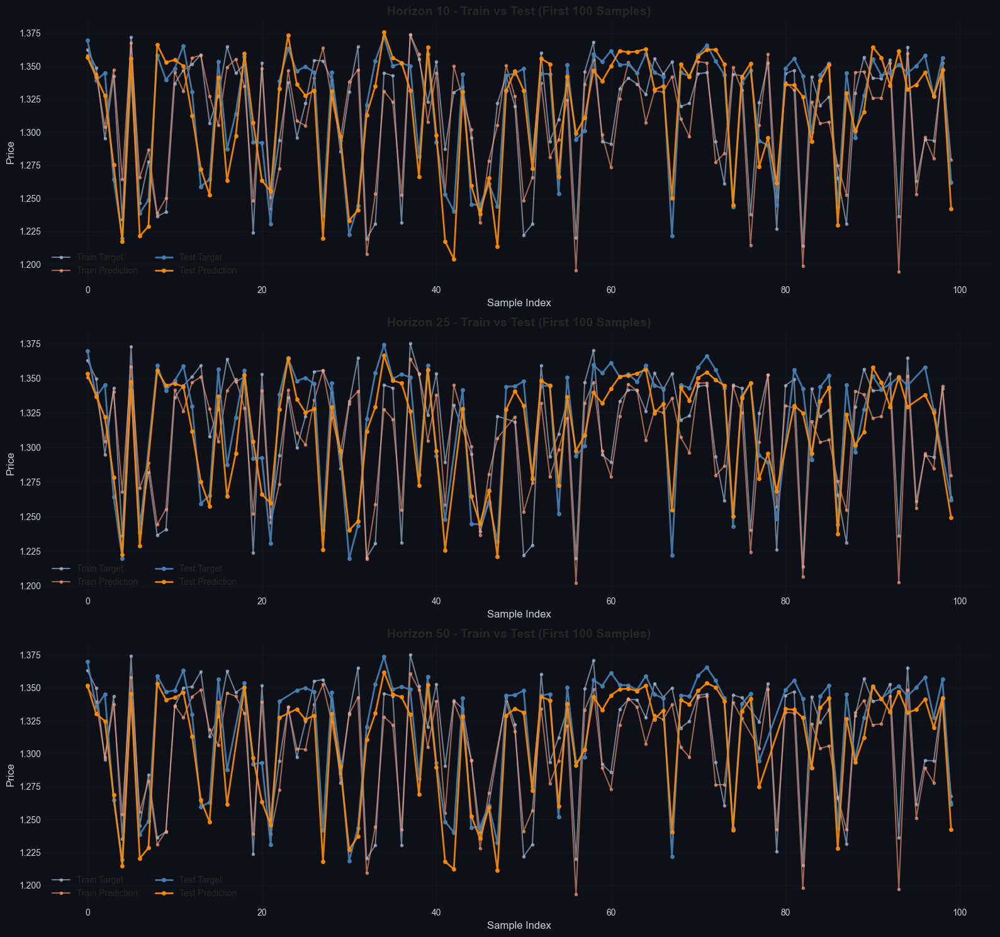

✅ Saved: plots_train_test_comparison.png

📊 Plotting Train predictions...


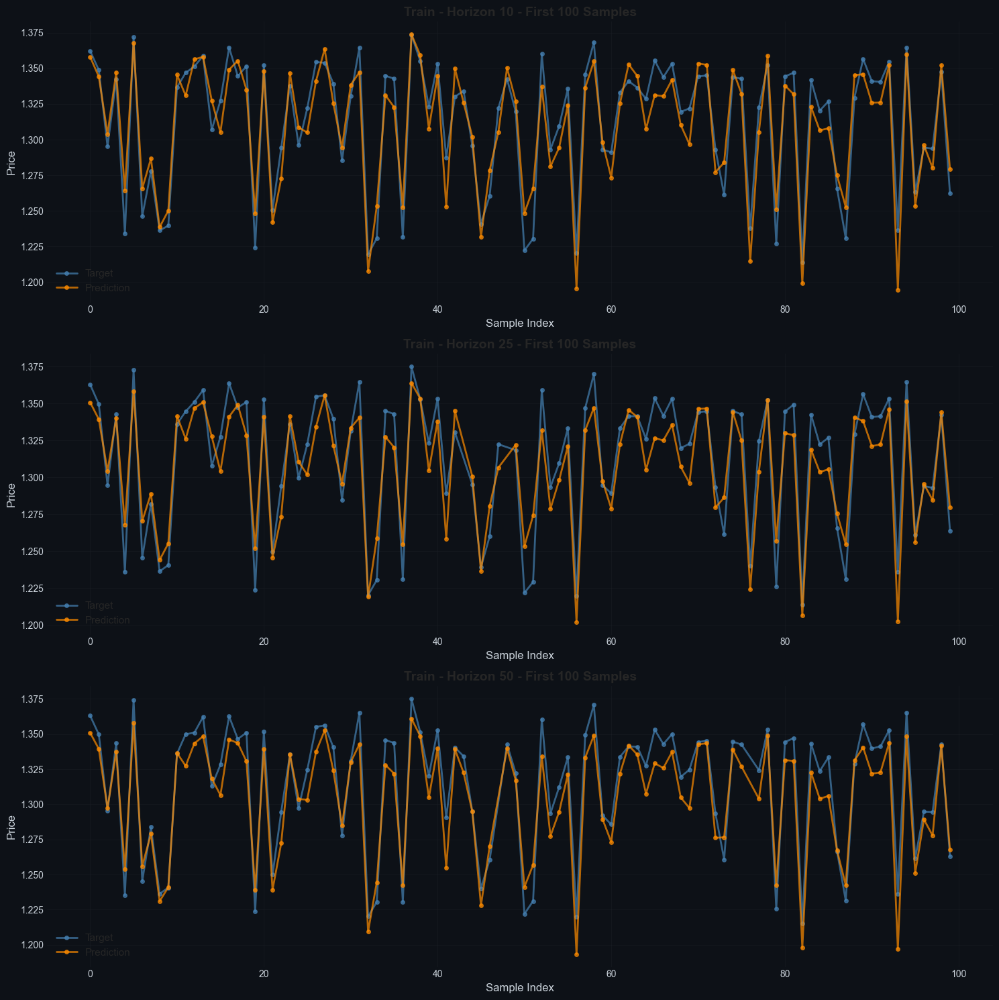

📊 Plotting Val predictions...


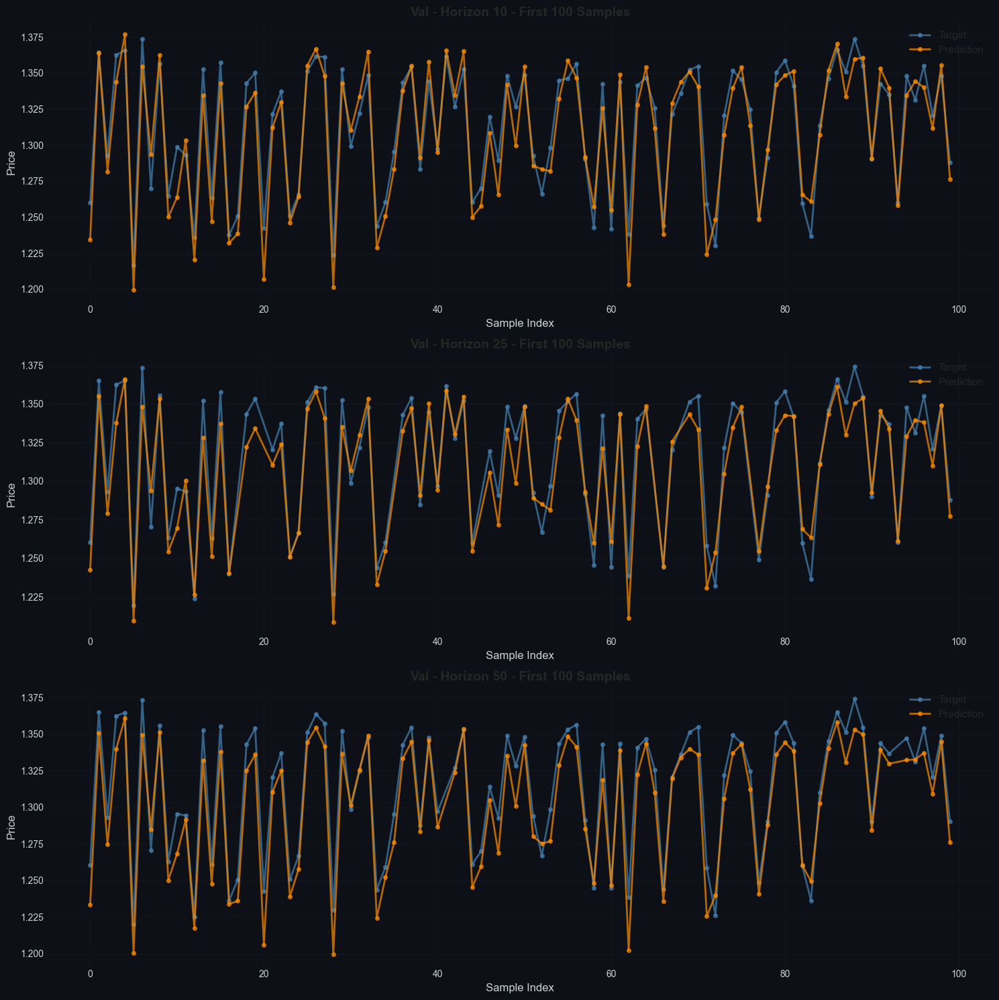

📊 Plotting Test predictions...


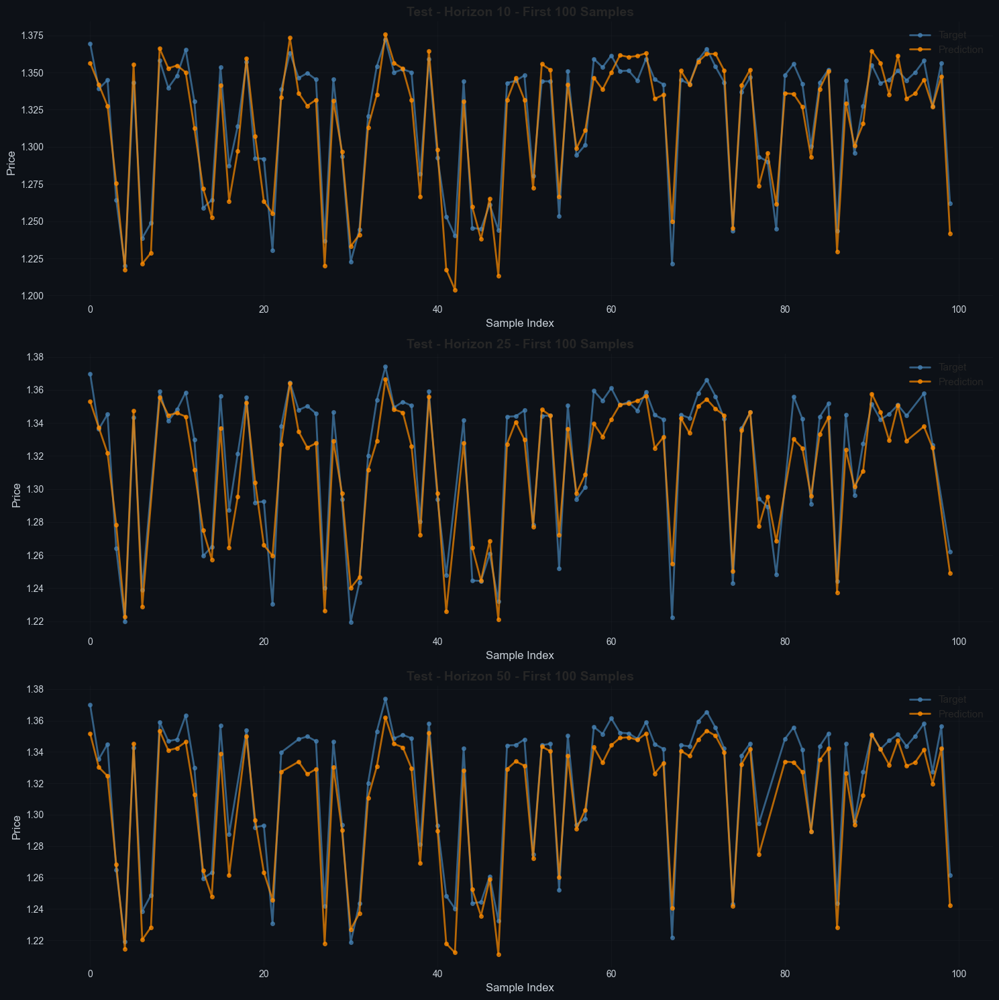

In [54]:
plot_train_val_test_predictions(
        results=results,
        horizons=[10, 25, 50],
        n_samples=100,
        save_path="plots"
    )


DIRECTIONAL ACCURACY ANALYSIS (TRAIN/VAL/TEST)


TRAIN SET CONFUSION MATRICES


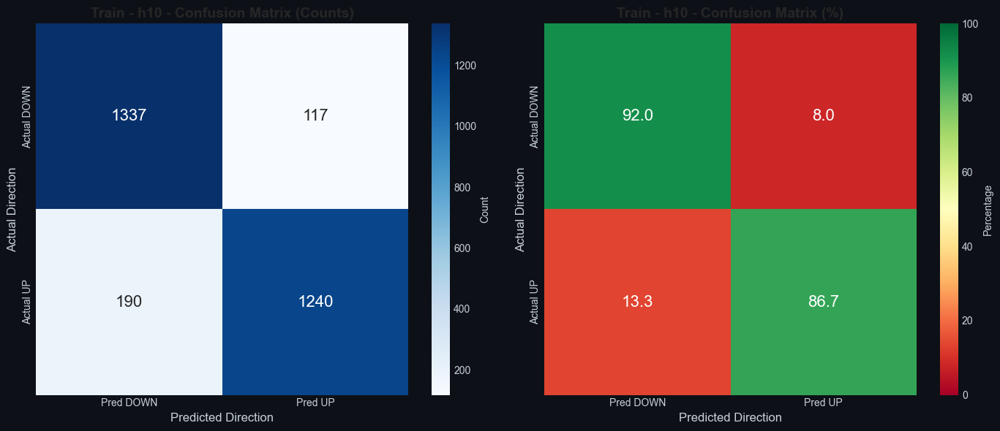


DIRECTIONAL CLASSIFICATION REPORT - Train - h10

              precision    recall  f1-score   support

        DOWN      0.876     0.920     0.897      1454
          UP      0.914     0.867     0.890      1430

    accuracy                          0.894      2884
   macro avg      0.895     0.893     0.893      2884
weighted avg      0.895     0.894     0.893      2884

Directional Accuracy: 89.36%



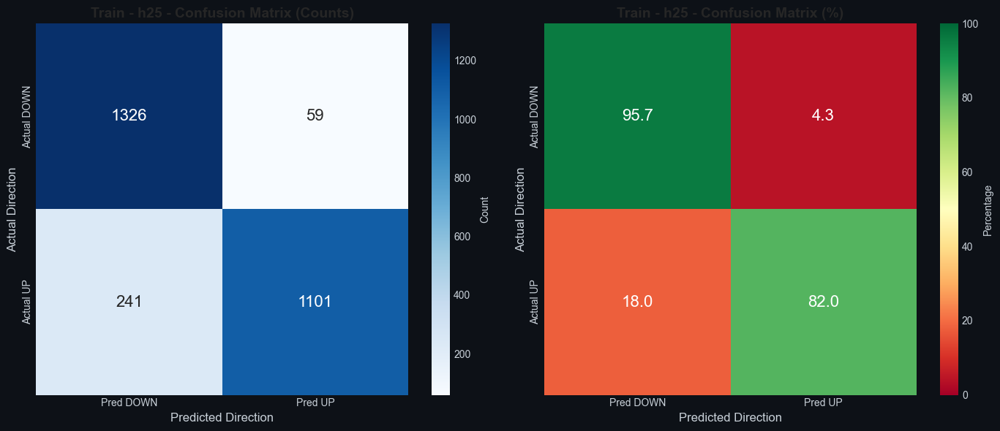


DIRECTIONAL CLASSIFICATION REPORT - Train - h25

              precision    recall  f1-score   support

        DOWN      0.846     0.957     0.898      1385
          UP      0.949     0.820     0.880      1342

    accuracy                          0.890      2727
   macro avg      0.898     0.889     0.889      2727
weighted avg      0.897     0.890     0.889      2727

Directional Accuracy: 89.00%



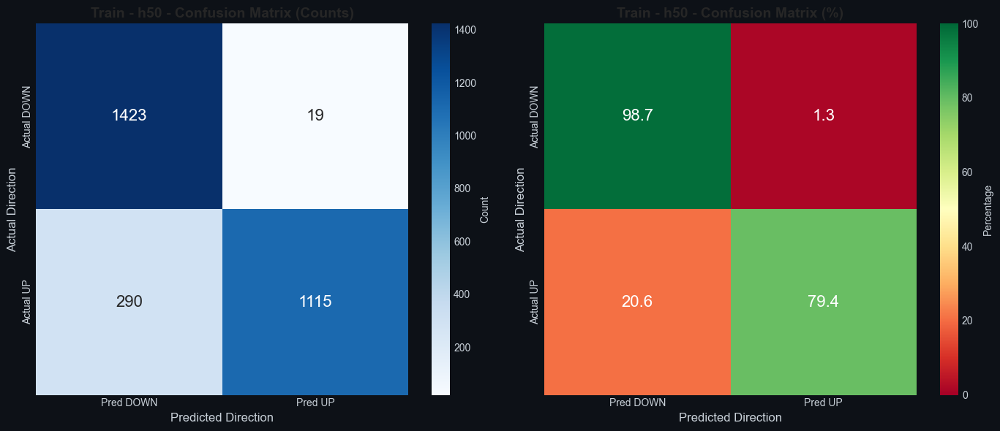


DIRECTIONAL CLASSIFICATION REPORT - Train - h50

              precision    recall  f1-score   support

        DOWN      0.831     0.987     0.902      1442
          UP      0.983     0.794     0.878      1405

    accuracy                          0.891      2847
   macro avg      0.907     0.890     0.890      2847
weighted avg      0.906     0.891     0.890      2847

Directional Accuracy: 89.15%


VAL SET CONFUSION MATRICES


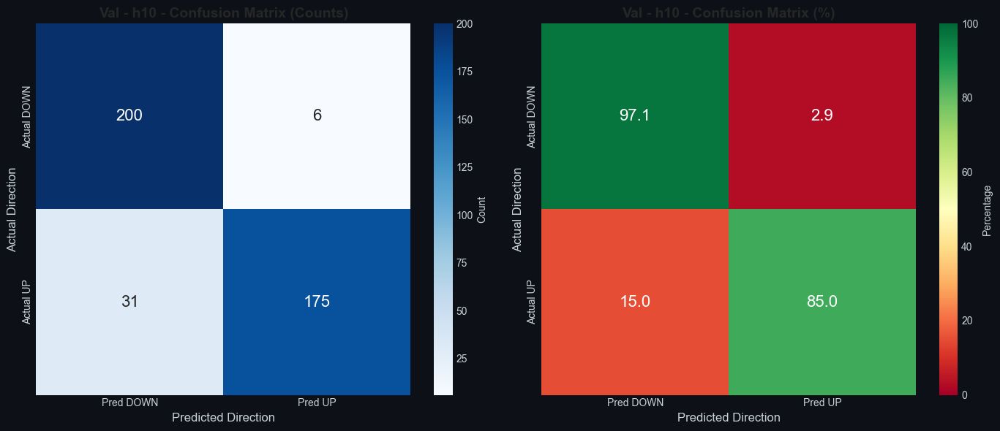


DIRECTIONAL CLASSIFICATION REPORT - Val - h10

              precision    recall  f1-score   support

        DOWN      0.866     0.971     0.915       206
          UP      0.967     0.850     0.904       206

    accuracy                          0.910       412
   macro avg      0.916     0.910     0.910       412
weighted avg      0.916     0.910     0.910       412

Directional Accuracy: 91.02%



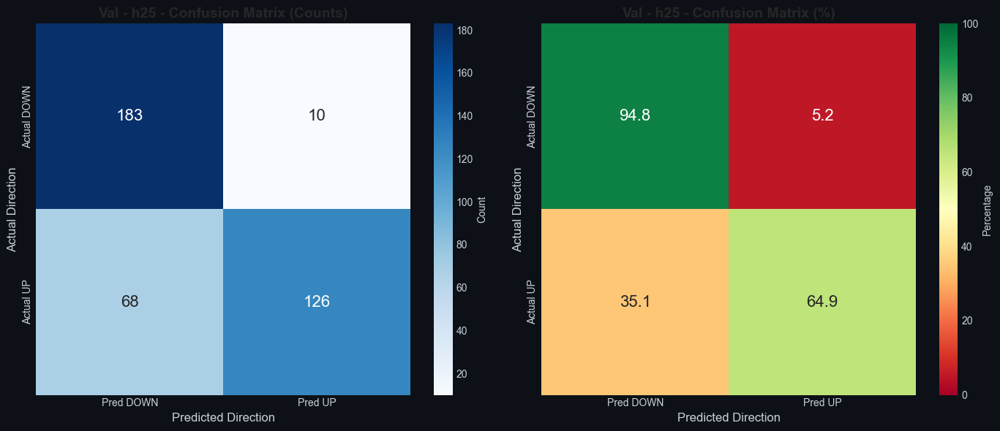


DIRECTIONAL CLASSIFICATION REPORT - Val - h25

              precision    recall  f1-score   support

        DOWN      0.729     0.948     0.824       193
          UP      0.926     0.649     0.764       194

    accuracy                          0.798       387
   macro avg      0.828     0.799     0.794       387
weighted avg      0.828     0.798     0.794       387

Directional Accuracy: 79.84%



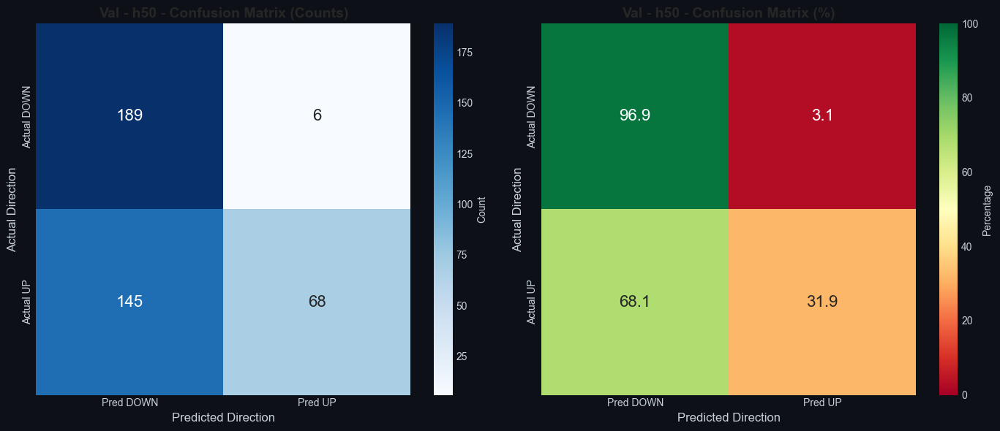


DIRECTIONAL CLASSIFICATION REPORT - Val - h50

              precision    recall  f1-score   support

        DOWN      0.566     0.969     0.715       195
          UP      0.919     0.319     0.474       213

    accuracy                          0.630       408
   macro avg      0.742     0.644     0.594       408
weighted avg      0.750     0.630     0.589       408

Directional Accuracy: 62.99%


TEST SET CONFUSION MATRICES


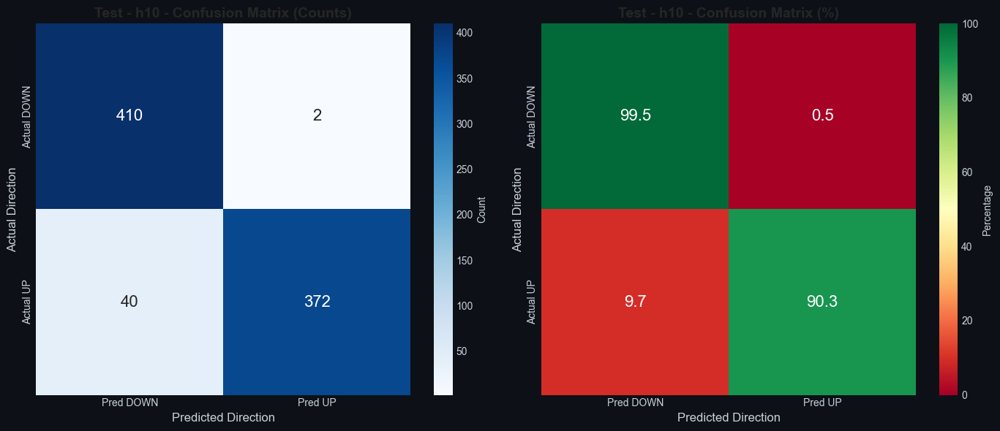


DIRECTIONAL CLASSIFICATION REPORT - Test - h10

              precision    recall  f1-score   support

        DOWN      0.911     0.995     0.951       412
          UP      0.995     0.903     0.947       412

    accuracy                          0.949       824
   macro avg      0.953     0.949     0.949       824
weighted avg      0.953     0.949     0.949       824

Directional Accuracy: 94.90%



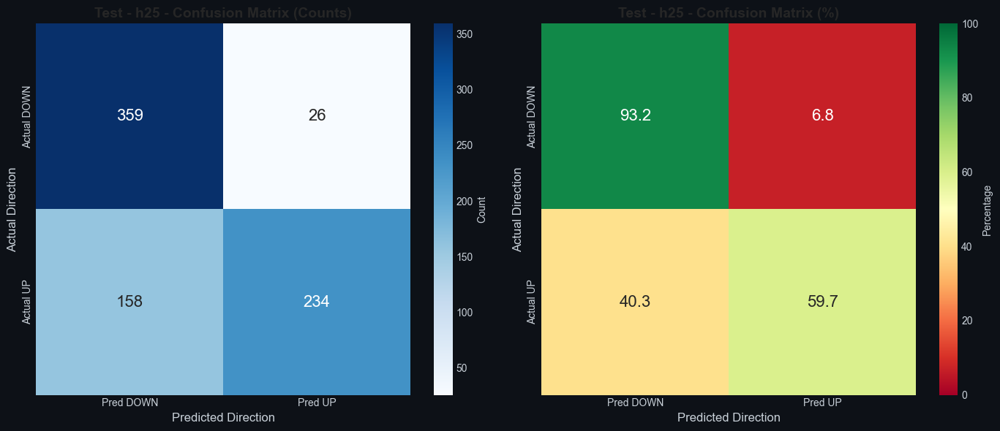


DIRECTIONAL CLASSIFICATION REPORT - Test - h25

              precision    recall  f1-score   support

        DOWN      0.694     0.932     0.796       385
          UP      0.900     0.597     0.718       392

    accuracy                          0.763       777
   macro avg      0.797     0.765     0.757       777
weighted avg      0.798     0.763     0.757       777

Directional Accuracy: 76.32%



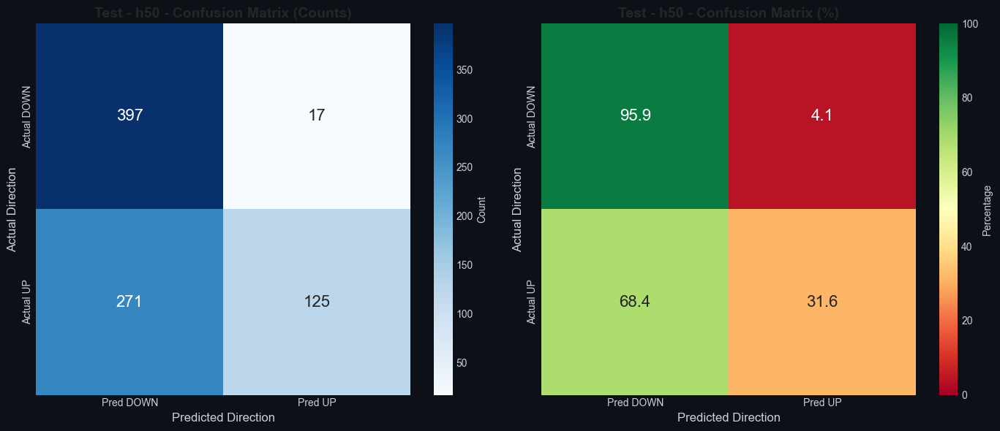


DIRECTIONAL CLASSIFICATION REPORT - Test - h50

              precision    recall  f1-score   support

        DOWN      0.594     0.959     0.734       414
          UP      0.880     0.316     0.465       396

    accuracy                          0.644       810
   macro avg      0.737     0.637     0.599       810
weighted avg      0.734     0.644     0.602       810

Directional Accuracy: 64.44%



In [55]:
analyze_directional_accuracy(
        results=results,
        horizons=[10, 25, 50],
        save_path="plots"
    )

# Walkforward

In [29]:
wf_expanding = walk_forward_validation(
    df_masked=df_maskeds,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=180,  # Initial size
    test_days=30,
    step_days=5,
    dropout=0.3,
    l2_lambda=0.01,
    window_type="expanding",  # ← Growing window
    epochs=60,
    batch_size=64,
    max_folds=5,
    seq_len=64
)


WALK-FORWARD VALIDATION WITH FEATURE FILTERING

🔍 FEATURE FILTERING (INCLUDING MINOR)

📊 Feature Reduction Summary:
   Original features: 2,227
   Kept features:     139
   Removed features:  2,088
   Reduction:         93.8%

📋 Features by Category:
   price               :   7 features
   session             :  27 features
   minor_core          :   7 features
   minor_timing        :   2 features
   minor_distance      :   2 features
   minor_momentum      :   2 features
   minor_overshoot     :   2 features
   minor_flash         :   2 features
   minor_bos           :   0 features
   minor_patterns      :   0 features
   minmaj_core         :  10 features
   minmaj_timing       :   2 features
   minmaj_distance     :   2 features
   minmaj_momentum     :   2 features
   minmaj_overshoot    :   2 features
   minmaj_flash        :   2 features
   minmaj_bos          :   1 features
   minmaj_patterns     :   9 features
   major_core          :   7 features
   major_timing        :  

# Confusion Matrix and  Plot


FOLD PROGRESSION ANALYSIS



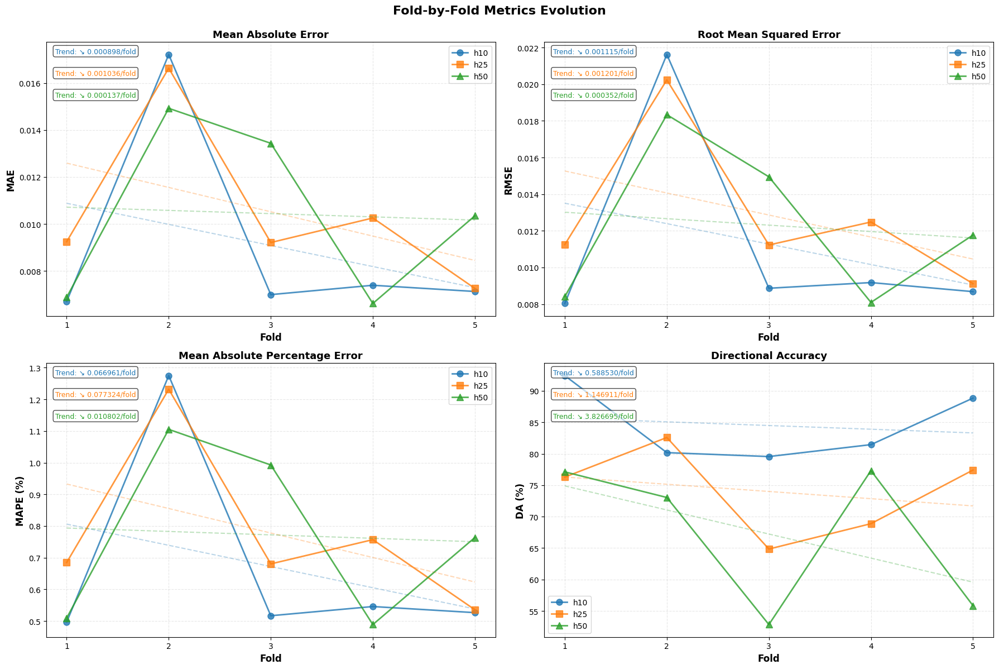

✅ Saved: walkforward_plots/fold_progression_metrics.png


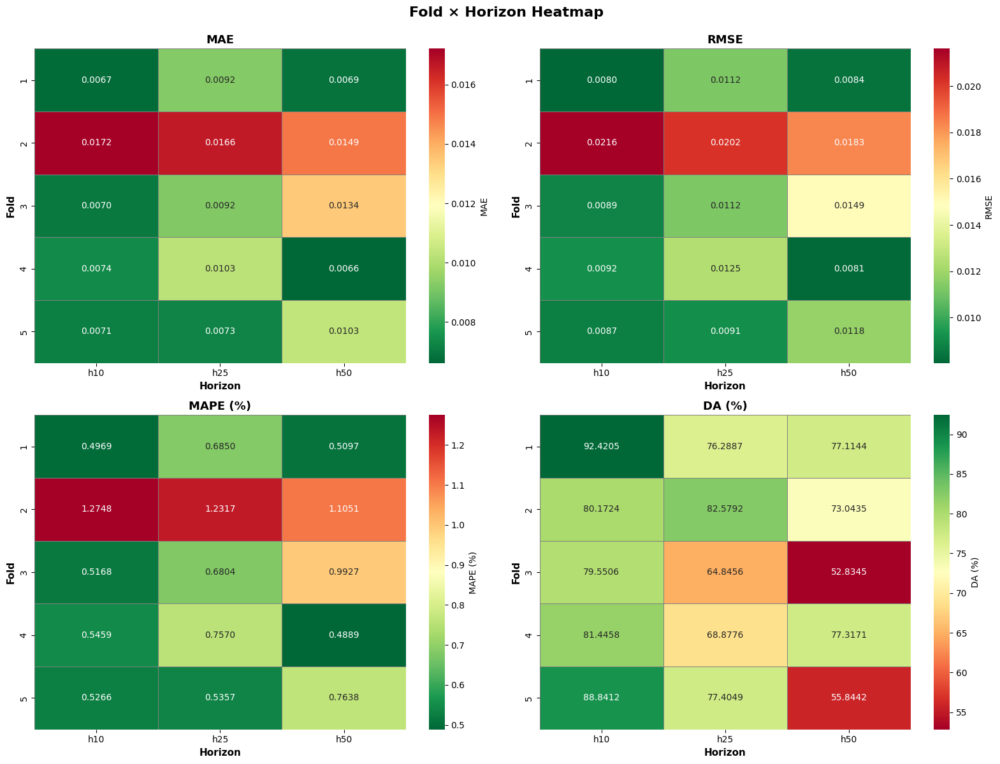

✅ Saved: walkforward_plots/fold_horizon_heatmap.png


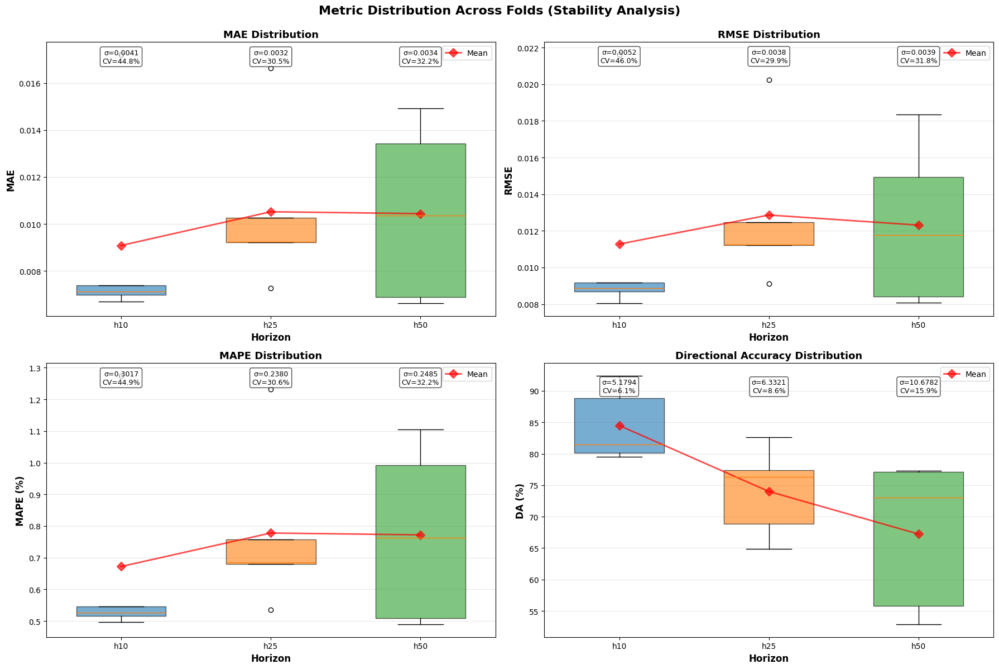

✅ Saved: walkforward_plots/fold_stability_analysis.png

FOLD PROGRESSION STATISTICS

Horizon Metric First Fold Last Fold    Mean     Std CV (%)     Slope Change (%)        Trend
    h10    MAE     0.0067    0.0071  0.0091  0.0041  44.79 -0.000898      -6.30  ✅ Improving
    h10   RMSE     0.0080    0.0087  0.0113  0.0052  45.99 -0.001115      -8.04  ✅ Improving
    h10   MAPE     0.4969    0.5266  0.6722  0.3017  44.88 -0.066961      -5.97  ✅ Improving
    h10     DA    92.4205   88.8412 84.4861  5.1794   6.13 -0.588530      -3.87 ⚠️ Degrading
    h25    MAE     0.0092    0.0073  0.0105  0.0032  30.48 -0.001036     +21.51  ✅ Improving
    h25   RMSE     0.0112    0.0091  0.0129  0.0038  29.86 -0.001201     +18.93  ✅ Improving
    h25   MAPE     0.6850    0.5357  0.7780  0.2380  30.59 -0.077324     +21.79  ✅ Improving
    h25     DA    76.2887   77.4049 73.9992  6.3321   8.56 -1.146911      +1.46 ⚠️ Degrading
    h50    MAE     0.0069    0.0103  0.0104  0.0034  32.16 -0.000137     -50.3

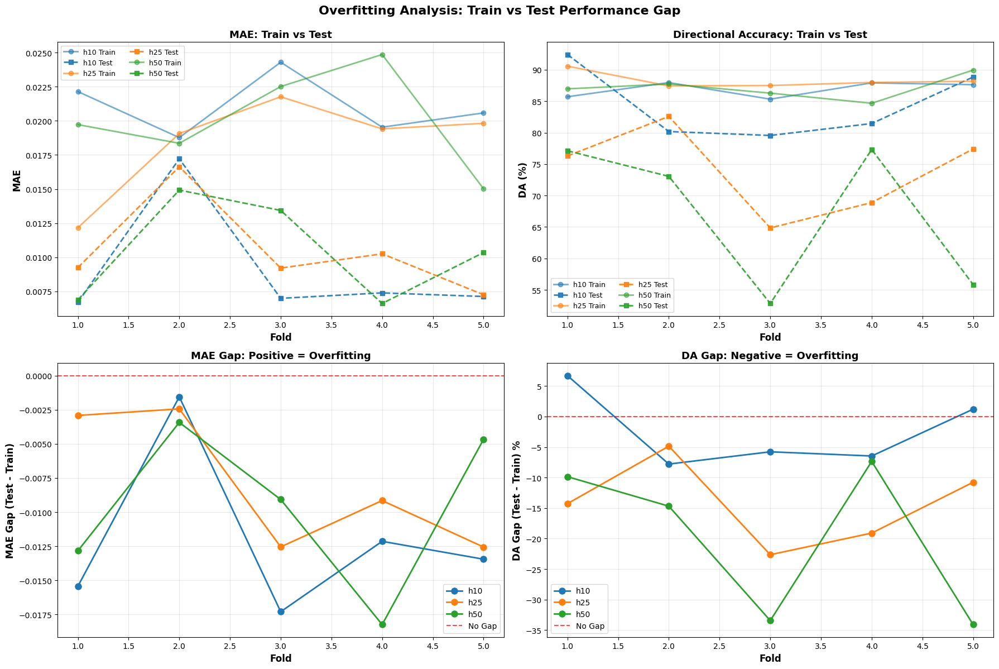

✅ Saved: walkforward_plots/overfitting_analysis.png

OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS)

🎯 Horizon h10:
   MAE  Gap: -0.011977 (avg) | σ=0.006146
   RMSE Gap: -0.014077 (avg) | σ=0.007489
   DA   Gap: -2.42% (avg) | σ=6.19%
   ℹ️  MIXED SIGNALS

🎯 Horizon h25:
   MAE  Gap: -0.007924 (avg) | σ=0.004989
   RMSE Gap: -0.009801 (avg) | σ=0.005833
   DA   Gap: -14.33% (avg) | σ=6.97%
   ℹ️  MIXED SIGNALS

🎯 Horizon h50:
   MAE  Gap: -0.009651 (avg) | σ=0.006079
   RMSE Gap: -0.011974 (avg) | σ=0.006559
   DA   Gap: -19.89% (avg) | σ=12.95%
   ℹ️  MIXED SIGNALS

💾 Saved: walkforward_plots/overfitting_data.csv


PER-FOLD PREDICTIONS & CONFUSION MATRICES


FOLD 1

📊 Plotting Fold 1 train+test comparison...


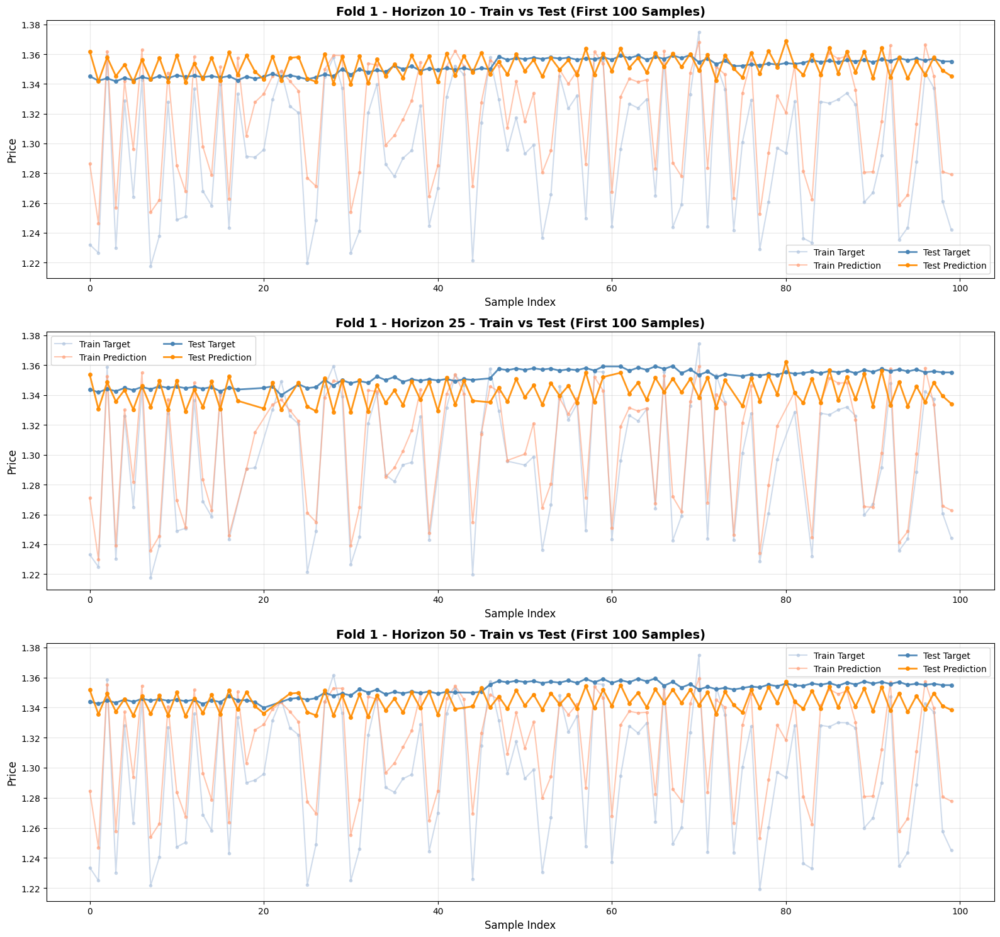

✅ Saved: walkforward_plots/Fold1_train_test_comparison.png

📈 Generating Fold 1 confusion matrices...


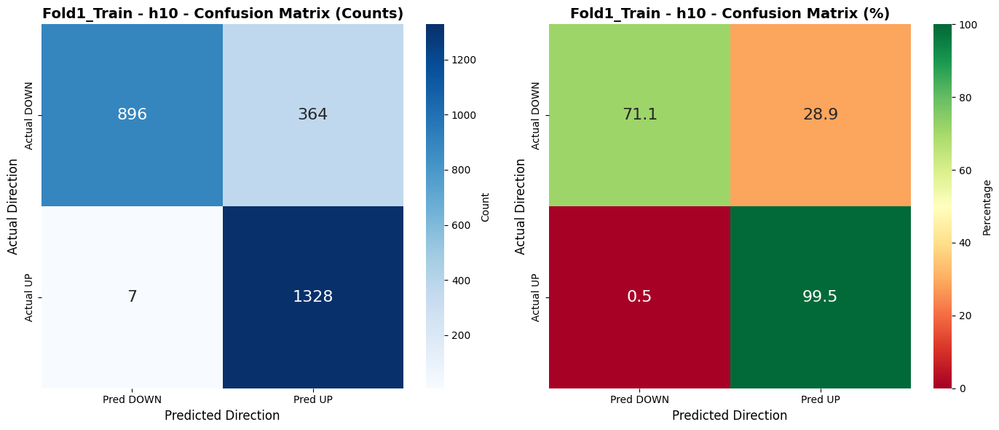


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Train - h10

              precision    recall  f1-score   support

        DOWN      0.992     0.711     0.828      1260
          UP      0.785     0.995     0.877      1335

    accuracy                          0.857      2595
   macro avg      0.889     0.853     0.853      2595
weighted avg      0.886     0.857     0.854      2595

Directional Accuracy: 85.70%



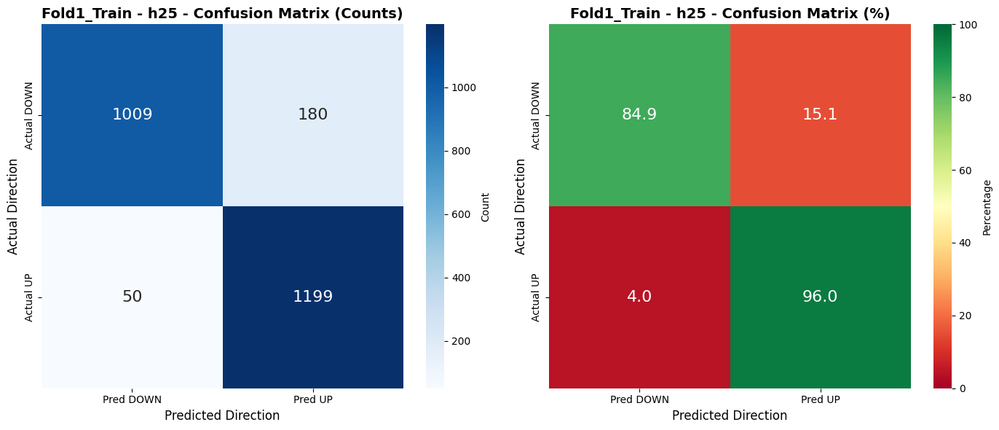


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Train - h25

              precision    recall  f1-score   support

        DOWN      0.953     0.849     0.898      1189
          UP      0.869     0.960     0.912      1249

    accuracy                          0.906      2438
   macro avg      0.911     0.904     0.905      2438
weighted avg      0.910     0.906     0.905      2438

Directional Accuracy: 90.57%



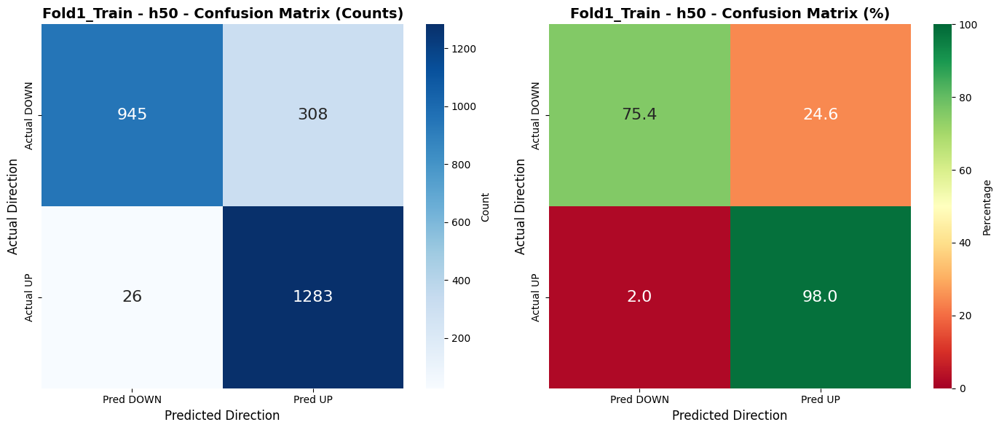


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Train - h50

              precision    recall  f1-score   support

        DOWN      0.973     0.754     0.850      1253
          UP      0.806     0.980     0.885      1309

    accuracy                          0.870      2562
   macro avg      0.890     0.867     0.867      2562
weighted avg      0.888     0.870     0.868      2562

Directional Accuracy: 86.96%



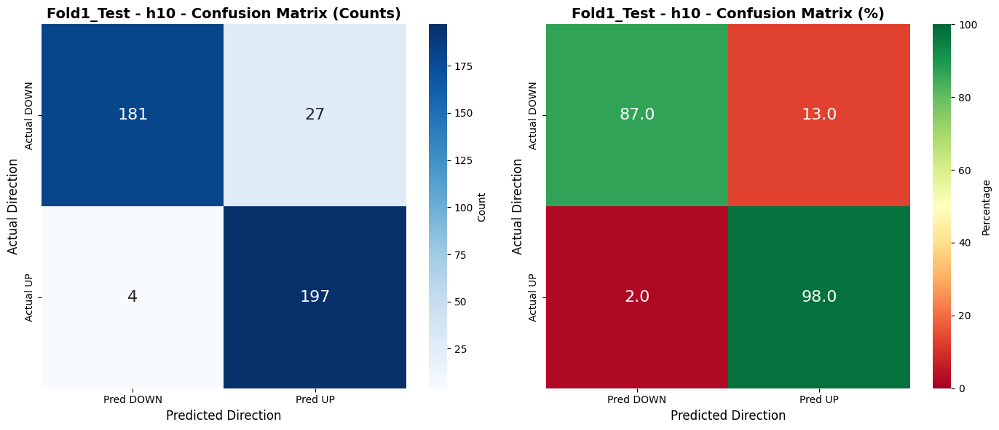


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Test - h10

              precision    recall  f1-score   support

        DOWN      0.978     0.870     0.921       208
          UP      0.879     0.980     0.927       201

    accuracy                          0.924       409
   macro avg      0.929     0.925     0.924       409
weighted avg      0.930     0.924     0.924       409

Directional Accuracy: 92.42%



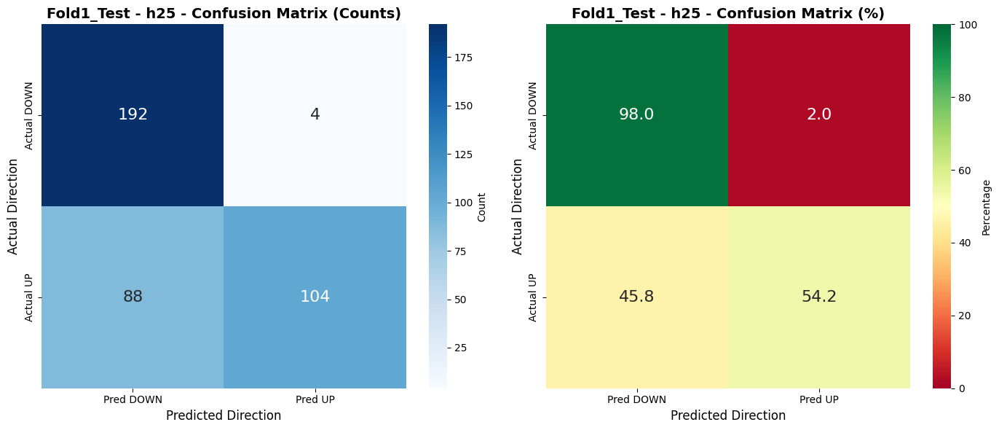


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Test - h25

              precision    recall  f1-score   support

        DOWN      0.686     0.980     0.807       196
          UP      0.963     0.542     0.693       192

    accuracy                          0.763       388
   macro avg      0.824     0.761     0.750       388
weighted avg      0.823     0.763     0.751       388

Directional Accuracy: 76.29%



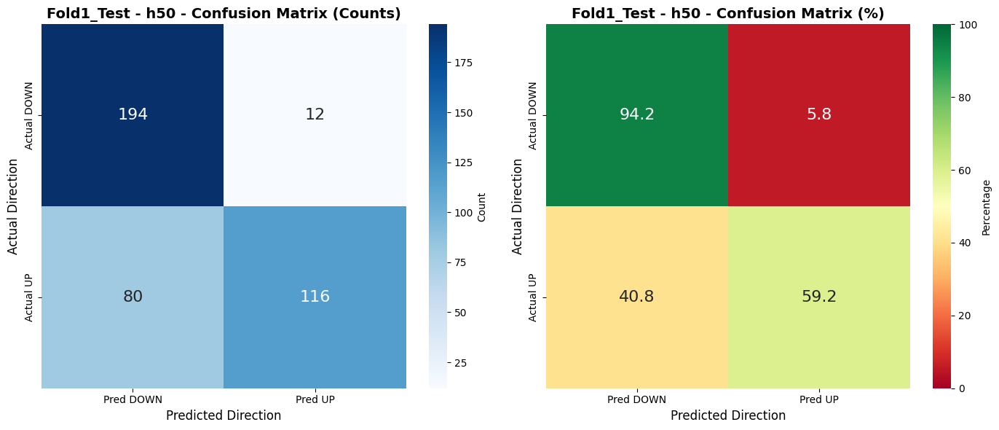


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Test - h50

              precision    recall  f1-score   support

        DOWN      0.708     0.942     0.808       206
          UP      0.906     0.592     0.716       196

    accuracy                          0.771       402
   macro avg      0.807     0.767     0.762       402
weighted avg      0.805     0.771     0.763       402

Directional Accuracy: 77.11%


FOLD 2

📊 Plotting Fold 2 train+test comparison...


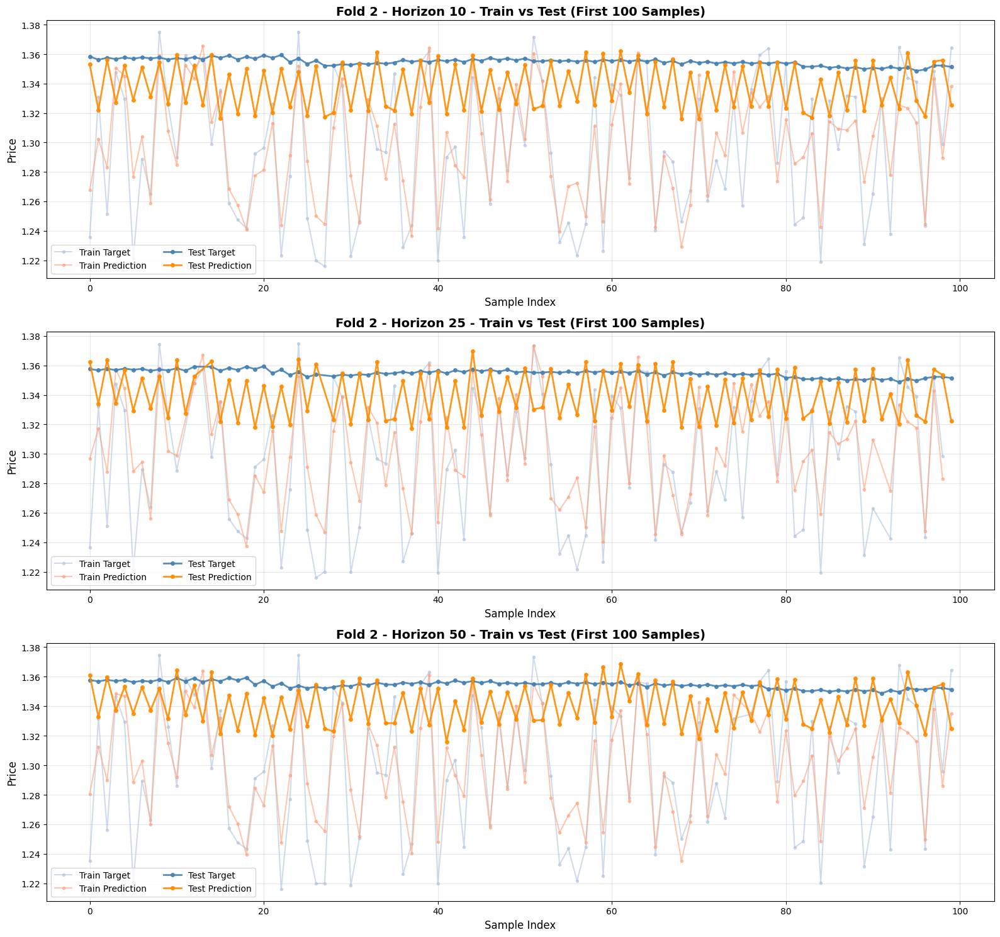

✅ Saved: walkforward_plots/Fold2_train_test_comparison.png

📈 Generating Fold 2 confusion matrices...


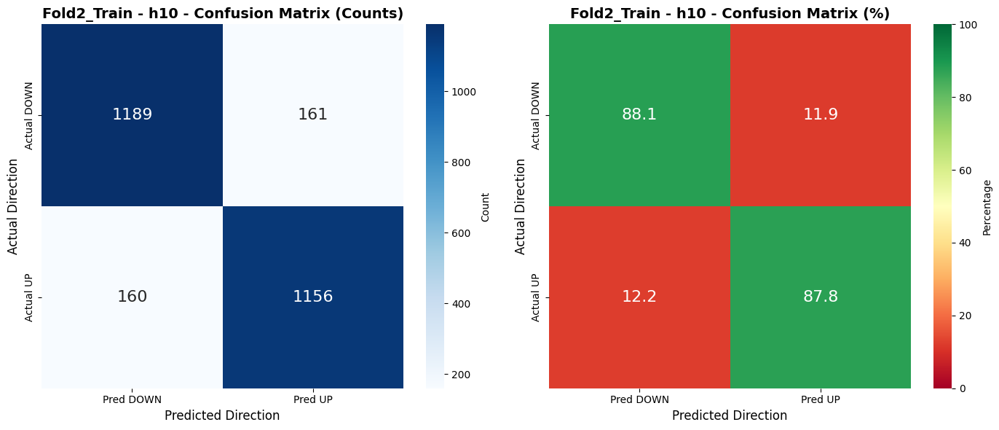


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train - h10

              precision    recall  f1-score   support

        DOWN      0.881     0.881     0.881      1350
          UP      0.878     0.878     0.878      1316

    accuracy                          0.880      2666
   macro avg      0.880     0.880     0.880      2666
weighted avg      0.880     0.880     0.880      2666

Directional Accuracy: 87.96%



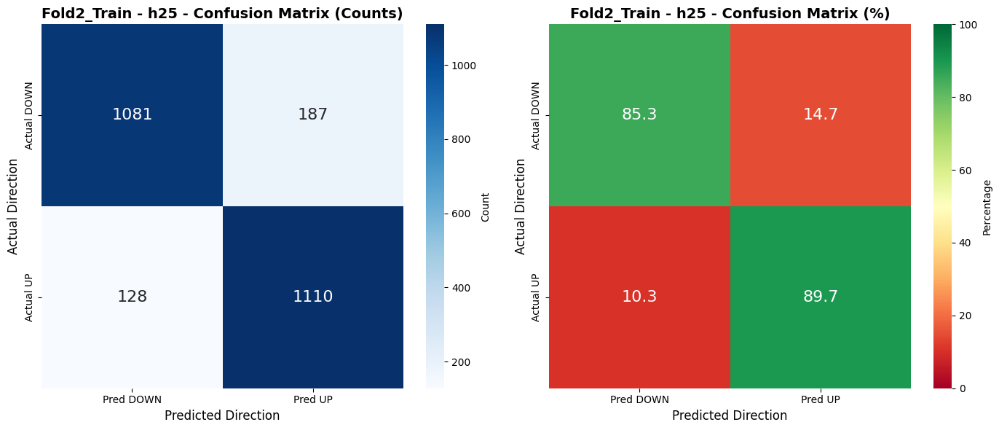


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train - h25

              precision    recall  f1-score   support

        DOWN      0.894     0.853     0.873      1268
          UP      0.856     0.897     0.876      1238

    accuracy                          0.874      2506
   macro avg      0.875     0.875     0.874      2506
weighted avg      0.875     0.874     0.874      2506

Directional Accuracy: 87.43%



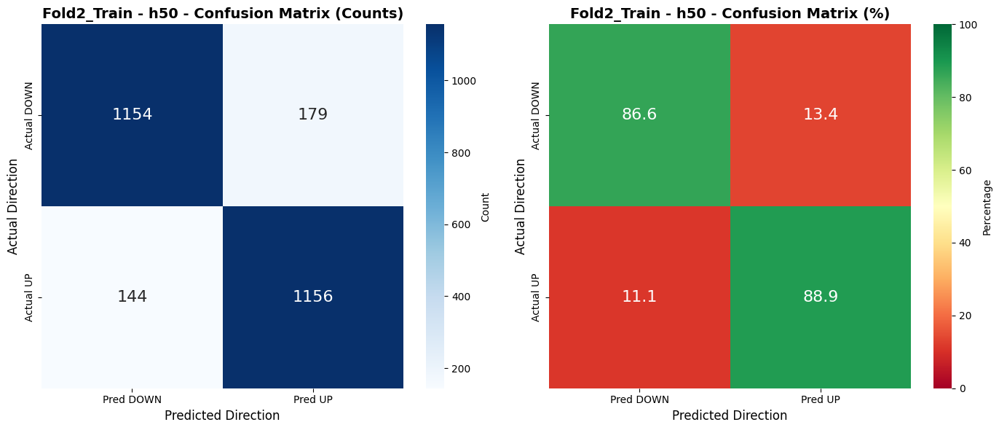


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train - h50

              precision    recall  f1-score   support

        DOWN      0.889     0.866     0.877      1333
          UP      0.866     0.889     0.877      1300

    accuracy                          0.877      2633
   macro avg      0.877     0.877     0.877      2633
weighted avg      0.878     0.877     0.877      2633

Directional Accuracy: 87.73%



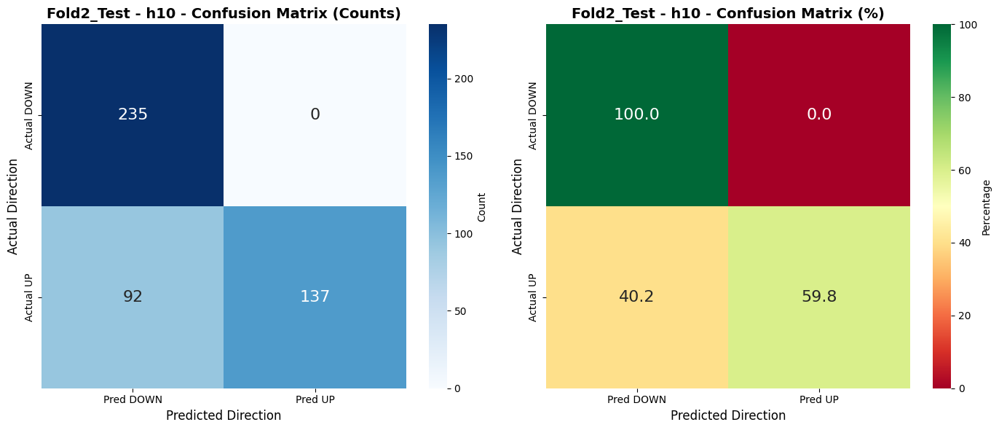


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Test - h10

              precision    recall  f1-score   support

        DOWN      0.719     1.000     0.836       235
          UP      1.000     0.598     0.749       229

    accuracy                          0.802       464
   macro avg      0.859     0.799     0.792       464
weighted avg      0.858     0.802     0.793       464

Directional Accuracy: 80.17%



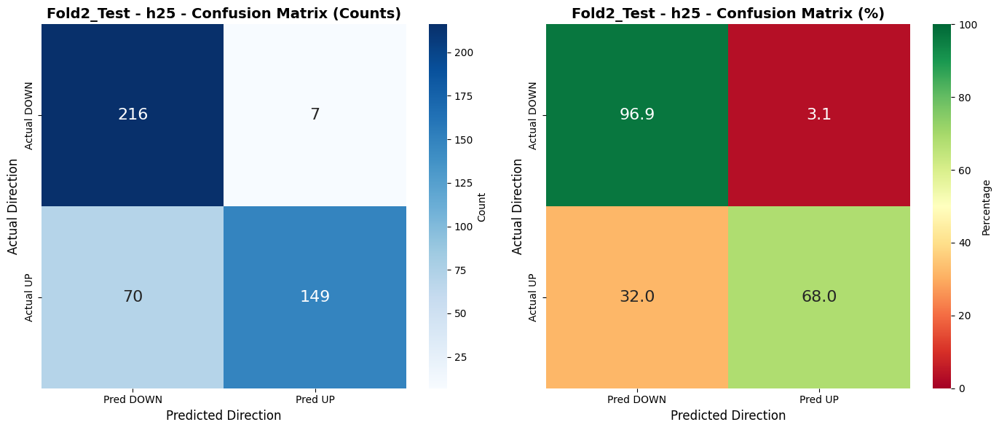


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Test - h25

              precision    recall  f1-score   support

        DOWN      0.755     0.969     0.849       223
          UP      0.955     0.680     0.795       219

    accuracy                          0.826       442
   macro avg      0.855     0.824     0.822       442
weighted avg      0.854     0.826     0.822       442

Directional Accuracy: 82.58%



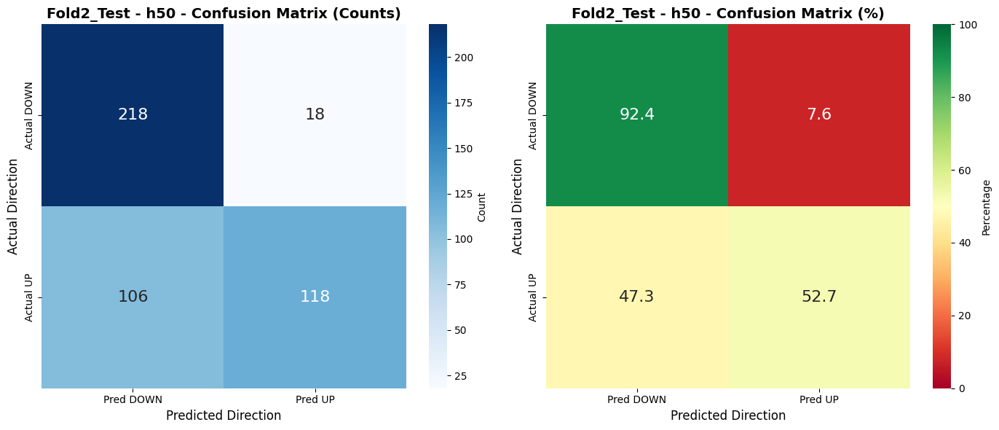


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Test - h50

              precision    recall  f1-score   support

        DOWN      0.673     0.924     0.779       236
          UP      0.868     0.527     0.656       224

    accuracy                          0.730       460
   macro avg      0.770     0.725     0.717       460
weighted avg      0.768     0.730     0.719       460

Directional Accuracy: 73.04%


FOLD 3

📊 Plotting Fold 3 train+test comparison...


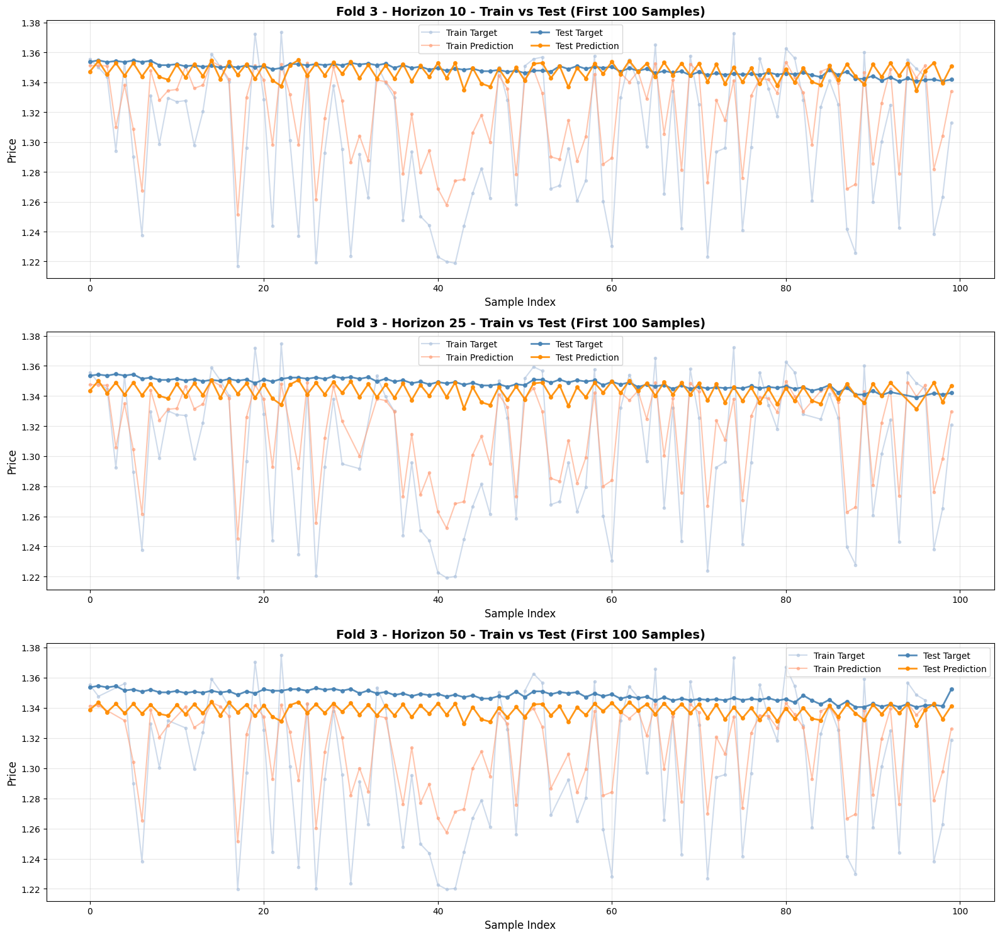

✅ Saved: walkforward_plots/Fold3_train_test_comparison.png

📈 Generating Fold 3 confusion matrices...


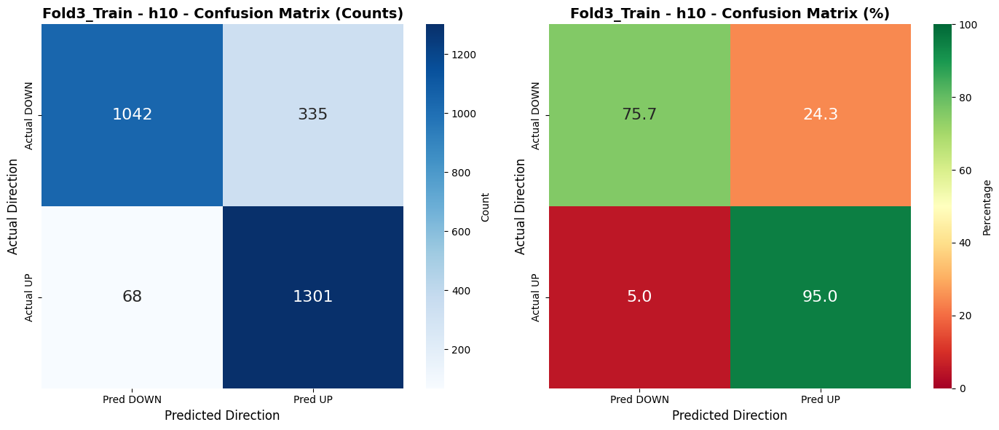


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Train - h10

              precision    recall  f1-score   support

        DOWN      0.939     0.757     0.838      1377
          UP      0.795     0.950     0.866      1369

    accuracy                          0.853      2746
   macro avg      0.867     0.854     0.852      2746
weighted avg      0.867     0.853     0.852      2746

Directional Accuracy: 85.32%



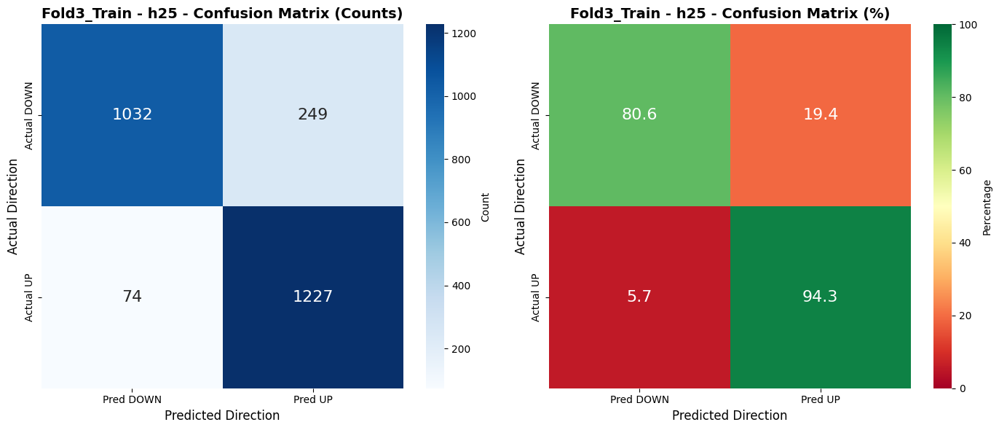


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Train - h25

              precision    recall  f1-score   support

        DOWN      0.933     0.806     0.865      1281
          UP      0.831     0.943     0.884      1301

    accuracy                          0.875      2582
   macro avg      0.882     0.874     0.874      2582
weighted avg      0.882     0.875     0.874      2582

Directional Accuracy: 87.49%



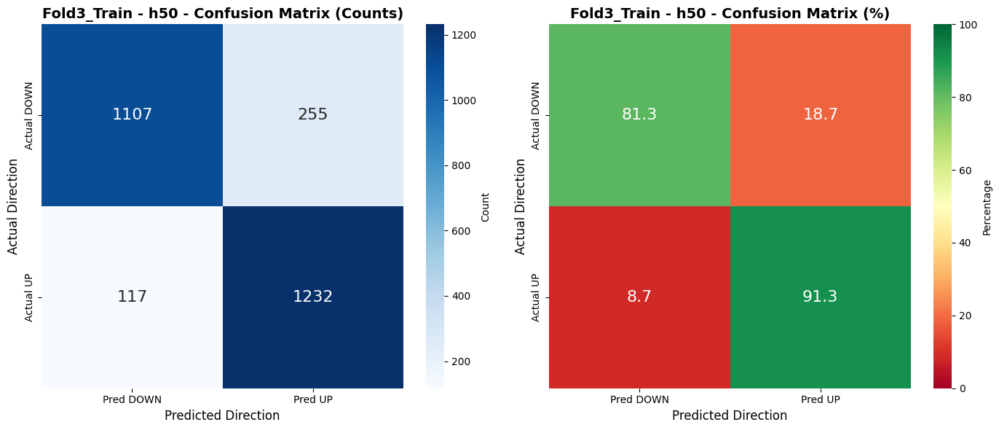


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Train - h50

              precision    recall  f1-score   support

        DOWN      0.904     0.813     0.856      1362
          UP      0.829     0.913     0.869      1349

    accuracy                          0.863      2711
   macro avg      0.866     0.863     0.862      2711
weighted avg      0.867     0.863     0.862      2711

Directional Accuracy: 86.28%



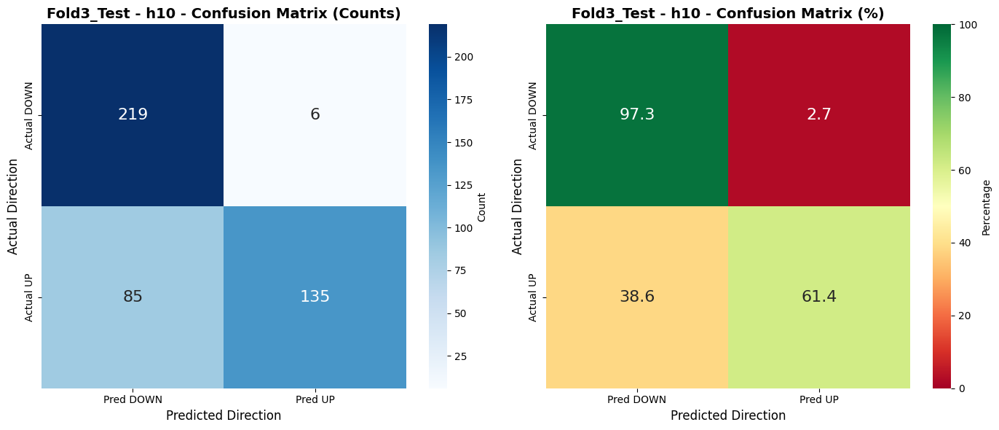


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Test - h10

              precision    recall  f1-score   support

        DOWN      0.720     0.973     0.828       225
          UP      0.957     0.614     0.748       220

    accuracy                          0.796       445
   macro avg      0.839     0.793     0.788       445
weighted avg      0.838     0.796     0.788       445

Directional Accuracy: 79.55%



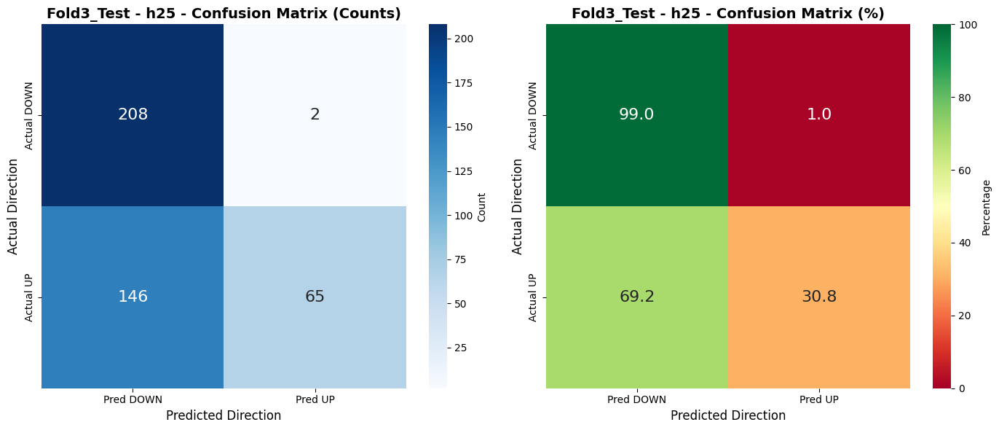


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Test - h25

              precision    recall  f1-score   support

        DOWN      0.588     0.990     0.738       210
          UP      0.970     0.308     0.468       211

    accuracy                          0.648       421
   macro avg      0.779     0.649     0.603       421
weighted avg      0.779     0.648     0.602       421

Directional Accuracy: 64.85%



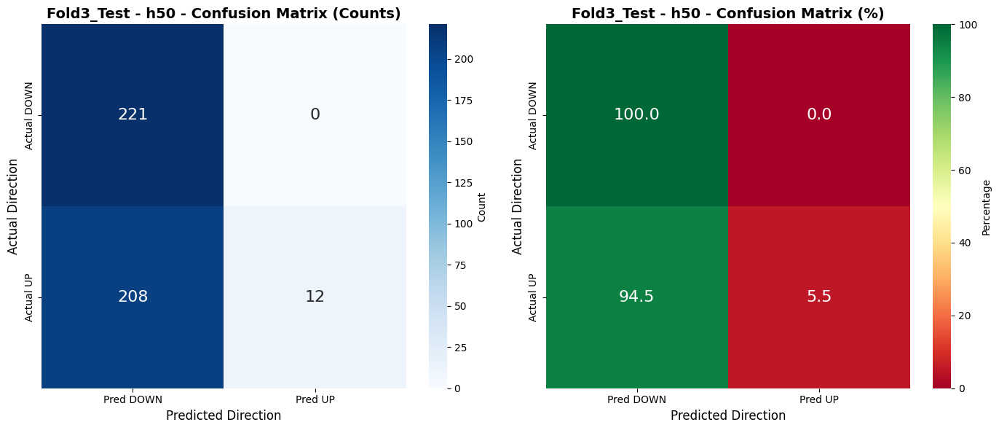


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Test - h50

              precision    recall  f1-score   support

        DOWN      0.515     1.000     0.680       221
          UP      1.000     0.055     0.103       220

    accuracy                          0.528       441
   macro avg      0.758     0.527     0.392       441
weighted avg      0.757     0.528     0.392       441

Directional Accuracy: 52.83%


FOLD 4

📊 Plotting Fold 4 train+test comparison...


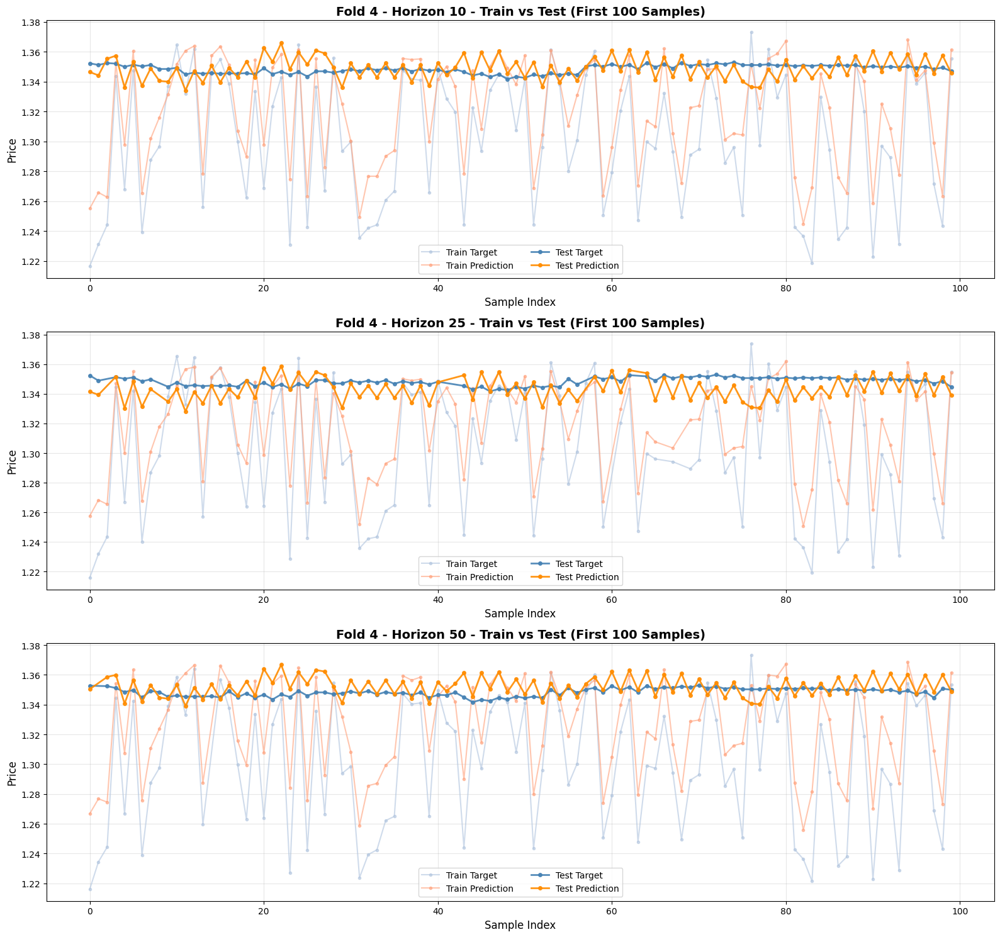

✅ Saved: walkforward_plots/Fold4_train_test_comparison.png

📈 Generating Fold 4 confusion matrices...


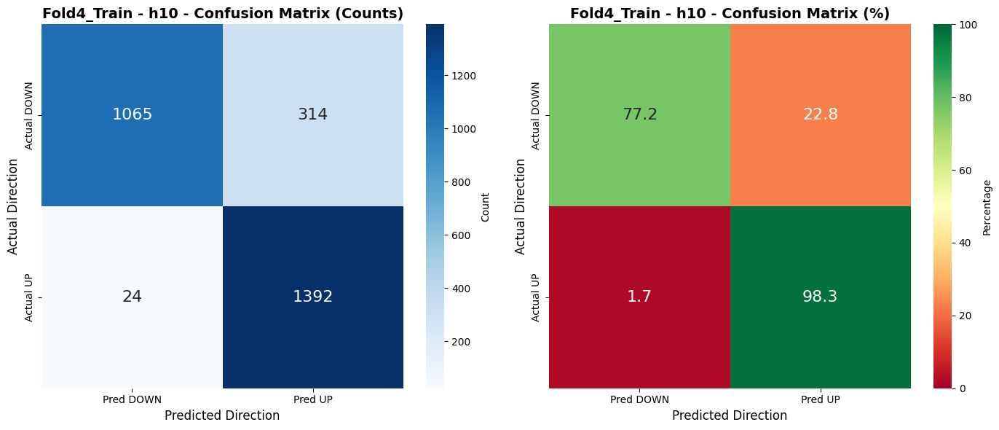


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train - h10

              precision    recall  f1-score   support

        DOWN      0.978     0.772     0.863      1379
          UP      0.816     0.983     0.892      1416

    accuracy                          0.879      2795
   macro avg      0.897     0.878     0.877      2795
weighted avg      0.896     0.879     0.878      2795

Directional Accuracy: 87.91%



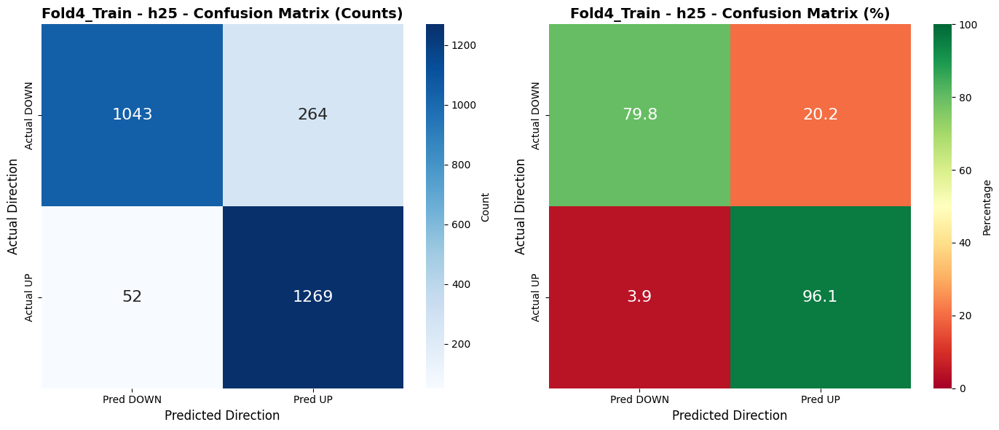


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train - h25

              precision    recall  f1-score   support

        DOWN      0.953     0.798     0.868      1307
          UP      0.828     0.961     0.889      1321

    accuracy                          0.880      2628
   macro avg      0.890     0.879     0.879      2628
weighted avg      0.890     0.880     0.879      2628

Directional Accuracy: 87.98%



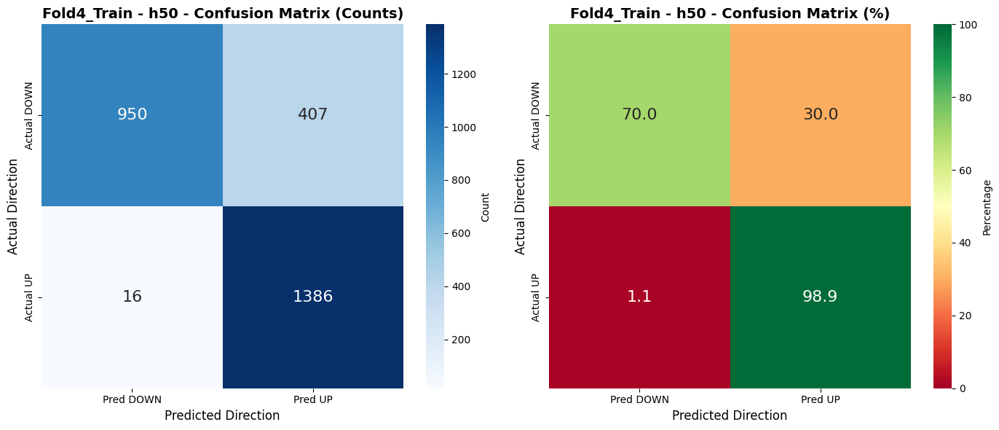


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train - h50

              precision    recall  f1-score   support

        DOWN      0.983     0.700     0.818      1357
          UP      0.773     0.989     0.868      1402

    accuracy                          0.847      2759
   macro avg      0.878     0.844     0.843      2759
weighted avg      0.877     0.847     0.843      2759

Directional Accuracy: 84.67%



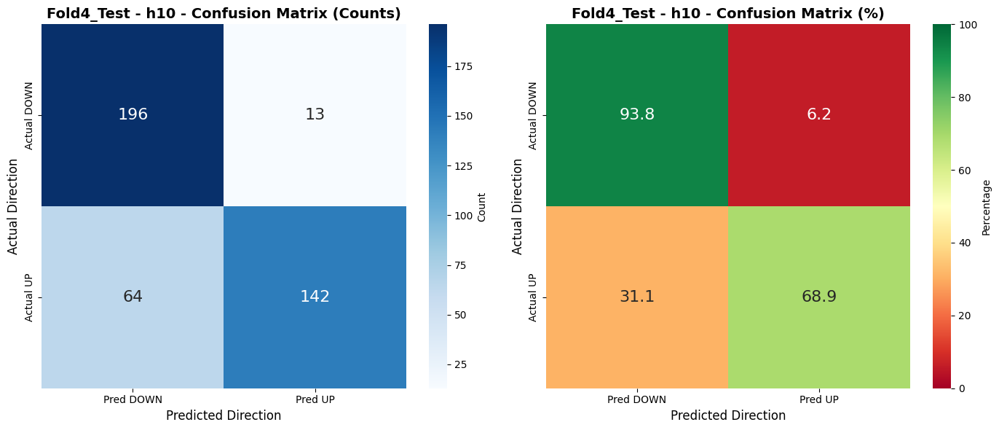


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Test - h10

              precision    recall  f1-score   support

        DOWN      0.754     0.938     0.836       209
          UP      0.916     0.689     0.787       206

    accuracy                          0.814       415
   macro avg      0.835     0.814     0.811       415
weighted avg      0.834     0.814     0.811       415

Directional Accuracy: 81.45%



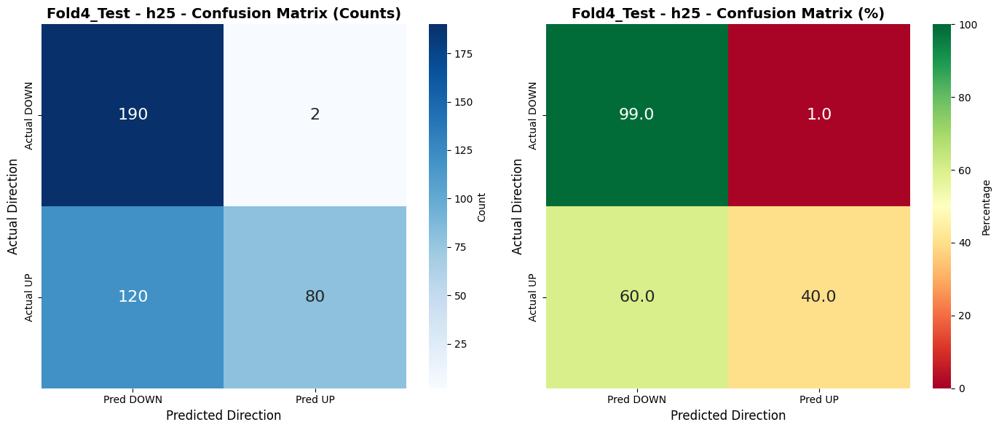


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Test - h25

              precision    recall  f1-score   support

        DOWN      0.613     0.990     0.757       192
          UP      0.976     0.400     0.567       200

    accuracy                          0.689       392
   macro avg      0.794     0.695     0.662       392
weighted avg      0.798     0.689     0.660       392

Directional Accuracy: 68.88%



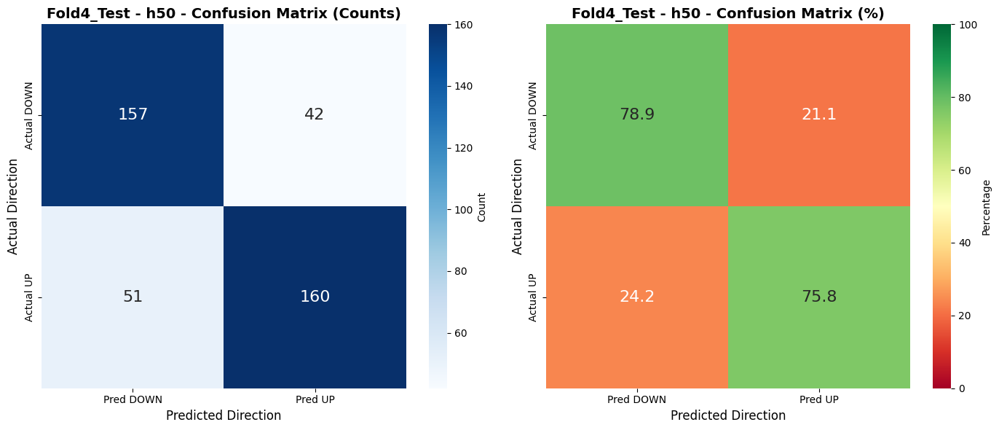


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Test - h50

              precision    recall  f1-score   support

        DOWN      0.755     0.789     0.771       199
          UP      0.792     0.758     0.775       211

    accuracy                          0.773       410
   macro avg      0.773     0.774     0.773       410
weighted avg      0.774     0.773     0.773       410

Directional Accuracy: 77.32%


FOLD 5

📊 Plotting Fold 5 train+test comparison...


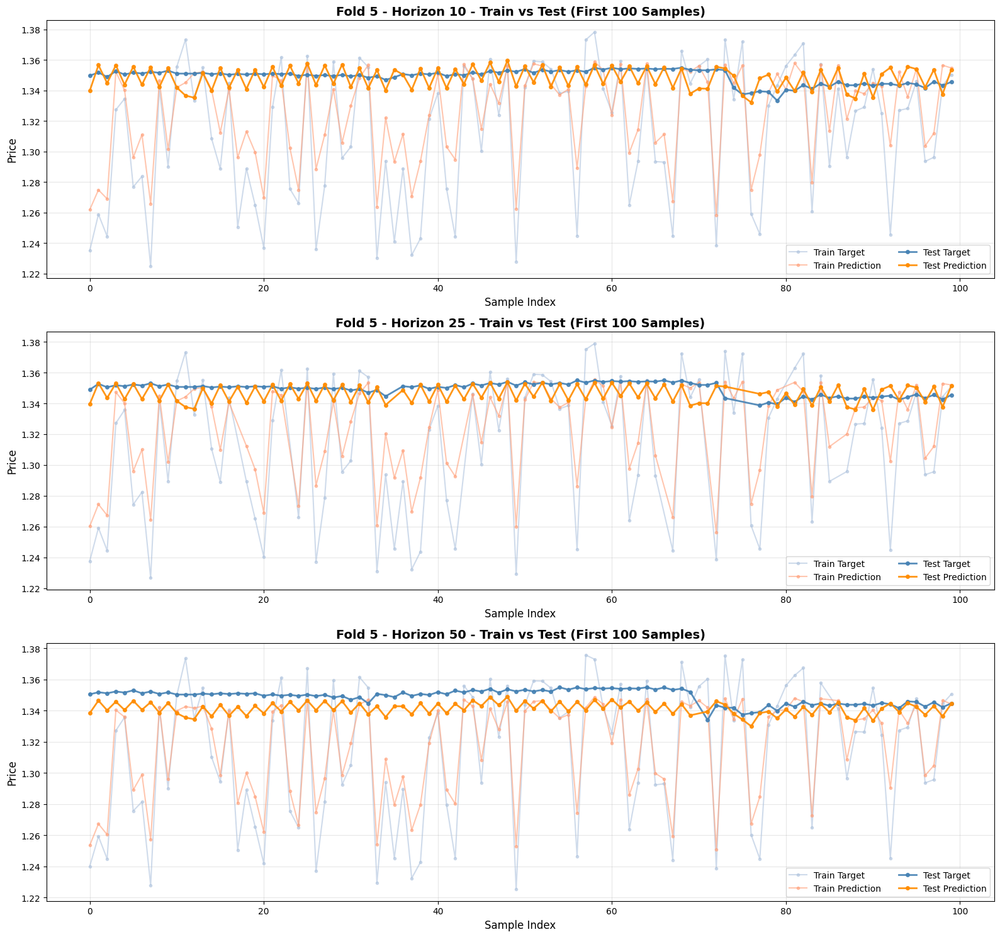

✅ Saved: walkforward_plots/Fold5_train_test_comparison.png

📈 Generating Fold 5 confusion matrices...


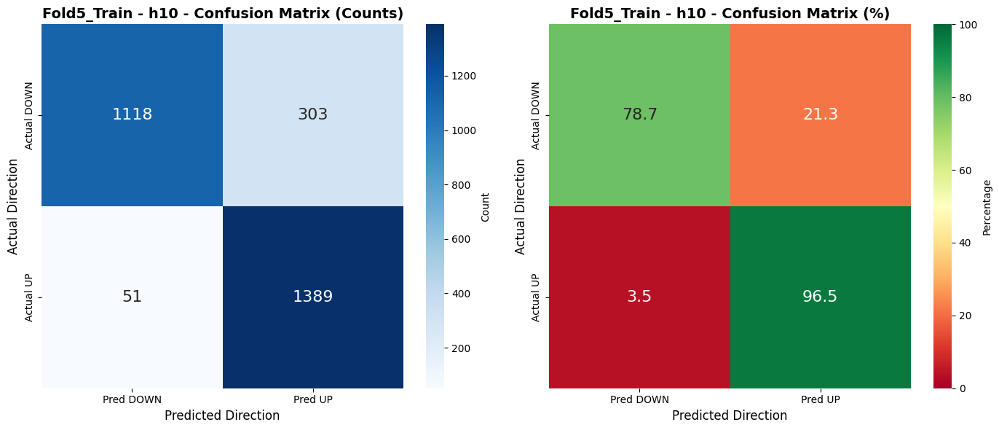


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train - h10

              precision    recall  f1-score   support

        DOWN      0.956     0.787     0.863      1421
          UP      0.821     0.965     0.887      1440

    accuracy                          0.876      2861
   macro avg      0.889     0.876     0.875      2861
weighted avg      0.888     0.876     0.875      2861

Directional Accuracy: 87.63%



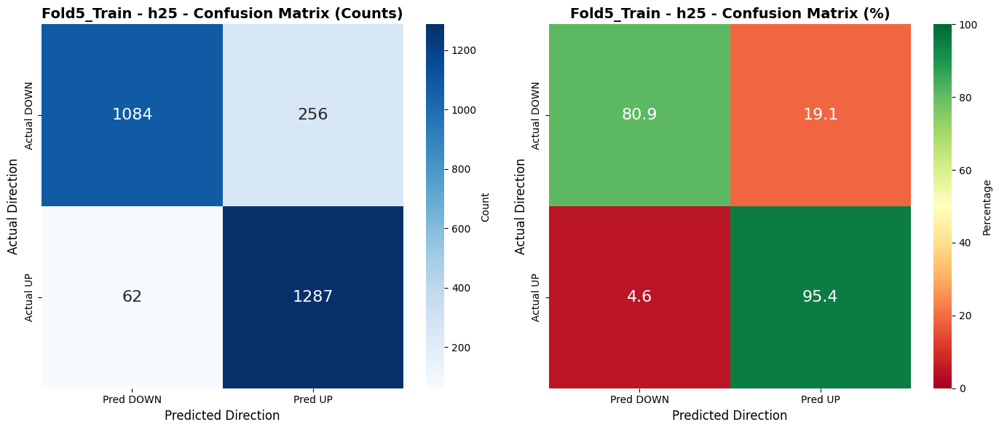


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train - h25

              precision    recall  f1-score   support

        DOWN      0.946     0.809     0.872      1340
          UP      0.834     0.954     0.890      1349

    accuracy                          0.882      2689
   macro avg      0.890     0.881     0.881      2689
weighted avg      0.890     0.882     0.881      2689

Directional Accuracy: 88.17%



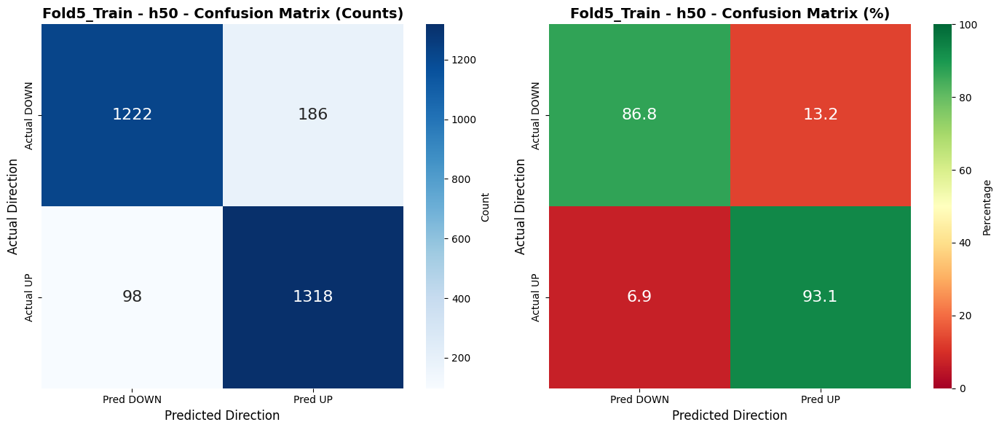


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train - h50

              precision    recall  f1-score   support

        DOWN      0.926     0.868     0.896      1408
          UP      0.876     0.931     0.903      1416

    accuracy                          0.899      2824
   macro avg      0.901     0.899     0.899      2824
weighted avg      0.901     0.899     0.899      2824

Directional Accuracy: 89.94%



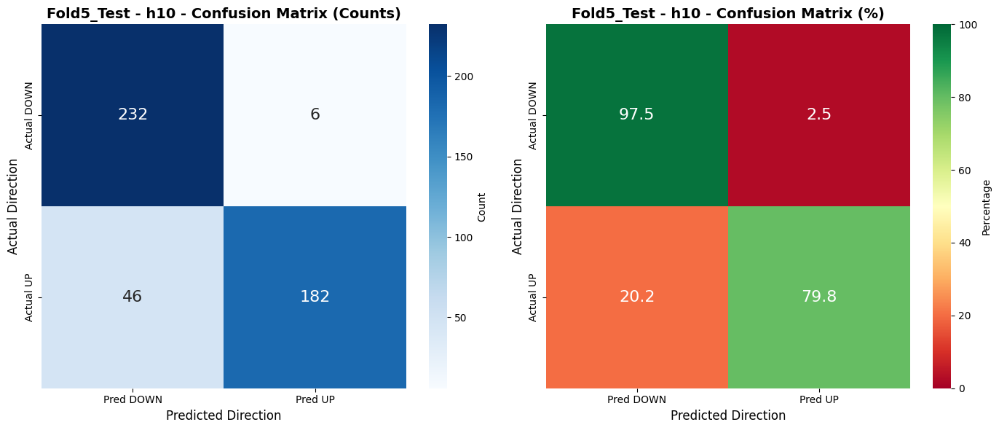


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test - h10

              precision    recall  f1-score   support

        DOWN      0.835     0.975     0.899       238
          UP      0.968     0.798     0.875       228

    accuracy                          0.888       466
   macro avg      0.901     0.887     0.887       466
weighted avg      0.900     0.888     0.887       466

Directional Accuracy: 88.84%



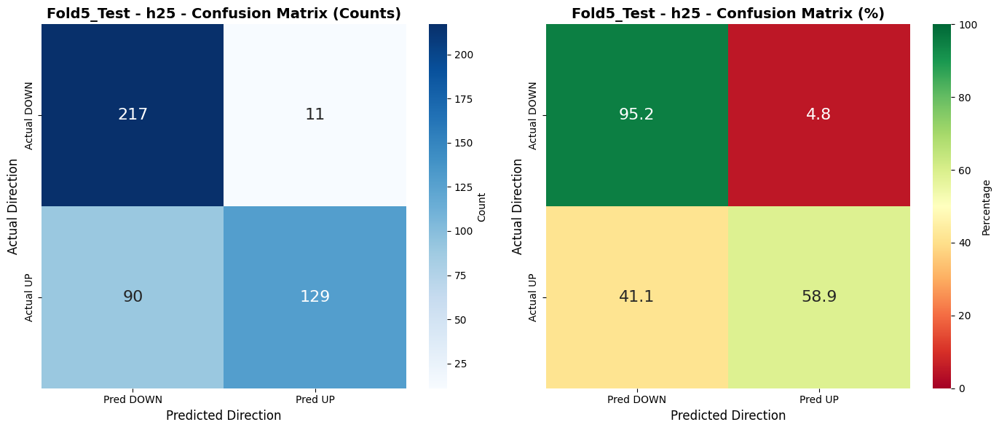


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test - h25

              precision    recall  f1-score   support

        DOWN      0.707     0.952     0.811       228
          UP      0.921     0.589     0.719       219

    accuracy                          0.774       447
   macro avg      0.814     0.770     0.765       447
weighted avg      0.812     0.774     0.766       447

Directional Accuracy: 77.40%



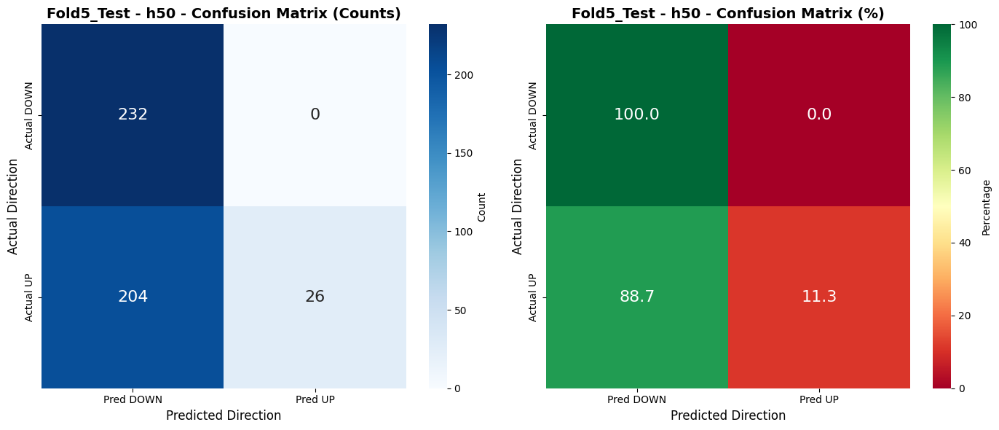


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test - h50

              precision    recall  f1-score   support

        DOWN      0.532     1.000     0.695       232
          UP      1.000     0.113     0.203       230

    accuracy                          0.558       462
   macro avg      0.766     0.557     0.449       462
weighted avg      0.765     0.558     0.450       462

Directional Accuracy: 55.84%


WALK-FORWARD ANALYSIS COMPLETE

💾 All plots saved to: walkforward_plots/

📊 Progression Analysis:
   - fold_progression_metrics.png  ← Metrics evolution across folds
   - fold_horizon_heatmap.png      ← Fold × Horizon heatmap
   - fold_stability_analysis.png   ← Distribution & variance
   - fold_progression_summary.csv  ← Statistical summary

📉 Overfitting Analysis:
   - overfitting_analysis.png      ← Train vs Test gaps
   - overfitting_data.csv          ← Raw gap data

📁 Per-Fold Results:
   - Fold*_train_test_comparison.png
   - Fold*_Train_h*_confusion.png
   - Fold*_Test_h*_c

In [30]:
analyze_walkforward_results(
        wf_results=wf_expanding,
        horizons=[10, 25, 50],
        plot_folds=True,
        confusion_matrices=True,
        plot_progression=True,      # NEW: Shows improvement per fold
        plot_overfitting=True,      # NEW: Shows train vs test gaps
        n_samples=100,
        save_path="walkforward_plots"
    )

# LSTM AND TRAnSFORMER

In [31]:
# -*- coding: utf-8 -*-
"""
BASELINE MODELS - SIMPLE LSTM & TRANSFORMER (v2.6 Compatible)
Walk-forward compatible wrappers with SAME 139 features as main model
"""

import torch
import torch.nn as nn
import math
from typing import Dict, List, Optional, Tuple
import numpy as np
import pandas as pd
import re


# =========================================================
# FEATURE FILTERING - EXACT MATCH TO MAIN MODEL
# =========================================================
def filter_features_for_baseline(df: pd.DataFrame) -> Tuple[pd.DataFrame, List[str], List[str]]:
    """
    EXACT SAME feature filtering as main model.
    Guaranteed to return the SAME 139 features.
    """
    print("\n" + "="*70)
    print("🔍 BASELINE FEATURE FILTERING (MATCHING MAIN MODEL - 139 FEATURES)")
    print("="*70)
    
    # ✅ EXACT SAME KEEP_FEATURES FROM MAIN MODEL
    KEEP_FEATURES = {
        # Price (7)
        "price": ["open", "high", "low", "close", "volume", "RSI", "FX_Day"],
        
        # Session (27)
        "session": [
            "Current_Session",
            "Asian_High", "Asian_Low", "Asian_Range", "Asian_Range_Pct", "Asian_Session",
            "London_High", "London_Low", "London_Range", "London_Range_Pct", "London_Session",
            "London_Broke_Asian_High", "London_Broke_Asian_Low",
            "NY_High", "NY_Low", "NY_Range", "NY_Range_Pct", "NY_Session",
            "NY_Broke_PreNY_High", "NY_Broke_PreNY_Low",
            "Pre_London_High", "Pre_London_Low", "Pre_NY_High", "Pre_NY_Low",
            "Position_In_Asian_Range", "Position_In_London_Range", "Position_In_NY_Range"
        ],
        
        # Minor (17 total)
        "minor_core": [
            "MinorSwingHigh", "MinorSwingLow",
            "Minor_SwingHighPrice", "Minor_SwingLowPrice",
            "Minor_ConfirmedLabel",
            "Minor_HighConfirmed", "Minor_LowConfirmed"
        ],
        "minor_timing": ["Minor_MinutesSinceHigh", "Minor_MinutesSinceLow"],
        "minor_distance": ["Minor_DistanceFromHigh", "Minor_DistanceFromLow"],
        "minor_momentum": ["Minor_Momentum_PerMinute_High", "Minor_Momentum_PerMinute_Low"],
        "minor_overshoot": ["Minor_Overshoot_High", "Minor_Overshoot_Low"],
        "minor_flash": ["Minor_IsFlashEvent_High", "Minor_IsFlashEvent_Low"],
        
        # MinMaj (30 total)
        "minmaj_core": [
            "MinMajSwingHigh", "MinMajSwingLow",
            "MinMaj_SwingHighPrice", "MinMaj_SwingLowPrice",
            "MinMaj_ConfirmedLabel",
            "MinMaj_HighConfirmed", "MinMaj_LowConfirmed",
            "MinMaj_StructureBias", "MinMaj_UpperLabel", "MinMaj_LowerLabel"
        ],
        "minmaj_timing": ["MinMaj_MinutesSinceHigh", "MinMaj_MinutesSinceLow"],
        "minmaj_distance": ["MinMaj_DistanceFromHigh", "MinMaj_DistanceFromLow"],
        "minmaj_momentum": ["MinMaj_Momentum_PerMinute_High", "MinMaj_Momentum_PerMinute_Low"],
        "minmaj_overshoot": ["MinMaj_Overshoot_High", "MinMaj_Overshoot_Low"],
        "minmaj_flash": ["MinMaj_IsFlashEvent_High", "MinMaj_IsFlashEvent_Low"],
        "minmaj_bos": ["MinMaj_Total_BOS_Events"],
        "minmaj_patterns": [
            "MinMaj_Any_Bullish_Pattern", "MinMaj_Any_Bearish_Pattern",
            "MinMaj_Active_Pattern_Names",
            "MinMaj_Bullish_Reversal_Active", "MinMaj_Bearish_Reversal_Active",
            "MinMaj_Bullish_Continuation_Active", "MinMaj_Bearish_Continuation_Active",
            "MinMaj_Bull_Trap_Active", "MinMaj_Bear_Trap_Active"
        ],
        
        # Major (27 total)
        "major_core": [
            "MajorSwingHigh", "MajorSwingLow",
            "Major_SwingHighPrice", "Major_SwingLowPrice",
            "Major_ConfirmedLabel",
            "Major_HighConfirmed", "Major_LowConfirmed"
        ],
        "major_timing": ["Major_MinutesSinceHigh", "Major_MinutesSinceLow"],
        "major_distance": ["Major_DistanceFromHigh", "Major_DistanceFromLow"],
        "major_momentum": ["Major_Momentum_PerMinute_High", "Major_Momentum_PerMinute_Low"],
        "major_overshoot": ["Major_Overshoot_High", "Major_Overshoot_Low"],
        "major_flash": ["Major_IsFlashEvent_High", "Major_IsFlashEvent_Low"],
        "major_bos": ["Major_Total_BOS_Events"],
        "major_patterns": [
            "Major_Any_Bullish_Pattern", "Major_Any_Bearish_Pattern",
            "Major_Active_Pattern_Names",
            "Major_Bullish_Reversal_Active", "Major_Bearish_Reversal_Active",
            "Major_Bullish_Continuation_Active", "Major_Bearish_Continuation_Active",
            "Major_Bull_Trap_Active", "Major_Bear_Trap_Active"
        ],
        
        # Daily (16 total) - Added the missing feature
        "daily_base": [
            "Daily_High", "Daily_Low", "Daily_Close", "Daily_Open",
            "Daily_Range", "Daily_Range_Pct", "Daily_Position_In_Range",
            "Daily_RSI",
            "Daily_Prev_High", "Daily_Prev_Low", "Daily_Prev_Close", "Daily_Prev_Open"
        ],
        "daily_minor": ["Daily_Minor_Total_BOS_Events"],  # ✅ This is the missing +1
        "daily_minmaj": ["Daily_MinMaj_StructureBias", "Daily_MinMaj_Total_BOS_Events"],
        "daily_major": ["Daily_Major_Total_BOS_Events"],
        
        # Hourly (15 total) - Added the missing feature
        "hourly_base": [
            "Hourly_High", "Hourly_Low", "Hourly_Close", "Hourly_Open",
            "Hourly_Range", "Hourly_Range_Pct", "Hourly_Position_In_Range",
            "Hourly_RSI",
            "Hourly_Prev_High", "Hourly_Prev_Low", "Hourly_Prev_Close",
            "Hourly_Prev_Open"  # ✅ This is the missing +1
        ],
        "hourly_minmaj": ["Hourly_MinMaj_StructureBias", "Hourly_MinMaj_Total_BOS_Events"],
        "hourly_major": ["Hourly_Major_Total_BOS_Events"],
    }
    
    # ✅ EXACT SAME REMOVE_PATTERNS FROM MAIN MODEL
    REMOVE_PATTERNS = [
        r".*_BarsSince.*", r".*_HoursSince.*", r".*_BarsPerHour.*",
        r".*_Momentum_PerBar.*", r".*_Momentum_PerHour.*", r".*_Momentum_Adjusted.*",
        r".*_BIASED$", r".*_SwingLabel_BIASED$", r".*_SwingPrice_BIASED$", r".*_IsSwingPoint_BIASED$",
        r".*_Awaiting_BOS$", r".*_BOS_Confirmed$", r".*_BOS_Target$", r".*_Swings$",
        r".*_CHoCH_Continuation.*", r".*_Complex_Reversal.*", r".*_Failed_Reversal.*",
        r".*_Liquidity_Sweep.*", r".*_Structure_Break.*",
        r".*_VolumeAtExtreme.*", r".*_VolumeAtConfirmation.*", r".*_TotalVolumeDuringSwing.*",
        r".*_AvgVolumePerBar.*", r".*_ImpulseFaster.*", r".*_HasWeekendGap.*",
        r".*_PrevSwingDistance.*", r".*_PrevSwingMomentum.*", r".*_PrevSwingOvershot.*",
        r"^Daily_Minor_(?!Total_BOS_Events$).*",  # ✅ Allow Daily_Minor_Total_BOS_Events
        r"^Daily_MinMaj_(?!StructureBias$|Total_BOS_Events$).*",
        r"^Daily_Major_(?!Total_BOS_Events$).*",
        r"^Hourly_Daily_.*",
        r"^Hourly_Minor_(?!Total_BOS_Events$).*",
        r"^Hourly_MinMaj_(?!StructureBias$|Total_BOS_Events$).*",
        r"^Hourly_Major_(?!Total_BOS_Events$).*",
    ]
    
    # Flatten KEEP_FEATURES
    keep_list = []
    for category, features in KEEP_FEATURES.items():
        keep_list.extend(features)
    
    all_cols = df.columns.tolist()
    kept_features = [col for col in keep_list if col in all_cols]
    
    # Check removal patterns
    def should_remove(col: str) -> bool:
        for pattern in REMOVE_PATTERNS:
            if re.match(pattern, col):
                return True
        return False
    
    final_kept = [col for col in kept_features if not should_remove(col)]
    removed_features = [col for col in all_cols if col not in final_kept]
    df_filtered = df[final_kept].copy()
    
    # Report
    print(f"\n📊 Feature Reduction Summary:")
    print(f"   Original features: {len(all_cols):,}")
    print(f"   Kept features:     {len(final_kept):,}")
    print(f"   Removed features:  {len(removed_features):,}")
    print(f"   Reduction:         {len(removed_features)/len(all_cols)*100:.1f}%")
    
    print(f"\n📋 Baseline Features by Category:")
    
    # Count actual features in final_kept
    session_features = [f for f in final_kept if f in KEEP_FEATURES['session']]
    price_features = [f for f in final_kept if f in KEEP_FEATURES['price']]
    minor_features = [f for f in final_kept if f.startswith('Minor')]
    minmaj_features = [f for f in final_kept if f.startswith('MinMaj')]
    major_features = [f for f in final_kept if f.startswith('Major')]
    daily_features = [f for f in final_kept if f.startswith('Daily_')]
    hourly_features = [f for f in final_kept if f.startswith('Hourly_')]
    
    categories_actual = {
        'price': len(price_features),
        'session': len(session_features),
        'minor': len(minor_features),
        'minmaj': len(minmaj_features),
        'major': len(major_features),
        'daily': len(daily_features),
        'hourly': len(hourly_features)
    }
    
    categories_expected = {
        'price': 7, 'session': 27, 'minor': 17, 'minmaj': 30, 'major': 27, 'daily': 16, 'hourly': 15
    }
    
    for cat, expected in categories_expected.items():
        actual = categories_actual[cat]
        status = "✅" if actual == expected else "⚠️"
        print(f"   {status} {cat:10s}: {actual:3d} features (expected {expected})")
    
    # Final check
    if len(final_kept) == 139:
        print(f"\n✅ PERFECT MATCH: {len(final_kept)} features (same as main model)")
    else:
        diff = 139 - len(final_kept)
        print(f"\n⚠️  Mismatch: {len(final_kept)} features (expected 139, diff: {diff:+d})")
    
    print("="*70 + "\n")
    
    return df_filtered, final_kept, removed_features


def build_feature_groups_baseline(columns):
    """Single group for baseline models (no multi-stream)"""
    group_index_map = {"all_features": list(range(len(columns)))}
    unassigned = []
    print(f"🔧 Baseline: {len(columns)} features in flat architecture")
    return group_index_map, unassigned


# =========================================================
# SIMPLE LSTM - Multi-Horizon Wrapper
# =========================================================
class SimpleLSTMMultiHorizon(nn.Module):
    """
    Multi-horizon Simple LSTM baseline.
    Compatible with walk-forward validation and directional loss.
    """
    def __init__(self, 
                 group_index_map: Dict[str, List[int]],
                 horizons: List[int] = [10, 25, 50],
                 sub_hidden: int = 128,
                 hidden_dim: int = None,
                 num_layers: int = 2,
                 dropout: float = 0.2,
                 pred_scale_init: float = 0.9,
                 **kwargs):
        super().__init__()
        
        if hidden_dim is None:
            hidden_dim = sub_hidden
        
        # Get total input dimension
        if "all_features" in group_index_map:
            total_features = len(group_index_map["all_features"])
        else:
            total_features = sum(len(idxs) for idxs in group_index_map.values() 
                               if len(idxs) > 0)
        
        if total_features == 0:
            raise ValueError("No features found in group_index_map!")
        
        print(f"\n🏗️  Building Simple LSTM Multi-Horizon...")
        print(f"   Input features: {total_features}")
        print(f"   Hidden dimension: {hidden_dim}")
        print(f"   Number of layers: {num_layers}")
        print(f"   Dropout: {dropout}")
        print(f"   Horizons: {horizons}")
        
        self.horizons = horizons
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        
        # Shared LSTM backbone
        self.lstm = nn.LSTM(
            input_size=total_features,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            dropout=dropout if num_layers > 1 else 0.0
        )
        
        self.norm = nn.LayerNorm(hidden_dim)
        self.dropout = nn.Dropout(dropout)
        
        # Separate output head for each horizon
        self.horizon_heads = nn.ModuleDict({
            f"h{h}": nn.Linear(hidden_dim, 1) 
            for h in horizons
        })
        
        # Learnable prediction scales
        self.pred_scales = nn.Parameter(torch.ones(len(horizons)) * pred_scale_init)
        
        total_params = sum(p.numel() for p in self.parameters())
        print(f"   ✅ Total parameters: {total_params:,}")
    
    def forward(self, X: torch.Tensor) -> Dict[str, torch.Tensor]:
        """
        X: [batch_size, seq_len, input_dim]
        Returns: Dict[horizon_key, predictions]
        """
        lstm_out, _ = self.lstm(X)
        last_output = lstm_out[:, -1, :]
        normalized = self.norm(last_output)
        dropped = self.dropout(normalized)
        
        outputs = {}
        for idx, h in enumerate(self.horizons):
            h_key = f"h{h}"
            raw_pred = self.horizon_heads[h_key](dropped).squeeze(-1)
            outputs[h_key] = raw_pred * self.pred_scales[idx]
        
        return outputs


# =========================================================
# TRANSFORMER - Multi-Horizon Wrapper
# =========================================================
class PositionalEncoding(nn.Module):
    """Positional encoding for transformer"""
    def __init__(self, d_model: int, max_len: int = 5000, dropout: float = 0.1):
        super().__init__()
        self.dropout = nn.Dropout(p=dropout)
        
        position = torch.arange(max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe = torch.zeros(max_len, 1, d_model)
        pe[:, 0, 0::2] = torch.sin(position * div_term)
        pe[:, 0, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe)
    
    def forward(self, x):
        x = x.transpose(0, 1)
        x = x + self.pe[:x.size(0)]
        x = x.transpose(0, 1)
        return self.dropout(x)


class TransformerMultiHorizon(nn.Module):
    """
    Multi-horizon Transformer baseline.
    Compatible with walk-forward validation and directional loss.
    """
    def __init__(self,
                 group_index_map: Dict[str, List[int]],
                 horizons: List[int] = [10, 25, 50],
                 sub_hidden: int = 128,
                 d_model: int = None,
                 nhead: int = 8,
                 num_layers: int = 3,
                 dim_feedforward: int = None,
                 dropout: float = 0.2,
                 pred_scale_init: float = 0.9,
                 **kwargs):
        super().__init__()
        
        if d_model is None:
            d_model = sub_hidden
        
        if dim_feedforward is None:
            dim_feedforward = d_model * 4
        
        # Get total input dimension
        if "all_features" in group_index_map:
            total_features = len(group_index_map["all_features"])
        else:
            total_features = sum(len(idxs) for idxs in group_index_map.values() 
                               if len(idxs) > 0)
        
        if total_features == 0:
            raise ValueError("No features found in group_index_map!")
        
        # Auto-adjust d_model to be divisible by nhead
        if d_model % nhead != 0:
            d_model = (d_model // nhead) * nhead
            print(f"⚠️  Adjusted d_model to {d_model} (divisible by nhead={nhead})")
        
        print(f"\n🏗️  Building Transformer Multi-Horizon...")
        print(f"   Input features: {total_features}")
        print(f"   Model dimension: {d_model}")
        print(f"   Attention heads: {nhead}")
        print(f"   Encoder layers: {num_layers}")
        print(f"   Feedforward dim: {dim_feedforward}")
        print(f"   Dropout: {dropout}")
        print(f"   Horizons: {horizons}")
        
        self.horizons = horizons
        self.d_model = d_model
        
        # Shared transformer backbone
        self.input_projection = nn.Linear(total_features, d_model)
        self.pos_encoder = PositionalEncoding(d_model, dropout=dropout)
        
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=d_model,
            nhead=nhead,
            dim_feedforward=dim_feedforward,
            dropout=dropout,
            batch_first=True,
            norm_first=True
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        
        self.norm = nn.LayerNorm(d_model)
        self.dropout = nn.Dropout(dropout)
        
        # Separate output head for each horizon
        self.horizon_heads = nn.ModuleDict({
            f"h{h}": nn.Sequential(
                nn.Linear(d_model, d_model // 2),
                nn.ReLU(),
                nn.Dropout(dropout),
                nn.Linear(d_model // 2, 1)
            )
            for h in horizons
        })
        
        # Learnable prediction scales
        self.pred_scales = nn.Parameter(torch.ones(len(horizons)) * pred_scale_init)
        
        total_params = sum(p.numel() for p in self.parameters())
        print(f"   ✅ Total parameters: {total_params:,}")
    
    def forward(self, X: torch.Tensor) -> Dict[str, torch.Tensor]:
        """
        X: [batch_size, seq_len, input_dim]
        Returns: Dict[horizon_key, predictions]
        """
        x = self.input_projection(X)
        x = self.pos_encoder(x)
        x = self.transformer_encoder(x)
        x = x[:, -1, :]  # Take last token
        x = self.norm(x)
        x = self.dropout(x)
        
        outputs = {}
        for idx, h in enumerate(self.horizons):
            h_key = f"h{h}"
            raw_pred = self.horizon_heads[h_key](x).squeeze(-1)
            outputs[h_key] = raw_pred * self.pred_scales[idx]
        
        return outputs


# =========================================================
# WALK-FORWARD WRAPPER FUNCTIONS
# =========================================================
def walk_forward_simple_lstm(
    df_full: pd.DataFrame,
    swing_level: str = "MinMaj",
    horizons: List[int] = [10, 25, 50],
    train_days: int = 120,
    test_days: int = 30,
    step_days: int = 7,
    window_type: str = "expanding",
    epochs: int = 30,
    seq_len: int = 48,
    batch_size: int = 64,
    hidden_dim: int = 128,
    num_layers: int = 2,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    val_days: Optional[int] = None,
    embargo_bars: Optional[int] = None,
    max_folds: Optional[int] = None,
    device: str = "cuda" if torch.cuda.is_available() else "cpu"
):
    """
    Walk-forward validation with Simple LSTM baseline.
    Uses improved walk_forward_validation() with fold progression & overfitting analysis.
    
    Parameters:
    -----------
    df_full : pd.DataFrame
        Full dataset with all features
    swing_level : str
        "Minor", "MinMaj", or "Major"
    horizons : List[int]
        Target horizons [10, 25, 50]
    train_days : int
        Initial training window in days
    test_days : int
        Test window in days
    step_days : int
        Step size for rolling window
    window_type : str
        "expanding" or "sliding"
    epochs : int
        Training epochs per fold
    seq_len : int
        Sequence length
    batch_size : int
        Batch size
    hidden_dim : int
        LSTM hidden dimension
    num_layers : int
        Number of LSTM layers
    dropout : float
        Dropout rate
    l2_lambda : float
        L2 regularization
    pred_scale_init : float
        Initial prediction scale
    val_days : int, optional
        Validation days (default: 20% of train_days)
    embargo_bars : int, optional
        Embargo bars (default: seq_len + max(horizons))
    max_folds : Optional[int]
        Maximum folds (None = all)
    device : str
        'cuda' or 'cpu'
    
    Returns:
    --------
    Walk-forward results dictionary with fold progression analysis
    """
    
    print("\n" + "="*70)
    print("🚀 WALK-FORWARD VALIDATION - SIMPLE LSTM BASELINE")
    print("="*70)
    print(f"   Model: Simple {num_layers}-layer LSTM")
    print(f"   Hidden dim: {hidden_dim}")
    print(f"   Swing Level: {swing_level}")
    print(f"   Horizons: {horizons}")
    print(f"   Directional loss: alpha=0.5")
    print(f"   Train: {train_days}d | Test: {test_days}d | Step: {step_days}d")
    print(f"   Window: {window_type}")
    print("="*70 + "\n")
    
    # Filter features for baseline
    df_filtered, kept_features, removed_features = filter_features_for_baseline(df_full)
    
    print(f"📊 Features for baseline: {len(kept_features)}")
    
    # Check if required function exists
    if 'walk_forward_validation' not in globals():
        raise NameError(
            "walk_forward_validation() not found!\n"
            "Please run your main code first to load the function."
        )
    
    # Store originals
    _orig_model = globals().get('MultiHorizonLSTM')
    _orig_build = globals().get('build_feature_groups')
    
    # Temporarily replace
    globals()['MultiHorizonLSTM'] = SimpleLSTMMultiHorizon
    globals()['build_feature_groups'] = build_feature_groups_baseline
    
    try:
        # Call walk_forward_validation
        results = globals()['walk_forward_validation'](
            df_masked=df_filtered,
            swing_level=swing_level,
            horizons=horizons,
            train_days=train_days,
            test_days=test_days,
            step_days=step_days,
            window_type=window_type,
            epochs=epochs,
            seq_len=seq_len,
            batch_size=batch_size,
            dropout=dropout,
            l2_lambda=l2_lambda,
            pred_scale_init=pred_scale_init,
            val_days=val_days,
            embargo_bars=embargo_bars,
            max_folds=max_folds,
            device=device
        )
        
        # Add model info
        results['model_name'] = f'Simple LSTM ({num_layers}L-{hidden_dim}H)'
        results['model_type'] = 'simple_lstm'
        results['baseline_features'] = kept_features
        
    finally:
        # Restore originals
        if _orig_model is not None:
            globals()['MultiHorizonLSTM'] = _orig_model
        if _orig_build is not None:
            globals()['build_feature_groups'] = _orig_build
    
    print("\n✅ Simple LSTM walk-forward validation complete!")
    
    return results


def walk_forward_transformer(
    df_full: pd.DataFrame,
    swing_level: str = "MinMaj",
    horizons: List[int] = [10, 25, 50],
    train_days: int = 120,
    test_days: int = 30,
    step_days: int = 7,
    window_type: str = "expanding",
    epochs: int = 30,
    seq_len: int = 48,
    batch_size: int = 64,
    d_model: int = 128,
    nhead: int = 8,
    num_layers: int = 3,
    dim_feedforward: int = 512,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    val_days: Optional[int] = None,
    embargo_bars: Optional[int] = None,
    max_folds: Optional[int] = None,
    device: str = "cuda" if torch.cuda.is_available() else "cpu"
):
    """
    Walk-forward validation with Transformer baseline.
    Uses improved walk_forward_validation() with fold progression & overfitting analysis.
    
    Parameters:
    -----------
    df_full : pd.DataFrame
        Full dataset with all features
    swing_level : str
        "Minor", "MinMaj", or "Major"
    horizons : List[int]
        Target horizons [10, 25, 50]
    train_days : int
        Initial training window in days
    test_days : int
        Test window in days
    step_days : int
        Step size
    window_type : str
        "expanding" or "sliding"
    epochs : int
        Training epochs per fold
    seq_len : int
        Sequence length
    batch_size : int
        Batch size
    d_model : int
        Transformer model dimension
    nhead : int
        Number of attention heads
    num_layers : int
        Number of transformer layers
    dim_feedforward : int
        FFN dimension
    dropout : float
        Dropout rate
    l2_lambda : float
        L2 regularization
    pred_scale_init : float
        Initial prediction scale
    val_days : int, optional
        Validation days (default: 20% of train_days)
    embargo_bars : int, optional
        Embargo bars (default: seq_len + max(horizons))
    max_folds : Optional[int]
        Max folds (None = all)
    device : str
        'cuda' or 'cpu'
    
    Returns:
    --------
    Walk-forward results dictionary with fold progression analysis
    """
    
    print("\n" + "="*70)
    print("🚀 WALK-FORWARD VALIDATION - TRANSFORMER BASELINE")
    print("="*70)
    print(f"   Model: Transformer ({num_layers} layers, {nhead} heads)")
    print(f"   d_model: {d_model} | FFN: {dim_feedforward}")
    print(f"   Swing Level: {swing_level}")
    print(f"   Horizons: {horizons}")
    print(f"   Directional loss: alpha=0.5")
    print(f"   Train: {train_days}d | Test: {test_days}d | Step: {step_days}d")
    print(f"   Window: {window_type}")
    print("="*70 + "\n")
    
    # Filter features for baseline
    df_filtered, kept_features, removed_features = filter_features_for_baseline(df_full)
    
    print(f"📊 Features for baseline: {len(kept_features)}")
    
    # Auto-adjust d_model if needed
    if d_model % nhead != 0:
        d_model = (d_model // nhead) * nhead
        print(f"⚠️  Adjusted d_model to {d_model} (divisible by nhead={nhead})")
    
    # Check if required function exists
    if 'walk_forward_validation' not in globals():
        raise NameError(
            "walk_forward_validation() not found!\n"
            "Please run your main code first to load the function."
        )
    
    # Store originals
    _orig_model = globals().get('MultiHorizonLSTM')
    _orig_build = globals().get('build_feature_groups')
    
    # Temporarily replace
    globals()['MultiHorizonLSTM'] = TransformerMultiHorizon
    globals()['build_feature_groups'] = build_feature_groups_baseline
    
    try:
        # Call walk_forward_validation
        results = globals()['walk_forward_validation'](
            df_masked=df_filtered,
            swing_level=swing_level,
            horizons=horizons,
            train_days=train_days,
            test_days=test_days,
            step_days=step_days,
            window_type=window_type,
            epochs=epochs,
            seq_len=seq_len,
            batch_size=batch_size,
            dropout=dropout,
            l2_lambda=l2_lambda,
            pred_scale_init=pred_scale_init,
            val_days=val_days,
            embargo_bars=embargo_bars,
            max_folds=max_folds,
            device=device
        )
        
        # Add model info
        results['model_name'] = f'Transformer ({num_layers}L-{nhead}H)'
        results['model_type'] = 'transformer'
        results['baseline_features'] = kept_features
        
    finally:
        # Restore originals
        if _orig_model is not None:
            globals()['MultiHorizonLSTM'] = _orig_model
        if _orig_build is not None:
            globals()['build_feature_groups'] = _orig_build
    
    print("\n✅ Transformer walk-forward validation complete!")
    
    return results


# =========================================================
# COMPARISON & VISUALIZATION
# =========================================================
def compare_all_models(wf_lstm, wf_transformer, wf_multistream, 
                       save_path: str = "model_comparison"):
    """
    Comprehensive comparison of all models with fold progression.
    
    Parameters:
    -----------
    wf_lstm : dict
        Results from walk_forward_simple_lstm()
    wf_transformer : dict
        Results from walk_forward_transformer()
    wf_multistream : dict
        Results from Multi-Stream LSTM walk_forward_validation()
    save_path : str
        Base path for saving figures
    """
    import matplotlib.pyplot as plt
    import os
    
    os.makedirs(save_path, exist_ok=True)
    
    print("\n" + "="*80)
    print("COMPREHENSIVE MODEL COMPARISON")
    print("="*80)
    
    models = [
        ('Simple LSTM', wf_lstm),
        ('Transformer', wf_transformer),
        ('Multi-Stream LSTM', wf_multistream)
    ]
    
    # Print summary for each model
    for model_name, results in models:
        print(f"\n📊 {model_name.upper()}:")
        for _, row in results['summary'].iterrows():
            h = int(row['horizon'])
            print(f"   H{h}: DA={row['mean_DA']:.1f}±{row['std_DA']:.1f}% | "
                  f"MAE={row['mean_MAE']:.6f}±{row['std_MAE']:.6f} | "
                  f"MAPE={row['mean_MAPE']:.2f}%")
    
    # Average comparison
    print("\n" + "="*80)
    print("AVERAGE PERFORMANCE (ALL HORIZONS):")
    print("="*80)
    for model_name, results in models:
        avg_da = results['summary']['mean_DA'].mean()
        avg_mae = results['summary']['mean_MAE'].mean()
        print(f"{model_name:20s}: DA={avg_da:.1f}% | MAE={avg_mae:.6f}")
    
    # ========== PLOT 1: DA & MAE COMPARISON ==========
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    
    colors = {'Simple LSTM': 'steelblue', 
              'Transformer': 'darkorange', 
              'Multi-Stream LSTM': 'forestgreen'}
    
    for model_name, results in models:
        summary = results['summary']
        
        # DA plot
        axes[0].errorbar(summary['horizon'], summary['mean_DA'], 
                        yerr=summary['std_DA'],
                        marker='o', label=model_name, linewidth=2.5,
                        capsize=5, capthick=2, color=colors[model_name], 
                        markersize=8)
        
        # MAE plot
        axes[1].errorbar(summary['horizon'], summary['mean_MAE'],
                        yerr=summary['std_MAE'],
                        marker='s', label=model_name, linewidth=2.5,
                        capsize=5, capthick=2, color=colors[model_name],
                        markersize=8)
    
    axes[0].set_xlabel('Horizon (bars)', fontsize=13, fontweight='bold')
    axes[0].set_ylabel('Directional Accuracy (%)', fontsize=13, fontweight='bold')
    axes[0].set_title('Directional Accuracy Comparison', fontsize=15, fontweight='bold')
    axes[0].legend(fontsize=11, loc='best')
    axes[0].grid(True, alpha=0.3, linestyle='--')
    axes[0].set_xticks([10, 25, 50])
    
    axes[1].set_xlabel('Horizon (bars)', fontsize=13, fontweight='bold')
    axes[1].set_ylabel('Mean Absolute Error', fontsize=13, fontweight='bold')
    axes[1].set_title('MAE Comparison', fontsize=15, fontweight='bold')
    axes[1].legend(fontsize=11, loc='best')
    axes[1].grid(True, alpha=0.3, linestyle='--')
    axes[1].set_xticks([10, 25, 50])
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/da_mae_comparison.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # ========== PLOT 2: OVERFITTING ANALYSIS ==========
    if 'analyze_walkforward_results' in globals():
        print("\n📊 Generating overfitting analysis for each model...")
        
        for model_name, results in models:
            model_save = model_name.replace(' ', '_').lower()
            try:
                globals()['analyze_walkforward_results'](
                    wf_results=results,
                    horizons=results['summary']['horizon'].unique().tolist(),
                    plot_folds=False,
                    confusion_matrices=False,
                    plot_progression=True,
                    plot_overfitting=True,
                    save_path=f'{save_path}/{model_save}'
                )
            except Exception as e:
                print(f"⚠️  Could not generate analysis for {model_name}: {e}")
    
    # ========== SUMMARY TABLE ==========
    summary_data = []
    for model_name, results in models:
        for _, row in results['summary'].iterrows():
            summary_data.append({
                'Model': model_name,
                'Horizon': int(row['horizon']),
                'Folds': int(row['n_folds']),
                'DA_mean': row['mean_DA'],
                'DA_std': row['std_DA'],
                'MAE_mean': row['mean_MAE'],
                'MAE_std': row['std_MAE'],
                'MAPE_mean': row['mean_MAPE'],
                'MAPE_std': row['std_MAPE']
            })
    
    comparison_df = pd.DataFrame(summary_data)
    comparison_df.to_csv(f'{save_path}/model_comparison_summary.csv', index=False)
    
    print(f"\n💾 Comparison results saved to: {save_path}/")
    print(f"   - da_mae_comparison.png")
    print(f"   - model_comparison_summary.csv")
    print(f"   - {save_path}/simple_lstm/")
    print(f"   - {save_path}/transformer/")
    print(f"   - {save_path}/multi_stream_lstm/")
    
    return comparison_df


# =========================================================
# USAGE EXAMPLE
# =========================================================
if __name__ == "__main__":
    print("\n" + "="*80)
    print("BASELINE MODELS MODULE LOADED (v2.6 Compatible)")
    print("="*80)
    print("\n✨ New Features:")
    print("  • Automatic feature filtering for baselines")
    print("  • Fold progression analysis integration")
    print("  • Overfitting detection")
    print("  • Support for Minor/MinMaj/Major swing levels")
    print("  • Comprehensive model comparison")
    print("\n📚 Available Functions:")
    print("  1. walk_forward_simple_lstm()    - Simple LSTM baseline")
    print("  2. walk_forward_transformer()    - Transformer baseline")
    print("  3. compare_all_models()          - Compare all models")
    print("\n" + "="*80)
    print("\n📖 EXAMPLE USAGE:")
    print("="*80)
    print("""
# Load your full data
df = pd.read_csv('GBPUSD_15m_FULL_CONTEXT_MASKED.csv', 
                 index_col='time', parse_dates=True)

# 1. Run Simple LSTM baseline
wf_lstm = walk_forward_simple_lstm(
    df_full=df,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    hidden_dim=128,
    num_layers=2,
    dropout=0.2,
    max_folds=5
)

# 2. Run Transformer baseline
wf_transformer = walk_forward_transformer(
    df_full=df,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    d_model=128,
    nhead=8,
    num_layers=3,
    dropout=0.2,
    max_folds=5
)

# 3. Run Multi-Stream LSTM (your main model)
wf_multistream = walk_forward_validation(
    df_masked=df,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    max_folds=5
)

# 4. Comprehensive comparison with fold progression
comparison_df = compare_all_models(
    wf_lstm=wf_lstm,
    wf_transformer=wf_transformer,
    wf_multistream=wf_multistream,
    save_path="model_comparison"
)
    """)
    print("="*80)


BASELINE MODELS MODULE LOADED (v2.6 Compatible)

✨ New Features:
  • Automatic feature filtering for baselines
  • Fold progression analysis integration
  • Overfitting detection
  • Support for Minor/MinMaj/Major swing levels
  • Comprehensive model comparison

📚 Available Functions:
  1. walk_forward_simple_lstm()    - Simple LSTM baseline
  2. walk_forward_transformer()    - Transformer baseline
  3. compare_all_models()          - Compare all models


📖 EXAMPLE USAGE:

# Load your full data
df = pd.read_csv('GBPUSD_15m_FULL_CONTEXT_MASKED.csv', 
                 index_col='time', parse_dates=True)

# 1. Run Simple LSTM baseline
wf_lstm = walk_forward_simple_lstm(
    df_full=df,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    hidden_dim=128,
    num_layers=2,
    dropout=0.2,
    max_folds=5
)

# 2. Run Transformer baseline
wf_transformer = walk_forward_transformer(
    df_full=df,
    swing_level="MinM

In [ ]:
df_baseline, kept_baseline, removed_baseline = filter_features_for_baseline(df_maskeds)

print(f"\n🔍 Verification:")
print(f"   Main model:     139 features")
print(f"   Baseline model: {len(kept_baseline)} features")
print(f"   Match: {'✅ YES' if len(kept_baseline) == 139 else '❌ NO'}")

# Show breakdown comparison
print(f"\n📊 Breakdown Comparison:")
print(f"{'Category':<15} {'Main':<10} {'Baseline':<10} {'Match'}")
print("-" * 50)

main_breakdown = {
    'Daily': 16, 'Hourly': 15, 'Minor': 17, 'MinMaj': 30, 'Major': 27
}

for cat, main_count in main_breakdown.items():
    baseline_count = len([f for f in kept_baseline if f.startswith(cat)])
    match = "✅" if baseline_count == main_count else "❌"
    print(f"{cat:<15} {main_count:<10} {baseline_count:<10} {match}")


🔍 BASELINE FEATURE FILTERING (MATCHING MAIN MODEL - 139 FEATURES)

📊 Feature Reduction Summary:
   Original features: 2,227
   Kept features:     139
   Removed features:  2,088
   Reduction:         93.8%

📋 Baseline Features by Category:
   ✅ price     :   7 features (expected 7)
   ✅ session   :  27 features (expected 27)
   ✅ minor     :  17 features (expected 17)
   ✅ minmaj    :  30 features (expected 30)
   ✅ major     :  27 features (expected 27)
   ✅ daily     :  16 features (expected 16)
   ✅ hourly    :  15 features (expected 15)

✅ PERFECT MATCH: 139 features (same as main model)


🔍 Verification:
   Main model:     139 features
   Baseline model: 139 features
   Match: ✅ YES

📊 Breakdown Comparison:
Category        Main       Baseline   Match
--------------------------------------------------
Daily           16         16         ✅
Hourly          15         15         ✅
Minor           17         17         ✅
MinMaj          30         30         ✅
Major           27    

## LSTM

In [36]:
wf_lstm = walk_forward_simple_lstm(
    df_full=df_maskeds,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    hidden_dim=32,
    num_layers=1,
    dropout=0.2,
    max_folds=5,
    seq_len=64
)


🚀 WALK-FORWARD VALIDATION - SIMPLE LSTM BASELINE
   Model: Simple 1-layer LSTM
   Hidden dim: 32
   Swing Level: MinMaj
   Horizons: [10, 25, 50]
   Directional loss: alpha=0.5
   Train: 120d | Test: 30d | Step: 7d
   Window: expanding


🔍 BASELINE FEATURE FILTERING (MATCHING MAIN MODEL - 139 FEATURES)

📊 Feature Reduction Summary:
   Original features: 2,227
   Kept features:     139
   Removed features:  2,088
   Reduction:         93.8%

📋 Baseline Features by Category:
   ✅ price     :   7 features (expected 7)
   ✅ session   :  27 features (expected 27)
   ✅ minor     :  17 features (expected 17)
   ✅ minmaj    :  30 features (expected 30)
   ✅ major     :  27 features (expected 27)
   ✅ daily     :  16 features (expected 16)
   ✅ hourly    :  15 features (expected 15)

✅ PERFECT MATCH: 139 features (same as main model)

📊 Features for baseline: 139

WALK-FORWARD VALIDATION WITH FEATURE FILTERING

🔍 FEATURE FILTERING (INCLUDING MINOR)

📊 Feature Reduction Summary:
   Original fea

## TRANSFORMER

In [42]:
wf_transformer = walk_forward_transformer(
    df_full=df_maskeds,
    swing_level="MinMaj",
    horizons=[10, 25, 50],
    train_days=120,
    test_days=30,
    step_days=7,
    epochs=30,
    d_model=32,
    nhead=2,
    dim_feedforward=32,
    num_layers=1,
    dropout=0.2,
    max_folds=5,
    seq_len=64
)


🚀 WALK-FORWARD VALIDATION - TRANSFORMER BASELINE
   Model: Transformer (1 layers, 2 heads)
   d_model: 32 | FFN: 32
   Swing Level: MinMaj
   Horizons: [10, 25, 50]
   Directional loss: alpha=0.5
   Train: 120d | Test: 30d | Step: 7d
   Window: expanding


🔍 BASELINE FEATURE FILTERING (MATCHING MAIN MODEL - 139 FEATURES)

📊 Feature Reduction Summary:
   Original features: 2,227
   Kept features:     139
   Removed features:  2,088
   Reduction:         93.8%

📋 Baseline Features by Category:
   ✅ price     :   7 features (expected 7)
   ✅ session   :  27 features (expected 27)
   ✅ minor     :  17 features (expected 17)
   ✅ minmaj    :  30 features (expected 30)
   ✅ major     :  27 features (expected 27)
   ✅ daily     :  16 features (expected 16)
   ✅ hourly    :  15 features (expected 15)

✅ PERFECT MATCH: 139 features (same as main model)

📊 Features for baseline: 139

WALK-FORWARD VALIDATION WITH FEATURE FILTERING

🔍 FEATURE FILTERING (INCLUDING MINOR)

📊 Feature Reduction Summa

# Comparison Plot


COMPREHENSIVE MODEL COMPARISON

📊 SIMPLE LSTM:
   H10: DA=81.3±8.5% | MAE=0.014203±0.003145 | MAPE=1.05%
   H25: DA=79.9±8.6% | MAE=0.015551±0.002118 | MAPE=1.15%
   H50: DA=67.3±7.1% | MAE=0.022054±0.007060 | MAPE=1.62%

📊 TRANSFORMER:
   H10: DA=75.0±23.8% | MAE=0.033461±0.013983 | MAPE=2.46%
   H25: DA=71.4±16.6% | MAE=0.029423±0.008956 | MAPE=2.17%
   H50: DA=60.9±12.8% | MAE=0.036465±0.013776 | MAPE=2.69%

📊 MULTI-STREAM LSTM:
   H10: DA=84.5±5.8% | MAE=0.009086±0.004550 | MAPE=0.67%
   H25: DA=74.0±7.1% | MAE=0.010520±0.003585 | MAPE=0.78%
   H50: DA=67.2±11.9% | MAE=0.010441±0.003754 | MAPE=0.77%

AVERAGE PERFORMANCE (ALL HORIZONS):
Simple LSTM         : DA=76.2% | MAE=0.017269
Transformer         : DA=69.1% | MAE=0.033116
Multi-Stream LSTM   : DA=75.2% | MAE=0.010016


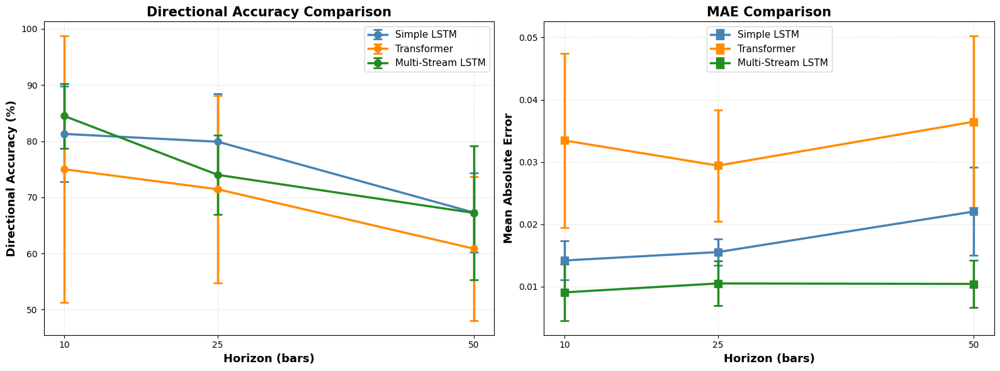


📊 Generating overfitting analysis for each model...

FOLD PROGRESSION ANALYSIS



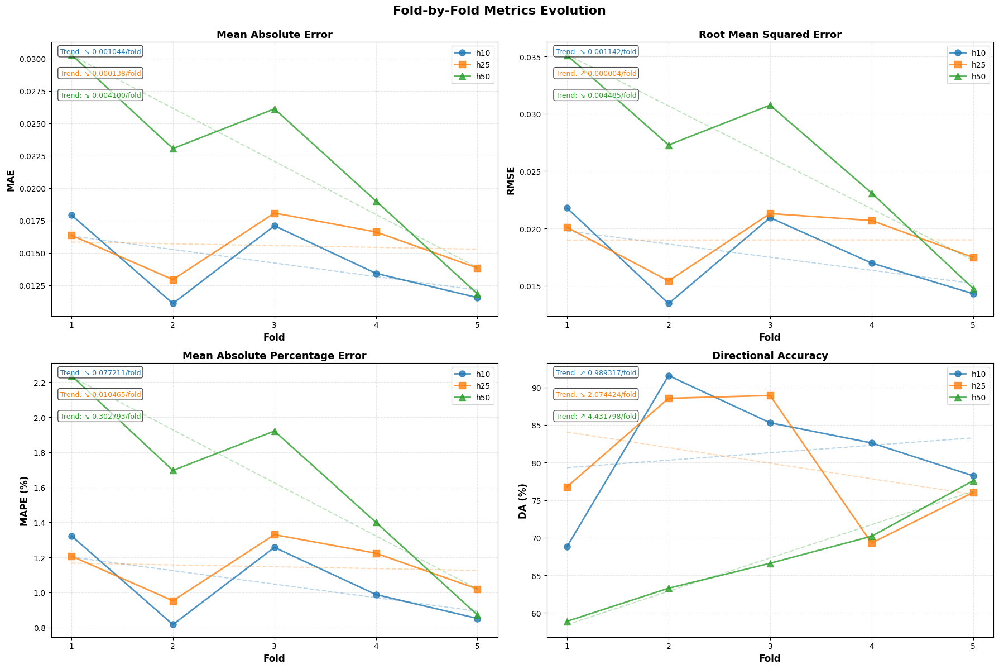

✅ Saved: model_comparison/simple_lstm/fold_progression_metrics.png


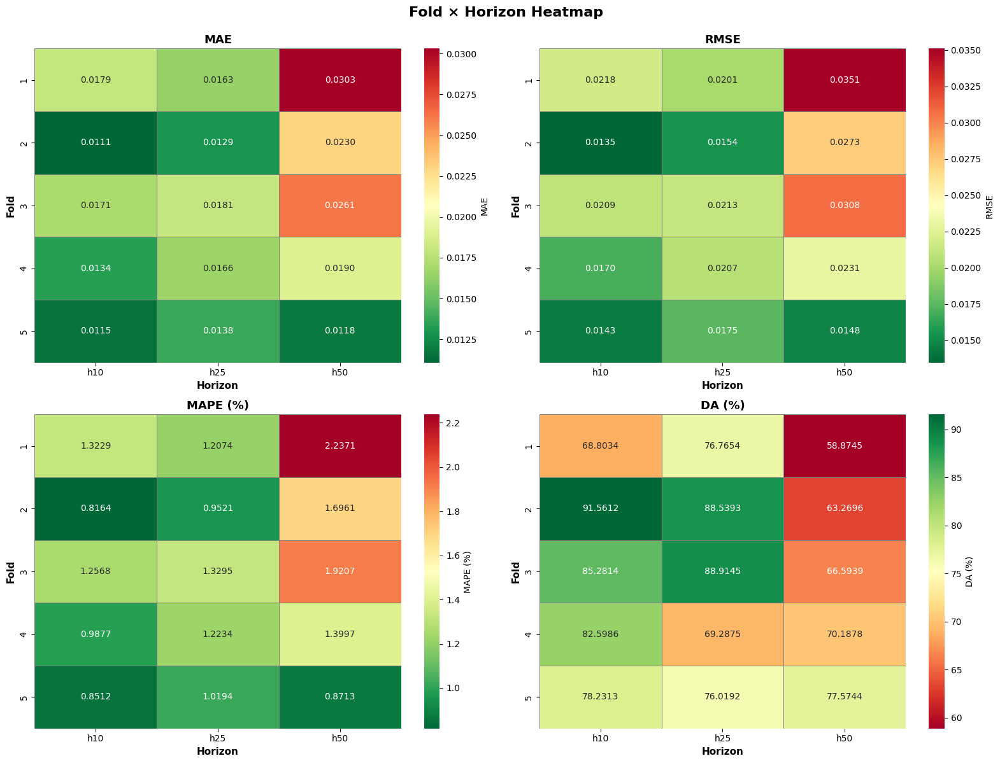

✅ Saved: model_comparison/simple_lstm/fold_horizon_heatmap.png


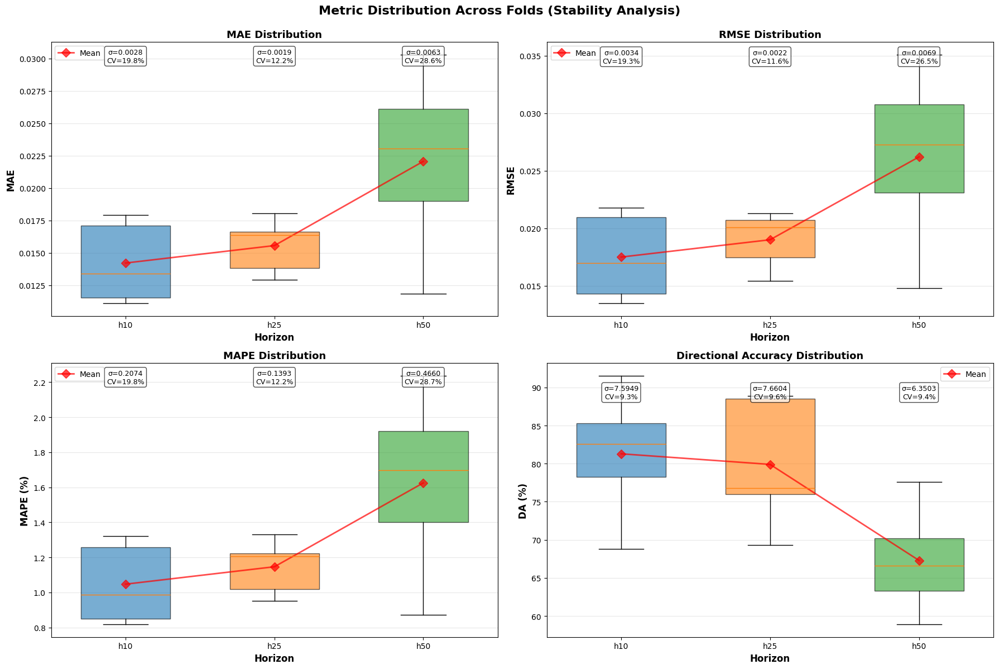

✅ Saved: model_comparison/simple_lstm/fold_stability_analysis.png

FOLD PROGRESSION STATISTICS

Horizon Metric First Fold Last Fold    Mean    Std CV (%)     Slope Change (%)        Trend
    h10    MAE     0.0179    0.0115  0.0142 0.0028  19.81 -0.001044     +35.61  ✅ Improving
    h10   RMSE     0.0218    0.0143  0.0175 0.0034  19.29 -0.001142     +34.31  ✅ Improving
    h10   MAPE     1.3229    0.8512  1.0470 0.2074  19.81 -0.077211     +35.66  ✅ Improving
    h10     DA    68.8034   78.2313 81.2952 7.5949   9.34  0.989317     +13.70  ✅ Improving
    h25    MAE     0.0163    0.0138  0.0156 0.0019  12.18 -0.000138     +15.46  ✅ Improving
    h25   RMSE     0.0201    0.0175  0.0190 0.0022  11.64  0.000004     +13.01 ⚠️ Degrading
    h25   MAPE     1.2074    1.0194  1.1464 0.1393  12.15 -0.010465     +15.57  ✅ Improving
    h25     DA    76.7654   76.0192 79.9052 7.6604   9.59 -2.074424      -0.97 ⚠️ Degrading
    h50    MAE     0.0303    0.0118  0.0221 0.0063  28.63 -0.004100     +60.

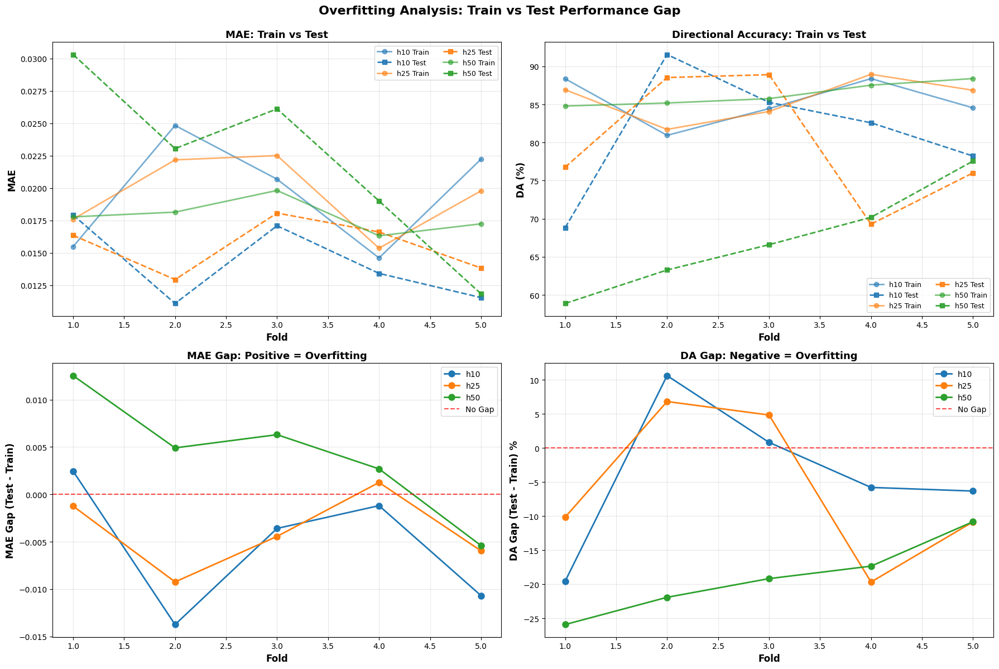

✅ Saved: model_comparison/simple_lstm/overfitting_analysis.png

OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS)

🎯 Horizon h10:
   MAE  Gap: -0.005354 (avg) | σ=0.006711
   RMSE Gap: -0.005875 (avg) | σ=0.008009
   DA   Gap: -4.06% (avg) | σ=11.05%
   ℹ️  MIXED SIGNALS

🎯 Horizon h25:
   MAE  Gap: -0.003925 (avg) | σ=0.004084
   RMSE Gap: -0.004651 (avg) | σ=0.005400
   DA   Gap: -5.81% (avg) | σ=11.28%
   ℹ️  MIXED SIGNALS

🎯 Horizon h50:
   MAE  Gap: +0.004205 (avg) | σ=0.006498
   RMSE Gap: +0.004524 (avg) | σ=0.007430
   DA   Gap: -19.04% (avg) | σ=5.61%
   ⚠️  OVERFITTING DETECTED

💾 Saved: model_comparison/simple_lstm/overfitting_data.csv


PER-FOLD PREDICTIONS & CONFUSION MATRICES


FOLD 1

FOLD 2

FOLD 3

FOLD 4

FOLD 5

WALK-FORWARD ANALYSIS COMPLETE

💾 All plots saved to: model_comparison/simple_lstm/

📊 Progression Analysis:
   - fold_progression_metrics.png  ← Metrics evolution across folds
   - fold_horizon_heatmap.png      ← Fold × Horizon heatmap
   - fold_stability_analysis.

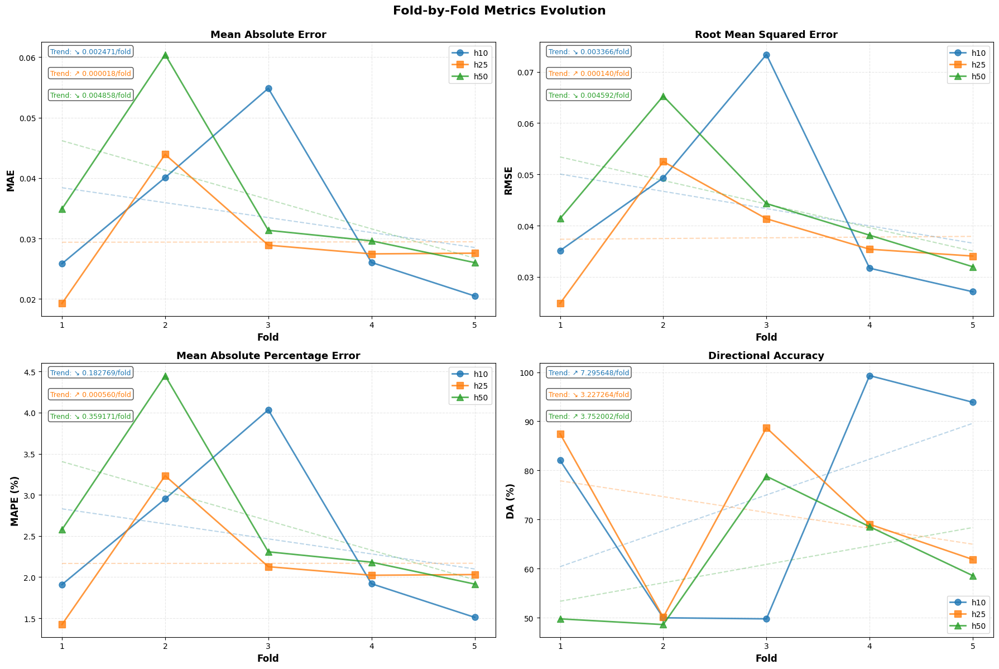

✅ Saved: model_comparison/transformer/fold_progression_metrics.png


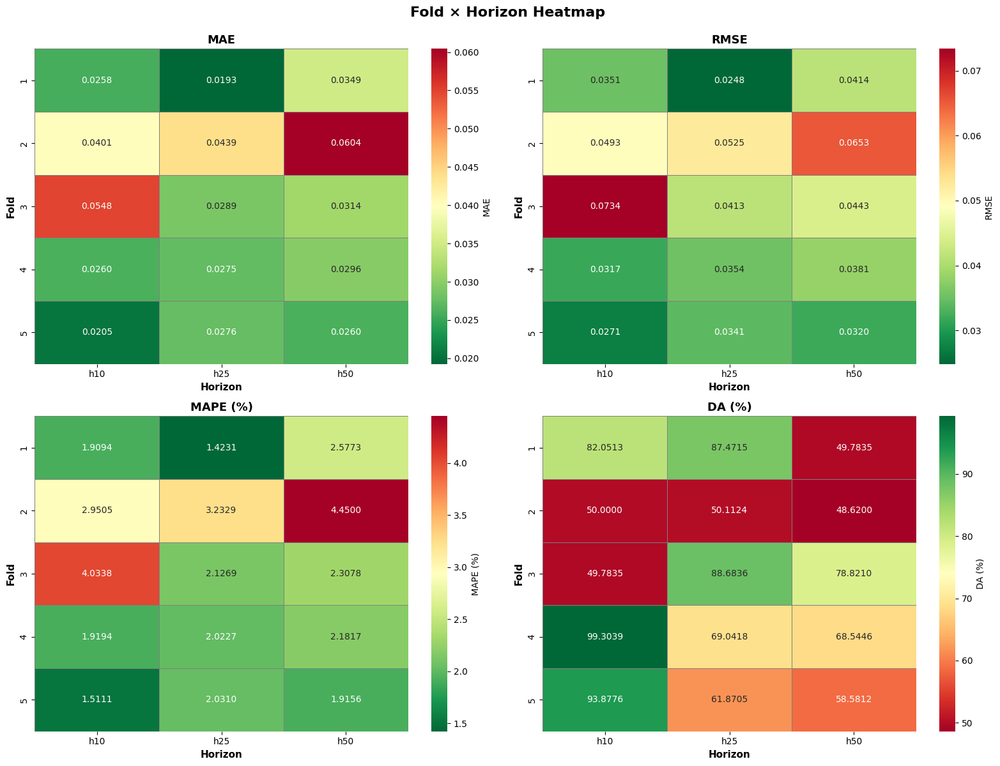

✅ Saved: model_comparison/transformer/fold_horizon_heatmap.png


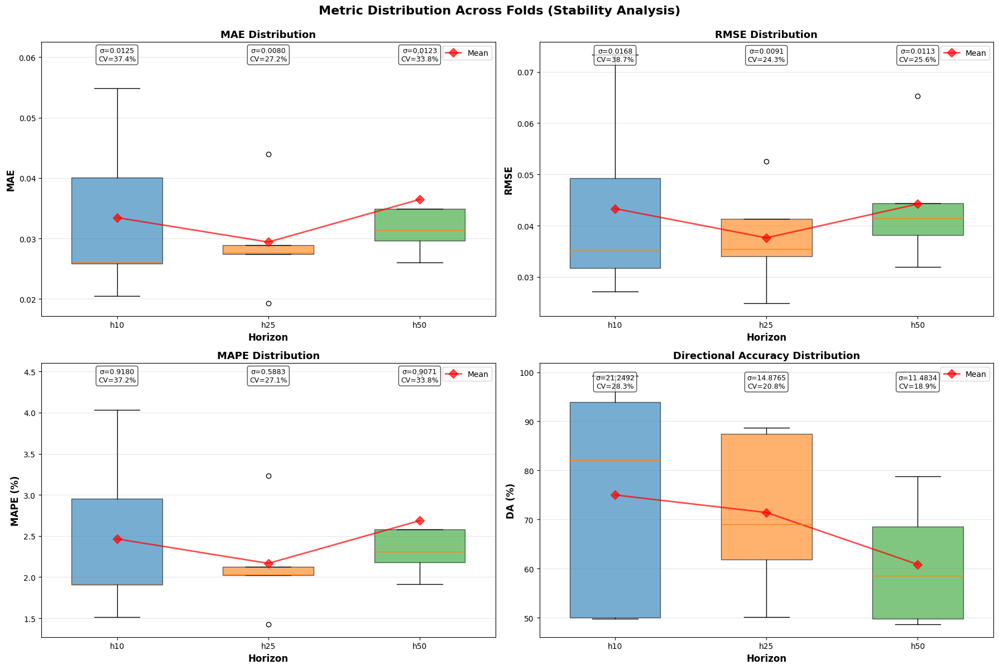

✅ Saved: model_comparison/transformer/fold_stability_analysis.png

FOLD PROGRESSION STATISTICS

Horizon Metric First Fold Last Fold    Mean     Std CV (%)     Slope Change (%)        Trend
    h10    MAE     0.0258    0.0205  0.0335  0.0125  37.38 -0.002471     +20.65  ✅ Improving
    h10   RMSE     0.0351    0.0271  0.0433  0.0168  38.68 -0.003366     +22.83  ✅ Improving
    h10   MAPE     1.9094    1.5111  2.4648  0.9180  37.24 -0.182769     +20.86  ✅ Improving
    h10     DA    82.0513   93.8776 75.0033 21.2492  28.33  7.295648     +14.41  ✅ Improving
    h25    MAE     0.0193    0.0276  0.0294  0.0080  27.22  0.000018     -43.19 ⚠️ Degrading
    h25   RMSE     0.0248    0.0341  0.0376  0.0091  24.26  0.000140     -37.25 ⚠️ Degrading
    h25   MAPE     1.4231    2.0310  2.1673  0.5883  27.14  0.000560     -42.72 ⚠️ Degrading
    h25     DA    87.4715   61.8705 71.4360 14.8765  20.82 -3.227264     -29.27 ⚠️ Degrading
    h50    MAE     0.0349    0.0260  0.0365  0.0123  33.79 -0.00485

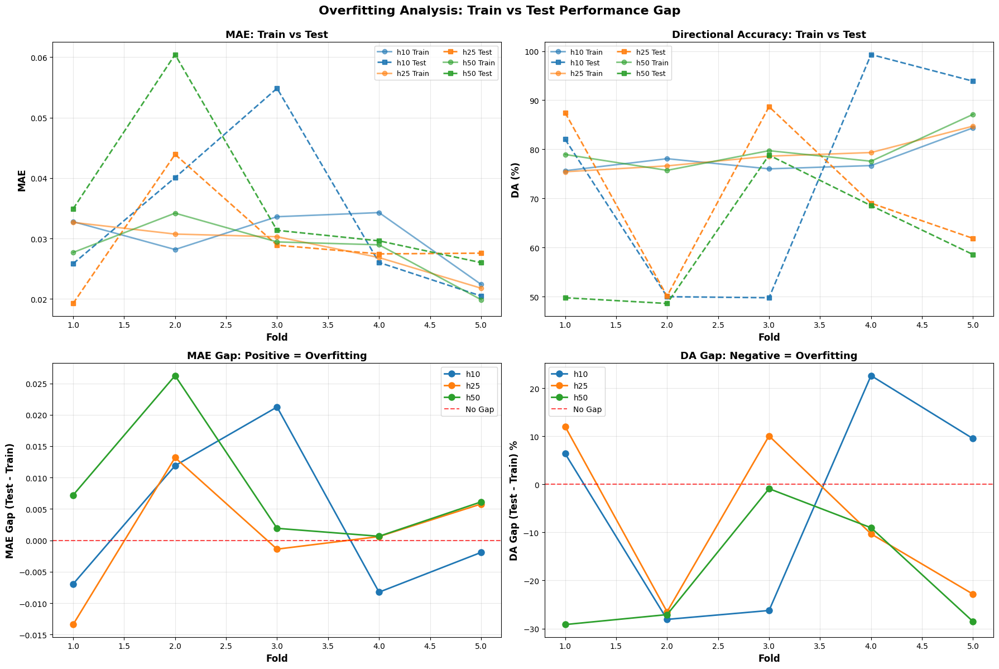

✅ Saved: model_comparison/transformer/overfitting_analysis.png

OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS)

🎯 Horizon h10:
   MAE  Gap: +0.003201 (avg) | σ=0.012858
   RMSE Gap: +0.005703 (avg) | σ=0.017235
   DA   Gap: -3.16% (avg) | σ=22.75%
   ⚠️  OVERFITTING DETECTED

🎯 Horizon h25:
   MAE  Gap: +0.000953 (avg) | σ=0.009806
   RMSE Gap: +0.004413 (avg) | σ=0.012452
   DA   Gap: -7.51% (avg) | σ=18.00%
   ⚠️  OVERFITTING DETECTED

🎯 Horizon h50:
   MAE  Gap: +0.008426 (avg) | σ=0.010330
   RMSE Gap: +0.011369 (avg) | σ=0.006996
   DA   Gap: -18.95% (avg) | σ=13.10%
   ⚠️  OVERFITTING DETECTED

💾 Saved: model_comparison/transformer/overfitting_data.csv


PER-FOLD PREDICTIONS & CONFUSION MATRICES


FOLD 1

FOLD 2

FOLD 3

FOLD 4

FOLD 5

WALK-FORWARD ANALYSIS COMPLETE

💾 All plots saved to: model_comparison/transformer/

📊 Progression Analysis:
   - fold_progression_metrics.png  ← Metrics evolution across folds
   - fold_horizon_heatmap.png      ← Fold × Horizon heatmap
   - fold_stab

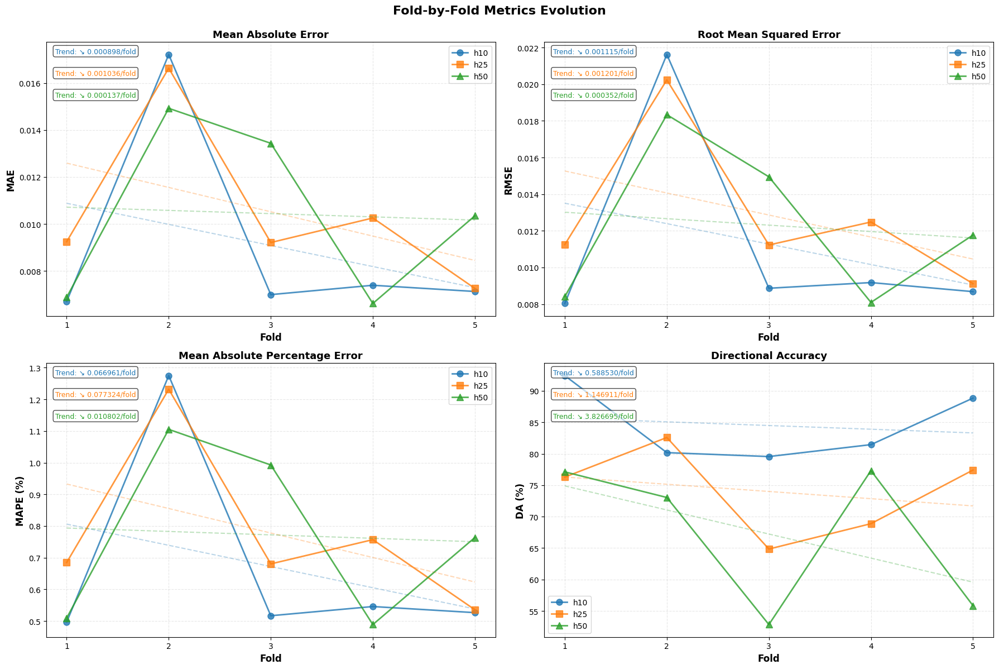

✅ Saved: model_comparison/multi-stream_lstm/fold_progression_metrics.png


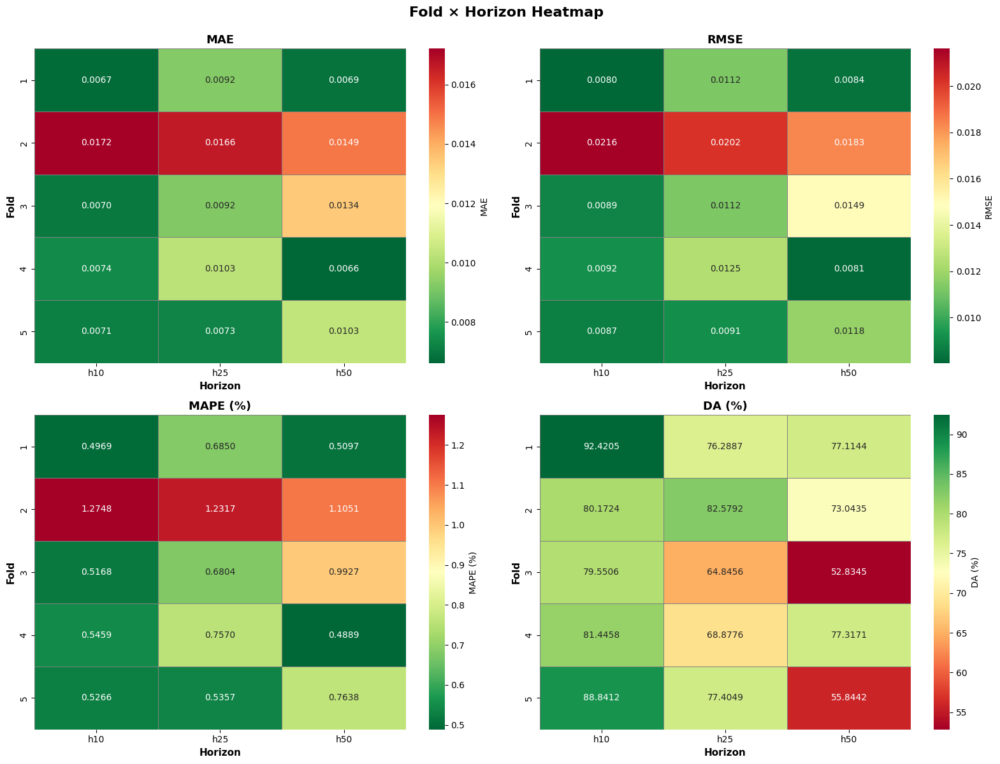

✅ Saved: model_comparison/multi-stream_lstm/fold_horizon_heatmap.png


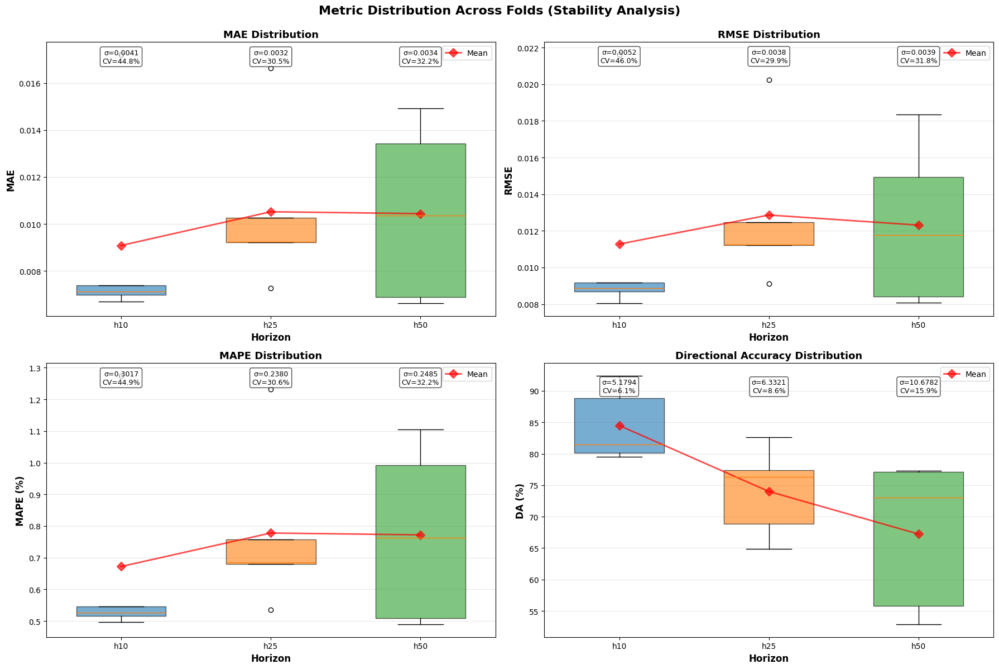

✅ Saved: model_comparison/multi-stream_lstm/fold_stability_analysis.png

FOLD PROGRESSION STATISTICS

Horizon Metric First Fold Last Fold    Mean     Std CV (%)     Slope Change (%)        Trend
    h10    MAE     0.0067    0.0071  0.0091  0.0041  44.79 -0.000898      -6.30  ✅ Improving
    h10   RMSE     0.0080    0.0087  0.0113  0.0052  45.99 -0.001115      -8.04  ✅ Improving
    h10   MAPE     0.4969    0.5266  0.6722  0.3017  44.88 -0.066961      -5.97  ✅ Improving
    h10     DA    92.4205   88.8412 84.4861  5.1794   6.13 -0.588530      -3.87 ⚠️ Degrading
    h25    MAE     0.0092    0.0073  0.0105  0.0032  30.48 -0.001036     +21.51  ✅ Improving
    h25   RMSE     0.0112    0.0091  0.0129  0.0038  29.86 -0.001201     +18.93  ✅ Improving
    h25   MAPE     0.6850    0.5357  0.7780  0.2380  30.59 -0.077324     +21.79  ✅ Improving
    h25     DA    76.2887   77.4049 73.9992  6.3321   8.56 -1.146911      +1.46 ⚠️ Degrading
    h50    MAE     0.0069    0.0103  0.0104  0.0034  32.16 -0

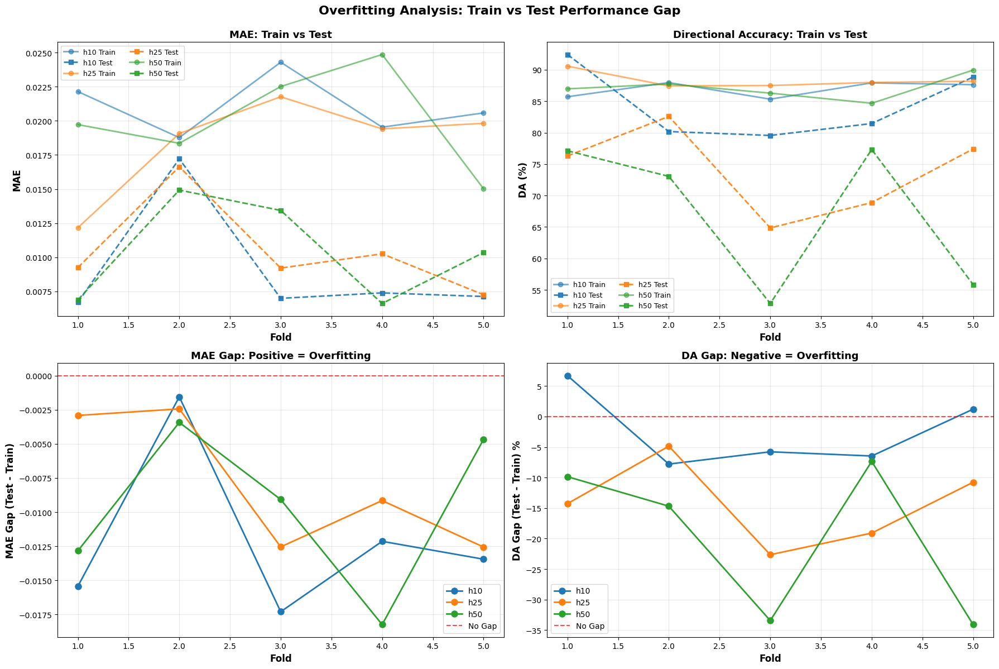

✅ Saved: model_comparison/multi-stream_lstm/overfitting_analysis.png

OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS)

🎯 Horizon h10:
   MAE  Gap: -0.011977 (avg) | σ=0.006146
   RMSE Gap: -0.014077 (avg) | σ=0.007489
   DA   Gap: -2.42% (avg) | σ=6.19%
   ℹ️  MIXED SIGNALS

🎯 Horizon h25:
   MAE  Gap: -0.007924 (avg) | σ=0.004989
   RMSE Gap: -0.009801 (avg) | σ=0.005833
   DA   Gap: -14.33% (avg) | σ=6.97%
   ℹ️  MIXED SIGNALS

🎯 Horizon h50:
   MAE  Gap: -0.009651 (avg) | σ=0.006079
   RMSE Gap: -0.011974 (avg) | σ=0.006559
   DA   Gap: -19.89% (avg) | σ=12.95%
   ℹ️  MIXED SIGNALS

💾 Saved: model_comparison/multi-stream_lstm/overfitting_data.csv


PER-FOLD PREDICTIONS & CONFUSION MATRICES


FOLD 1

FOLD 2

FOLD 3

FOLD 4

FOLD 5

WALK-FORWARD ANALYSIS COMPLETE

💾 All plots saved to: model_comparison/multi-stream_lstm/

📊 Progression Analysis:
   - fold_progression_metrics.png  ← Metrics evolution across folds
   - fold_horizon_heatmap.png      ← Fold × Horizon heatmap
   - fold_stabilit

In [ ]:
comparison_df = compare_all_models(
    wf_lstm=wf_lstm,
    wf_transformer=wf_transformer,
    wf_multistream=wf_expanding,
    save_path="model_comparison",
)

# HTF TARGET

In [ ]:
# -*- coding: utf-8 -*-
"""
MULTI-HORIZON MULTI-STREAM LSTM — v2.8 DAILY TARGETS (COMPLETE & FIXED)
========================================================================
✅ Alternating horizon training (cycle through h500 → h1000 → h2000)
✅ Directional loss with swing price baseline
✅ Current swing prices used in training
✅ Market structure enforcement (highs/lows MUST alternate)
✅ Proper sequence-target alignment
✅ Walk-forward validation with alternating
✅ Binary confusion matrix analysis
✅ Comprehensive metrics and visualization
"""

import os, re, random, pickle, warnings
warnings.filterwarnings("ignore")

from typing import Dict, List, Tuple, Optional
import numpy as np
import pandas as pd

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error, confusion_matrix, classification_report

import matplotlib.pyplot as plt
import seaborn as sns

# =========================================================
# REPRODUCIBILITY
# =========================================================
def set_seed(seed: int = 42):
    os.environ["PYTHONHASHSEED"] = str(seed)
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"✅ Seed set to {seed} (deterministic mode)")


# =========================================================
# DAILY TARGET GENERATION WITH MARKET STRUCTURE
# =========================================================
def add_daily_retracement_target_with_structure(
    df: pd.DataFrame,
    daily_level: str = "Major",
    lookforward_bars: int = 2000,
    use_swing_price: bool = True,
    daily_prefix: str = "Daily",
    include_breaks: bool = True
) -> pd.DataFrame:
    """
    Build Daily retracement targets respecting market structure.
    
    Market structure rules:
    - After Daily HH or LH (highs): next Daily swing MUST be HL or LL (lows)
    - After Daily HL or LL (lows): next Daily swing MUST be HH or LH (highs)
    
    Parameters:
    -----------
    df : pd.DataFrame
        15m data with Daily cascade columns
    daily_level : str
        "Major", "MinMaj", or "Minor" for Daily swings
    lookforward_bars : int
        Search horizon in 15m bars (~96 bars per day)
    use_swing_price : bool
        True: use Daily swing extreme prices
        False: use Daily_Close
    daily_prefix : str
        Prefix for Daily columns (usually "Daily")
    include_breaks : bool
        Include structure breaks (LL after HH, HH after LL)
    """
    
    print(f"\n🎯 Adding DAILY targets with MARKET STRUCTURE from {daily_prefix}_{daily_level}...")
    df = df.copy()
    
    # Column names
    label_col     = f"{daily_prefix}_{daily_level}_ConfirmedLabel"
    hi_flag_col   = f"{daily_prefix}_{daily_level}_HighConfirmed"
    lo_flag_col   = f"{daily_prefix}_{daily_level}_LowConfirmed"
    hi_price_col  = f"{daily_prefix}_{daily_level}_SwingHighPrice"
    lo_price_col  = f"{daily_prefix}_{daily_level}_SwingLowPrice"
    daily_close   = f"{daily_prefix}_Close"
    
    # Verify columns exist
    required = [label_col, hi_flag_col, lo_flag_col, hi_price_col, lo_price_col]
    missing = [c for c in required if c not in df.columns]
    if missing:
        raise ValueError(f"Missing required Daily columns: {missing}")
    
    N = len(df)
    labels = df[label_col].fillna("").astype(str)
    hi_flag = df[hi_flag_col].fillna(0).astype(int).to_numpy()
    lo_flag = df[lo_flag_col].fillna(0).astype(int).to_numpy()
    
    if use_swing_price:
        hi_price = df[hi_price_col].to_numpy(dtype=np.float64)
        lo_price = df[lo_price_col].to_numpy(dtype=np.float64)
    else:
        if daily_close not in df.columns:
            raise ValueError(f"Missing {daily_close} column")
        hi_price = df[daily_close].to_numpy(dtype=np.float64)
        lo_price = hi_price
    
    targets = np.full(N, np.nan, dtype=np.float64)
    distances = np.full(N, np.nan, dtype=np.float64)
    move_types = np.full(N, "", dtype=object)
    
    # ✅ FIXED: Leave space for lookforward window
    for i in range(N - lookforward_bars - 1):
        current_label = labels.iloc[i]
        
        # Skip if no confirmed Daily swing at this bar
        if current_label not in ["HH", "HL", "LH", "LL"]:
            continue
        
        # Look forward
        j_stop = min(i + 1 + lookforward_bars, N)
        
        # ============================================================
        # MARKET STRUCTURE LOGIC
        # ============================================================
        
        if current_label in ["HH", "LH"]:
            # After a HIGH: MUST find next LOW (HL or LL)
            
            # Find all future LOWs
            future_lows = []
            for j in range(i + 1, j_stop):
                if lo_flag[j] == 1:
                    future_lows.append(j)
            
            if not future_lows:
                continue
            
            # Check labels of future lows
            hl_candidates = []
            ll_candidates = []
            
            for j in future_lows:
                future_label = labels.iloc[j]
                if future_label == "HL":
                    hl_candidates.append(j)
                elif future_label == "LL" and include_breaks:
                    ll_candidates.append(j)
            
            # Pick first valid target (HL or LL)
            target_idx = None
            move_type = None
            
            if hl_candidates and ll_candidates:
                j_hl = hl_candidates[0]
                j_ll = ll_candidates[0]
                
                if j_hl < j_ll:
                    target_idx = j_hl
                    move_type = "pullback"
                else:
                    target_idx = j_ll
                    move_type = "structure_break"
            
            elif hl_candidates:
                target_idx = hl_candidates[0]
                move_type = "pullback"
            
            elif ll_candidates:
                target_idx = ll_candidates[0]
                move_type = "structure_break"
            
            if target_idx is not None:
                target_price = lo_price[target_idx]
                if np.isfinite(target_price) and target_price > 0:
                    targets[i] = target_price
                    distances[i] = float(target_idx - i)
                    move_types[i] = move_type
        
        elif current_label in ["HL", "LL"]:
            # After a LOW: MUST find next HIGH (HH or LH)
            
            # Find all future HIGHs
            future_highs = []
            for j in range(i + 1, j_stop):
                if hi_flag[j] == 1:
                    future_highs.append(j)
            
            if not future_highs:
                continue
            
            # Check labels of future highs
            hh_candidates = []
            lh_candidates = []
            
            for j in future_highs:
                future_label = labels.iloc[j]
                if future_label == "HH":
                    hh_candidates.append(j)
                elif future_label == "LH":
                    lh_candidates.append(j)
            
            # Pick first valid target (HH or LH)
            target_idx = None
            move_type = None
            
            if hh_candidates and lh_candidates:
                j_hh = hh_candidates[0]
                j_lh = lh_candidates[0]
                
                if j_hh < j_lh:
                    target_idx = j_hh
                    move_type = "continuation"
                else:
                    target_idx = j_lh
                    move_type = "reversal"
            
            elif hh_candidates:
                target_idx = hh_candidates[0]
                move_type = "continuation"
            
            elif lh_candidates:
                target_idx = lh_candidates[0]
                move_type = "reversal"
            
            if target_idx is not None:
                target_price = hi_price[target_idx]
                if np.isfinite(target_price) and target_price > 0:
                    targets[i] = target_price
                    distances[i] = float(target_idx - i)
                    move_types[i] = move_type
    
    df["retracement_target"] = targets
    df["retracement_distance"] = distances
    df["retracement_kind"] = move_types
    
    valid = np.isfinite(targets).sum()
    mean_dist = np.nanmean(distances)
    per_days = (0 if np.isnan(mean_dist) else mean_dist) / 96.0
    
    print(f"   ✅ Found {valid:,} DAILY targets with market structure")
    print(f"   ✅ Avg distance: {0 if np.isnan(mean_dist) else mean_dist:.1f} bars (~{per_days:.2f} days)")
    
    return df


def add_daily_multi_horizon_targets(
    df: pd.DataFrame,
    daily_level: str = "Major",
    horizons: List[int] = [500, 1000, 2000],
    include_breaks: bool = True,
    use_swing_price: bool = True,
    daily_prefix: str = "Daily"
) -> pd.DataFrame:
    """
    Multi-horizon Daily targets with market structure enforcement.
    """
    
    print(f"\n🎯 Generating multi-horizon DAILY targets: {horizons}")
    df = df.copy()
    
    for h in horizons:
        print(f"\n   Processing horizon {h} bars (~{h/96:.1f} days)...")
        
        df_tmp = add_daily_retracement_target_with_structure(
            df.copy(),
            daily_level=daily_level,
            lookforward_bars=h,
            use_swing_price=use_swing_price,
            daily_prefix=daily_prefix,
            include_breaks=include_breaks
        )
        
        df[f"target_h{h}"] = df_tmp["retracement_target"]
        df[f"distance_h{h}"] = df_tmp["retracement_distance"]
        df[f"movetype_h{h}"] = df_tmp["retracement_kind"]
        
        valid = (~df[f"target_h{h}"].isna()).sum()
        print(f"   ✅ Horizon {h}: {valid:,} targets ({valid/len(df)*100:.1f}% coverage)")
    
    return df


# =========================================================
# FEATURE GROUPING
# =========================================================
GROUP_SPECS: Dict[str, List[str]] = {
    "backbone_price": [r"^(open|high|low|close|volume)$", r"^RSI(_Mask)?$", r"^FX_Day$"],
    "session": [
        r"^(Current_Session|Current_Session_Mask)$",
        r"^(Asian|London|NY|Pre_London|Pre_NY)_.*",
        r"^Position_In_(Asian|London|NY)_Range$",
        r"^(London_Broke_Asian_(High|Low)|NY_Broke_PreNY_(High|Low))$",
    ],
    "minor_structure": [r"^Minor(SwingHigh|SwingLow)$", r"^Minor_.*"],
    "minmaj_structure": [r"^MinMaj(SwingHigh|SwingLow)$", r"^MinMaj_.*"],
    "major_structure": [r"^Major(SwingHigh|SwingLow)$", r"^Major_.*"],
    "minor_pattern": [
        r"^Minor_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Minor_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "minmaj_pattern": [
        r"^MinMaj_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^MinMaj_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "major_pattern": [
        r"^Major_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Major_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "daily_hourly_context": [r"^Daily_.*", r"^Hourly_.*", r"^Hourly_Daily_.*"],
}


def build_feature_groups(columns: List[str]) -> Tuple[Dict[str, List[int]], List[str]]:
    def _match_any(patterns, col):
        return any(re.match(pat, col) for pat in patterns)
    
    group_index_map = {g: [] for g in GROUP_SPECS}
    assigned = [False] * len(columns)
    
    for j, col in enumerate(columns):
        for gname, pats in GROUP_SPECS.items():
            if _match_any(pats, col):
                group_index_map[gname].append(j)
                assigned[j] = True
                break
    
    unassigned = [columns[j] for j in range(len(columns)) if not assigned[j]]
    
    return group_index_map, unassigned


def build_object_maps_train_only(df: pd.DataFrame, train_indices: np.ndarray) -> Dict[str, dict]:
    label_map = {"": 0, "HH": 1, "HL": 2, "LH": 3, "LL": 4,
                 "Bullish": 1, "Bearish": 2, "Neutral": 0,
                 "bullish": 1, "bearish": 2, "neutral": 0}
    obj_maps: Dict[str, dict] = {}
    
    for c in df.columns:
        if df[c].dtype == "object":
            mapped = df[c].map(label_map)
            if mapped.iloc[train_indices].isna().all():
                freq = df.iloc[train_indices][c].value_counts(normalize=True).to_dict()
                obj_maps[c] = {"type": "freq", "map": freq}
            else:
                obj_maps[c] = {"type": "fixed", "map": label_map}
    
    return obj_maps


def encode_with_maps(df: pd.DataFrame, obj_maps: Dict[str, dict]) -> pd.DataFrame:
    out = df.copy()
    
    for c, spec in obj_maps.items():
        if c not in out.columns: 
            continue
        m = spec["map"]
        out[c] = out[c].map(m).fillna(0.0)
    
    for c in out.columns:
        if out[c].dtype == "object":
            out[c] = out[c].fillna("").replace("", 0).astype(float)
    
    return out


# =========================================================
# SEQUENCE CREATION
# =========================================================
def create_multi_horizon_sequences(
    X_2d: torch.Tensor, 
    y_dict: Dict[str, torch.Tensor], 
    seq_len: int = 64
) -> Tuple[torch.Tensor, Dict[str, torch.Tensor]]:
    """
    Create sequences from 2D feature matrix and multi-horizon targets.
    
    ✅ CORRECT ALIGNMENT:
    - Sequence: [bar_0, bar_1, ..., bar_{seq_len-1}]
    - Target: Uses bar_{seq_len-1}'s target (last bar in sequence)
    """
    N, F = X_2d.shape
    
    if N <= seq_len:
        raise ValueError(f"Not enough rows ({N}) to build sequences of length {seq_len}.")
    
    num = N - seq_len + 1
    
    X_seq = torch.zeros(num, seq_len, F, dtype=X_2d.dtype)
    y_seq_dict = {h: torch.zeros(num, dtype=y.dtype) for h, y in y_dict.items()}
    
    for i in range(num):
        X_seq[i] = X_2d[i:i+seq_len]
        for h, y in y_dict.items():
            y_seq_dict[h][i] = y[i+seq_len-1]  # ✅ Use last bar's target
    
    return X_seq, y_seq_dict


# =========================================================
# DATA SPLITTING
# =========================================================
def stratified_split_indices(
    y_primary: torch.Tensor,
    current_prices: np.ndarray,
    test_size: float = 0.2,
    val_size: float = 0.1,
    seed: int = 42
) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
    """Stratified split by direction (UP/DOWN)."""
    
    np.random.seed(seed)
    valid_mask = ~torch.isnan(y_primary)
    valid_indices = np.where(valid_mask.numpy())[0]
    y_valid = y_primary[valid_mask].numpy()
    prices_valid = current_prices[valid_mask.numpy()]

    directions = y_valid > prices_valid
    up_indices = valid_indices[directions]
    down_indices = valid_indices[~directions]

    n_total = len(valid_indices)
    n_test_per_group = int(n_total * test_size / 2)
    n_val_per_group = int(n_total * val_size / 2)

    np.random.shuffle(up_indices)
    np.random.shuffle(down_indices)

    test_up = up_indices[:n_test_per_group]
    val_up = up_indices[n_test_per_group:n_test_per_group + n_val_per_group]
    train_up = up_indices[n_test_per_group + n_val_per_group:]

    test_down = down_indices[:n_test_per_group]
    val_down = down_indices[n_test_per_group:n_test_per_group + n_val_per_group]
    train_down = down_indices[n_test_per_group + n_val_per_group:]

    train_idx = np.concatenate([train_up, train_down])
    val_idx = np.concatenate([val_up, val_down])
    test_idx = np.concatenate([test_up, test_down])

    np.random.shuffle(train_idx)
    np.random.shuffle(val_idx)
    np.random.shuffle(test_idx)
    
    return train_idx, val_idx, test_idx


# =========================================================
# SCALING
# =========================================================
def scale_by_train_sequences(
    X_train_seq: torch.Tensor,
    X_val_seq: torch.Tensor,
    X_test_seq: torch.Tensor
):
    """Scale features using RobustScaler fit on TRAIN sequences only."""
    
    Btr, T, F = X_train_seq.shape
    scaler = RobustScaler()
    scaler.fit(X_train_seq.reshape(Btr*T, F).cpu().numpy())
    print("✅ Scaler fit on TRAIN sequences only")
    
    def _tr(x):
        B, T, F = x.shape
        x2 = scaler.transform(x.reshape(B*T, F).cpu().numpy()).astype(np.float32)
        return torch.tensor(x2.reshape(B, T, F), dtype=torch.float32)
    
    return _tr(X_train_seq), _tr(X_val_seq), _tr(X_test_seq), scaler


# =========================================================
# MODEL ARCHITECTURE
# =========================================================
class SubLSTM(nn.Module):
    def __init__(self, input_dim: int, hidden_dim: int, dropout: float = 0.1):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.norm = nn.LayerNorm(hidden_dim)
        self.dropout = nn.Dropout(dropout)
        self.out_dim = hidden_dim
    
    def forward(self, x):
        h, _ = self.lstm(x)
        h = self.norm(h)
        return self.dropout(h)


class GatedFusion(nn.Module):
    def __init__(self, parts_dims: List[int], fused_dim: int, dropout: float = 0.1):
        super().__init__()
        in_dim = sum(parts_dims)
        self.proj = nn.Linear(in_dim, fused_dim)
        self.gate = nn.Sequential(nn.Linear(in_dim, fused_dim), nn.Sigmoid())
        self.norm = nn.LayerNorm(fused_dim)
        self.dropout = nn.Dropout(dropout)
    
    def forward(self, parts: List[torch.Tensor]):
        x = torch.cat(parts, dim=-1)
        gate = self.gate(x)
        z = self.proj(x) * gate
        z = self.norm(z)
        return self.dropout(z)


class MultiHorizonLSTM(nn.Module):
    """Multi-stream LSTM with gated fusion for multi-horizon prediction."""
    
    def __init__(self, 
                 group_index_map: Dict[str, List[int]],
                 horizons: List[int] = [500, 1000, 2000],
                 sub_hidden: int = 64, 
                 fused_dim: int = 128, 
                 main_hidden: int = 128,
                 dropout: float = 0.2,
                 pred_scale_init: float = 0.9):
        super().__init__()
        
        self.group_index_map = {g: idxs for g, idxs in group_index_map.items() if len(idxs) > 0}
        self.groups = list(self.group_index_map.keys())
        self.horizons = horizons

        # Sub-LSTMs for each feature group
        self.subs = nn.ModuleDict()
        self.sub_out_dims = {}
        
        for g in self.groups:
            in_dim = len(self.group_index_map[g])
            hid = sub_hidden if 'structure' in g else sub_hidden // 2
            self.subs[g] = SubLSTM(in_dim, hid, dropout=dropout)
            self.sub_out_dims[g] = hid

        # Family grouping for fusion
        self.family_maps = {
            "structure": [g for g in ["minor_structure", "minmaj_structure", "major_structure"] if g in self.groups],
            "pattern":   [g for g in ["minor_pattern", "minmaj_pattern", "major_pattern"] if g in self.groups],
            "context":   [g for g in ["daily_hourly_context"] if g in self.groups],
            "others":    [g for g in ["backbone_price", "session"] if g in self.groups],
        }

        # Gated fusion for each family
        self.fusers = nn.ModuleDict()
        for fam, glist in self.family_maps.items():
            if len(glist) > 0:
                parts_dims = [self.sub_out_dims[g] for g in glist]
                self.fusers[fam] = GatedFusion(parts_dims, fused_dim, dropout=dropout)

        # Main LSTM
        fused_inputs_dim = len(self.fusers) * fused_dim
        self.main = nn.LSTM(fused_inputs_dim, main_hidden, batch_first=True)
        self.main_norm = nn.LayerNorm(main_hidden)
        self.main_dropout = nn.Dropout(dropout)

        # Separate head for each horizon
        self.horizon_heads = nn.ModuleDict({
            f"h{h}": nn.Linear(main_hidden, 1) for h in horizons
        })
        
        # Learnable prediction scales
        self.pred_scales = nn.Parameter(torch.ones(len(horizons)) * pred_scale_init)

    def forward(self, X: torch.Tensor) -> Dict[str, torch.Tensor]:
        # Process each stream
        sub_out = {g: self.subs[g](X[:, :, idxs]) 
                   for g, idxs in self.group_index_map.items()}
        
        # Fuse families
        fused_parts = []
        for fam, fuser in self.fusers.items():
            glist = self.family_maps[fam]
            fused_parts.append(fuser([sub_out[g] for g in glist]))
        
        fused = torch.cat(fused_parts, dim=-1)
        
        # Main LSTM
        h, _ = self.main(fused)
        h = self.main_dropout(self.main_norm(h))
        h_last = h[:, -1, :]
        
        # Generate predictions for each horizon
        outputs = {}
        for idx, (h_name, head) in enumerate(self.horizon_heads.items()):
            raw_pred = head(h_last).squeeze(-1)
            outputs[h_name] = raw_pred * self.pred_scales[idx]
        
        return outputs


# =========================================================
# LOSS FUNCTIONS
# =========================================================
def directional_loss_daily(
    y_pred: torch.Tensor,
    y_true: torch.Tensor,
    current_swing_prices: torch.Tensor,
    alpha: float = 0.5
) -> torch.Tensor:
    """
    Combined MSE + Directional loss for Daily predictions.
    
    Parameters:
    -----------
    y_pred : torch.Tensor
        Predicted target prices
    y_true : torch.Tensor
        Actual target prices
    current_swing_prices : torch.Tensor
        Current Daily swing prices (baseline)
    alpha : float
        Weight for directional component
        0.5 = equal weight to direction and magnitude
    
    Returns:
    --------
    Combined loss
    """
    # MSE component (magnitude accuracy)
    mse = torch.mean((y_pred - y_true) ** 2)
    
    # Directional component (direction accuracy)
    pred_direction = torch.sign(y_pred - current_swing_prices)
    true_direction = torch.sign(y_true - current_swing_prices)
    
    directional_accuracy = (pred_direction == true_direction).float()
    directional_error = 1 - torch.mean(directional_accuracy)
    
    # Combined loss
    loss = alpha * directional_error + (1 - alpha) * mse
    
    return loss


# =========================================================
# DATASET WITH INDICES
# =========================================================
class MultiHorizonForexDataset(Dataset):
    """
    ✅ FIXED: Now tracks original indices for swing price lookup.
    """
    def __init__(self, X, y_dict, indices=None):
        self.X = X
        self.y_dict = y_dict
        self.indices = indices if indices is not None else np.arange(len(X))
        self.horizons = list(y_dict.keys())
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        batch = {'X': self.X[idx]}
        batch['idx'] = self.indices[idx]  # 🔑 Track original index
        for h_key in self.horizons:
            batch[h_key] = self.y_dict[h_key][idx]
        return batch


# =========================================================
# TRAINING FUNCTIONS (WITH ALTERNATING)
# =========================================================
def train_epoch_alternating_daily(
    model: nn.Module,
    loader: DataLoader,
    optimizer: torch.optim.Optimizer,
    current_horizon_idx: int,
    horizons: List[int],
    current_swing_prices_all: np.ndarray,
    alpha: float,
    device: str,
    l2_lambda: float = 0.0
) -> float:
    """
    ✅ ALTERNATING: Train on ONE horizon per epoch.
    ✅ DIRECTIONAL: Uses directional loss with swing price baseline.
    """
    model.train()
    total_loss = 0.0
    count = 0
    
    current_h = f"h{horizons[current_horizon_idx]}"
    
    for batch in loader:
        X = batch['X'].to(device)
        target = batch[current_h].to(device)
        indices = batch['idx'].cpu().numpy()
        
        # Get swing prices for this batch
        swing_prices = torch.tensor(
            current_swing_prices_all[indices],
            device=device,
            dtype=torch.float32
        )
        
        # Only train on valid targets
        valid_mask = ~torch.isnan(target)
        if valid_mask.sum() == 0:
            continue
        
        optimizer.zero_grad(set_to_none=True)
        
        # Forward pass
        preds = model(X)
        pred = preds[current_h][valid_mask]
        tgt = target[valid_mask]
        swing = swing_prices[valid_mask]
        
        # Directional loss
        loss = directional_loss_daily(pred, tgt, swing, alpha)
        
        # L2 regularization
        if l2_lambda > 0:
            l2_reg = sum(torch.norm(p, 2) for p in model.parameters())
            loss += l2_lambda * l2_reg
        
        # Backward pass
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()
        
        total_loss += loss.item()
        count += 1
    
    return total_loss / max(1, count)


def eval_epoch_single_horizon(
    model: nn.Module,
    loader: DataLoader,
    horizon_idx: int,
    horizons: List[int],
    current_swing_prices_all: np.ndarray,
    alpha: float,
    device: str
) -> float:
    """Evaluate on single horizon."""
    model.eval()
    total_loss = 0.0
    count = 0
    
    current_h = f"h{horizons[horizon_idx]}"
    
    with torch.no_grad():
        for batch in loader:
            X = batch['X'].to(device)
            target = batch[current_h].to(device)
            indices = batch['idx'].cpu().numpy()
            
            swing_prices = torch.tensor(
                current_swing_prices_all[indices],
                device=device,
                dtype=torch.float32
            )
            
            valid_mask = ~torch.isnan(target)
            if valid_mask.sum() == 0:
                continue
            
            preds = model(X)
            pred = preds[current_h][valid_mask]
            tgt = target[valid_mask]
            swing = swing_prices[valid_mask]
            
            loss = directional_loss_daily(pred, tgt, swing, alpha)
            
            total_loss += loss.item()
            count += 1
    
    return total_loss / max(1, count)


def train_epoch_all_horizons(
    model: nn.Module,
    loader: DataLoader,
    optimizer: torch.optim.Optimizer,
    horizons: List[int],
    horizon_weights: List[float],
    current_swing_prices_all: np.ndarray,
    alpha: float,
    device: str,
    l2_lambda: float = 0.0
) -> float:
    """Train on all horizons simultaneously (non-alternating mode)."""
    model.train()
    total_loss = 0.0
    count = 0
    
    for batch in loader:
        X = batch['X'].to(device)
        indices = batch['idx'].cpu().numpy()
        
        swing_prices = torch.tensor(
            current_swing_prices_all[indices],
            device=device,
            dtype=torch.float32
        )
        
        optimizer.zero_grad(set_to_none=True)
        
        # Forward pass
        preds = model(X)
        
        # Calculate weighted loss across all horizons
        batch_loss = 0.0
        valid_count = 0
        
        for h_idx, h in enumerate(horizons):
            h_key = f"h{h}"
            target = batch[h_key].to(device)
            valid_mask = ~torch.isnan(target)
            
            if valid_mask.sum() == 0:
                continue
            
            pred = preds[h_key][valid_mask]
            tgt = target[valid_mask]
            swing = swing_prices[valid_mask]
            
            loss = directional_loss_daily(pred, tgt, swing, alpha)
            batch_loss += horizon_weights[h_idx] * loss
            valid_count += 1
        
        if valid_count == 0:
            continue
        
        # L2 regularization
        if l2_lambda > 0:
            l2_reg = sum(torch.norm(p, 2) for p in model.parameters())
            batch_loss += l2_lambda * l2_reg
        
        # Backward pass
        batch_loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()
        
        total_loss += batch_loss.item()
        count += 1
    
    return total_loss / max(1, count)


def eval_epoch_all_horizons(
    model: nn.Module,
    loader: DataLoader,
    horizons: List[int],
    horizon_weights: List[float],
    current_swing_prices_all: np.ndarray,
    alpha: float,
    device: str
) -> float:
    """Evaluate on all horizons."""
    model.eval()
    total_loss = 0.0
    count = 0
    
    with torch.no_grad():
        for batch in loader:
            X = batch['X'].to(device)
            indices = batch['idx'].cpu().numpy()
            
            swing_prices = torch.tensor(
                current_swing_prices_all[indices],
                device=device,
                dtype=torch.float32
            )
            
            preds = model(X)
            
            batch_loss = 0.0
            valid_count = 0
            
            for h_idx, h in enumerate(horizons):
                h_key = f"h{h}"
                target = batch[h_key].to(device)
                valid_mask = ~torch.isnan(target)
                
                if valid_mask.sum() == 0:
                    continue
                
                pred = preds[h_key][valid_mask]
                tgt = target[valid_mask]
                swing = swing_prices[valid_mask]
                
                loss = directional_loss_daily(pred, tgt, swing, alpha)
                batch_loss += horizon_weights[h_idx] * loss
                valid_count += 1
            
            if valid_count == 0:
                continue
            
            total_loss += batch_loss.item()
            count += 1
    
    return total_loss / max(1, count)


# =========================================================
# HELPER: GET CURRENT DAILY SWING PRICES
# =========================================================
def get_current_daily_swing_prices(
    df: pd.DataFrame, 
    seq_bar_indices: np.ndarray, 
    daily_level: str = "Major",
    daily_prefix: str = "Daily"
) -> np.ndarray:
    """
    Get current Daily swing extreme for directional accuracy baseline.
    Uses Daily swing prices (not 15m swing prices!)
    
    Logic:
    - If last confirmed Daily swing was HIGH (HH/LH) → use SwingHighPrice
    - If last confirmed Daily swing was LOW (HL/LL) → use SwingLowPrice
    - Otherwise → use close price
    """
    
    high_price_col = f"{daily_prefix}_{daily_level}_SwingHighPrice"
    low_price_col = f"{daily_prefix}_{daily_level}_SwingLowPrice"
    label_col = f"{daily_prefix}_{daily_level}_ConfirmedLabel"
    
    current_swing_prices = []
    
    for idx in seq_bar_indices:
        row = df.iloc[idx]
        label = row[label_col]
        
        if label in ["HH", "LH"]:
            # Last swing was HIGH
            price = row[high_price_col]
        elif label in ["HL", "LL"]:
            # Last swing was LOW
            price = row[low_price_col]
        else:
            # No confirmed swing, use close
            price = row["close"]
        
        # Fallback to close if swing price is invalid
        if pd.isna(price) or price <= 0:
            price = row["close"]
        
        current_swing_prices.append(price)
    
    return np.array(current_swing_prices)


# =========================================================
# METRICS
# =========================================================
def calculate_proper_metrics(
    preds: np.ndarray,
    targets: np.ndarray,
    current_swing_prices: np.ndarray,
    horizon_name: str = ""
) -> Optional[Dict]:
    """Calculate comprehensive metrics."""
    
    valid_mask = ~np.isnan(targets)
    preds = preds[valid_mask]
    targets = targets[valid_mask]
    current_swing_prices = current_swing_prices[valid_mask]
    
    if len(targets) == 0:
        return None
    
    eps = 1e-8
    
    # Regression metrics
    mae = mean_absolute_error(targets, preds)
    rmse = np.sqrt(mean_squared_error(targets, preds))
    mape = np.mean(np.abs((targets - preds) / np.clip(np.abs(targets), eps, None))) * 100
    
    bias = (preds - targets).mean()
    bias_pct = (bias / targets.mean()) * 100 if targets.mean() != 0 else 0

    # Directional accuracy
    pred_direction = np.sign(preds - current_swing_prices)
    target_direction = np.sign(targets - current_swing_prices)
    directional_accuracy = (pred_direction == target_direction).mean() * 100

    # Improvement over baseline
    pred_error = np.abs(preds - targets)
    baseline_error = np.abs(current_swing_prices - targets)
    improvement_rate = (pred_error < baseline_error).mean() * 100

    # Correlation and R²
    correlation = np.corrcoef(preds, targets)[0, 1] if len(targets) > 1 else 0.0
    ss_res = np.sum((targets - preds)**2)
    ss_tot = np.sum((targets - targets.mean())**2)
    r_squared = 1 - (ss_res / ss_tot) if ss_tot > 0 else -np.inf

    # Extract horizon number
    if isinstance(horizon_name, str) and horizon_name.startswith('h'):
        horizon_int = int(horizon_name[1:])
    else:
        horizon_int = horizon_name

    return {
        "horizon": horizon_int,
        "n_samples": len(targets),
        "mae": mae,
        "rmse": rmse,
        "mape": mape,
        "bias": bias,
        "bias_pct": bias_pct,
        "directional_accuracy": directional_accuracy,
        "improvement_rate": improvement_rate,
        "correlation": correlation,
        "r_squared": r_squared,
        "pred_up": int((pred_direction > 0).sum()),
        "pred_down": int((pred_direction < 0).sum()),
        "target_up": int((target_direction > 0).sum()),
        "target_down": int((target_direction < 0).sum()),
    }


# =========================================================
# CONFUSION MATRIX ANALYSIS
# =========================================================
"""
READY-TO-USE FIX FOR WALK-FORWARD ANALYSIS
===========================================

INSTRUCTIONS:
1. Find your analyze_directional_predictions() function
2. Replace it entirely with the code below
3. Re-run your walk-forward analysis
4. Done! ✅

NO OTHER CHANGES NEEDED - Just replace the one function.
"""

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report


def analyze_directional_predictions(
    preds: np.ndarray,
    targets: np.ndarray,
    current_swing_prices: np.ndarray,
    timestamps: np.ndarray = None,
    horizon_name: str = "h500",
    save_path: str = None
):
    """
    Binary directional prediction analysis with confusion matrix.
    
    ✅ FIXED v2.9: Handles edge cases where only one class is present.
    
    Parameters:
    -----------
    preds : np.ndarray
        Predicted target prices
    targets : np.ndarray
        Actual target prices
    current_swing_prices : np.ndarray
        Current Daily swing prices (baseline for direction)
    timestamps : np.ndarray, optional
        Timestamps for samples
    horizon_name : str
        Name for this horizon (e.g., "h500", "Fold2_Train_h1000")
    save_path : str, optional
        Path to save confusion matrix plots
    
    Returns:
    --------
    dict or None
        - None if insufficient samples (< 2)
        - dict with 'warning' if only one class present
        - dict with full results if both classes present
    """
    
    # Filter out NaN targets
    valid_mask = ~np.isnan(targets)
    preds = preds[valid_mask]
    targets = targets[valid_mask]
    current_swing_prices = current_swing_prices[valid_mask]
    if timestamps is not None:
        timestamps = timestamps[valid_mask]
    
    # ✅ CHECK 1: Minimum sample size
    if len(targets) < 2:
        print(f"⚠️  {horizon_name}: Insufficient samples ({len(targets)}) - skipping")
        return None
    
    # Calculate directional labels (UP vs DOWN)
    pred_direction = (preds > current_swing_prices).astype(int)
    target_direction = (targets > current_swing_prices).astype(int)
    
    pred_labels = np.where(pred_direction == 1, 'UP', 'DOWN')
    target_labels = np.where(target_direction == 1, 'UP', 'DOWN')
    
    # ✅ CHECK 2: Both classes must be present in predictions AND targets
    unique_preds = np.unique(pred_labels)
    unique_targets = np.unique(target_labels)
    
    if len(unique_preds) < 2 or len(unique_targets) < 2:
        # Only one class present - can't create 2x2 confusion matrix
        print(f"\n⚠️  {horizon_name}: Only one class present - skipping confusion matrix")
        print(f"   Predicted: {list(unique_preds)} | Actual: {list(unique_targets)}")
        print(f"   Total samples: {len(target_labels)}")
        
        # Still calculate basic accuracy
        accuracy = (pred_labels == target_labels).sum() / len(target_labels) * 100
        print(f"   Basic accuracy: {accuracy:.1f}%\n")
        
        return {
            'confusion_matrix': None,
            'confusion_matrix_pct': None,
            'directional_accuracy': accuracy,
            'warning': 'Single class only - confusion matrix not applicable'
        }
    
    # ✅ PROCEED: Both classes present, create full confusion matrix
    cm = confusion_matrix(target_labels, pred_labels, labels=['DOWN', 'UP'])
    cm_pct = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100
    
    # Plot confusion matrices
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # Count matrix
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Pred DOWN', 'Pred UP'],
                yticklabels=['Actual DOWN', 'Actual UP'],
                ax=axes[0], cbar_kws={'label': 'Count'}, annot_kws={'size': 16})
    axes[0].set_title(f'{horizon_name} - Confusion Matrix (Counts)', 
                     fontsize=14, fontweight='bold')
    axes[0].set_ylabel('Actual Direction', fontsize=12)
    axes[0].set_xlabel('Predicted Direction', fontsize=12)
    
    # Percentage matrix
    sns.heatmap(cm_pct, annot=True, fmt='.1f', cmap='RdYlGn', 
                xticklabels=['Pred DOWN', 'Pred UP'],
                yticklabels=['Actual DOWN', 'Actual UP'],
                ax=axes[1], cbar_kws={'label': 'Percentage'}, 
                vmin=0, vmax=100, annot_kws={'size': 16})
    axes[1].set_title(f'{horizon_name} - Confusion Matrix (%)', 
                     fontsize=14, fontweight='bold')
    axes[1].set_ylabel('Actual Direction', fontsize=12)
    axes[1].set_xlabel('Predicted Direction', fontsize=12)
    
    plt.tight_layout()
    if save_path:
        plt.savefig(f'{save_path}_{horizon_name}_confusion_matrix.png', 
                   dpi=300, bbox_inches='tight')
    plt.show()
    
    # Print classification report
    print(f"\n{'='*70}")
    print(f"DIRECTIONAL CLASSIFICATION REPORT - {horizon_name}")
    print(f"{'='*70}\n")
    print(classification_report(target_labels, pred_labels, 
                                target_names=['DOWN', 'UP'], digits=3))
    
    # Summary statistics
    total = len(target_labels)
    correct = (pred_labels == target_labels).sum()
    
    print(f"\nTotal: {total:,} | Correct: {correct:,} ({correct/total*100:.1f}%)")
    
    # Error analysis
    type1 = ((pred_labels == 'UP') & (target_labels == 'DOWN')).sum()
    type2 = ((pred_labels == 'DOWN') & (target_labels == 'UP')).sum()
    print(f"FALSE POSITIVE (Pred UP → Act DOWN): {type1:,} ({type1/total*100:.1f}%)")
    print(f"FALSE NEGATIVE (Pred DOWN → Act UP): {type2:,} ({type2/total*100:.1f}%)")
    
    return {
        'confusion_matrix': cm,
        'confusion_matrix_pct': cm_pct,
        'directional_accuracy': correct / total * 100,
    }

# =========================================================
# MAIN TRAINING FUNCTION (v2.8 - COMPLETE)
# =========================================================
def train_daily_multi_horizon_predictor(
    df_masked: pd.DataFrame,
    daily_level: str = "Major",
    horizons: List[int] = [500, 1000, 2000],
    horizon_weights: List[float] = [0.5, 0.3, 0.2],
    seq_len: int = 64,
    test_size: float = 0.2,
    val_size: float = 0.1,
    batch_size: int = 64,
    epochs: int = 50,
    learning_rate: float = 1e-3,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    alpha: float = 0.5,  # 🔑 NEW: Directional loss weight
    include_breaks: bool = True,
    use_stratified: bool = True,
    use_alternating: bool = True,  # 🔑 NEW: Enable alternating training
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
    precomputed_indices: Optional[Tuple[np.ndarray, np.ndarray, np.ndarray]] = None,
):
    """
    ✅ COMPLETE v2.8: Train Daily swing predictor with ALL fixes.
    
    New in v2.8:
    - ✅ Alternating horizon training
    - ✅ Directional loss with swing price baseline
    - ✅ Current swing prices used in training
    - ✅ Proper sequence-target alignment
    - ✅ Dataset tracks indices
    """
    
    set_seed(42)
    assert len(horizons) == len(horizon_weights)
    assert abs(sum(horizon_weights) - 1.0) < 1e-6

    print("\n" + "="*80)
    print("🚀 TRAINING DAILY TARGET PREDICTOR v2.8 (COMPLETE & FIXED)")
    print("="*80)
    print("   ✅ Alternating horizon training" if use_alternating else "   ⚪ Multi-horizon training")
    print(f"   ✅ Directional loss (alpha={alpha})")
    print("   ✅ Swing price baseline in training")
    print("   ✅ Market structure enforced")
    print(f"   Horizons: {horizons} bars (~{[h/96 for h in horizons]} days)")
    print("="*80)

    # Generate Daily targets with market structure
    df = add_daily_multi_horizon_targets(
        df_masked, 
        daily_level=daily_level, 
        horizons=horizons,
        include_breaks=include_breaks
    )

    # Exclude target columns from features
    exclude_cols = []
    for h in horizons:
        exclude_cols += [f"target_h{h}", f"distance_h{h}", f"movetype_h{h}"]
    feature_cols = [c for c in df.columns if c not in exclude_cols]

    # Prepare targets
    y_dict_raw = {f"h{h}": df[f"target_h{h}"].astype("float32").values for h in horizons}
    y_dict_tensor = {k: torch.tensor(v, dtype=torch.float32) for k, v in y_dict_raw.items()}

    # Create sequences (dummy pass to get valid mask)
    X_dummy = torch.zeros((len(df), 1), dtype=torch.float32)
    X_seq_dummy, y_seq_dict = create_multi_horizon_sequences(
        X_dummy, y_dict_tensor, seq_len=seq_len
    )
    
    # Filter valid sequences
    primary = f"h{horizons[0]}"
    valid_mask = ~torch.isnan(y_seq_dict[primary])
    X_seq_dummy = X_seq_dummy[valid_mask]
    y_seq_dict = {k: v[valid_mask] for k, v in y_seq_dict.items()}

    # Get bar indices for sequences
    seq_bar_indices = (torch.arange(len(df) - seq_len + 1)[valid_mask] + (seq_len - 1)).numpy()
    
    # ✅ Get current Daily swing prices for ALL sequences
    current_swing_prices_all = get_current_daily_swing_prices(
        df, seq_bar_indices, daily_level
    )

    # Split data
    if precomputed_indices is not None:
        train_idx, val_idx, test_idx = precomputed_indices
        print("\n⏩ Using provided train/val/test sequence indices")
    else:
        B = len(X_seq_dummy)
        if use_stratified:
            train_idx, val_idx, test_idx = stratified_split_indices(
                y_seq_dict[primary], current_swing_prices_all, 
                test_size=test_size, val_size=val_size, seed=42
            )
        else:
            from math import floor
            n_test = floor(B * test_size)
            n_val = floor(B * val_size)
            n_train = B - n_test - n_val
            train_idx = np.arange(0, n_train)
            val_idx = np.arange(n_train, n_train + n_val)
            test_idx = np.arange(n_train + n_val, B)

    # Get timestamps
    def _seq_idx_to_times(idxs: np.ndarray) -> np.ndarray:
        bars = seq_bar_indices[idxs]
        return df.index[bars].to_numpy()
    
    train_ts = _seq_idx_to_times(train_idx)
    val_ts = _seq_idx_to_times(val_idx)
    test_ts = _seq_idx_to_times(test_idx)

    # Encode features
    train_bar_indices = seq_bar_indices[train_idx]
    df_X_raw = df[feature_cols].copy()
    obj_maps = build_object_maps_train_only(df_X_raw, train_bar_indices)
    df_X = encode_with_maps(df_X_raw, obj_maps)

    # Create feature tensor
    X_raw = np.nan_to_num(df_X.values.astype(np.float32), nan=0.0, posinf=0.0, neginf=0.0)
    X_raw_tensor = torch.tensor(X_raw, dtype=torch.float32)
    
    # Create sequences
    X_seq_all, y_seq_dict_all = create_multi_horizon_sequences(
        X_raw_tensor, y_dict_tensor, seq_len=seq_len
    )
    X_seq_all = X_seq_all[valid_mask]
    y_seq_dict_all = {k: v[valid_mask] for k, v in y_seq_dict_all.items()}

    # Split sequences
    X_train_raw = X_seq_all[train_idx]
    y_train = {k: v[train_idx] for k, v in y_seq_dict_all.items()}
    
    X_val_raw = X_seq_all[val_idx]
    y_val = {k: v[val_idx] for k, v in y_seq_dict_all.items()}
    
    X_test_raw = X_seq_all[test_idx]
    y_test = {k: v[test_idx] for k, v in y_seq_dict_all.items()}

    print(f"\n🧩 Final split sizes: Train={len(X_train_raw)} | Val={len(X_val_raw)} | Test={len(X_test_raw)}")

    # Build feature groups
    group_index_map, unassigned = build_feature_groups(feature_cols)
    print(f"🧩 Feature groups: {sum(len(v) for v in group_index_map.values())} | Unassigned: {len(unassigned)}")
    
    # Scale features
    X_train, X_val, X_test, scaler = scale_by_train_sequences(
        X_train_raw, X_val_raw, X_test_raw
    )

    # ✅ Create datasets WITH indices
    g = torch.Generator()
    g.manual_seed(42)
    
    train_dataset = MultiHorizonForexDataset(X_train, y_train, indices=train_idx)
    val_dataset = MultiHorizonForexDataset(X_val, y_val, indices=val_idx)
    test_dataset = MultiHorizonForexDataset(X_test, y_test, indices=test_idx)
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, 
                             num_workers=0, generator=g)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, 
                           num_workers=0)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, 
                            num_workers=0)

    # Create model
    model = MultiHorizonLSTM(
        group_index_map, horizons=horizons,
        sub_hidden=64, fused_dim=128, main_hidden=128,
        dropout=dropout, pred_scale_init=pred_scale_init
    ).to(device)
    
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=l2_lambda)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode="min", factor=0.5, patience=5
    )

    # Training loop
    print(f"\n⚙️  Training: Device={device} | Batch={batch_size} | Epochs={epochs}")
    print(f"   Mode: {'Alternating' if use_alternating else 'Multi-horizon'}")
    print()
    
    best_val = float("inf")
    patience = 0
    es_patience = 10
    
    for ep in range(1, epochs+1):
        if use_alternating:
            # ✅ ALTERNATING: Train one horizon per epoch
            horizon_idx = (ep - 1) % len(horizons)
            current_h = horizons[horizon_idx]
            
            tr_loss = train_epoch_alternating_daily(
                model, train_loader, optimizer, horizon_idx, horizons,
                current_swing_prices_all, alpha, device, l2_lambda
            )
            
            va_loss = eval_epoch_single_horizon(
                model, val_loader, horizon_idx, horizons,
                current_swing_prices_all, alpha, device
            )
            
            print(f"Epoch {ep:03d}/{epochs} | H{current_h} | "
                  f"Train {tr_loss:.6f} | Val {va_loss:.6f}", end="")
        
        else:
            # Multi-horizon: Train all horizons together
            tr_loss = train_epoch_all_horizons(
                model, train_loader, optimizer, horizons, horizon_weights,
                current_swing_prices_all, alpha, device, l2_lambda
            )
            
            va_loss = eval_epoch_all_horizons(
                model, val_loader, horizons, horizon_weights,
                current_swing_prices_all, alpha, device
            )
            
            print(f"Epoch {ep:03d}/{epochs} | "
                  f"Train {tr_loss:.6f} | Val {va_loss:.6f}", end="")
        
        scheduler.step(va_loss)
        
        # Early stopping
        if va_loss < best_val:
            best_val = va_loss
            patience = 0
            
            torch.save({
                "model_state_dict": model.state_dict(),
                "group_index_map": group_index_map,
                "horizons": horizons
            }, "best_daily_model_v28.pth")
            
            with open("best_daily_scaler_v28.pkl", "wb") as f:
                pickle.dump(scaler, f)
            
            print("  ← 💾 Best")
        else:
            patience += 1
            print()
            if patience >= es_patience:
                print(f"⚠️  Early stopping at epoch {ep}")
                break

    # Load best model
    print("\n📈 Evaluating on test set...")
    ckpt = torch.load("best_daily_model_v28.pth", weights_only=False, map_location=device)
    model.load_state_dict(ckpt["model_state_dict"])

    # Evaluate
    model.eval()
    preds_dict = {f"h{h}": [] for h in horizons}
    targs_dict = {f"h{h}": [] for h in horizons}
    
    with torch.no_grad():
        for batch in test_loader:
            Xb = batch["X"].to(device)
            out = model(Xb)
            for h in horizons:
                hk = f"h{h}"
                preds_dict[hk].append(out[hk].cpu().numpy())
                targs_dict[hk].append(batch[hk].numpy())
    
    preds_dict = {k: np.concatenate(v) for k, v in preds_dict.items()}
    targs_dict = {k: np.concatenate(v) for k, v in targs_dict.items()}

    # Get test swing prices
    current_swing_prices_test = current_swing_prices_all[test_idx]
    
    # Calculate metrics
    print("\n" + "="*80)
    print("RESULTS — DAILY TARGETS v2.8 (COMPLETE)")
    print("="*80)
    
    horizon_metrics = {}
    for h in horizons:
        hk = f"h{h}"
        preds = preds_dict[hk][:len(test_ts)]
        targs = targs_dict[hk][:len(test_ts)]
        
        metrics = calculate_proper_metrics(preds, targs, current_swing_prices_test, hk)
        
        if metrics:
            horizon_metrics[h] = metrics
            print(f"\n📊 Horizon {h} bars (~{h/96:.1f} days):")
            print(f"   Samples: {metrics['n_samples']:,}")
            print(f"   MAE:  {metrics['mae']:.6f} | RMSE: {metrics['rmse']:.6f}")
            print(f"   DA:   {metrics['directional_accuracy']:.1f}%")
            print(f"   R²:   {metrics['r_squared']:.3f}")

    # Save predictions
    out = {"timestamp": test_ts}
    for h in horizons:
        hk = f"h{h}"
        out[f"target_{hk}"] = targs_dict[hk][:len(test_ts)]
        out[f"pred_{hk}"]   = preds_dict[hk][:len(test_ts)]
    out["current_swing_price"] = current_swing_prices_test
    
    pd.DataFrame(out).to_csv("daily_predictions_v28.csv", index=False)
    print("\n💾 Saved: model, scaler, predictions CSV")

    def _get_predictions_for_split(loader, split_name):
        print(f"   Getting {split_name} predictions...")
        model.eval()
        preds = {f"h{h}": [] for h in horizons}
        targs = {f"h{h}": [] for h in horizons}
        with torch.no_grad():
            for batch in loader:
                Xb = batch["X"].to(device)
                out = model(Xb)
                for h in horizons:
                    hk = f"h{h}"
                    preds[hk].append(out[hk].cpu().numpy())
                    targs[hk].append(batch[hk].numpy())
        return {k: np.concatenate(v) for k, v in preds.items()}, \
            {k: np.concatenate(v) for k, v in targs.items()}

# Get predictions for all splits
    preds_dict_train, targs_dict_train = _get_predictions_for_split(train_loader, "train")
    preds_dict_val, targs_dict_val = _get_predictions_for_split(val_loader, "val")
    preds_dict_test, targs_dict_test = _get_predictions_for_split(test_loader, "test")

    # Get swing prices
    current_swing_prices_train = current_swing_prices_all[train_idx]
    current_swing_prices_val = current_swing_prices_all[val_idx]
    current_swing_prices_test = current_swing_prices_all[test_idx]

    return {
        "model": model,
        "scaler": scaler,
        "horizons": horizons,
        
        # Test (original)
        "preds_dict": preds_dict_test,
        "targets_dict": targs_dict_test,
        "timestamps_test": test_ts,
        "current_swing_prices_test": current_swing_prices_test,
        
        # NEW: Train predictions
        "preds_dict_train": preds_dict_train,
        "targets_dict_train": targs_dict_train,
        "timestamps_train": train_ts,
        "current_swing_prices_train": current_swing_prices_train,
        
        # NEW: Val predictions
        "preds_dict_val": preds_dict_val,
        "targets_dict_val": targs_dict_val,
        "timestamps_val": val_ts,
        "current_swing_prices_val": current_swing_prices_val,
        
        # Other
        "horizon_metrics": horizon_metrics,
        "df": df
    }


# =========================================================
# WALK-FORWARD VALIDATION (UPDATED)
# =========================================================
def _infer_bar_delta(index: pd.DatetimeIndex) -> pd.Timedelta:
    """Infer bar interval from index."""
    diffs = index.to_series().diff().dropna()
    return diffs.median() if len(diffs) else pd.Timedelta(minutes=15)


def _prepare_daily_targets_and_seq_mask(
    df_masked, daily_level, horizons, seq_len
):
    """Prepare targets and get valid sequence mask."""
    
    df_tmp = add_daily_multi_horizon_targets(
        df_masked.copy(),
        daily_level=daily_level,
        horizons=horizons,
        include_breaks=True
    )
    
    X_dummy = torch.zeros((len(df_tmp), 1), dtype=torch.float32)
    y_dict_tensor = {
        f"h{h}": torch.tensor(df_tmp[f"target_h{h}"].values, dtype=torch.float32)
        for h in horizons
    }
    
    X_seq_dummy, y_seq_dict = create_multi_horizon_sequences(
        X_dummy, y_dict_tensor, seq_len=seq_len
    )
    
    primary = f"h{horizons[0]}"
    valid_mask = ~torch.isnan(y_seq_dict[primary])
    
    seq_end_bar_idx = (torch.arange(len(df_tmp) - seq_len + 1)[valid_mask] + (seq_len - 1)).numpy()
    seq_end_times = df_tmp.index[seq_end_bar_idx]
    
    return df_tmp, seq_end_bar_idx, seq_end_times, valid_mask


def _indices_for_time_range(seq_end_times, start, end):
    """Get sequence indices for time range."""
    m = (seq_end_times >= start) & (seq_end_times <= end)
    return np.where(np.asarray(m))[0]


def walk_forward_validation_daily(
    df_masked: pd.DataFrame,
    daily_level: str = "Major",
    horizons: List[int] = [500, 1000, 2000],
    train_days: int = 120,
    test_days: int = 30,
    step_days: int = 7,
    window_type: str = "expanding",
    epochs: int = 30,
    seq_len: int = 64,
    batch_size: int = 64,
    dropout: float = 0.2,
    l2_lambda: float = 0.001,
    pred_scale_init: float = 0.9,
    alpha: float = 0.5,
    use_alternating: bool = True,  # 🔑 NEW: Enable alternating
    val_days: Optional[int] = None,
    embargo_bars: Optional[int] = None,
    max_folds: Optional[int] = None,
    device: str = "cuda" if torch.cuda.is_available() else "cpu",
):
    """
    ✅ Walk-forward validation for Daily prediction with alternating training.
    """
    
    assert window_type in {"expanding", "sliding"}
    
    if val_days is None:
        val_days = max(1, int(0.2 * train_days))
    if embargo_bars is None:
        embargo_bars = seq_len + max(horizons)

    # Prepare targets and get valid sequences
    df_tmp, seq_end_bar_idx, seq_end_times, valid_mask = _prepare_daily_targets_and_seq_mask(
        df_masked, daily_level, horizons, seq_len
    )
    
    bar_dt = _infer_bar_delta(df_tmp.index)
    embargo_delta = embargo_bars * bar_dt

    t0, tN = df_tmp.index.min(), df_tmp.index.max()
    
    # Create folds
    folds = []
    k = 0
    cur_train_days = train_days

    while True:
        if window_type == "expanding":
            train_start = t0
        else:
            train_start = t0 + pd.Timedelta(days=k * step_days)

        train_end = train_start + pd.Timedelta(days=cur_train_days)
        val_start = train_end + embargo_delta
        val_end   = val_start + pd.Timedelta(days=val_days)
        test_start = val_end + embargo_delta
        test_end   = test_start + pd.Timedelta(days=test_days)

        if test_start > tN or test_end > tN:
            break

        tr_idx = _indices_for_time_range(seq_end_times, train_start, train_end)
        va_idx = _indices_for_time_range(seq_end_times, val_start,   val_end)
        te_idx = _indices_for_time_range(seq_end_times, test_start,  test_end)

        if len(tr_idx) and len(va_idx) and len(te_idx):
            folds.append({
                "k": len(folds) + 1,
                "train_idx": tr_idx,
                "val_idx": va_idx,
                "test_idx": te_idx,
                "train_range": (train_start, train_end),
                "val_range": (val_start, val_end),
                "test_range": (test_start, test_end),
            })
            
            if max_folds and len(folds) >= max_folds:
                break

        k += 1
        if window_type == "expanding":
            cur_train_days += step_days

    if not folds:
        raise ValueError("No valid folds created")

    # Summary
    print("\n" + "="*80)
    print("WALK-FORWARD VALIDATION - DAILY TARGETS v2.8")
    print("="*80)
    print(f"   Folds: {len(folds)} | Daily Level: {daily_level}")
    print(f"   Horizons: {horizons} bars (~{[h/96 for h in horizons]} days)")
    print(f"   Train: {train_days}d | Val: {val_days}d | Test: {test_days}d")
    print(f"   Alternating: {use_alternating}")
    print("="*80 + "\n")

    # Train each fold
    all_rows = []
    per_fold = []
    
    for f in folds:
        k = f["k"]
        tr, va, te = f["train_idx"], f["val_idx"], f["test_idx"]
        
        print(f"\n{'='*80}")
        print(f"FOLD {k}/{len(folds)}")
        print(f"{'='*80}")
        print(f"   Train: {len(tr):,} sequences")
        print(f"   Val:   {len(va):,} sequences")
        print(f"   Test:  {len(te):,} sequences")
        
        # Train on this fold
        res = train_daily_multi_horizon_predictor(
            df_masked=df_masked,
            daily_level=daily_level,
            horizons=horizons,
            horizon_weights=[0.5, 0.3, 0.2][:len(horizons)],
            seq_len=seq_len,
            batch_size=batch_size,
            epochs=epochs,
            dropout=dropout,
            l2_lambda=l2_lambda,
            pred_scale_init=pred_scale_init,
            alpha=alpha,
            use_alternating=use_alternating,  # 🔑 Pass alternating flag
            use_stratified=False,
            device=device,
            precomputed_indices=(tr, va, te)
        )

        # Collect metrics
        for h, m in res["horizon_metrics"].items():
            row = dict(m)
            row["fold"] = k
            all_rows.append(row)

        per_fold.append({
            "fold": k,
            "metrics": res["horizon_metrics"],
            "results": res
        })

    # Aggregate results
    metrics_df = pd.DataFrame(all_rows)
    summary = (
        metrics_df.groupby("horizon", as_index=False)
        .agg(
            n_folds=("fold", "nunique"),
            mean_DA=("directional_accuracy", "mean"),
            std_DA=("directional_accuracy", "std"),
            mean_MAE=("mae", "mean"),
            std_MAE=("mae", "std"),
            mean_RMSE=("rmse", "mean")
        )
        .sort_values("horizon")
    )

    print("\n" + "="*80)
    print("AGGREGATED RESULTS - DAILY TARGETS v2.8")
    print("="*80)
    
    for _, r in summary.iterrows():
        h = int(r["horizon"])
        print(f"\nH{h} (~{h/96:.1f} days):")
        print(f"   Folds: {int(r['n_folds'])}")
        print(f"   DA:    {r['mean_DA']:.1f}% ± {r['std_DA']:.1f}%")
        print(f"   MAE:   {r['mean_MAE']:.6f} ± {r['std_MAE']:.6f}")
        print(f"   RMSE:  {r['mean_RMSE']:.6f}")

    return {
        "per_fold": per_fold,
        "metrics_df": metrics_df,
        "summary": summary
    }
# ═══════════════════════════════════════════════════════════════════════════
# FUNCTION 1: FOLD PROGRESSION ANALYSIS
# ═══════════════════════════════════════════════════════════════════════════

def plot_fold_progression_daily(
    wf_results: dict,
    horizons: List[int] = [500, 1000, 2000],
    save_path: str = "daily_wf_plots"
):
    """
    Plot fold-by-fold progression for DAILY predictions.
    Shows metrics evolution across folds with trend lines.
    """
    print("\n" + "="*70)
    print("FOLD PROGRESSION ANALYSIS - DAILY TARGETS")
    print("="*70 + "\n")
    
    metrics_df = wf_results['metrics_df']
    
    # ========== PLOT 1: METRICS EVOLUTION ACROSS FOLDS ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Fold-by-Fold Metrics Evolution (Daily Horizons)', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    metrics_to_plot = [
        ('mae', 'MAE', 'Mean Absolute Error', axes[0, 0]),
        ('rmse', 'RMSE', 'Root Mean Squared Error', axes[0, 1]),
        ('mape', 'MAPE (%)', 'Mean Absolute Percentage Error', axes[1, 0]),
        ('directional_accuracy', 'DA (%)', 'Directional Accuracy', axes[1, 1])
    ]
    
    # Daily-specific colors
    colors = {500: '#1f77b4', 1000: '#ff7f0e', 2000: '#2ca02c'}
    markers = {500: 'o', 1000: 's', 2000: '^'}
    
    for metric_col, ylabel, title, ax in metrics_to_plot:
        for h in horizons:
            data = metrics_df[metrics_df['horizon'] == h].sort_values('fold')
            folds = data['fold'].values
            values = data[metric_col].values
            
            # Plot line with markers
            ax.plot(folds, values, marker=markers[h], color=colors[h], 
                   label=f'h{h} (~{h/96:.1f}d)', linewidth=2, markersize=8, alpha=0.8)
            
            # Add trend line
            if len(folds) > 2:
                z = np.polyfit(folds, values, 1)
                p = np.poly1d(z)
                ax.plot(folds, p(folds), "--", color=colors[h], alpha=0.3, linewidth=1.5)
                
                slope = z[0]
                direction = "↗" if slope > 0 else "↘"
                trend_label = f"Trend: {direction} {abs(slope):.6f}/fold"
                ax.text(0.02, 0.98 - 0.08*list(horizons).index(h), trend_label,
                       transform=ax.transAxes, fontsize=9, 
                       color=colors[h], verticalalignment='top',
                       bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
        
        ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
        ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.legend(loc='best', fontsize=10)
        ax.grid(True, alpha=0.3, linestyle='--')
        ax.set_xticks(metrics_df['fold'].unique())
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_progression_metrics.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_progression_metrics.png")
    
    # ========== PLOT 2: HORIZON COMPARISON HEATMAP ==========
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Fold × Horizon Heatmap (Daily)', fontsize=16, fontweight='bold', y=0.995)
    
    for (metric_col, title), ax in zip([
        ('mae', 'MAE'),
        ('rmse', 'RMSE'),
        ('mape', 'MAPE (%)'),
        ('directional_accuracy', 'DA (%)')
    ], axes.flatten()):
        
        pivot = metrics_df.pivot(index='fold', columns='horizon', values=metric_col)
        
        cmap = 'RdYlGn' if metric_col == 'directional_accuracy' else 'RdYlGn_r'
        
        sns.heatmap(pivot, annot=True, fmt='.4f', cmap=cmap, 
                   ax=ax, cbar_kws={'label': title}, center=None,
                   linewidths=0.5, linecolor='gray')
        
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.set_xlabel('Horizon (bars)', fontsize=11, fontweight='bold')
        ax.set_ylabel('Fold', fontsize=11, fontweight='bold')
        ax.set_xticklabels([f'{int(x.get_text())} (~{int(x.get_text())/96:.1f}d)' 
                           for x in ax.get_xticklabels()], rotation=0)
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_horizon_heatmap.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_horizon_heatmap.png")
    
    # ========== PLOT 3: DISTRIBUTION & VARIANCE ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Metric Distribution Across Folds - Stability Analysis (Daily)', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    for (metric_col, ylabel, title), ax in zip([
        ('mae', 'MAE', 'MAE Distribution'),
        ('rmse', 'RMSE', 'RMSE Distribution'),
        ('mape', 'MAPE (%)', 'MAPE Distribution'),
        ('directional_accuracy', 'DA (%)', 'DA Distribution')
    ], axes.flatten()):
        
        data_by_horizon = [metrics_df[metrics_df['horizon'] == h][metric_col].values 
                          for h in horizons]
        
        bp = ax.boxplot(data_by_horizon, labels=[f'h{h}\n(~{h/96:.1f}d)' for h in horizons],
                       patch_artist=True, widths=0.6)
        
        for patch, h in zip(bp['boxes'], horizons):
            patch.set_facecolor(colors[h])
            patch.set_alpha(0.6)
        
        means = [np.mean(d) for d in data_by_horizon]
        ax.plot(range(1, len(horizons)+1), means, 'D-', 
               color='red', linewidth=2, markersize=8, label='Mean', alpha=0.7)
        
        for i, (h, data) in enumerate(zip(horizons, data_by_horizon)):
            std = np.std(data)
            cv = std / np.mean(data) * 100
            ax.text(i+1, ax.get_ylim()[1]*0.95, 
                   f'σ={std:.4f}\nCV={cv:.1f}%',
                   ha='center', fontsize=9, 
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
        
        ax.set_xlabel('Horizon', fontsize=12, fontweight='bold')
        ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
        ax.set_title(title, fontsize=13, fontweight='bold')
        ax.legend(loc='best', fontsize=10)
        ax.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/fold_stability_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/fold_stability_analysis.png")
    
    # ========== STATISTICAL SUMMARY ==========
    print("\n" + "="*70)
    print("FOLD PROGRESSION STATISTICS - DAILY TARGETS")
    print("="*70 + "\n")
    
    summary_rows = []
    for h in horizons:
        h_data = metrics_df[metrics_df['horizon'] == h].sort_values('fold')
        
        for metric_col, metric_name in [
            ('mae', 'MAE'),
            ('rmse', 'RMSE'),
            ('mape', 'MAPE'),
            ('directional_accuracy', 'DA')
        ]:
            values = h_data[metric_col].values
            folds = h_data['fold'].values
            
            if len(folds) > 1:
                slope = np.polyfit(folds, values, 1)[0]
                
                if metric_col == 'directional_accuracy':
                    improving = slope > 0
                    improvement_pct = (values[-1] - values[0]) / values[0] * 100
                else:
                    improving = slope < 0
                    improvement_pct = (values[0] - values[-1]) / values[0] * 100
                
                trend_symbol = "✅ Improving" if improving else "⚠️ Degrading"
                
                summary_rows.append({
                    'Horizon': f'h{h} (~{h/96:.1f}d)',
                    'Metric': metric_name,
                    'First': f'{values[0]:.4f}',
                    'Last': f'{values[-1]:.4f}',
                    'Mean': f'{np.mean(values):.4f}',
                    'Std': f'{np.std(values):.4f}',
                    'CV(%)': f'{np.std(values)/np.mean(values)*100:.2f}',
                    'Slope': f'{slope:.6f}',
                    'Change(%)': f'{improvement_pct:+.2f}',
                    'Trend': trend_symbol
                })
    
    summary_df = pd.DataFrame(summary_rows)
    print(summary_df.to_string(index=False))
    
    summary_df.to_csv(f'{save_path}/fold_progression_summary.csv', index=False)
    print(f"\n💾 Saved: {save_path}/fold_progression_summary.csv")
    
    return summary_df


# ═══════════════════════════════════════════════════════════════════════════
# FUNCTION 2: OVERFITTING ANALYSIS
# ═══════════════════════════════════════════════════════════════════════════

def plot_fold_overfitting_analysis_daily(
    wf_results: dict,
    horizons: List[int] = [500, 1000, 2000],
    save_path: str = "daily_wf_plots"
):
    """
    Analyze train vs test performance gap for DAILY predictions.
    Detects overfitting per fold.
    """
    print("\n" + "="*70)
    print("OVERFITTING ANALYSIS (TRAIN VS TEST GAP) - DAILY")
    print("="*70 + "\n")
    
    per_fold = wf_results['per_fold']
    
    # Import calculate_proper_metrics (should already exist in your code)
    from __main__ import calculate_proper_metrics
    
    # Collect train vs test metrics
    train_test_data = []
    
    for fold_data in per_fold:
        fold_num = fold_data['fold']
        results = fold_data['results']
        
        for h in horizons:
            hk = f"h{h}"
            
            # Train metrics
            preds_train = results['preds_dict_train'][hk]
            targets_train = results['targets_dict_train'][hk]
            swing_train = results['current_swing_prices_train']
            train_metrics = calculate_proper_metrics(preds_train, targets_train, swing_train, hk)
            
            # Test metrics
            preds_test = results['preds_dict'][hk]
            targets_test = results['targets_dict'][hk]
            swing_test = results['current_swing_prices_test']
            test_metrics = calculate_proper_metrics(preds_test, targets_test, swing_test, hk)
            
            if train_metrics and test_metrics:
                train_test_data.append({
                    'fold': fold_num,
                    'horizon': h,
                    'train_mae': train_metrics['mae'],
                    'test_mae': test_metrics['mae'],
                    'train_rmse': train_metrics['rmse'],
                    'test_rmse': test_metrics['rmse'],
                    'train_da': train_metrics['directional_accuracy'],
                    'test_da': test_metrics['directional_accuracy'],
                    'mae_gap': test_metrics['mae'] - train_metrics['mae'],
                    'rmse_gap': test_metrics['rmse'] - train_metrics['rmse'],
                    'da_gap': test_metrics['directional_accuracy'] - train_metrics['directional_accuracy']
                })
    
    tt_df = pd.DataFrame(train_test_data)
    
    # ========== PLOT: TRAIN VS TEST GAP ==========
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Overfitting Analysis: Train vs Test Performance Gap (Daily)', 
                 fontsize=16, fontweight='bold', y=0.995)
    
    colors = {500: '#1f77b4', 1000: '#ff7f0e', 2000: '#2ca02c'}
    
    # MAE comparison
    ax = axes[0, 0]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['train_mae'], 'o-', 
               color=colors[h], label=f'h{h} Train', linewidth=2, alpha=0.6)
        ax.plot(h_data['fold'], h_data['test_mae'], 's--', 
               color=colors[h], label=f'h{h} Test', linewidth=2, alpha=0.9)
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('MAE', fontsize=12, fontweight='bold')
    ax.set_title('MAE: Train vs Test', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=9, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # DA comparison
    ax = axes[0, 1]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['train_da'], 'o-', 
               color=colors[h], label=f'h{h} Train', linewidth=2, alpha=0.6)
        ax.plot(h_data['fold'], h_data['test_da'], 's--', 
               color=colors[h], label=f'h{h} Test', linewidth=2, alpha=0.9)
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('DA (%)', fontsize=12, fontweight='bold')
    ax.set_title('Directional Accuracy: Train vs Test', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=9, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # MAE Gap
    ax = axes[1, 0]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['mae_gap'], 'o-', 
               color=colors[h], label=f'h{h}', linewidth=2, markersize=8)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5, alpha=0.7, label='No Gap')
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('MAE Gap (Test - Train)', fontsize=12, fontweight='bold')
    ax.set_title('MAE Gap: Positive = Overfitting', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, alpha=0.3)
    
    # DA Gap
    ax = axes[1, 1]
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h].sort_values('fold')
        ax.plot(h_data['fold'], h_data['da_gap'], 'o-', 
               color=colors[h], label=f'h{h}', linewidth=2, markersize=8)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5, alpha=0.7, label='No Gap')
    ax.set_xlabel('Fold', fontsize=12, fontweight='bold')
    ax.set_ylabel('DA Gap (Test - Train) %', fontsize=12, fontweight='bold')
    ax.set_title('DA Gap: Negative = Overfitting', fontsize=13, fontweight='bold')
    ax.legend(loc='best', fontsize=10)
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(f'{save_path}/overfitting_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"✅ Saved: {save_path}/overfitting_analysis.png")
    
    # ========== OVERFITTING SUMMARY ==========
    print("\n" + "="*70)
    print("OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS) - DAILY")
    print("="*70 + "\n")
    
    for h in horizons:
        h_data = tt_df[tt_df['horizon'] == h]
        print(f"🎯 Horizon h{h} (~{h/96:.1f} days):")
        print(f"   MAE  Gap: {h_data['mae_gap'].mean():+.6f} (avg) | σ={h_data['mae_gap'].std():.6f}")
        print(f"   RMSE Gap: {h_data['rmse_gap'].mean():+.6f} (avg) | σ={h_data['rmse_gap'].std():.6f}")
        print(f"   DA   Gap: {h_data['da_gap'].mean():+.2f}% (avg) | σ={h_data['da_gap'].std():.2f}%")
        
        if h_data['mae_gap'].mean() > 0 and h_data['da_gap'].mean() < 0:
            print(f"   ⚠️  OVERFITTING DETECTED")
        elif h_data['mae_gap'].mean() < 0 and h_data['da_gap'].mean() > 0:
            print(f"   ✅ GENERALIZING WELL")
        else:
            print(f"   ℹ️  MIXED SIGNALS")
        print()
    
    tt_df.to_csv(f'{save_path}/overfitting_data.csv', index=False)
    print(f"💾 Saved: {save_path}/overfitting_data.csv")
    print("="*70 + "\n")
    
    return tt_df


# ═══════════════════════════════════════════════════════════════════════════
# FUNCTION 3: TRAIN+TEST COMPARISON PLOTS
# ═══════════════════════════════════════════════════════════════════════════

def plot_train_test_comparison_daily(
    results: dict,
    horizons: List[int],
    n_samples: int = 100,
    save_path: str = "daily_plots",
    fold_name: str = ""
):
    """
    Plot train and test predictions on SAME plot for comparison.
    """
    n_horizons = len(horizons)
    fig, axes = plt.subplots(n_horizons, 1, figsize=(16, 5*n_horizons))
    
    if n_horizons == 1:
        axes = [axes]
    
    fold_label = f"Fold {fold_name} - " if fold_name else ""
    
    for idx, h in enumerate(horizons):
        hk = f"h{h}"
        
        # Train data
        preds_train = results['preds_dict_train'][hk][:n_samples]
        targets_train = results['targets_dict_train'][hk][:n_samples]
        
        # Test data
        preds_test = results['preds_dict'][hk][:n_samples]
        targets_test = results['targets_dict'][hk][:n_samples]
        
        # Remove NaN for train
        valid_mask_train = ~np.isnan(targets_train)
        x_train = np.arange(len(preds_train))[valid_mask_train]
        preds_train_valid = preds_train[valid_mask_train]
        targets_train_valid = targets_train[valid_mask_train]
        
        # Remove NaN for test
        valid_mask_test = ~np.isnan(targets_test)
        x_test = np.arange(len(preds_test))[valid_mask_test]
        preds_test_valid = preds_test[valid_mask_test]
        targets_test_valid = targets_test[valid_mask_test]
        
        # Plot train (lighter colors)
        axes[idx].plot(x_train, targets_train_valid, 'o-', 
                      label='Train Target', 
                      color='lightsteelblue', alpha=0.6, linewidth=1.5, markersize=3)
        axes[idx].plot(x_train, preds_train_valid, 'o-', 
                      label='Train Prediction', 
                      color='lightsalmon', alpha=0.6, linewidth=1.5, markersize=3)
        
        # Plot test (darker colors)
        axes[idx].plot(x_test, targets_test_valid, 'o-', 
                      label='Test Target', 
                      color='steelblue', alpha=0.9, linewidth=2, markersize=4)
        axes[idx].plot(x_test, preds_test_valid, 'o-', 
                      label='Test Prediction', 
                      color='darkorange', alpha=0.9, linewidth=2, markersize=4)
        
        axes[idx].set_title(f'{fold_label}Horizon {h} (~{h/96:.1f}d) - Train vs Test (First {n_samples} Samples)', 
                           fontsize=14, fontweight='bold')
        axes[idx].set_xlabel('Sample Index', fontsize=12)
        axes[idx].set_ylabel('Price', fontsize=12)
        axes[idx].legend(loc='best', fontsize=10, ncol=2)
        axes[idx].grid(True, alpha=0.3)
    
    plt.tight_layout()
    filename = f'{save_path}/{fold_name}_train_test_comparison.png' if fold_name else f'{save_path}/train_test_comparison.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()


# ═══════════════════════════════════════════════════════════════════════════
# FUNCTION 4: MASTER ANALYSIS WRAPPER
# ═══════════════════════════════════════════════════════════════════════════

def analyze_walkforward_results_daily(
    wf_results: dict,
    horizons: List[int] = [500, 1000, 2000],
    plot_folds: bool = True,
    confusion_matrices: bool = True,
    plot_progression: bool = True,
    plot_overfitting: bool = True,
    n_samples: int = 100,
    save_path: str = "daily_wf_plots"
):
    """
    Comprehensive walk-forward analysis for DAILY predictions.
    
    This MASTER wrapper generates ALL plots and analysis:
    - Fold progression analysis (metrics evolution)
    - Overfitting detection (train vs test gaps)
    - Train+Test comparison plots
    - Confusion matrices
    """
    # Import analyze_directional_predictions (should already exist in your code)
    from __main__ import analyze_directional_predictions
    
    # Create save directory
    os.makedirs(save_path, exist_ok=True)
    
    # NEW: Fold progression analysis
    if plot_progression:
        progression_summary = plot_fold_progression_daily(wf_results, horizons, save_path)
    
    # NEW: Overfitting analysis
    if plot_overfitting:
        overfitting_data = plot_fold_overfitting_analysis_daily(wf_results, horizons, save_path)
    
    # Original per-fold plots
    print("\n" + "="*70)
    print("PER-FOLD PREDICTIONS & CONFUSION MATRICES - DAILY")
    print("="*70 + "\n")
    
    per_fold = wf_results['per_fold']
    
    for fold_data in per_fold:
        fold_num = fold_data['fold']
        results = fold_data['results']
        
        print(f"\n{'='*70}")
        print(f"FOLD {fold_num}")
        print(f"{'='*70}")
        
        if plot_folds:
            print(f"\n📊 Plotting Fold {fold_num} train+test comparison...")
            plot_train_test_comparison_daily(
                results=results,
                horizons=horizons,
                n_samples=n_samples,
                save_path=save_path,
                fold_name=f"Fold{fold_num}"
            )
            print(f"✅ Saved: {save_path}/Fold{fold_num}_train_test_comparison.png")
        
        if confusion_matrices:
            print(f"\n📈 Generating Fold {fold_num} confusion matrices...")
            
            # Confusion matrices for train and test
            for split_name, pred_key, target_key, swing_key in [
                ("Train", "preds_dict_train", "targets_dict_train", "current_swing_prices_train"),
                ("Test", "preds_dict", "targets_dict", "current_swing_prices_test")
            ]:
                for h in horizons:
                    hk = f"h{h}"
                    preds = results[pred_key][hk]
                    targets = results[target_key][hk]
                    current_swing_prices = results[swing_key]
                    
                    analyze_directional_predictions(
                        preds=preds,
                        targets=targets,
                        current_swing_prices=current_swing_prices,
                        horizon_name=f"Fold{fold_num}_{split_name}_{hk}",
                        save_path=save_path
                    )
    
    print("\n" + "="*70)
    print("WALK-FORWARD ANALYSIS COMPLETE - DAILY TARGETS v2.9")
    print("="*70)
    print(f"\n💾 All plots saved to: {save_path}/")
    print(f"\n📊 New Outputs:")
    print(f"   - fold_progression_metrics.png")
    print(f"   - fold_horizon_heatmap.png")
    print(f"   - fold_stability_analysis.png")
    print(f"   - fold_progression_summary.csv")
    print(f"   - overfitting_analysis.png")
    print(f"   - overfitting_data.csv")
    print(f"   - Fold*_train_test_comparison.png")
    print(f"   - Fold*_Train_h*_confusion_matrix.png")
    print(f"   - Fold*_Test_h*_confusion_matrix.png")


# =========================================================
# EXAMPLE USAGE
# =========================================================
if __name__ == "__main__":
    """
    # Load 15m data with Daily cascade
    df_masked = pd.read_csv('GBPUSD_15m_FULL_CONTEXT_MASKED.csv', 
                            index_col='time', parse_dates=True)
    
    # ========================================
    # OPTION 1: Train single fold
    # ========================================
    results = train_daily_multi_horizon_predictor(
        df_masked=df_masked,
        daily_level="Major",
        horizons=[500, 1000, 2000],  # ~5, 10, 21 days
        seq_len=64,
        epochs=50,
        batch_size=64,
        alpha=0.5,  # 50% directional, 50% magnitude
        use_alternating=True  # Enable alternating training
    )
    
    # Analyze confusion matrices
    for h in results['horizons']:
        analyze_directional_predictions(
            preds=results['preds_dict'][f'h{h}'],
            targets=results['targets_dict'][f'h{h}'],
            current_swing_prices=results['current_swing_prices_test'],
            timestamps=results['timestamps_test'],
            horizon_name=f"h{h}",
            save_path="daily_confusion"
        )
    
    # ========================================
    # OPTION 2: Walk-forward validation
    # ========================================
    wf_results = walk_forward_validation_daily(
        df_masked=df_masked,
        daily_level="Major",
        horizons=[500, 1000, 2000],
        train_days=120,
        test_days=30,
        step_days=7,
        epochs=30,
        alpha=0.5,
        use_alternating=True,  # Enable alternating
        max_folds=5
    )
    
    # View summary
    print(wf_results['summary'])
    
    # Analyze each fold
    for fold_data in wf_results['per_fold']:
        fold_num = fold_data['fold']
        results = fold_data['results']
        
        for h in results['horizons']:
            analyze_directional_predictions(
                preds=results['preds_dict'][f'h{h}'],
                targets=results['targets_dict'][f'h{h}'],
                current_swing_prices=results['current_swing_prices_test'],
                timestamps=results['timestamps_test'],
                horizon_name=f"Fold{fold_num}_h{h}",
                save_path="daily_wf_confusion"
            )
    """
    print("\n✅ Module loaded successfully!")
    print("📚 See __main__ block for usage examples")


✅ Module loaded successfully!
📚 See __main__ block for usage examples


In [ ]:
wf_results = walk_forward_validation_daily(
        df_masked=df_maskeds,
        daily_level="Minor",
        horizons=[500, 1000, 2000],
        train_days=120,
        test_days=30,
        step_days=7,
        epochs=30,
        alpha=0.5,
        use_alternating=False,  # Enable alternating
        max_folds=5,
        dropout=0.3,
        seq_len=64,
    )


🎯 Generating multi-horizon DAILY targets: [500, 1000, 2000]

   Processing horizon 500 bars (~5.2 days)...

🎯 Adding DAILY targets with MARKET STRUCTURE from Daily_Minor...
   ✅ Found 78 DAILY targets with market structure
   ✅ Avg distance: 194.0 bars (~2.02 days)
   ✅ Horizon 500: 78 targets (0.4% coverage)

   Processing horizon 1000 bars (~10.4 days)...

🎯 Adding DAILY targets with MARKET STRUCTURE from Daily_Minor...
   ✅ Found 80 DAILY targets with market structure
   ✅ Avg distance: 233.4 bars (~2.43 days)
   ✅ Horizon 1000: 80 targets (0.4% coverage)

   Processing horizon 2000 bars (~20.8 days)...

🎯 Adding DAILY targets with MARKET STRUCTURE from Daily_Minor...
   ✅ Found 77 DAILY targets with market structure
   ✅ Avg distance: 282.3 bars (~2.94 days)
   ✅ Horizon 2000: 77 targets (0.4% coverage)

WALK-FORWARD VALIDATION - DAILY TARGETS v2.8
   Folds: 5 | Daily Level: Minor
   Horizons: [500, 1000, 2000] bars (~[5.208333333333333, 10.416666666666666, 20.833333333333332] day


FOLD PROGRESSION ANALYSIS - DAILY TARGETS



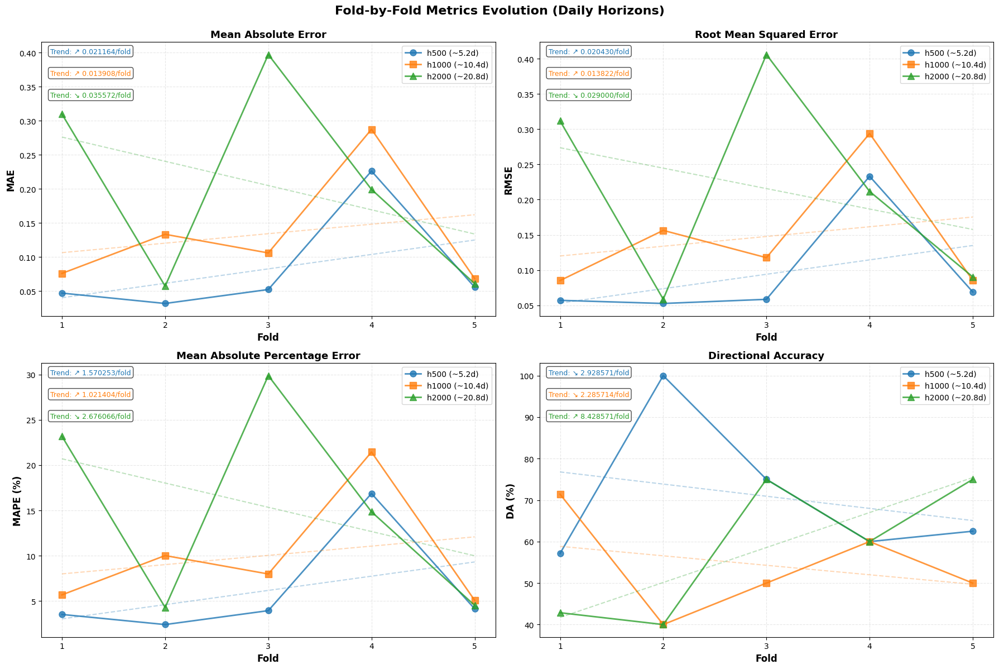

✅ Saved: daily_wf_plots/fold_progression_metrics.png


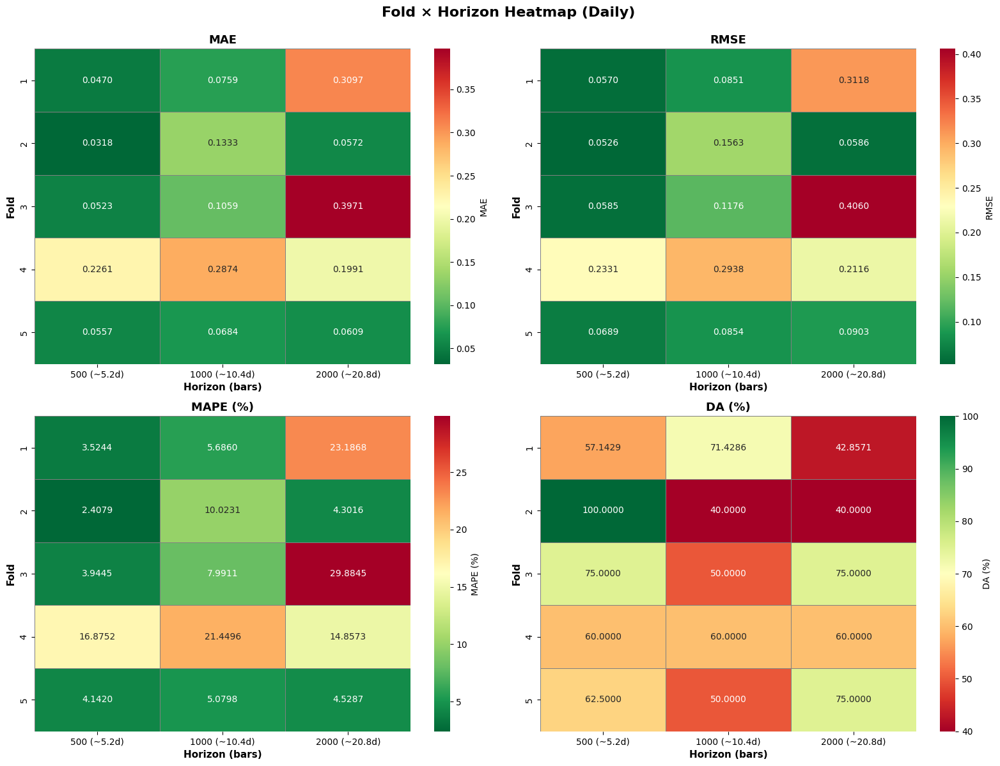

✅ Saved: daily_wf_plots/fold_horizon_heatmap.png


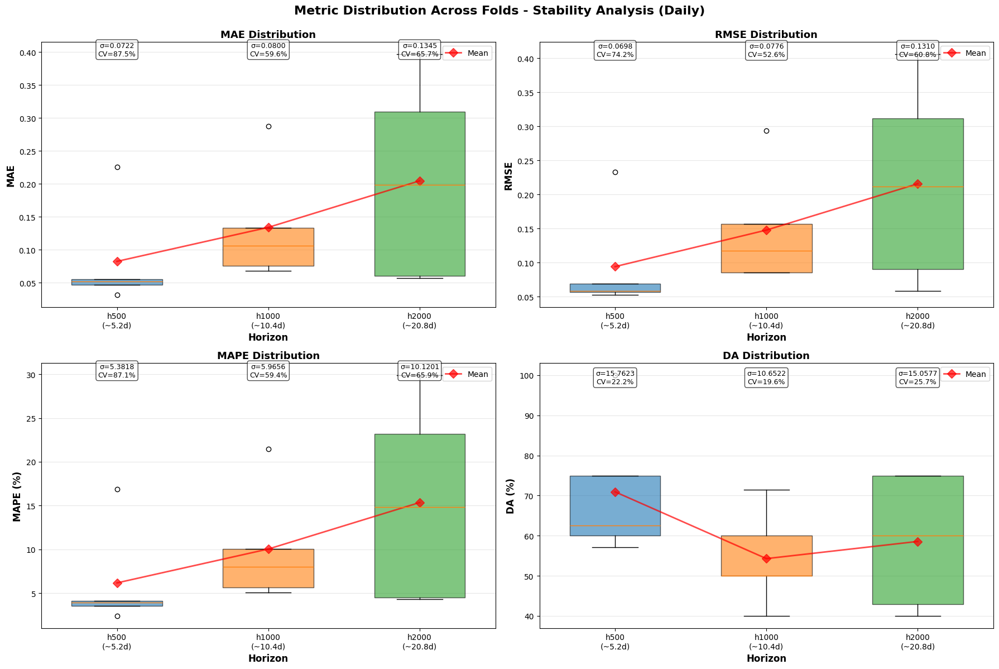

✅ Saved: daily_wf_plots/fold_stability_analysis.png

FOLD PROGRESSION STATISTICS - DAILY TARGETS

       Horizon Metric   First    Last    Mean     Std CV(%)     Slope Change(%)        Trend
  h500 (~5.2d)    MAE  0.0470  0.0557  0.0826  0.0722 87.48  0.021164    -18.43 ⚠️ Degrading
  h500 (~5.2d)   RMSE  0.0570  0.0689  0.0940  0.0698 74.20  0.020430    -20.81 ⚠️ Degrading
  h500 (~5.2d)   MAPE  3.5244  4.1420  6.1788  5.3818 87.10  1.570253    -17.52 ⚠️ Degrading
  h500 (~5.2d)     DA 57.1429 62.5000 70.9286 15.7623 22.22 -2.928571     +9.38 ⚠️ Degrading
h1000 (~10.4d)    MAE  0.0759  0.0684  0.1342  0.0800 59.60  0.013908     +9.88 ⚠️ Degrading
h1000 (~10.4d)   RMSE  0.0851  0.0854  0.1477  0.0776 52.57  0.013822     -0.41 ⚠️ Degrading
h1000 (~10.4d)   MAPE  5.6860  5.0798 10.0459  5.9656 59.38  1.021404    +10.66 ⚠️ Degrading
h1000 (~10.4d)     DA 71.4286 50.0000 54.2857 10.6522 19.62 -2.285714    -30.00 ⚠️ Degrading
h2000 (~20.8d)    MAE  0.3097  0.0609  0.2048  0.1345 65.68 -0.03

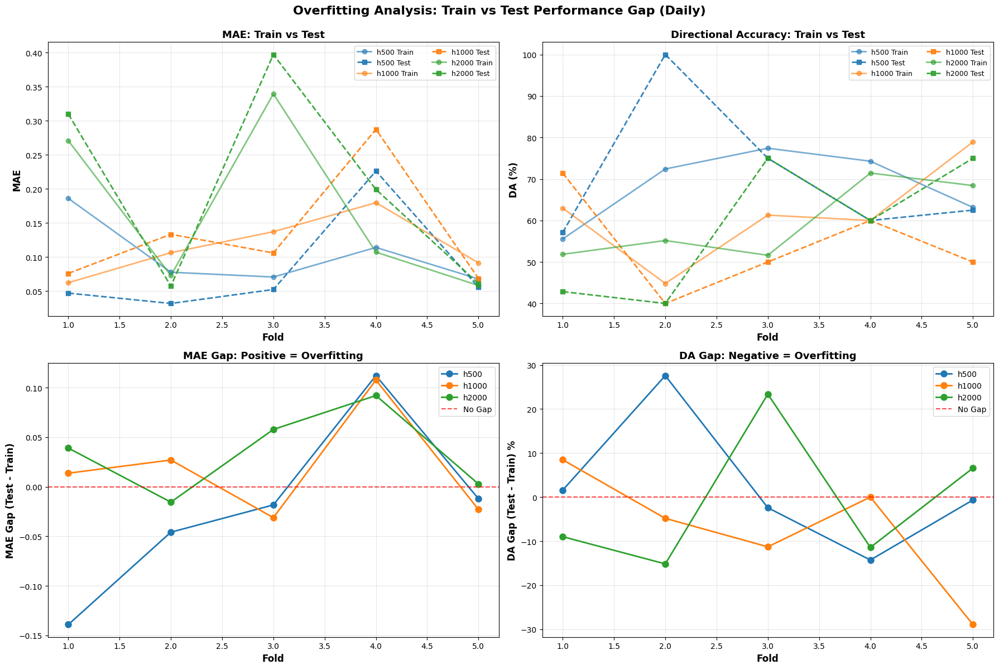

✅ Saved: daily_wf_plots/overfitting_analysis.png

OVERFITTING SUMMARY (AVERAGE ACROSS FOLDS) - DAILY

🎯 Horizon h500 (~5.2 days):
   MAE  Gap: -0.020646 (avg) | σ=0.089916
   RMSE Gap: -0.034374 (avg) | σ=0.086601
   DA   Gap: +2.36% (avg) | σ=15.38%
   ✅ GENERALIZING WELL

🎯 Horizon h1000 (~10.4 days):
   MAE  Gap: +0.018838 (avg) | σ=0.055301
   RMSE Gap: +0.010332 (avg) | σ=0.053127
   DA   Gap: -7.32% (avg) | σ=14.08%
   ⚠️  OVERFITTING DETECTED

🎯 Horizon h2000 (~20.8 days):
   MAE  Gap: +0.035201 (avg) | σ=0.042940
   RMSE Gap: +0.027848 (avg) | σ=0.041554
   DA   Gap: -1.13% (avg) | σ=16.01%
   ⚠️  OVERFITTING DETECTED

💾 Saved: daily_wf_plots/overfitting_data.csv


PER-FOLD PREDICTIONS & CONFUSION MATRICES - DAILY


FOLD 1

📊 Plotting Fold 1 train+test comparison...


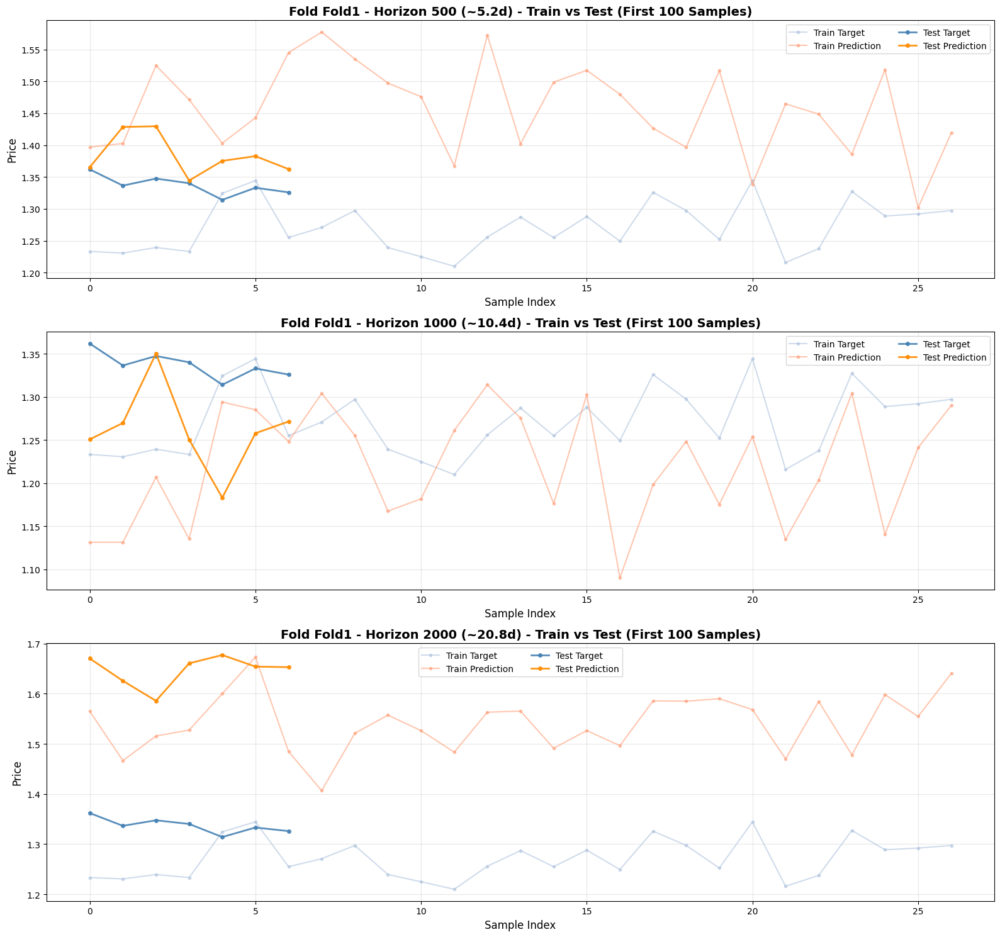

✅ Saved: daily_wf_plots/Fold1_train_test_comparison.png

📈 Generating Fold 1 confusion matrices...


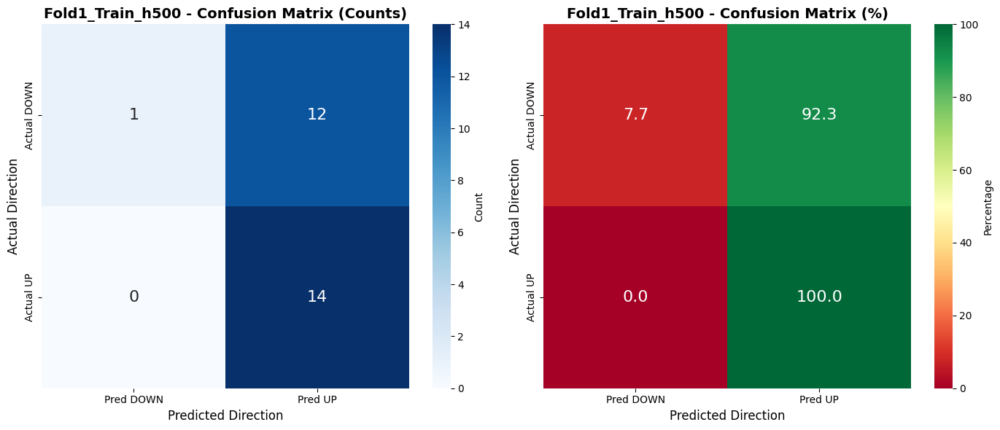


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Train_h500

              precision    recall  f1-score   support

        DOWN      1.000     0.077     0.143        13
          UP      0.538     1.000     0.700        14

    accuracy                          0.556        27
   macro avg      0.769     0.538     0.421        27
weighted avg      0.761     0.556     0.432        27


Total: 27 | Correct: 15 (55.6%)
FALSE POSITIVE (Pred UP → Act DOWN): 12 (44.4%)
FALSE NEGATIVE (Pred DOWN → Act UP): 0 (0.0%)


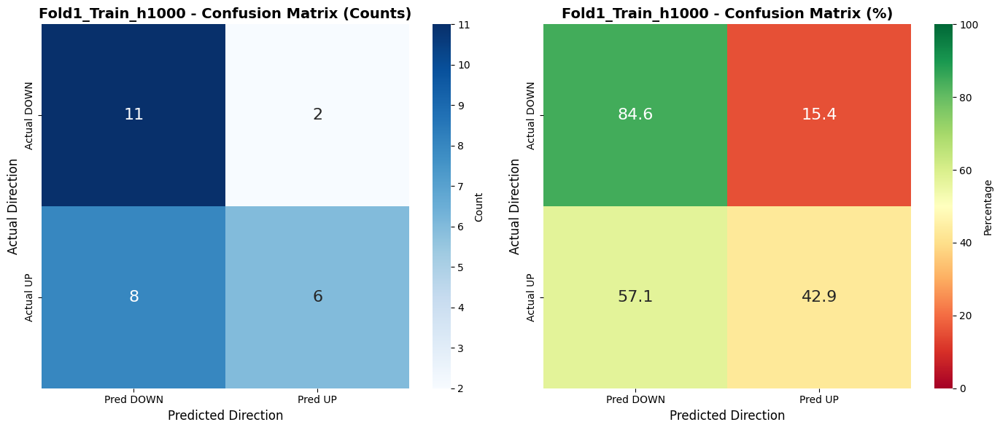


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Train_h1000

              precision    recall  f1-score   support

        DOWN      0.579     0.846     0.688        13
          UP      0.750     0.429     0.545        14

    accuracy                          0.630        27
   macro avg      0.664     0.637     0.616        27
weighted avg      0.668     0.630     0.614        27


Total: 27 | Correct: 17 (63.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 2 (7.4%)
FALSE NEGATIVE (Pred DOWN → Act UP): 8 (29.6%)

⚠️  Fold1_Train_h2000: Only one class present - skipping confusion matrix
   Predicted: ['UP'] | Actual: ['DOWN', 'UP']
   Total samples: 27
   Basic accuracy: 51.9%



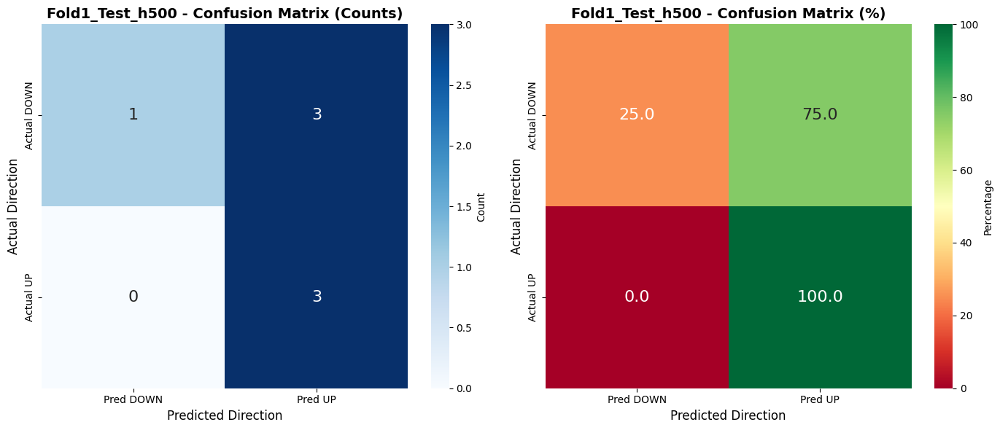


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Test_h500

              precision    recall  f1-score   support

        DOWN      1.000     0.250     0.400         4
          UP      0.500     1.000     0.667         3

    accuracy                          0.571         7
   macro avg      0.750     0.625     0.533         7
weighted avg      0.786     0.571     0.514         7


Total: 7 | Correct: 4 (57.1%)
FALSE POSITIVE (Pred UP → Act DOWN): 3 (42.9%)
FALSE NEGATIVE (Pred DOWN → Act UP): 0 (0.0%)


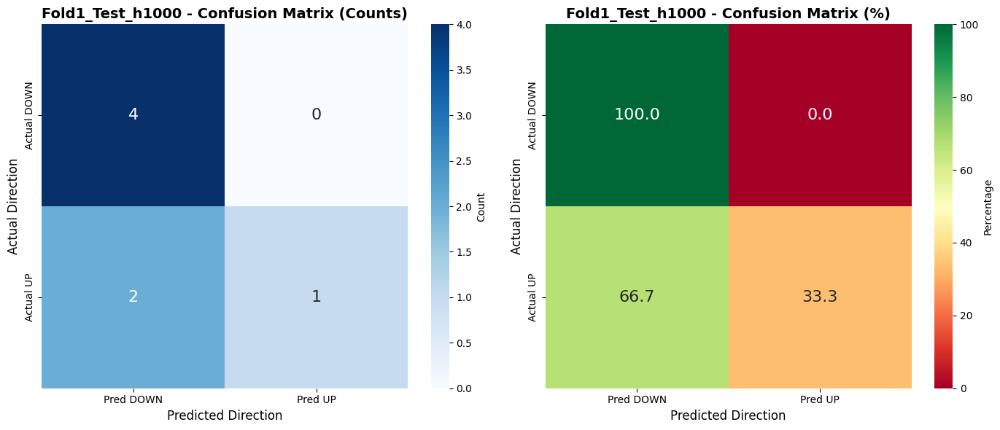


DIRECTIONAL CLASSIFICATION REPORT - Fold1_Test_h1000

              precision    recall  f1-score   support

        DOWN      0.667     1.000     0.800         4
          UP      1.000     0.333     0.500         3

    accuracy                          0.714         7
   macro avg      0.833     0.667     0.650         7
weighted avg      0.810     0.714     0.671         7


Total: 7 | Correct: 5 (71.4%)
FALSE POSITIVE (Pred UP → Act DOWN): 0 (0.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 2 (28.6%)

⚠️  Fold1_Test_h2000: Only one class present - skipping confusion matrix
   Predicted: ['UP'] | Actual: ['DOWN', 'UP']
   Total samples: 7
   Basic accuracy: 42.9%


FOLD 2

📊 Plotting Fold 2 train+test comparison...


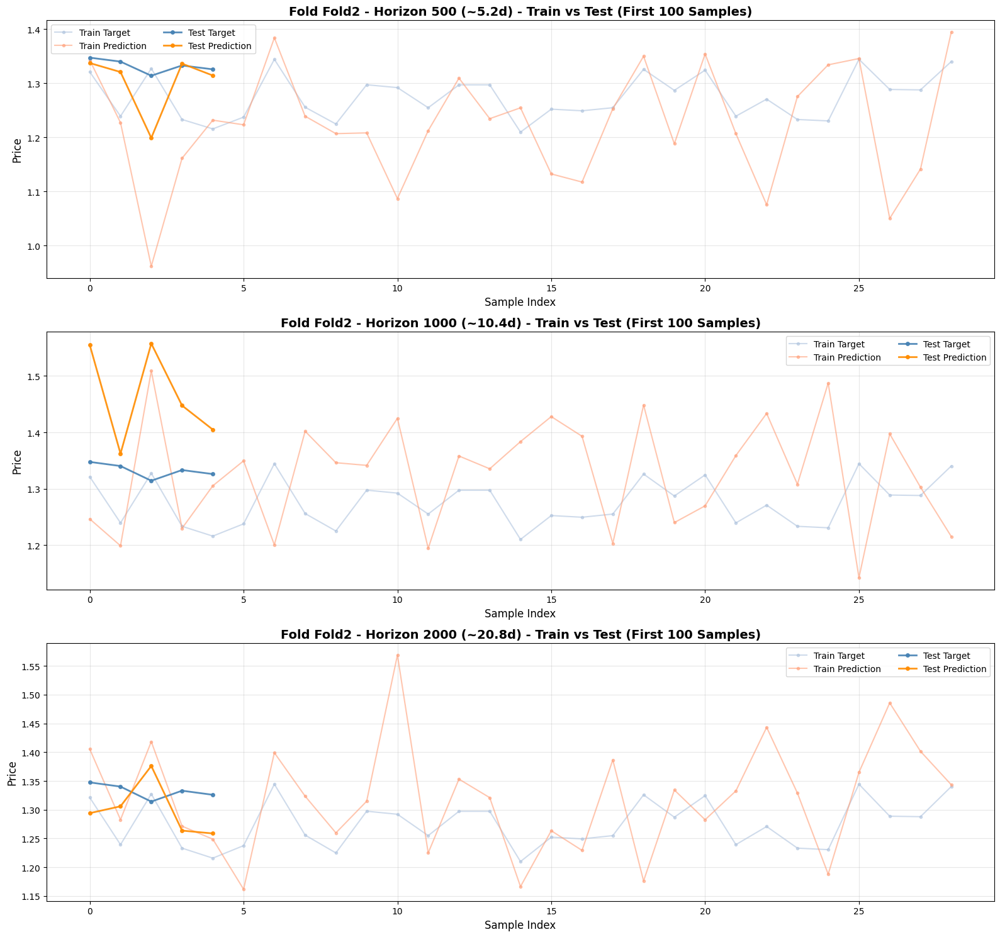

✅ Saved: daily_wf_plots/Fold2_train_test_comparison.png

📈 Generating Fold 2 confusion matrices...


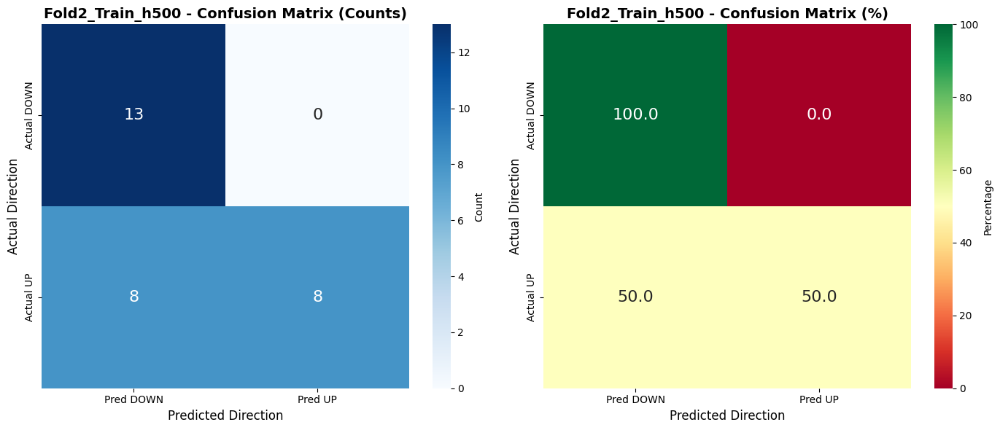


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train_h500

              precision    recall  f1-score   support

        DOWN      0.619     1.000     0.765        13
          UP      1.000     0.500     0.667        16

    accuracy                          0.724        29
   macro avg      0.810     0.750     0.716        29
weighted avg      0.829     0.724     0.711        29


Total: 29 | Correct: 21 (72.4%)
FALSE POSITIVE (Pred UP → Act DOWN): 0 (0.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 8 (27.6%)


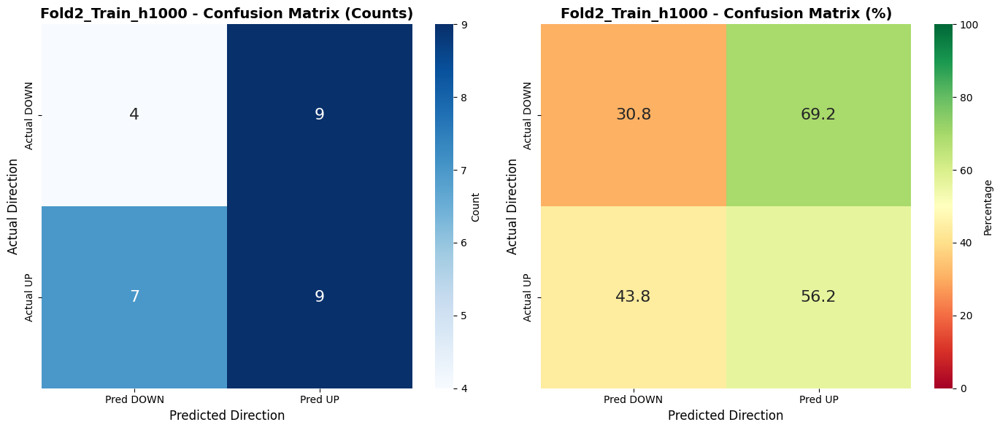


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train_h1000

              precision    recall  f1-score   support

        DOWN      0.364     0.308     0.333        13
          UP      0.500     0.562     0.529        16

    accuracy                          0.448        29
   macro avg      0.432     0.435     0.431        29
weighted avg      0.439     0.448     0.442        29


Total: 29 | Correct: 13 (44.8%)
FALSE POSITIVE (Pred UP → Act DOWN): 9 (31.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 7 (24.1%)


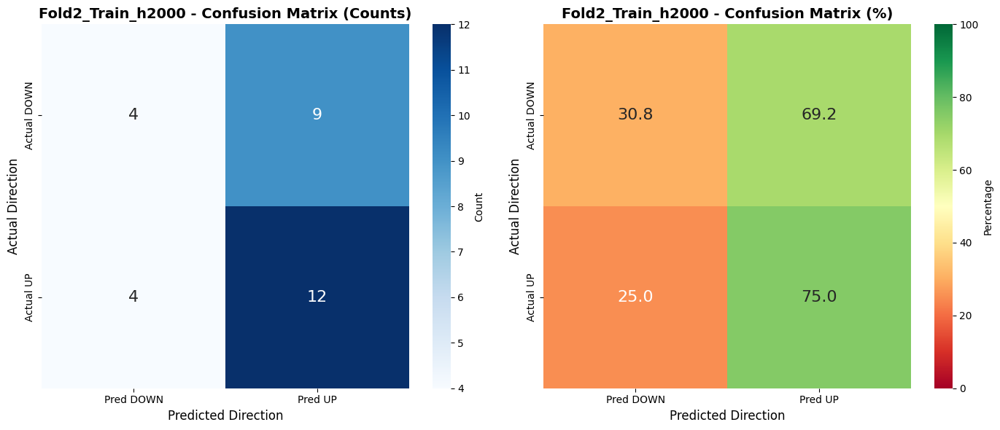


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Train_h2000

              precision    recall  f1-score   support

        DOWN      0.500     0.308     0.381        13
          UP      0.571     0.750     0.649        16

    accuracy                          0.552        29
   macro avg      0.536     0.529     0.515        29
weighted avg      0.539     0.552     0.529        29


Total: 29 | Correct: 16 (55.2%)
FALSE POSITIVE (Pred UP → Act DOWN): 9 (31.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 4 (13.8%)


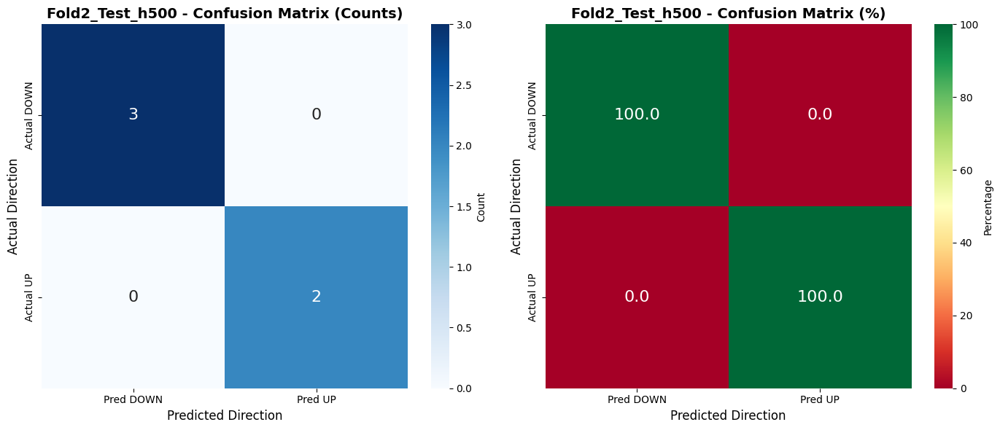


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Test_h500

              precision    recall  f1-score   support

        DOWN      1.000     1.000     1.000         3
          UP      1.000     1.000     1.000         2

    accuracy                          1.000         5
   macro avg      1.000     1.000     1.000         5
weighted avg      1.000     1.000     1.000         5


Total: 5 | Correct: 5 (100.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 0 (0.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 0 (0.0%)

⚠️  Fold2_Test_h1000: Only one class present - skipping confusion matrix
   Predicted: ['UP'] | Actual: ['DOWN', 'UP']
   Total samples: 5
   Basic accuracy: 40.0%



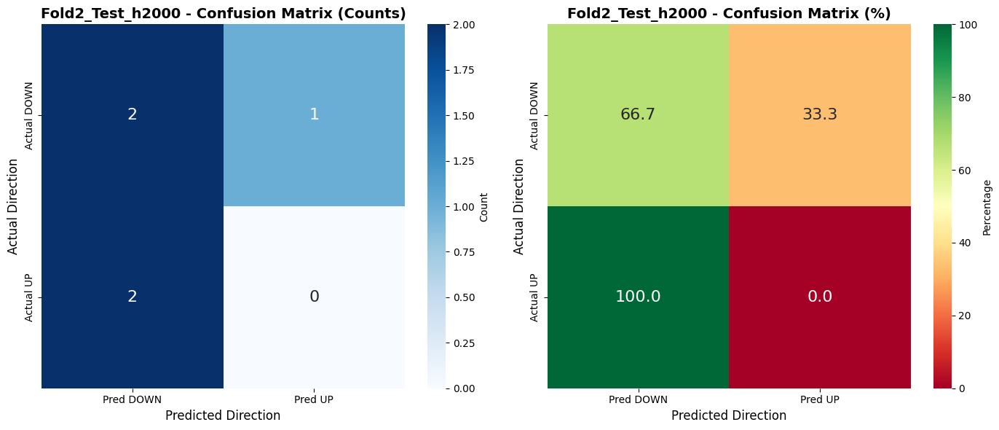


DIRECTIONAL CLASSIFICATION REPORT - Fold2_Test_h2000

              precision    recall  f1-score   support

        DOWN      0.500     0.667     0.571         3
          UP      0.000     0.000     0.000         2

    accuracy                          0.400         5
   macro avg      0.250     0.333     0.286         5
weighted avg      0.300     0.400     0.343         5


Total: 5 | Correct: 2 (40.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (20.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 2 (40.0%)

FOLD 3

📊 Plotting Fold 3 train+test comparison...


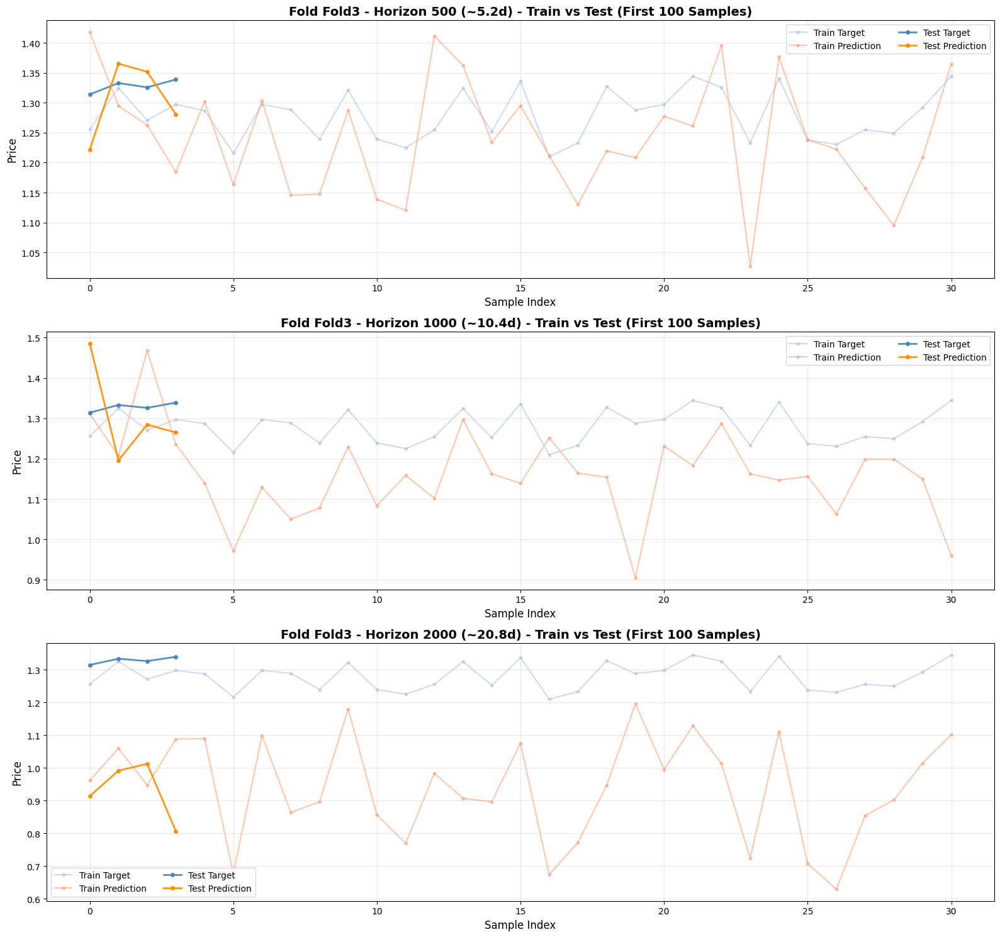

✅ Saved: daily_wf_plots/Fold3_train_test_comparison.png

📈 Generating Fold 3 confusion matrices...


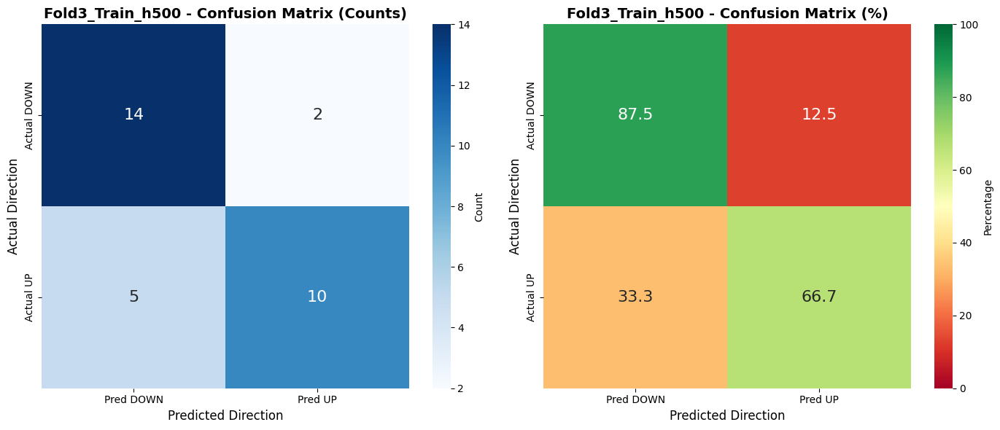


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Train_h500

              precision    recall  f1-score   support

        DOWN      0.737     0.875     0.800        16
          UP      0.833     0.667     0.741        15

    accuracy                          0.774        31
   macro avg      0.785     0.771     0.770        31
weighted avg      0.784     0.774     0.771        31


Total: 31 | Correct: 24 (77.4%)
FALSE POSITIVE (Pred UP → Act DOWN): 2 (6.5%)
FALSE NEGATIVE (Pred DOWN → Act UP): 5 (16.1%)


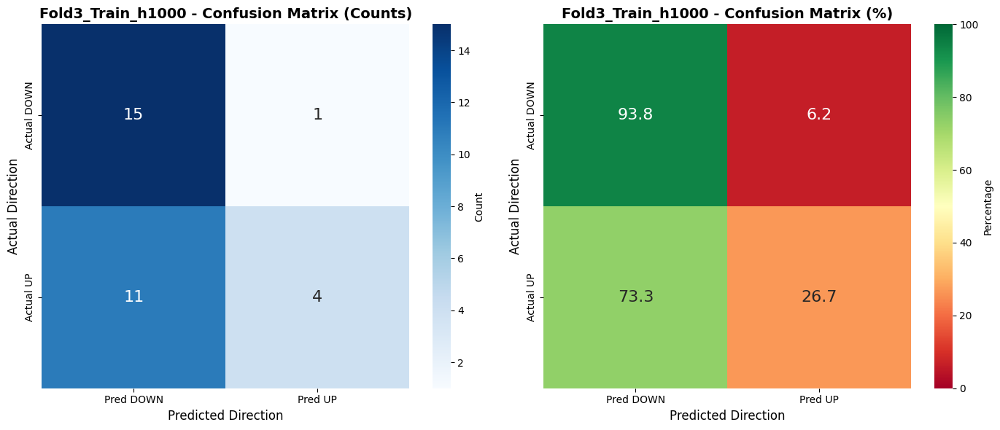


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Train_h1000

              precision    recall  f1-score   support

        DOWN      0.577     0.938     0.714        16
          UP      0.800     0.267     0.400        15

    accuracy                          0.613        31
   macro avg      0.688     0.602     0.557        31
weighted avg      0.685     0.613     0.562        31


Total: 31 | Correct: 19 (61.3%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (3.2%)
FALSE NEGATIVE (Pred DOWN → Act UP): 11 (35.5%)

⚠️  Fold3_Train_h2000: Only one class present - skipping confusion matrix
   Predicted: ['DOWN'] | Actual: ['DOWN', 'UP']
   Total samples: 31
   Basic accuracy: 51.6%



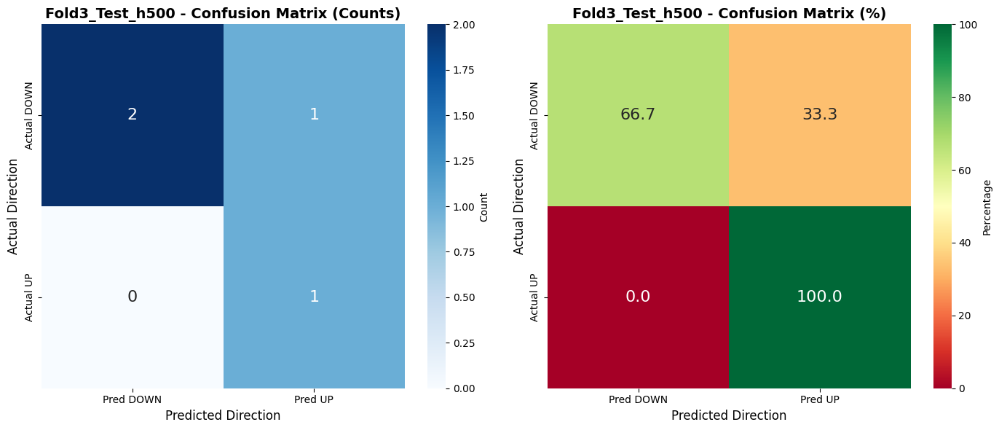


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Test_h500

              precision    recall  f1-score   support

        DOWN      1.000     0.667     0.800         3
          UP      0.500     1.000     0.667         1

    accuracy                          0.750         4
   macro avg      0.750     0.833     0.733         4
weighted avg      0.875     0.750     0.767         4


Total: 4 | Correct: 3 (75.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (25.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 0 (0.0%)


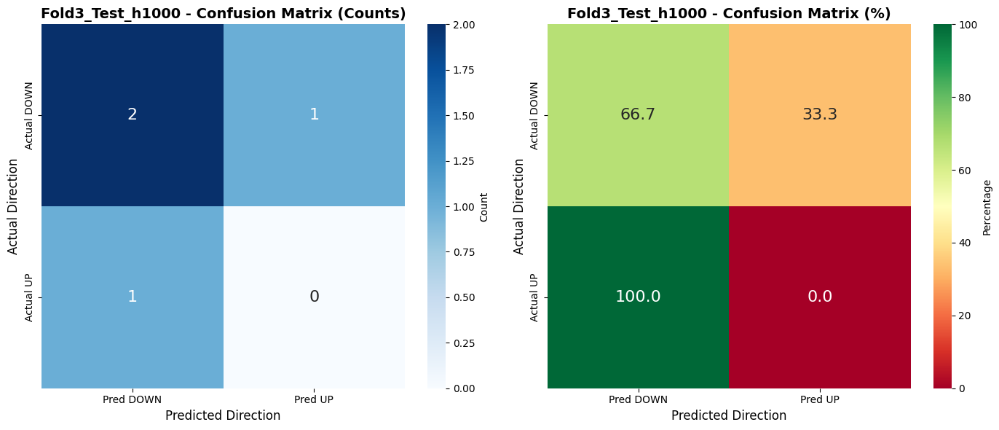


DIRECTIONAL CLASSIFICATION REPORT - Fold3_Test_h1000

              precision    recall  f1-score   support

        DOWN      0.667     0.667     0.667         3
          UP      0.000     0.000     0.000         1

    accuracy                          0.500         4
   macro avg      0.333     0.333     0.333         4
weighted avg      0.500     0.500     0.500         4


Total: 4 | Correct: 2 (50.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (25.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 1 (25.0%)

⚠️  Fold3_Test_h2000: Only one class present - skipping confusion matrix
   Predicted: ['DOWN'] | Actual: ['DOWN', 'UP']
   Total samples: 4
   Basic accuracy: 75.0%


FOLD 4

📊 Plotting Fold 4 train+test comparison...


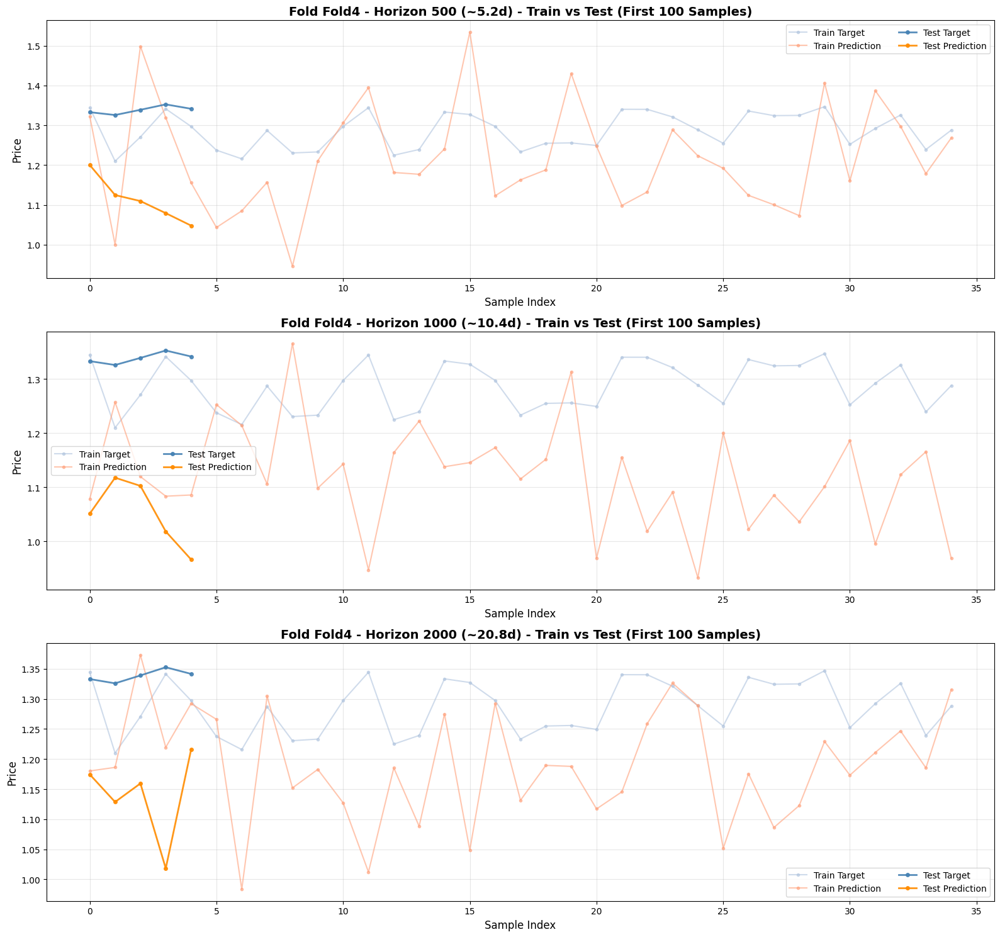

✅ Saved: daily_wf_plots/Fold4_train_test_comparison.png

📈 Generating Fold 4 confusion matrices...


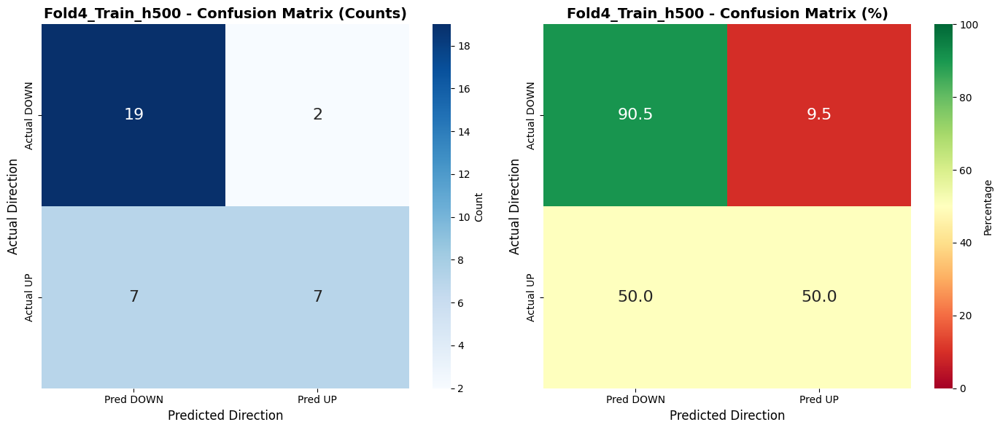


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train_h500

              precision    recall  f1-score   support

        DOWN      0.731     0.905     0.809        21
          UP      0.778     0.500     0.609        14

    accuracy                          0.743        35
   macro avg      0.754     0.702     0.709        35
weighted avg      0.750     0.743     0.729        35


Total: 35 | Correct: 26 (74.3%)
FALSE POSITIVE (Pred UP → Act DOWN): 2 (5.7%)
FALSE NEGATIVE (Pred DOWN → Act UP): 7 (20.0%)


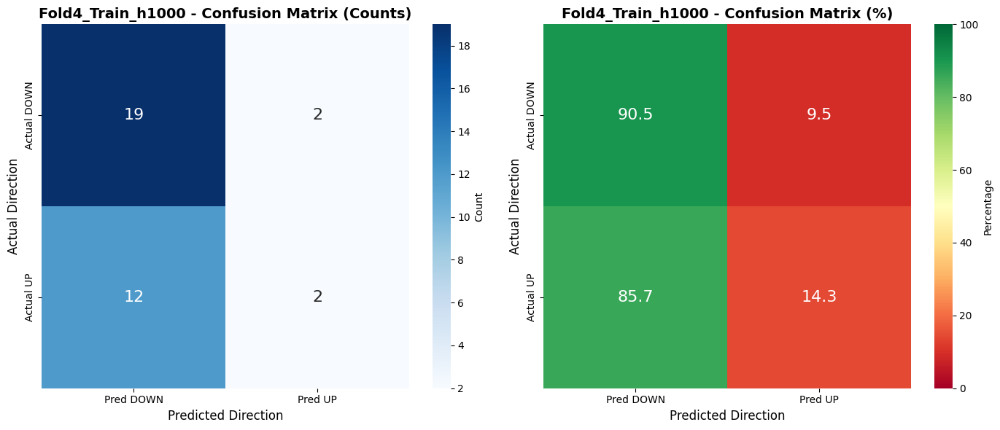


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train_h1000

              precision    recall  f1-score   support

        DOWN      0.613     0.905     0.731        21
          UP      0.500     0.143     0.222        14

    accuracy                          0.600        35
   macro avg      0.556     0.524     0.476        35
weighted avg      0.568     0.600     0.527        35


Total: 35 | Correct: 21 (60.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 2 (5.7%)
FALSE NEGATIVE (Pred DOWN → Act UP): 12 (34.3%)


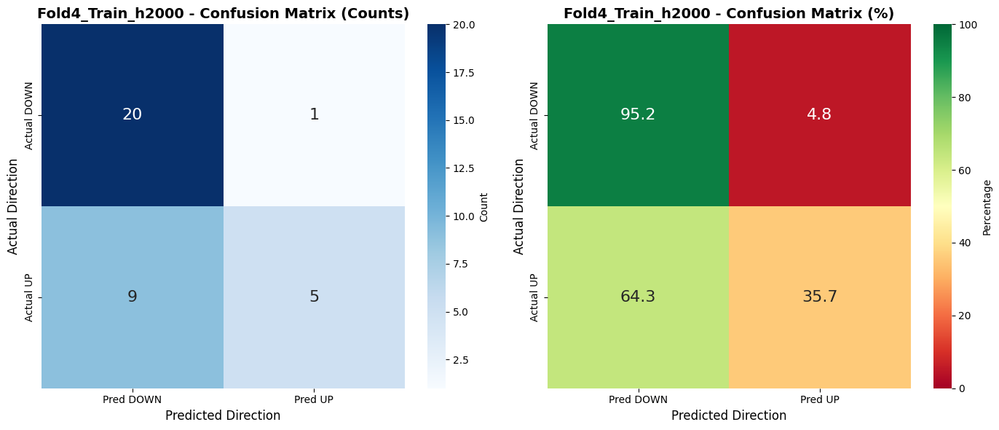


DIRECTIONAL CLASSIFICATION REPORT - Fold4_Train_h2000

              precision    recall  f1-score   support

        DOWN      0.690     0.952     0.800        21
          UP      0.833     0.357     0.500        14

    accuracy                          0.714        35
   macro avg      0.761     0.655     0.650        35
weighted avg      0.747     0.714     0.680        35


Total: 35 | Correct: 25 (71.4%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (2.9%)
FALSE NEGATIVE (Pred DOWN → Act UP): 9 (25.7%)

⚠️  Fold4_Test_h500: Only one class present - skipping confusion matrix
   Predicted: ['DOWN'] | Actual: ['DOWN', 'UP']
   Total samples: 5
   Basic accuracy: 60.0%


⚠️  Fold4_Test_h1000: Only one class present - skipping confusion matrix
   Predicted: ['DOWN'] | Actual: ['DOWN', 'UP']
   Total samples: 5
   Basic accuracy: 60.0%


⚠️  Fold4_Test_h2000: Only one class present - skipping confusion matrix
   Predicted: ['DOWN'] | Actual: ['DOWN', 'UP']
   Total samples: 5
   Basic accur

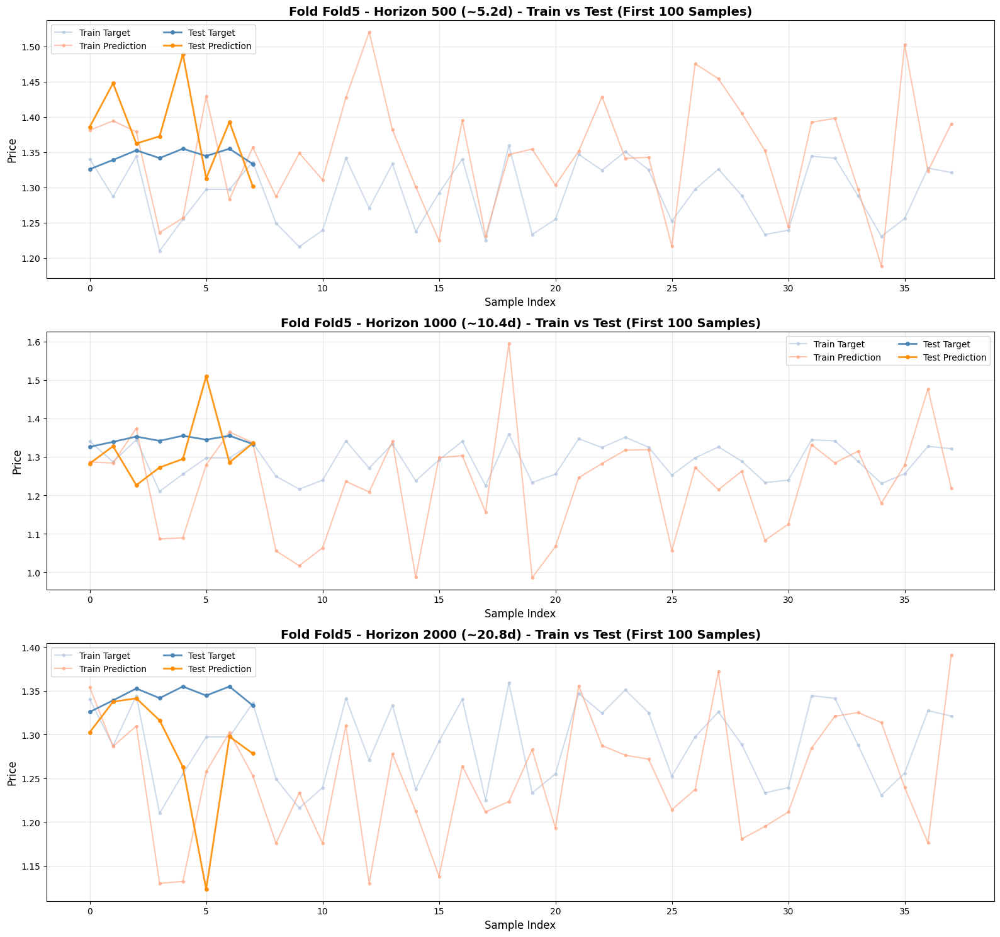

✅ Saved: daily_wf_plots/Fold5_train_test_comparison.png

📈 Generating Fold 5 confusion matrices...


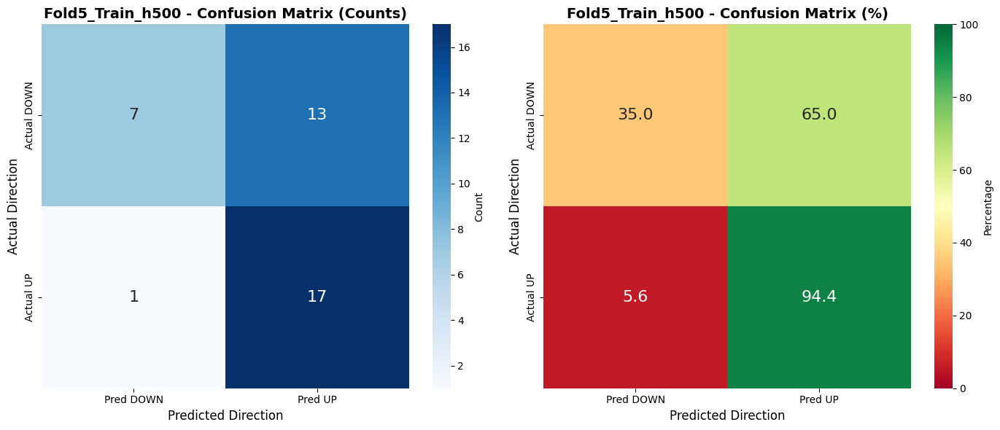


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train_h500

              precision    recall  f1-score   support

        DOWN      0.875     0.350     0.500        20
          UP      0.567     0.944     0.708        18

    accuracy                          0.632        38
   macro avg      0.721     0.647     0.604        38
weighted avg      0.729     0.632     0.599        38


Total: 38 | Correct: 24 (63.2%)
FALSE POSITIVE (Pred UP → Act DOWN): 13 (34.2%)
FALSE NEGATIVE (Pred DOWN → Act UP): 1 (2.6%)


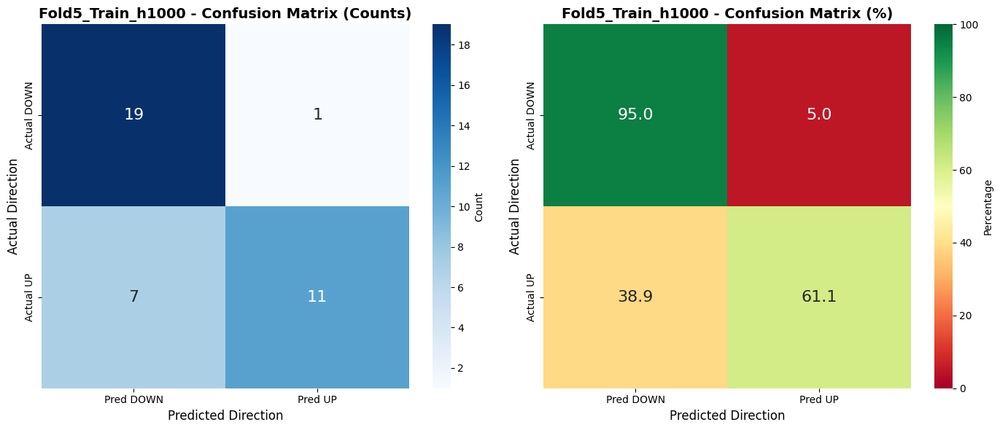


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train_h1000

              precision    recall  f1-score   support

        DOWN      0.731     0.950     0.826        20
          UP      0.917     0.611     0.733        18

    accuracy                          0.789        38
   macro avg      0.824     0.781     0.780        38
weighted avg      0.819     0.789     0.782        38


Total: 38 | Correct: 30 (78.9%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (2.6%)
FALSE NEGATIVE (Pred DOWN → Act UP): 7 (18.4%)


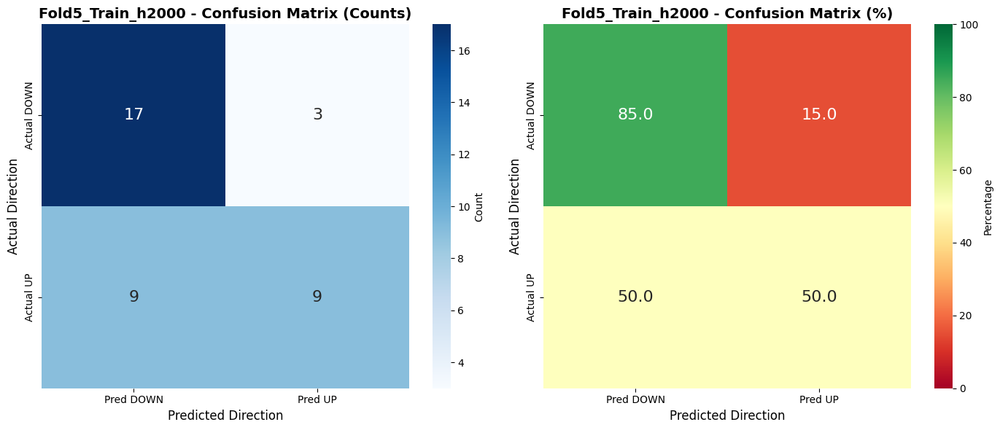


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Train_h2000

              precision    recall  f1-score   support

        DOWN      0.654     0.850     0.739        20
          UP      0.750     0.500     0.600        18

    accuracy                          0.684        38
   macro avg      0.702     0.675     0.670        38
weighted avg      0.699     0.684     0.673        38


Total: 38 | Correct: 26 (68.4%)
FALSE POSITIVE (Pred UP → Act DOWN): 3 (7.9%)
FALSE NEGATIVE (Pred DOWN → Act UP): 9 (23.7%)


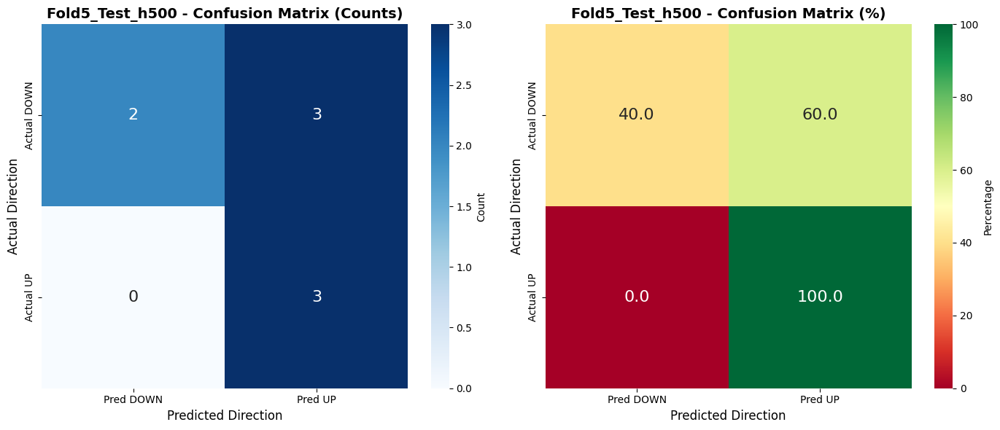


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test_h500

              precision    recall  f1-score   support

        DOWN      1.000     0.400     0.571         5
          UP      0.500     1.000     0.667         3

    accuracy                          0.625         8
   macro avg      0.750     0.700     0.619         8
weighted avg      0.812     0.625     0.607         8


Total: 8 | Correct: 5 (62.5%)
FALSE POSITIVE (Pred UP → Act DOWN): 3 (37.5%)
FALSE NEGATIVE (Pred DOWN → Act UP): 0 (0.0%)


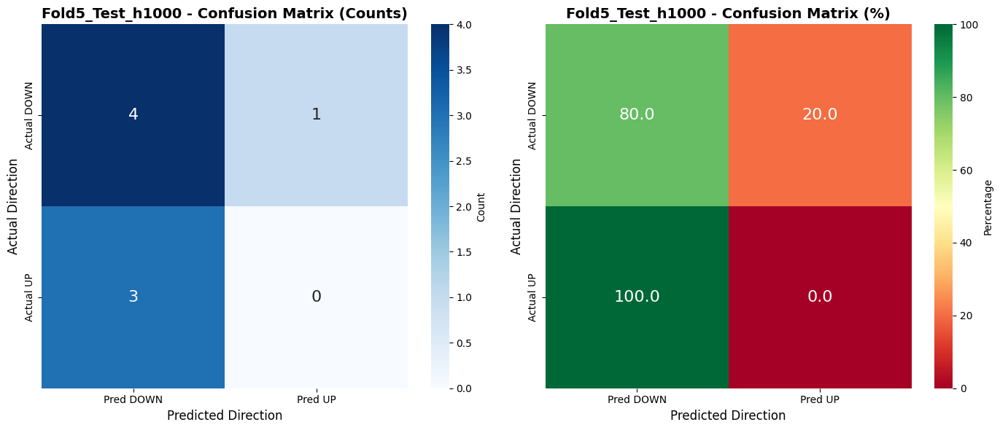


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test_h1000

              precision    recall  f1-score   support

        DOWN      0.571     0.800     0.667         5
          UP      0.000     0.000     0.000         3

    accuracy                          0.500         8
   macro avg      0.286     0.400     0.333         8
weighted avg      0.357     0.500     0.417         8


Total: 8 | Correct: 4 (50.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 1 (12.5%)
FALSE NEGATIVE (Pred DOWN → Act UP): 3 (37.5%)


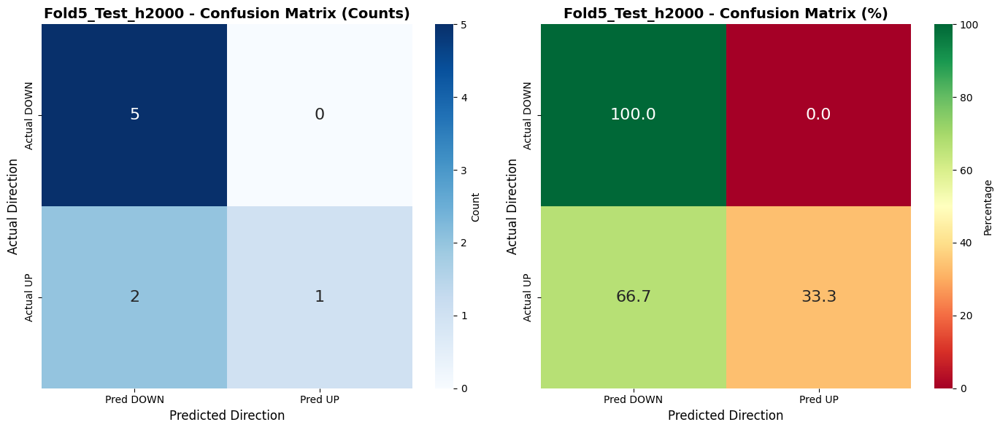


DIRECTIONAL CLASSIFICATION REPORT - Fold5_Test_h2000

              precision    recall  f1-score   support

        DOWN      0.714     1.000     0.833         5
          UP      1.000     0.333     0.500         3

    accuracy                          0.750         8
   macro avg      0.857     0.667     0.667         8
weighted avg      0.821     0.750     0.708         8


Total: 8 | Correct: 6 (75.0%)
FALSE POSITIVE (Pred UP → Act DOWN): 0 (0.0%)
FALSE NEGATIVE (Pred DOWN → Act UP): 2 (25.0%)

WALK-FORWARD ANALYSIS COMPLETE - DAILY TARGETS v2.9

💾 All plots saved to: daily_wf_plots/

📊 New Outputs:
   - fold_progression_metrics.png
   - fold_horizon_heatmap.png
   - fold_stability_analysis.png
   - fold_progression_summary.csv
   - overfitting_analysis.png
   - overfitting_data.csv
   - Fold*_train_test_comparison.png
   - Fold*_Train_h*_confusion_matrix.png
   - Fold*_Test_h*_confusion_matrix.png


In [ ]:
analyze_walkforward_results_daily(
    wf_results=wf_results,
    plot_progression=True,     # ← Fold progression
    plot_overfitting=True      # ← Overfitting analysis
)

# CROSS PAIR GENERALIZATION

## Another Pair

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mplfinance as mpf
import ta.momentum
from dataclasses import dataclass
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ============================================================
# CONFIG
# ============================================================
DUKASCOPY_INSTRUMENT = 'USDCHF'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "1d"  # Daily data

# ============================================================
# DATA CLASSES
# ============================================================
@dataclass
class LocalExtreme:
    """Represents a swing high or low point with confirmation data"""
    ext_type: int  # 1 for high, -1 for low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    """Represents a structural price level for BOS detection"""
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ============================================================
# DIRECTIONAL CHANGE DETECTOR
# ============================================================
class FibRetracementDC:
    """
    Fibonacci Retracement-based Directional Change detector.
    Identifies swing highs and lows based on a retracement percentage.
    """
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        ext = LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        )
        self.extremes.append(ext)

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """
    Converts minor (25%) extremes to intermediate major (50%) extremes.
    """
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        if self.base_extremes[0].ext_type == 1:
            last_confirmed_high = self.base_extremes[0]
            last_confirmed_low = None
        else:
            last_confirmed_low = self.base_extremes[0]
            last_confirmed_high = None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == 1:
                            if self.base_extremes[j].price > highest.price:
                                highest = self.base_extremes[j]
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_threshold = highest.price - (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price <= retrace_threshold:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == -1:
                            if self.base_extremes[j].price < lowest.price:
                                lowest = self.base_extremes[j]
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_threshold = lowest.price + (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price >= retrace_threshold:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ============================================================
# PATTERN LIBRARY (18)
# ============================================================
PATTERN_LIBRARY = [
    # CONTINUATIONS
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # SIMPLE REVERSALS
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # FAILED REVERSALS
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # TRAPS
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # STRUCTURE BREAKS
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # COMPLEX REVERSALS
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # FAILED REVERSAL EXTENSIONS
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # LIQUIDITY SWEEPS
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============================================================
# BIASED PLOTTING COLUMNS (for charts only)
# ============================================================
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    """
    BIASED COLUMNS - FOR PLOTTING/REFERENCE ONLY
    These are marked at EXTREME time and contain lookahead bias
    DO NOT USE FOR ML OR BACKTESTING
    """
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for ext in extremes_dict['minor']:
        df.loc[ext.timestamp, 'MinorSwingHigh' if ext.ext_type == 1 else 'MinorSwingLow'] = 1
    for ext in extremes_dict['minmaj']:
        df.loc[ext.timestamp, 'MinMajSwingHigh' if ext.ext_type == 1 else 'MinMajSwingLow'] = 1
    for ext in extremes_dict['major']:
        df.loc[ext.timestamp, 'MajorSwingHigh' if ext.ext_type == 1 else 'MajorSwingLow'] = 1
    
    # Labels (BIASED) – Minor
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_highs):
        label = 'H' if i == 0 else ('HH' if cur.price > minor_highs[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minor_lows):
        label = 'L' if i == 0 else ('HL' if cur.price > minor_lows[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – MinMaj
    minmaj_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    minmaj_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(minmaj_highs):
        if i == 0:
            label = 'H'
        else:
            prev = minmaj_highs[i-1]
            interm = [h for h in minor_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minmaj_lows):
        if i == 0:
            label = 'L'
        else:
            prev = minmaj_lows[i-1]
            interm = [l for l in minor_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – Major
    major_highs = [e for e in extremes_dict['major'] if e.ext_type == 1]
    major_lows = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(major_highs):
        if i == 0:
            label = 'H'
        else:
            prev = major_highs[i-1]
            interm = [h for h in minmaj_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(major_lows):
        if i == 0:
            label = 'L'
        else:
            prev = major_lows[i-1]
            interm = [l for l in minmaj_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    return df

# ============================================================
# ML-READY LABELS (NO LOOKAHEAD) - WITH VERBOSE DIAGNOSTICS
# ============================================================
def add_ml_ready_swing_labels(df, extremes_dict):
    """
    ML-READY SWING LABELS - NO LOOKAHEAD BIAS
    All labels marked at CONFIRMATION time with full metadata
    NOW WITH VERBOSE VOLUME DIAGNOSTICS
    """
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    timeframe_map = {
        'Minor': extremes_dict['minor'],
        'MinMaj': extremes_dict['minmaj'],
        'Major': extremes_dict['major']
    }
    
    # Volume diagnostic counters
    volume_success_count = 0
    volume_fail_count = 0
    
    for level_name, extremes_list in timeframe_map.items():
        highs = [e for e in extremes_list if e.ext_type == 1]
        lows = [e for e in extremes_list if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_highs, lower_lows = [], []
        
        # HIGHS
        for i, current in enumerate(highs):
            if i == 0:
                label = 'H'
            else:
                prev = highs[i-1]
                if lower_highs:
                    inter = [h for h in lower_highs if prev.timestamp < h.timestamp < current.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        label = 'HH' if current.price > ref else 'LH'
                    else:
                        label = 'HH' if current.price > prev.price else 'LH'
                else:
                    label = 'HH' if current.price > prev.price else 'LH'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_HighConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingHighPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceHigh'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_High'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceHigh'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceHigh'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromHigh'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    # Volume at extreme
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_High'] = vol_at_ext
                    
                    # Volume at confirmation
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_High'] = vol_at_conf
                    
                    # Total volume during swing
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    # Check if all NaN
                    if vol_slice.isna().all():
                        print(f"⚠️  {level_name} High: All volume NaN at {conf_ts}")
                        print(f"   Slice: iloc[{current.index}:{current.conf_index + 1}]")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        # Check if result is valid
                        if pd.isna(tot_vol) or tot_vol == 0:
                            print(f"⚠️  {level_name} High: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            print(f"   Volume slice: {vol_slice.values}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            # Only print first success for each level as confirmation
                            if volume_success_count == 1:
                                print(f"✅ {level_name} High: Volume calculated successfully at {conf_ts}")
                                print(f"   Total: {tot_vol:.2f}, Avg: {avg_vol:.2f}")
                        
                except Exception as e:
                    print(f"❌ {level_name} High: ERROR at {conf_ts}: {e}")
                    print(f"   Extreme index: {current.index}, Conf index: {current.conf_index}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            else:
                tot_vol = np.nan
            
            # Speed calculations
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            # Momentum calculations (only if volume exists)
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_High'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            # Previous swing comparisons
            if i > 0:
                prev = highs[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_High'] = df.loc[prev_conf, f'{level_name}_DistanceFromHigh']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_High'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_High']
                df.loc[conf_ts, f'{level_name}_Overshoot_High'] = int(current.price > prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS (same logic with diagnostics)
        for i, current in enumerate(lows):
            if i == 0:
                label = 'L'
            else:
                prev = lows[i-1]
                if lower_lows:
                    inter = [l for l in lower_lows if prev.timestamp < l.timestamp < current.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        label = 'LL' if current.price < ref else 'HL'
                    else:
                        label = 'HL' if current.price > prev.price else 'LL'
                else:
                    label = 'HL' if current.price > prev.price else 'LL'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_LowConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingLowPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceLow'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_Low'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceLow'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceLow'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromLow'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_Low'] = vol_at_ext
                    
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_Low'] = vol_at_conf
                    
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    if vol_slice.isna().all():
                        print(f"⚠️  {level_name} Low: All volume NaN at {conf_ts}")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        if pd.isna(tot_vol) or tot_vol == 0:
                            print(f"⚠️  {level_name} Low: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            
                except Exception as e:
                    print(f"❌ {level_name} Low: ERROR at {conf_ts}: {e}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            else:
                tot_vol = np.nan
            
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_Low'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_Low'] = df.loc[prev_conf, f'{level_name}_DistanceFromLow']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[conf_ts, f'{level_name}_Overshoot_Low'] = int(current.price < prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    # Print volume diagnostic summary
    print(f"\n{'='*60}")
    print(f"VOLUME CALCULATION SUMMARY")
    print(f"{'='*60}")
    print(f"✅ Successful volume calculations: {volume_success_count}")
    print(f"❌ Failed volume calculations: {volume_fail_count}")
    if volume_fail_count > 0:
        print(f"⚠️  Some swings missing volume data - check diagnostics above")
    print(f"{'='*60}\n")
    
    return df

# ============================================================
# NEW: Impulse vs Retracement speed flags (confirmation-time)
# ============================================================
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    """
    Compute 'ImpulseFaster' flags for highs and lows (no lookahead).
    Impulse: previous swing → current swing
    Retracement: current swing → confirmation
    """
    extremes = extremes_dict[level_name.lower()]
    highs = [e for e in extremes if e.ext_type == 1]
    lows = [e for e in extremes if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            conf_ts = cur.conf_timestamp
            if conf_ts not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[conf_ts, col] = faster
    
    _flag(highs, is_high=True)
    _flag(lows, is_high=False)

# ============================================================
# NEW: MinMaj checks BOTH Minor (lower) and Major (upper) context
# ============================================================
def add_bidirectional_cross_tf_context(df):
    """
    Makes MinMaj aware of BOTH Minor (lower) and Major (upper) structure.
    Adds:
    - MinMaj_LowerLabel: latest Minor_ConfirmedLabel active at that bar
    - MinMaj_UpperLabel: latest Major_ConfirmedLabel active at that bar
    - MinMaj_StructureBias: 'bullish'/'bearish'/'neutral' combining both
    """
    # Lower (Minor → MinMaj)
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    # Upper (Major → MinMaj)
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    # Combined bias
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        low_lbl = df.at[t, 'MinMaj_LowerLabel']
        up_lbl = df.at[t, 'MinMaj_UpperLabel']
        if low_lbl in bull and up_lbl in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif low_lbl in bear and up_lbl in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    
    return df

# ============================================================
# PATTERN DETECTION (multi-TF)
# ============================================================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError(f"Level must be 'Minor', 'MinMaj', or 'Major', got: {level}")
    extremes = extremes_dict[level_map[level]]
    
    for pattern in pattern_library:
        p = pattern['name']
        col = f"{level}_{p}"
        df[f'{col}_Active'] = 0
        df[f'{col}_Swings'] = ''
        df[f'{col}_BOS_Target'] = np.nan
        df[f'{col}_Awaiting_BOS'] = 0
        df[f'{col}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        px = df.iloc[i]['close']
        confirmed = [e for e in extremes if e.conf_timestamp <= t]
        if len(confirmed) < 2:
            continue
        
        new_conf = [e for e in confirmed if e.conf_timestamp == t]
        for _ in new_conf:
            for pattern in pattern_library:
                seq = pattern['sequence']
                N = len(seq)
                if len(confirmed) >= N:
                    recent = confirmed[-N:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({
                            'config': pattern,
                            'swings': recent,
                            'bos_target_price': recent[pattern['bos_target_index']].price,
                            'confirmed_at': t,
                            'bos_occurred': False
                        })
        
        rm = []
        for idx, pat in enumerate(active):
            name = pat['config']['name']
            col = f"{level}_{name}"
            bos_dir = pat['config']['bos_direction']
            target = pat['bos_target_price']
            struct = pat['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{col}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_BOS_Target')] = target
            df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in pat['swings']])
            
            bos = (px > target) if bos_dir == 'above' else (px < target)
            if bos and not pat['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{col}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                pat['bos_occurred'] = True
                rm.append(idx)
            
            if struct == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(rm, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ============================================================
# SUMMARIES
# ============================================================
def print_ml_ready_summary_multi_tf(df, pattern_library):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - ALL TIMEFRAMES")
    print("="*60)
    print("\n--- Confirmed Swing Counts (No Lookahead) ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"{lvl}: {int(df[f'{lvl}_HighConfirmed'].sum())} highs, {int(df[f'{lvl}_LowConfirmed'].sum())} lows confirmed")
    
    print("\n--- Pattern Detection Summary by Timeframe ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"\n{lvl} Timeframe:")
        total_bos = int(df[f'{lvl}_Total_BOS_Events'].sum())
        if total_bos > 0:
            for p in pattern_library:
                name = p['name']
                col = f"{lvl}_{name}_BOS_Confirmed"
                cnt = int(df[col].sum())
                if cnt > 0:
                    print(f"  {name}: {cnt} BOS events")
            print(f"  Total BOS: {total_bos}")
        else:
            print("  No BOS events detected")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}")
    print(f"MOMENTUM & GAP ANALYSIS: {level} Level")
    print(f"{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gap_swings = swings[swings['HasGap']]
    normal_swings = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal swings (no gap): {len(normal_swings)}")
    print(f"Gap swings (weekend/low liquidity): {len(gap_swings)}")
    
    if len(normal_swings) > 0:
        print(f"\nNormal swings:")
        print(f"  Avg bars/hour: {normal_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {normal_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {normal_swings['Momentum'].mean():.2f}")
    
    if len(gap_swings) > 0:
        print(f"\nGap swings:")
        print(f"  Avg bars/hour: {gap_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {gap_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {gap_swings['Momentum'].mean():.2f}")

# ============================================================
# DATA LOADING
# ============================================================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported. Available: {list(instrument_map.keys())}")
    
    print(f"\nFetching data from Dukascopy...")
    print(f"Instrument: {instrument}")
    print(f"Period: {start_date} to {end_date}")
    print(f"Interval: {interval}")
    
    try:
        start = datetime.strptime(start_date, '%Y-%m-%d')
        end = datetime.strptime(end_date, '%Y-%m-%d')
        
        interval_map = {
            '1d': dukascopy_python.INTERVAL_DAY_1,
            '1h': dukascopy_python.INTERVAL_HOUR_1,
            '4h': dukascopy_python.INTERVAL_HOUR_4,
            '30m': dukascopy_python.INTERVAL_MIN_30,
            '15m': dukascopy_python.INTERVAL_MIN_15,
            '5m': dukascopy_python.INTERVAL_MIN_5,
        }
        
        if interval not in interval_map:
            raise ValueError(f"Interval {interval} not supported. Use: {list(interval_map.keys())}")
        
        df = dukascopy_python.fetch(
            instrument=instrument_map[instrument],
            interval=interval_map[interval],
            offer_side=dukascopy_python.OFFER_SIDE_BID,
            start=start,
            end=end,
        )
        
        if df.empty:
            raise ValueError(f"No data returned for {instrument}. Check date range.")
        
        df = df.reset_index()
        df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
        df = df.set_index('time')
        df.columns = df.columns.str.lower()
        df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
        
        print(f"✅ Successfully loaded {len(df)} bars")
        print(f"Date range: {df.index.min()} to {df.index.max()}")
        
        return df
    except Exception as e:
        print(f"❌ Error loading data: {e}")
        print("\n💡 Troubleshooting tips:")
        print("  1. pip install dukascopy-python")
        print("  2. Check the dates and interval")
        print("  3. Try a different range or pair")
        raise

def load_data(paths=None):
    if paths:
        dfs = []
        for path in paths:
            df = pd.read_csv(path)
            df.columns = df.columns.str.strip().str.lower()
            df.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(df)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        df = df.set_index("time")
        return df
    else:
        return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)

# ============================================================
# DIAGNOSTICS FUNCTION
# ============================================================
def run_volume_diagnostics(data, extremes_dict):
    """Comprehensive volume diagnostics"""
    print("\n" + "="*60)
    print("COMPREHENSIVE VOLUME DIAGNOSTICS")
    print("="*60)
    
    # Initial volume check
    print("\n=== INITIAL VOLUME CHECK ===")
    print(f"Volume column exists: {'volume' in data.columns}")
    print(f"Total rows: {len(data)}")
    print(f"Rows with volume: {data['volume'].notna().sum()}")
    print(f"Rows with non-zero volume: {(data['volume'] > 0).sum()}")
    print(f"Volume range: {data['volume'].min()} to {data['volume'].max()}")
    print(f"First 10 volumes:\n{data['volume'].head(10)}")
    
    # Index continuity check
    print("\n=== INDEX CONTINUITY CHECK ===")
    print(f"DataFrame length: {len(data)}")
    print(f"First 5 indices: {list(data.index[:5])}")
    print(f"Are indices continuous? {data.index.is_monotonic_increasing}")
    print(f"Any duplicates? {data.index.duplicated().any()}")
    
    # Check Minor extremes in detail
    print("\n=== MINOR EXTREMES DETAIL ===")
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    print(f"\nMinor High Swings: {len(minor_highs)}")
    if len(minor_highs) > 0:
        first_high = minor_highs[0]
        print(f"\n🔍 First Minor High Example:")
        print(f"  Extreme index: {first_high.index}")
        print(f"  Extreme timestamp: {first_high.timestamp}")
        print(f"  Extreme price: {first_high.price}")
        print(f"  Conf index: {first_high.conf_index}")
        print(f"  Conf timestamp: {first_high.conf_timestamp}")
        print(f"  Conf price: {first_high.conf_price}")
        
        # Check if conf_timestamp exists in DataFrame
        if first_high.conf_timestamp in data.index:
            print(f"  ✅ Conf timestamp exists in DataFrame")
        else:
            print(f"  ❌ Conf timestamp NOT in DataFrame index!")
            print(f"     Closest timestamp: {data.index[data.index.get_indexer([first_high.conf_timestamp], method='nearest')[0]]}")
        
        # Manual volume calculation test
        try:
            print(f"\n  Manual volume calculation test:")
            print(f"    Slice range: iloc[{first_high.index}:{first_high.conf_index+1}]")
            vol_slice = data.iloc[first_high.index:first_high.conf_index+1]['volume']
            print(f"    Number of bars: {len(vol_slice)}")
            print(f"    Volume values: {vol_slice.values}")
            print(f"    Sum: {vol_slice.sum()}")
            print(f"    Mean: {vol_slice.mean()}")
            print(f"    Any NaN? {vol_slice.isna().any()}")
        except Exception as e:
            print(f"  ❌ Manual calculation failed: {e}")


In [ ]:
# ============================================================
# MAIN
# ============================================================
if __name__ == '__main__':
    print("=" * 60)
    print("FULLY ML-READY PATTERN DETECTION")
    print("ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING")
    print("data_usd_chf_1d SOURCE: Dukascopy")
    print("WITH COMPREHENSIVE VOLUME DIAGNOSTICS")
    print("=" * 60)
    
    print("\nLoading data_usd_chf_1dset from Dukascopy...")
    data_usd_chf_1d = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    data_usd_chf_1d = data_usd_chf_1d.sort_index()
    data_usd_chf_1d = data_usd_chf_1d[~data_usd_chf_1d.index.duplicated(keep='first')]
    
    print(f"Total rows: {len(data_usd_chf_1d)}")
    print(f"Date range: {data_usd_chf_1d.index.min()} to {data_usd_chf_1d.index.max()}")
    
    h = data_usd_chf_1d['high'].to_numpy()
    l = data_usd_chf_1d['low'].to_numpy()
    c = data_usd_chf_1d['close'].to_numpy()
    
    print("\nCalculating RSI...")
    data_usd_chf_1d['RSI'] = ta.momentum.rsi(data_usd_chf_1d['close'], window=14)
    
    print("\n" + "=" * 60)
    print("SWING DETECTION")
    print("=" * 60)
    
    print("\nDetecting Minor swings (25%)...")
    fib_25 = FibRetracementDC(retrace_pct=0.25)
    for i in range(len(h)):
        fib_25.update(i, data_usd_chf_1d.index, h, l, c)
    print(f"Minor: {len(fib_25.extremes)} extremes")
    
    print("Processing MinMaj swings...")
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj: {len(minmaj.extremes)} extremes")
    
    print("Detecting Major swings (50%)...")
    fib_50 = FibRetracementDC(retrace_pct=0.50)
    for i in range(len(h)):
        fib_50.update(i, data_usd_chf_1d.index, h, l, c)
    print(f"Major: {len(fib_50.extremes)} extremes")
    
    extremes_dict = {
        'minor': fib_25.extremes,
        'minmaj': minmaj.extremes,
        'major': fib_50.extremes
    }
    
    # Run comprehensive diagnostics BEFORE adding labels
    run_volume_diagnostics(data_usd_chf_1d, extremes_dict)
    
    print("\n" + "=" * 60)
    print("ADDING ML-READY FEATURES")
    print("=" * 60)
    
    print("\nAdding BIASED columns for plotting/reference...")
    data_usd_chf_1d = add_biased_swing_columns_for_plotting(data_usd_chf_1d, extremes_dict)
    
    print("Adding ML-ready swing labels (all at confirmation time)...")
    print("⚠️  Watch for volume calculation diagnostics below:")
    data_usd_chf_1d = add_ml_ready_swing_labels(data_usd_chf_1d, extremes_dict)
    
    # NEW: Impulse vs Retracement speed rule (confirmation-time flags)
    for lvl in ['Minor', 'MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(data_usd_chf_1d, extremes_dict, lvl, margin=1.05)
    
    # NEW: MinMaj checks BOTH Minor and Major (cross-TF context)
    data_usd_chf_1d = add_bidirectional_cross_tf_context(data_usd_chf_1d)
    
    print("\n" + "=" * 60)
    print("MULTI-TIMEFRAME PATTERN DETECTION")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        print(f"\nDetecting patterns at {level} level...")
        data_usd_chf_1d = detect_flexible_patterns_multi_tf(data_usd_chf_1d, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(data_usd_chf_1d, PATTERN_LIBRARY)
    
    print("\n" + "=" * 60)
    print("MOMENTUM & GAP ANALYSIS")
    print("=" * 60)
    
    for lvl in ['Major', 'MinMaj', 'Minor']:
        analyze_duration_differences(data_usd_chf_1d, level=lvl)
    
    # POST-PROCESSING DIAGNOSTICS
    print("\n" + "=" * 60)
    print("POST-PROCESSING VOLUME CHECK")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        high_swings = data_usd_chf_1d[data_usd_chf_1d[f'{level}_HighConfirmed'] == 1]
        low_swings = data_usd_chf_1d[data_usd_chf_1d[f'{level}_LowConfirmed'] == 1]
        
        print(f"\n{level} Level:")
        print(f"  High swings: {len(high_swings)}")
        if len(high_swings) > 0:
            vol_high = high_swings[f'{level}_TotalVolumeDuringSwing_High'].notna().sum()
            print(f"    With volume data_usd_chf_1d: {vol_high}/{len(high_swings)}")
            if vol_high > 0:
                sample_vol = high_swings[f'{level}_TotalVolumeDuringSwing_High'].dropna()
                print(f"    Sample volumes: {sample_vol.head(3).values}")
            else:
                print(f"    ⚠️  NO VOLUME data_usd_chf_1d POPULATED!")
        
        print(f"  Low swings: {len(low_swings)}")
        if len(low_swings) > 0:
            vol_low = low_swings[f'{level}_TotalVolumeDuringSwing_Low'].notna().sum()
            print(f"    With volume data_usd_chf_1d: {vol_low}/{len(low_swings)}")
            if vol_low > 0:
                sample_vol = low_swings[f'{level}_TotalVolumeDuringSwing_Low'].dropna()
                print(f"    Sample volumes: {sample_vol.head(3).values}")
            else:
                print(f"    ⚠️  NO VOLUME data_usd_chf_1d POPULATED!")
    
    print("\n" + "=" * 60)
    print("EXPORTING ML-READY data_usd_chf_1d")
    print("=" * 60)
    
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    data_usd_chf_1d.to_csv(output_file)
    print(f"\nFull ML-ready data_usd_chf_1dset saved to {output_file}")
    print(f"Total columns: {len(data_usd_chf_1d.columns)}")
    
    swing_cols = [c for c in data_usd_chf_1d.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed_swings = data_usd_chf_1d[data_usd_chf_1d[swing_cols].any(axis=1)].copy()
    swings_file = None
    if len(confirmed_swings) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed_swings.to_csv(swings_file)
        print(f"Confirmed swings saved to {swings_file} ({len(confirmed_swings)} rows)")
    
    pattern_cols = [c for c in data_usd_chf_1d.columns if '_BOS_Confirmed' in c]
    pattern_events = data_usd_chf_1d[data_usd_chf_1d[pattern_cols].any(axis=1)].copy()
    events_file = None
    if len(pattern_events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        pattern_events.to_csv(events_file)
        print(f"Pattern BOS events saved to {events_file} ({len(pattern_events)} rows)")
    
    print("\n" + "=" * 60)
    print("ML-READY COLUMN REFERENCE (Key)")
    print("=" * 60)
    print("❌ Biased (plotting-only): *_SwingLabel_BIASED, *_SwingPrice_BIASED, *_IsSwingPoint_BIASED")
    print("✅ ML-ready (no lookahead):")
    print("  • {Level}_HighConfirmed / {Level}_LowConfirmed")
    print("  • {Level}_ConfirmedLabel ∈ {HH,HL,LH,LL} (at confirmation)")
    print("  • {Level}_Bars/Hours/MinutesSinceHigh/Low, {Level}_DistanceFromHigh/Low")
    print("  • {Level}_Momentum_* & {Level}_Momentum_Adjusted_*, {Level}_HasWeekendGap_*")
    print("  • {Level}_Overshoot_*, {Level}_PrevSwing*")
    print("  • NEW: {Level}_ImpulseFaster_High/Low (impulse faster than retrace)")
    print("  • NEW (MinMaj): MinMaj_LowerLabel (Minor), MinMaj_UpperLabel (Major), MinMaj_StructureBias")
    
    print("\n" + "=" * 60)
    print("VALIDATION")
    print("=" * 60)
    
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(data_usd_chf_1d['Minor_HighConfirmed'].sum() + data_usd_chf_1d['Minor_LowConfirmed'].sum())
    print(f"Minor swings detected: {total_minor}")
    print(f"Minor swings confirmed in data_usd_chf_1d: {total_confirmed_minor}")
    if total_minor == total_confirmed_minor:
        print("✅ PASS: All swings confirmed, no lookahead")
    else:
        print("⚠️ WARNING: Mismatch in counts")
    
    for lvl in ['Minor', 'MinMaj', 'Major']:
        active_bars = int(data_usd_chf_1d[f'{lvl}_Any_Bullish_Pattern'].sum() + data_usd_chf_1d[f'{lvl}_Any_Bearish_Pattern'].sum())
        print(f"{lvl}: {active_bars} bars with active patterns")
    
    print("\n" + "=" * 60)
    print("✅ ML-READY data_usd_chf_1dSET COMPLETE!")
    print("=" * 60)

FULLY ML-READY PATTERN DETECTION
ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING
data_usd_chf_1d SOURCE: Dukascopy
WITH COMPREHENSIVE VOLUME DIAGNOSTICS

Loading data_usd_chf_1dset from Dukascopy...

Fetching data from Dukascopy...
Instrument: USDCHF
Period: 2025-01-01 to 2025-10-12
Interval: 1d
✅ Successfully loaded 243 bars
Date range: 2025-01-01 00:00:00+00:00 to 2025-10-10 00:00:00+00:00
Total rows: 243
Date range: 2025-01-01 00:00:00+00:00 to 2025-10-10 00:00:00+00:00

Calculating RSI...

SWING DETECTION

Detecting Minor swings (25%)...
Minor: 99 extremes
Processing MinMaj swings...
MinMaj: 61 extremes
Detecting Major swings (50%)...
Major: 15 extremes

COMPREHENSIVE VOLUME DIAGNOSTICS

=== INITIAL VOLUME CHECK ===
Volume column exists: True
Total rows: 243
Rows with volume: 243
Rows with non-zero volume: 243
Volume range: 2188.39 to 587472.77
First 10 volumes:
time
2025-01-01 00:00:00+00:00      3991.59
2025-01-02 00:00:00+00:00    124220.54
2025-01-03 00:00:00+00:00     727

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mplfinance as mpf
import ta.momentum
from dataclasses import dataclass
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ============================================================
# CONFIG
# ============================================================
DUKASCOPY_INSTRUMENT = 'USDCHF'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "1h"  # Hourly data

# ============================================================
# DATA CLASSES
# ============================================================
@dataclass
class LocalExtreme:
    """Represents a swing high or low point with confirmation data"""
    ext_type: int  # 1 for high, -1 for low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    """Represents a structural price level for BOS detection"""
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ============================================================
# DIRECTIONAL CHANGE DETECTOR
# ============================================================
class FibRetracementDC:
    """
    Fibonacci Retracement-based Directional Change detector.
    Identifies swing highs and lows based on a retracement percentage.
    """
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        ext = LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        )
        self.extremes.append(ext)

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """
    Converts minor (25%) extremes to intermediate major (50%) extremes.
    """
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        if self.base_extremes[0].ext_type == 1:
            last_confirmed_high = self.base_extremes[0]
            last_confirmed_low = None
        else:
            last_confirmed_low = self.base_extremes[0]
            last_confirmed_high = None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == 1:
                            if self.base_extremes[j].price > highest.price:
                                highest = self.base_extremes[j]
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_threshold = highest.price - (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price <= retrace_threshold:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        if self.base_extremes[j].ext_type == -1:
                            if self.base_extremes[j].price < lowest.price:
                                lowest = self.base_extremes[j]
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_threshold = lowest.price + (swing_range * self.retrace_pct)
                            if self.base_extremes[j].price >= retrace_threshold:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ============================================================
# PATTERN LIBRARY (18)
# ============================================================
PATTERN_LIBRARY = [
    # CONTINUATIONS
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # SIMPLE REVERSALS
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # FAILED REVERSALS
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # TRAPS
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # STRUCTURE BREAKS
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # COMPLEX REVERSALS
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # FAILED REVERSAL EXTENSIONS
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # LIQUIDITY SWEEPS
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============================================================
# BIASED PLOTTING COLUMNS (for charts only)
# ============================================================
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    """
    BIASED COLUMNS - FOR PLOTTING/REFERENCE ONLY
    These are marked at EXTREME time and contain lookahead bias
    DO NOT USE FOR ML OR BACKTESTING
    """
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for ext in extremes_dict['minor']:
        df.loc[ext.timestamp, 'MinorSwingHigh' if ext.ext_type == 1 else 'MinorSwingLow'] = 1
    for ext in extremes_dict['minmaj']:
        df.loc[ext.timestamp, 'MinMajSwingHigh' if ext.ext_type == 1 else 'MinMajSwingLow'] = 1
    for ext in extremes_dict['major']:
        df.loc[ext.timestamp, 'MajorSwingHigh' if ext.ext_type == 1 else 'MajorSwingLow'] = 1
    
    # Labels (BIASED) – Minor
    minor_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_highs):
        label = 'H' if i == 0 else ('HH' if cur.price > minor_highs[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minor_lows):
        label = 'L' if i == 0 else ('HL' if cur.price > minor_lows[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – MinMaj
    minmaj_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    minmaj_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(minmaj_highs):
        if i == 0:
            label = 'H'
        else:
            prev = minmaj_highs[i-1]
            interm = [h for h in minor_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(minmaj_lows):
        if i == 0:
            label = 'L'
        else:
            prev = minmaj_lows[i-1]
            interm = [l for l in minor_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    # Labels (BIASED) – Major
    major_highs = [e for e in extremes_dict['major'] if e.ext_type == 1]
    major_lows = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(major_highs):
        if i == 0:
            label = 'H'
        else:
            prev = major_highs[i-1]
            interm = [h for h in minmaj_highs if prev.timestamp < h.timestamp < cur.timestamp]
            if interm:
                ref = max(prev.price, max(interm, key=lambda x: x.price).price)
                label = 'HH' if cur.price > ref else 'LH'
            else:
                label = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    for i, cur in enumerate(major_lows):
        if i == 0:
            label = 'L'
        else:
            prev = major_lows[i-1]
            interm = [l for l in minmaj_lows if prev.timestamp < l.timestamp < cur.timestamp]
            if interm:
                ref = min(prev.price, min(interm, key=lambda x: x.price).price)
                label = 'LL' if cur.price < ref else 'HL'
            else:
                label = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [label, cur.price, 1]
    
    return df

# ============================================================
# ML-READY LABELS (NO LOOKAHEAD) - WITH VERBOSE DIAGNOSTICS
# ============================================================
def add_ml_ready_swing_labels(df, extremes_dict):
    """
    ML-READY SWING LABELS - NO LOOKAHEAD BIAS
    All labels marked at CONFIRMATION time with full metadata
    NOW WITH VERBOSE VOLUME DIAGNOSTICS
    """
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    timeframe_map = {
        'Minor': extremes_dict['minor'],
        'MinMaj': extremes_dict['minmaj'],
        'Major': extremes_dict['major']
    }
    
    # Volume diagnostic counters
    volume_success_count = 0
    volume_fail_count = 0
    
    for level_name, extremes_list in timeframe_map.items():
        highs = [e for e in extremes_list if e.ext_type == 1]
        lows = [e for e in extremes_list if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_highs = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_highs = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_lows = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_highs, lower_lows = [], []
        
        # HIGHS
        for i, current in enumerate(highs):
            if i == 0:
                label = 'H'
            else:
                prev = highs[i-1]
                if lower_highs:
                    inter = [h for h in lower_highs if prev.timestamp < h.timestamp < current.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        label = 'HH' if current.price > ref else 'LH'
                    else:
                        label = 'HH' if current.price > prev.price else 'LH'
                else:
                    label = 'HH' if current.price > prev.price else 'LH'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_HighConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingHighPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceHigh'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_High'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceHigh'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceHigh'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromHigh'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    # Volume at extreme
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_High'] = vol_at_ext
                    
                    # Volume at confirmation
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_High'] = vol_at_conf
                    
                    # Total volume during swing
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    # Check if all NaN
                    if vol_slice.isna().all():
                        if volume_fail_count < 3:  # Only print first 3 failures
                            print(f"⚠️  {level_name} High: All volume NaN at {conf_ts}")
                            print(f"   Slice: iloc[{current.index}:{current.conf_index + 1}]")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        # Check if result is valid
                        if pd.isna(tot_vol) or tot_vol == 0:
                            if volume_fail_count < 3:
                                print(f"⚠️  {level_name} High: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                                print(f"   Volume slice: {vol_slice.values}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            # Only print first success for each level as confirmation
                            if volume_success_count == 1:
                                print(f"✅ {level_name} High: Volume calculated successfully at {conf_ts}")
                                print(f"   Total: {tot_vol:.2f}, Avg: {avg_vol:.2f}")
                        
                except Exception as e:
                    if volume_fail_count < 3:
                        print(f"❌ {level_name} High: ERROR at {conf_ts}: {e}")
                        print(f"   Extreme index: {current.index}, Conf index: {current.conf_index}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            else:
                tot_vol = np.nan
            
            # Speed calculations
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            # Momentum calculations (only if volume exists)
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_High'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_High'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            # Previous swing comparisons
            if i > 0:
                prev = highs[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_High'] = df.loc[prev_conf, f'{level_name}_DistanceFromHigh']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_High'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_High']
                df.loc[conf_ts, f'{level_name}_Overshoot_High'] = int(current.price > prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS (same logic with diagnostics)
        for i, current in enumerate(lows):
            if i == 0:
                label = 'L'
            else:
                prev = lows[i-1]
                if lower_lows:
                    inter = [l for l in lower_lows if prev.timestamp < l.timestamp < current.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        label = 'LL' if current.price < ref else 'HL'
                    else:
                        label = 'HL' if current.price > prev.price else 'LL'
                else:
                    label = 'HL' if current.price > prev.price else 'LL'
            
            conf_ts = current.conf_timestamp
            df.loc[conf_ts, f'{level_name}_LowConfirmed'] = 1
            df.loc[conf_ts, f'{level_name}_ConfirmedLabel'] = label
            df.loc[conf_ts, f'{level_name}_SwingLowPrice'] = current.price
            
            bars_elapsed = current.conf_index - current.index
            df.loc[conf_ts, f'{level_name}_BarsSinceLow'] = bars_elapsed
            df.loc[conf_ts, f'{level_name}_IsFlashEvent_Low'] = int(bars_elapsed == 0)
            
            seconds_elapsed = (current.conf_timestamp - current.timestamp).total_seconds()
            df.loc[conf_ts, f'{level_name}_MinutesSinceLow'] = seconds_elapsed / 60
            df.loc[conf_ts, f'{level_name}_HoursSinceLow'] = seconds_elapsed / 3600
            
            price_distance = current.conf_price - current.price
            df.loc[conf_ts, f'{level_name}_DistanceFromLow'] = price_distance
            
            # VOLUME CALCULATION WITH VERBOSE DIAGNOSTICS
            if 'volume' in df.columns:
                try:
                    vol_at_ext = df.iloc[current.index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtExtreme_Low'] = vol_at_ext
                    
                    vol_at_conf = df.iloc[current.conf_index].get('volume', np.nan)
                    df.loc[conf_ts, f'{level_name}_VolumeAtConfirmation_Low'] = vol_at_conf
                    
                    vol_slice = df.iloc[current.index:current.conf_index + 1]['volume']
                    
                    if vol_slice.isna().all():
                        if volume_fail_count < 3:
                            print(f"⚠️  {level_name} Low: All volume NaN at {conf_ts}")
                        tot_vol = np.nan
                        avg_vol = np.nan
                        volume_fail_count += 1
                    else:
                        tot_vol = vol_slice.sum()
                        avg_vol = vol_slice.mean()
                        
                        if pd.isna(tot_vol) or tot_vol == 0:
                            if volume_fail_count < 3:
                                print(f"⚠️  {level_name} Low: Zero/NaN total volume at {conf_ts}: {tot_vol}")
                            volume_fail_count += 1
                        else:
                            volume_success_count += 1
                            
                except Exception as e:
                    if volume_fail_count < 3:
                        print(f"❌ {level_name} Low: ERROR at {conf_ts}: {e}")
                    tot_vol = np.nan
                    avg_vol = np.nan
                    volume_fail_count += 1
                
                df.loc[conf_ts, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[conf_ts, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            else:
                tot_vol = np.nan
            
            spb = price_distance / bars_elapsed if bars_elapsed > 0 else 0
            if seconds_elapsed > 0:
                hrs = seconds_elapsed / 3600
                sph = (price_distance / seconds_elapsed) * 3600
                spm = (price_distance / seconds_elapsed) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[conf_ts, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[conf_ts, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars_elapsed / hrs) if hrs > 0 else 0
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = bph
                has_gap = bph < 0.5
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(has_gap)
                df.loc[conf_ts, f'{level_name}_Momentum_Adjusted_Low'] = (spb if has_gap else sph) * tot_vol
            else:
                df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] = (bars_elapsed / (seconds_elapsed / 3600)) if seconds_elapsed > 0 else 0
                df.loc[conf_ts, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[conf_ts, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                prev_conf = prev.conf_timestamp
                df.loc[conf_ts, f'{level_name}_PrevSwingDistance_Low'] = df.loc[prev_conf, f'{level_name}_DistanceFromLow']
                df.loc[conf_ts, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[prev_conf, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[conf_ts, f'{level_name}_Overshoot_Low'] = int(current.price < prev.price)
                df.loc[conf_ts, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    # Print volume diagnostic summary
    print(f"\n{'='*60}")
    print(f"VOLUME CALCULATION SUMMARY")
    print(f"{'='*60}")
    print(f"✅ Successful volume calculations: {volume_success_count}")
    print(f"❌ Failed volume calculations: {volume_fail_count}")
    if volume_fail_count > 0:
        print(f"⚠️  Some swings missing volume data - check diagnostics above")
    print(f"{'='*60}\n")
    
    return df

# ============================================================
# NEW: Impulse vs Retracement speed flags (confirmation-time)
# ============================================================
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    """
    Compute 'ImpulseFaster' flags for highs and lows (no lookahead).
    Impulse: previous swing → current swing
    Retracement: current swing → confirmation
    """
    extremes = extremes_dict[level_name.lower()]
    highs = [e for e in extremes if e.ext_type == 1]
    lows = [e for e in extremes if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            conf_ts = cur.conf_timestamp
            if conf_ts not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[conf_ts, col] = faster
    
    _flag(highs, is_high=True)
    _flag(lows, is_high=False)

# ============================================================
# NEW: MinMaj checks BOTH Minor (lower) and Major (upper) context
# ============================================================
def add_bidirectional_cross_tf_context(df):
    """
    Makes MinMaj aware of BOTH Minor (lower) and Major (upper) structure.
    Adds:
    - MinMaj_LowerLabel: latest Minor_ConfirmedLabel active at that bar
    - MinMaj_UpperLabel: latest Major_ConfirmedLabel active at that bar
    - MinMaj_StructureBias: 'bullish'/'bearish'/'neutral' combining both
    """
    # Lower (Minor → MinMaj)
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    # Upper (Major → MinMaj)
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    # Combined bias
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        low_lbl = df.at[t, 'MinMaj_LowerLabel']
        up_lbl = df.at[t, 'MinMaj_UpperLabel']
        if low_lbl in bull and up_lbl in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif low_lbl in bear and up_lbl in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    
    return df

# ============================================================
# PATTERN DETECTION (multi-TF)
# ============================================================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError(f"Level must be 'Minor', 'MinMaj', or 'Major', got: {level}")
    extremes = extremes_dict[level_map[level]]
    
    for pattern in pattern_library:
        p = pattern['name']
        col = f"{level}_{p}"
        df[f'{col}_Active'] = 0
        df[f'{col}_Swings'] = ''
        df[f'{col}_BOS_Target'] = np.nan
        df[f'{col}_Awaiting_BOS'] = 0
        df[f'{col}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        px = df.iloc[i]['close']
        confirmed = [e for e in extremes if e.conf_timestamp <= t]
        if len(confirmed) < 2:
            continue
        
        new_conf = [e for e in confirmed if e.conf_timestamp == t]
        for _ in new_conf:
            for pattern in pattern_library:
                seq = pattern['sequence']
                N = len(seq)
                if len(confirmed) >= N:
                    recent = confirmed[-N:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({
                            'config': pattern,
                            'swings': recent,
                            'bos_target_price': recent[pattern['bos_target_index']].price,
                            'confirmed_at': t,
                            'bos_occurred': False
                        })
        
        rm = []
        for idx, pat in enumerate(active):
            name = pat['config']['name']
            col = f"{level}_{name}"
            bos_dir = pat['config']['bos_direction']
            target = pat['bos_target_price']
            struct = pat['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{col}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_BOS_Target')] = target
            df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{col}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in pat['swings']])
            
            bos = (px > target) if bos_dir == 'above' else (px < target)
            if bos and not pat['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{col}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{col}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                pat['bos_occurred'] = True
                rm.append(idx)
            
            if struct == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(rm, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ============================================================
# SUMMARIES
# ============================================================
def print_ml_ready_summary_multi_tf(df, pattern_library):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - ALL TIMEFRAMES")
    print("="*60)
    print("\n--- Confirmed Swing Counts (No Lookahead) ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"{lvl}: {int(df[f'{lvl}_HighConfirmed'].sum())} highs, {int(df[f'{lvl}_LowConfirmed'].sum())} lows confirmed")
    
    print("\n--- Pattern Detection Summary by Timeframe ---")
    for lvl in ['Minor', 'MinMaj', 'Major']:
        print(f"\n{lvl} Timeframe:")
        total_bos = int(df[f'{lvl}_Total_BOS_Events'].sum())
        if total_bos > 0:
            for p in pattern_library:
                name = p['name']
                col = f"{lvl}_{name}_BOS_Confirmed"
                cnt = int(df[col].sum())
                if cnt > 0:
                    print(f"  {name}: {cnt} BOS events")
            print(f"  Total BOS: {total_bos}")
        else:
            print("  No BOS events detected")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}")
    print(f"MOMENTUM & GAP ANALYSIS: {level} Level")
    print(f"{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gap_swings = swings[swings['HasGap']]
    normal_swings = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal swings (no gap): {len(normal_swings)}")
    print(f"Gap swings (weekend/low liquidity): {len(gap_swings)}")
    
    if len(normal_swings) > 0:
        print(f"\nNormal swings:")
        print(f"  Avg bars/hour: {normal_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {normal_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {normal_swings['Momentum'].mean():.2f}")
    
    if len(gap_swings) > 0:
        print(f"\nGap swings:")
        print(f"  Avg bars/hour: {gap_swings['BarsPerHour'].mean():.2f}")
        print(f"  Avg volume: {gap_swings['Volume'].mean():.0f}")
        print(f"  Avg momentum: {gap_swings['Momentum'].mean():.2f}")

# ============================================================
# DATA LOADING
# ============================================================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported. Available: {list(instrument_map.keys())}")
    
    print(f"\nFetching data from Dukascopy...")
    print(f"Instrument: {instrument}")
    print(f"Period: {start_date} to {end_date}")
    print(f"Interval: {interval}")
    
    try:
        start = datetime.strptime(start_date, '%Y-%m-%d')
        end = datetime.strptime(end_date, '%Y-%m-%d')
        
        interval_map = {
            '1d': dukascopy_python.INTERVAL_DAY_1,
            '1h': dukascopy_python.INTERVAL_HOUR_1,
            '4h': dukascopy_python.INTERVAL_HOUR_4,
            '30m': dukascopy_python.INTERVAL_MIN_30,
            '15m': dukascopy_python.INTERVAL_MIN_15,
            '5m': dukascopy_python.INTERVAL_MIN_5,
        }
        
        if interval not in interval_map:
            raise ValueError(f"Interval {interval} not supported. Use: {list(interval_map.keys())}")
        
        df = dukascopy_python.fetch(
            instrument=instrument_map[instrument],
            interval=interval_map[interval],
            offer_side=dukascopy_python.OFFER_SIDE_BID,
            start=start,
            end=end,
        )
        
        if df.empty:
            raise ValueError(f"No data returned for {instrument}. Check date range.")
        
        df = df.reset_index()
        df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
        df = df.set_index('time')
        df.columns = df.columns.str.lower()
        df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
        
        print(f"✅ Successfully loaded {len(df)} bars")
        print(f"Date range: {df.index.min()} to {df.index.max()}")
        
        return df
    except Exception as e:
        print(f"❌ Error loading data: {e}")
        print("\n💡 Troubleshooting tips:")
        print("  1. pip install dukascopy-python")
        print("  2. Check the dates and interval")
        print("  3. Try a different range or pair")
        raise

def load_data(paths=None):
    if paths:
        dfs = []
        for path in paths:
            df = pd.read_csv(path)
            df.columns = df.columns.str.strip().str.lower()
            df.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(df)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        df = df.set_index("time")
        return df
    else:
        return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)


In [ ]:
# ============================================================
# MAIN
# ============================================================
if __name__ == '__main__':
    print("=" * 60)
    print("FULLY ML-READY PATTERN DETECTION")
    print("ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING")
    print("DATA SOURCE: Dukascopy")
    print("=" * 60)
    
    print("\nLoading dataset from Dukascopy...")
    data15_ucf = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    data15_ucf = data15_ucf.sort_index()
    data15_ucf = data15_ucf[~data15_ucf.index.duplicated(keep='first')]
    
    print(f"Total rows: {len(data15_ucf)}")
    print(f"Date range: {data15_ucf.index.min()} to {data15_ucf.index.max()}")
    
    h = data15_ucf['high'].to_numpy()
    l = data15_ucf['low'].to_numpy()
    c = data15_ucf['close'].to_numpy()
    
    print("\nCalculating RSI...")
    data15_ucf['RSI'] = ta.momentum.rsi(data15_ucf['close'], window=14)
    
    print("\n" + "=" * 60)
    print("SWING DETECTION")
    print("=" * 60)
    
    print("\nDetecting Minor swings (25%)...")
    fib_25 = FibRetracementDC(retrace_pct=0.25)
    for i in range(len(h)):
        fib_25.update(i, data15_ucf.index, h, l, c)
    print(f"Minor: {len(fib_25.extremes)} extremes")
    
    print("Processing MinMaj swings...")
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj: {len(minmaj.extremes)} extremes")
    
    print("Detecting Major swings (50%)...")
    fib_50 = FibRetracementDC(retrace_pct=0.50)
    for i in range(len(h)):
        fib_50.update(i, data15_ucf.index, h, l, c)
    print(f"Major: {len(fib_50.extremes)} extremes")
    
    extremes_dict = {
        'minor': fib_25.extremes,
        'minmaj': minmaj.extremes,
        'major': fib_50.extremes
    }
    
    print("\n" + "=" * 60)
    print("ADDING ML-READY FEATURES")
    print("=" * 60)
    
    print("\nAdding BIASED columns for plotting/reference...")
    data15_ucf = add_biased_swing_columns_for_plotting(data15_ucf, extremes_dict)
    
    print("Adding ML-ready swing labels (all at confirmation time)...")
    print("⚠️  Watch for volume calculation diagnostics below:")
    data15_ucf = add_ml_ready_swing_labels(data15_ucf, extremes_dict)
    
    # NEW: Impulse vs Retracement speed rule (confirmation-time flags)
    for lvl in ['Minor', 'MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(data15_ucf, extremes_dict, lvl, margin=1.05)
    
    # NEW: MinMaj checks BOTH Minor and Major (cross-TF context)
    data15_ucf = add_bidirectional_cross_tf_context(data15_ucf)
    
    print("\n" + "=" * 60)
    print("MULTI-TIMEFRAME PATTERN DETECTION")
    print("=" * 60)
    
    for level in ['Minor', 'MinMaj', 'Major']:
        print(f"\nDetecting patterns at {level} level...")
        data15_ucf = detect_flexible_patterns_multi_tf(data15_ucf, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(data15_ucf, PATTERN_LIBRARY)
    
    print("\n" + "=" * 60)
    print("MOMENTUM & GAP ANALYSIS")
    print("=" * 60)
    
    for lvl in ['Major', 'MinMaj', 'Minor']:
        analyze_duration_differences(data15_ucf, level=lvl)
    
    print("\n" + "=" * 60)
    print("EXPORTING ML-READY DATA")
    print("=" * 60)
    
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    data15_ucf.to_csv(output_file)
    print(f"\nFull ML-ready dataset saved to {output_file}")
    print(f"Total columns: {len(data15_ucf.columns)}")
    
    swing_cols = [c for c in data15_ucf.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed_swings = data15_ucf[data15_ucf[swing_cols].any(axis=1)].copy()
    swings_file = None
    if len(confirmed_swings) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed_swings.to_csv(swings_file)
        print(f"Confirmed swings saved to {swings_file} ({len(confirmed_swings)} rows)")
    
    pattern_cols = [c for c in data15_ucf.columns if '_BOS_Confirmed' in c]
    pattern_events = data15_ucf[data15_ucf[pattern_cols].any(axis=1)].copy()
    events_file = None
    if len(pattern_events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        pattern_events.to_csv(events_file)
        print(f"Pattern BOS events saved to {events_file} ({len(pattern_events)} rows)")
    
    print("\n" + "=" * 60)
    print("ML-READY COLUMN REFERENCE (Key)")
    print("=" * 60)
    print("❌ Biased (plotting-only): *_SwingLabel_BIASED, *_SwingPrice_BIASED, *_IsSwingPoint_BIASED")
    print("✅ ML-ready (no lookahead):")
    print("  • {Level}_HighConfirmed / {Level}_LowConfirmed")
    print("  • {Level}_ConfirmedLabel ∈ {HH,HL,LH,LL} (at confirmation)")
    print("  • {Level}_Bars/Hours/MinutesSinceHigh/Low, {Level}_DistanceFromHigh/Low")
    print("  • {Level}_Momentum_* & {Level}_Momentum_Adjusted_*, {Level}_HasWeekendGap_*")
    print("  • {Level}_Overshoot_*, {Level}_PrevSwing*")
    print("  • NEW: {Level}_ImpulseFaster_High/Low (impulse faster than retrace)")
    print("  • NEW (MinMaj): MinMaj_LowerLabel (Minor), MinMaj_UpperLabel (Major), MinMaj_StructureBias")
    
    print("\n" + "=" * 60)
    print("VALIDATION")
    print("=" * 60)
    
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(data15_ucf['Minor_HighConfirmed'].sum() + data15_ucf['Minor_LowConfirmed'].sum())
    print(f"Minor swings detected: {total_minor}")
    print(f"Minor swings confirmed in data: {total_confirmed_minor}")
    if total_minor == total_confirmed_minor:
        print("✅ PASS: All swings confirmed, no lookahead")
    else:
        print("⚠️ WARNING: Mismatch in counts")
    
    for lvl in ['Minor', 'MinMaj', 'Major']:
        active_bars = int(data15_ucf[f'{lvl}_Any_Bullish_Pattern'].sum() + data15_ucf[f'{lvl}_Any_Bearish_Pattern'].sum())
        print(f"{lvl}: {active_bars} bars with active patterns")
    
    print("\n" + "=" * 60)
    print("✅ ML-READY DATASET COMPLETE!")
    print("=" * 60)

FULLY ML-READY PATTERN DETECTION
ZERO LOOKAHEAD BIAS - 100% SAFE FOR MACHINE LEARNING
DATA SOURCE: Dukascopy

Loading dataset from Dukascopy...

Fetching data from Dukascopy...
Instrument: USDCHF
Period: 2025-01-01 to 2025-10-12
Interval: 1h
✅ Successfully loaded 4848 bars
Date range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:00:00+00:00
Total rows: 4848
Date range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:00:00+00:00

Calculating RSI...

SWING DETECTION

Detecting Minor swings (25%)...
Minor: 2083 extremes
Processing MinMaj swings...
MinMaj: 1185 extremes
Detecting Major swings (50%)...
Major: 47 extremes

ADDING ML-READY FEATURES

Adding BIASED columns for plotting/reference...
Adding ML-ready swing labels (all at confirmation time)...
⚠️  Watch for volume calculation diagnostics below:
✅ Minor High: Volume calculated successfully at 2025-01-02 00:00:00+00:00
   Total: 7299.80, Avg: 3649.90

VOLUME CALCULATION SUMMARY
✅ Successful volume calculations: 3315
❌ Failed volume calculat

In [ ]:
import pandas as pd
import numpy as np
import ta.momentum
from dataclasses import dataclass
from datetime import datetime
import warnings
warnings.filterwarnings('ignore', category=pd.errors.PerformanceWarning)
import dukascopy_python
from dukascopy_python.instruments import INSTRUMENT_FX_MAJORS_GBP_USD

# ======================= CONFIG =======================
DUKASCOPY_INSTRUMENT = 'USDCHF'
START_DATE = "2025-01-01"
END_DATE = "2025-10-12"
INTERVAL = "15m"  # Supported: 1d, 4h, 1h, 30m, 15m, 5m

# ==================== DATA CLASSES ====================
@dataclass
class LocalExtreme:
    ext_type: int  # 1 high, -1 low
    index: int
    price: float
    timestamp: pd.Timestamp
    conf_index: int
    conf_price: float
    conf_timestamp: pd.Timestamp

@dataclass
class StructuralLevel:
    level_type: str
    price: float
    timestamp: pd.Timestamp
    swing_level: str
    status: str = 'active'
    break_timestamp: pd.Timestamp = None
    break_price: float = None
    break_index: int = None

# ========== Directional Change (Fibo Retrace) ==========
class FibRetracementDC:
    def __init__(self, retrace_pct):
        self._up_move = True
        self._pend_max = np.nan
        self._pend_min = np.nan
        self._pend_max_i = 0
        self._pend_min_i = 0
        self._retrace_pct = retrace_pct
        self._last_low_price = np.nan
        self._last_high_price = np.nan
        self.extremes = []

    def _create_ext(self, ext_type, ext_i, conf_i, time_index, high, low, close):
        if ext_type == 'high':
            ext_type_int = 1
            arr = high
        else:
            ext_type_int = -1
            arr = low
        self.extremes.append(LocalExtreme(
            ext_type=ext_type_int,
            index=ext_i,
            price=arr[ext_i],
            timestamp=time_index[ext_i],
            conf_index=conf_i,
            conf_price=close[conf_i],
            conf_timestamp=time_index[conf_i]
        ))

    def update(self, i, time_index, high, low, close):
        if np.isnan(self._pend_max):
            self._pend_max = high[i]
            self._pend_min = low[i]
            self._pend_max_i = self._pend_min_i = i
            self._last_low_price = low[i]
            self._last_high_price = high[i]
            return

        if self._up_move:
            if high[i] > self._pend_max:
                self._pend_max = high[i]
                self._pend_max_i = i
            else:
                swing_range = self._pend_max - self._last_low_price
                retrace_threshold = self._pend_max - (swing_range * self._retrace_pct)
                if low[i] <= retrace_threshold:
                    self._create_ext('high', self._pend_max_i, i, time_index, high, low, close)
                    self._up_move = False
                    self._pend_min = low[i]
                    self._pend_min_i = i
                    self._last_high_price = self._pend_max
        else:
            if low[i] < self._pend_min:
                self._pend_min = low[i]
                self._pend_min_i = i
            else:
                swing_range = self._last_high_price - self._pend_min
                retrace_threshold = self._pend_min + (swing_range * self._retrace_pct)
                if high[i] >= retrace_threshold:
                    self._create_ext('low', self._pend_min_i, i, time_index, high, low, close)
                    self._up_move = True
                    self._pend_max = high[i]
                    self._pend_max_i = i
                    self._last_low_price = self._pend_min

class MinorToMajor50:
    """Promote Minor(25%) extremes into MinMaj(≈50%) using confirmation logic."""
    def __init__(self, extremes_25, retrace_pct=0.50):
        self.base_extremes = extremes_25
        self.retrace_pct = retrace_pct
        self.extremes = []
        self._process()

    def _process(self):
        if len(self.base_extremes) < 3:
            return
        self.extremes.append(self.base_extremes[0])
        last_confirmed_high = self.base_extremes[0] if self.base_extremes[0].ext_type == 1 else None
        last_confirmed_low = self.base_extremes[0] if self.base_extremes[0].ext_type == -1 else None
        
        i = 1
        while i < len(self.base_extremes):
            current = self.base_extremes[i]
            if current.ext_type == 1:
                if last_confirmed_low is not None:
                    highest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        e = self.base_extremes[j]
                        if e.ext_type == 1:
                            if e.price > highest.price:
                                highest = e
                        else:
                            swing_range = highest.price - last_confirmed_low.price
                            retrace_th = highest.price - (swing_range * self.retrace_pct)
                            if e.price <= retrace_th:
                                self.extremes.append(highest)
                                last_confirmed_high = highest
                                i = j - 1
                                break
                        j += 1
            else:
                if last_confirmed_high is not None:
                    lowest = current
                    j = i
                    while j < len(self.base_extremes) and j < i + 10:
                        e = self.base_extremes[j]
                        if e.ext_type == -1:
                            if e.price < lowest.price:
                                lowest = e
                        else:
                            swing_range = last_confirmed_high.price - lowest.price
                            retrace_th = lowest.price + (swing_range * self.retrace_pct)
                            if e.price >= retrace_th:
                                self.extremes.append(lowest)
                                last_confirmed_low = lowest
                                i = j - 1
                                break
                        j += 1
            i += 1

# ==================== Pattern Library ====================
PATTERN_LIBRARY = [
    # Continuations
    {'name': 'Bullish_Continuation', 'sequence': ['HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'continuation'},
    {'name': 'Bearish_Continuation', 'sequence': ['LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'continuation'},
    # Simple reversals
    {'name': 'Bearish_Reversal', 'sequence': ['HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'reversal'},
    {'name': 'Bullish_Reversal', 'sequence': ['LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'reversal'},
    # Failed reversals
    {'name': 'Bearish_Failed_Reversal', 'sequence': ['LH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal'},
    {'name': 'Bullish_Failed_Reversal', 'sequence': ['HL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal'},
    # Traps
    {'name': 'Bull_Trap', 'sequence': ['LL', 'LH', 'HL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'trap'},
    {'name': 'Bear_Trap', 'sequence': ['HH', 'HL', 'LH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'trap'},
    # Structure breaks
    {'name': 'Bearish_Structure_Break', 'sequence': ['HH', 'HL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'structure_break'},
    {'name': 'Bullish_Structure_Break', 'sequence': ['LL', 'LH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'structure_break'},
    # Complex reversals
    {'name': 'Bullish_Complex_Reversal', 'sequence': ['LH', 'LL', 'LH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'complex_reversal'},
    {'name': 'Bearish_Complex_Reversal', 'sequence': ['HL', 'HH', 'HL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'complex_reversal'},
    # CHoCH
    {'name': 'Bearish_CHoCH_Continuation', 'sequence': ['HH', 'LL', 'LH'], 'bos_target_index': 1, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'choch'},
    {'name': 'Bullish_CHoCH_Continuation', 'sequence': ['LL', 'HH', 'HL'], 'bos_target_index': 1, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'choch'},
    # Failed reversal extensions
    {'name': 'Bearish_Failed_Reversal_Extension', 'sequence': ['LL', 'HH', 'HL', 'LH', 'LL', 'LH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'failed_reversal_extension'},
    {'name': 'Bullish_Failed_Reversal_Extension', 'sequence': ['HH', 'LL', 'LH', 'HL', 'HH', 'HL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'failed_reversal_extension'},
    # Liquidity sweeps
    {'name': 'Bullish_Liquidity_Sweep', 'sequence': ['HH', 'LL'], 'bos_target_index': 0, 'bos_direction': 'above', 'structure_type': 'bullish', 'category': 'liquidity_sweep'},
    {'name': 'Bearish_Liquidity_Sweep', 'sequence': ['LL', 'HH'], 'bos_target_index': 0, 'bos_direction': 'below', 'structure_type': 'bearish', 'category': 'liquidity_sweep'},
]

# ============ Biased columns (for plotting only) ============
def add_biased_swing_columns_for_plotting(df, extremes_dict):
    df['MinorSwingHigh'] = 0
    df['MinorSwingLow'] = 0
    df['MinMajSwingHigh'] = 0
    df['MinMajSwingLow'] = 0
    df['MajorSwingHigh'] = 0
    df['MajorSwingLow'] = 0
    
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_SwingLabel_BIASED'] = ''
        df[f'{level}_SwingPrice_BIASED'] = np.nan
        df[f'{level}_IsSwingPoint_BIASED'] = 0
    
    for e in extremes_dict['minor']:
        df.loc[e.timestamp, 'MinorSwingHigh' if e.ext_type == 1 else 'MinorSwingLow'] = 1
    for e in extremes_dict['minmaj']:
        df.loc[e.timestamp, 'MinMajSwingHigh' if e.ext_type == 1 else 'MinMajSwingLow'] = 1
    for e in extremes_dict['major']:
        df.loc[e.timestamp, 'MajorSwingHigh' if e.ext_type == 1 else 'MajorSwingLow'] = 1
    
    minor_h = [e for e in extremes_dict['minor'] if e.ext_type == 1]
    minor_l = [e for e in extremes_dict['minor'] if e.ext_type == -1]
    
    for i, cur in enumerate(minor_h):
        lab = 'H' if i == 0 else ('HH' if cur.price > minor_h[i-1].price else 'LH')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(minor_l):
        lab = 'L' if i == 0 else ('HL' if cur.price > minor_l[i-1].price else 'LL')
        df.loc[cur.timestamp, ['Minor_SwingLabel_BIASED', 'Minor_SwingPrice_BIASED', 'Minor_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    mm_h = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
    mm_l = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
    
    for i, cur in enumerate(mm_h):
        if i == 0:
            lab = 'H'
        else:
            prev = mm_h[i-1]
            inter = [h for h in minor_h if prev.timestamp < h.timestamp < cur.timestamp]
            if inter:
                ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                lab = 'HH' if cur.price > ref else 'LH'
            else:
                lab = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(mm_l):
        if i == 0:
            lab = 'L'
        else:
            prev = mm_l[i-1]
            inter = [l for l in minor_l if prev.timestamp < l.timestamp < cur.timestamp]
            if inter:
                ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                lab = 'LL' if cur.price < ref else 'HL'
            else:
                lab = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['MinMaj_SwingLabel_BIASED', 'MinMaj_SwingPrice_BIASED', 'MinMaj_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    maj_h = [e for e in extremes_dict['major'] if e.ext_type == 1]
    maj_l = [e for e in extremes_dict['major'] if e.ext_type == -1]
    
    for i, cur in enumerate(maj_h):
        if i == 0:
            lab = 'H'
        else:
            prev = maj_h[i-1]
            inter = [h for h in mm_h if prev.timestamp < h.timestamp < cur.timestamp]
            if inter:
                ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                lab = 'HH' if cur.price > ref else 'LH'
            else:
                lab = 'HH' if cur.price > prev.price else 'LH'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    for i, cur in enumerate(maj_l):
        if i == 0:
            lab = 'L'
        else:
            prev = maj_l[i-1]
            inter = [l for l in mm_l if prev.timestamp < l.timestamp < cur.timestamp]
            if inter:
                ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                lab = 'LL' if cur.price < ref else 'HL'
            else:
                lab = 'HL' if cur.price > prev.price else 'LL'
        df.loc[cur.timestamp, ['Major_SwingLabel_BIASED', 'Major_SwingPrice_BIASED', 'Major_IsSwingPoint_BIASED']] = [lab, cur.price, 1]
    
    return df

# ================= ML-ready (no lookahead) - FIXED =================
def add_ml_ready_swing_labels(df, extremes_dict):
    for level in ['Minor', 'MinMaj', 'Major']:
        df[f'{level}_HighConfirmed'] = 0
        df[f'{level}_LowConfirmed'] = 0
        df[f'{level}_ConfirmedLabel'] = ''
        df[f'{level}_SwingHighPrice'] = np.nan
        df[f'{level}_SwingLowPrice'] = np.nan
        df[f'{level}_BarsSinceHigh'] = np.nan
        df[f'{level}_BarsSinceLow'] = np.nan
        df[f'{level}_MinutesSinceHigh'] = np.nan
        df[f'{level}_MinutesSinceLow'] = np.nan
        df[f'{level}_HoursSinceHigh'] = np.nan
        df[f'{level}_HoursSinceLow'] = np.nan
        df[f'{level}_DistanceFromHigh'] = np.nan
        df[f'{level}_DistanceFromLow'] = np.nan
        
        for suf in ['High', 'Low']:
            df[f'{level}_VolumeAtExtreme_{suf}'] = np.nan
            df[f'{level}_VolumeAtConfirmation_{suf}'] = np.nan
            df[f'{level}_TotalVolumeDuringSwing_{suf}'] = np.nan
            df[f'{level}_AvgVolumePerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerBar_{suf}'] = np.nan
            df[f'{level}_Momentum_PerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_PerMinute_{suf}'] = np.nan
            df[f'{level}_PrevSwingDistance_{suf}'] = np.nan
            df[f'{level}_PrevSwingMomentum_{suf}'] = np.nan
            df[f'{level}_Overshoot_{suf}'] = 0
            df[f'{level}_PrevSwingOvershot_{suf}'] = 0
            df[f'{level}_IsFlashEvent_{suf}'] = 0
            df[f'{level}_HasWeekendGap_{suf}'] = 0
            df[f'{level}_BarsPerHour_{suf}'] = np.nan
            df[f'{level}_Momentum_Adjusted_{suf}'] = np.nan
    
    tf_map = {'Minor': extremes_dict['minor'], 'MinMaj': extremes_dict['minmaj'], 'Major': extremes_dict['major']}
    
    for level_name, exts in tf_map.items():
        highs = [e for e in exts if e.ext_type == 1]
        lows = [e for e in exts if e.ext_type == -1]
        
        if level_name == 'MinMaj':
            lower_h = [e for e in extremes_dict['minor'] if e.ext_type == 1]
            lower_l = [e for e in extremes_dict['minor'] if e.ext_type == -1]
        elif level_name == 'Major':
            lower_h = [e for e in extremes_dict['minmaj'] if e.ext_type == 1]
            lower_l = [e for e in extremes_dict['minmaj'] if e.ext_type == -1]
        else:
            lower_h, lower_l = [], []
        
        # HIGHS
        for i, cur in enumerate(highs):
            if i == 0:
                lab = 'H'
            else:
                prev = highs[i-1]
                if lower_h:
                    inter = [h for h in lower_h if prev.timestamp < h.timestamp < cur.timestamp]
                    if inter:
                        ref = max(prev.price, max(inter, key=lambda x: x.price).price)
                        lab = 'HH' if cur.price > ref else 'LH'
                    else:
                        lab = 'HH' if cur.price > prev.price else 'LH'
                else:
                    lab = 'HH' if cur.price > prev.price else 'LH'
            
            ct = cur.conf_timestamp
            df.loc[ct, f'{level_name}_HighConfirmed'] = 1
            df.loc[ct, f'{level_name}_ConfirmedLabel'] = lab
            df.loc[ct, f'{level_name}_SwingHighPrice'] = cur.price
            
            bars = cur.conf_index - cur.index
            df.loc[ct, f'{level_name}_BarsSinceHigh'] = bars
            df.loc[ct, f'{level_name}_IsFlashEvent_High'] = int(bars == 0)
            
            secs = (cur.conf_timestamp - cur.timestamp).total_seconds()
            df.loc[ct, f'{level_name}_MinutesSinceHigh'] = secs / 60
            df.loc[ct, f'{level_name}_HoursSinceHigh'] = secs / 3600
            
            dist = cur.conf_price - cur.price
            df.loc[ct, f'{level_name}_DistanceFromHigh'] = dist
            
            # ⭐ FIXED VOLUME CALCULATION ⭐
            tot_vol = np.nan
            avg_vol = np.nan
            
            if 'volume' in df.columns:
                df.loc[ct, f'{level_name}_VolumeAtExtreme_High'] = df.iloc[cur.index].get('volume', np.nan)
                df.loc[ct, f'{level_name}_VolumeAtConfirmation_High'] = df.iloc[cur.conf_index].get('volume', np.nan)
                
                try:
                    vol_slice = df.iloc[cur.index:cur.conf_index + 1]['volume']
                    tot_vol = vol_slice.sum()
                    avg_vol = vol_slice.mean()
                except:
                    tot_vol = np.nan
                    avg_vol = np.nan
                
                # ⭐ CRITICAL FIX: Actually store the values! ⭐
                df.loc[ct, f'{level_name}_TotalVolumeDuringSwing_High'] = tot_vol
                df.loc[ct, f'{level_name}_AvgVolumePerBar_High'] = avg_vol
            
            spb = dist / bars if bars > 0 else 0
            if secs > 0:
                hrs = secs / 3600
                sph = (dist / secs) * 3600
                spm = (dist / secs) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[ct, f'{level_name}_Momentum_PerBar_High'] = spb * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerHour_High'] = sph * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerMinute_High'] = spm * tot_vol
                bph = (bars / hrs) if hrs > 0 else 0
                df.loc[ct, f'{level_name}_BarsPerHour_High'] = bph
                gap = bph < 0.5
                df.loc[ct, f'{level_name}_HasWeekendGap_High'] = int(gap)
                df.loc[ct, f'{level_name}_Momentum_Adjusted_High'] = (spb if gap else sph) * tot_vol
            else:
                df.loc[ct, f'{level_name}_BarsPerHour_High'] = (bars / (secs / 3600)) if secs > 0 else 0
                df.loc[ct, f'{level_name}_HasWeekendGap_High'] = int(df.loc[ct, f'{level_name}_BarsPerHour_High'] < 0.5)
            
            if i > 0:
                prev = highs[i-1]
                pct = prev.conf_timestamp
                df.loc[ct, f'{level_name}_PrevSwingDistance_High'] = df.loc[pct, f'{level_name}_DistanceFromHigh']
                df.loc[ct, f'{level_name}_PrevSwingMomentum_High'] = df.loc[pct, f'{level_name}_Momentum_Adjusted_High']
                df.loc[ct, f'{level_name}_Overshoot_High'] = int(cur.price > prev.price)
                df.loc[ct, f'{level_name}_PrevSwingOvershot_High'] = int(i > 1 and highs[i-1].price > highs[i-2].price)
        
        # LOWS
        for i, cur in enumerate(lows):
            if i == 0:
                lab = 'L'
            else:
                prev = lows[i-1]
                if lower_l:
                    inter = [l for l in lower_l if prev.timestamp < l.timestamp < cur.timestamp]
                    if inter:
                        ref = min(prev.price, min(inter, key=lambda x: x.price).price)
                        lab = 'LL' if cur.price < ref else 'HL'
                    else:
                        lab = 'HL' if cur.price > prev.price else 'LL'
                else:
                    lab = 'HL' if cur.price > prev.price else 'LL'
            
            ct = cur.conf_timestamp
            df.loc[ct, f'{level_name}_LowConfirmed'] = 1
            df.loc[ct, f'{level_name}_ConfirmedLabel'] = lab
            df.loc[ct, f'{level_name}_SwingLowPrice'] = cur.price
            
            bars = cur.conf_index - cur.index
            df.loc[ct, f'{level_name}_BarsSinceLow'] = bars
            df.loc[ct, f'{level_name}_IsFlashEvent_Low'] = int(bars == 0)
            
            secs = (cur.conf_timestamp - cur.timestamp).total_seconds()
            df.loc[ct, f'{level_name}_MinutesSinceLow'] = secs / 60
            df.loc[ct, f'{level_name}_HoursSinceLow'] = secs / 3600
            
            dist = cur.conf_price - cur.price
            df.loc[ct, f'{level_name}_DistanceFromLow'] = dist
            
            # ⭐ FIXED VOLUME CALCULATION ⭐
            tot_vol = np.nan
            avg_vol = np.nan
            
            if 'volume' in df.columns:
                df.loc[ct, f'{level_name}_VolumeAtExtreme_Low'] = df.iloc[cur.index].get('volume', np.nan)
                df.loc[ct, f'{level_name}_VolumeAtConfirmation_Low'] = df.iloc[cur.conf_index].get('volume', np.nan)
                
                try:
                    vol_slice = df.iloc[cur.index:cur.conf_index + 1]['volume']
                    tot_vol = vol_slice.sum()
                    avg_vol = vol_slice.mean()
                except:
                    tot_vol = np.nan
                    avg_vol = np.nan
                
                # ⭐ CRITICAL FIX: Actually store the values! ⭐
                df.loc[ct, f'{level_name}_TotalVolumeDuringSwing_Low'] = tot_vol
                df.loc[ct, f'{level_name}_AvgVolumePerBar_Low'] = avg_vol
            
            spb = dist / bars if bars > 0 else 0
            if secs > 0:
                hrs = secs / 3600
                sph = (dist / secs) * 3600
                spm = (dist / secs) * 60
            else:
                hrs = 0
                sph = 0
                spm = 0
            
            if not np.isnan(tot_vol):
                df.loc[ct, f'{level_name}_Momentum_PerBar_Low'] = spb * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerHour_Low'] = sph * tot_vol
                df.loc[ct, f'{level_name}_Momentum_PerMinute_Low'] = spm * tot_vol
                bph = (bars / hrs) if hrs > 0 else 0
                df.loc[ct, f'{level_name}_BarsPerHour_Low'] = bph
                gap = bph < 0.5
                df.loc[ct, f'{level_name}_HasWeekendGap_Low'] = int(gap)
                df.loc[ct, f'{level_name}_Momentum_Adjusted_Low'] = (spb if gap else sph) * tot_vol
            else:
                df.loc[ct, f'{level_name}_BarsPerHour_Low'] = (bars / (secs / 3600)) if secs > 0 else 0
                df.loc[ct, f'{level_name}_HasWeekendGap_Low'] = int(df.loc[ct, f'{level_name}_BarsPerHour_Low'] < 0.5)
            
            if i > 0:
                prev = lows[i-1]
                pct = prev.conf_timestamp
                df.loc[ct, f'{level_name}_PrevSwingDistance_Low'] = df.loc[pct, f'{level_name}_DistanceFromLow']
                df.loc[ct, f'{level_name}_PrevSwingMomentum_Low'] = df.loc[pct, f'{level_name}_Momentum_Adjusted_Low']
                df.loc[ct, f'{level_name}_Overshoot_Low'] = int(cur.price < prev.price)
                df.loc[ct, f'{level_name}_PrevSwingOvershot_Low'] = int(i > 1 and lows[i-1].price < lows[i-2].price)
    
    return df

# ===== Impulse vs Retracement flags (confirmation-time) =====
def compute_impulse_vs_retracement_flags(df, extremes_dict, level_name, margin=1.05):
    exts = extremes_dict[level_name.lower()]
    highs = [e for e in exts if e.ext_type == 1]
    lows = [e for e in exts if e.ext_type == -1]
    
    def _flag(seq, is_high=True):
        col = f"{level_name}_ImpulseFaster_{'High' if is_high else 'Low'}"
        if col not in df.columns:
            df[col] = 0
        for i in range(1, len(seq)):
            cur, prev = seq[i], seq[i-1]
            ct = cur.conf_timestamp
            if ct not in df.index:
                continue
            price_imp = abs(cur.price - prev.price)
            time_imp = (cur.timestamp - prev.timestamp).total_seconds()
            price_ret = abs(cur.conf_price - cur.price)
            time_ret = (cur.conf_timestamp - cur.timestamp).total_seconds()
            if time_imp <= 0 or time_ret <= 0:
                faster = 0
            else:
                speed_imp = price_imp / time_imp
                speed_ret = price_ret / time_ret
                faster = int(speed_imp > margin * speed_ret)
            df.loc[ct, col] = faster
    
    _flag(highs, True)
    _flag(lows, False)

# ===== MinMaj uses BOTH Minor (lower) and Major (upper) =====
def add_bidirectional_cross_tf_context(df):
    df['MinMaj_LowerLabel'] = ''
    last_minor = None
    for t, row in df.iterrows():
        lbl = row.get('Minor_ConfirmedLabel', '')
        if lbl != '':
            last_minor = lbl
        if last_minor:
            df.at[t, 'MinMaj_LowerLabel'] = last_minor
    
    df['MinMaj_UpperLabel'] = ''
    last_major = None
    for t, row in df.iterrows():
        lbl = row.get('Major_ConfirmedLabel', '')
        if lbl != '':
            last_major = lbl
        if last_major:
            df.at[t, 'MinMaj_UpperLabel'] = last_major
    
    df['MinMaj_StructureBias'] = 'neutral'
    bull = {'HH', 'HL'}
    bear = {'LL', 'LH'}
    for t in df.index:
        lo = df.at[t, 'MinMaj_LowerLabel']
        up = df.at[t, 'MinMaj_UpperLabel']
        if lo in bull and up in bull:
            df.at[t, 'MinMaj_StructureBias'] = 'bullish'
        elif lo in bear and up in bear:
            df.at[t, 'MinMaj_StructureBias'] = 'bearish'
        else:
            df.at[t, 'MinMaj_StructureBias'] = 'neutral'
    return df

# ================== Pattern Detection (TF) =================
def detect_flexible_patterns_multi_tf(df, extremes_dict, pattern_library, level='Major'):
    level_map = {'Minor': 'minor', 'MinMaj': 'minmaj', 'Major': 'major'}
    if level not in level_map:
        raise ValueError("level must be 'Minor','MinMaj','Major'")
    extremes = extremes_dict[level_map[level]]
    
    for p in pattern_library:
        name = p['name']
        pref = f"{level}_{name}"
        df[f'{pref}_Active'] = 0
        df[f'{pref}_Swings'] = ''
        df[f'{pref}_BOS_Target'] = np.nan
        df[f'{pref}_Awaiting_BOS'] = 0
        df[f'{pref}_BOS_Confirmed'] = 0
    
    df[f'{level}_Any_Bullish_Pattern'] = 0
    df[f'{level}_Any_Bearish_Pattern'] = 0
    df[f'{level}_Active_Pattern_Names'] = ''
    df[f'{level}_Total_BOS_Events'] = 0
    
    active = []
    for i in range(len(df)):
        t = df.index[i]
        close = df.iloc[i]['close']
        conf = [e for e in extremes if e.conf_timestamp <= t]
        if len(conf) < 2:
            continue
        
        new = [e for e in conf if e.conf_timestamp == t]
        for _ in new:
            for cfg in pattern_library:
                seq = cfg['sequence']
                n = len(seq)
                if len(conf) >= n:
                    recent = conf[-n:]
                    labels = [df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in recent]
                    if labels == seq:
                        active.append({'config': cfg, 'swings': recent, 'bos_target_price': recent[cfg['bos_target_index']].price, 'confirmed_at': t, 'bos_occurred': False})
        
        remove = []
        for idx, inst in enumerate(active):
            name = inst['config']['name']
            pref = f"{level}_{name}"
            bos_dir = inst['config']['bos_direction']
            bos_target = inst['bos_target_price']
            stype = inst['config']['structure_type']
            
            df.iloc[i, df.columns.get_loc(f'{pref}_Active')] = 1
            df.iloc[i, df.columns.get_loc(f'{pref}_BOS_Target')] = bos_target
            df.iloc[i, df.columns.get_loc(f'{pref}_Awaiting_BOS')] = 1
            df.iloc[i, df.columns.get_loc(f'{pref}_Swings')] = '-'.join([df.loc[s.conf_timestamp, f'{level}_ConfirmedLabel'] for s in inst['swings']])
            
            bos = close > bos_target if bos_dir == 'above' else close < bos_target
            if bos and not inst['bos_occurred']:
                df.iloc[i, df.columns.get_loc(f'{pref}_BOS_Confirmed')] = 1
                df.iloc[i, df.columns.get_loc(f'{pref}_Awaiting_BOS')] = 0
                df.iloc[i, df.columns.get_loc(f'{level}_Total_BOS_Events')] += 1
                inst['bos_occurred'] = True
                remove.append(idx)
            
            if stype == 'bullish':
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bullish_Pattern')] = 1
            else:
                df.iloc[i, df.columns.get_loc(f'{level}_Any_Bearish_Pattern')] = 1
        
        for idx in sorted(remove, reverse=True):
            active.pop(idx)
        
        if active:
            df.iloc[i, df.columns.get_loc(f'{level}_Active_Pattern_Names')] = ', '.join([a['config']['name'] for a in active])
    
    return df

# ====================== Summaries ======================
def print_ml_ready_summary_multi_tf(df, pattern_library, levels=['MinMaj', 'Major']):
    print("\n" + "="*60)
    print("ML-READY FEATURES SUMMARY - SELECTED TFs")
    print("="*60)
    print("\n--- Confirmed Swing Counts ---")
    for level in ['Minor', 'MinMaj', 'Major']:
        highs = int(df[f'{level}_HighConfirmed'].sum())
        lows = int(df[f'{level}_LowConfirmed'].sum())
        print(f"{level}: {highs} highs, {lows} lows")
    
    print("\n--- Pattern Detection Summary ---")
    for level in levels:
        print(f"\n{level} timeframe:")
        total = int(df[f'{level}_Total_BOS_Events'].sum())
        if total > 0:
            for p in pattern_library:
                name = p['name']
                pref = f"{level}_{name}"
                bos = int(df[f'{pref}_BOS_Confirmed'].sum())
                if bos > 0:
                    print(f"  {name}: {bos} BOS")
            print(f"  Total BOS: {total}")
        else:
            print("  No BOS events detected")
    
    print("\n--- Pattern Activity (share of bars) ---")
    for level in levels:
        bull = int(df[f'{level}_Any_Bullish_Pattern'].sum())
        bear = int(df[f'{level}_Any_Bearish_Pattern'].sum())
        total = len(df)
        if bull or bear:
            print(f"{level}: Bullish {bull/total*100:.1f}% | Bearish {bear/total*100:.1f}%")

def analyze_duration_differences(df, level='Major'):
    print(f"\n{'='*60}\nMOMENTUM & GAP ANALYSIS: {level}\n{'='*60}")
    swings = df[(df[f'{level}_HighConfirmed'] == 1) | (df[f'{level}_LowConfirmed'] == 1)].copy()
    if len(swings) == 0:
        print("No swings found")
        return
    
    swings['HasGap'] = swings[f'{level}_HasWeekendGap_High'].fillna(swings[f'{level}_HasWeekendGap_Low']).astype(bool)
    swings['BarsPerHour'] = swings[f'{level}_BarsPerHour_High'].fillna(swings[f'{level}_BarsPerHour_Low'])
    swings['Momentum'] = swings[f'{level}_Momentum_Adjusted_High'].fillna(swings[f'{level}_Momentum_Adjusted_Low'])
    swings['Volume'] = swings[f'{level}_TotalVolumeDuringSwing_High'].fillna(swings[f'{level}_TotalVolumeDuringSwing_Low'])
    
    gaps = swings[swings['HasGap']]
    normal = swings[~swings['HasGap']]
    
    print(f"\nTotal swings: {len(swings)}")
    print(f"Normal: {len(normal)} | Gap: {len(gaps)}")
    if len(normal) > 0:
        print(f"Normal avg Bars/hour: {normal['BarsPerHour'].mean():.2f} | Volume: {normal['Volume'].mean():.0f} | Momentum: {normal['Momentum'].mean():.2f}")
    if len(gaps) > 0:
        print(f"Gap avg Bars/hour: {gaps['BarsPerHour'].mean():.2f} | Volume: {gaps['Volume'].mean():.0f} | Momentum: {gaps['Momentum'].mean():.2f}")

# ===================== Data Loading =====================
def load_data_from_dukascopy(instrument, start_date, end_date, interval='1d'):
    instrument_map = {
        'GBPUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_GBP_USD,
        'EURUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_EUR_USD,
        'USDJPY': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_JPY,
        'AUDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_AUD_USD,
        'USDCAD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CAD,
        'USDCHF': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_USD_CHF,
        'NZDUSD': dukascopy_python.instruments.INSTRUMENT_FX_MAJORS_NZD_USD,
    }
    
    if instrument not in instrument_map:
        raise ValueError(f"Instrument {instrument} not supported.")
    
    print(f"\nFetching data: {instrument} {interval} {start_date} → {end_date}")
    start = datetime.strptime(start_date, '%Y-%m-%d')
    end = datetime.strptime(end_date, '%Y-%m-%d')
    
    interval_map = {
        '1d': dukascopy_python.INTERVAL_DAY_1,
        '4h': dukascopy_python.INTERVAL_HOUR_4,
        '1h': dukascopy_python.INTERVAL_HOUR_1,
        '30m': dukascopy_python.INTERVAL_MIN_30,
        '15m': dukascopy_python.INTERVAL_MIN_15,
        '5m': dukascopy_python.INTERVAL_MIN_5,
    }
    
    if interval not in interval_map:
        raise ValueError(f"Interval {interval} not supported.")
    
    df = dukascopy_python.fetch(
        instrument=instrument_map[instrument],
        interval=interval_map[interval],
        offer_side=dukascopy_python.OFFER_SIDE_BID,
        start=start,
        end=end,
    )
    
    if df.empty:
        raise ValueError("No data returned.")
    
    df = df.reset_index()
    df.columns = ['time', 'open', 'high', 'low', 'close', 'volume']
    df = df.set_index('time')
    df.columns = df.columns.str.lower()
    df = df[~df.index.duplicated(keep='first')].dropna().sort_index()
    
    print(f"✅ Loaded {len(df)} bars ({df.index.min()} → {df.index.max()})")
    return df

def load_data(paths=None):
    if paths:
        dfs = []
        for p in paths:
            d = pd.read_csv(p)
            d.columns = d.columns.str.strip().str.lower()
            d.rename(columns={"local": "time", "utc": "time"}, inplace=True)
            dfs.append(d)
        df = pd.concat(dfs, ignore_index=True)
        df["time"] = pd.to_datetime(df["time"], errors="coerce")
        return df.set_index("time")
    return load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)


In [ ]:
# ========================= MAIN =========================
if __name__ == '__main__':
    print("="*60)
    print("ML-READY PATTERN DETECTION (MinMaj & Major only)")
    print("Zero lookahead bias | Source: Dukascopy")
    print("="*60)
    
    df_uchf = load_data_from_dukascopy(DUKASCOPY_INSTRUMENT, START_DATE, END_DATE, INTERVAL)
    df_uchf = df_uchf.sort_index()
    df_uchf = df_uchf[~df_uchf.index.duplicated(keep='first')]
    
    h = df_uchf['high'].to_numpy()
    l = df_uchf['low'].to_numpy()
    c = df_uchf['close'].to_numpy()
    
    print("\nRSI(14)...")
    df_uchf['RSI'] = ta.momentum.rsi(df_uchf['close'], window=14)
    
    print("\nDetecting swings...")
    # Minor (25%) — needed for MinMaj labeling context
    fib_25 = FibRetracementDC(0.25)
    for i in range(len(h)):
        fib_25.update(i, df_uchf.index, h, l, c)
    print(f"Minor swings: {len(fib_25.extremes)}")
    
    # MinMaj from Minor
    minmaj = MinorToMajor50(fib_25.extremes, retrace_pct=0.50)
    print(f"MinMaj swings: {len(minmaj.extremes)}")
    
    # Major (50%)
    fib_50 = FibRetracementDC(0.50)
    for i in range(len(h)):
        fib_50.update(i, df_uchf.index, h, l, c)
    print(f"Major swings: {len(fib_50.extremes)}")
    
    extremes_dict = {'minor': fib_25.extremes, 'minmaj': minmaj.extremes, 'major': fib_50.extremes}
    
    print("\nAdd plotting-only (biased) markers...")
    df_uchf = add_biased_swing_columns_for_plotting(df_uchf, extremes_dict)
    
    print("Build ML-ready labels (confirmation-time only)...")
    df_uchf = add_ml_ready_swing_labels(df_uchf, extremes_dict)
    
    # Impulse vs Retracement flags ONLY for MinMaj & Major
    for lvl in ['MinMaj', 'Major']:
        compute_impulse_vs_retracement_flags(df_uchf, extremes_dict, lvl, margin=1.05)
    
    # MinMaj uses both Minor (lower) and Major (upper) context
    df_uchf = add_bidirectional_cross_tf_context(df_uchf)
    
    print("\nDetect patterns (MinMaj & Major)...")
    for level in ['MinMaj', 'Major']:
        df_uchf = detect_flexible_patterns_multi_tf(df_uchf, extremes_dict, PATTERN_LIBRARY, level=level)
    
    print_ml_ready_summary_multi_tf(df_uchf, PATTERN_LIBRARY, levels=['MinMaj', 'Major'])
    
    print("\nMomentum & Gap analysis...")
    analyze_duration_differences(df_uchf, level='Major')
    analyze_duration_differences(df_uchf, level='MinMaj')
    
    # ⭐ VERIFICATION: Check if volume columns are populated ⭐
    print("\n" + "="*60)
    print("VOLUME VERIFICATION")
    print("="*60)
    for level in ['Minor', 'MinMaj', 'Major']:
        high_vol = df_uchf[f'{level}_TotalVolumeDuringSwing_High'].notna().sum()
        low_vol = df_uchf[f'{level}_TotalVolumeDuringSwing_Low'].notna().sum()
        print(f"{level}: {high_vol} highs with volume, {low_vol} lows with volume")
        if high_vol > 0:
            sample = df_uchf[df_uchf[f'{level}_TotalVolumeDuringSwing_High'].notna()][f'{level}_TotalVolumeDuringSwing_High'].head(3)
            print(f"  Sample values: {sample.values}")
    
    print("\nExporting...")
    output_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_ML_READY_{START_DATE}_to_{END_DATE}.csv'
    df_uchf.to_csv(output_file)
    print(f"Saved: {output_file} | Columns: {len(df_uchf.columns)}")
    
    swing_cols = [c for c in df_uchf.columns if 'Confirmed' in c and ('High' in c or 'Low' in c)]
    confirmed = df_uchf[df_uchf[swing_cols].any(axis=1)].copy()
    if len(confirmed) > 0:
        swings_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_confirmed_swings_{START_DATE}_to_{END_DATE}.csv'
        confirmed.to_csv(swings_file)
        print(f"Saved swings: {swings_file} ({len(confirmed)} rows)")
    
    pattern_cols = [c for c in df_uchf.columns if '_BOS_Confirmed' in c]
    events = df_uchf[df_uchf[pattern_cols].any(axis=1)].copy()
    if len(events) > 0:
        events_file = f'{DUKASCOPY_INSTRUMENT}_{INTERVAL}_pattern_BOS_events_{START_DATE}_to_{END_DATE}.csv'
        events.to_csv(events_file)
        print(f"Saved BOS events: {events_file} ({len(events)} rows)")
    
    print("\nValidation:")
    total_minor = len(extremes_dict['minor'])
    total_confirmed_minor = int(df_uchf['Minor_HighConfirmed'].sum() + df_uchf['Minor_LowConfirmed'].sum())
    print(f"Minor swings: detected={total_minor}, confirmed rows={total_confirmed_minor} {'✅' if total_minor == total_confirmed_minor else '⚠️'}")
    
    avg_minor_lag = (df_uchf['Minor_BarsSinceHigh'].mean() + df_uchf['Minor_BarsSinceLow'].mean()) / 2
    avg_major_lag = (df_uchf['Major_BarsSinceHigh'].mean() + df_uchf['Major_BarsSinceLow'].mean()) / 2
    print(f"Avg confirmation lag — Minor: {avg_minor_lag:.1f} bars | Major: {avg_major_lag:.1f} bars")
    
    print("\n✅ Done! Volume columns should now be populated.")

ML-READY PATTERN DETECTION (MinMaj & Major only)
Zero lookahead bias | Source: Dukascopy

Fetching data: USDCHF 15m 2025-01-01 → 2025-10-12


INFO:DUKASCRIPT:current timestamp :2025-01-30T19:45:00
INFO:DUKASCRIPT:current timestamp :2025-02-28T17:30:00
INFO:DUKASCRIPT:current timestamp :2025-03-31T16:30:00
INFO:DUKASCRIPT:current timestamp :2025-04-29T15:30:00
INFO:DUKASCRIPT:current timestamp :2025-05-28T14:15:00
INFO:DUKASCRIPT:current timestamp :2025-06-26T12:15:00
INFO:DUKASCRIPT:current timestamp :2025-07-25T10:00:00
INFO:DUKASCRIPT:current timestamp :2025-08-25T08:00:00
INFO:DUKASCRIPT:current timestamp :2025-09-23T06:45:00


✅ Loaded 19391 bars (2025-01-01 22:00:00+00:00 → 2025-10-10 20:45:00+00:00)

RSI(14)...

Detecting swings...
Minor swings: 8149
MinMaj swings: 4954
Major swings: 79

Add plotting-only (biased) markers...
Build ML-ready labels (confirmation-time only)...

Detect patterns (MinMaj & Major)...

ML-READY FEATURES SUMMARY - SELECTED TFs

--- Confirmed Swing Counts ---
Minor: 4075 highs, 4074 lows
MinMaj: 2487 highs, 2467 lows
Major: 40 highs, 39 lows

--- Pattern Detection Summary ---

MinMaj timeframe:
  Bullish_Continuation: 503 BOS
  Bearish_Continuation: 517 BOS
  Bearish_Reversal: 568 BOS
  Bullish_Reversal: 566 BOS
  Bearish_Failed_Reversal: 271 BOS
  Bullish_Failed_Reversal: 244 BOS
  Bull_Trap: 143 BOS
  Bear_Trap: 139 BOS
  Bearish_Structure_Break: 295 BOS
  Bullish_Structure_Break: 294 BOS
  Bullish_Complex_Reversal: 186 BOS
  Bearish_Complex_Reversal: 180 BOS
  Bearish_CHoCH_Continuation: 180 BOS
  Bullish_CHoCH_Continuation: 186 BOS
  Bearish_Failed_Reversal_Extension: 25 BOS
  B

In [ ]:
import numpy as np
import pandas as pd

# ============================================================
# Point-mask cascade utilities (no forward-fill, no lookahead)
# ============================================================

# ---------- TZ alignment ----------
def _align_timezones(lt_index, ht_index):
    if lt_index.tz is None and ht_index.tz is not None:
        return ht_index.tz_localize(None)
    if lt_index.tz is not None and ht_index.tz is None:
        return ht_index.tz_localize(lt_index.tz)
    if lt_index.tz is not None and ht_index.tz is not None and lt_index.tz != ht_index.tz:
        return ht_index.tz_convert(lt_index.tz)
    return ht_index


# ---------- Point-mask: swings, prices, pattern CONTEXT (no spread of events) ----------
def mask_higher_timeframe_swings_point(lower_tf_data, higher_tf_data, tf_prefix='Daily'):
    """
    Copy HTF context to exactly ONE LTF bar per HTF bar:
      - the first LTF bar in [HTF_close, next_HTF_close)
    Events remain point-in-time only (no spread).
    """
    ltf = lower_tf_data.copy()
    htf = higher_tf_data.copy()

    # No-lookahead: HTF values appear only AFTER the HTF bar closes
    htf.index = _align_timezones(ltf.index, htf.index)
    htf_shift = htf.shift(1)

    # CONTEXT columns we allow to map (states/bias/levels/pattern context)
    context_keep = []
    for lvl in ['Minor', 'MinMaj', 'Major']:
        context_keep += [
            f'{lvl}_ConfirmedLabel',
            f'{lvl}_SwingHighPrice',
            f'{lvl}_SwingLowPrice',
            f'{lvl}_SwingLabel_BIASED',
            f'{lvl}_SwingPrice_BIASED',
        ]
    # pattern & cross-TF context + summaries
    context_suffixes = [
        '_Active', '_Awaiting_BOS', '_BOS_Target', '_Swings',
        'Any_Bullish_Pattern', 'Any_Bearish_Pattern', 'Active_Pattern_Names',
        'MinMaj_LowerLabel', 'MinMaj_UpperLabel', 'MinMaj_StructureBias',
        'Total_BOS_Events'
    ]
    for col in htf_shift.columns:
        if any(s in col for s in context_suffixes):
            context_keep.append(col)

    # EVENT columns: never spread (exact-time only)
    event_exact = []
    for lvl in ['Minor', 'MinMaj', 'Major']:
        event_exact += [f'{lvl}_HighConfirmed', f'{lvl}_LowConfirmed']
    event_exact += [c for c in htf_shift.columns if c.endswith('_BOS_Confirmed')]

    # keep only existing
    context_keep = [c for c in sorted(set(context_keep)) if c in htf_shift.columns]
    event_exact  = [c for c in sorted(set(event_exact))  if c in htf_shift.columns]

    # init output columns
    for col in context_keep:
        out = f'{tf_prefix}_{col}'
        ltf[out] = np.nan if pd.api.types.is_numeric_dtype(htf_shift[col]) else ''

    # build HTF windows and write ONLY the first LTF row in each window
    ht_idx = htf_shift.index
    for i, t0 in enumerate(ht_idx):
        t1 = ht_idx[i+1] if i+1 < len(ht_idx) else (
            pd.Timestamp.max.tz_localize(t0.tz) if t0.tz is not None else pd.Timestamp.max
        )
        mask = (ltf.index >= t0) & (ltf.index < t1)
        if not mask.any():
            continue
        tgt = ltf.index[mask][0]
        hrow = htf_shift.loc[t0, context_keep]
        for col, val in hrow.items():
            out = f'{tf_prefix}_{col}'
            if pd.api.types.is_numeric_dtype(htf_shift[col]):
                ltf.at[tgt, out] = val
            else:
                ltf.at[tgt, out] = '' if pd.isna(val) else val

    # events: exact-time mapping only (no carry)
    for col in event_exact:
        out = f'{tf_prefix}_{col}'
        ser = htf_shift[col].reindex(ltf.index)
        if pd.api.types.is_numeric_dtype(ser):
            ltf[out] = ser.fillna(0).astype(int)
        else:
            ltf[out] = ser

    return ltf


# ---------- Point-mask: RSI ----------
def mask_htf_rsi_point(lower_tf_data, higher_tf_data, tf_prefix='Daily'):
    """
    Copy HTF RSI to exactly ONE LTF bar per HTF window (first bar after HTF close).
    """
    ltf = lower_tf_data.copy()
    htf = higher_tf_data.copy()

    htf.index = _align_timezones(ltf.index, htf.index)
    htf_shift = htf.shift(1)

    out_col = f'{tf_prefix}_RSI'
    ltf[out_col] = np.nan
    if 'RSI' not in htf_shift.columns:
        return ltf

    ht_idx = htf_shift.index
    for i, t0 in enumerate(ht_idx):
        t1 = ht_idx[i+1] if i+1 < len(ht_idx) else (
            pd.Timestamp.max.tz_localize(t0.tz) if t0.tz is not None else pd.Timestamp.max
        )
        mask = (ltf.index >= t0) & (ltf.index < t1)
        if not mask.any():
            continue
        tgt = ltf.index[mask][0]
        ltf.at[tgt, out_col] = htf_shift.at[t0, 'RSI']

    return ltf


# ---------- Build real-time HTF candle (same as your version; no Body/Bullish/Gap) ----------
def add_htf_current_candle(lower_tf_data, tf_period='1D', tf_prefix='Daily'):
    """
    Build the CURRENT higher timeframe candle from lower timeframe bars, plus range metrics.

    Creates:
      {tf_prefix}_Open/High/Low/Close
      {tf_prefix}_Prev_Open/High/Low/Close
      {tf_prefix}_Range, {tf_prefix}_Range_Pct, {tf_prefix}_Position_In_Range
    """
    result_df = lower_tf_data.copy()

    # Group by target period
    result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)

    # Current period OHLC
    result_df[f'{tf_prefix}_Open']  = result_df.groupby(f'{tf_prefix}_Period')['open'].transform('first')
    result_df[f'{tf_prefix}_High']  = result_df.groupby(f'{tf_prefix}_Period')['high'].transform('max')
    result_df[f'{tf_prefix}_Low']   = result_df.groupby(f'{tf_prefix}_Period')['low'].transform('min')   # ✅ fixed line
    result_df[f'{tf_prefix}_Close'] = result_df.groupby(f'{tf_prefix}_Period')['close'].transform('last')

    # Previous completed period OHLC
    grouped = result_df.groupby(f'{tf_prefix}_Period')
    result_df[f'{tf_prefix}_Prev_Open']  = grouped['open'].transform('first').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_High']  = grouped['high'].transform('max').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_Low']   = grouped['low'].transform('min').shift(1).ffill()
    result_df[f'{tf_prefix}_Prev_Close'] = grouped['close'].transform('last').shift(1).ffill()

    # Derived range metrics
    result_df[f'{tf_prefix}_Range'] = result_df[f'{tf_prefix}_High'] - result_df[f'{tf_prefix}_Low']
    result_df[f'{tf_prefix}_Range_Pct'] = np.where(
        result_df[f'{tf_prefix}_Open'] > 0,
        (result_df[f'{tf_prefix}_Range'] / result_df[f'{tf_prefix}_Open']) * 100.0,
        0.0
    )
    result_df[f'{tf_prefix}_Position_In_Range'] = np.where(
        result_df[f'{tf_prefix}_Range'] > 0,
        (result_df['close'] - result_df[f'{tf_prefix}_Low']) / result_df[f'{tf_prefix}_Range'],
        0.5
    )

    # Cleanup temp column
    result_df.drop(columns=[f'{tf_prefix}_Period'], inplace=True)

    return result_df


# ---------- Mask real-time HTF candles to the LAST LTF bar in each HTF period ----------
def mask_current_candle_point(lower_tf_data, tf_period='1D', tf_prefix='Daily'):
    """
    Keep HTF real-time OHLC/Range columns ONLY on the final LTF bar of each HTF period.
    """
    df = lower_tf_data.copy()
    cols = [
        f'{tf_prefix}_Open', f'{tf_prefix}_High', f'{tf_prefix}_Low', f'{tf_prefix}_Close',
        f'{tf_prefix}_Prev_Open', f'{tf_prefix}_Prev_High', f'{tf_prefix}_Prev_Low', f'{tf_prefix}_Prev_Close',
        f'{tf_prefix}_Range', f'{tf_prefix}_Range_Pct', f'{tf_prefix}_Position_In_Range'
    ]
    existing = [c for c in cols if c in df.columns]
    if not existing:
        return df

    periods = df.index.to_period(tf_period)
    last_mask = periods != periods.shift(-1)  # only last bar in each period is True
    for c in existing:
        df.loc[~last_mask, c] = np.nan
    return df


# ============================================================
# Point-mask cascade (Daily → Hourly → 30-min)
# ============================================================
def cascade_multi_timeframe_swings_point(daily_data, hourly_data, min30_data):
    """
    Replace forward-fill cascade with point-mask behavior.
    - Daily → Hourly: map context/RSI to first Hourly bar after each Daily close
    - Daily → 30m   : map context/RSI to first 30m bar after each Daily close
                      then build/mask Daily real-time candle to last 30m of day
    - Hourly → 30m  : map context/RSI to first 30m bar after each Hourly close
                      then build/mask Hourly real-time candle to last 30m of hour
    """
    # DAILY → HOURLY (point)
    hourly_enriched = mask_higher_timeframe_swings_point(hourly_data, daily_data, tf_prefix='Daily')
    hourly_enriched = mask_htf_rsi_point(hourly_enriched, daily_data, tf_prefix='Daily')

    # DAILY → 30-MIN (point)
    min30_enriched = mask_higher_timeframe_swings_point(min30_data, daily_data, tf_prefix='Daily')
    min30_enriched = mask_htf_rsi_point(min30_enriched, daily_data, tf_prefix='Daily')

    # Build real-time DAILY candle, then mask to last 30-min bar of the day
    min30_enriched = add_htf_current_candle(min30_enriched, tf_period='1D', tf_prefix='Daily')
    min30_enriched = mask_current_candle_point(min30_enriched, tf_period='1D', tf_prefix='Daily')

    # HOURLY → 30-MIN (point)
    min30_enriched = mask_higher_timeframe_swings_point(min30_enriched, hourly_enriched, tf_prefix='Hourly')
    min30_enriched = mask_htf_rsi_point(min30_enriched, hourly_enriched, tf_prefix='Hourly')

    # Build real-time HOURLY candle, then mask to last 30-min bar of the hour
    min30_enriched = add_htf_current_candle(min30_enriched, tf_period='1H', tf_prefix='Hourly')
    min30_enriched = mask_current_candle_point(min30_enriched, tf_period='1H', tf_prefix='Hourly')

    return hourly_enriched, min30_enriched


# ============================================================
# Validators (timestamp-based; safe with repeating labels)
# ============================================================
def validate_no_lookahead_v2(lower_tf_data, higher_tf_data, tf_period='1D', tf_prefix='Daily', verbose=True):
    """
    Timestamp alignment validator:
    Checks that LTF columns that carry unique numeric context (prices/RSI/real-time OHLC)
    only appear AFTER the HTF has a value (via shift(1)).
    """
    print(f"\n{'='*60}")
    print(f"LOOK-AHEAD VALIDATION V2: {tf_prefix} → Lower TF")
    print(f"{'='*60}")

    violations = []

    # Align timezones
    ltf_data = lower_tf_data.copy()
    htf_data = higher_tf_data.copy()

    if ltf_data.index.tz is None and htf_data.index.tz is not None:
        htf_data.index = htf_data.index.tz_localize(None)
    elif ltf_data.index.tz is not None and htf_data.index.tz is None:
        htf_data.index = htf_data.index.tz_localize(ltf_data.index.tz)
    elif ltf_data.index.tz is not None and htf_data.index.tz is not None:
        if ltf_data.index.tz != htf_data.index.tz:
            htf_data.index = htf_data.index.tz_convert(ltf_data.index.tz)

    htf_data_shifted = htf_data.shift(1)

    # Columns to check (unique-ish numeric signals)
    sample_cols = [col for col in ltf_data.columns if col.startswith(f'{tf_prefix}_')]
    sample_cols = [col for col in sample_cols if any(x in col for x in
                  ['SwingHighPrice', 'SwingLowPrice', 'RSI', '_Open', '_High', '_Low', '_Close', '_Range'])]
    sample_cols = sample_cols[:10]

    if verbose:
        print(f"\nChecking {len(sample_cols)} columns with unique values...")
        print("(Skipping label columns like ConfirmedLabel which can repeat)")

    all_good = True
    for col in sample_cols:
        orig_col = col.replace(f'{tf_prefix}_', '')
        if orig_col not in htf_data_shifted.columns:
            continue

        ltf_col = ltf_data[col].dropna()
        if len(ltf_col) == 0:
            continue

        first_ltf_timestamp = ltf_col.index[0]
        valid_htf_data = htf_data_shifted[htf_data_shifted.index <= first_ltf_timestamp][orig_col].dropna()

        if len(valid_htf_data) == 0:
            if verbose:
                print(f"   ⚠️  {col}: Data at {first_ltf_timestamp} before any HTF data available")
            all_good = False
            violations.append({
                'column': col,
                'issue': 'Data before HTF availability',
                'first_ltf_timestamp': first_ltf_timestamp
            })
        else:
            htf_first = valid_htf_data.index[0]
            if verbose:
                print(f"   ✅ {col}: OK (LTF starts {first_ltf_timestamp}, HTF from {htf_first})")

    print(f"\n{'='*60}")
    if all_good:
        print(f"✅ VALIDATION PASSED: No look-ahead bias detected")
        print(f"   Checked {len(sample_cols)} columns")
    else:
        print(f"⚠️  VALIDATION WARNINGS: {len(violations)} issues found")
        print(f"   These may be edge cases at dataset start/end")
    print(f"{'='*60}")

    return {
        'passed': all_good,
        'violations': violations,
        'checks_performed': len(sample_cols)
    }


def validate_cascade_v2(daily_data, hourly_enriched, min30_enriched):
    """
    Run improved look-ahead validation on the point-mask cascade.
    """
    print("\n" + "="*60)
    print("IMPROVED CASCADE VALIDATION (Point-mask)")
    print("="*60)

    results = {}

    print("\n[1/3] Validating Daily → Hourly...")
    results['daily_to_hourly'] = validate_no_lookahead_v2(
        lower_tf_data=hourly_enriched,
        higher_tf_data=daily_data,
        tf_period='1D',
        tf_prefix='Daily',
        verbose=True
    )

    print("\n[2/3] Validating Daily → 30-min...")
    results['daily_to_min30'] = validate_no_lookahead_v2(
        lower_tf_data=min30_enriched,
        higher_tf_data=daily_data,
        tf_period='1D',
        tf_prefix='Daily',
        verbose=False
    )

    print("\n[3/3] Validating Hourly → 30-min...")
    results['hourly_to_min30'] = validate_no_lookahead_v2(
        lower_tf_data=min30_enriched,
        higher_tf_data=hourly_enriched,
        tf_period='1H',
        tf_prefix='Hourly',
        verbose=False
    )

    print("\n" + "="*60)
    print("OVERALL VALIDATION SUMMARY")
    print("="*60)
    all_passed = all(r['passed'] for r in results.values())

    if all_passed:
        print("\n✅ ALL VALIDATIONS PASSED - No look-ahead bias detected!")
    else:
        print("\n⚠️  SOME WARNINGS DETECTED")
        for check_name, result in results.items():
            if not result['passed']:
                print(f"   ⚠️  {check_name}: {len(result['violations'])} warnings")
        print("\n   Note: Often edge cases at data boundaries.")
    print("="*60)

    return results


def diagnose_violations(validation_results, max_examples=5):
    """Simple printer for validator warnings."""
    print("\n" + "="*60)
    print("VIOLATION DIAGNOSIS")
    print("="*60)

    for check_name, result in validation_results.items():
        if not result['passed']:
            violations = result['violations']
            print(f"\n{check_name.upper()}: {len(violations)} warnings")
            print(f"\nFirst {min(max_examples, len(violations))} examples:")
            for v in violations[:max_examples]:
                print(f"  - Column: {v['column']}")
                print(f"    Issue : {v['issue']}")
                print(f"    First LTF timestamp: {v['first_ltf_timestamp']}")
    print("\n" + "="*60)


# ============================================================
# Summaries (unchanged)
# ============================================================
def print_enrichment_summary(hourly_enriched, min30_enriched):
    """Print a summary of the enriched datasets."""
    print("\n" + "="*60)
    print("ENRICHMENT SUMMARY (Point-mask)")
    print("="*60)

    print("\n📊 HOURLY DATA (with Daily point context):")
    print(f"   Total rows: {len(hourly_enriched)}")
    print(f"   Date range: {hourly_enriched.index.min()} to {hourly_enriched.index.max()}")
    print(f"   Total columns: {len(hourly_enriched.columns)}")

    daily_cols = [c for c in hourly_enriched.columns if c.startswith('Daily_')]
    print(f"\n   Daily context columns added: {len(daily_cols)}")
    if 'Daily_RSI' in hourly_enriched.columns:
        r = hourly_enriched['Daily_RSI'].dropna()
        if len(r) > 0:
            print(f"      ✅ Daily_RSI: {r.min():.1f}–{r.max():.1f} (mean {r.mean():.1f})")

    for level in ['Minor', 'MinMaj', 'Major']:
        col = f'Daily_{level}_ConfirmedLabel'
        if col in hourly_enriched.columns:
            labels = hourly_enriched[col].replace('', np.nan).dropna().unique()
            if len(labels) > 0:
                print(f"      ✅ Daily_{level} labels present: {', '.join(labels)}")

    print("\n📊 30-MIN DATA (with Daily + Hourly point context):")
    print(f"   Total rows: {len(min30_enriched)}")
    print(f"   Date range: {min30_enriched.index.min()} to {min30_enriched.index.max()}")
    print(f"   Total columns: {len(min30_enriched.columns)}")

    daily_cols_30  = [c for c in min30_enriched.columns if c.startswith('Daily_')]
    hourly_cols_30 = [c for c in min30_enriched.columns if c.startswith('Hourly_')]
    print(f"\n   Daily context columns: {len(daily_cols_30)}")
    print(f"   Hourly context columns: {len(hourly_cols_30)}")

    for tf in ['Daily', 'Hourly']:
        rsi_col = f'{tf}_RSI'
        if rsi_col in min30_enriched.columns:
            rsi_data = min30_enriched[rsi_col].dropna()
            if len(rsi_data) > 0:
                print(f"      ✅ {rsi_col}: {rsi_data.min():.1f}–{rsi_data.max():.1f} (mean {rsi_data.mean():.1f})")

    for tf in ['Daily', 'Hourly']:
        if f'{tf}_Range' in min30_enriched.columns:
            print(f"      ✅ {tf}_Open/High/Low/Close (masked to last {tf.lower()} bar)")
            print(f"      ✅ {tf}_Range, {tf}_Range_Pct, {tf}_Position_In_Range")


# ============================================================
# Example (plug your already-built dataframes)
# ============================================================
if __name__ == '__main__':
    """
    Drop-in usage:

    You already have:
      - data   : Daily DataFrame with swings/patterns/RSI
      - data15 : Hourly DataFrame with swings/patterns/RSI
      - df     : 30-min (or 15-min) DataFrame with swings/patterns/RSI

    Replace your previous cascade call with:

        hourly_enriched, min30_enriched = cascade_multi_timeframe_swings_point(
            daily_data=data,
            hourly_data=data15,
            min30_data=df
        )

        print_enrichment_summary(hourly_enriched, min30_enriched)
        validation_results = validate_cascade_v2(data, hourly_enriched, min30_enriched)
        # diagnose_violations(validation_results)

        # Save if you want:
        # min30_enriched.to_csv('min30_FULL_CONTEXT_POINT_MASK.csv')
        # hourly_enriched.to_csv('hourly_enriched_with_daily_POINT_MASK.csv')

    Note: This file intentionally does not load or build the Daily/Hourly/30m
    swing/pattern datasets—you already produce them in your pipeline.
    """
    pass

In [ ]:
hourly_enriched_usdcf, min30_enriched_usdcf = cascade_multi_timeframe_swings_point(
            daily_data=data_usd_chf_1d,
            hourly_data=data15_ucf,
            min30_data=df_uchf
        )

/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_1618/615395219.py:142: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_1618/615395219.py:191: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  periods = df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_1618/615395219.py:142: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn963c0m40000gn/T/ipykernel_1618/615395219.py:142: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  result_df[f'{tf_prefix}_Period'] = result_df.index.to_period(tf_period)
/var/folders/bt/tp_zs7zx02d3c60mn9

In [ ]:
min30_enriched_usdcf.isna().sum().sum()

11621682

In [ ]:
min30_enriched_usdcf.to_csv('USDCHF_30min_FULL_CONTEXT_POINT_MASK.csv')

In [ ]:
df_sessions_usdcf.isna().sum().sum()

15888623

In [ ]:
print("="*70)
print("DATASET OVERVIEW")
print("="*70)
print(f"\n📅 Date Range: {df_sessions_usdcf.index.min()} to {df_sessions_usdcf.index.max()}")
print(f"📏 Total Rows: {len(df_sessions_usdcf):,}")
print(f"📊 Total Columns: {len(df_sessions_usdcf.columns)}")
print(f"⏱️  Time Span: {(df_sessions_usdcf.index.max() - df_sessions_usdcf.index.min()).days} days")
print(f"💾 Memory Usage: {df_sessions_usdcf.memory_usage(deep=True).sum() / 1024**2:.2f} MB")

# Check for missing values
print(f"\n🔍 Missing Values:")
missing = df_sessions_usdcf.isnull().sum()
missing_pct = (missing / len(df_sessions_usdcf) * 100).round(2)
missing_df_sessions_usdcf = pd.DataFrame({
    'Missing': missing[missing > 0],
    'Percentage': missing_pct[missing > 0]
}).sort_values('Missing', ascending=False)
print(missing_df_sessions_usdcf.head(20))

# Data types
print(f"\n📋 Column Types:")
print(df_sessions_usdcf.dtypes.value_counts())

DATASET OVERVIEW

📅 Date Range: 2025-01-01 22:00:00+00:00 to 2025-10-10 20:45:00+00:00
📏 Total Rows: 19,391
📊 Total Columns: 1304
⏱️  Time Span: 281 days
💾 Memory Usage: 361.18 MB

🔍 Missing Values:
                                                    Missing  Percentage
Hourly_Daily_Major_Bearish_Failed_Reversal_Exte...    19391       100.0
Daily_MinMaj_Bullish_Failed_Reversal_Extension_...    19391       100.0
Daily_Major_Bullish_CHoCH_Continuation_BOS_Target     19391       100.0
Daily_MinMaj_Bullish_Failed_Reversal_Extension_...    19391       100.0
Daily_Minor_Bearish_Failed_Reversal_Extension_S...    19391       100.0
Hourly_Daily_Major_Bullish_Failed_Reversal_Swings     19391       100.0
Daily_Minor_Bearish_Failed_Reversal_Extension_B...    19391       100.0
Hourly_Daily_Major_Bearish_Failed_Reversal_Exte...    19391       100.0
Daily_Major_Bearish_Liquidity_Sweep_Swings            19391       100.0
Daily_Major_Bearish_Liquidity_Sweep_BOS_Target        19391       100.0
Hourly_Da

In [ ]:
# Missing values summary

# Count missing values per column (descending)
nan_counts = df_sessions_usdcf.isna().sum().sort_values(ascending=False)

# Display top 20
print(nan_counts.head(20))

# % of missing values overall
missing_pct = (df_sessions_usdcf.isna().sum().sum() / (df_sessions_usdcf.shape[0] * df_sessions_usdcf.shape[1])) * 100
print(f"Overall missing percentage: {missing_pct:.2f}%")

Hourly_Daily_Major_Bearish_Failed_Reversal_Swings                   19391
Hourly_Daily_Major_Bearish_Failed_Reversal_Extension_Swings         19391
Hourly_Daily_Major_Bearish_Complex_Reversal_Swings                  19391
Hourly_Daily_Major_Bullish_Failed_Reversal_Extension_Swings         19391
Hourly_Daily_MinMaj_Bearish_Failed_Reversal_Extension_BOS_Target    19391
Hourly_Daily_MinMaj_Bearish_Failed_Reversal_Extension_Swings        19391
Hourly_Daily_Major_Bullish_Failed_Reversal_Extension_BOS_Target     19391
Daily_Major_Bearish_Complex_Reversal_BOS_Target                     19391
Daily_Major_Bearish_Complex_Reversal_Swings                         19391
Hourly_Daily_Major_Bullish_Failed_Reversal_BOS_Target               19391
Daily_Major_Bullish_Failed_Reversal_Swings                          19391
Hourly_Daily_Major_Bearish_Failed_Reversal_BOS_Target               19391
Daily_Major_Bullish_Failed_Reversal_Extension_Swings                19391
Daily_Major_Bullish_Failed_Reversal_Ex

In [ ]:
# Identify all-NaN or useless columns

# Find columns with 100% NaN
all_nan_cols = df_sessions_usdcf.columns[df_sessions_usdcf.isna().all()]
print(f"Columns completely empty: {len(all_nan_cols)}")
print(all_nan_cols[:15])

# Drop them if you want a lean version
df_sessions_usdcf = df_sessions_usdcf.drop(columns=all_nan_cols)
print("After dropping all-NaN columns:", df_sessions_usdcf.shape)

Columns completely empty: 42
Index(['Daily_Major_Bearish_Complex_Reversal_BOS_Target',
       'Daily_Major_Bearish_Complex_Reversal_Swings',
       'Daily_Major_Bearish_Failed_Reversal_BOS_Target',
       'Daily_Major_Bearish_Failed_Reversal_Extension_BOS_Target',
       'Daily_Major_Bearish_Failed_Reversal_Extension_Swings',
       'Daily_Major_Bearish_Failed_Reversal_Swings',
       'Daily_Major_Bearish_Liquidity_Sweep_BOS_Target',
       'Daily_Major_Bearish_Liquidity_Sweep_Swings',
       'Daily_Major_Bullish_CHoCH_Continuation_BOS_Target',
       'Daily_Major_Bullish_CHoCH_Continuation_Swings',
       'Daily_Major_Bullish_Failed_Reversal_BOS_Target',
       'Daily_Major_Bullish_Failed_Reversal_Extension_BOS_Target',
       'Daily_Major_Bullish_Failed_Reversal_Extension_Swings',
       'Daily_Major_Bullish_Failed_Reversal_Swings',
       'Daily_MinMaj_Bearish_Failed_Reversal_Extension_BOS_Target'],
      dtype='object')
After dropping all-NaN columns: (19391, 1262)


In [ ]:
import numpy as np
import pandas as pd
from pandas.api import types as pdt

def create_comprehensive_masks(
    df: pd.DataFrame,
    nan_threshold: float = 1.0,
    per_prefix_thresholds: dict = None,   # e.g., {'Daily_': 0.5, 'Hourly_': 0.5, 'Major_': 5.0}
    mask_dtype: str = 'UInt8',            # compact mask dtype
    mask_suffix: str = '_Mask',
    treat_empty_string_as_nan: bool = True,
):
    """
    Keep all features. Add mask columns for features whose NaN%% exceeds thresholds,
    then fill NaNs (numeric→0, object→''). Returns dict with dataframe + lists.
    """

    df_masked = df.copy()

    # --- Pre-clean infinities so they get masked/filled coherently ---
    num_cols = df_masked.select_dtypes(include=[np.number]).columns
    for col in num_cols:
        # convert inf -> NaN
        if np.isinf(df_masked[col].to_numpy(dtype=float, copy=False)).any():
            df_masked[col].replace([np.inf, -np.inf], np.nan, inplace=True)

    # --- Analysis pass ---
    features_analysis = {}
    n = len(df_masked)
    for col in df_masked.columns:
        ser = df_masked[col]
        # Treat empty string as NaN for object columns if requested (for reporting + masks)
        if treat_empty_string_as_nan and pdt.is_object_dtype(ser):
            nan_like = ser.isna() | (ser == '')
        else:
            nan_like = ser.isna()
        nan_count = int(nan_like.sum())
        nan_pct = (nan_count / n * 100.0) if n else 0.0

        # pick threshold (per-prefix override if any)
        thr = nan_threshold
        if per_prefix_thresholds:
            for pref, v in per_prefix_thresholds.items():
                if col.startswith(pref):
                    thr = v
                    break

        features_analysis[col] = {
            'nan_count': nan_count,
            'nan_pct': nan_pct,
            'dtype': ser.dtype,
            'needs_mask': nan_pct > thr,
            'threshold_used': thr,
        }

    no_nan = [c for c, info in features_analysis.items() if info['nan_pct'] == 0]
    low_nan = [c for c, info in features_analysis.items() if 0 < info['nan_pct'] <= info['threshold_used']]
    needs_mask = [c for c, info in features_analysis.items() if info['needs_mask']]

    # --- Create masks (vectorized where possible) ---
    masks_created = []
    for col in needs_mask:
        ser = df_masked[col]
        # build mask series (1=has value, 0=missing)
        if pdt.is_object_dtype(ser) and treat_empty_string_as_nan:
            mask_ser = (ser.notna() & (ser != '')).astype(mask_dtype)
        else:
            mask_ser = ser.notna().astype(mask_dtype)

        # safe mask name
        mask_col = f'{col}{mask_suffix}'
        if mask_col in df_masked.columns:
            k = 1
            while f'{mask_col}_{k}' in df_masked.columns:
                k += 1
            mask_col = f'{mask_col}_{k}'

        df_masked[mask_col] = mask_ser
        masks_created.append(mask_col)

    # --- Fill NaNs AFTER mask creation ---
    # numeric → 0; object → ''
    for col in needs_mask + low_nan:
        ser = df_masked[col]
        if pdt.is_numeric_dtype(ser):
            df_masked[col] = ser.fillna(0)
        elif pdt.is_bool_dtype(ser):
            # choose False as neutral fill for bools
            df_masked[col] = ser.fillna(False)
        elif pdt.is_datetime64_any_dtype(ser):
            # choose minimal safe fill: keep NaT (many models can’t take datetimes anyway)
            # If you feed date parts, do that earlier and mask/fill those instead.
            df_masked[col] = ser  # no-op; retain NaT
        else:
            df_masked[col] = ser.fillna('')

    # --- Lists for model assembly ---
    value_features = list(df.columns)                  # original order, no masks
    mask_features = masks_created
    all_lstm_features = value_features + mask_features

    # --- Post-check ---
    remaining_nans = df_masked[all_lstm_features].isna().sum().sum()

    # --- Categorization (unchanged logic, just a bit tighter) ---
    def _bucket(col: str) -> str:
        info = features_analysis[col]
        if not info['needs_mask']:
            return 'native_no_mask' if info['nan_pct'] == 0 else 'native_low_nan'
        if col.startswith('Daily_'):
            return 'daily_cascade_masked'
        if col.startswith('Hourly_'):
            return 'hourly_cascade_masked'
        if col.startswith('Minor_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'minor_masked'
        if col.startswith('MinMaj_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'minmaj_masked'
        if col.startswith('Major_') and not col.startswith(('Daily_', 'Hourly_')):
            return 'major_masked'
        if any(s in col for s in ['Asian_', 'London_', 'NY_', 'Pre_']):
            return 'session_masked'
        return 'native_low_nan' if info['nan_pct'] > 0 else 'native_no_mask'

    feature_categories = {
        'native_no_mask': [],
        'native_low_nan': [],
        'minor_masked': [],
        'minmaj_masked': [],
        'major_masked': [],
        'daily_cascade_masked': [],
        'hourly_cascade_masked': [],
        'session_masked': [],
        'mask_features': mask_features,
    }
    for col in value_features:
        if col in features_analysis:
            feature_categories[_bucket(col)].append(col)

    # Extra diagnostics
    all_nan_features = [c for c, info in features_analysis.items() if info['nan_count'] == n and n > 0]
    constant_features = []
    for c in df_masked.columns.intersection(value_features):
        try:
            if df_masked[c].nunique(dropna=True) <= 1:
                constant_features.append(c)
        except Exception:
            pass

    results = {
        'dataframe': df_masked,
        'value_features': value_features,
        'mask_features': mask_features,
        'all_lstm_features': all_lstm_features,
        'feature_categories': feature_categories,
        'features_analysis': features_analysis,
        'remaining_nans': int(remaining_nans),
        'all_nan_features': all_nan_features,
        'constant_features': constant_features,
    }
    return results

In [ ]:
results_usdf = create_comprehensive_masks(df_sessions_usdcf)

df_masked_usdf = results_usdf['dataframe']

In [ ]:
df_masked.isna().sum().sum()  # should be 0

0

In [ ]:
df_masked_usdf.isna().sum().sum()  # should be 0

0

In [ ]:
# ============================================================
# Cross-pair ready preparation — Targets FIRST, Transform AFTER
# (ATR uses drop-first-14 strategy; no forward-fill anywhere)
# ============================================================

import numpy as np
import pandas as pd
from typing import Dict, List, Tuple

# -----------------------------
# ATR (used by transformer & y inversion)
# -----------------------------
def calculate_atr(df: pd.DataFrame, period: int = 14) -> pd.Series:
    """Calculate Average True Range from columns: high, low, close."""
    high = df["high"]
    low  = df["low"]
    close= df["close"]

    tr1 = high - low
    tr2 = (high - close.shift()).abs()
    tr3 = (low  - close.shift()).abs()

    tr  = pd.concat([tr1, tr2, tr3], axis=1).max(axis=1)
    atr = tr.rolling(window=period, min_periods=period).mean()
    return atr


# -----------------------------
# Intraday retracement target (same-TF)
# -----------------------------
def add_retracement_target(
    df: pd.DataFrame,
    swing_col: str = "Major_ConfirmedLabel",
    lookforward: int = 50
) -> pd.DataFrame:
    """
    Intraday next-swing retracement target (same timeframe as df):
      After HH/HL → first LH/LL ahead
      After LL/LH → first HH/HL ahead
    Adds: retracement_target (close price at next swing), retracement_distance (#bars)
    """
    print(f"\n📍 Adding INTRADAY retracement targets from {swing_col} (lookforward={lookforward})...")
    df = df.copy()
    labels = df[swing_col] if swing_col in df.columns else pd.Series([""] * len(df), index=df.index)

    targets, distances = [], []
    for i in range(len(df)):
        lab = labels.iloc[i]
        future = labels.iloc[i+1 : min(i+1+lookforward, len(df))]
        if lab in ("HH", "HL"):
            idxs = future[future.isin(["LH", "LL"])].index
        elif lab in ("LL", "LH"):
            idxs = future[future.isin(["HH", "HL"])].index
        else:
            idxs = []

        if len(idxs) > 0:
            j = idxs[0]
            targets.append(df["close"].loc[j])
            distances.append(df.index.get_loc(j) - i)
        else:
            targets.append(np.nan)
            distances.append(np.nan)

    df["retracement_target"]   = targets
    df["retracement_distance"] = distances

    valid_count = pd.Series(targets, dtype="float64").notna().sum()
    avg_distance = pd.Series(distances, dtype="float64").mean()
    print(f"   ✅ Found {valid_count} intraday retracement points | Avg distance: {0 if pd.isna(avg_distance) else avg_distance:.1f} bars")
    return df


# -----------------------------
# Daily retracement target on 15m features (uses cascaded Daily flags)
# -----------------------------
def add_daily_retracement_target(
    df: pd.DataFrame,
    daily_level: str = "Major",           # "Minor" | "MinMaj" | "Major"
    lookforward_bars: int = 2000,         # search horizon in 15m bars (~96/day)
    use_swing_price: bool = True,         # True: use Daily swing H/L price; False: use Daily_Close
    daily_prefix: str = "Daily"           # must match cascade prefix
) -> pd.DataFrame:
    """
    Build *Daily* retracement targets on an intraday dataframe.

    For each intraday bar i, find the first future bar j where a Daily extreme is confirmed:
      - {daily_prefix}_{daily_level}_HighConfirmed == 1 → target = SwingHighPrice (or Daily_Close)
      - {daily_prefix}_{daily_level}_LowConfirmed  == 1 → target = SwingLowPrice  (or Daily_Close)

    Adds:
      - retracement_target   (float)
      - retracement_distance (# of intraday bars ahead)
      - retracement_kind     ("DailyHigh" | "DailyLow")
    """
    print(f"\n📍 Adding DAILY retracement targets from {daily_prefix}_{daily_level} (lookforward={lookforward_bars})...")
    df = df.copy()

    hi_flag_col   = f"{daily_prefix}_{daily_level}_HighConfirmed"
    lo_flag_col   = f"{daily_prefix}_{daily_level}_LowConfirmed"
    hi_price_col  = f"{daily_prefix}_{daily_level}_SwingHighPrice"
    lo_price_col  = f"{daily_prefix}_{daily_level}_SwingLowPrice"
    daily_close   = f"{daily_prefix}_Close"

    missing = [c for c in [hi_flag_col, lo_flag_col, hi_price_col, lo_price_col] if c not in df.columns]
    if not use_swing_price and daily_close not in df.columns:
        missing.append(daily_close)
    if missing:
        raise ValueError(f"Missing required cascaded Daily columns: {missing}")

    N = len(df)
    hi_flag = df[hi_flag_col].fillna(0).astype(int).to_numpy()
    lo_flag = df[lo_flag_col].fillna(0).astype(int).to_numpy()

    if use_swing_price:
        hi_price = df[hi_price_col].to_numpy(dtype=np.float64, copy=False)
        lo_price = df[lo_price_col].to_numpy(dtype=np.float64, copy=False)
    else:
        # fallback to masked Daily close (last bar of the day in your cascade)
        hi_price = df[daily_close].to_numpy(dtype=np.float64, copy=False)
        lo_price = hi_price

    targets = np.full(N, np.nan, dtype=np.float64)
    dists   = np.full(N, np.nan, dtype=np.float64)
    kinds   = np.full(N, "", dtype=object)

    for i in range(N - 1):
        j_stop = min(i + 1 + lookforward_bars, N)

        hi_slice = hi_flag[i+1:j_stop]
        lo_slice = lo_flag[i+1:j_stop]

        j_rel_hi = np.argmax(hi_slice) if hi_slice.any() else -1
        j_rel_lo = np.argmax(lo_slice) if lo_slice.any() else -1

        j_hi = (i + 1 + j_rel_hi) if j_rel_hi != -1 else -1
        j_lo = (i + 1 + j_rel_lo) if j_rel_lo != -1 else -1

        j = -1
        if j_hi != -1 and (j_lo == -1 or j_hi <= j_lo):
            j = j_hi
            price = hi_price[j]
            kind = "DailyHigh"
        elif j_lo != -1:
            j = j_lo
            price = lo_price[j]
            kind = "DailyLow"
        else:
            continue

        if np.isfinite(price):
            targets[i] = price
            dists[i]   = float(j - i)
            kinds[i]   = kind

    df["retracement_target"]   = targets
    df["retracement_distance"] = dists
    df["retracement_kind"]     = kinds

    valid = np.isfinite(targets).sum()
    mean_dist = np.nanmean(dists)
    per_days = (0 if np.isnan(mean_dist) else mean_dist) / 96.0
    print(f"   ✅ Found {valid} DAILY targets | Avg dist: {0 if np.isnan(mean_dist) else mean_dist:.1f} bars (~{per_days:.2f} days)")
    return df


# -----------------------------
# Cross-pair transformer (keeps masks/events; drops absolute prices)
#   • Computes ATR and DROPS first 14 rows (no forward-fill).
# -----------------------------
def transform_for_cross_pair_compatibility(df: pd.DataFrame) -> pd.DataFrame:
    """
    Transform existing features to be cross-pair compatible.
    Preserves all event-based data and masks.
    Transforms OHLCV to normalized/relative form (scale-invariant).
    """
    print("="*60)
    print("CROSS-PAIR FEATURE TRANSFORMATION")
    print("="*60)
    print(f"\nOriginal shape: {df.shape}")

    # 1) ATR (needed before dropping OHLCV) — then drop first 14 fully
    print("\n1. Calculating ATR...")
    required = ["high", "low", "close"]
    if not all(c in df.columns for c in required):
        raise ValueError("Input df must contain 'high', 'low', 'close' to compute ATR before dropping OHLCV.")
    df["ATR"] = calculate_atr(df[required], period=14)

    # Strictly drop rows where ATR is NaN (i.e., the first 14 bars)
    before = len(df)
    df = df.dropna(subset=["ATR"]).copy()
    dropped = before - len(df)
    print(f"   ✅ Dropped first {dropped} rows for clean, causal ATR")

    # Rolling volume average for volume normalisation
    if "volume" in df.columns:
        df["volume_ma20"] = df["volume"].rolling(20, min_periods=1).mean()
    else:
        df["volume_ma20"] = 1.0

    # Prefix catalog
    prefixes = []
    prefixes += ['Minor', 'MinMaj', 'Major']
    prefixes += ['Daily_Minor', 'Daily_MinMaj', 'Daily_Major']
    prefixes += ['Hourly_Minor', 'Hourly_MinMaj', 'Hourly_Major']
    prefixes += ['Hourly_Daily_Minor', 'Hourly_Daily_MinMaj', 'Hourly_Daily_Major']

    # 2) Swing price → returns vs current close
    print("\n2. Transforming swing prices to returns...")
    transformed_count = 0
    for prefix in prefixes:
        for direction in ['High', 'Low']:
            price_col = f'{prefix}_Swing{direction}Price'
            mask_col  = f'{price_col}_Mask'
            if price_col in df.columns:
                df[f'{prefix}_Swing{direction}_Return'] = (df[price_col] - df['close']) / df['close']
                if mask_col in df.columns:
                    df[f'{prefix}_Swing{direction}_Return_Mask'] = df[mask_col]
                df.drop(price_col, axis=1, inplace=True)
                if mask_col in df.columns:
                    df.drop(mask_col, axis=1, inplace=True)
                transformed_count += 1
    print(f"   Transformed {transformed_count} swing price columns")

    # 3) Distances → ATR normalised
    print("\n3. Normalizing distance features by ATR...")
    transformed_count = 0
    for prefix in prefixes:
        for direction in ['High', 'Low']:
            dist_col = f'{prefix}_DistanceFrom{direction}'
            mask_col = f'{dist_col}_Mask'
            if dist_col in df.columns:
                df[f'{dist_col}_ATR'] = df[dist_col] / df['ATR']
                if mask_col in df.columns:
                    df[f'{dist_col}_ATR_Mask'] = df[mask_col]
                df.drop(dist_col, axis=1, inplace=True)
                if mask_col in df.columns:
                    df.drop(mask_col, axis=1, inplace=True)
                transformed_count += 1

            prev_col = f'{prefix}_PrevSwingDistance_{direction}'
            prev_mask = f'{prev_col}_Mask'
            if prev_col in df.columns:
                df[f'{prev_col}_ATR'] = df[prev_col] / df['ATR']
                if prev_mask in df.columns:
                    df[f'{prev_col}_ATR_Mask'] = df[prev_mask]
                df.drop(prev_col, axis=1, inplace=True)
                if prev_mask in df.columns:
                    df.drop(prev_mask, axis=1, inplace=True)
                transformed_count += 1
    print(f"   Transformed {transformed_count} distance columns")

    # 4) Momentum normalisation
    print("\n4. Normalizing momentum features...")
    transformed_count = 0
    for prefix in prefixes:
        for direction in ['High', 'Low']:
            vol_col = f'{prefix}_TotalVolumeDuringSwing_{direction}'
            for momentum_type in ['Momentum_PerBar', 'Momentum_PerHour', 'Momentum_PerMinute', 'Momentum_Adjusted']:
                col = f'{prefix}_{momentum_type}_{direction}'
                mask_col = f'{col}_Mask'
                if col in df.columns:
                    volume_den = df[vol_col].fillna(1).replace(0, 1) if vol_col in df.columns else 1
                    df[f'{col}_Pct'] = df[col] / (df['close'] * volume_den)
                    if mask_col in df.columns:
                        df[f'{col}_Pct_Mask'] = df[mask_col]
                    df.drop(col, axis=1, inplace=True)
                    if mask_col in df.columns:
                        df.drop(mask_col, axis=1, inplace=True)
                    transformed_count += 1
    print(f"   Transformed {transformed_count} momentum columns")

    # 4b) Volume features → ratios
    print("\n4b. Normalizing volume features...")
    volume_features = ['TotalVolumeDuringSwing', 'AvgVolumePerBar', 'VolumeAtExtreme', 'VolumeAtConfirmation']
    transformed_count = 0
    for prefix in prefixes:
        for direction in ['High', 'Low']:
            for vol_feat in volume_features:
                col = f'{prefix}_{vol_feat}_{direction}'
                mask_col = f'{col}_Mask'
                if col in df.columns:
                    df[f'{col}_Ratio'] = df[col] / df['volume_ma20']
                    if mask_col in df.columns:
                        df[f'{col}_Ratio_Mask'] = df[mask_col]
                    df.drop(col, axis=1, inplace=True)
                    if mask_col in df.columns:
                        df.drop(mask_col, axis=1, inplace=True)
                    transformed_count += 1
    print(f"   Transformed {transformed_count} volume features to ratios")

    # 5) BOS targets → % to current price
    print("\n5. Transforming BOS targets to percentages...")
    transformed_count = 0
    bos_cols = [c for c in df.columns if '_BOS_Target' in c and '_Mask' not in c]
    for col in bos_cols:
        mask_col = f'{col}_Mask'
        df[f'{col}_Pct'] = (df[col] - df['close']) / df['close']
        if mask_col in df.columns:
            df[f'{col}_Pct_Mask'] = df[mask_col]
        df.drop(col, axis=1, inplace=True)
        if mask_col in df.columns:
            df.drop(mask_col, axis=1, inplace=True)
        transformed_count += 1
    print(f"   Transformed {transformed_count} BOS target columns")

    # 6) Session price levels → relative distances & ranges → ATR
    print("\n6. Transforming session price levels to relative distances...")
    session_cols = [
        'Asian_High','Asian_Low','Asian_High_SoFar','Asian_Low_SoFar',
        'London_High','London_Low','London_High_SoFar','London_Low_SoFar',
        'NY_High','NY_Low','NY_High_SoFar','NY_Low_SoFar',
        'Pre_London_High','Pre_London_Low','Pre_London_High_SoFar','Pre_London_Low_SoFar',
        'Pre_NY_High','Pre_NY_Low','Pre_NY_High_SoFar','Pre_NY_Low_SoFar',
        'Daily_High','Daily_Low','Daily_Open','Daily_Close',
        'Daily_Prev_High','Daily_Prev_Low','Daily_Prev_Open','Daily_Prev_Close',
        'Hourly_High','Hourly_Low','Hourly_Open','Hourly_Close',
        'Hourly_Prev_High','Hourly_Prev_Low','Hourly_Prev_Open','Hourly_Prev_Close',
    ]
    transformed_count = 0
    for col in session_cols:
        if col in df.columns:
            mask_col = f'{col}_Mask'
            df[f'{col}_Dist'] = (df[col] - df['close']) / df['close']
            if mask_col in df.columns:
                df[f'{col}_Dist_Mask'] = df[mask_col]
                df.drop(mask_col, axis=1, inplace=True)
            df.drop(col, axis=1, inplace=True)
            transformed_count += 1
    print(f"   Transformed {transformed_count} session price columns to relative distances")

    range_cols = ['Asian_Range', 'London_Range', 'NY_Range', 'Daily_Range', 'Hourly_Range']
    range_transformed = 0
    for col in range_cols:
        if col in df.columns:
            mask_col = f'{col}_Mask'
            df[f'{col}_ATR'] = df[col] / df['ATR']
            if mask_col in df.columns:
                df[f'{col}_ATR_Mask'] = df[mask_col]
                df.drop(mask_col, axis=1, inplace=True)
            df.drop(col, axis=1, inplace=True)
            range_transformed += 1
    print(f"   Normalized {range_transformed} range columns by ATR")

    # 7) OHLCV → scale-invariant, then drop absolute OHLCV
    print("\n7. Transforming OHLCV to scale-invariant features...")
    if 'open' in df.columns:
        df['open_return'] = (df['open'] - df['close'].shift(1)) / df['close'].shift(1)
    if 'high' in df.columns:
        df['high_return'] = (df['high'] - df['close'].shift(1)) / df['close'].shift(1)
    if 'low' in df.columns:
        df['low_return'] = (df['low'] - df['close'].shift(1)) / df['close'].shift(1)

    if 'returns' not in df.columns and 'close' in df.columns:
        df['returns'] = df['close'].pct_change()
    if 'log_returns' not in df.columns and 'close' in df.columns:
        df['log_returns'] = np.log(df['close'] / df['close'].shift(1))

    if all(c in df.columns for c in ['high', 'low', 'close']):
        df['bar_range_pct'] = (df['high'] - df['low']) / df['close']

    if 'open' in df.columns and 'close' in df.columns:
        df['body_pct'] = (df['close'] - df['open']) / df['close']
        df['body_direction'] = (df['close'] > df['open']).astype(int)

    if all(c in df.columns for c in ['high', 'low', 'open', 'close']):
        candle_high = df[['open', 'close']].max(axis=1)
        candle_low  = df[['open', 'close']].min(axis=1)
        df['upper_wick_pct'] = (df['high'] - candle_high) / df['close']
        df['lower_wick_pct'] = (candle_low - df['low']) / df['close']

    if 'volume' in df.columns:
        std20 = df['volume'].rolling(20, min_periods=1).std().replace(0, np.nan)
        df['volume_ratio']  = df['volume'] / df['volume_ma20']
        df['volume_zscore'] = (df['volume'] - df['volume_ma20']) / std20.replace({0: np.nan})
        df['volume_change'] = df['volume'].pct_change()

    print("   Dropping absolute OHLCV columns...")
    df.drop(['open','high','low','close','volume'], axis=1, inplace=True, errors='ignore')
    df.drop('volume_ma20', axis=1, inplace=True, errors='ignore')
    print("   ✅ OHLCV transformed to scale-invariant features")

    # 8) Remove biased/plotting-only columns
    print("\n8. Removing biased (lookahead) columns...")
    biased_cols = [c for c in df.columns if '_BIASED' in c]
    plotting_cols = ['MinorSwingHigh','MinorSwingLow','MinMajSwingHigh','MinMajSwingLow','MajorSwingHigh','MajorSwingLow']
    to_remove = biased_cols + [c for c in plotting_cols if c in df.columns]
    df.drop(to_remove, axis=1, inplace=True, errors='ignore')
    print(f"   Removed {len(to_remove)} biased/plotting columns")

    # 9) Verification summary
    print("\n" + "="*60)
    print("VERIFICATION")
    print("="*60)
    problematic = []
    for col in df.columns:
        if any(good in col for good in ['_Return','_Pct','_ATR','Position_In','Range_Pct','RSI','_Mask','_Dist','_Ratio',
                                        'returns','log_returns','body_','wick_','volume_ratio','volume_zscore','volume_change']):
            continue
        if col == 'time':
            continue
        if any(x in col for x in ['Session','FX_Day','BarsSince','MinutesSince','HoursSince','Confirmed','Active','Awaiting',
                                  'Label','Bias','Broke','Total_BOS','Overshoot','IsFlashEvent','HasWeekendGap',
                                  'ImpulseFaster','HighConfirmed','LowConfirmed','ConfirmedLabel','Swings','Pattern']):
            continue
        if df[col].dtype in ['float64','int64']:
            sample_vals = df[col].dropna().head(100)
            if len(sample_vals) > 0 and sample_vals.abs().mean() > 0.1:
                problematic.append(col)

    if problematic:
        print("\n⚠️  POTENTIAL ISSUES (manual review recommended):")
        for col in problematic[:20]:
            sample_vals = df[col].dropna().head(100)
            print(f"   - {col}: mean={sample_vals.mean():.4f}, max={sample_vals.max():.4f}")
        if len(problematic) > 20:
            print(f"   ... and {len(problematic)-20} more")
    else:
        print("\n✅ All features appear scale-invariant!")

    print("\n" + "="*60)
    print("TRANSFORMATION SUMMARY")
    print("="*60)
    print(f"Final shape: {df.shape}")

    feature_categories = {
        'Returns/Percentages': len([c for c in df.columns if '_Return' in c or '_Pct' in c or 'return' in c]),
        'ATR-Normalized':      len([c for c in df.columns if '_ATR' in c]),
        'Distance-based':      len([c for c in df.columns if '_Dist' in c]),
        'Volume Ratios':       len([c for c in df.columns if '_Ratio' in c or 'volume_' in c]),
        'Time-based':          len([c for c in df.columns if any(t in c for t in ['BarsSince','MinutesSince','HoursSince'])]),
        'Boolean/Flags':       len([c for c in df.columns if 'Confirmed' in c or 'Active' in c or 'BOS_Confirmed' in c or 'Broke' in c]),
        'Position/Range':      len([c for c in df.columns if 'Position_In' in c or 'Range_Pct' in c]),
        'Candlestick':         len([c for c in df.columns if 'body_' in c or 'wick_' in c or 'bar_range' in c]),
        'Masks':               len([c for c in df.columns if '_Mask' in c]),
        'RSI':                 len([c for c in df.columns if 'RSI' in c]),
    }
    print("\nFeature categories:")
    for category, count in feature_categories.items():
        print(f"  {category}: {count}")

    print("\n" + "="*60)
    print("SCALE-INVARIANT FEATURES EXAMPLES")
    print("="*60)
    print("\n✅ OHLCV (relative): open_return, body_pct, upper_wick_pct, volume_ratio")
    print("✅ Session levels (relative): Asian_High_Dist, London_Low_Dist, Position_In_Asian_Range")
    print("✅ Swing prices (returns): Major_SwingHigh_Return, MinMaj_SwingLow_Return")
    print("✅ Distances (ATR): Major_DistanceFromHigh_ATR, Asian_Range_ATR")
    print("✅ Momentum (%): Major_Momentum_PerBar_High_Pct")
    print("✅ BOS Targets (%): Major_Bullish_Continuation_BOS_Target_Pct")
    print("✅ Flags kept as-is: Active, Confirmed, Broke_*, etc.")
    print("\n✅ Transformation complete - dataset is now cross-pair ready!")

    return df


# -----------------------------
# Quick distribution sanity check (+ optional pair comparison)
# -----------------------------
def verify_cross_pair_readiness(df_gbp: pd.DataFrame, df_eur: pd.DataFrame = None):
    print("\n" + "="*60)
    print("CROSS-PAIR READINESS CHECK")
    print("="*60)

    numeric_cols = df_gbp.select_dtypes(include=[np.number]).columns
    print("\nChecking feature value ranges...")
    issues = []
    for col in numeric_cols:
        if '_Mask' in col:
            continue
        vals = df_gbp[col].dropna()
        if len(vals) == 0:
            continue
        mean_val = vals.abs().mean()
        max_val = vals.abs().max()
        if mean_val > 10 or max_val > 100:
            issues.append(f"{col}: mean={mean_val:.2f}, max={max_val:.2f}")

    if issues:
        print("\n⚠️  WARNING: These features may still have absolute values:")
        for issue in issues[:10]:
            print(f"   {issue}")
    else:
        print("\n✅ All features are in reasonable relative ranges!")

    if df_eur is not None:
        print("\n" + "="*60)
        print("COMPARING DISTRIBUTIONS: GBP/USD vs EUR/USD")
        print("="*60)
        shared_cols = set(df_gbp.columns) & set(df_eur.columns)
        shared_numeric = [c for c in shared_cols if df_gbp[c].dtype in ['float64','int64'] and '_Mask' not in c]
        print(f"\nComparing {len(shared_numeric)} shared features...")
        similar_count = 0
        different_count = 0
        for col in shared_numeric[:30]:
            vals_gbp = df_gbp[col].dropna()
            vals_eur = df_eur[col].dropna()
            if len(vals_gbp) < 10 or len(vals_eur) < 10:
                continue
            mean_gbp = vals_gbp.mean()
            mean_eur = vals_eur.mean()
            if abs(mean_gbp) > 1e-3 and abs(mean_eur) > 1e-3:
                ratio = mean_eur / mean_gbp
                if 0.5 < ratio < 2.0:
                    similar_count += 1
                else:
                    different_count += 1
                    print(f"   {col}: GBP mean={mean_gbp:.4f}, EUR mean={mean_eur:.4f}, ratio={ratio:.2f}")
        print(f"\n✅ {similar_count} features have similar distributions")
        if different_count > 0:
            print(f"⚠️  {different_count} features have different distributions (review above)")
        if similar_count > different_count * 2:
            print("\n🎉 Features look well-normalized for cross-pair training!")
        else:
            print("\n⚠️  Some features may need additional normalization")


# -----------------------------
# Targets-first wrapper (no forward-fill)
# -----------------------------
def prepare_targets_then_transform(
    df_masked: pd.DataFrame,
    target_timeframe: str = "intraday",   # "intraday" | "daily"
    swing_level: str = "Major",           # for intraday
    daily_level: str = "Major",           # for daily
    intraday_lookforward: int = 50,
    daily_lookforward_bars: int = 2000,
    y_mode: str = "atr_delta"             # "price" | "atr_delta"
):
    """
    1) Build target on raw df (while OHLC still present).
    2) Run cross-pair transformer (drops absolute prices, computes ATR and drops first 14).
    3) Return X (features), y (target), and meta (close/ATR/target_price) for inversion.
    """
    df_raw = df_masked.copy()

    # --- Step 1: Targets first (needs 'close' and cascaded columns) ---
    if target_timeframe.lower() == "daily":
        df_with_tgt = add_daily_retracement_target(
            df_raw,
            daily_level=daily_level,
            lookforward_bars=daily_lookforward_bars,
            use_swing_price=True,
            daily_prefix="Daily"
        )
    else:
        swing_col = f"{swing_level}_ConfirmedLabel"
        df_with_tgt = add_retracement_target(
            df_raw,
            swing_col=swing_col,
            lookforward=intraday_lookforward
        )

    # Keep the raw close/target for later inversion/alignment
    keep_close = df_with_tgt["close"].astype("float64")
    keep_tgt   = df_with_tgt["retracement_target"].astype("float64")

    # --- Step 2: Transform AFTER target creation (computes ATR + drops first 14) ---
    df_x = transform_for_cross_pair_compatibility(df_with_tgt.copy())

    # Align supporting series to transformed index (no ffill needed, ATR present)
    close_aligned = keep_close.reindex(df_x.index)
    tgt_aligned   = keep_tgt.reindex(df_x.index)

    # Sanity: ATR must exist and be finite (transformer guarantees this)
    if "ATR" not in df_x.columns:
        raise RuntimeError("ATR not found after transformation (unexpected).")
    atr_aligned = df_x["ATR"].astype("float64")

    # --- Step 3: Build y (no forward-fill) ---
    if y_mode == "price":
        y = tgt_aligned.to_numpy(dtype="float32")
    elif y_mode == "atr_delta":
        y = ((tgt_aligned - close_aligned) / atr_aligned).to_numpy(dtype="float32")
    else:
        raise ValueError("y_mode must be 'price' or 'atr_delta'")

    # Drop invalid target rows (NaN in y or components)
    valid = np.isfinite(y)
    df_x  = df_x.loc[valid]
    y     = y[valid]
    close_final = close_aligned.loc[valid].to_numpy(dtype="float32")
    atr_final   = atr_aligned.loc[valid].to_numpy(dtype="float32")
    tgt_final   = tgt_aligned.loc[valid].to_numpy(dtype="float32")

    # Meta for inversion/reporting
    meta = {
        "close": close_final,
        "atr":   atr_final,
        "target_price": tgt_final,
        "y_mode": y_mode,
        "target_timeframe": target_timeframe,
        "daily_level": daily_level,
        "swing_level": swing_level,
    }

    # Ensure target columns aren't inside X
    safe_features = [c for c in df_x.columns if c not in {"retracement_target","retracement_distance","retracement_kind"}]
    X = df_x[safe_features]

    print(f"\n✅ Prepared X (features) with shape {X.shape} and y with length {len(y)}")
    print(f"   Target: {target_timeframe} | Swing level: {swing_level} | y_mode: {y_mode}")
    return X, y, meta


# ============================================================
# Example usage (keep commented; adapt to your data)
# ============================================================
if __name__ == "__main__":
    """
    # df_masked should be your enriched 15m dataframe (with OHLC present)
    # df_masked = pd.read_csv("GBPUSD_15m_MASKED.csv", index_col=0, parse_dates=True)

    # GBPUSD - Using MinMaj swings for intraday targets, ATR-delta target
    X_gbp, y_gbp, m_gbp = prepare_targets_then_transform(
        df_masked=df_masked,
        target_timeframe="intraday",
        swing_level="MinMaj",
        daily_level="Minor",               # ignored for intraday
        intraday_lookforward=50,
        daily_lookforward_bars=3000,
        y_mode="atr_delta"
    )

    # Another pair transformed the same way (e.g., USDCHF)
    # df_masked_usdf = pd.read_csv("USDCHF_15m_MASKED.csv", index_col=0, parse_dates=True)
    # X_chf, y_chf, m_chf = prepare_targets_then_transform(
    #     df_masked=df_masked_usdf,
    #     target_timeframe="intraday",
    #     swing_level="MinMaj",
    #     intraday_lookforward=50,
    #     y_mode="atr_delta"
    # )

    # Optional readiness checks
    verify_cross_pair_readiness(X_gbp)
    # verify_cross_pair_readiness(X_gbp, X_chf)

    # Inversion example for ATR-delta:
    # pred_price = close_T + pred_delta_ATR * atr_T
    """
    pass

In [ ]:
if __name__ == "__main__":
    # df_masked should be your enriched 15m dataframe (with OHLC present)
    # Example: df_masked = pd.read_csv("GBPUSD_15m_MASKED.csv", index_col=0, parse_dates=True)

    # For illustration here, we'll assume df_masked exists in memory.
    try:
        df_masked  # noqa: F401
    except NameError:
        raise RuntimeError("Please define/load `df_masked` (with OHLC) before running this script.")

    # GBPUSD - Using MinMaj swings for intraday targets
    X_gbp, y_gbp, m_gbp = prepare_targets_then_transform(
        df_masked=df_masked,
        target_timeframe="intraday",
        swing_level="MinMaj",              # ← Can be "Minor", "MinMaj", or "Major"
        daily_level="Minor",               # ← Only used if target_timeframe="daily"
        intraday_lookforward=50,           # ← Lookforward for intraday
        daily_lookforward_bars=3000,       # ← Only used if target_timeframe="daily"
        y_mode="atr_delta"
    )

    # USDCHF - Using Minor swings for intraday targets
    X_chf, y_chf, m_chf = prepare_targets_then_transform(
        df_masked=df_masked_usdf,
        target_timeframe="intraday",
        swing_level="MinMaj",               # ← Different swing level
        intraday_lookforward=50,
        y_mode="atr_delta"
    )

    # Optional: sanity check distributions (single-pair)
    verify_cross_pair_readiness(X_gbp)

    # If you have another pair already transformed the same way:
    verify_cross_pair_readiness(X_gbp, X_chf)

    print("\nAll set. Pass (X, y) into your windowing/scaling/training pipeline.")
    print("If y_mode='atr_delta', invert predictions to price via:")
    print("    pred_price = close_T + pred_delta_ATR * atr_T")
    print("…where close_T and atr_T are aligned to your prediction timestamps.")

In [ ]:
# ============================================================
# Cross-Pair Multi-Stream LSTM — Train on GBPUSD, Test on USDCHF
# - Strict encoding (object/bool/nullable → numeric)
# - Align target feature space to source (columns + order)
# - Grouping report (counts per stream)
# - Robust diagnostics to catch "0 samples" early
# - Train-only scaling, chrono split with safety gap
# - Multi-stream sub-LSTMs + gated fusion + main LSTM
# - Huber (SmoothL1) loss + weight decay; Early stopping
# ============================================================

import os, re, random, warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error

# --------------------- Reproducibility ---------------------
def set_seed(seed: int = 42):
    os.environ["PYTHONHASHSEED"] = str(seed)
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"✅ Seed set to {seed} (deterministic)")

# --------------------- Encoding / Cleaning -----------------
_LABEL_MAP = {
    "": 0, "HH": 1, "HL": 2, "LH": 3, "LL": 4,
    "Bullish": 1, "Bearish": 2, "Neutral": 0,
    "bullish": 1, "bearish": 2, "neutral": 0
}

def encode_objects_strict(df: pd.DataFrame) -> pd.DataFrame:
    """
    Encode object/bool/categorical columns → numeric; coerce to float32.
    Handles pandas nullable ints/bools safely.
    """
    df2 = df.copy()

    # Normalize nullable ints/bools first
    for c in df2.columns:
        if pd.api.types.is_bool_dtype(df2[c]):
            df2[c] = df2[c].astype("boolean").astype("Int8").astype("float32")
        elif str(df2[c].dtype).startswith(("UInt", "Int")):
            df2[c] = df2[c].astype("Int64").astype("float64")

    # Encode objects
    for c in df2.columns:
        if df2[c].dtype == "object":
            mapped = df2[c].map(_LABEL_MAP)
            if mapped.isna().all():
                # Frequency encode unseen categories
                freq = df2[c].value_counts(normalize=True).to_dict()
                df2[c] = df2[c].map(freq).fillna(0.0)
            else:
                df2[c] = mapped.fillna(0.0)

    # Final numeric coercion
    df2 = df2.apply(pd.to_numeric, errors="coerce").fillna(0.0)
    return df2.astype(np.float32)

def align_feature_spaces(X_source: pd.DataFrame, X_target: pd.DataFrame) -> pd.DataFrame:
    """Force X_target to have the same columns & order as X_source."""
    return X_target.reindex(columns=X_source.columns, fill_value=0.0)

# --------------------- Grouping / Diagnostics --------------
GROUP_SPECS = {
    "backbone_price": [
        r"^(open|high|low|close|volume)$",
        r"^RSI(_Mask)?$",
        r"^FX_Day$",
        r"^(returns|log_returns|bar_range_pct|body_pct|body_direction|upper_wick_pct|lower_wick_pct)$",
        r"^(volume_ratio|volume_zscore|volume_change)$",
        r"^(open_return|high_return|low_return)$",
        r"^ATR$",
    ],
    "session": [
        r"^(Current_Session|Current_Session_Mask)$",
        r"^(Asian|London|NY|Pre_London|Pre_NY)_.*",
        r"^Position_In_(Asian|London|NY)_Range$",
        r"^(London_Broke_Asian_(High|Low)|NY_Broke_PreNY_(High|Low))$",
        r".*_(Range(_Pct)?|_Dist|_ATR)(_Mask)?$",
    ],
    "minor_structure": [r"^Minor(SwingHigh|SwingLow)$", r"^Minor_.*"],
    "minmaj_structure": [r"^MinMaj(SwingHigh|SwingLow)$", r"^MinMaj_.*"],
    "major_structure": [r"^Major(SwingHigh|SwingLow)$", r"^Major_.*"],
    "minor_pattern": [
        r"^Minor_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Minor_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "minmaj_pattern": [
        r"^MinMaj_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^MinMaj_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "major_pattern": [
        r"^Major_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Major_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "daily_hourly_context": [r"^Daily_.*", r"^Hourly_.*", r"^Hourly_Daily_.*"],
}

def _match_any(patterns, col):
    return any(re.match(pat, col) for pat in patterns)

def build_feature_groups(columns):
    group_index_map = {g: [] for g in GROUP_SPECS}
    assigned = [False] * len(columns)
    for j, col in enumerate(columns):
        for g, pats in GROUP_SPECS.items():
            if _match_any(pats, col):
                group_index_map[g].append(j)
                assigned[j] = True
                break
    unassigned = [columns[j] for j, a in enumerate(assigned) if not a]
    return group_index_map, unassigned

def print_group_report(group_index_map, unassigned, title="FEATURE GROUP SUMMARY"):
    print("\n" + "="*70)
    print(title)
    print("="*70)
    total = 0
    for g, idxs in group_index_map.items():
        print(f"  {g:22s}: {len(idxs):5d}")
        total += len(idxs)
    print(f"  {'TOTAL (in groups)':22s}: {total:5d}")
    print(f"  {'Unassigned columns':22s}: {len(unassigned):5d}")
    if unassigned[:15]:
        print("\n  Unassigned (first 15):")
        for c in unassigned[:15]:
            print(f"    · {c}")
    print("="*70)

# --------------------- Diagnostics helpers -----------------
def diagnose_arrays(stage: str, X_raw: torch.Tensor, y: torch.Tensor, seq_len: int):
    N = int(X_raw.shape[0])
    finite_y = (~torch.isnan(y)).sum().item()
    print(f"\n[DIAG:{stage}] rows={N}, seq_len={seq_len}, finite y={finite_y}/{len(y)}")
    if N <= seq_len:
        print("  → Not enough rows for even 1 window. Reduce seq_len or add data.")

def quick_y_sanity(name, y_arr):
    y_arr = np.asarray(y_arr)
    print(f"\n[QUICK Y SANITY] {name}")
    print(f"  len={len(y_arr)}  finite={np.isfinite(y_arr).sum()}  nan={np.isnan(y_arr).sum()}")
    if np.isfinite(y_arr).sum() == 0:
        print("  → All y are non-finite. Check target creation & alignment.")
    else:
        print(f"  mean={np.nanmean(y_arr):.6f}  std={np.nanstd(y_arr):.6f}")

# --------------------- Windows / Splits --------------------
def create_sequences(X_2d: torch.Tensor, y_1d: torch.Tensor, seq_len: int = 48):
    """
    X_2d: [N, F], y_1d: [N]  →  X_seq: [B, T, F], y_seq: [B]
    """
    N, F = X_2d.shape
    if N <= seq_len:
        raise ValueError(
            f"Not enough rows to build windows: rows={N}, seq_len={seq_len}. "
            f"Reduce seq_len or provide more rows."
        )
    num = N - seq_len
    X_seq = torch.zeros(num, seq_len, F, dtype=X_2d.dtype)
    y_seq = torch.zeros(num, dtype=y_1d.dtype)
    for i in range(num):
        X_seq[i] = X_2d[i:i+seq_len]
        y_seq[i] = y_1d[i+seq_len]
    if torch.isnan(y_seq).all():
        raise ValueError(
            "All window targets are NaN after shifting. "
            "Likely no retracement targets were created or y contained NaNs. "
            "Increase lookforward, verify label columns, or check ATR/close alignment."
        )
    return X_seq, y_seq

def chronological_split_indices(total_windows: int, val_size: float = 0.15, safety_gap: int = 1):
    if total_windows < 10:
        raise ValueError(f"Too few windows ({total_windows}) for a split.")
    n_val = int(round(total_windows * val_size))
    n_train = total_windows - n_val
    tr_end = n_train
    va_start = tr_end + safety_gap
    va_end = min(va_start + n_val, total_windows)
    if va_start >= va_end:
        va_start = n_train
        va_end = total_windows
    print("\n🧩 Chronological split (window domain)")
    print(f"  Train: [0:{tr_end})")
    print(f"  Gap  : [{tr_end}:{va_start})  (gap={va_start - tr_end})")
    print(f"  Val  : [{va_start}:{va_end})")
    return slice(0, tr_end), slice(va_start, va_end)

def make_split_sequences_src(X_raw: torch.Tensor, y: torch.Tensor, seq_len=48, val_size=0.15, safety_gap=1):
    X_seq, y_seq = create_sequences(X_raw, y, seq_len=seq_len)
    valid = ~torch.isnan(y_seq)
    X_seq, y_seq = X_seq[valid], y_seq[valid]
    B = len(X_seq)
    tr_sl, va_sl = chronological_split_indices(B, val_size=val_size, safety_gap=safety_gap)
    Xtr, ytr = X_seq[tr_sl], y_seq[tr_sl]
    Xva, yva = X_seq[va_sl], y_seq[va_sl]
    print(f"  ✅ Source windows → Train: {len(Xtr)} | Val: {len(Xva)}")
    return Xtr, ytr, Xva, yva

def make_windows_target(X_raw: torch.Tensor, y: torch.Tensor, seq_len=48):
    X_seq, y_seq = create_sequences(X_raw, y, seq_len=seq_len)
    valid = ~torch.isnan(y_seq)
    X_seq, y_seq = X_seq[valid], y_seq[valid]
    print(f"  ✅ Target windows: {len(X_seq)}")
    return X_seq, y_seq

# --------------------- Scaling ----------------------------
def scale_by_train_sequences(Xtr: torch.Tensor, Xva: torch.Tensor, Xte: torch.Tensor):
    if len(Xtr) == 0:
        raise ValueError("No TRAIN windows. Reduce seq_len, increase data, or check that y has finite values.")
    if len(Xte) == 0:
        raise ValueError("No TEST windows. Ensure target y isn't all-NaN and seq_len < dataset length.")

    Btr, T, F = Xtr.shape
    scaler = RobustScaler()
    scaler.fit(Xtr.reshape(Btr * T, F).cpu().numpy())
    print("✅ Scaler fit on TRAIN sequences only")

    def _tr(x):
        if len(x) == 0:
            return x  # keep empty tensors empty
        B, T, F = x.shape
        x2 = scaler.transform(x.reshape(B * T, F).cpu().numpy()).astype(np.float32)
        return torch.tensor(x2.reshape(B, T, F), dtype=torch.float32)

    return _tr(Xtr), _tr(Xva), _tr(Xte), scaler

# --------------------- Model: Multi-Stream -----------------
class SubLSTM(nn.Module):
    def __init__(self, input_dim: int, hidden_dim: int):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.norm = nn.LayerNorm(hidden_dim)
        self.out_dim = hidden_dim
    def forward(self, x):
        h, _ = self.lstm(x)
        return self.norm(h)

class GatedFusion(nn.Module):
    def __init__(self, parts_dims, fused_dim: int):
        super().__init__()
        in_dim = sum(parts_dims)
        self.proj = nn.Linear(in_dim, fused_dim)
        self.gate = nn.Sequential(nn.Linear(in_dim, fused_dim), nn.Sigmoid())
        self.norm = nn.LayerNorm(fused_dim)
    def forward(self, parts):
        x = torch.cat(parts, dim=-1)
        g = self.gate(x)
        z = self.proj(x) * g
        return self.norm(z)

class MultiStreamLSTM(nn.Module):
    """
    - SubLSTM per feature group (only if group has columns)
    - Families fused via gated fusion
    - Main LSTM on fused sequence → 1 scalar output
    """
    def __init__(self, group_index_map, sub_hidden=64, fused_dim=128, main_hidden=128):
        super().__init__()
        # keep non-empty groups only
        self.group_index_map = {g: idxs for g, idxs in group_index_map.items() if len(idxs) > 0}
        self.groups = list(self.group_index_map.keys())

        print(f"\n🏗️  Building Multi-Stream LSTM with {len(self.groups)} active groups...")
        self.subs = nn.ModuleDict()
        self.sub_out_dims = {}
        for g in self.groups:
            in_dim = len(self.group_index_map[g])
            hid = sub_hidden if 'structure' in g else max(1, sub_hidden // 2)
            self.subs[g] = SubLSTM(in_dim, hid)
            self.sub_out_dims[g] = hid
            print(f"   - {g}: input {in_dim} → sub_hidden {hid}")

        self.family_maps = {
            "structure": [g for g in ["minor_structure", "minmaj_structure", "major_structure"] if g in self.groups],
            "pattern":   [g for g in ["minor_pattern", "minmaj_pattern", "major_pattern"] if g in self.groups],
            "context":   [g for g in ["daily_hourly_context"] if g in self.groups],
            "others":    [g for g in ["backbone_price", "session"] if g in self.groups],
        }

        self.fusers = nn.ModuleDict()
        for fam, glist in self.family_maps.items():
            if len(glist) > 0:
                parts_dims = [self.sub_out_dims[g] for g in glist]
                self.fusers[fam] = GatedFusion(parts_dims, fused_dim)
                print(f"   - {fam} family: {len(glist)} groups → fused_dim {fused_dim}")

        fused_inputs_dim = len(self.fusers) * fused_dim
        self.main = nn.LSTM(fused_inputs_dim, main_hidden, batch_first=True)
        self.main_norm = nn.LayerNorm(main_hidden)
        self.head = nn.Linear(main_hidden, 1)

        total_params = sum(p.numel() for p in self.parameters())
        print(f"   - Main LSTM: {fused_inputs_dim} → {main_hidden}")
        print(f"   - Output: {main_hidden} → 1")
        print(f"   ✅ Total parameters: {total_params:,}")

    def forward(self, X):
        sub_out = {}
        for g, idxs in self.group_index_map.items():
            sub_out[g] = self.subs[g](X[:, :, idxs])
        fused_parts = []
        for fam, fuser in self.fusers.items():
            glist = self.family_maps[fam]
            fused_parts.append(fuser([sub_out[g] for g in glist]))
        fused = torch.cat(fused_parts, dim=-1) if len(fused_parts) > 1 else fused_parts[0]
        h, _ = self.main(fused)
        h = self.main_norm(h[:, -1, :])
        return self.head(h).squeeze(-1)

# --------------------- Dataset ----------------------------
class SeqDataset(Dataset):
    def __init__(self, X, y): self.X, self.y = X, y
    def __len__(self): return len(self.X)
    def __getitem__(self, i): return self.X[i], self.y[i]

# --------------------- Metrics ----------------------------
def smape(y_true, y_pred, eps=1e-8):
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)
    denom = (np.abs(y_true) + np.abs(y_pred)) + eps
    return 100.0 * np.mean(2.0 * np.abs(y_pred - y_true) / denom)

# --------------------- Train on GBP / Test on Target -------
def train_on_gbp_test_on_target_multistream(
    X_gbp: pd.DataFrame, y_gbp: pd.Series,
    X_target: pd.DataFrame, y_target: pd.Series,
    seq_len: int = 48, batch_size: int = 64, epochs: int = 50,
    lr: float = 1e-3, weight_decay: float = 1e-4,
    val_size: float = 0.15, safety_gap: int = 1,
    sub_hidden: int = 64, fused_dim: int = 128, main_hidden: int = 128,
    device: str = None
):
    """
    - Encodes both X_gbp / X_target
    - Aligns target columns to source columns
    - Groups features → multi-stream model
    - Diagnostics + guards at every step
    - Train on GBP train/val, evaluate on target (all windows)
    """
    set_seed(42)
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    # 1) Encode → numeric
    X_gbp_enc = encode_objects_strict(X_gbp)
    X_tgt_enc = encode_objects_strict(X_target)

    # 2) Align feature spaces (target to source)
    X_tgt_enc = align_feature_spaces(X_gbp_enc, X_tgt_enc)

    # 3) Grouping diagnostics
    group_index_map, unassigned = build_feature_groups(list(X_gbp_enc.columns))
    print(f"\n✅ Source feature count (after encoding): {X_gbp_enc.shape[1]}")
    print(f"✅ Target feature count (aligned)       : {X_tgt_enc.shape[1]}")
    print_group_report(group_index_map, unassigned, title="FEATURE GROUP SUMMARY (GBPUSD — source)")

    # 4) Tensors + quick sanity
    ysrc_np = np.asarray(y_gbp, dtype=np.float32)
    ytgt_np = np.asarray(y_target, dtype=np.float32)
    quick_y_sanity("SRC", ysrc_np)
    quick_y_sanity("TGT", ytgt_np)

    Xsrc_np = X_gbp_enc.to_numpy(dtype=np.float32, na_value=0.0)
    Xtgt_np = X_tgt_enc.to_numpy(dtype=np.float32, na_value=0.0)

    Xsrc = torch.tensor(Xsrc_np, dtype=torch.float32)
    Xtgt = torch.tensor(Xtgt_np, dtype=torch.float32)
    ysrc = torch.tensor(ysrc_np, dtype=torch.float32)
    ytgt = torch.tensor(ytgt_np, dtype=torch.float32)

    # 5) Windows & splits (with DIAG)
    diagnose_arrays("SRC-before-window", Xsrc, ysrc, seq_len)
    Xtr_raw, ytr, Xva_raw, yva = make_split_sequences_src(
        Xsrc, ysrc, seq_len=seq_len, val_size=val_size, safety_gap=safety_gap
    )
    print(f"[DIAG:SRC-windows] train={len(Xtr_raw)}, val={len(Xva_raw)}")

    diagnose_arrays("TGT-before-window", Xtgt, ytgt, seq_len)
    Xte_raw, yte = make_windows_target(Xtgt, ytgt, seq_len=seq_len)
    print(f"[DIAG:TGT-windows] test={len(Xte_raw)}")

    # 6) Train-only scaling (guards inside)
    Xtr, Xva, Xte, scaler = scale_by_train_sequences(Xtr_raw, Xva_raw, Xte_raw)

    # 7) Loaders
    g = torch.Generator().manual_seed(42)
    train_loader = DataLoader(SeqDataset(Xtr, ytr), batch_size=batch_size, shuffle=True, generator=g)
    val_loader   = DataLoader(SeqDataset(Xva, yva), batch_size=batch_size, shuffle=False)
    test_loader  = DataLoader(SeqDataset(Xte, yte), batch_size=batch_size, shuffle=False)

    # 8) Model / Optim
    F = Xtr.shape[-1]
    model = MultiStreamLSTM(group_index_map, sub_hidden=sub_hidden, fused_dim=fused_dim, main_hidden=main_hidden).to(device)
    optim = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    crit  = nn.SmoothL1Loss(beta=1.0)  # Huber
    sched = torch.optim.lr_scheduler.ReduceLROnPlateau(optim, mode="min", factor=0.5, patience=5)

    print(f"\n⚙️  Training setup:")
    print(f"   Device : {device}")
    print(f"   InputD : {F} features")
    print(f"   Loss   : SmoothL1 (Huber)")
    print(f"   Optim  : Adam(lr={lr}, weight_decay={weight_decay})")
    print(f"   Batch  : {batch_size} | Epochs: {epochs}")

    # 9) Train loop + early stopping
    best_val, patience, es_pat = float("inf"), 0, 10
    for ep in range(1, epochs + 1):
        model.train(); tot = 0.0
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optim.zero_grad(set_to_none=True)
            pred = model(xb)
            loss = crit(pred, yb)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optim.step()
            tot += loss.item()
        tr_loss = tot / max(1, len(train_loader))

        model.eval(); va_loss = 0.0
        with torch.no_grad():
            if len(val_loader) == 0:
                va_loss = tr_loss  # no val set; mirror train
            else:
                for xb, yb in val_loader:
                    xb, yb = xb.to(device), yb.to(device)
                    va_loss += crit(model(xb), yb).item()
                va_loss /= max(1, len(val_loader))
        sched.step(va_loss)
        print(f"Epoch {ep:03d}/{epochs} | Train {tr_loss:.6f} | Val {va_loss:.6f}", end='')

        if va_loss < best_val:
            best_val, patience = va_loss, 0
            torch.save({"model": model.state_dict()}, "best_xpair_multistream_lstm.pth")
            print("  ← 💾 Best")
        else:
            patience += 1
            print()
            if patience >= es_pat:
                print(f"⚠️  Early stopping at epoch {ep}")
                break

    # 10) Evaluate on target pair
    print("\n📈 Cross-pair evaluation on target pair...")
    ckpt = torch.load("best_xpair_multistream_lstm.pth", map_location=device)
    model.load_state_dict(ckpt["model"])
    model.eval()
    preds_list, targs_list = [], []
    with torch.no_grad():
        for xb, yb in test_loader:
            pb = model(xb.to(device)).detach().cpu().numpy()
            preds_list.append(pb); targs_list.append(yb.numpy())
    if len(preds_list) == 0:
        raise ValueError("No predictions produced (0 test windows). See DIAG logs above.")
    preds = np.concatenate(preds_list)
    targs = np.concatenate(targs_list)

    # Metrics
    mae = mean_absolute_error(targs, preds)
    rmse = np.sqrt(mean_squared_error(targs, preds))
    smape_val = smape(targs, preds)

    print("\n" + "="*70)
    print("CROSS-PAIR RESULTS — Train: GBPUSD → Test: TARGET (Multi-Stream)")
    print("="*70)
    print(f"Features (input_dim): {F}")
    print(f"Windows  (target)   : {len(preds)}")
    print(f"MAE                 : {mae:.6f}")
    print(f"RMSE                : {rmse:.6f}")
    print(f"SMAPE               : {smape_val:.3f}%")
    print("="*70)

    return {
        "model": model,
        "scaler": scaler,
        "n_features": F,
        "mae": mae, "rmse": rmse, "smape": smape_val,
        "preds": preds, "targets": targs,
        "group_index_map": group_index_map
    }

# ================== HOW TO CALL ==================
# Upstream, you've already produced cross-pair-ready features/targets, e.g.:
#   X_gbp, y_gbp, _ = prepare_targets_then_transform(... y_mode="atr_delta" ...)
#   X_chf, y_chf, _ = prepare_targets_then_transform(... y_mode="atr_delta" ...)
#
# Then run:
#
# res = train_on_gbp_test_on_target_multistream(
#     X_gbp, y_gbp,
#     X_chf, y_chf,                 # <-- your target pair
#     seq_len=30, batch_size=64, epochs=50,
#     lr=1e-3, weight_decay=1e-4,
#     val_size=0.15, safety_gap=1,
#     sub_hidden=64, fused_dim=128, main_hidden=128
# )
# print("Final feature count:", res["n_features"])
#
# If you hit a ValueError about 0 samples:
# - Check the DIAG logs printed just before windowing and after (counts).
# - Reduce seq_len (e.g., 24), lower val_size, set safety_gap=0, or increase lookforward when building targets.
# - Use quick_y_sanity to confirm y has finite values.

In [ ]:
res = train_on_gbp_test_on_target_multistream(
     X_gbp, y_gbp,
     X_chf, y_chf,                 # <-- your target pair
     seq_len=30, batch_size=64, epochs=50,
     lr=1e-3, weight_decay=1e-4,
     val_size=0.15, safety_gap=1,
     sub_hidden=64, fused_dim=128, main_hidden=128
 )

In [ ]:
# ============================================================
# Cross-Pair Multi-Stream LSTM — Train on GBPUSD, Test on USDCHF
# Reproducible, leakage-safe, price-space metrics (pips), SMAPE
# with robust alignment & stability patches
# ============================================================

import os, re, random, warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
from typing import Dict, List, Tuple, Optional

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error

# --------------------- Reproducibility ---------------------
def set_seed(seed: int = 42):
    os.environ["PYTHONHASHSEED"] = str(seed)
    os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"✅ Seed set to {seed} (deterministic)")

# --------------------- Utility: SMAPE & pips ----------------
def smape(a: np.ndarray, f: np.ndarray, eps: float = 1e-4) -> float:
    """Stable SMAPE that won’t blow up near zero."""
    a = np.asarray(a); f = np.asarray(f)
    denom = np.maximum(np.abs(a) + np.abs(f), eps)
    return 100.0 * np.mean(2.0 * np.abs(f - a) / denom)

def pips_factor(symbol: str = "DEFAULT") -> float:
    """
    Convert price to pips. Non-JPY majors: 10,000; JPY pairs: 100.
    Metals/others can be added as needed.
    """
    s = symbol.upper()
    if s.endswith("JPY"):
        return 100.0
    if s in {"XAUUSD", "GOLD"}:
        return 1.0  # $1 as "pip" (tweak if you use cents)
    return 10_000.0

# --------------------- Encoding / Cleaning -----------------
_LABEL_MAP = {
    "": 0, "HH": 1, "HL": 2, "LH": 3, "LL": 4,
    "Bullish": 1, "Bearish": 2, "Neutral": 0,
    "bullish": 1, "bearish": 2, "neutral": 0
}

def encode_objects_strict(df: pd.DataFrame) -> pd.DataFrame:
    """
    Encode object/bool/categorical columns → numeric; coerce to float32.
    Handles pandas nullable ints/bools safely.
    """
    df2 = df.copy()

    # Normalise pandas nullable/booleans first
    for c in df2.columns:
        if pd.api.types.is_bool_dtype(df2[c]):
            df2[c] = df2[c].astype("boolean").astype("Int8").astype("float32")
        elif str(df2[c].dtype).startswith(("UInt", "Int")):
            df2[c] = df2[c].astype("Int64").astype("float64")

    for c in df2.columns:
        if df2[c].dtype == "object":
            mapped = df2[c].map(_LABEL_MAP)
            if mapped.isna().all():
                # Frequency encode unseen categories
                freq = df2[c].value_counts(normalize=True).to_dict()
                df2[c] = df2[c].map(freq).fillna(0.0)
            else:
                df2[c] = mapped.fillna(0.0)

    # Final numeric coercion
    df2 = df2.apply(pd.to_numeric, errors="coerce").fillna(0.0)
    return df2.astype(np.float32)

def align_feature_spaces(X_source: pd.DataFrame, X_target: pd.DataFrame) -> pd.DataFrame:
    """Force X_target to have same columns & order as X_source (missing → 0.0)."""
    return X_target.reindex(columns=X_source.columns, fill_value=0.0)

# --------------------- Grouping / Diagnostics --------------
GROUP_SPECS: Dict[str, List[str]] = {
    "backbone_price": [
        r"^(open|high|low|close|volume)$",
        r"^RSI(_Mask)?$",
        r"^FX_Day$",
        r"^(returns|log_returns|bar_range_pct|body_pct|body_direction|upper_wick_pct|lower_wick_pct)$",
        r"^(volume_ratio|volume_zscore|volume_change)$",
        # Patch: include ATR and *_return that were previously left unassigned
        r"^ATR$",
        r"^(open_return|high_return|low_return)$",
    ],
    "session": [
        r"^(Current_Session|Current_Session_Mask)$",
        r"^(Asian|London|NY|Pre_London|Pre_NY)_.*",
        r"^Position_In_(Asian|London|NY)_Range$",
        r"^(London_Broke_Asian_(High|Low)|NY_Broke_PreNY_(High|Low))$",
        r".*_(Range(_Pct)?|_Dist|_ATR)(_Mask)?$",
    ],
    "minor_structure": [r"^Minor(SwingHigh|SwingLow)$", r"^Minor_.*"],
    "minmaj_structure": [r"^MinMaj(SwingHigh|SwingLow)$", r"^MinMaj_.*"],
    "major_structure": [r"^Major(SwingHigh|SwingLow)$", r"^Major_.*"],
    "minor_pattern": [
        r"^Minor_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Minor_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "minmaj_pattern": [
        r"^MinMaj_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^MinMaj_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "major_pattern": [
        r"^Major_(Active_Pattern_Names|Any_(Bearish|Bullish)_Pattern)(_Mask)?$",
        r"^Major_(Bearish|Bullish|Bear|Bull|.*)_.*(Active|Awaiting_BOS|BOS_(Confirmed|Target)|Swings)(_Mask)?$",
    ],
    "daily_hourly_context": [r"^Daily_.*", r"^Hourly_.*", r"^Hourly_Daily_.*"],
}

def _match_any(patterns, col): return any(re.match(pat, col) for pat in patterns)

def build_feature_groups(columns: List[str]):
    group_index_map = {g: [] for g in GROUP_SPECS}
    assigned = [False] * len(columns)
    for j, col in enumerate(columns):
        for g, pats in GROUP_SPECS.items():
            if _match_any(pats, col):
                group_index_map[g].append(j)
                assigned[j] = True
                break
    unassigned = [columns[j] for j, a in enumerate(assigned) if not a]
    return group_index_map, unassigned

def print_group_report(group_index_map, unassigned, columns, title="FEATURE GROUP SUMMARY"):
    print("\n" + "="*70)
    print(title)
    print("="*70)
    total = 0
    for g, idxs in group_index_map.items():
        print(f"  {g:22s}: {len(idxs):5d}")
        total += len(idxs)
    print(f"  {'TOTAL (in groups)':22s}: {total:5d}")
    not_in_groups = len(unassigned)
    print(f"  {'Unassigned columns':22s}: {not_in_groups:5d}")
    if unassigned[:15]:
        print("\n  Unassigned (first 15):")
        for c in unassigned[:15]:
            print(f"    · {c}")
    print("="*70)

# --------------------- Windows / Splits --------------------
def create_sequences(X_2d: torch.Tensor, y_1d: torch.Tensor, seq_len: int = 48):
    """
    X_2d: [N, F], y_1d: [N]  →  X_seq: [B, T, F], y_seq: [B]
    """
    N, F = X_2d.shape
    if N <= seq_len:
        raise ValueError(f"Not enough rows to build at least one sequence "
                         f"(rows={N}, seq_len={seq_len}).")
    num = N - seq_len
    X_seq = torch.zeros(num, seq_len, F, dtype=X_2d.dtype)
    y_seq = torch.zeros(num, dtype=y_1d.dtype)
    for i in range(num):
        X_seq[i] = X_2d[i:i+seq_len]
        y_seq[i] = y_1d[i+seq_len]
    return X_seq, y_seq

def chronological_split_indices(total_windows: int, val_size: float = 0.15, safety_gap: int = 1):
    if total_windows < 10:
        raise ValueError(f"Too few windows ({total_windows}) for a split.")
    n_val = int(round(total_windows * val_size))
    n_train = total_windows - n_val
    tr_end = n_train
    va_start = tr_end + safety_gap
    va_end = min(va_start + n_val, total_windows)
    if va_start >= va_end:
        va_start = n_train
        va_end = total_windows
    print("\n🧩 Chronological split (window domain)")
    print(f"  Train: [0:{tr_end})")
    print(f"  Gap  : [{tr_end}:{va_start})  (gap={va_start - tr_end})")
    print(f"  Val  : [{va_start}:{va_end})")
    return slice(0, tr_end), slice(va_start, va_end)

def make_split_sequences_src(X_raw: torch.Tensor, y: torch.Tensor, seq_len=48, val_size=0.15, safety_gap=1):
    X_seq, y_seq = create_sequences(X_raw, y, seq_len=seq_len)
    valid = ~torch.isnan(y_seq)
    X_seq, y_seq = X_seq[valid], y_seq[valid]
    B = len(X_seq)
    tr_sl, va_sl = chronological_split_indices(B, val_size=val_size, safety_gap=safety_gap)
    Xtr, ytr = X_seq[tr_sl], y_seq[tr_sl]
    Xva, yva = X_seq[va_sl], y_seq[va_sl]
    print(f"  ✅ Source windows → Train: {len(Xtr)} | Val: {len(Xva)}")
    return Xtr, ytr, Xva, yva

def make_windows_target(X_raw: torch.Tensor, y: torch.Tensor, seq_len=48):
    X_seq, y_seq = create_sequences(X_raw, y, seq_len=seq_len)
    valid = ~torch.isnan(y_seq)
    X_seq, y_seq = X_seq[valid], y_seq[valid]
    print(f"  ✅ Target windows: {len(X_seq)}")
    return X_seq, y_seq

# --------------------- Scaling ----------------------------
def scale_by_train_sequences(Xtr: torch.Tensor, Xva: torch.Tensor, Xte: torch.Tensor):
    Btr, T, F = Xtr.shape
    scaler = RobustScaler()
    scaler.fit(Xtr.reshape(Btr * T, F).cpu().numpy())
    print("✅ Scaler fit on TRAIN sequences only")

    def _tr(x):
        B, T, F = x.shape
        x2 = scaler.transform(x.reshape(B * T, F).cpu().numpy()).astype(np.float32)
        return torch.tensor(x2.reshape(B, T, F), dtype=torch.float32)

    return _tr(Xtr), _tr(Xva), _tr(Xte), scaler

# --------------------- Model: Multi-Stream -----------------
class SubLSTM(nn.Module):
    def __init__(self, input_dim: int, hidden_dim: int, dropout: float = 0.2):
        super().__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.norm = nn.LayerNorm(hidden_dim)
        self.drop = nn.Dropout(dropout)
        self.out_dim = hidden_dim
    def forward(self, x):
        h, _ = self.lstm(x)
        h = self.norm(h)
        return self.drop(h)

class GatedFusion(nn.Module):
    def __init__(self, parts_dims, fused_dim: int, dropout: float = 0.2):
        super().__init__()
        in_dim = sum(parts_dims)
        self.proj = nn.Linear(in_dim, fused_dim)
        self.gate = nn.Sequential(nn.Linear(in_dim, fused_dim), nn.Sigmoid())
        self.norm = nn.LayerNorm(fused_dim)
        self.drop = nn.Dropout(dropout)
    def forward(self, parts):
        x = torch.cat(parts, dim=-1)
        g = self.gate(x)
        z = self.proj(x) * g
        return self.drop(self.norm(z))

class MultiStreamLSTM(nn.Module):
    """
    - SubLSTM per feature group (only if group has columns)
    - Families fused via gated fusion
    - Main LSTM on fused sequence → 1 scalar output
    """
    def __init__(self, group_index_map, sub_hidden=64, fused_dim=128, main_hidden=128, dropout: float = 0.2):
        super().__init__()
        # keep non-empty groups only
        self.group_index_map = {g: idxs for g, idxs in group_index_map.items() if len(idxs) > 0}
        self.groups = list(self.group_index_map.keys())

        print(f"\n🏗️  Building Multi-Stream LSTM with {len(self.groups)} active groups...")
        self.subs = nn.ModuleDict()
        self.sub_out_dims = {}
        for g in self.groups:
            in_dim = len(self.group_index_map[g])
            hid = sub_hidden if 'structure' in g else max(1, sub_hidden // 2)
            self.subs[g] = SubLSTM(in_dim, hid, dropout=dropout)
            self.sub_out_dims[g] = hid
            print(f"   - {g}: input {in_dim} → sub_hidden {hid}")

        self.family_maps = {
            "structure": [g for g in ["minor_structure", "minmaj_structure", "major_structure"] if g in self.groups],
            "pattern":   [g for g in ["minor_pattern", "minmaj_pattern", "major_pattern"] if g in self.groups],
            "context":   [g for g in ["daily_hourly_context"] if g in self.groups],
            "others":    [g for g in ["backbone_price", "session"] if g in self.groups],
        }

        self.fusers = nn.ModuleDict()
        for fam, glist in self.family_maps.items():
            if len(glist) > 0:
                parts_dims = [self.sub_out_dims[g] for g in glist]
                self.fusers[fam] = GatedFusion(parts_dims, fused_dim, dropout=dropout)
                print(f"   - {fam} family: {len(glist)} groups → fused_dim {fused_dim}")

        fused_inputs_dim = len(self.fusers) * fused_dim
        self.main = nn.LSTM(fused_inputs_dim, main_hidden, batch_first=True)
        self.main_norm = nn.LayerNorm(main_hidden)
        self.main_drop = nn.Dropout(dropout)
        self.head = nn.Linear(main_hidden, 1)

        total_params = sum(p.numel() for p in self.parameters())
        print(f"   - Main LSTM: {fused_inputs_dim} → {main_hidden}")
        print(f"   - Output: {main_hidden} → 1")
        print(f"   ✅ Total parameters: {total_params:,}")

    def forward(self, X):
        sub_out = {}
        for g, idxs in self.group_index_map.items():
            sub_out[g] = self.subs[g](X[:, :, idxs])
        fused_parts = []
        for fam, fuser in self.fusers.items():
            glist = self.family_maps[fam]
            fused_parts.append(fuser([sub_out[g] for g in glist]))
        fused = torch.cat(fused_parts, dim=-1) if len(fused_parts) > 1 else fused_parts[0]
        h, _ = self.main(fused)
        h = self.main_norm(h[:, -1, :])
        h = self.main_drop(h)
        return self.head(h).squeeze(-1)

# --------------------- Dataset ----------------------------
class SeqDataset(Dataset):
    def __init__(self, X, y): self.X, self.y = X, y
    def __len__(self): return len(self.X)
    def __getitem__(self, i): return self.X[i], self.y[i]

# --------------------- Training / Eval ---------------------
def train_on_gbp_test_on_usdchf_multistream(
    # Data
    X_gbp: pd.DataFrame, y_gbp: np.ndarray, meta_gbp: Dict[str, np.ndarray],
    X_chf: pd.DataFrame, y_chf: np.ndarray, meta_chf: Dict[str, np.ndarray],
    # Config
    seq_len: int = 48, batch_size: int = 64, epochs: int = 50,
    lr: float = 1e-3, val_size: float = 0.15, safety_gap: int = 1,
    sub_hidden: int = 64, fused_dim: int = 128, main_hidden: int = 128,
    dropout: float = 0.2, weight_decay: float = 1e-4,
    target_mode: str = "atr_delta",              # "atr_delta" or "price"
    price_symbol_test: str = "USDCHF",
    clip_y_abs: Optional[float] = 8.0,           # clip for ATR-delta targets (None to disable)
    standardize_y: bool = False,                 # optional label standardisation (train-only)
    device: str = None
):
    """
    - Encodes both X_gbp / X_chf
    - Aligns target columns=source columns
    - Groups features → multi-stream model with dropout
    - Train on GBP (train/val), evaluate on USDCHF (all windows)
    - Reports price-space metrics if target_mode='atr_delta' (using meta_chf['close','atr'])
    """
    set_seed(42)
    device = device or ("cuda" if torch.cuda.is_available() else "cpu")

    # 1) Encode → numeric
    X_gbp_enc = encode_objects_strict(X_gbp)
    X_chf_enc = encode_objects_strict(X_chf)

    # 2) Align feature spaces (target to source)
    X_chf_enc = align_feature_spaces(X_gbp_enc, X_chf_enc)

    # 3) Grouping diagnostics
    group_index_map, unassigned = build_feature_groups(list(X_gbp_enc.columns))
    print(f"\n✅ Source feature count (after encoding): {X_gbp_enc.shape[1]}")
    print(f"✅ Target feature count (aligned)       : {X_chf_enc.shape[1]}")
    print_group_report(group_index_map, unassigned, X_gbp_enc.columns, title="FEATURE GROUP SUMMARY (GBPUSD — source)")

    # 4) Targets (optional clipping for ATR-delta)
    y_g = np.asarray(y_gbp, dtype=np.float32)
    y_c = np.asarray(y_chf, dtype=np.float32)
    if target_mode == "atr_delta" and clip_y_abs is not None:
        y_g = np.clip(y_g, -float(clip_y_abs), float(clip_y_abs))
        y_c = np.clip(y_c, -float(clip_y_abs), float(clip_y_abs))

    # 5) Tensors
    Xsrc = torch.tensor(X_gbp_enc.to_numpy(dtype=np.float32, na_value=0.0), dtype=torch.float32)
    Xtgt = torch.tensor(X_chf_enc.to_numpy(dtype=np.float32, na_value=0.0), dtype=torch.float32)
    ysrc = torch.tensor(y_g, dtype=torch.float32)
    ytgt = torch.tensor(y_c, dtype=torch.float32)

    # 6) Windows & splits
    Xtr_raw, ytr, Xva_raw, yva = make_split_sequences_src(
        Xsrc, ysrc, seq_len=seq_len, val_size=val_size, safety_gap=safety_gap
    )
    Xte_raw, yte = make_windows_target(Xtgt, ytgt, seq_len=seq_len)

    # Optional label standardisation (fit on train windows)
    if standardize_y:
        y_mu = float(ytr.mean().item())
        y_sd = float(ytr.std().item()) or 1.0
        ytr = (ytr - y_mu) / y_sd
        yva = (yva - y_mu) / y_sd
        yte = (yte - y_mu) / y_sd
    else:
        y_mu, y_sd = 0.0, 1.0  # identity

    # Quick sanity for source/target y
    def _quick_y_sanity(name, tens):
        arr = tens.detach().cpu().numpy()
        finite = np.isfinite(arr).sum()
        print(f"\n[QUICK Y SANITY] {name}")
        print(f"  len={len(arr)}  finite={finite}  nan={len(arr)-finite}")
        if finite:
            print(f"  mean={np.nanmean(arr):.6f}  std={np.nanstd(arr):.6f}")
    _quick_y_sanity("SRC-y (train windows)", ytr)
    _quick_y_sanity("TGT-y (test windows)",  yte)

    # 7) Train-only scaling (features)
    Xtr, Xva, Xte, scaler = scale_by_train_sequences(Xtr_raw, Xva_raw, Xte_raw)

    # 8) Loaders
    g = torch.Generator().manual_seed(42)
    train_loader = DataLoader(SeqDataset(Xtr, ytr), batch_size=batch_size, shuffle=True, generator=g)
    val_loader   = DataLoader(SeqDataset(Xva, yva), batch_size=batch_size, shuffle=False)
    test_loader  = DataLoader(SeqDataset(Xte, yte), batch_size=batch_size, shuffle=False)

    # 9) Model / Optim / Loss
    F = Xtr.shape[-1]
    model = MultiStreamLSTM(group_index_map, sub_hidden=sub_hidden, fused_dim=fused_dim,
                            main_hidden=main_hidden, dropout=dropout).to(device)
    optim = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    crit  = nn.SmoothL1Loss(beta=1.0)   # Huber
    sched = torch.optim.lr_scheduler.ReduceLROnPlateau(optim, mode="min", factor=0.5, patience=10)

    print(f"\n⚙️  Training setup:")
    print(f"   Device : {device}")
    print(f"   InputD : {F} features")
    print(f"   Loss   : SmoothL1 (Huber)")
    print(f"   Optim  : Adam(lr={lr}, weight_decay={weight_decay})")
    print(f"   Batch  : {batch_size} | Epochs: {epochs}")

    # 10) Train loop
    best_val, patience, es_pat = float("inf"), 0, 10
    for ep in range(1, epochs + 1):
        model.train(); tot = 0.0
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optim.zero_grad(set_to_none=True)
            pred = model(xb)
            loss = crit(pred, yb)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optim.step()
            tot += loss.item()
        tr_loss = tot / max(1, len(train_loader))

        model.eval(); va_loss = 0.0
        with torch.no_grad():
            for xb, yb in val_loader:
                xb, yb = xb.to(device), yb.to(device)
                va_loss += crit(model(xb), yb).item()
        va_loss /= max(1, len(val_loader))
        sched.step(va_loss)
        print(f"Epoch {ep:03d}/{epochs} | Train {tr_loss:.6f} | Val {va_loss:.6f}", end='')

        if va_loss < best_val:
            best_val, patience = va_loss, 0
            torch.save({"model": model.state_dict()}, "best_xpair_multistream_lstm.pth")
            print("  ← 💾 Best")
        else:
            patience += 1
            print()
            if patience >= es_pat:
                print(f"⚠️  Early stopping at epoch {ep}")
                break

    # 11) Evaluate on USDCHF (in label space first)
    print("\n📈 Cross-pair evaluation on target pair...")
    ckpt = torch.load("best_xpair_multistream_lstm.pth", map_location=device)
    model.load_state_dict(ckpt["model"])
    model.eval()
    preds, targs = [], []
    with torch.no_grad():
        for xb, yb in test_loader:
            pb = model(xb.to(device)).detach().cpu().numpy()
            preds.append(pb); targs.append(yb.numpy())
    preds = np.concatenate(preds).astype(np.float64)
    targs = np.concatenate(targs).astype(np.float64)

    # If we standardised y, invert back to raw label space
    if standardize_y:
        preds = preds * y_sd + y_mu
        targs = targs * y_sd + y_mu

    # 12) Map windows → meta rows, guard alignment & finiteness
    N_rows = len(X_chf_enc)
    B_raw = N_rows - seq_len
    B = min(B_raw, len(preds), len(targs))
    idx_targets = np.arange(B, dtype=int) + seq_len

    # Extract and guard meta arrays
    close_full = np.asarray(meta_chf["close"], dtype=np.float64)
    atr_full   = np.asarray(meta_chf["atr"],   dtype=np.float64)

    ok_bounds = (idx_targets >= 0) & (idx_targets < len(close_full)) & (idx_targets < len(atr_full))
    ok_finite = np.isfinite(close_full[idx_targets]) & np.isfinite(atr_full[idx_targets])
    mask = ok_bounds & ok_finite

    # Apply mask consistently
    idx_targets = idx_targets[mask]
    preds = preds[:len(mask)][mask]
    targs = targs[:len(mask)][mask]
    close_T = close_full[idx_targets]
    atr_T   = atr_full[idx_targets]
    atr_T = np.where(atr_T == 0.0, 1e-8, atr_T)

    print(f"[SANITY] target_mode={target_mode} | seq_len={seq_len} | B(raw)={B_raw} | B(usable)={len(idx_targets)}")
    print(f"[SANITY] preds.shape={preds.shape}  targs.shape={targs.shape}")
    print(f"[SANITY] close_T/atr_T finite: {np.isfinite(close_T).all()}/{np.isfinite(atr_T).all()}")

    # 13) Convert to price space if needed, compute metrics
    if target_mode == "atr_delta":
        pred_price = close_T + preds * atr_T
        targ_price = close_T + targs * atr_T
    else:
        pred_price = preds
        targ_price = targs

    mae  = mean_absolute_error(targ_price, pred_price)
    rmse = np.sqrt(mean_squared_error(targ_price, pred_price))
    sm   = smape(targ_price, pred_price)
    pf   = pips_factor(price_symbol_test)
    mae_pips  = pf * mae
    rmse_pips = pf * rmse

    print("\n" + "="*70)
    print(f"CROSS-PAIR RESULTS — Train: GBPUSD → Test: {price_symbol_test} (Multi-Stream)")
    print("="*70)
    print(f"Features (input_dim): {F}")
    print(f"Windows  (target)   : {len(idx_targets)}")
    print(f"MAE                 : {mae:.6f}  ({mae_pips:.1f} pips)")
    print(f"RMSE                : {rmse:.6f}  ({rmse_pips:.1f} pips)")
    print(f"SMAPE               : {sm:.2f}%")
    print("="*70)

    # 14) Save a reviewable CSV (price space)
    out = pd.DataFrame({
        "idx_target": idx_targets,
        "close_T": close_T,
        "atr_T": atr_T,
        "pred_price": pred_price,
        "targ_price": targ_price
    })
    out.to_csv("xpair_usdchf_predictions_price.csv", index=False)
    print("💾 Wrote xpair_usdchf_predictions_price.csv")

    return {
        "model": model,
        "scaler": scaler,
        "n_features": F,
        "preds_delta_or_price": preds,
        "targets_delta_or_price": targs,
        "pred_price": pred_price,
        "targ_price": targ_price,
        "mae": mae, "rmse": rmse, "smape": sm,
        "mae_pips": mae_pips, "rmse_pips": rmse_pips,
        "group_index_map": group_index_map,
        "idx_targets": idx_targets
    }

# ================== HOW TO CALL ==================
if __name__ == "__main__":
    """
    You should already have built cross-pair-ready features using your
    prepare_targets_then_transform(...) function, e.g.:

        X_gbp, y_gbp, m_gbp = prepare_targets_then_transform(
            df_masked=GBPUSD_15m_df,
            target_timeframe="intraday",
            swing_level="MinMaj",
            intraday_lookforward=50,
            y_mode="atr_delta"
        )

        X_chf, y_chf, m_chf = prepare_targets_then_transform(
            df_masked=USDCHF_15m_df,
            target_timeframe="intraday",
            swing_level="MinMaj",
            intraday_lookforward=50,
            y_mode="atr_delta"
        )

    Where m_* dicts contain:
        m_*["close"] : np.ndarray aligned to rows of X_*
        m_*["atr"]   : np.ndarray aligned to rows of X_*
        m_*["y_mode"] == "atr_delta" or "price"

    Then run:

        res = train_on_gbp_test_on_usdchf_multistream(
            X_gbp, y_gbp, m_gbp,
            X_chf, y_chf, m_chf,
            seq_len=30, batch_size=64, epochs=50, lr=1e-3,
            val_size=0.15, safety_gap=1,
            sub_hidden=64, fused_dim=128, main_hidden=128,
            dropout=0.2, weight_decay=1e-4,
            target_mode="atr_delta",          # or "price"
            price_symbol_test="USDCHF",
            clip_y_abs=8.0,
            standardize_y=False               # set True to z-score labels on train windows
        )
        print("Final feature count:", res["n_features"])

    Notes:
    - Metrics are reported in **price space** (and pips) when target_mode="atr_delta".
    - If your test symbol is JPY (e.g., USDJPY), set price_symbol_test="USDJPY"
      so pips = 100.
    - If you trained directly on price targets (target_mode="price"),
      results are computed directly on price without inversion.
    """
    pass

In [ ]:
res = train_on_gbp_test_on_usdchf_multistream(
            X_gbp, y_gbp, m_gbp,
            X_chf, y_chf, m_chf,
            seq_len=30, batch_size=64, epochs=50, lr=1e-3,
            val_size=0.15, safety_gap=1,
            sub_hidden=64, fused_dim=128, main_hidden=128,
            dropout=0.2, weight_decay=1e-4,
            target_mode="atr_delta",          # or "price"
            price_symbol_test="USDCHF",
            clip_y_abs=8.0,
            standardize_y=False               # set True to z-score labels on train windows
        )

In [ ]:
# Load and inspect predictions
import pandas as pd
preds_df = pd.read_csv("xpair_usdchf_predictions_price.csv")

# Check prediction distribution
print(preds_df[['pred_price', 'targ_price']].describe())

# Look at errors in pips
preds_df['error_pips'] = (preds_df['pred_price'] - preds_df['targ_price']).abs() * 10000
print(f"Mean error: {preds_df['error_pips'].mean():.2f} pips")
print(f"Median error: {preds_df['error_pips'].median():.2f} pips")
print(f"95th percentile: {preds_df['error_pips'].quantile(0.95):.2f} pips")

# Visualize a sample
import matplotlib.pyplot as plt
sample = preds_df.sample(500, random_state=42).sort_values('idx_target')
plt.figure(figsize=(12, 6))
plt.plot(sample['idx_target'], sample['targ_price'], 'b-', alpha=0.7, label='Actual')
plt.plot(sample['idx_target'], sample['pred_price'], 'r--', alpha=0.7, label='Predicted')
plt.legend()
plt.title('Sample Predictions vs Actuals (USD/CHF)')
plt.show()